In [3]:
# univariate multi-step lstm
from math import sqrt
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from scipy.interpolate import interp1d
from matplotlib import pyplot as plt
from tensorflow.keras.models import Sequential
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import LSTM
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import GlobalMaxPooling1D
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import add
from tensorflow.keras.layers import concatenate
from tensorflow.keras.layers import ZeroPadding1D
from tensorflow.keras.layers import Reshape
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Conv1D, Reshape
from tensorflow.keras.layers import TimeDistributed
from tensorflow import keras
import matplotlib as mpl
# for changing the plot size in the Jupyter Notebook output
%matplotlib inline
# sets the plot size to 12x8
mpl.rcParams['figure.figsize'] = (12,8)

/Users/Nick/anaconda3/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/Users/Nick/anaconda3/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/Users/Nick/anaconda3/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/Users/Nick/anaconda3/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.

In [114]:
qd = pd.read_csv(r'FRED_QD_20191113.csv', header=0, skiprows=[1,2])
md = pd.read_csv(r'FRED_MD_20191113.csv', header=0, skiprows=[1,2])
data = md
data['CPI'] = ((data['CPIAUCSL'].shift(-12) / data['CPIAUCSL']) - 1)*100
data = md.merge(qd, how='left', on='sasdate')
data['GDP_pad'] = data.GDPC1.fillna(method='pad')
data['GDP_pad_shift'] = data['GDP_pad'].shift(-3)
data['GDP_change'] = (data['GDP_pad_shift'] - data['GDP_pad'])/3
data['GDP'] = data['GDP_change'].cumsum() + data['GDPC1'][1]
data['sasdate'] = pd.to_datetime(data['sasdate'], format="%m/%d/%Y")
data.set_index('sasdate', inplace=True)
data = data.loc[:, ~data.columns.str.contains('_y')]
data = data.drop(['GDP_pad', 'GDP_pad_shift', 'GDP_change'], axis=1)
data = data.fillna(method='pad').fillna(0).iloc[1:,:]

In [125]:
def split_dataset_1(data, train_share, idx=None):
    '''split a univariate dataset into train/test sets'''
    if idx is not None:
        index = idx
    else: 
        index = round(len(data)*train_share)
    if isinstance(data, pd.DataFrame):
        data = data.values
    train, test = data[:index], data[index:]
    return train, test
    # restructure into windows of yearly data

# split a univariate sequence into samples
def split_sequence(sequence, n_steps_in, n_steps_out):
    X, y = list(), list()
    for i in range(len(sequence)):
        # find the end of this pattern
        end_ix = i + n_steps_in
        out_end_ix = end_ix + n_steps_out
        # check if we are beyond the sequence
        if out_end_ix > len(sequence):
            break
        # gather input and output parts of the pattern
        seq_x, seq_y = sequence[i:end_ix], sequence[end_ix:out_end_ix]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)


# split a multivariate sequence into samples
def split_sequences_multi(sequences, n_steps_in, n_steps_out):
    X, y = list(), list()
    for i in range(len(sequences)):
        # find the end of this pattern
        end_ix = i + n_steps_in
        out_end_ix = end_ix + n_steps_out-1
        # check if we are beyond the dataset
        if out_end_ix > len(sequences):
            break
        # gather input and output parts of the pattern
        seq_x = sequences[i:end_ix, :-1]
        X.append(seq_x)
    return np.array(X)


# frame a sequence as a supervised learning problem
def timeseries_to_supervised(data, lag=1):
    df = pd.DataFrame(data)
    columns = [df.shift(i) for i in range(1, lag+1)]
    columns.append(df)
    df = pd.concat(columns, axis=1)
    df.fillna(0, inplace=True)
    return df
 
    
# create a differenced series
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return pd.Series(diff)
 
    
# invert differenced value
def inverse_difference(history, yhat, interval=1):
    yhat_list = []
    j = 0
    for y in yhat:
        yhat_list.append(y + history[-(interval-j)])
        j += 1
    return yhat_list
 
    
# scale train and test data to [-1, 1]
def scale(train, test):
    # fit scaler
    scaler = MinMaxScaler(feature_range=(-1, 1))
    scaler = scaler.fit(train)
    # transform train
    train = train.reshape(train.shape[0], train.shape[1])
    train_scaled = scaler.transform(train)
    # transform test
    test = test.reshape(test.shape[0], test.shape[1])
    test_scaled = scaler.transform(test)
    return scaler, train_scaled, test_scaled
 
    
# inverse scaling for a forecasted value
def invert_scale(scaler, X, value, n_out):
#     print(X)
#     print(value)
    new_row = [x for x in X] + [y for y in value[0]]
#     print(new_row)
    array = np.array(new_row)
    array = array.reshape(1, len(array))
    inverted = scaler.inverse_transform(array)
    return inverted[0, -n_out:]


def moving(x, window):
    ret = np.cumsum(x, dtype=float)
    ret[window:] = ret[window:] - ret[:-window]
    return ret[window - 1:] / window


def moving_frame(x, window_list=[3]):
    frame = pd.DataFrame()
    for i in window_list:
        frame['{}'.format(i)] = np.pad(moving(x, i), (i-1,0),'constant', constant_values=(0))
    return frame.values
        

def model_branch(input_shape, filter_size, dense_neuron=100, nb_filters=10, drop=.3):
    #the input is a time series of length n and width 19
    input_seq = Input(shape=(input_shape[1], input_shape[2]))
    #1-D convolution and global max-pooling
    conv = Conv1D(nb_filters, filter_size, padding="same", activation="relu")(input_seq)
    pool = GlobalMaxPooling1D()(conv)
    #dense layer with dropout regularization
    flat = Flatten()(pool)
    compressed = Dense(dense_neuron, activation="relu")(flat)
#     compressed = Dropout(drop)(compressed)
    model = Model(inputs=input_seq, outputs=compressed)
    return model


def model_cnn(merged_shape, nb_filters=10, filter_size=8):
    input_seq = Input(shape=(merged_shape))
    conv1 = Conv1D(nb_filters, filter_size, padding="same", activation="relu")(input_seq)
    pool1 = GlobalMaxPooling1D()(conv1)
    model = Model(inputs=input_seq, outputs=pool1)
    return model


# fit an CONV network to training data
def fit_conv(train, validate=False, batch_size=1, nb_epoch=1000, neurons=(100,100,100), filter_size=8, 
             drop=.5, loss='mean_absolute_error', verbose=0, iteration=0, optimizer='sgd', 
             callback=False, window=24, stepsout=12, l_rate=.0001, decay=0):

    if validate:
        orig, y_train= split_sequence(train, window, stepsout)
        moving_average = split_sequences_multi(moving_frame(train, [3, 6, 12]), window, stepsout)[:-1]
        orig_val = orig[::10]
        orig_val = orig_val.reshape(orig_val.shape[0], orig_val.shape[1], 1)
        moving_average_val = moving_average[::10]
        moving_average_val = moving_average_val.reshape(moving_average_val.shape[0], moving_average_val.shape[1], 
                                                        moving_average_val.shape[2])
        orig = orig[np.mod(np.arange(orig.shape[0]),10)!=0]
        orig = orig.reshape(orig.shape[0], orig.shape[1], 1)
        moving_average = moving_average[np.mod(np.arange(moving_average.shape[0]),10)!=0]
        moving_average = moving_average.reshape(moving_average.shape[0], moving_average.shape[1], 
                                                moving_average.shape[2])
        y_val = y_train[::10]
        n_output_val = y_val.shape[1] * y_val.shape[2]
        y_val = y_val.reshape((y_val.shape[0], n_output_val))
        y_train = y_train[np.mod(np.arange(y_train.shape[0]),10)!=0]
        val = ([orig_val, moving_average_val], y_val)
    else:
        val=None
        orig, y_train= split_sequence(train, window, stepsout)
        moving_average = split_sequences_multi(moving_frame(train, [3, 6, 12]), window, stepsout)
        moving_average = moving_average.reshape(moving_average.shape[0], moving_average.shape[1], 
                                                moving_average.shape[2])
    
    if iteration == 0:
        keras.backend.clear_session() 
    if optimizer == 'adam':
        opt = keras.optimizers.Adam(learning_rate=l_rate, beta_1=0.9, beta_2=0.999, amsgrad=True)
    if optimizer == 'sgd':
        opt = keras.optimizers.SGD(learning_rate=l_rate, momentum=0.9, nesterov=True)
    if callback:
        earlystop = [keras.callbacks.EarlyStopping(monitor='val_loss', patience=100, restore_best_weights=True)]
    else:
        earlystop = None
    
    if iteration == 0:
        n_output = y_train.shape[1] * y_train.shape[2]
        y_train = y_train.reshape((y_train.shape[0], n_output))

        input_raw = Input(shape=(orig.shape[1],orig.shape[2]))
        input_smooth = Input(shape=(moving_average.shape[1], moving_average.shape[2]))

        raw_branch = model_branch(orig.shape, filter_size, dense_neuron=neurons[0])
        smooth_branch = model_branch(moving_average.shape, filter_size, dense_neuron=neurons[0])

        raw_embedding = raw_branch(input_raw)
        smooth_embedding = smooth_branch(input_smooth)

        merged = concatenate([raw_embedding, smooth_embedding])
    #     cnn_model = model_cnn(merged.get_shape()[1])
    #     cnn_model = TimeDistributed(cnn_model)
    #     cnn = cnn_model(merged)
    #     cnn = cnn_model(merged)
    #     shp1 = Reshape((1,cnn.shape[1]))(cnn)
    #     lstm1 = LSTM(neurons[1], return_sequences=True)(shp1)
        dense1 = Dense(neurons[2], activation='relu')(merged)
        dense2 = Dense(neurons[2], activation='relu')(dense1)
        dense3 = Dense(neurons[2], activation='relu')(dense2)
        skip1 = concatenate([dense3, merged])
        dense4 = Dense(neurons[2]*.75, activation='relu')(skip1)
        dense5 = Dense(neurons[2]*.75, activation='relu')(dense4)
        dense6 = Dense(neurons[2]*.75, activation='relu')(dense5) 
        skip2 = concatenate([dense6, skip1])
        dense7 = Dense(neurons[2]*.75*.75, activation='relu')(skip2)
        dense8 = Dense(neurons[2]*.75*.75, activation='relu')(dense7)
        dense9 = Dense(neurons[2]*.75*.75, activation='relu')(dense8)    
        skip3 = concatenate([dense9, skip2])
        dropout = Dropout(drop)(skip3)
        output = Dense(n_output)(dropout)
        model = Model(inputs=[input_raw, input_smooth], outputs=output)
        model.compile(loss=loss, optimizer=opt)

        model.summary()
        
    if validate:
        model_loss = model.fit([orig, moving_average], y_train, validation_data=val,
                               epochs=nb_epoch, batch_size=batch_size, verbose=2, shuffle=False,
                               callbacks=earlystop)
        return model, model_loss.history['loss'], model_loss.history['val_loss']
    else:
        model_loss = model.fit([orig, moving_average], y_train, validation_data=val,
                                epochs=nb_epoch, batch_size=batch_size, verbose=2, shuffle=False,
                                callbacks=earlystop)
        return model, model_loss.history['loss'], None



In [116]:
from statsmodels.tsa.stattools import adfuller

result = adfuller(data.CPIAUCSL_x.diff().dropna())
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

ADF Statistic: -4.363952
p-value: 0.000344
Critical Values:
	1%: -3.440
	5%: -2.866
	10%: -2.569


In [108]:
# transform data to be stationary
raw_values = data.CPIAUCSL_x.values
diff_values = difference(raw_values, 1)
 
# transform data to be supervised learning
# supervised = timeseries_to_supervised(diff_values, 1)
# print(supervised.shape)
# supervised_values = supervised.values
 
# split data into train and test-sets
train, test = split_dataset_1(diff_values, .7)
 
# transform the scale of the data
scaler, train_scaled, test_scaled = scale(train.values.reshape(-1, 1), test.values.reshape(-1, 1))

window=18
stepsout=12
# fit the model
conv_model, loss, val_loss = fit_conv(train_scaled, validate=True, batch_size=None, nb_epoch=25000, 
                                      neurons=(300,300,300), filter_size=8, drop=0.1, optimizer='adam', 
                                      window=window, callback=True, stepsout=stepsout, l_rate=.00001)

# # forecast the entire training dataset to build up state for forecasting
# # train_reshaped = train_scaled[:, 0].reshape(len(train_scaled), 1, 1)

# orig_test = test[:, 0].reshape(test.shape[0], 1, 1)
# moving_average_test = moving_frame(test[:, 0], [3, 6, 12])
# moving_average_test = moving_average_test.reshape(moving_average_test.shape[0], moving_average_test.shape[1], 1)
# predictions = conv_model.predict([orig_test, moving_average_test], batch_size=None)
loss += [np.nan] * (25000 - len(loss))
val_loss += [np.nan] * (25000 - len(val_loss))
loss_df = pd.DataFrame({'loss': loss})
val_loss_df = pd.DataFrame({'val_loss': val_loss})

start_idx = window + stepsout

# walk-forward validation on the test data
predictions = list()
history = train.values[:start_idx]
for i in range(len(train[start_idx:])):
#     if i % 10 == 0:
#         print(i)
    scaler, train_scaled, test_scaled = scale(history.reshape(-1, 1), train[i+start_idx].reshape(1,-1))
    # make one-step forecast
#     X, y = test_scaled[:, 0:-1].reshape(1,1), test_scaled[:,-1]
#     history_x = train_scaled[:,0:-1]
#     X_history_x = np.vstack((history_x, X))
#     orig_ = X_history_x[-1, 0].reshape(1, 1, 1)
#     moving_average_ = moving_frame(X_history_x[:, 0], [3, 6, 12])
#     moving_average_ = moving_average_[-1].reshape(1, moving_average_.shape[1], 1)
    train_stack = np.vstack((train_scaled, test_scaled))
    split = split_sequence(train_stack, window, stepsout)
    X = split[0][-1]
    y = split[1][-1]
    orig_ = X.reshape(1, X.shape[0], X.shape[1])
    moving_average_ = split_sequences_multi(moving_frame(train_stack, [3, 6, 12]), window, stepsout)[-1]
    moving_average_ = moving_average_.reshape(1, moving_average_.shape[0], 
                                            moving_average_.shape[1])
    yhat = conv_model.predict([orig_, moving_average_], batch_size=None)
    # invert scaling
    yhat = invert_scale(scaler, X, yhat, stepsout)
    # invert differencing
    yhat = inverse_difference(raw_values, yhat, interval=len(train[start_idx:])+len(test)+1-i)
    # store forecast
    predictions.append(yhat)
    history = np.append(history, train[i+start_idx])
    
history = train.values
iteration = 0
for i in range(len(test)):
#     if i % 10 == 0:
#         print(i)
    scaler, train_scaled, test_scaled = scale(history.reshape(-1, 1), test.values[i].reshape(1, -1))
    # make one-step forecast
#     if i % 5 == 0:
#         iteration += 1
#         conv_model, loss, val_loss = fit_conv(train_scaled, validate=True, batch_size=None, nb_epoch=8000, 
#                                               neurons=(400,400,400), drop=0.1, optimizer='sgd', window=window,
#                                               callback=True)
#         loss += [np.nan] * (5000 - len(loss))
#         val_loss += [np.nan] * (5000 - len(val_loss))
#         loss_df['loss_{}'.format(iteration)] = loss
#         val_loss_df['val_loss_{}'.format(iteration)] = val_loss
#     X, y = test_scaled[:, 0:-1].reshape(1,1), test_scaled[:,-1]
#     history_x = train_scaled[:,0:-1]
#     X_history_x = np.vstack((history_x, X))
#     orig_ = X_history_x[-1, 0].reshape(1, 1, 1)
#     moving_average_ = moving_frame(X_history_x[:, 0], [3, 6, 12])
#     moving_average_ = moving_average_[-1].reshape(1, moving_average_.shape[1], 1)
    train_stack = np.vstack((train_scaled, test_scaled))
    split = split_sequence(train_stack, window, stepsout)
    X = split[0][-1]
    y = split[1][-1]
    orig_ = X.reshape(1, X.shape[0], X.shape[1])
    moving_average_ = split_sequences_multi(moving_frame(train_stack, [3, 6, 12]), window, stepsout)[-1]
    moving_average_ = moving_average_.reshape(1, moving_average_.shape[0], 
                                            moving_average_.shape[1])
    yhat = conv_model.predict([orig_, moving_average_], batch_size=None)
    # invert scaling
    yhat = invert_scale(scaler, X, yhat, stepsout)
    # invert differencing
    yhat = inverse_difference(raw_values, yhat, interval=len(test)+1-i)
#     print(yhat)
    # store forecast
    predictions.append(yhat)
    history = np.append(history, test.values[i])

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 18, 1)]      0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 18, 2)]      0                                            
__________________________________________________________________________________________________
model (Model)                   (None, 300)          3390        input_1[0][0]                    
__________________________________________________________________________________________________
model_1 (Model)                 (None, 300)          3470        input_2[0][0]                    
____________________________________________________________________________________________

Epoch 58/25000
431/431 - 0s - loss: 0.1640 - val_loss: 0.1629
Epoch 59/25000
431/431 - 0s - loss: 0.1635 - val_loss: 0.1624
Epoch 60/25000
431/431 - 0s - loss: 0.1625 - val_loss: 0.1619
Epoch 61/25000
431/431 - 0s - loss: 0.1628 - val_loss: 0.1615
Epoch 62/25000
431/431 - 0s - loss: 0.1619 - val_loss: 0.1611
Epoch 63/25000
431/431 - 0s - loss: 0.1617 - val_loss: 0.1608
Epoch 64/25000
431/431 - 0s - loss: 0.1619 - val_loss: 0.1605
Epoch 65/25000
431/431 - 0s - loss: 0.1614 - val_loss: 0.1602
Epoch 66/25000
431/431 - 0s - loss: 0.1610 - val_loss: 0.1600
Epoch 67/25000
431/431 - 0s - loss: 0.1608 - val_loss: 0.1597
Epoch 68/25000
431/431 - 0s - loss: 0.1608 - val_loss: 0.1596
Epoch 69/25000
431/431 - 0s - loss: 0.1609 - val_loss: 0.1594
Epoch 70/25000
431/431 - 0s - loss: 0.1608 - val_loss: 0.1593
Epoch 71/25000
431/431 - 0s - loss: 0.1604 - val_loss: 0.1592
Epoch 72/25000
431/431 - 0s - loss: 0.1597 - val_loss: 0.1591
Epoch 73/25000
431/431 - 0s - loss: 0.1597 - val_loss: 0.1589
Epoch 74

Epoch 189/25000
431/431 - 0s - loss: 0.1500 - val_loss: 0.1515
Epoch 190/25000
431/431 - 0s - loss: 0.1506 - val_loss: 0.1514
Epoch 191/25000
431/431 - 0s - loss: 0.1501 - val_loss: 0.1513
Epoch 192/25000
431/431 - 0s - loss: 0.1502 - val_loss: 0.1513
Epoch 193/25000
431/431 - 0s - loss: 0.1503 - val_loss: 0.1511
Epoch 194/25000
431/431 - 0s - loss: 0.1503 - val_loss: 0.1510
Epoch 195/25000
431/431 - 0s - loss: 0.1501 - val_loss: 0.1510
Epoch 196/25000
431/431 - 0s - loss: 0.1499 - val_loss: 0.1509
Epoch 197/25000
431/431 - 0s - loss: 0.1494 - val_loss: 0.1508
Epoch 198/25000
431/431 - 0s - loss: 0.1496 - val_loss: 0.1507
Epoch 199/25000
431/431 - 0s - loss: 0.1494 - val_loss: 0.1506
Epoch 200/25000
431/431 - 0s - loss: 0.1498 - val_loss: 0.1505
Epoch 201/25000
431/431 - 0s - loss: 0.1490 - val_loss: 0.1504
Epoch 202/25000
431/431 - 0s - loss: 0.1492 - val_loss: 0.1503
Epoch 203/25000
431/431 - 0s - loss: 0.1488 - val_loss: 0.1502
Epoch 204/25000
431/431 - 0s - loss: 0.1492 - val_loss:

431/431 - 0s - loss: 0.1407 - val_loss: 0.1444
Epoch 320/25000
431/431 - 0s - loss: 0.1409 - val_loss: 0.1443
Epoch 321/25000
431/431 - 0s - loss: 0.1407 - val_loss: 0.1442
Epoch 322/25000
431/431 - 0s - loss: 0.1413 - val_loss: 0.1441
Epoch 323/25000
431/431 - 0s - loss: 0.1414 - val_loss: 0.1441
Epoch 324/25000
431/431 - 0s - loss: 0.1413 - val_loss: 0.1441
Epoch 325/25000
431/431 - 0s - loss: 0.1406 - val_loss: 0.1442
Epoch 326/25000
431/431 - 0s - loss: 0.1411 - val_loss: 0.1442
Epoch 327/25000
431/431 - 0s - loss: 0.1404 - val_loss: 0.1442
Epoch 328/25000
431/431 - 0s - loss: 0.1407 - val_loss: 0.1442
Epoch 329/25000
431/431 - 0s - loss: 0.1407 - val_loss: 0.1441
Epoch 330/25000
431/431 - 0s - loss: 0.1410 - val_loss: 0.1441
Epoch 331/25000
431/431 - 0s - loss: 0.1407 - val_loss: 0.1441
Epoch 332/25000
431/431 - 0s - loss: 0.1400 - val_loss: 0.1440
Epoch 333/25000
431/431 - 0s - loss: 0.1405 - val_loss: 0.1439
Epoch 334/25000
431/431 - 0s - loss: 0.1400 - val_loss: 0.1439
Epoch 33

Epoch 450/25000
431/431 - 0s - loss: 0.1362 - val_loss: 0.1424
Epoch 451/25000
431/431 - 0s - loss: 0.1358 - val_loss: 0.1420
Epoch 452/25000
431/431 - 0s - loss: 0.1360 - val_loss: 0.1420
Epoch 453/25000
431/431 - 0s - loss: 0.1353 - val_loss: 0.1421
Epoch 454/25000
431/431 - 0s - loss: 0.1358 - val_loss: 0.1419
Epoch 455/25000
431/431 - 0s - loss: 0.1359 - val_loss: 0.1422
Epoch 456/25000
431/431 - 0s - loss: 0.1361 - val_loss: 0.1421
Epoch 457/25000
431/431 - 0s - loss: 0.1366 - val_loss: 0.1423
Epoch 458/25000
431/431 - 0s - loss: 0.1356 - val_loss: 0.1421
Epoch 459/25000
431/431 - 0s - loss: 0.1359 - val_loss: 0.1423
Epoch 460/25000
431/431 - 0s - loss: 0.1355 - val_loss: 0.1419
Epoch 461/25000
431/431 - 0s - loss: 0.1354 - val_loss: 0.1420
Epoch 462/25000
431/431 - 0s - loss: 0.1355 - val_loss: 0.1417
Epoch 463/25000
431/431 - 0s - loss: 0.1362 - val_loss: 0.1418
Epoch 464/25000
431/431 - 0s - loss: 0.1358 - val_loss: 0.1417
Epoch 465/25000
431/431 - 0s - loss: 0.1351 - val_loss:

431/431 - 0s - loss: 0.1317 - val_loss: 0.1381
Epoch 581/25000
431/431 - 0s - loss: 0.1321 - val_loss: 0.1385
Epoch 582/25000
431/431 - 0s - loss: 0.1316 - val_loss: 0.1382
Epoch 583/25000
431/431 - 0s - loss: 0.1315 - val_loss: 0.1383
Epoch 584/25000
431/431 - 0s - loss: 0.1316 - val_loss: 0.1381
Epoch 585/25000
431/431 - 0s - loss: 0.1312 - val_loss: 0.1381
Epoch 586/25000
431/431 - 0s - loss: 0.1308 - val_loss: 0.1378
Epoch 587/25000
431/431 - 0s - loss: 0.1309 - val_loss: 0.1380
Epoch 588/25000
431/431 - 0s - loss: 0.1309 - val_loss: 0.1379
Epoch 589/25000
431/431 - 0s - loss: 0.1312 - val_loss: 0.1383
Epoch 590/25000
431/431 - 0s - loss: 0.1308 - val_loss: 0.1380
Epoch 591/25000
431/431 - 0s - loss: 0.1306 - val_loss: 0.1377
Epoch 592/25000
431/431 - 0s - loss: 0.1303 - val_loss: 0.1379
Epoch 593/25000
431/431 - 0s - loss: 0.1308 - val_loss: 0.1378
Epoch 594/25000
431/431 - 0s - loss: 0.1310 - val_loss: 0.1379
Epoch 595/25000
431/431 - 0s - loss: 0.1307 - val_loss: 0.1377
Epoch 59

Epoch 711/25000
431/431 - 0s - loss: 0.1274 - val_loss: 0.1346
Epoch 712/25000
431/431 - 0s - loss: 0.1280 - val_loss: 0.1337
Epoch 713/25000
431/431 - 0s - loss: 0.1269 - val_loss: 0.1349
Epoch 714/25000
431/431 - 0s - loss: 0.1284 - val_loss: 0.1341
Epoch 715/25000
431/431 - 0s - loss: 0.1284 - val_loss: 0.1358
Epoch 716/25000
431/431 - 0s - loss: 0.1282 - val_loss: 0.1353
Epoch 717/25000
431/431 - 0s - loss: 0.1280 - val_loss: 0.1345
Epoch 718/25000
431/431 - 0s - loss: 0.1283 - val_loss: 0.1341
Epoch 719/25000
431/431 - 0s - loss: 0.1276 - val_loss: 0.1344
Epoch 720/25000
431/431 - 0s - loss: 0.1271 - val_loss: 0.1338
Epoch 721/25000
431/431 - 0s - loss: 0.1276 - val_loss: 0.1335
Epoch 722/25000
431/431 - 0s - loss: 0.1274 - val_loss: 0.1334
Epoch 723/25000
431/431 - 0s - loss: 0.1275 - val_loss: 0.1337
Epoch 724/25000
431/431 - 0s - loss: 0.1275 - val_loss: 0.1335
Epoch 725/25000
431/431 - 0s - loss: 0.1276 - val_loss: 0.1339
Epoch 726/25000
431/431 - 0s - loss: 0.1270 - val_loss:

431/431 - 0s - loss: 0.1251 - val_loss: 0.1318
Epoch 842/25000
431/431 - 0s - loss: 0.1251 - val_loss: 0.1308
Epoch 843/25000
431/431 - 0s - loss: 0.1247 - val_loss: 0.1315
Epoch 844/25000
431/431 - 0s - loss: 0.1252 - val_loss: 0.1313
Epoch 845/25000
431/431 - 0s - loss: 0.1258 - val_loss: 0.1313
Epoch 846/25000
431/431 - 0s - loss: 0.1253 - val_loss: 0.1313
Epoch 847/25000
431/431 - 0s - loss: 0.1254 - val_loss: 0.1307
Epoch 848/25000
431/431 - 0s - loss: 0.1256 - val_loss: 0.1320
Epoch 849/25000
431/431 - 0s - loss: 0.1253 - val_loss: 0.1319
Epoch 850/25000
431/431 - 0s - loss: 0.1253 - val_loss: 0.1311
Epoch 851/25000
431/431 - 0s - loss: 0.1256 - val_loss: 0.1309
Epoch 852/25000
431/431 - 0s - loss: 0.1252 - val_loss: 0.1306
Epoch 853/25000
431/431 - 0s - loss: 0.1249 - val_loss: 0.1315
Epoch 854/25000
431/431 - 0s - loss: 0.1250 - val_loss: 0.1311
Epoch 855/25000
431/431 - 0s - loss: 0.1246 - val_loss: 0.1310
Epoch 856/25000
431/431 - 0s - loss: 0.1247 - val_loss: 0.1309
Epoch 85

Epoch 972/25000
431/431 - 0s - loss: 0.1236 - val_loss: 0.1297
Epoch 973/25000
431/431 - 0s - loss: 0.1233 - val_loss: 0.1293
Epoch 974/25000
431/431 - 0s - loss: 0.1236 - val_loss: 0.1300
Epoch 975/25000
431/431 - 0s - loss: 0.1233 - val_loss: 0.1297
Epoch 976/25000
431/431 - 0s - loss: 0.1232 - val_loss: 0.1291
Epoch 977/25000
431/431 - 0s - loss: 0.1234 - val_loss: 0.1305
Epoch 978/25000
431/431 - 0s - loss: 0.1245 - val_loss: 0.1301
Epoch 979/25000
431/431 - 0s - loss: 0.1242 - val_loss: 0.1307
Epoch 980/25000
431/431 - 0s - loss: 0.1239 - val_loss: 0.1305
Epoch 981/25000
431/431 - 0s - loss: 0.1238 - val_loss: 0.1294
Epoch 982/25000
431/431 - 0s - loss: 0.1243 - val_loss: 0.1313
Epoch 983/25000
431/431 - 0s - loss: 0.1246 - val_loss: 0.1311
Epoch 984/25000
431/431 - 0s - loss: 0.1241 - val_loss: 0.1310
Epoch 985/25000
431/431 - 0s - loss: 0.1241 - val_loss: 0.1299
Epoch 986/25000
431/431 - 0s - loss: 0.1231 - val_loss: 0.1295
Epoch 987/25000
431/431 - 0s - loss: 0.1239 - val_loss:

Epoch 1101/25000
431/431 - 0s - loss: 0.1223 - val_loss: 0.1287
Epoch 1102/25000
431/431 - 0s - loss: 0.1224 - val_loss: 0.1296
Epoch 1103/25000
431/431 - 0s - loss: 0.1220 - val_loss: 0.1294
Epoch 1104/25000
431/431 - 0s - loss: 0.1219 - val_loss: 0.1303
Epoch 1105/25000
431/431 - 0s - loss: 0.1224 - val_loss: 0.1300
Epoch 1106/25000
431/431 - 0s - loss: 0.1227 - val_loss: 0.1288
Epoch 1107/25000
431/431 - 0s - loss: 0.1228 - val_loss: 0.1288
Epoch 1108/25000
431/431 - 0s - loss: 0.1220 - val_loss: 0.1291
Epoch 1109/25000
431/431 - 0s - loss: 0.1221 - val_loss: 0.1293
Epoch 1110/25000
431/431 - 0s - loss: 0.1223 - val_loss: 0.1294
Epoch 1111/25000
431/431 - 0s - loss: 0.1221 - val_loss: 0.1287
Epoch 1112/25000
431/431 - 0s - loss: 0.1223 - val_loss: 0.1291
Epoch 1113/25000
431/431 - 0s - loss: 0.1223 - val_loss: 0.1292
Epoch 1114/25000
431/431 - 0s - loss: 0.1225 - val_loss: 0.1290
Epoch 1115/25000
431/431 - 0s - loss: 0.1224 - val_loss: 0.1296
Epoch 1116/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1214 - val_loss: 0.1282
Epoch 1230/25000
431/431 - 0s - loss: 0.1220 - val_loss: 0.1295
Epoch 1231/25000
431/431 - 0s - loss: 0.1220 - val_loss: 0.1298
Epoch 1232/25000
431/431 - 0s - loss: 0.1220 - val_loss: 0.1300
Epoch 1233/25000
431/431 - 0s - loss: 0.1219 - val_loss: 0.1289
Epoch 1234/25000
431/431 - 0s - loss: 0.1212 - val_loss: 0.1286
Epoch 1235/25000
431/431 - 0s - loss: 0.1216 - val_loss: 0.1297
Epoch 1236/25000
431/431 - 0s - loss: 0.1209 - val_loss: 0.1293
Epoch 1237/25000
431/431 - 0s - loss: 0.1209 - val_loss: 0.1281
Epoch 1238/25000
431/431 - 0s - loss: 0.1210 - val_loss: 0.1288
Epoch 1239/25000
431/431 - 0s - loss: 0.1209 - val_loss: 0.1292
Epoch 1240/25000
431/431 - 0s - loss: 0.1217 - val_loss: 0.1303
Epoch 1241/25000
431/431 - 0s - loss: 0.1221 - val_loss: 0.1292
Epoch 1242/25000
431/431 - 0s - loss: 0.1210 - val_loss: 0.1281
Epoch 1243/25000
431/431 - 0s - loss: 0.1210 - val_loss: 0.1287
Epoch 1244/25000
431/431 - 0s - loss: 0.1212 - val_loss: 

Epoch 1358/25000
431/431 - 0s - loss: 0.1206 - val_loss: 0.1285
Epoch 1359/25000
431/431 - 0s - loss: 0.1203 - val_loss: 0.1280
Epoch 1360/25000
431/431 - 0s - loss: 0.1205 - val_loss: 0.1290
Epoch 1361/25000
431/431 - 0s - loss: 0.1200 - val_loss: 0.1290
Epoch 1362/25000
431/431 - 0s - loss: 0.1201 - val_loss: 0.1282
Epoch 1363/25000
431/431 - 0s - loss: 0.1209 - val_loss: 0.1289
Epoch 1364/25000
431/431 - 0s - loss: 0.1207 - val_loss: 0.1289
Epoch 1365/25000
431/431 - 0s - loss: 0.1207 - val_loss: 0.1296
Epoch 1366/25000
431/431 - 0s - loss: 0.1200 - val_loss: 0.1288
Epoch 1367/25000
431/431 - 0s - loss: 0.1204 - val_loss: 0.1278
Epoch 1368/25000
431/431 - 0s - loss: 0.1202 - val_loss: 0.1288
Epoch 1369/25000
431/431 - 0s - loss: 0.1208 - val_loss: 0.1291
Epoch 1370/25000
431/431 - 0s - loss: 0.1203 - val_loss: 0.1291
Epoch 1371/25000
431/431 - 0s - loss: 0.1204 - val_loss: 0.1282
Epoch 1372/25000
431/431 - 0s - loss: 0.1201 - val_loss: 0.1274
Epoch 1373/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1192 - val_loss: 0.1281
Epoch 1487/25000
431/431 - 0s - loss: 0.1202 - val_loss: 0.1278
Epoch 1488/25000
431/431 - 0s - loss: 0.1193 - val_loss: 0.1289
Epoch 1489/25000
431/431 - 0s - loss: 0.1201 - val_loss: 0.1292
Epoch 1490/25000
431/431 - 0s - loss: 0.1195 - val_loss: 0.1279
Epoch 1491/25000
431/431 - 0s - loss: 0.1199 - val_loss: 0.1285
Epoch 1492/25000
431/431 - 0s - loss: 0.1200 - val_loss: 0.1296
Epoch 1493/25000
431/431 - 0s - loss: 0.1198 - val_loss: 0.1299
Epoch 1494/25000
431/431 - 0s - loss: 0.1200 - val_loss: 0.1284
Epoch 1495/25000
431/431 - 0s - loss: 0.1196 - val_loss: 0.1281
Epoch 1496/25000
431/431 - 0s - loss: 0.1192 - val_loss: 0.1280
Epoch 1497/25000
431/431 - 0s - loss: 0.1189 - val_loss: 0.1283
Epoch 1498/25000
431/431 - 0s - loss: 0.1187 - val_loss: 0.1274
Epoch 1499/25000
431/431 - 0s - loss: 0.1188 - val_loss: 0.1280
Epoch 1500/25000
431/431 - 0s - loss: 0.1194 - val_loss: 0.1288
Epoch 1501/25000
431/431 - 0s - loss: 0.1198 - val_loss: 

Epoch 1615/25000
431/431 - 0s - loss: 0.1183 - val_loss: 0.1274
Epoch 1616/25000
431/431 - 0s - loss: 0.1181 - val_loss: 0.1278
Epoch 1617/25000
431/431 - 0s - loss: 0.1181 - val_loss: 0.1286
Epoch 1618/25000
431/431 - 0s - loss: 0.1186 - val_loss: 0.1275
Epoch 1619/25000
431/431 - 0s - loss: 0.1187 - val_loss: 0.1277
Epoch 1620/25000
431/431 - 0s - loss: 0.1188 - val_loss: 0.1277
Epoch 1621/25000
431/431 - 0s - loss: 0.1182 - val_loss: 0.1281
Epoch 1622/25000
431/431 - 0s - loss: 0.1180 - val_loss: 0.1283
Epoch 1623/25000
431/431 - 0s - loss: 0.1183 - val_loss: 0.1273
Epoch 1624/25000
431/431 - 0s - loss: 0.1189 - val_loss: 0.1285
Epoch 1625/25000
431/431 - 0s - loss: 0.1190 - val_loss: 0.1295
Epoch 1626/25000
431/431 - 0s - loss: 0.1195 - val_loss: 0.1293
Epoch 1627/25000
431/431 - 0s - loss: 0.1190 - val_loss: 0.1278
Epoch 1628/25000
431/431 - 0s - loss: 0.1183 - val_loss: 0.1272
Epoch 1629/25000
431/431 - 0s - loss: 0.1180 - val_loss: 0.1280


t_1_cpi : Overall RMSE: 0.139 Test RMSE: 0.246
t_1_cpi : Overall MAE: 0.061 Test MAE: 0.154
t_2_cpi : Overall RMSE: 0.143 Test RMSE: 0.254
t_2_cpi : Overall MAE: 0.064 Test MAE: 0.159
t_3_cpi : Overall RMSE: 0.151 Test RMSE: 0.268
t_3_cpi : Overall MAE: 0.067 Test MAE: 0.164
t_4_cpi : Overall RMSE: 0.149 Test RMSE: 0.263
t_4_cpi : Overall MAE: 0.067 Test MAE: 0.165
t_5_cpi : Overall RMSE: 0.153 Test RMSE: 0.271
t_5_cpi : Overall MAE: 0.068 Test MAE: 0.166
t_6_cpi : Overall RMSE: 0.141 Test RMSE: 0.251
t_6_cpi : Overall MAE: 0.062 Test MAE: 0.155
t_7_cpi : Overall RMSE: 0.151 Test RMSE: 0.268
t_7_cpi : Overall MAE: 0.066 Test MAE: 0.165
t_8_cpi : Overall RMSE: 0.159 Test RMSE: 0.283
t_8_cpi : Overall MAE: 0.069 Test MAE: 0.174
t_9_cpi : Overall RMSE: 0.169 Test RMSE: 0.300
t_9_cpi : Overall MAE: 0.075 Test MAE: 0.188
t_10_cpi : Overall RMSE: 0.177 Test RMSE: 0.315
t_10_cpi : Overall MAE: 0.076 Test MAE: 0.195
t_11_cpi : Overall RMSE: 0.180 Test RMSE: 0.321
t_11_cpi : Overall MAE: 0.075 

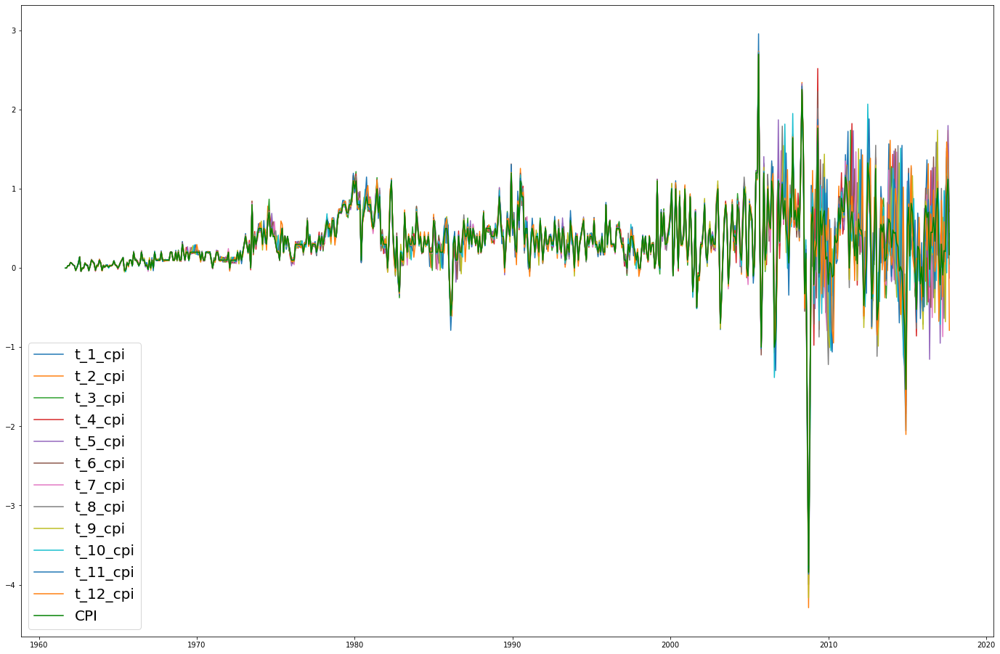

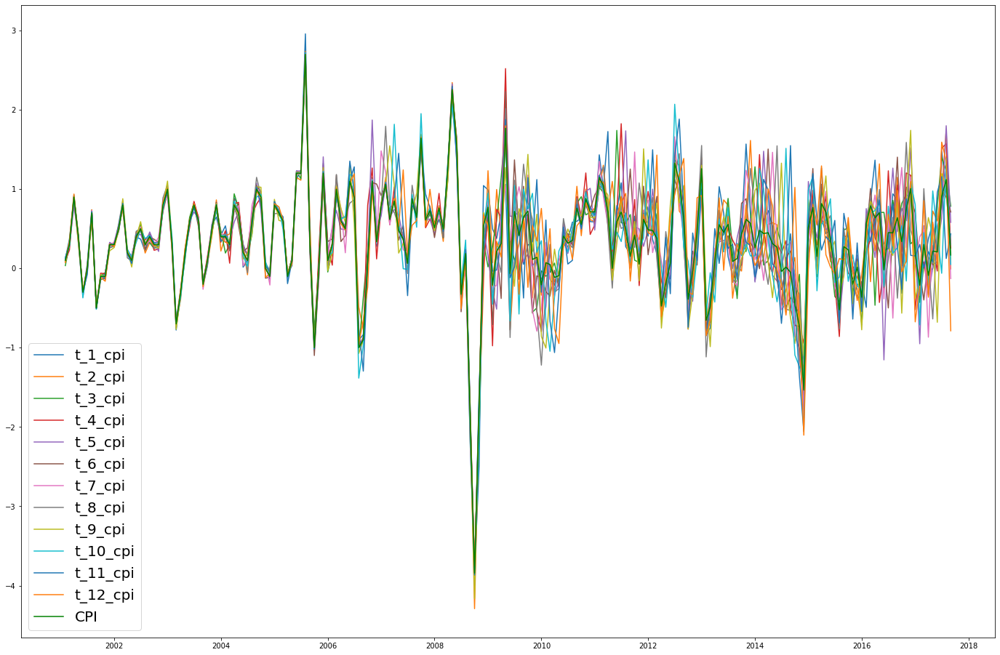

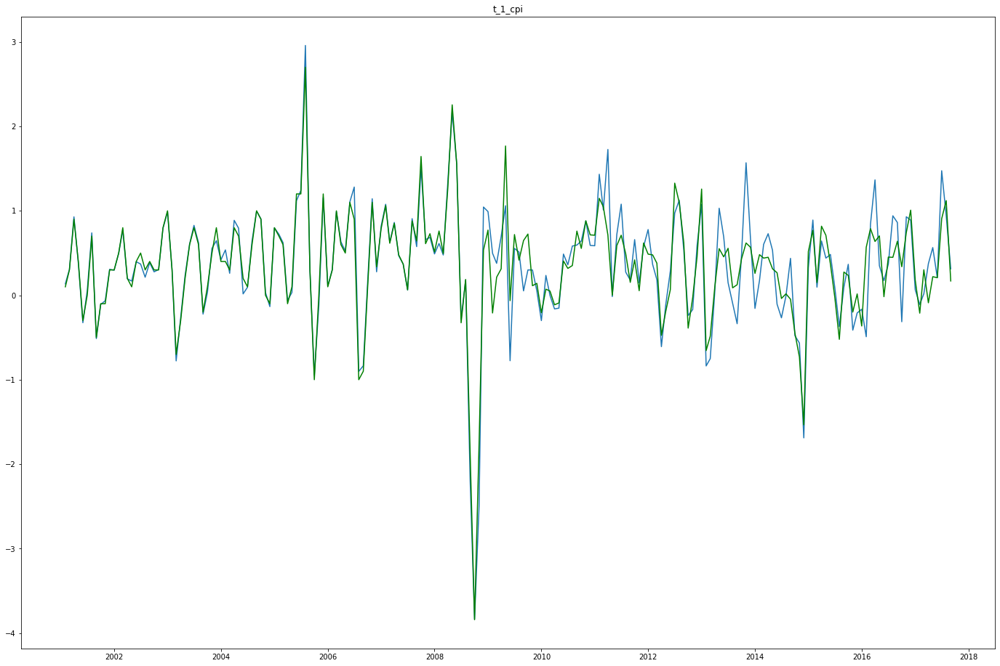

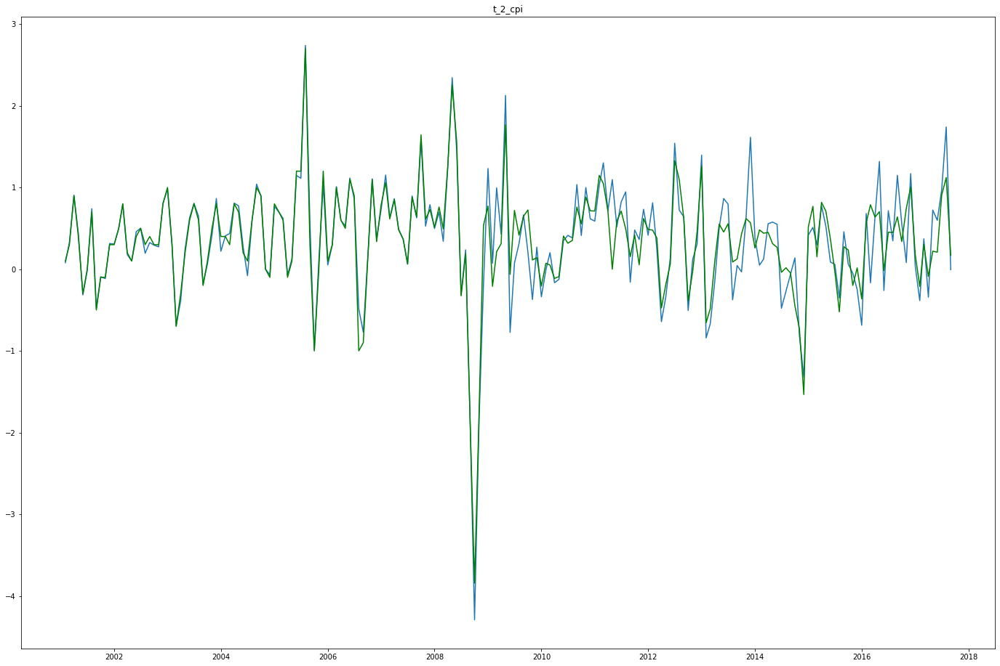

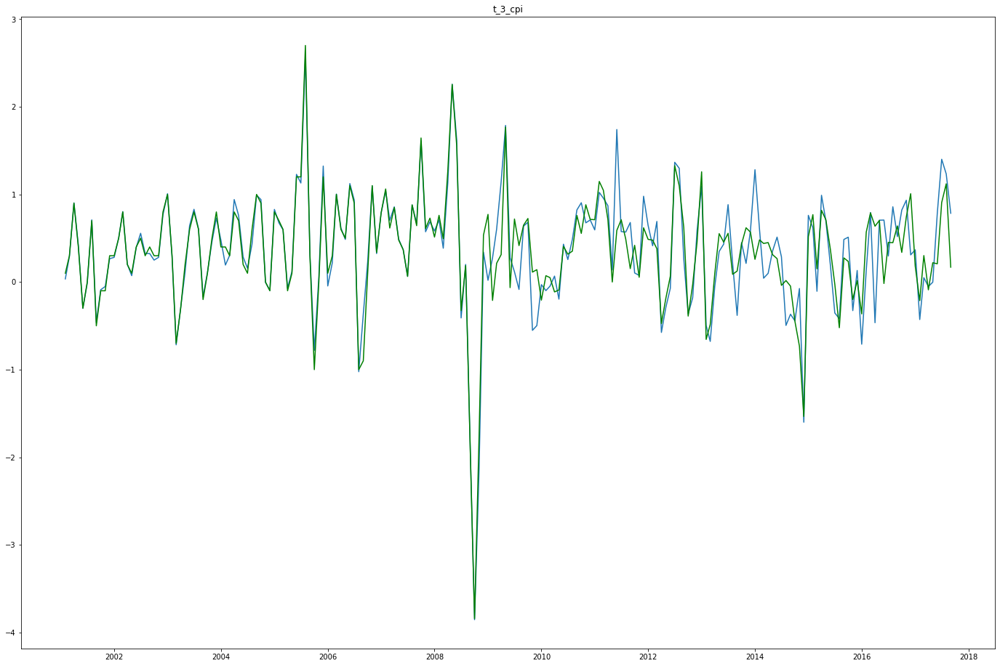

...

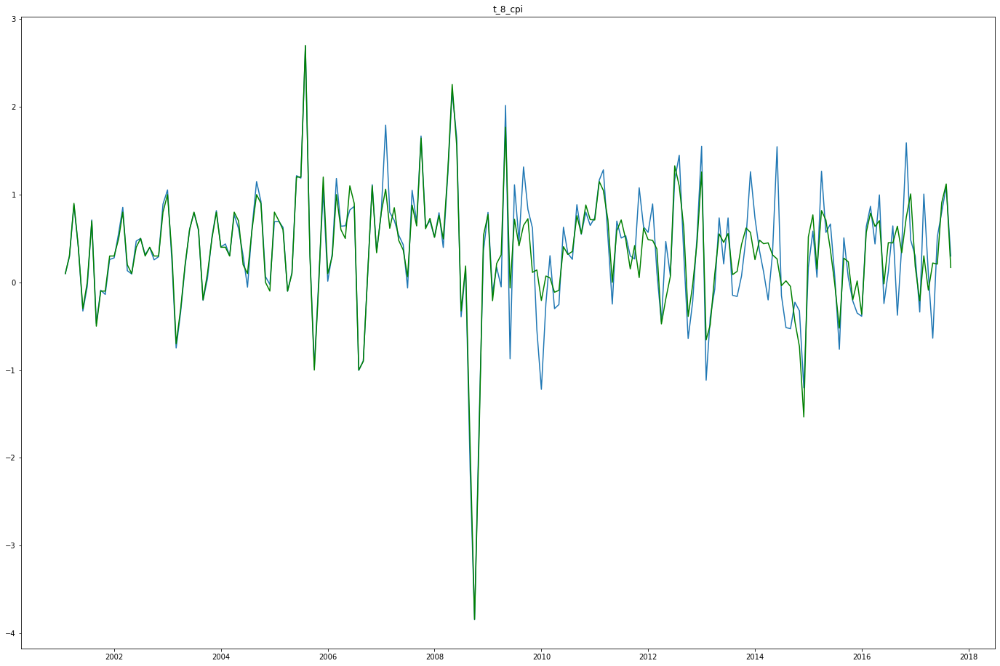

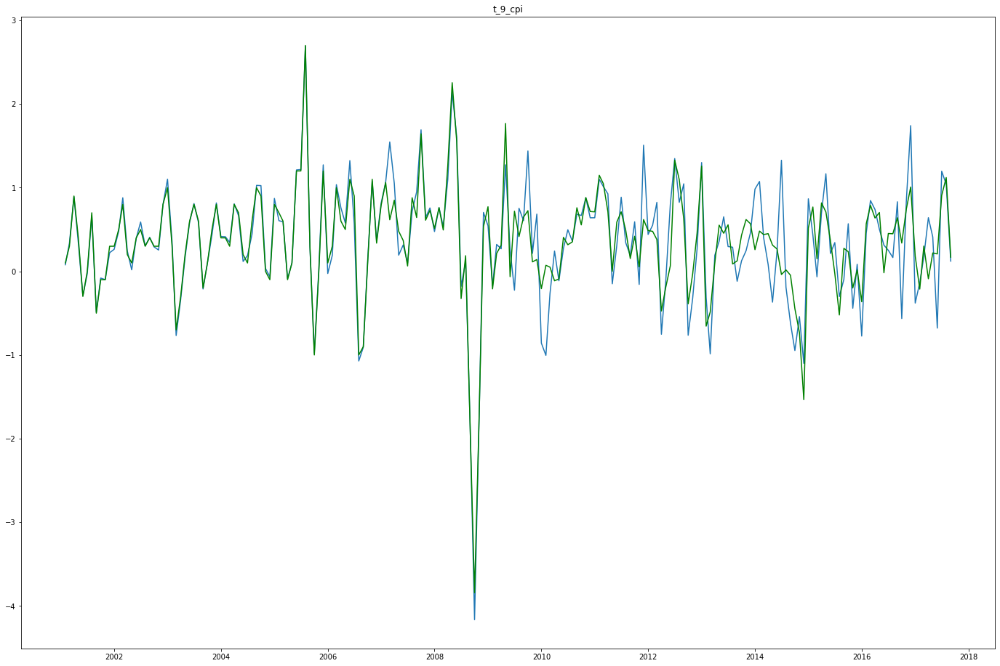

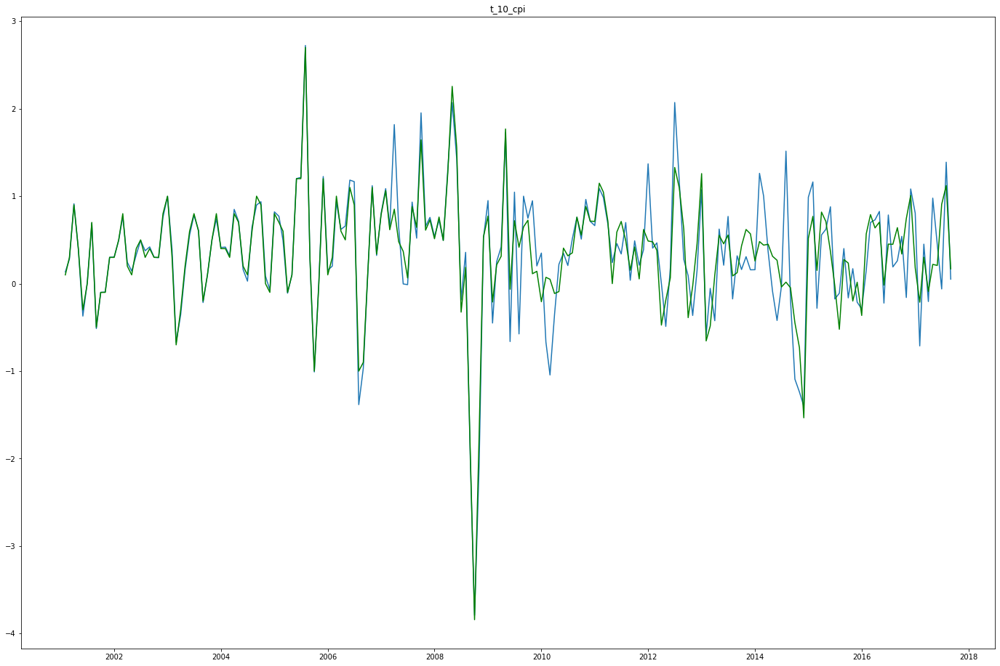

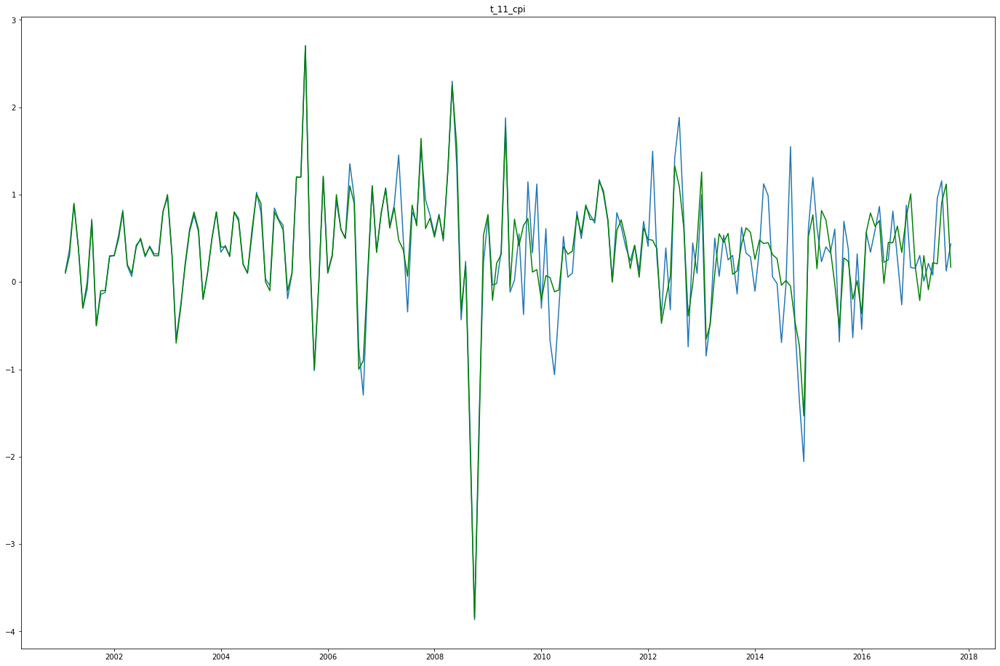

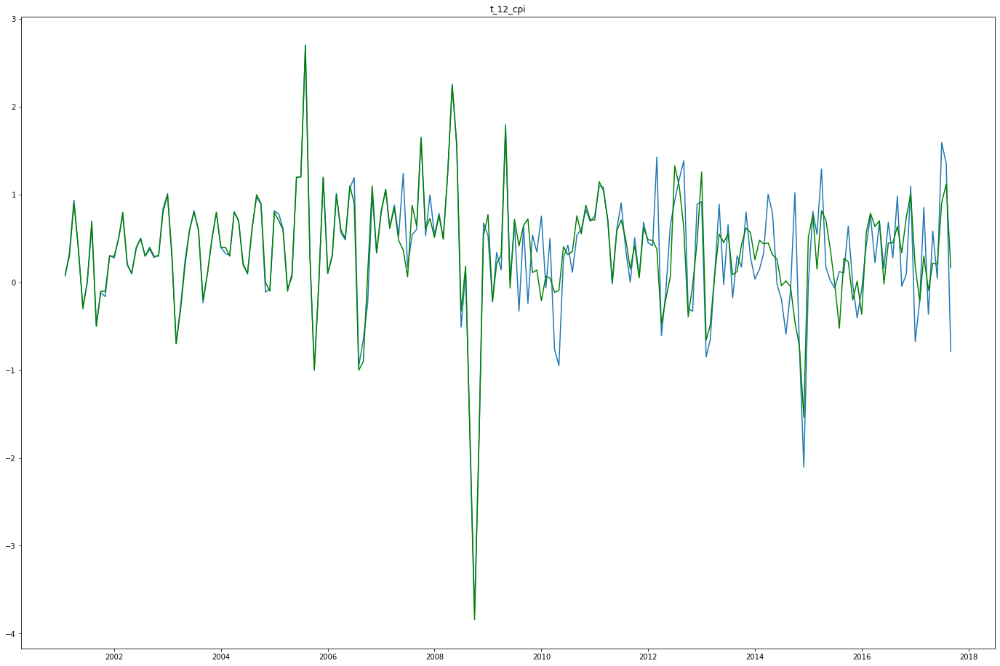

In [118]:
predictions_array = np.array(predictions)
# data_plt = pd.DataFrame(data.CPIAUCSL['2001-08-01':])
pred_df = pd.DataFrame({'t_1': predictions_array[:, 0], 't_2': predictions_array[:, 1],
                         't_3': predictions_array[:, 2], 't_4': predictions_array[:, 3],
                         't_5': predictions_array[:, 4], 't_6': predictions_array[:, 5],
                         't_7': predictions_array[:, 6], 't_8': predictions_array[:, 7],
                         't_9': predictions_array[:, 8], 't_10': predictions_array[:, 9],
                         't_11': predictions_array[:, 10], 't_12': predictions_array[:, 11]})

pred_plt = pd.DataFrame({'t_1' : pred_df['t_1'], 't_2' : pred_df['t_2'].shift(1),
                         't_3' : pred_df['t_3'].shift(2), 't_4' : pred_df['t_4'].shift(3),
                         't_5' : pred_df['t_5'].shift(4), 't_6' : pred_df['t_6'].shift(5),
                         't_7' : pred_df['t_7'].shift(6), 't_8' : pred_df['t_8'].shift(7),
                         't_9' : pred_df['t_9'].shift(8), 't_10' : pred_df['t_10'].shift(9),
                         't_11': pred_df['t_11'].shift(10), 't_12' : pred_df['t_12'].shift(11)})
for col in list(pred_plt):
#     pred_plt['{}_cpi'.format(col)] = ((pred_plt[col].shift(-12) / pred_plt[col]) - 1)*100
    pred_plt['{}_cpi'.format(col)] = pred_plt[col].shift(-1) - pred_plt[col]

pred_plt['raw_values'] = raw_values[start_idx:-1]
# pred_plt['raw_cpi'] = data.CPI.values[start_idx:-1]
pred_plt['raw_cpi'] = pred_plt['raw_values'].shift(-1) - pred_plt['raw_values']
pred_plt['date'] = data.index[start_idx:-1]
pred_plt.set_index('date', inplace=True)

mpl.rcParams['figure.figsize'] = (24,16)
for col in list(pred_plt)[12:-2]:
    ovr_mse = mean_squared_error(pred_plt['raw_cpi'].values[11:-23], pred_plt[col].values[11:-23])
    ovr_mae = mean_absolute_error(pred_plt['raw_cpi'].values[11:-23], pred_plt[col].values[11:-23])
    test_mse = mean_squared_error(pred_plt['raw_cpi'].iloc[round((len(pred_plt)-20)*.7):-23], 
                                  pred_plt[col].iloc[round((len(pred_plt)-20)*.7):-23])
    test_mae = mean_absolute_error(pred_plt['raw_cpi'].iloc[round((len(pred_plt)-20)*.7):-23], 
                                   pred_plt[col].iloc[round((len(pred_plt)-20)*.7):-23])
    print(col,': Overall RMSE: %.3f' % sqrt(ovr_mse), 'Test RMSE: %.3f' % sqrt(test_mse))
    print(col,': Overall MAE: %.3f' % ovr_mae, 'Test MAE: %.3f' % test_mae)
    plt.plot(pred_plt[col][:-23], label=col)
# line plot of observed vs predicted
# plt.plot(raw_values[20:], color='blue')
plt.plot(pred_plt['raw_cpi'][:-23], color='green', label='CPI')
# plt.plot(test[:,0], color='green')
plt.legend(prop={'size': 20})
plt.show()

for col in list(pred_plt)[12:-2]:
    plt.plot(pred_plt[col].iloc[round((len(pred_plt)-20)*.7):-23], label=col)
plt.plot(pred_plt['raw_cpi'].iloc[round((len(pred_plt)-20)*.7):-23], color='green', label='CPI')
# plt.plot(test[:,0], color='green')
plt.legend(prop={'size': 20})
plt.show()

i = 0
for col in list(pred_plt)[12:-2]:
    plt.plot(pred_plt[col].iloc[round((len(pred_plt)-20)*.7):-23], label=col)
    plt.plot(pred_plt['raw_cpi'].iloc[round((len(pred_plt)-20)*.7):-23], color='green', label='CPI')
    plt.title(col)
    plt.show()

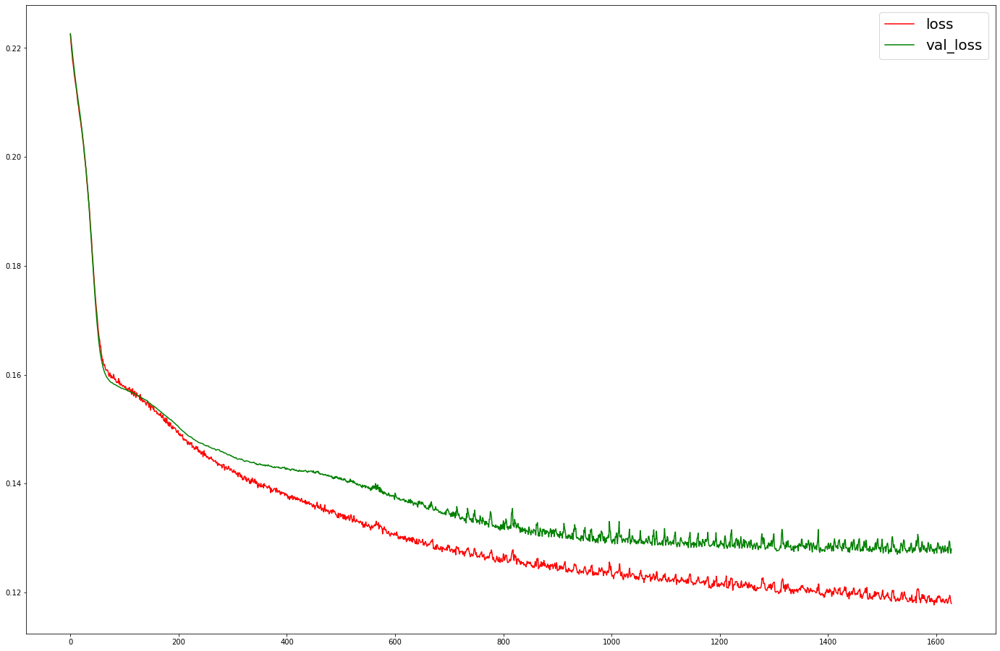

In [119]:
plt.plot(loss_df['loss'], color='red', label='loss')
plt.plot(val_loss_df['val_loss'], color='green', label='val_loss')
plt.legend(prop={'size': 20})
plt.show()

In [120]:
# transform data to be stationary
raw_values = data.CPIAUCSL_x.values
diff_values = difference(raw_values, 1)
 
# transform data to be supervised learning
# supervised = timeseries_to_supervised(diff_values, 1)
# print(supervised.shape)
# supervised_values = supervised.values
 
# split data into train and test-sets
train, test = split_dataset_1(diff_values, .7)
 
# transform the scale of the data
scaler, train_scaled, test_scaled = scale(train.values.reshape(-1, 1), test.values.reshape(-1, 1))

window=18
stepsout=12
# fit the model
conv_model, loss, val_loss = fit_conv(train_scaled, validate=True, batch_size=None, nb_epoch=25000, 
                                      neurons=(300,300,300), filter_size=8, drop=0.1, optimizer='adam', 
                                      window=window, callback=True, stepsout=stepsout, l_rate=.00001)

# # forecast the entire training dataset to build up state for forecasting
# # train_reshaped = train_scaled[:, 0].reshape(len(train_scaled), 1, 1)

# orig_test = test[:, 0].reshape(test.shape[0], 1, 1)
# moving_average_test = moving_frame(test[:, 0], [3, 6, 12])
# moving_average_test = moving_average_test.reshape(moving_average_test.shape[0], moving_average_test.shape[1], 1)
# predictions = conv_model.predict([orig_test, moving_average_test], batch_size=None)
loss += [np.nan] * (25000 - len(loss))
val_loss += [np.nan] * (25000 - len(val_loss))
loss_df = pd.DataFrame({'loss': loss})
val_loss_df = pd.DataFrame({'val_loss': val_loss})

start_idx = window + stepsout

# walk-forward validation on the test data
predictions_rolling = list()
history = train.values[:start_idx]
for i in range(len(train[start_idx:])):
#     if i % 10 == 0:
#         print(i)
    scaler, train_scaled, test_scaled = scale(history.reshape(-1, 1), train[i+start_idx].reshape(1,-1))
    # make one-step forecast
#     X, y = test_scaled[:, 0:-1].reshape(1,1), test_scaled[:,-1]
#     history_x = train_scaled[:,0:-1]
#     X_history_x = np.vstack((history_x, X))
#     orig_ = X_history_x[-1, 0].reshape(1, 1, 1)
#     moving_average_ = moving_frame(X_history_x[:, 0], [3, 6, 12])
#     moving_average_ = moving_average_[-1].reshape(1, moving_average_.shape[1], 1)
    train_stack = np.vstack((train_scaled, test_scaled))
    split = split_sequence(train_stack, window, stepsout)
    X = split[0][-1]
    y = split[1][-1]
    orig_ = X.reshape(1, X.shape[0], X.shape[1])
    moving_average_ = split_sequences_multi(moving_frame(train_stack, [3, 6, 12]), window, stepsout)[-1]
    moving_average_ = moving_average_.reshape(1, moving_average_.shape[0], 
                                            moving_average_.shape[1])
    yhat = conv_model.predict([orig_, moving_average_], batch_size=None)
    # invert scaling
    yhat = invert_scale(scaler, X, yhat, stepsout)
    # invert differencing
    yhat = inverse_difference(raw_values, yhat, interval=len(train[start_idx:])+len(test)+1-i)
    # store forecast
    predictions_rolling.append(yhat)
    history = np.append(history, train[i+start_idx])
    
history = train.values
iteration = 0
for i in range(len(test)):
#     if i % 10 == 0:
#         print(i)
    scaler, train_scaled, test_scaled = scale(history.reshape(-1, 1), test.values[i].reshape(1, -1))
#     make one-step forecast
    if i % 5 == 0:
#     if len(train_scaled) in [529, 569]:
        iteration += 1
        conv_model, loss, val_loss = fit_conv(train_scaled, validate=True, batch_size=None, nb_epoch=25000, 
                                              neurons=(300,300,300), filter_size=8, drop=0.1, optimizer='adam', 
                                              window=window, callback=True, stepsout=stepsout, l_rate=.00001)
        loss += [np.nan] * (25000 - len(loss))
        val_loss += [np.nan] * (25000 - len(val_loss))
        loss_df['loss_{}'.format(iteration)] = loss
        val_loss_df['val_loss_{}'.format(iteration)] = val_loss
    train_stack = np.vstack((train_scaled, test_scaled))
    split = split_sequence(train_stack, window, stepsout)
    X = split[0][-1]
    y = split[1][-1]
    orig_ = X.reshape(1, X.shape[0], X.shape[1])
    moving_average_ = split_sequences_multi(moving_frame(train_stack, [3, 6, 12]), window, stepsout)[-1]
    moving_average_ = moving_average_.reshape(1, moving_average_.shape[0], 
                                            moving_average_.shape[1])
    yhat = conv_model.predict([orig_, moving_average_], batch_size=None)
    # invert scaling
    yhat = invert_scale(scaler, X, yhat, stepsout)
    # invert differencing
    yhat = inverse_difference(raw_values, yhat, interval=len(test)+1-i)
    # store forecast
    predictions_rolling.append(yhat)
    history = np.append(history, test.values[i])

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 18, 1)]      0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 18, 2)]      0                                            
__________________________________________________________________________________________________
model (Model)                   (None, 300)          3390        input_1[0][0]                    
__________________________________________________________________________________________________
model_1 (Model)                 (None, 300)          3470        input_2[0][0]                    
____________________________________________________________________________________________

Epoch 58/25000
431/431 - 0s - loss: 0.1630 - val_loss: 0.1614
Epoch 59/25000
431/431 - 0s - loss: 0.1625 - val_loss: 0.1611
Epoch 60/25000
431/431 - 0s - loss: 0.1624 - val_loss: 0.1608
Epoch 61/25000
431/431 - 0s - loss: 0.1620 - val_loss: 0.1605
Epoch 62/25000
431/431 - 0s - loss: 0.1619 - val_loss: 0.1603
Epoch 63/25000
431/431 - 0s - loss: 0.1623 - val_loss: 0.1601
Epoch 64/25000
431/431 - 0s - loss: 0.1620 - val_loss: 0.1599
Epoch 65/25000
431/431 - 0s - loss: 0.1614 - val_loss: 0.1598
Epoch 66/25000
431/431 - 0s - loss: 0.1618 - val_loss: 0.1596
Epoch 67/25000
431/431 - 0s - loss: 0.1614 - val_loss: 0.1594
Epoch 68/25000
431/431 - 0s - loss: 0.1612 - val_loss: 0.1593
Epoch 69/25000
431/431 - 0s - loss: 0.1613 - val_loss: 0.1592
Epoch 70/25000
431/431 - 0s - loss: 0.1612 - val_loss: 0.1591
Epoch 71/25000
431/431 - 0s - loss: 0.1613 - val_loss: 0.1589
Epoch 72/25000
431/431 - 0s - loss: 0.1610 - val_loss: 0.1588
Epoch 73/25000
431/431 - 0s - loss: 0.1607 - val_loss: 0.1587
Epoch 74

Epoch 189/25000
431/431 - 0s - loss: 0.1527 - val_loss: 0.1527
Epoch 190/25000
431/431 - 0s - loss: 0.1532 - val_loss: 0.1527
Epoch 191/25000
431/431 - 0s - loss: 0.1529 - val_loss: 0.1526
Epoch 192/25000
431/431 - 0s - loss: 0.1527 - val_loss: 0.1526
Epoch 193/25000
431/431 - 0s - loss: 0.1526 - val_loss: 0.1525
Epoch 194/25000
431/431 - 0s - loss: 0.1530 - val_loss: 0.1524
Epoch 195/25000
431/431 - 0s - loss: 0.1521 - val_loss: 0.1523
Epoch 196/25000
431/431 - 0s - loss: 0.1523 - val_loss: 0.1522
Epoch 197/25000
431/431 - 0s - loss: 0.1523 - val_loss: 0.1521
Epoch 198/25000
431/431 - 0s - loss: 0.1519 - val_loss: 0.1520
Epoch 199/25000
431/431 - 0s - loss: 0.1519 - val_loss: 0.1520
Epoch 200/25000
431/431 - 0s - loss: 0.1522 - val_loss: 0.1519
Epoch 201/25000
431/431 - 0s - loss: 0.1520 - val_loss: 0.1519
Epoch 202/25000
431/431 - 0s - loss: 0.1518 - val_loss: 0.1518
Epoch 203/25000
431/431 - 0s - loss: 0.1515 - val_loss: 0.1517
Epoch 204/25000
431/431 - 0s - loss: 0.1513 - val_loss:

431/431 - 0s - loss: 0.1420 - val_loss: 0.1422
Epoch 320/25000
431/431 - 0s - loss: 0.1415 - val_loss: 0.1422
Epoch 321/25000
431/431 - 0s - loss: 0.1418 - val_loss: 0.1421
Epoch 322/25000
431/431 - 0s - loss: 0.1420 - val_loss: 0.1421
Epoch 323/25000
431/431 - 0s - loss: 0.1416 - val_loss: 0.1420
Epoch 324/25000
431/431 - 0s - loss: 0.1416 - val_loss: 0.1420
Epoch 325/25000
431/431 - 0s - loss: 0.1417 - val_loss: 0.1419
Epoch 326/25000
431/431 - 0s - loss: 0.1419 - val_loss: 0.1418
Epoch 327/25000
431/431 - 0s - loss: 0.1413 - val_loss: 0.1417
Epoch 328/25000
431/431 - 0s - loss: 0.1420 - val_loss: 0.1416
Epoch 329/25000
431/431 - 0s - loss: 0.1411 - val_loss: 0.1416
Epoch 330/25000
431/431 - 0s - loss: 0.1415 - val_loss: 0.1416
Epoch 331/25000
431/431 - 0s - loss: 0.1417 - val_loss: 0.1416
Epoch 332/25000
431/431 - 0s - loss: 0.1420 - val_loss: 0.1415
Epoch 333/25000
431/431 - 0s - loss: 0.1411 - val_loss: 0.1413
Epoch 334/25000
431/431 - 0s - loss: 0.1410 - val_loss: 0.1413
Epoch 33

Epoch 450/25000
431/431 - 0s - loss: 0.1351 - val_loss: 0.1358
Epoch 451/25000
431/431 - 0s - loss: 0.1352 - val_loss: 0.1359
Epoch 452/25000
431/431 - 0s - loss: 0.1351 - val_loss: 0.1359
Epoch 453/25000
431/431 - 0s - loss: 0.1353 - val_loss: 0.1358
Epoch 454/25000
431/431 - 0s - loss: 0.1352 - val_loss: 0.1358
Epoch 455/25000
431/431 - 0s - loss: 0.1351 - val_loss: 0.1358
Epoch 456/25000
431/431 - 0s - loss: 0.1347 - val_loss: 0.1358
Epoch 457/25000
431/431 - 0s - loss: 0.1351 - val_loss: 0.1358
Epoch 458/25000
431/431 - 0s - loss: 0.1356 - val_loss: 0.1357
Epoch 459/25000
431/431 - 0s - loss: 0.1348 - val_loss: 0.1356
Epoch 460/25000
431/431 - 0s - loss: 0.1350 - val_loss: 0.1356
Epoch 461/25000
431/431 - 0s - loss: 0.1350 - val_loss: 0.1356
Epoch 462/25000
431/431 - 0s - loss: 0.1349 - val_loss: 0.1356
Epoch 463/25000
431/431 - 0s - loss: 0.1353 - val_loss: 0.1354
Epoch 464/25000
431/431 - 0s - loss: 0.1351 - val_loss: 0.1356
Epoch 465/25000
431/431 - 0s - loss: 0.1347 - val_loss:

431/431 - 0s - loss: 0.1310 - val_loss: 0.1329
Epoch 581/25000
431/431 - 0s - loss: 0.1310 - val_loss: 0.1328
Epoch 582/25000
431/431 - 0s - loss: 0.1313 - val_loss: 0.1329
Epoch 583/25000
431/431 - 0s - loss: 0.1312 - val_loss: 0.1328
Epoch 584/25000
431/431 - 0s - loss: 0.1315 - val_loss: 0.1330
Epoch 585/25000
431/431 - 0s - loss: 0.1313 - val_loss: 0.1329
Epoch 586/25000
431/431 - 0s - loss: 0.1316 - val_loss: 0.1332
Epoch 587/25000
431/431 - 0s - loss: 0.1319 - val_loss: 0.1330
Epoch 588/25000
431/431 - 0s - loss: 0.1316 - val_loss: 0.1335
Epoch 589/25000
431/431 - 0s - loss: 0.1315 - val_loss: 0.1330
Epoch 590/25000
431/431 - 0s - loss: 0.1309 - val_loss: 0.1331
Epoch 591/25000
431/431 - 0s - loss: 0.1315 - val_loss: 0.1328
Epoch 592/25000
431/431 - 0s - loss: 0.1312 - val_loss: 0.1328
Epoch 593/25000
431/431 - 0s - loss: 0.1310 - val_loss: 0.1328
Epoch 594/25000
431/431 - 0s - loss: 0.1312 - val_loss: 0.1327
Epoch 595/25000
431/431 - 0s - loss: 0.1307 - val_loss: 0.1328
Epoch 59

Epoch 711/25000
431/431 - 0s - loss: 0.1289 - val_loss: 0.1317
Epoch 712/25000
431/431 - 0s - loss: 0.1294 - val_loss: 0.1316
Epoch 713/25000
431/431 - 0s - loss: 0.1291 - val_loss: 0.1316
Epoch 714/25000
431/431 - 0s - loss: 0.1290 - val_loss: 0.1315
Epoch 715/25000
431/431 - 0s - loss: 0.1288 - val_loss: 0.1317
Epoch 716/25000
431/431 - 0s - loss: 0.1287 - val_loss: 0.1316
Epoch 717/25000
431/431 - 0s - loss: 0.1289 - val_loss: 0.1319
Epoch 718/25000
431/431 - 0s - loss: 0.1288 - val_loss: 0.1315
Epoch 719/25000
431/431 - 0s - loss: 0.1290 - val_loss: 0.1315
Epoch 720/25000
431/431 - 0s - loss: 0.1286 - val_loss: 0.1315
Epoch 721/25000
431/431 - 0s - loss: 0.1287 - val_loss: 0.1315
Epoch 722/25000
431/431 - 0s - loss: 0.1287 - val_loss: 0.1314
Epoch 723/25000
431/431 - 0s - loss: 0.1279 - val_loss: 0.1314
Epoch 724/25000
431/431 - 0s - loss: 0.1286 - val_loss: 0.1314
Epoch 725/25000
431/431 - 0s - loss: 0.1284 - val_loss: 0.1315
Epoch 726/25000
431/431 - 0s - loss: 0.1283 - val_loss:

431/431 - 0s - loss: 0.1270 - val_loss: 0.1314
Epoch 842/25000
431/431 - 0s - loss: 0.1274 - val_loss: 0.1309
Epoch 843/25000
431/431 - 0s - loss: 0.1274 - val_loss: 0.1311
Epoch 844/25000
431/431 - 0s - loss: 0.1279 - val_loss: 0.1307
Epoch 845/25000
431/431 - 0s - loss: 0.1275 - val_loss: 0.1311
Epoch 846/25000
431/431 - 0s - loss: 0.1273 - val_loss: 0.1310
Epoch 847/25000
431/431 - 0s - loss: 0.1271 - val_loss: 0.1312
Epoch 848/25000
431/431 - 0s - loss: 0.1278 - val_loss: 0.1310
Epoch 849/25000
431/431 - 0s - loss: 0.1276 - val_loss: 0.1317
Epoch 850/25000
431/431 - 0s - loss: 0.1275 - val_loss: 0.1309
Epoch 851/25000
431/431 - 0s - loss: 0.1277 - val_loss: 0.1314
Epoch 852/25000
431/431 - 0s - loss: 0.1270 - val_loss: 0.1309
Epoch 853/25000
431/431 - 0s - loss: 0.1273 - val_loss: 0.1311
Epoch 854/25000
431/431 - 0s - loss: 0.1270 - val_loss: 0.1306
Epoch 855/25000
431/431 - 0s - loss: 0.1270 - val_loss: 0.1313
Epoch 856/25000
431/431 - 0s - loss: 0.1272 - val_loss: 0.1307
Epoch 85

Epoch 972/25000
431/431 - 0s - loss: 0.1260 - val_loss: 0.1299
Epoch 973/25000
431/431 - 0s - loss: 0.1246 - val_loss: 0.1299
Epoch 974/25000
431/431 - 0s - loss: 0.1250 - val_loss: 0.1302
Epoch 975/25000
431/431 - 0s - loss: 0.1253 - val_loss: 0.1303
Epoch 976/25000
431/431 - 0s - loss: 0.1251 - val_loss: 0.1305
Epoch 977/25000
431/431 - 0s - loss: 0.1254 - val_loss: 0.1303
Epoch 978/25000
431/431 - 0s - loss: 0.1252 - val_loss: 0.1303
Epoch 979/25000
431/431 - 0s - loss: 0.1253 - val_loss: 0.1301
Epoch 980/25000
431/431 - 0s - loss: 0.1246 - val_loss: 0.1299
Epoch 981/25000
431/431 - 0s - loss: 0.1250 - val_loss: 0.1298
Epoch 982/25000
431/431 - 0s - loss: 0.1252 - val_loss: 0.1298
Epoch 983/25000
431/431 - 0s - loss: 0.1247 - val_loss: 0.1298
Epoch 984/25000
431/431 - 0s - loss: 0.1245 - val_loss: 0.1298
Epoch 985/25000
431/431 - 0s - loss: 0.1248 - val_loss: 0.1297
Epoch 986/25000
431/431 - 0s - loss: 0.1249 - val_loss: 0.1296
Epoch 987/25000
431/431 - 0s - loss: 0.1249 - val_loss:

Epoch 1101/25000
431/431 - 0s - loss: 0.1238 - val_loss: 0.1293
Epoch 1102/25000
431/431 - 0s - loss: 0.1242 - val_loss: 0.1294
Epoch 1103/25000
431/431 - 0s - loss: 0.1237 - val_loss: 0.1293
Epoch 1104/25000
431/431 - 0s - loss: 0.1237 - val_loss: 0.1297
Epoch 1105/25000
431/431 - 0s - loss: 0.1239 - val_loss: 0.1298
Epoch 1106/25000
431/431 - 0s - loss: 0.1240 - val_loss: 0.1298
Epoch 1107/25000
431/431 - 0s - loss: 0.1242 - val_loss: 0.1294
Epoch 1108/25000
431/431 - 0s - loss: 0.1241 - val_loss: 0.1293
Epoch 1109/25000
431/431 - 0s - loss: 0.1241 - val_loss: 0.1295
Epoch 1110/25000
431/431 - 0s - loss: 0.1238 - val_loss: 0.1293
Epoch 1111/25000
431/431 - 0s - loss: 0.1240 - val_loss: 0.1298
Epoch 1112/25000
431/431 - 0s - loss: 0.1246 - val_loss: 0.1299
Epoch 1113/25000
431/431 - 0s - loss: 0.1241 - val_loss: 0.1299
Epoch 1114/25000
431/431 - 0s - loss: 0.1244 - val_loss: 0.1291
Epoch 1115/25000
431/431 - 0s - loss: 0.1235 - val_loss: 0.1291
Epoch 1116/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1223 - val_loss: 0.1289
Epoch 1230/25000
431/431 - 0s - loss: 0.1218 - val_loss: 0.1288
Epoch 1231/25000
431/431 - 0s - loss: 0.1223 - val_loss: 0.1288
Epoch 1232/25000
431/431 - 0s - loss: 0.1222 - val_loss: 0.1287
Epoch 1233/25000
431/431 - 0s - loss: 0.1224 - val_loss: 0.1290
Epoch 1234/25000
431/431 - 0s - loss: 0.1224 - val_loss: 0.1287
Epoch 1235/25000
431/431 - 0s - loss: 0.1223 - val_loss: 0.1288
Epoch 1236/25000
431/431 - 0s - loss: 0.1221 - val_loss: 0.1291
Epoch 1237/25000
431/431 - 0s - loss: 0.1226 - val_loss: 0.1296
Epoch 1238/25000
431/431 - 0s - loss: 0.1233 - val_loss: 0.1289
Epoch 1239/25000
431/431 - 0s - loss: 0.1225 - val_loss: 0.1287
Epoch 1240/25000
431/431 - 0s - loss: 0.1222 - val_loss: 0.1287
Epoch 1241/25000
431/431 - 0s - loss: 0.1216 - val_loss: 0.1286
Epoch 1242/25000
431/431 - 0s - loss: 0.1220 - val_loss: 0.1286
Epoch 1243/25000
431/431 - 0s - loss: 0.1221 - val_loss: 0.1286
Epoch 1244/25000
431/431 - 0s - loss: 0.1219 - val_loss: 

Epoch 1358/25000
431/431 - 0s - loss: 0.1220 - val_loss: 0.1287
Epoch 1359/25000
431/431 - 0s - loss: 0.1223 - val_loss: 0.1297
Epoch 1360/25000
431/431 - 0s - loss: 0.1225 - val_loss: 0.1298
Epoch 1361/25000
431/431 - 0s - loss: 0.1228 - val_loss: 0.1299
Epoch 1362/25000
431/431 - 0s - loss: 0.1229 - val_loss: 0.1284
Epoch 1363/25000
431/431 - 0s - loss: 0.1211 - val_loss: 0.1286
Epoch 1364/25000
431/431 - 0s - loss: 0.1211 - val_loss: 0.1285
Epoch 1365/25000
431/431 - 0s - loss: 0.1212 - val_loss: 0.1286
Epoch 1366/25000
431/431 - 0s - loss: 0.1208 - val_loss: 0.1284
Epoch 1367/25000
431/431 - 0s - loss: 0.1209 - val_loss: 0.1285
Epoch 1368/25000
431/431 - 0s - loss: 0.1212 - val_loss: 0.1283
Epoch 1369/25000
431/431 - 0s - loss: 0.1208 - val_loss: 0.1284
Epoch 1370/25000
431/431 - 0s - loss: 0.1208 - val_loss: 0.1285
Epoch 1371/25000
431/431 - 0s - loss: 0.1211 - val_loss: 0.1286
Epoch 1372/25000
431/431 - 0s - loss: 0.1208 - val_loss: 0.1286
Epoch 1373/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1206 - val_loss: 0.1283
Epoch 1487/25000
431/431 - 0s - loss: 0.1205 - val_loss: 0.1280
Epoch 1488/25000
431/431 - 0s - loss: 0.1204 - val_loss: 0.1282
Epoch 1489/25000
431/431 - 0s - loss: 0.1201 - val_loss: 0.1279
Epoch 1490/25000
431/431 - 0s - loss: 0.1204 - val_loss: 0.1286
Epoch 1491/25000
431/431 - 0s - loss: 0.1202 - val_loss: 0.1287
Epoch 1492/25000
431/431 - 0s - loss: 0.1205 - val_loss: 0.1291
Epoch 1493/25000
431/431 - 0s - loss: 0.1210 - val_loss: 0.1282
Epoch 1494/25000
431/431 - 0s - loss: 0.1200 - val_loss: 0.1280
Epoch 1495/25000
431/431 - 0s - loss: 0.1206 - val_loss: 0.1285
Epoch 1496/25000
431/431 - 0s - loss: 0.1204 - val_loss: 0.1285
Epoch 1497/25000
431/431 - 0s - loss: 0.1205 - val_loss: 0.1294
Epoch 1498/25000
431/431 - 0s - loss: 0.1213 - val_loss: 0.1282
Epoch 1499/25000
431/431 - 0s - loss: 0.1200 - val_loss: 0.1280
Epoch 1500/25000
431/431 - 0s - loss: 0.1196 - val_loss: 0.1282
Epoch 1501/25000
431/431 - 0s - loss: 0.1199 - val_loss: 

Epoch 1615/25000
431/431 - 0s - loss: 0.1191 - val_loss: 0.1276
Epoch 1616/25000
431/431 - 0s - loss: 0.1186 - val_loss: 0.1276
Epoch 1617/25000
431/431 - 0s - loss: 0.1187 - val_loss: 0.1274
Epoch 1618/25000
431/431 - 0s - loss: 0.1187 - val_loss: 0.1275
Epoch 1619/25000
431/431 - 0s - loss: 0.1193 - val_loss: 0.1273
Epoch 1620/25000
431/431 - 0s - loss: 0.1188 - val_loss: 0.1278
Epoch 1621/25000
431/431 - 0s - loss: 0.1186 - val_loss: 0.1280
Epoch 1622/25000
431/431 - 0s - loss: 0.1194 - val_loss: 0.1280
Epoch 1623/25000
431/431 - 0s - loss: 0.1199 - val_loss: 0.1279
Epoch 1624/25000
431/431 - 0s - loss: 0.1197 - val_loss: 0.1274
Epoch 1625/25000
431/431 - 0s - loss: 0.1191 - val_loss: 0.1285
Epoch 1626/25000
431/431 - 0s - loss: 0.1199 - val_loss: 0.1279
Epoch 1627/25000
431/431 - 0s - loss: 0.1194 - val_loss: 0.1278
Epoch 1628/25000
431/431 - 0s - loss: 0.1189 - val_loss: 0.1276
Epoch 1629/25000
431/431 - 0s - loss: 0.1183 - val_loss: 0.1274
Epoch 1630/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1176 - val_loss: 0.1270
Epoch 1744/25000
431/431 - 0s - loss: 0.1178 - val_loss: 0.1271
Epoch 1745/25000
431/431 - 0s - loss: 0.1174 - val_loss: 0.1268
Epoch 1746/25000
431/431 - 0s - loss: 0.1171 - val_loss: 0.1267
Epoch 1747/25000
431/431 - 0s - loss: 0.1176 - val_loss: 0.1271
Epoch 1748/25000
431/431 - 0s - loss: 0.1176 - val_loss: 0.1268
Epoch 1749/25000
431/431 - 0s - loss: 0.1173 - val_loss: 0.1273
Epoch 1750/25000
431/431 - 0s - loss: 0.1176 - val_loss: 0.1277
Epoch 1751/25000
431/431 - 0s - loss: 0.1186 - val_loss: 0.1276
Epoch 1752/25000
431/431 - 0s - loss: 0.1187 - val_loss: 0.1275
Epoch 1753/25000
431/431 - 0s - loss: 0.1178 - val_loss: 0.1272
Epoch 1754/25000
431/431 - 0s - loss: 0.1178 - val_loss: 0.1274
Epoch 1755/25000
431/431 - 0s - loss: 0.1180 - val_loss: 0.1272
Epoch 1756/25000
431/431 - 0s - loss: 0.1182 - val_loss: 0.1272
Epoch 1757/25000
431/431 - 0s - loss: 0.1178 - val_loss: 0.1273
Epoch 1758/25000
431/431 - 0s - loss: 0.1177 - val_loss: 

Epoch 1872/25000
431/431 - 0s - loss: 0.1174 - val_loss: 0.1268
Epoch 1873/25000
431/431 - 0s - loss: 0.1168 - val_loss: 0.1266
Epoch 1874/25000
431/431 - 0s - loss: 0.1170 - val_loss: 0.1271
Epoch 1875/25000
431/431 - 0s - loss: 0.1168 - val_loss: 0.1269
Epoch 1876/25000
431/431 - 0s - loss: 0.1169 - val_loss: 0.1266
Epoch 1877/25000
431/431 - 0s - loss: 0.1174 - val_loss: 0.1267
Epoch 1878/25000
431/431 - 0s - loss: 0.1169 - val_loss: 0.1264
Epoch 1879/25000
431/431 - 0s - loss: 0.1166 - val_loss: 0.1272
Epoch 1880/25000
431/431 - 0s - loss: 0.1168 - val_loss: 0.1268
Epoch 1881/25000
431/431 - 0s - loss: 0.1167 - val_loss: 0.1267
Epoch 1882/25000
431/431 - 0s - loss: 0.1168 - val_loss: 0.1265
Epoch 1883/25000
431/431 - 0s - loss: 0.1164 - val_loss: 0.1262
Epoch 1884/25000
431/431 - 0s - loss: 0.1164 - val_loss: 0.1266
Epoch 1885/25000
431/431 - 0s - loss: 0.1165 - val_loss: 0.1263
Epoch 1886/25000
431/431 - 0s - loss: 0.1159 - val_loss: 0.1265
Epoch 1887/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1163 - val_loss: 0.1262
Epoch 2001/25000
431/431 - 0s - loss: 0.1163 - val_loss: 0.1262
Epoch 2002/25000
431/431 - 0s - loss: 0.1160 - val_loss: 0.1272
Epoch 2003/25000
431/431 - 0s - loss: 0.1165 - val_loss: 0.1261
Epoch 2004/25000
431/431 - 0s - loss: 0.1155 - val_loss: 0.1258
Epoch 2005/25000
431/431 - 0s - loss: 0.1155 - val_loss: 0.1261
Epoch 2006/25000
431/431 - 0s - loss: 0.1151 - val_loss: 0.1261
Epoch 2007/25000
431/431 - 0s - loss: 0.1149 - val_loss: 0.1263
Epoch 2008/25000
431/431 - 0s - loss: 0.1157 - val_loss: 0.1260
Epoch 2009/25000
431/431 - 0s - loss: 0.1157 - val_loss: 0.1258
Epoch 2010/25000
431/431 - 0s - loss: 0.1159 - val_loss: 0.1262
Epoch 2011/25000
431/431 - 0s - loss: 0.1153 - val_loss: 0.1267
Epoch 2012/25000
431/431 - 0s - loss: 0.1159 - val_loss: 0.1273
Epoch 2013/25000
431/431 - 0s - loss: 0.1165 - val_loss: 0.1261
Epoch 2014/25000
431/431 - 0s - loss: 0.1155 - val_loss: 0.1260
Epoch 2015/25000
431/431 - 0s - loss: 0.1150 - val_loss: 

Epoch 2129/25000
431/431 - 0s - loss: 0.1149 - val_loss: 0.1262
Epoch 2130/25000
431/431 - 0s - loss: 0.1147 - val_loss: 0.1255
Epoch 2131/25000
431/431 - 0s - loss: 0.1154 - val_loss: 0.1261
Epoch 2132/25000
431/431 - 0s - loss: 0.1157 - val_loss: 0.1268
Epoch 2133/25000
431/431 - 0s - loss: 0.1151 - val_loss: 0.1278
Epoch 2134/25000
431/431 - 0s - loss: 0.1159 - val_loss: 0.1254
Epoch 2135/25000
431/431 - 0s - loss: 0.1139 - val_loss: 0.1253
Epoch 2136/25000
431/431 - 0s - loss: 0.1135 - val_loss: 0.1252
Epoch 2137/25000
431/431 - 0s - loss: 0.1139 - val_loss: 0.1255
Epoch 2138/25000
431/431 - 0s - loss: 0.1142 - val_loss: 0.1252
Epoch 2139/25000
431/431 - 0s - loss: 0.1139 - val_loss: 0.1253
Epoch 2140/25000
431/431 - 0s - loss: 0.1139 - val_loss: 0.1251
Epoch 2141/25000
431/431 - 0s - loss: 0.1146 - val_loss: 0.1252
Epoch 2142/25000
431/431 - 0s - loss: 0.1138 - val_loss: 0.1254
Epoch 2143/25000
431/431 - 0s - loss: 0.1144 - val_loss: 0.1251
Epoch 2144/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1130 - val_loss: 0.1253
Epoch 2258/25000
431/431 - 0s - loss: 0.1127 - val_loss: 0.1246
Epoch 2259/25000
431/431 - 0s - loss: 0.1135 - val_loss: 0.1254
Epoch 2260/25000
431/431 - 0s - loss: 0.1134 - val_loss: 0.1255
Epoch 2261/25000
431/431 - 0s - loss: 0.1128 - val_loss: 0.1254
Epoch 2262/25000
431/431 - 0s - loss: 0.1133 - val_loss: 0.1252
Epoch 2263/25000
431/431 - 0s - loss: 0.1131 - val_loss: 0.1246
Epoch 2264/25000
431/431 - 0s - loss: 0.1128 - val_loss: 0.1253
Epoch 2265/25000
431/431 - 0s - loss: 0.1131 - val_loss: 0.1255
Epoch 2266/25000
431/431 - 0s - loss: 0.1131 - val_loss: 0.1258
Epoch 2267/25000
431/431 - 0s - loss: 0.1137 - val_loss: 0.1251
Epoch 2268/25000
431/431 - 0s - loss: 0.1131 - val_loss: 0.1251
Epoch 2269/25000
431/431 - 0s - loss: 0.1132 - val_loss: 0.1253
Epoch 2270/25000
431/431 - 0s - loss: 0.1131 - val_loss: 0.1249
Epoch 2271/25000
431/431 - 0s - loss: 0.1130 - val_loss: 0.1247
Epoch 2272/25000
431/431 - 0s - loss: 0.1135 - val_loss: 

Epoch 2386/25000
431/431 - 0s - loss: 0.1113 - val_loss: 0.1240
Epoch 2387/25000
431/431 - 0s - loss: 0.1118 - val_loss: 0.1244
Epoch 2388/25000
431/431 - 0s - loss: 0.1114 - val_loss: 0.1244
Epoch 2389/25000
431/431 - 0s - loss: 0.1118 - val_loss: 0.1240
Epoch 2390/25000
431/431 - 0s - loss: 0.1113 - val_loss: 0.1246
Epoch 2391/25000
431/431 - 0s - loss: 0.1114 - val_loss: 0.1241
Epoch 2392/25000
431/431 - 0s - loss: 0.1115 - val_loss: 0.1245
Epoch 2393/25000
431/431 - 0s - loss: 0.1118 - val_loss: 0.1243
Epoch 2394/25000
431/431 - 0s - loss: 0.1110 - val_loss: 0.1239
Epoch 2395/25000
431/431 - 0s - loss: 0.1113 - val_loss: 0.1250
Epoch 2396/25000
431/431 - 0s - loss: 0.1114 - val_loss: 0.1241
Epoch 2397/25000
431/431 - 0s - loss: 0.1112 - val_loss: 0.1243
Epoch 2398/25000
431/431 - 0s - loss: 0.1115 - val_loss: 0.1241
Epoch 2399/25000
431/431 - 0s - loss: 0.1115 - val_loss: 0.1241
Epoch 2400/25000
431/431 - 0s - loss: 0.1109 - val_loss: 0.1244
Epoch 2401/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1101 - val_loss: 0.1236
Epoch 2515/25000
431/431 - 0s - loss: 0.1097 - val_loss: 0.1237
Epoch 2516/25000
431/431 - 0s - loss: 0.1103 - val_loss: 0.1237
Epoch 2517/25000
431/431 - 0s - loss: 0.1098 - val_loss: 0.1238
Epoch 2518/25000
431/431 - 0s - loss: 0.1105 - val_loss: 0.1241
Epoch 2519/25000
431/431 - 0s - loss: 0.1098 - val_loss: 0.1234
Epoch 2520/25000
431/431 - 0s - loss: 0.1110 - val_loss: 0.1242
Epoch 2521/25000
431/431 - 0s - loss: 0.1106 - val_loss: 0.1241
Epoch 2522/25000
431/431 - 0s - loss: 0.1100 - val_loss: 0.1236
Epoch 2523/25000
431/431 - 0s - loss: 0.1108 - val_loss: 0.1245
Epoch 2524/25000
431/431 - 0s - loss: 0.1108 - val_loss: 0.1236
Epoch 2525/25000
431/431 - 0s - loss: 0.1107 - val_loss: 0.1244
Epoch 2526/25000
431/431 - 0s - loss: 0.1107 - val_loss: 0.1240
Epoch 2527/25000
431/431 - 0s - loss: 0.1108 - val_loss: 0.1244
Epoch 2528/25000
431/431 - 0s - loss: 0.1108 - val_loss: 0.1244
Epoch 2529/25000
431/431 - 0s - loss: 0.1106 - val_loss: 

Epoch 2643/25000
431/431 - 0s - loss: 0.1093 - val_loss: 0.1235
Epoch 2644/25000
431/431 - 0s - loss: 0.1089 - val_loss: 0.1233
Epoch 2645/25000
431/431 - 0s - loss: 0.1091 - val_loss: 0.1234
Epoch 2646/25000
431/431 - 0s - loss: 0.1092 - val_loss: 0.1235
Epoch 2647/25000
431/431 - 0s - loss: 0.1086 - val_loss: 0.1240
Epoch 2648/25000
431/431 - 0s - loss: 0.1088 - val_loss: 0.1236
Epoch 2649/25000
431/431 - 0s - loss: 0.1092 - val_loss: 0.1234
Epoch 2650/25000
431/431 - 0s - loss: 0.1093 - val_loss: 0.1243
Epoch 2651/25000
431/431 - 0s - loss: 0.1089 - val_loss: 0.1241
Epoch 2652/25000
431/431 - 0s - loss: 0.1094 - val_loss: 0.1234
Epoch 2653/25000
431/431 - 0s - loss: 0.1104 - val_loss: 0.1251
Epoch 2654/25000
431/431 - 0s - loss: 0.1108 - val_loss: 0.1236
Epoch 2655/25000
431/431 - 0s - loss: 0.1103 - val_loss: 0.1243
Epoch 2656/25000
431/431 - 0s - loss: 0.1096 - val_loss: 0.1247
Epoch 2657/25000
431/431 - 0s - loss: 0.1094 - val_loss: 0.1233
Epoch 2658/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1086 - val_loss: 0.1239
Epoch 2772/25000
431/431 - 0s - loss: 0.1089 - val_loss: 0.1225
Epoch 2773/25000
431/431 - 0s - loss: 0.1090 - val_loss: 0.1236
Epoch 2774/25000
431/431 - 0s - loss: 0.1080 - val_loss: 0.1230
Epoch 2775/25000
431/431 - 0s - loss: 0.1085 - val_loss: 0.1235
Epoch 2776/25000
431/431 - 0s - loss: 0.1085 - val_loss: 0.1241
Epoch 2777/25000
431/431 - 0s - loss: 0.1086 - val_loss: 0.1224
Epoch 2778/25000
431/431 - 0s - loss: 0.1091 - val_loss: 0.1239
Epoch 2779/25000
431/431 - 0s - loss: 0.1088 - val_loss: 0.1249
Epoch 2780/25000
431/431 - 0s - loss: 0.1092 - val_loss: 0.1252
Epoch 2781/25000
431/431 - 0s - loss: 0.1104 - val_loss: 0.1247
Epoch 2782/25000
431/431 - 0s - loss: 0.1094 - val_loss: 0.1246
Epoch 2783/25000
431/431 - 0s - loss: 0.1091 - val_loss: 0.1259
Epoch 2784/25000
431/431 - 0s - loss: 0.1102 - val_loss: 0.1233
Epoch 2785/25000
431/431 - 0s - loss: 0.1079 - val_loss: 0.1232
Epoch 2786/25000
431/431 - 0s - loss: 0.1089 - val_loss: 

Epoch 2900/25000
431/431 - 0s - loss: 0.1077 - val_loss: 0.1232
Epoch 2901/25000
431/431 - 0s - loss: 0.1077 - val_loss: 0.1242
Epoch 2902/25000
431/431 - 0s - loss: 0.1078 - val_loss: 0.1236
Epoch 2903/25000
431/431 - 0s - loss: 0.1075 - val_loss: 0.1228
Epoch 2904/25000
431/431 - 0s - loss: 0.1076 - val_loss: 0.1237
Epoch 2905/25000
431/431 - 0s - loss: 0.1074 - val_loss: 0.1241
Epoch 2906/25000
431/431 - 0s - loss: 0.1073 - val_loss: 0.1229
Epoch 2907/25000
431/431 - 0s - loss: 0.1078 - val_loss: 0.1234
Epoch 2908/25000
431/431 - 0s - loss: 0.1075 - val_loss: 0.1223
Epoch 2909/25000
431/431 - 0s - loss: 0.1070 - val_loss: 0.1232
Epoch 2910/25000
431/431 - 0s - loss: 0.1073 - val_loss: 0.1233
Epoch 2911/25000
431/431 - 0s - loss: 0.1069 - val_loss: 0.1224
Epoch 2912/25000
431/431 - 0s - loss: 0.1067 - val_loss: 0.1225
Epoch 2913/25000
431/431 - 0s - loss: 0.1066 - val_loss: 0.1225
Epoch 2914/25000
431/431 - 0s - loss: 0.1063 - val_loss: 0.1230
Epoch 2915/25000
431/431 - 0s - loss: 0.

Train on 431 samples, validate on 48 samples
Epoch 1/25000
431/431 - 1s - loss: 0.2180 - val_loss: 0.2185
Epoch 2/25000
431/431 - 0s - loss: 0.2170 - val_loss: 0.2178
Epoch 3/25000
431/431 - 0s - loss: 0.2162 - val_loss: 0.2170
Epoch 4/25000
431/431 - 0s - loss: 0.2156 - val_loss: 0.2163
Epoch 5/25000
431/431 - 0s - loss: 0.2150 - val_loss: 0.2157
Epoch 6/25000
431/431 - 0s - loss: 0.2140 - val_loss: 0.2150
Epoch 7/25000
431/431 - 0s - loss: 0.2138 - val_loss: 0.2144
Epoch 8/25000
431/431 - 0s - loss: 0.2130 - val_loss: 0.2138
Epoch 9/25000
431/431 - 0s - loss: 0.2125 - val_loss: 0.2133
Epoch 10/25000
431/431 - 0s - loss: 0.2119 - val_loss: 0.2128
Epoch 11/25000
431/431 - 0s - loss: 0.2117 - val_loss: 0.2124
Epoch 12/25000
431/431 - 0s - loss: 0.2113 - val_loss: 0.2119
Epoch 13/25000
431/431 - 0s - loss: 0.2107 - val_loss: 0.2115
Epoch 14/25000
431/431 - 0s - loss: 0.2101 - val_loss: 0.2111
Epoch 15/25000
431/431 - 0s - loss: 0.2098 - val_loss: 0.2106
Epoch 16/25000
431/431 - 0s - loss

431/431 - 0s - loss: 0.1538 - val_loss: 0.1526
Epoch 133/25000
431/431 - 0s - loss: 0.1536 - val_loss: 0.1525
Epoch 134/25000
431/431 - 0s - loss: 0.1534 - val_loss: 0.1524
Epoch 135/25000
431/431 - 0s - loss: 0.1531 - val_loss: 0.1524
Epoch 136/25000
431/431 - 0s - loss: 0.1532 - val_loss: 0.1523
Epoch 137/25000
431/431 - 0s - loss: 0.1530 - val_loss: 0.1522
Epoch 138/25000
431/431 - 0s - loss: 0.1529 - val_loss: 0.1521
Epoch 139/25000
431/431 - 0s - loss: 0.1527 - val_loss: 0.1520
Epoch 140/25000
431/431 - 0s - loss: 0.1530 - val_loss: 0.1519
Epoch 141/25000
431/431 - 0s - loss: 0.1534 - val_loss: 0.1519
Epoch 142/25000
431/431 - 0s - loss: 0.1524 - val_loss: 0.1518
Epoch 143/25000
431/431 - 0s - loss: 0.1530 - val_loss: 0.1517
Epoch 144/25000
431/431 - 0s - loss: 0.1526 - val_loss: 0.1516
Epoch 145/25000
431/431 - 0s - loss: 0.1529 - val_loss: 0.1515
Epoch 146/25000
431/431 - 0s - loss: 0.1523 - val_loss: 0.1514
Epoch 147/25000
431/431 - 0s - loss: 0.1518 - val_loss: 0.1513
Epoch 14

Epoch 263/25000
431/431 - 0s - loss: 0.1423 - val_loss: 0.1407
Epoch 264/25000
431/431 - 0s - loss: 0.1426 - val_loss: 0.1406
Epoch 265/25000
431/431 - 0s - loss: 0.1424 - val_loss: 0.1406
Epoch 266/25000
431/431 - 0s - loss: 0.1418 - val_loss: 0.1405
Epoch 267/25000
431/431 - 0s - loss: 0.1424 - val_loss: 0.1403
Epoch 268/25000
431/431 - 0s - loss: 0.1419 - val_loss: 0.1403
Epoch 269/25000
431/431 - 0s - loss: 0.1422 - val_loss: 0.1402
Epoch 270/25000
431/431 - 0s - loss: 0.1418 - val_loss: 0.1402
Epoch 271/25000
431/431 - 0s - loss: 0.1421 - val_loss: 0.1403
Epoch 272/25000
431/431 - 0s - loss: 0.1413 - val_loss: 0.1400
Epoch 273/25000
431/431 - 0s - loss: 0.1415 - val_loss: 0.1400
Epoch 274/25000
431/431 - 0s - loss: 0.1417 - val_loss: 0.1400
Epoch 275/25000
431/431 - 0s - loss: 0.1416 - val_loss: 0.1399
Epoch 276/25000
431/431 - 0s - loss: 0.1414 - val_loss: 0.1398
Epoch 277/25000
431/431 - 0s - loss: 0.1416 - val_loss: 0.1397
Epoch 278/25000
431/431 - 0s - loss: 0.1414 - val_loss:

431/431 - 0s - loss: 0.1352 - val_loss: 0.1346
Epoch 394/25000
431/431 - 0s - loss: 0.1349 - val_loss: 0.1345
Epoch 395/25000
431/431 - 0s - loss: 0.1351 - val_loss: 0.1344
Epoch 396/25000
431/431 - 0s - loss: 0.1353 - val_loss: 0.1343
Epoch 397/25000
431/431 - 0s - loss: 0.1352 - val_loss: 0.1346
Epoch 398/25000
431/431 - 0s - loss: 0.1350 - val_loss: 0.1343
Epoch 399/25000
431/431 - 0s - loss: 0.1350 - val_loss: 0.1343
Epoch 400/25000
431/431 - 0s - loss: 0.1351 - val_loss: 0.1343
Epoch 401/25000
431/431 - 0s - loss: 0.1349 - val_loss: 0.1344
Epoch 402/25000
431/431 - 0s - loss: 0.1344 - val_loss: 0.1343
Epoch 403/25000
431/431 - 0s - loss: 0.1348 - val_loss: 0.1344
Epoch 404/25000
431/431 - 0s - loss: 0.1346 - val_loss: 0.1342
Epoch 405/25000
431/431 - 0s - loss: 0.1340 - val_loss: 0.1344
Epoch 406/25000
431/431 - 0s - loss: 0.1346 - val_loss: 0.1343
Epoch 407/25000
431/431 - 0s - loss: 0.1343 - val_loss: 0.1339
Epoch 408/25000
431/431 - 0s - loss: 0.1345 - val_loss: 0.1343
Epoch 40

Epoch 524/25000
431/431 - 0s - loss: 0.1307 - val_loss: 0.1316
Epoch 525/25000
431/431 - 0s - loss: 0.1306 - val_loss: 0.1325
Epoch 526/25000
431/431 - 0s - loss: 0.1306 - val_loss: 0.1314
Epoch 527/25000
431/431 - 0s - loss: 0.1309 - val_loss: 0.1328
Epoch 528/25000
431/431 - 0s - loss: 0.1309 - val_loss: 0.1316
Epoch 529/25000
431/431 - 0s - loss: 0.1309 - val_loss: 0.1329
Epoch 530/25000
431/431 - 0s - loss: 0.1304 - val_loss: 0.1314
Epoch 531/25000
431/431 - 0s - loss: 0.1313 - val_loss: 0.1327
Epoch 532/25000
431/431 - 0s - loss: 0.1310 - val_loss: 0.1315
Epoch 533/25000
431/431 - 0s - loss: 0.1309 - val_loss: 0.1327
Epoch 534/25000
431/431 - 0s - loss: 0.1303 - val_loss: 0.1315
Epoch 535/25000
431/431 - 0s - loss: 0.1310 - val_loss: 0.1325
Epoch 536/25000
431/431 - 0s - loss: 0.1307 - val_loss: 0.1317
Epoch 537/25000
431/431 - 0s - loss: 0.1306 - val_loss: 0.1325
Epoch 538/25000
431/431 - 0s - loss: 0.1304 - val_loss: 0.1315
Epoch 539/25000
431/431 - 0s - loss: 0.1306 - val_loss:

431/431 - 0s - loss: 0.1280 - val_loss: 0.1302
Epoch 655/25000
431/431 - 0s - loss: 0.1282 - val_loss: 0.1308
Epoch 656/25000
431/431 - 0s - loss: 0.1281 - val_loss: 0.1305
Epoch 657/25000
431/431 - 0s - loss: 0.1276 - val_loss: 0.1304
Epoch 658/25000
431/431 - 0s - loss: 0.1280 - val_loss: 0.1306
Epoch 659/25000
431/431 - 0s - loss: 0.1276 - val_loss: 0.1303
Epoch 660/25000
431/431 - 0s - loss: 0.1282 - val_loss: 0.1307
Epoch 661/25000
431/431 - 0s - loss: 0.1275 - val_loss: 0.1301
Epoch 662/25000
431/431 - 0s - loss: 0.1283 - val_loss: 0.1307
Epoch 663/25000
431/431 - 0s - loss: 0.1280 - val_loss: 0.1305
Epoch 664/25000
431/431 - 0s - loss: 0.1278 - val_loss: 0.1301
Epoch 665/25000
431/431 - 0s - loss: 0.1276 - val_loss: 0.1306
Epoch 666/25000
431/431 - 0s - loss: 0.1274 - val_loss: 0.1304
Epoch 667/25000
431/431 - 0s - loss: 0.1279 - val_loss: 0.1304
Epoch 668/25000
431/431 - 0s - loss: 0.1277 - val_loss: 0.1301
Epoch 669/25000
431/431 - 0s - loss: 0.1276 - val_loss: 0.1306
Epoch 67

Epoch 785/25000
431/431 - 0s - loss: 0.1256 - val_loss: 0.1291
Epoch 786/25000
431/431 - 0s - loss: 0.1260 - val_loss: 0.1297
Epoch 787/25000
431/431 - 0s - loss: 0.1256 - val_loss: 0.1289
Epoch 788/25000
431/431 - 0s - loss: 0.1259 - val_loss: 0.1296
Epoch 789/25000
431/431 - 0s - loss: 0.1259 - val_loss: 0.1289
Epoch 790/25000
431/431 - 0s - loss: 0.1256 - val_loss: 0.1292
Epoch 791/25000
431/431 - 0s - loss: 0.1259 - val_loss: 0.1294
Epoch 792/25000
431/431 - 0s - loss: 0.1258 - val_loss: 0.1292
Epoch 793/25000
431/431 - 0s - loss: 0.1258 - val_loss: 0.1294
Epoch 794/25000
431/431 - 0s - loss: 0.1256 - val_loss: 0.1290
Epoch 795/25000
431/431 - 0s - loss: 0.1253 - val_loss: 0.1295
Epoch 796/25000
431/431 - 0s - loss: 0.1257 - val_loss: 0.1291
Epoch 797/25000
431/431 - 0s - loss: 0.1252 - val_loss: 0.1289
Epoch 798/25000
431/431 - 0s - loss: 0.1258 - val_loss: 0.1298
Epoch 799/25000
431/431 - 0s - loss: 0.1262 - val_loss: 0.1288
Epoch 800/25000
431/431 - 0s - loss: 0.1259 - val_loss:

431/431 - 0s - loss: 0.1244 - val_loss: 0.1286
Epoch 916/25000
431/431 - 0s - loss: 0.1239 - val_loss: 0.1286
Epoch 917/25000
431/431 - 0s - loss: 0.1234 - val_loss: 0.1286
Epoch 918/25000
431/431 - 0s - loss: 0.1235 - val_loss: 0.1285
Epoch 919/25000
431/431 - 0s - loss: 0.1241 - val_loss: 0.1290
Epoch 920/25000
431/431 - 0s - loss: 0.1242 - val_loss: 0.1285
Epoch 921/25000
431/431 - 0s - loss: 0.1241 - val_loss: 0.1288
Epoch 922/25000
431/431 - 0s - loss: 0.1238 - val_loss: 0.1286
Epoch 923/25000
431/431 - 0s - loss: 0.1239 - val_loss: 0.1286
Epoch 924/25000
431/431 - 0s - loss: 0.1241 - val_loss: 0.1288
Epoch 925/25000
431/431 - 0s - loss: 0.1241 - val_loss: 0.1285
Epoch 926/25000
431/431 - 0s - loss: 0.1244 - val_loss: 0.1291
Epoch 927/25000
431/431 - 0s - loss: 0.1237 - val_loss: 0.1285
Epoch 928/25000
431/431 - 0s - loss: 0.1245 - val_loss: 0.1287
Epoch 929/25000
431/431 - 0s - loss: 0.1239 - val_loss: 0.1288
Epoch 930/25000
431/431 - 0s - loss: 0.1240 - val_loss: 0.1286
Epoch 93

Epoch 1045/25000
431/431 - 0s - loss: 0.1229 - val_loss: 0.1288
Epoch 1046/25000
431/431 - 0s - loss: 0.1233 - val_loss: 0.1283
Epoch 1047/25000
431/431 - 0s - loss: 0.1234 - val_loss: 0.1299
Epoch 1048/25000
431/431 - 0s - loss: 0.1230 - val_loss: 0.1284
Epoch 1049/25000
431/431 - 0s - loss: 0.1225 - val_loss: 0.1282
Epoch 1050/25000
431/431 - 0s - loss: 0.1230 - val_loss: 0.1290
Epoch 1051/25000
431/431 - 0s - loss: 0.1233 - val_loss: 0.1286
Epoch 1052/25000
431/431 - 0s - loss: 0.1233 - val_loss: 0.1298
Epoch 1053/25000
431/431 - 0s - loss: 0.1234 - val_loss: 0.1283
Epoch 1054/25000
431/431 - 0s - loss: 0.1227 - val_loss: 0.1282
Epoch 1055/25000
431/431 - 0s - loss: 0.1229 - val_loss: 0.1287
Epoch 1056/25000
431/431 - 0s - loss: 0.1230 - val_loss: 0.1282
Epoch 1057/25000
431/431 - 0s - loss: 0.1228 - val_loss: 0.1289
Epoch 1058/25000
431/431 - 0s - loss: 0.1227 - val_loss: 0.1284
Epoch 1059/25000
431/431 - 0s - loss: 0.1229 - val_loss: 0.1282
Epoch 1060/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1216 - val_loss: 0.1283
Epoch 1174/25000
431/431 - 0s - loss: 0.1220 - val_loss: 0.1290
Epoch 1175/25000
431/431 - 0s - loss: 0.1234 - val_loss: 0.1283
Epoch 1176/25000
431/431 - 0s - loss: 0.1224 - val_loss: 0.1304
Epoch 1177/25000
431/431 - 0s - loss: 0.1229 - val_loss: 0.1283
Epoch 1178/25000
431/431 - 0s - loss: 0.1219 - val_loss: 0.1279
Epoch 1179/25000
431/431 - 0s - loss: 0.1229 - val_loss: 0.1294
Epoch 1180/25000
431/431 - 0s - loss: 0.1226 - val_loss: 0.1288
Epoch 1181/25000
431/431 - 0s - loss: 0.1228 - val_loss: 0.1293
Epoch 1182/25000
431/431 - 0s - loss: 0.1220 - val_loss: 0.1280
Epoch 1183/25000
431/431 - 0s - loss: 0.1226 - val_loss: 0.1279
Epoch 1184/25000
431/431 - 0s - loss: 0.1224 - val_loss: 0.1292
Epoch 1185/25000
431/431 - 0s - loss: 0.1219 - val_loss: 0.1280
Epoch 1186/25000
431/431 - 0s - loss: 0.1217 - val_loss: 0.1279
Epoch 1187/25000
431/431 - 0s - loss: 0.1217 - val_loss: 0.1282
Epoch 1188/25000
431/431 - 0s - loss: 0.1215 - val_loss: 

Epoch 1302/25000
431/431 - 0s - loss: 0.1211 - val_loss: 0.1280
Epoch 1303/25000
431/431 - 0s - loss: 0.1211 - val_loss: 0.1277
Epoch 1304/25000
431/431 - 0s - loss: 0.1207 - val_loss: 0.1288
Epoch 1305/25000
431/431 - 0s - loss: 0.1207 - val_loss: 0.1283
Epoch 1306/25000
431/431 - 0s - loss: 0.1207 - val_loss: 0.1277
Epoch 1307/25000
431/431 - 0s - loss: 0.1205 - val_loss: 0.1278
Epoch 1308/25000
431/431 - 0s - loss: 0.1206 - val_loss: 0.1279
Epoch 1309/25000
431/431 - 0s - loss: 0.1203 - val_loss: 0.1282
Epoch 1310/25000
431/431 - 0s - loss: 0.1202 - val_loss: 0.1279
Epoch 1311/25000
431/431 - 0s - loss: 0.1199 - val_loss: 0.1277
Epoch 1312/25000
431/431 - 0s - loss: 0.1206 - val_loss: 0.1281
Epoch 1313/25000
431/431 - 0s - loss: 0.1206 - val_loss: 0.1283
Epoch 1314/25000
431/431 - 0s - loss: 0.1207 - val_loss: 0.1283
Epoch 1315/25000
431/431 - 0s - loss: 0.1208 - val_loss: 0.1281
Epoch 1316/25000
431/431 - 0s - loss: 0.1206 - val_loss: 0.1283
Epoch 1317/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1194 - val_loss: 0.1279
Epoch 1431/25000
431/431 - 0s - loss: 0.1193 - val_loss: 0.1279
Epoch 1432/25000
431/431 - 0s - loss: 0.1193 - val_loss: 0.1280
Epoch 1433/25000
431/431 - 0s - loss: 0.1193 - val_loss: 0.1277
Epoch 1434/25000
431/431 - 0s - loss: 0.1192 - val_loss: 0.1281
Epoch 1435/25000
431/431 - 0s - loss: 0.1193 - val_loss: 0.1281
Epoch 1436/25000
431/431 - 0s - loss: 0.1197 - val_loss: 0.1283
Epoch 1437/25000
431/431 - 0s - loss: 0.1198 - val_loss: 0.1282
Epoch 1438/25000
431/431 - 0s - loss: 0.1189 - val_loss: 0.1277
Epoch 1439/25000
431/431 - 0s - loss: 0.1190 - val_loss: 0.1279
Epoch 1440/25000
431/431 - 0s - loss: 0.1197 - val_loss: 0.1281
Epoch 1441/25000
431/431 - 0s - loss: 0.1195 - val_loss: 0.1285
Epoch 1442/25000
431/431 - 0s - loss: 0.1195 - val_loss: 0.1284
Epoch 1443/25000
431/431 - 0s - loss: 0.1198 - val_loss: 0.1277
Epoch 1444/25000
431/431 - 0s - loss: 0.1197 - val_loss: 0.1285
Epoch 1445/25000
431/431 - 0s - loss: 0.1199 - val_loss: 

Epoch 1559/25000
431/431 - 0s - loss: 0.1185 - val_loss: 0.1279
Epoch 1560/25000
431/431 - 0s - loss: 0.1185 - val_loss: 0.1285
Epoch 1561/25000
431/431 - 0s - loss: 0.1185 - val_loss: 0.1282
Epoch 1562/25000
431/431 - 0s - loss: 0.1187 - val_loss: 0.1281
Epoch 1563/25000
431/431 - 0s - loss: 0.1186 - val_loss: 0.1282
Epoch 1564/25000
431/431 - 0s - loss: 0.1186 - val_loss: 0.1289
Epoch 1565/25000
431/431 - 0s - loss: 0.1185 - val_loss: 0.1288
Epoch 1566/25000
431/431 - 0s - loss: 0.1185 - val_loss: 0.1278
Epoch 1567/25000
431/431 - 0s - loss: 0.1188 - val_loss: 0.1280
Epoch 1568/25000
431/431 - 0s - loss: 0.1187 - val_loss: 0.1286
Epoch 1569/25000
431/431 - 0s - loss: 0.1189 - val_loss: 0.1296
Epoch 1570/25000
431/431 - 0s - loss: 0.1197 - val_loss: 0.1283
Epoch 1571/25000
431/431 - 0s - loss: 0.1186 - val_loss: 0.1275
Epoch 1572/25000
431/431 - 0s - loss: 0.1184 - val_loss: 0.1280
Epoch 1573/25000
431/431 - 0s - loss: 0.1186 - val_loss: 0.1284
Epoch 1574/25000
431/431 - 0s - loss: 0.

Train on 435 samples, validate on 49 samples
Epoch 1/25000
435/435 - 1s - loss: 0.2228 - val_loss: 0.2250
Epoch 2/25000
435/435 - 0s - loss: 0.2212 - val_loss: 0.2239
Epoch 3/25000
435/435 - 0s - loss: 0.2204 - val_loss: 0.2228
Epoch 4/25000
435/435 - 0s - loss: 0.2196 - val_loss: 0.2219
Epoch 5/25000
435/435 - 0s - loss: 0.2191 - val_loss: 0.2209
Epoch 6/25000
435/435 - 0s - loss: 0.2184 - val_loss: 0.2201
Epoch 7/25000
435/435 - 0s - loss: 0.2172 - val_loss: 0.2193
Epoch 8/25000
435/435 - 0s - loss: 0.2167 - val_loss: 0.2186
Epoch 9/25000
435/435 - 0s - loss: 0.2160 - val_loss: 0.2179
Epoch 10/25000
435/435 - 0s - loss: 0.2155 - val_loss: 0.2173
Epoch 11/25000
435/435 - 0s - loss: 0.2149 - val_loss: 0.2166
Epoch 12/25000
435/435 - 0s - loss: 0.2144 - val_loss: 0.2160
Epoch 13/25000
435/435 - 0s - loss: 0.2140 - val_loss: 0.2154
Epoch 14/25000
435/435 - 0s - loss: 0.2132 - val_loss: 0.2149
Epoch 15/25000
435/435 - 0s - loss: 0.2129 - val_loss: 0.2143
Epoch 16/25000
435/435 - 0s - loss

435/435 - 0s - loss: 0.1584 - val_loss: 0.1587
Epoch 133/25000
435/435 - 0s - loss: 0.1582 - val_loss: 0.1586
Epoch 134/25000
435/435 - 0s - loss: 0.1580 - val_loss: 0.1585
Epoch 135/25000
435/435 - 0s - loss: 0.1578 - val_loss: 0.1585
Epoch 136/25000
435/435 - 0s - loss: 0.1580 - val_loss: 0.1584
Epoch 137/25000
435/435 - 0s - loss: 0.1584 - val_loss: 0.1584
Epoch 138/25000
435/435 - 0s - loss: 0.1578 - val_loss: 0.1583
Epoch 139/25000
435/435 - 0s - loss: 0.1580 - val_loss: 0.1582
Epoch 140/25000
435/435 - 0s - loss: 0.1577 - val_loss: 0.1582
Epoch 141/25000
435/435 - 0s - loss: 0.1578 - val_loss: 0.1581
Epoch 142/25000
435/435 - 0s - loss: 0.1580 - val_loss: 0.1581
Epoch 143/25000
435/435 - 0s - loss: 0.1578 - val_loss: 0.1580
Epoch 144/25000
435/435 - 0s - loss: 0.1575 - val_loss: 0.1579
Epoch 145/25000
435/435 - 0s - loss: 0.1577 - val_loss: 0.1578
Epoch 146/25000
435/435 - 0s - loss: 0.1579 - val_loss: 0.1578
Epoch 147/25000
435/435 - 0s - loss: 0.1575 - val_loss: 0.1577
Epoch 14

Epoch 263/25000
435/435 - 0s - loss: 0.1491 - val_loss: 0.1476
Epoch 264/25000
435/435 - 0s - loss: 0.1494 - val_loss: 0.1475
Epoch 265/25000
435/435 - 0s - loss: 0.1491 - val_loss: 0.1473
Epoch 266/25000
435/435 - 0s - loss: 0.1489 - val_loss: 0.1473
Epoch 267/25000
435/435 - 0s - loss: 0.1488 - val_loss: 0.1471
Epoch 268/25000
435/435 - 0s - loss: 0.1492 - val_loss: 0.1471
Epoch 269/25000
435/435 - 0s - loss: 0.1492 - val_loss: 0.1470
Epoch 270/25000
435/435 - 0s - loss: 0.1489 - val_loss: 0.1471
Epoch 271/25000
435/435 - 0s - loss: 0.1488 - val_loss: 0.1469
Epoch 272/25000
435/435 - 0s - loss: 0.1491 - val_loss: 0.1468
Epoch 273/25000
435/435 - 0s - loss: 0.1487 - val_loss: 0.1468
Epoch 274/25000
435/435 - 0s - loss: 0.1482 - val_loss: 0.1466
Epoch 275/25000
435/435 - 0s - loss: 0.1486 - val_loss: 0.1466
Epoch 276/25000
435/435 - 0s - loss: 0.1480 - val_loss: 0.1464
Epoch 277/25000
435/435 - 0s - loss: 0.1483 - val_loss: 0.1463
Epoch 278/25000
435/435 - 0s - loss: 0.1483 - val_loss:

435/435 - 0s - loss: 0.1439 - val_loss: 0.1402
Epoch 394/25000
435/435 - 0s - loss: 0.1434 - val_loss: 0.1403
Epoch 395/25000
435/435 - 0s - loss: 0.1430 - val_loss: 0.1402
Epoch 396/25000
435/435 - 0s - loss: 0.1429 - val_loss: 0.1401
Epoch 397/25000
435/435 - 0s - loss: 0.1427 - val_loss: 0.1399
Epoch 398/25000
435/435 - 0s - loss: 0.1430 - val_loss: 0.1400
Epoch 399/25000
435/435 - 0s - loss: 0.1435 - val_loss: 0.1400
Epoch 400/25000
435/435 - 0s - loss: 0.1430 - val_loss: 0.1399
Epoch 401/25000
435/435 - 0s - loss: 0.1429 - val_loss: 0.1399
Epoch 402/25000
435/435 - 0s - loss: 0.1427 - val_loss: 0.1397
Epoch 403/25000
435/435 - 0s - loss: 0.1431 - val_loss: 0.1398
Epoch 404/25000
435/435 - 0s - loss: 0.1428 - val_loss: 0.1397
Epoch 405/25000
435/435 - 0s - loss: 0.1426 - val_loss: 0.1397
Epoch 406/25000
435/435 - 0s - loss: 0.1430 - val_loss: 0.1396
Epoch 407/25000
435/435 - 0s - loss: 0.1427 - val_loss: 0.1397
Epoch 408/25000
435/435 - 0s - loss: 0.1430 - val_loss: 0.1395
Epoch 40

Epoch 524/25000
435/435 - 0s - loss: 0.1378 - val_loss: 0.1363
Epoch 525/25000
435/435 - 0s - loss: 0.1386 - val_loss: 0.1362
Epoch 526/25000
435/435 - 0s - loss: 0.1376 - val_loss: 0.1365
Epoch 527/25000
435/435 - 0s - loss: 0.1377 - val_loss: 0.1364
Epoch 528/25000
435/435 - 0s - loss: 0.1378 - val_loss: 0.1364
Epoch 529/25000
435/435 - 0s - loss: 0.1375 - val_loss: 0.1362
Epoch 530/25000
435/435 - 0s - loss: 0.1376 - val_loss: 0.1367
Epoch 531/25000
435/435 - 0s - loss: 0.1378 - val_loss: 0.1361
Epoch 532/25000
435/435 - 0s - loss: 0.1373 - val_loss: 0.1362
Epoch 533/25000
435/435 - 0s - loss: 0.1372 - val_loss: 0.1361
Epoch 534/25000
435/435 - 0s - loss: 0.1378 - val_loss: 0.1364
Epoch 535/25000
435/435 - 0s - loss: 0.1379 - val_loss: 0.1360
Epoch 536/25000
435/435 - 0s - loss: 0.1378 - val_loss: 0.1362
Epoch 537/25000
435/435 - 0s - loss: 0.1375 - val_loss: 0.1362
Epoch 538/25000
435/435 - 0s - loss: 0.1374 - val_loss: 0.1360
Epoch 539/25000
435/435 - 0s - loss: 0.1373 - val_loss:

435/435 - 0s - loss: 0.1326 - val_loss: 0.1348
Epoch 655/25000
435/435 - 0s - loss: 0.1334 - val_loss: 0.1343
Epoch 656/25000
435/435 - 0s - loss: 0.1327 - val_loss: 0.1343
Epoch 657/25000
435/435 - 0s - loss: 0.1338 - val_loss: 0.1345
Epoch 658/25000
435/435 - 0s - loss: 0.1327 - val_loss: 0.1340
Epoch 659/25000
435/435 - 0s - loss: 0.1331 - val_loss: 0.1346
Epoch 660/25000
435/435 - 0s - loss: 0.1329 - val_loss: 0.1341
Epoch 661/25000
435/435 - 0s - loss: 0.1330 - val_loss: 0.1342
Epoch 662/25000
435/435 - 0s - loss: 0.1325 - val_loss: 0.1342
Epoch 663/25000
435/435 - 0s - loss: 0.1330 - val_loss: 0.1340
Epoch 664/25000
435/435 - 0s - loss: 0.1332 - val_loss: 0.1344
Epoch 665/25000
435/435 - 0s - loss: 0.1330 - val_loss: 0.1341
Epoch 666/25000
435/435 - 0s - loss: 0.1332 - val_loss: 0.1341
Epoch 667/25000
435/435 - 0s - loss: 0.1330 - val_loss: 0.1343
Epoch 668/25000
435/435 - 0s - loss: 0.1329 - val_loss: 0.1342
Epoch 669/25000
435/435 - 0s - loss: 0.1328 - val_loss: 0.1340
Epoch 67

Epoch 785/25000
435/435 - 0s - loss: 0.1303 - val_loss: 0.1332
Epoch 786/25000
435/435 - 0s - loss: 0.1299 - val_loss: 0.1333
Epoch 787/25000
435/435 - 0s - loss: 0.1304 - val_loss: 0.1334
Epoch 788/25000
435/435 - 0s - loss: 0.1300 - val_loss: 0.1333
Epoch 789/25000
435/435 - 0s - loss: 0.1296 - val_loss: 0.1337
Epoch 790/25000
435/435 - 0s - loss: 0.1295 - val_loss: 0.1332
Epoch 791/25000
435/435 - 0s - loss: 0.1301 - val_loss: 0.1338
Epoch 792/25000
435/435 - 0s - loss: 0.1299 - val_loss: 0.1331
Epoch 793/25000
435/435 - 0s - loss: 0.1298 - val_loss: 0.1336
Epoch 794/25000
435/435 - 0s - loss: 0.1300 - val_loss: 0.1335
Epoch 795/25000
435/435 - 0s - loss: 0.1295 - val_loss: 0.1333
Epoch 796/25000
435/435 - 0s - loss: 0.1295 - val_loss: 0.1333
Epoch 797/25000
435/435 - 0s - loss: 0.1297 - val_loss: 0.1332
Epoch 798/25000
435/435 - 0s - loss: 0.1290 - val_loss: 0.1331
Epoch 799/25000
435/435 - 0s - loss: 0.1300 - val_loss: 0.1337
Epoch 800/25000
435/435 - 0s - loss: 0.1301 - val_loss:

435/435 - 0s - loss: 0.1287 - val_loss: 0.1340
Epoch 916/25000
435/435 - 0s - loss: 0.1282 - val_loss: 0.1326
Epoch 917/25000
435/435 - 0s - loss: 0.1275 - val_loss: 0.1331
Epoch 918/25000
435/435 - 0s - loss: 0.1274 - val_loss: 0.1325
Epoch 919/25000
435/435 - 0s - loss: 0.1273 - val_loss: 0.1328
Epoch 920/25000
435/435 - 0s - loss: 0.1281 - val_loss: 0.1328
Epoch 921/25000
435/435 - 0s - loss: 0.1272 - val_loss: 0.1327
Epoch 922/25000
435/435 - 0s - loss: 0.1277 - val_loss: 0.1332
Epoch 923/25000
435/435 - 0s - loss: 0.1272 - val_loss: 0.1327
Epoch 924/25000
435/435 - 0s - loss: 0.1284 - val_loss: 0.1330
Epoch 925/25000
435/435 - 0s - loss: 0.1279 - val_loss: 0.1338
Epoch 926/25000
435/435 - 0s - loss: 0.1275 - val_loss: 0.1334
Epoch 927/25000
435/435 - 0s - loss: 0.1279 - val_loss: 0.1338
Epoch 928/25000
435/435 - 0s - loss: 0.1279 - val_loss: 0.1326
Epoch 929/25000
435/435 - 0s - loss: 0.1282 - val_loss: 0.1329
Epoch 930/25000
435/435 - 0s - loss: 0.1280 - val_loss: 0.1330
Epoch 93

Epoch 1045/25000
435/435 - 0s - loss: 0.1262 - val_loss: 0.1326
Epoch 1046/25000
435/435 - 0s - loss: 0.1255 - val_loss: 0.1321
Epoch 1047/25000
435/435 - 0s - loss: 0.1258 - val_loss: 0.1322
Epoch 1048/25000
435/435 - 0s - loss: 0.1256 - val_loss: 0.1322
Epoch 1049/25000
435/435 - 0s - loss: 0.1259 - val_loss: 0.1321
Epoch 1050/25000
435/435 - 0s - loss: 0.1259 - val_loss: 0.1325
Epoch 1051/25000
435/435 - 0s - loss: 0.1254 - val_loss: 0.1323
Epoch 1052/25000
435/435 - 0s - loss: 0.1258 - val_loss: 0.1327
Epoch 1053/25000
435/435 - 0s - loss: 0.1261 - val_loss: 0.1327
Epoch 1054/25000
435/435 - 0s - loss: 0.1264 - val_loss: 0.1326
Epoch 1055/25000
435/435 - 0s - loss: 0.1262 - val_loss: 0.1338
Epoch 1056/25000
435/435 - 0s - loss: 0.1264 - val_loss: 0.1324
Epoch 1057/25000
435/435 - 0s - loss: 0.1264 - val_loss: 0.1328
Epoch 1058/25000
435/435 - 0s - loss: 0.1258 - val_loss: 0.1326
Epoch 1059/25000
435/435 - 0s - loss: 0.1262 - val_loss: 0.1324
Epoch 1060/25000
435/435 - 0s - loss: 0.

435/435 - 0s - loss: 0.1246 - val_loss: 0.1320
Epoch 1174/25000
435/435 - 0s - loss: 0.1250 - val_loss: 0.1318
Epoch 1175/25000
435/435 - 0s - loss: 0.1246 - val_loss: 0.1322
Epoch 1176/25000
435/435 - 0s - loss: 0.1246 - val_loss: 0.1318
Epoch 1177/25000
435/435 - 0s - loss: 0.1246 - val_loss: 0.1318
Epoch 1178/25000
435/435 - 0s - loss: 0.1244 - val_loss: 0.1326
Epoch 1179/25000
435/435 - 0s - loss: 0.1245 - val_loss: 0.1319
Epoch 1180/25000
435/435 - 0s - loss: 0.1241 - val_loss: 0.1322
Epoch 1181/25000
435/435 - 0s - loss: 0.1249 - val_loss: 0.1327
Epoch 1182/25000
435/435 - 0s - loss: 0.1257 - val_loss: 0.1324
Epoch 1183/25000
435/435 - 0s - loss: 0.1255 - val_loss: 0.1333
Epoch 1184/25000
435/435 - 0s - loss: 0.1248 - val_loss: 0.1320
Epoch 1185/25000
435/435 - 0s - loss: 0.1246 - val_loss: 0.1322
Epoch 1186/25000
435/435 - 0s - loss: 0.1254 - val_loss: 0.1338
Epoch 1187/25000
435/435 - 0s - loss: 0.1258 - val_loss: 0.1326
Epoch 1188/25000
435/435 - 0s - loss: 0.1252 - val_loss: 

Epoch 1302/25000
435/435 - 0s - loss: 0.1235 - val_loss: 0.1321
Epoch 1303/25000
435/435 - 0s - loss: 0.1238 - val_loss: 0.1315
Epoch 1304/25000
435/435 - 0s - loss: 0.1236 - val_loss: 0.1321
Epoch 1305/25000
435/435 - 0s - loss: 0.1229 - val_loss: 0.1317
Epoch 1306/25000
435/435 - 0s - loss: 0.1238 - val_loss: 0.1318
Epoch 1307/25000
435/435 - 0s - loss: 0.1237 - val_loss: 0.1322
Epoch 1308/25000
435/435 - 0s - loss: 0.1234 - val_loss: 0.1317
Epoch 1309/25000
435/435 - 0s - loss: 0.1237 - val_loss: 0.1318
Epoch 1310/25000
435/435 - 0s - loss: 0.1232 - val_loss: 0.1323
Epoch 1311/25000
435/435 - 0s - loss: 0.1234 - val_loss: 0.1317
Epoch 1312/25000
435/435 - 0s - loss: 0.1232 - val_loss: 0.1321
Epoch 1313/25000
435/435 - 0s - loss: 0.1237 - val_loss: 0.1321
Epoch 1314/25000
435/435 - 0s - loss: 0.1234 - val_loss: 0.1315
Epoch 1315/25000
435/435 - 0s - loss: 0.1235 - val_loss: 0.1324
Epoch 1316/25000
435/435 - 0s - loss: 0.1236 - val_loss: 0.1317
Epoch 1317/25000
435/435 - 0s - loss: 0.

Train on 440 samples, validate on 49 samples
Epoch 1/25000
440/440 - 1s - loss: 0.2225 - val_loss: 0.2224
Epoch 2/25000
440/440 - 0s - loss: 0.2214 - val_loss: 0.2215
Epoch 3/25000
440/440 - 0s - loss: 0.2207 - val_loss: 0.2205
Epoch 4/25000
440/440 - 0s - loss: 0.2198 - val_loss: 0.2196
Epoch 5/25000
440/440 - 0s - loss: 0.2190 - val_loss: 0.2187
Epoch 6/25000
440/440 - 0s - loss: 0.2182 - val_loss: 0.2179
Epoch 7/25000
440/440 - 0s - loss: 0.2175 - val_loss: 0.2170
Epoch 8/25000
440/440 - 0s - loss: 0.2169 - val_loss: 0.2163
Epoch 9/25000
440/440 - 0s - loss: 0.2161 - val_loss: 0.2156
Epoch 10/25000
440/440 - 0s - loss: 0.2153 - val_loss: 0.2149
Epoch 11/25000
440/440 - 0s - loss: 0.2150 - val_loss: 0.2143
Epoch 12/25000
440/440 - 0s - loss: 0.2141 - val_loss: 0.2137
Epoch 13/25000
440/440 - 0s - loss: 0.2137 - val_loss: 0.2131
Epoch 14/25000
440/440 - 0s - loss: 0.2132 - val_loss: 0.2125
Epoch 15/25000
440/440 - 0s - loss: 0.2126 - val_loss: 0.2119
Epoch 16/25000
440/440 - 0s - loss

440/440 - 0s - loss: 0.1601 - val_loss: 0.1579
Epoch 133/25000
440/440 - 0s - loss: 0.1596 - val_loss: 0.1579
Epoch 134/25000
440/440 - 0s - loss: 0.1597 - val_loss: 0.1579
Epoch 135/25000
440/440 - 0s - loss: 0.1596 - val_loss: 0.1578
Epoch 136/25000
440/440 - 0s - loss: 0.1594 - val_loss: 0.1577
Epoch 137/25000
440/440 - 0s - loss: 0.1595 - val_loss: 0.1576
Epoch 138/25000
440/440 - 0s - loss: 0.1592 - val_loss: 0.1575
Epoch 139/25000
440/440 - 0s - loss: 0.1594 - val_loss: 0.1574
Epoch 140/25000
440/440 - 0s - loss: 0.1596 - val_loss: 0.1573
Epoch 141/25000
440/440 - 0s - loss: 0.1590 - val_loss: 0.1572
Epoch 142/25000
440/440 - 0s - loss: 0.1588 - val_loss: 0.1571
Epoch 143/25000
440/440 - 0s - loss: 0.1591 - val_loss: 0.1571
Epoch 144/25000
440/440 - 0s - loss: 0.1589 - val_loss: 0.1570
Epoch 145/25000
440/440 - 0s - loss: 0.1586 - val_loss: 0.1570
Epoch 146/25000
440/440 - 0s - loss: 0.1584 - val_loss: 0.1568
Epoch 147/25000
440/440 - 0s - loss: 0.1586 - val_loss: 0.1567
Epoch 14

Epoch 263/25000
440/440 - 0s - loss: 0.1471 - val_loss: 0.1461
Epoch 264/25000
440/440 - 0s - loss: 0.1477 - val_loss: 0.1460
Epoch 265/25000
440/440 - 0s - loss: 0.1473 - val_loss: 0.1460
Epoch 266/25000
440/440 - 0s - loss: 0.1473 - val_loss: 0.1460
Epoch 267/25000
440/440 - 0s - loss: 0.1478 - val_loss: 0.1459
Epoch 268/25000
440/440 - 0s - loss: 0.1471 - val_loss: 0.1458
Epoch 269/25000
440/440 - 0s - loss: 0.1470 - val_loss: 0.1458
Epoch 270/25000
440/440 - 0s - loss: 0.1474 - val_loss: 0.1456
Epoch 271/25000
440/440 - 0s - loss: 0.1472 - val_loss: 0.1456
Epoch 272/25000
440/440 - 0s - loss: 0.1468 - val_loss: 0.1456
Epoch 273/25000
440/440 - 0s - loss: 0.1467 - val_loss: 0.1453
Epoch 274/25000
440/440 - 0s - loss: 0.1469 - val_loss: 0.1452
Epoch 275/25000
440/440 - 0s - loss: 0.1472 - val_loss: 0.1453
Epoch 276/25000
440/440 - 0s - loss: 0.1468 - val_loss: 0.1451
Epoch 277/25000
440/440 - 0s - loss: 0.1464 - val_loss: 0.1449
Epoch 278/25000
440/440 - 0s - loss: 0.1464 - val_loss:

440/440 - 0s - loss: 0.1406 - val_loss: 0.1408
Epoch 394/25000
440/440 - 0s - loss: 0.1407 - val_loss: 0.1407
Epoch 395/25000
440/440 - 0s - loss: 0.1411 - val_loss: 0.1408
Epoch 396/25000
440/440 - 0s - loss: 0.1410 - val_loss: 0.1407
Epoch 397/25000
440/440 - 0s - loss: 0.1406 - val_loss: 0.1406
Epoch 398/25000
440/440 - 0s - loss: 0.1407 - val_loss: 0.1408
Epoch 399/25000
440/440 - 0s - loss: 0.1402 - val_loss: 0.1406
Epoch 400/25000
440/440 - 0s - loss: 0.1399 - val_loss: 0.1406
Epoch 401/25000
440/440 - 0s - loss: 0.1398 - val_loss: 0.1408
Epoch 402/25000
440/440 - 0s - loss: 0.1405 - val_loss: 0.1405
Epoch 403/25000
440/440 - 0s - loss: 0.1408 - val_loss: 0.1406
Epoch 404/25000
440/440 - 0s - loss: 0.1407 - val_loss: 0.1406
Epoch 405/25000
440/440 - 0s - loss: 0.1402 - val_loss: 0.1406
Epoch 406/25000
440/440 - 0s - loss: 0.1404 - val_loss: 0.1405
Epoch 407/25000
440/440 - 0s - loss: 0.1403 - val_loss: 0.1406
Epoch 408/25000
440/440 - 0s - loss: 0.1402 - val_loss: 0.1405
Epoch 40

Epoch 524/25000
440/440 - 0s - loss: 0.1358 - val_loss: 0.1368
Epoch 525/25000
440/440 - 0s - loss: 0.1353 - val_loss: 0.1376
Epoch 526/25000
440/440 - 0s - loss: 0.1353 - val_loss: 0.1369
Epoch 527/25000
440/440 - 0s - loss: 0.1352 - val_loss: 0.1372
Epoch 528/25000
440/440 - 0s - loss: 0.1357 - val_loss: 0.1365
Epoch 529/25000
440/440 - 0s - loss: 0.1353 - val_loss: 0.1378
Epoch 530/25000
440/440 - 0s - loss: 0.1352 - val_loss: 0.1363
Epoch 531/25000
440/440 - 0s - loss: 0.1355 - val_loss: 0.1378
Epoch 532/25000
440/440 - 0s - loss: 0.1357 - val_loss: 0.1368
Epoch 533/25000
440/440 - 0s - loss: 0.1350 - val_loss: 0.1374
Epoch 534/25000
440/440 - 0s - loss: 0.1354 - val_loss: 0.1366
Epoch 535/25000
440/440 - 0s - loss: 0.1357 - val_loss: 0.1369
Epoch 536/25000
440/440 - 0s - loss: 0.1349 - val_loss: 0.1370
Epoch 537/25000
440/440 - 0s - loss: 0.1343 - val_loss: 0.1369
Epoch 538/25000
440/440 - 0s - loss: 0.1344 - val_loss: 0.1367
Epoch 539/25000
440/440 - 0s - loss: 0.1349 - val_loss:

440/440 - 0s - loss: 0.1308 - val_loss: 0.1338
Epoch 655/25000
440/440 - 0s - loss: 0.1314 - val_loss: 0.1331
Epoch 656/25000
440/440 - 0s - loss: 0.1316 - val_loss: 0.1340
Epoch 657/25000
440/440 - 0s - loss: 0.1311 - val_loss: 0.1338
Epoch 658/25000
440/440 - 0s - loss: 0.1315 - val_loss: 0.1337
Epoch 659/25000
440/440 - 0s - loss: 0.1310 - val_loss: 0.1340
Epoch 660/25000
440/440 - 0s - loss: 0.1316 - val_loss: 0.1332
Epoch 661/25000
440/440 - 0s - loss: 0.1316 - val_loss: 0.1344
Epoch 662/25000
440/440 - 0s - loss: 0.1313 - val_loss: 0.1329
Epoch 663/25000
440/440 - 0s - loss: 0.1313 - val_loss: 0.1341
Epoch 664/25000
440/440 - 0s - loss: 0.1314 - val_loss: 0.1335
Epoch 665/25000
440/440 - 0s - loss: 0.1311 - val_loss: 0.1333
Epoch 666/25000
440/440 - 0s - loss: 0.1314 - val_loss: 0.1339
Epoch 667/25000
440/440 - 0s - loss: 0.1310 - val_loss: 0.1326
Epoch 668/25000
440/440 - 0s - loss: 0.1312 - val_loss: 0.1341
Epoch 669/25000
440/440 - 0s - loss: 0.1311 - val_loss: 0.1333
Epoch 67

Epoch 785/25000
440/440 - 0s - loss: 0.1287 - val_loss: 0.1319
Epoch 786/25000
440/440 - 0s - loss: 0.1289 - val_loss: 0.1324
Epoch 787/25000
440/440 - 0s - loss: 0.1290 - val_loss: 0.1313
Epoch 788/25000
440/440 - 0s - loss: 0.1292 - val_loss: 0.1333
Epoch 789/25000
440/440 - 0s - loss: 0.1289 - val_loss: 0.1314
Epoch 790/25000
440/440 - 0s - loss: 0.1285 - val_loss: 0.1319
Epoch 791/25000
440/440 - 0s - loss: 0.1288 - val_loss: 0.1320
Epoch 792/25000
440/440 - 0s - loss: 0.1291 - val_loss: 0.1314
Epoch 793/25000
440/440 - 0s - loss: 0.1295 - val_loss: 0.1321
Epoch 794/25000
440/440 - 0s - loss: 0.1285 - val_loss: 0.1321
Epoch 795/25000
440/440 - 0s - loss: 0.1292 - val_loss: 0.1311
Epoch 796/25000
440/440 - 0s - loss: 0.1295 - val_loss: 0.1348
Epoch 797/25000
440/440 - 0s - loss: 0.1304 - val_loss: 0.1313
Epoch 798/25000
440/440 - 0s - loss: 0.1292 - val_loss: 0.1314
Epoch 799/25000
440/440 - 0s - loss: 0.1296 - val_loss: 0.1331
Epoch 800/25000
440/440 - 0s - loss: 0.1292 - val_loss:

440/440 - 0s - loss: 0.1276 - val_loss: 0.1311
Epoch 916/25000
440/440 - 0s - loss: 0.1275 - val_loss: 0.1311
Epoch 917/25000
440/440 - 0s - loss: 0.1267 - val_loss: 0.1315
Epoch 918/25000
440/440 - 0s - loss: 0.1274 - val_loss: 0.1314
Epoch 919/25000
440/440 - 0s - loss: 0.1275 - val_loss: 0.1308
Epoch 920/25000
440/440 - 0s - loss: 0.1275 - val_loss: 0.1322
Epoch 921/25000
440/440 - 0s - loss: 0.1275 - val_loss: 0.1308
Epoch 922/25000
440/440 - 0s - loss: 0.1271 - val_loss: 0.1313
Epoch 923/25000
440/440 - 0s - loss: 0.1275 - val_loss: 0.1313
Epoch 924/25000
440/440 - 0s - loss: 0.1270 - val_loss: 0.1310
Epoch 925/25000
440/440 - 0s - loss: 0.1268 - val_loss: 0.1313
Epoch 926/25000
440/440 - 0s - loss: 0.1269 - val_loss: 0.1312
Epoch 927/25000
440/440 - 0s - loss: 0.1270 - val_loss: 0.1312
Epoch 928/25000
440/440 - 0s - loss: 0.1268 - val_loss: 0.1315
Epoch 929/25000
440/440 - 0s - loss: 0.1270 - val_loss: 0.1314
Epoch 930/25000
440/440 - 0s - loss: 0.1268 - val_loss: 0.1308
Epoch 93

Epoch 1045/25000
440/440 - 0s - loss: 0.1263 - val_loss: 0.1308
Epoch 1046/25000
440/440 - 0s - loss: 0.1259 - val_loss: 0.1312
Epoch 1047/25000
440/440 - 0s - loss: 0.1266 - val_loss: 0.1307
Epoch 1048/25000
440/440 - 0s - loss: 0.1257 - val_loss: 0.1309
Epoch 1049/25000
440/440 - 0s - loss: 0.1261 - val_loss: 0.1310
Epoch 1050/25000
440/440 - 0s - loss: 0.1260 - val_loss: 0.1311
Epoch 1051/25000
440/440 - 0s - loss: 0.1260 - val_loss: 0.1308
Epoch 1052/25000
440/440 - 0s - loss: 0.1260 - val_loss: 0.1308
Epoch 1053/25000
440/440 - 0s - loss: 0.1262 - val_loss: 0.1311
Epoch 1054/25000
440/440 - 0s - loss: 0.1260 - val_loss: 0.1308
Epoch 1055/25000
440/440 - 0s - loss: 0.1262 - val_loss: 0.1311
Epoch 1056/25000
440/440 - 0s - loss: 0.1264 - val_loss: 0.1316
Epoch 1057/25000
440/440 - 0s - loss: 0.1265 - val_loss: 0.1306
Epoch 1058/25000
440/440 - 0s - loss: 0.1264 - val_loss: 0.1309
Epoch 1059/25000
440/440 - 0s - loss: 0.1261 - val_loss: 0.1319
Epoch 1060/25000
440/440 - 0s - loss: 0.

440/440 - 0s - loss: 0.1260 - val_loss: 0.1326
Epoch 1174/25000
440/440 - 0s - loss: 0.1259 - val_loss: 0.1314
Epoch 1175/25000
440/440 - 0s - loss: 0.1250 - val_loss: 0.1304
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 18, 1)]      0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 18, 2)]      0                                            
__________________________________________________________________________________________________
model (Model)                   (None, 300)          3390        input_1[0][0]                    
__________________________________________________________________________________________________
model_1 (Model) 

Epoch 55/25000
444/444 - 0s - loss: 0.1721 - val_loss: 0.1702
Epoch 56/25000
444/444 - 0s - loss: 0.1716 - val_loss: 0.1696
Epoch 57/25000
444/444 - 0s - loss: 0.1706 - val_loss: 0.1690
Epoch 58/25000
444/444 - 0s - loss: 0.1697 - val_loss: 0.1686
Epoch 59/25000
444/444 - 0s - loss: 0.1694 - val_loss: 0.1682
Epoch 60/25000
444/444 - 0s - loss: 0.1692 - val_loss: 0.1679
Epoch 61/25000
444/444 - 0s - loss: 0.1691 - val_loss: 0.1676
Epoch 62/25000
444/444 - 0s - loss: 0.1687 - val_loss: 0.1674
Epoch 63/25000
444/444 - 0s - loss: 0.1682 - val_loss: 0.1672
Epoch 64/25000
444/444 - 0s - loss: 0.1679 - val_loss: 0.1670
Epoch 65/25000
444/444 - 0s - loss: 0.1681 - val_loss: 0.1668
Epoch 66/25000
444/444 - 0s - loss: 0.1676 - val_loss: 0.1667
Epoch 67/25000
444/444 - 0s - loss: 0.1675 - val_loss: 0.1666
Epoch 68/25000
444/444 - 0s - loss: 0.1675 - val_loss: 0.1665
Epoch 69/25000
444/444 - 0s - loss: 0.1671 - val_loss: 0.1664
Epoch 70/25000
444/444 - 0s - loss: 0.1674 - val_loss: 0.1664
Epoch 71

Epoch 186/25000
444/444 - 0s - loss: 0.1593 - val_loss: 0.1603
Epoch 187/25000
444/444 - 0s - loss: 0.1591 - val_loss: 0.1602
Epoch 188/25000
444/444 - 0s - loss: 0.1589 - val_loss: 0.1601
Epoch 189/25000
444/444 - 0s - loss: 0.1587 - val_loss: 0.1601
Epoch 190/25000
444/444 - 0s - loss: 0.1591 - val_loss: 0.1600
Epoch 191/25000
444/444 - 0s - loss: 0.1591 - val_loss: 0.1599
Epoch 192/25000
444/444 - 0s - loss: 0.1590 - val_loss: 0.1599
Epoch 193/25000
444/444 - 0s - loss: 0.1587 - val_loss: 0.1598
Epoch 194/25000
444/444 - 0s - loss: 0.1585 - val_loss: 0.1597
Epoch 195/25000
444/444 - 0s - loss: 0.1582 - val_loss: 0.1596
Epoch 196/25000
444/444 - 0s - loss: 0.1582 - val_loss: 0.1595
Epoch 197/25000
444/444 - 0s - loss: 0.1579 - val_loss: 0.1595
Epoch 198/25000
444/444 - 0s - loss: 0.1579 - val_loss: 0.1593
Epoch 199/25000
444/444 - 0s - loss: 0.1584 - val_loss: 0.1592
Epoch 200/25000
444/444 - 0s - loss: 0.1577 - val_loss: 0.1592
Epoch 201/25000
444/444 - 0s - loss: 0.1581 - val_loss:

444/444 - 0s - loss: 0.1477 - val_loss: 0.1495
Epoch 317/25000
444/444 - 0s - loss: 0.1483 - val_loss: 0.1496
Epoch 318/25000
444/444 - 0s - loss: 0.1483 - val_loss: 0.1495
Epoch 319/25000
444/444 - 0s - loss: 0.1475 - val_loss: 0.1493
Epoch 320/25000
444/444 - 0s - loss: 0.1477 - val_loss: 0.1492
Epoch 321/25000
444/444 - 0s - loss: 0.1479 - val_loss: 0.1489
Epoch 322/25000
444/444 - 0s - loss: 0.1474 - val_loss: 0.1491
Epoch 323/25000
444/444 - 0s - loss: 0.1478 - val_loss: 0.1490
Epoch 324/25000
444/444 - 0s - loss: 0.1475 - val_loss: 0.1489
Epoch 325/25000
444/444 - 0s - loss: 0.1468 - val_loss: 0.1488
Epoch 326/25000
444/444 - 0s - loss: 0.1475 - val_loss: 0.1488
Epoch 327/25000
444/444 - 0s - loss: 0.1470 - val_loss: 0.1488
Epoch 328/25000
444/444 - 0s - loss: 0.1473 - val_loss: 0.1488
Epoch 329/25000
444/444 - 0s - loss: 0.1473 - val_loss: 0.1487
Epoch 330/25000
444/444 - 0s - loss: 0.1467 - val_loss: 0.1487
Epoch 331/25000
444/444 - 0s - loss: 0.1468 - val_loss: 0.1484
Epoch 33

Epoch 447/25000
444/444 - 0s - loss: 0.1408 - val_loss: 0.1422
Epoch 448/25000
444/444 - 0s - loss: 0.1404 - val_loss: 0.1428
Epoch 449/25000
444/444 - 0s - loss: 0.1406 - val_loss: 0.1420
Epoch 450/25000
444/444 - 0s - loss: 0.1404 - val_loss: 0.1427
Epoch 451/25000
444/444 - 0s - loss: 0.1400 - val_loss: 0.1417
Epoch 452/25000
444/444 - 0s - loss: 0.1406 - val_loss: 0.1424
Epoch 453/25000
444/444 - 0s - loss: 0.1401 - val_loss: 0.1420
Epoch 454/25000
444/444 - 0s - loss: 0.1403 - val_loss: 0.1419
Epoch 455/25000
444/444 - 0s - loss: 0.1407 - val_loss: 0.1416
Epoch 456/25000
444/444 - 0s - loss: 0.1404 - val_loss: 0.1422
Epoch 457/25000
444/444 - 0s - loss: 0.1406 - val_loss: 0.1414
Epoch 458/25000
444/444 - 0s - loss: 0.1397 - val_loss: 0.1420
Epoch 459/25000
444/444 - 0s - loss: 0.1397 - val_loss: 0.1412
Epoch 460/25000
444/444 - 0s - loss: 0.1397 - val_loss: 0.1420
Epoch 461/25000
444/444 - 0s - loss: 0.1398 - val_loss: 0.1410
Epoch 462/25000
444/444 - 0s - loss: 0.1399 - val_loss:

444/444 - 0s - loss: 0.1362 - val_loss: 0.1387
Epoch 578/25000
444/444 - 0s - loss: 0.1363 - val_loss: 0.1381
Epoch 579/25000
444/444 - 0s - loss: 0.1361 - val_loss: 0.1385
Epoch 580/25000
444/444 - 0s - loss: 0.1358 - val_loss: 0.1380
Epoch 581/25000
444/444 - 0s - loss: 0.1353 - val_loss: 0.1387
Epoch 582/25000
444/444 - 0s - loss: 0.1363 - val_loss: 0.1376
Epoch 583/25000
444/444 - 0s - loss: 0.1358 - val_loss: 0.1394
Epoch 584/25000
444/444 - 0s - loss: 0.1368 - val_loss: 0.1376
Epoch 585/25000
444/444 - 0s - loss: 0.1360 - val_loss: 0.1398
Epoch 586/25000
444/444 - 0s - loss: 0.1365 - val_loss: 0.1379
Epoch 587/25000
444/444 - 0s - loss: 0.1359 - val_loss: 0.1396
Epoch 588/25000
444/444 - 0s - loss: 0.1361 - val_loss: 0.1377
Epoch 589/25000
444/444 - 0s - loss: 0.1365 - val_loss: 0.1400
Epoch 590/25000
444/444 - 0s - loss: 0.1365 - val_loss: 0.1377
Epoch 591/25000
444/444 - 0s - loss: 0.1367 - val_loss: 0.1400
Epoch 592/25000
444/444 - 0s - loss: 0.1359 - val_loss: 0.1377
Epoch 59

Epoch 708/25000
444/444 - 0s - loss: 0.1349 - val_loss: 0.1370
Epoch 709/25000
444/444 - 0s - loss: 0.1345 - val_loss: 0.1396
Epoch 710/25000
444/444 - 0s - loss: 0.1348 - val_loss: 0.1370
Epoch 711/25000
444/444 - 0s - loss: 0.1342 - val_loss: 0.1394
Epoch 712/25000
444/444 - 0s - loss: 0.1346 - val_loss: 0.1369
Epoch 713/25000
444/444 - 0s - loss: 0.1343 - val_loss: 0.1390
Epoch 714/25000
444/444 - 0s - loss: 0.1343 - val_loss: 0.1367
Epoch 715/25000
444/444 - 0s - loss: 0.1341 - val_loss: 0.1391
Epoch 716/25000
444/444 - 0s - loss: 0.1343 - val_loss: 0.1368
Epoch 717/25000
444/444 - 0s - loss: 0.1343 - val_loss: 0.1392
Epoch 718/25000
444/444 - 0s - loss: 0.1341 - val_loss: 0.1370
Epoch 719/25000
444/444 - 0s - loss: 0.1346 - val_loss: 0.1391
Epoch 720/25000
444/444 - 0s - loss: 0.1347 - val_loss: 0.1368
Epoch 721/25000
444/444 - 0s - loss: 0.1342 - val_loss: 0.1389
Epoch 722/25000
444/444 - 0s - loss: 0.1338 - val_loss: 0.1369
Epoch 723/25000
444/444 - 0s - loss: 0.1339 - val_loss:

444/444 - 0s - loss: 0.1314 - val_loss: 0.1365
Epoch 839/25000
444/444 - 0s - loss: 0.1317 - val_loss: 0.1377
Epoch 840/25000
444/444 - 0s - loss: 0.1323 - val_loss: 0.1363
Epoch 841/25000
444/444 - 0s - loss: 0.1318 - val_loss: 0.1376
Epoch 842/25000
444/444 - 0s - loss: 0.1318 - val_loss: 0.1365
Epoch 843/25000
444/444 - 0s - loss: 0.1315 - val_loss: 0.1376
Epoch 844/25000
444/444 - 0s - loss: 0.1316 - val_loss: 0.1365
Epoch 845/25000
444/444 - 0s - loss: 0.1318 - val_loss: 0.1379
Epoch 846/25000
444/444 - 0s - loss: 0.1320 - val_loss: 0.1363
Epoch 847/25000
444/444 - 0s - loss: 0.1318 - val_loss: 0.1379
Epoch 848/25000
444/444 - 0s - loss: 0.1320 - val_loss: 0.1361
Epoch 849/25000
444/444 - 0s - loss: 0.1323 - val_loss: 0.1382
Epoch 850/25000
444/444 - 0s - loss: 0.1320 - val_loss: 0.1366
Epoch 851/25000
444/444 - 0s - loss: 0.1322 - val_loss: 0.1384
Epoch 852/25000
444/444 - 0s - loss: 0.1322 - val_loss: 0.1364
Epoch 853/25000
444/444 - 0s - loss: 0.1322 - val_loss: 0.1383
Epoch 85

Epoch 969/25000
444/444 - 0s - loss: 0.1301 - val_loss: 0.1372
Epoch 970/25000
444/444 - 0s - loss: 0.1301 - val_loss: 0.1360
Epoch 971/25000
444/444 - 0s - loss: 0.1299 - val_loss: 0.1377
Epoch 972/25000
444/444 - 0s - loss: 0.1304 - val_loss: 0.1363
Epoch 973/25000
444/444 - 0s - loss: 0.1304 - val_loss: 0.1370
Epoch 974/25000
444/444 - 0s - loss: 0.1304 - val_loss: 0.1367
Epoch 975/25000
444/444 - 0s - loss: 0.1302 - val_loss: 0.1363
Epoch 976/25000
444/444 - 0s - loss: 0.1302 - val_loss: 0.1368
Epoch 977/25000
444/444 - 0s - loss: 0.1304 - val_loss: 0.1362
Epoch 978/25000
444/444 - 0s - loss: 0.1302 - val_loss: 0.1375
Epoch 979/25000
444/444 - 0s - loss: 0.1302 - val_loss: 0.1360
Epoch 980/25000
444/444 - 0s - loss: 0.1302 - val_loss: 0.1379
Epoch 981/25000
444/444 - 0s - loss: 0.1307 - val_loss: 0.1362
Epoch 982/25000
444/444 - 0s - loss: 0.1302 - val_loss: 0.1373
Epoch 983/25000
444/444 - 0s - loss: 0.1299 - val_loss: 0.1366
Epoch 984/25000
444/444 - 0s - loss: 0.1301 - val_loss:

Epoch 1098/25000
444/444 - 0s - loss: 0.1286 - val_loss: 0.1359
Epoch 1099/25000
444/444 - 0s - loss: 0.1289 - val_loss: 0.1371
Epoch 1100/25000
444/444 - 0s - loss: 0.1289 - val_loss: 0.1363
Epoch 1101/25000
444/444 - 0s - loss: 0.1290 - val_loss: 0.1364
Epoch 1102/25000
444/444 - 0s - loss: 0.1288 - val_loss: 0.1362
Epoch 1103/25000
444/444 - 0s - loss: 0.1287 - val_loss: 0.1363
Epoch 1104/25000
444/444 - 0s - loss: 0.1286 - val_loss: 0.1367
Epoch 1105/25000
444/444 - 0s - loss: 0.1287 - val_loss: 0.1357
Epoch 1106/25000
444/444 - 0s - loss: 0.1283 - val_loss: 0.1372
Epoch 1107/25000
444/444 - 0s - loss: 0.1285 - val_loss: 0.1360
Epoch 1108/25000
444/444 - 0s - loss: 0.1289 - val_loss: 0.1370
Epoch 1109/25000
444/444 - 0s - loss: 0.1287 - val_loss: 0.1365
Epoch 1110/25000
444/444 - 0s - loss: 0.1286 - val_loss: 0.1359
Epoch 1111/25000
444/444 - 0s - loss: 0.1286 - val_loss: 0.1368
Epoch 1112/25000
444/444 - 0s - loss: 0.1287 - val_loss: 0.1361
Epoch 1113/25000
444/444 - 0s - loss: 0.

444/444 - 0s - loss: 0.1281 - val_loss: 0.1366
Epoch 1227/25000
444/444 - 0s - loss: 0.1278 - val_loss: 0.1363
Epoch 1228/25000
444/444 - 0s - loss: 0.1277 - val_loss: 0.1351
Epoch 1229/25000
444/444 - 0s - loss: 0.1279 - val_loss: 0.1370
Epoch 1230/25000
444/444 - 0s - loss: 0.1278 - val_loss: 0.1354
Epoch 1231/25000
444/444 - 0s - loss: 0.1284 - val_loss: 0.1379
Epoch 1232/25000
444/444 - 0s - loss: 0.1284 - val_loss: 0.1360
Epoch 1233/25000
444/444 - 0s - loss: 0.1278 - val_loss: 0.1357
Epoch 1234/25000
444/444 - 0s - loss: 0.1277 - val_loss: 0.1366
Epoch 1235/25000
444/444 - 0s - loss: 0.1275 - val_loss: 0.1352
Epoch 1236/25000
444/444 - 0s - loss: 0.1278 - val_loss: 0.1368
Epoch 1237/25000
444/444 - 0s - loss: 0.1281 - val_loss: 0.1357
Epoch 1238/25000
444/444 - 0s - loss: 0.1275 - val_loss: 0.1366
Epoch 1239/25000
444/444 - 0s - loss: 0.1280 - val_loss: 0.1363
Epoch 1240/25000
444/444 - 0s - loss: 0.1274 - val_loss: 0.1352
Epoch 1241/25000
444/444 - 0s - loss: 0.1274 - val_loss: 

Epoch 1355/25000
444/444 - 0s - loss: 0.1266 - val_loss: 0.1348
Epoch 1356/25000
444/444 - 0s - loss: 0.1271 - val_loss: 0.1372
Epoch 1357/25000
444/444 - 0s - loss: 0.1270 - val_loss: 0.1355
Epoch 1358/25000
444/444 - 0s - loss: 0.1265 - val_loss: 0.1368
Epoch 1359/25000
444/444 - 0s - loss: 0.1268 - val_loss: 0.1358
Epoch 1360/25000
444/444 - 0s - loss: 0.1262 - val_loss: 0.1351
Epoch 1361/25000
444/444 - 0s - loss: 0.1255 - val_loss: 0.1358
Epoch 1362/25000
444/444 - 0s - loss: 0.1265 - val_loss: 0.1353
Epoch 1363/25000
444/444 - 0s - loss: 0.1261 - val_loss: 0.1360
Epoch 1364/25000
444/444 - 0s - loss: 0.1258 - val_loss: 0.1353
Epoch 1365/25000
444/444 - 0s - loss: 0.1259 - val_loss: 0.1355
Epoch 1366/25000
444/444 - 0s - loss: 0.1260 - val_loss: 0.1362
Epoch 1367/25000
444/444 - 0s - loss: 0.1261 - val_loss: 0.1354
Epoch 1368/25000
444/444 - 0s - loss: 0.1264 - val_loss: 0.1366
Epoch 1369/25000
444/444 - 0s - loss: 0.1265 - val_loss: 0.1358
Epoch 1370/25000
444/444 - 0s - loss: 0.

444/444 - 0s - loss: 0.1258 - val_loss: 0.1354
Epoch 1484/25000
444/444 - 0s - loss: 0.1252 - val_loss: 0.1348
Epoch 1485/25000
444/444 - 0s - loss: 0.1252 - val_loss: 0.1359
Epoch 1486/25000
444/444 - 0s - loss: 0.1252 - val_loss: 0.1353
Epoch 1487/25000
444/444 - 0s - loss: 0.1254 - val_loss: 0.1350
Epoch 1488/25000
444/444 - 0s - loss: 0.1255 - val_loss: 0.1360
Epoch 1489/25000
444/444 - 0s - loss: 0.1248 - val_loss: 0.1347
Epoch 1490/25000
444/444 - 0s - loss: 0.1258 - val_loss: 0.1356
Epoch 1491/25000
444/444 - 0s - loss: 0.1252 - val_loss: 0.1353
Epoch 1492/25000
444/444 - 0s - loss: 0.1252 - val_loss: 0.1347
Epoch 1493/25000
444/444 - 0s - loss: 0.1250 - val_loss: 0.1359
Epoch 1494/25000
444/444 - 0s - loss: 0.1254 - val_loss: 0.1345
Epoch 1495/25000
444/444 - 0s - loss: 0.1256 - val_loss: 0.1370
Epoch 1496/25000
444/444 - 0s - loss: 0.1258 - val_loss: 0.1352
Epoch 1497/25000
444/444 - 0s - loss: 0.1254 - val_loss: 0.1355
Epoch 1498/25000
444/444 - 0s - loss: 0.1256 - val_loss: 

Train on 449 samples, validate on 50 samples
Epoch 1/25000
449/449 - 1s - loss: 0.2220 - val_loss: 0.2256
Epoch 2/25000
449/449 - 0s - loss: 0.2209 - val_loss: 0.2246
Epoch 3/25000
449/449 - 0s - loss: 0.2198 - val_loss: 0.2236
Epoch 4/25000
449/449 - 0s - loss: 0.2191 - val_loss: 0.2227
Epoch 5/25000
449/449 - 0s - loss: 0.2185 - val_loss: 0.2217
Epoch 6/25000
449/449 - 0s - loss: 0.2178 - val_loss: 0.2208
Epoch 7/25000
449/449 - 0s - loss: 0.2171 - val_loss: 0.2199
Epoch 8/25000
449/449 - 0s - loss: 0.2163 - val_loss: 0.2191
Epoch 9/25000
449/449 - 0s - loss: 0.2157 - val_loss: 0.2183
Epoch 10/25000
449/449 - 0s - loss: 0.2152 - val_loss: 0.2175
Epoch 11/25000
449/449 - 0s - loss: 0.2145 - val_loss: 0.2166
Epoch 12/25000
449/449 - 0s - loss: 0.2135 - val_loss: 0.2158
Epoch 13/25000
449/449 - 0s - loss: 0.2133 - val_loss: 0.2151
Epoch 14/25000
449/449 - 0s - loss: 0.2127 - val_loss: 0.2143
Epoch 15/25000
449/449 - 0s - loss: 0.2123 - val_loss: 0.2136
Epoch 16/25000
449/449 - 0s - loss

449/449 - 0s - loss: 0.1604 - val_loss: 0.1627
Epoch 133/25000
449/449 - 0s - loss: 0.1604 - val_loss: 0.1627
Epoch 134/25000
449/449 - 0s - loss: 0.1605 - val_loss: 0.1625
Epoch 135/25000
449/449 - 0s - loss: 0.1603 - val_loss: 0.1623
Epoch 136/25000
449/449 - 0s - loss: 0.1600 - val_loss: 0.1624
Epoch 137/25000
449/449 - 0s - loss: 0.1599 - val_loss: 0.1623
Epoch 138/25000
449/449 - 0s - loss: 0.1596 - val_loss: 0.1621
Epoch 139/25000
449/449 - 0s - loss: 0.1599 - val_loss: 0.1620
Epoch 140/25000
449/449 - 0s - loss: 0.1597 - val_loss: 0.1619
Epoch 141/25000
449/449 - 0s - loss: 0.1598 - val_loss: 0.1617
Epoch 142/25000
449/449 - 0s - loss: 0.1595 - val_loss: 0.1615
Epoch 143/25000
449/449 - 0s - loss: 0.1595 - val_loss: 0.1614
Epoch 144/25000
449/449 - 0s - loss: 0.1591 - val_loss: 0.1613
Epoch 145/25000
449/449 - 0s - loss: 0.1588 - val_loss: 0.1613
Epoch 146/25000
449/449 - 0s - loss: 0.1586 - val_loss: 0.1612
Epoch 147/25000
449/449 - 0s - loss: 0.1585 - val_loss: 0.1610
Epoch 14

Epoch 263/25000
449/449 - 0s - loss: 0.1492 - val_loss: 0.1517
Epoch 264/25000
449/449 - 0s - loss: 0.1494 - val_loss: 0.1517
Epoch 265/25000
449/449 - 0s - loss: 0.1487 - val_loss: 0.1516
Epoch 266/25000
449/449 - 0s - loss: 0.1493 - val_loss: 0.1519
Epoch 267/25000
449/449 - 0s - loss: 0.1490 - val_loss: 0.1520
Epoch 268/25000
449/449 - 0s - loss: 0.1492 - val_loss: 0.1517
Epoch 269/25000
449/449 - 0s - loss: 0.1491 - val_loss: 0.1514
Epoch 270/25000
449/449 - 0s - loss: 0.1491 - val_loss: 0.1516
Epoch 271/25000
449/449 - 0s - loss: 0.1488 - val_loss: 0.1516
Epoch 272/25000
449/449 - 0s - loss: 0.1490 - val_loss: 0.1513
Epoch 273/25000
449/449 - 0s - loss: 0.1495 - val_loss: 0.1517
Epoch 274/25000
449/449 - 0s - loss: 0.1487 - val_loss: 0.1512
Epoch 275/25000
449/449 - 0s - loss: 0.1484 - val_loss: 0.1510
Epoch 276/25000
449/449 - 0s - loss: 0.1484 - val_loss: 0.1512
Epoch 277/25000
449/449 - 0s - loss: 0.1481 - val_loss: 0.1511
Epoch 278/25000
449/449 - 0s - loss: 0.1483 - val_loss:

449/449 - 0s - loss: 0.1442 - val_loss: 0.1464
Epoch 394/25000
449/449 - 0s - loss: 0.1438 - val_loss: 0.1474
Epoch 395/25000
449/449 - 0s - loss: 0.1436 - val_loss: 0.1463
Epoch 396/25000
449/449 - 0s - loss: 0.1437 - val_loss: 0.1460
Epoch 397/25000
449/449 - 0s - loss: 0.1440 - val_loss: 0.1464
Epoch 398/25000
449/449 - 0s - loss: 0.1433 - val_loss: 0.1464
Epoch 399/25000
449/449 - 0s - loss: 0.1436 - val_loss: 0.1465
Epoch 400/25000
449/449 - 0s - loss: 0.1436 - val_loss: 0.1461
Epoch 401/25000
449/449 - 0s - loss: 0.1433 - val_loss: 0.1467
Epoch 402/25000
449/449 - 0s - loss: 0.1434 - val_loss: 0.1464
Epoch 403/25000
449/449 - 0s - loss: 0.1437 - val_loss: 0.1462
Epoch 404/25000
449/449 - 0s - loss: 0.1433 - val_loss: 0.1461
Epoch 405/25000
449/449 - 0s - loss: 0.1431 - val_loss: 0.1462
Epoch 406/25000
449/449 - 0s - loss: 0.1438 - val_loss: 0.1459
Epoch 407/25000
449/449 - 0s - loss: 0.1426 - val_loss: 0.1459
Epoch 408/25000
449/449 - 0s - loss: 0.1436 - val_loss: 0.1463
Epoch 40

Epoch 524/25000
449/449 - 0s - loss: 0.1395 - val_loss: 0.1434
Epoch 525/25000
449/449 - 0s - loss: 0.1394 - val_loss: 0.1433
Epoch 526/25000
449/449 - 0s - loss: 0.1396 - val_loss: 0.1434
Epoch 527/25000
449/449 - 0s - loss: 0.1394 - val_loss: 0.1431
Epoch 528/25000
449/449 - 0s - loss: 0.1393 - val_loss: 0.1432
Epoch 529/25000
449/449 - 0s - loss: 0.1392 - val_loss: 0.1431
Epoch 530/25000
449/449 - 0s - loss: 0.1390 - val_loss: 0.1428
Epoch 531/25000
449/449 - 0s - loss: 0.1392 - val_loss: 0.1433
Epoch 532/25000
449/449 - 0s - loss: 0.1393 - val_loss: 0.1427
Epoch 533/25000
449/449 - 0s - loss: 0.1395 - val_loss: 0.1429
Epoch 534/25000
449/449 - 0s - loss: 0.1391 - val_loss: 0.1429
Epoch 535/25000
449/449 - 0s - loss: 0.1391 - val_loss: 0.1430
Epoch 536/25000
449/449 - 0s - loss: 0.1389 - val_loss: 0.1429
Epoch 537/25000
449/449 - 0s - loss: 0.1394 - val_loss: 0.1430
Epoch 538/25000
449/449 - 0s - loss: 0.1391 - val_loss: 0.1428
Epoch 539/25000
449/449 - 0s - loss: 0.1390 - val_loss:

449/449 - 0s - loss: 0.1367 - val_loss: 0.1403
Epoch 655/25000
449/449 - 0s - loss: 0.1362 - val_loss: 0.1413
Epoch 656/25000
449/449 - 0s - loss: 0.1367 - val_loss: 0.1402
Epoch 657/25000
449/449 - 0s - loss: 0.1363 - val_loss: 0.1410
Epoch 658/25000
449/449 - 0s - loss: 0.1371 - val_loss: 0.1401
Epoch 659/25000
449/449 - 0s - loss: 0.1357 - val_loss: 0.1405
Epoch 660/25000
449/449 - 0s - loss: 0.1366 - val_loss: 0.1408
Epoch 661/25000
449/449 - 0s - loss: 0.1370 - val_loss: 0.1397
Epoch 662/25000
449/449 - 0s - loss: 0.1363 - val_loss: 0.1410
Epoch 663/25000
449/449 - 0s - loss: 0.1364 - val_loss: 0.1399
Epoch 664/25000
449/449 - 0s - loss: 0.1362 - val_loss: 0.1408
Epoch 665/25000
449/449 - 0s - loss: 0.1360 - val_loss: 0.1403
Epoch 666/25000
449/449 - 0s - loss: 0.1369 - val_loss: 0.1403
Epoch 667/25000
449/449 - 0s - loss: 0.1369 - val_loss: 0.1404
Epoch 668/25000
449/449 - 0s - loss: 0.1367 - val_loss: 0.1404
Epoch 669/25000
449/449 - 0s - loss: 0.1361 - val_loss: 0.1403
Epoch 67

Epoch 785/25000
449/449 - 0s - loss: 0.1348 - val_loss: 0.1408
Epoch 786/25000
449/449 - 0s - loss: 0.1351 - val_loss: 0.1386
Epoch 787/25000
449/449 - 0s - loss: 0.1344 - val_loss: 0.1397
Epoch 788/25000
449/449 - 0s - loss: 0.1344 - val_loss: 0.1386
Epoch 789/25000
449/449 - 0s - loss: 0.1346 - val_loss: 0.1397
Epoch 790/25000
449/449 - 0s - loss: 0.1347 - val_loss: 0.1390
Epoch 791/25000
449/449 - 0s - loss: 0.1343 - val_loss: 0.1391
Epoch 792/25000
449/449 - 0s - loss: 0.1344 - val_loss: 0.1395
Epoch 793/25000
449/449 - 0s - loss: 0.1341 - val_loss: 0.1388
Epoch 794/25000
449/449 - 0s - loss: 0.1346 - val_loss: 0.1397
Epoch 795/25000
449/449 - 0s - loss: 0.1341 - val_loss: 0.1386
Epoch 796/25000
449/449 - 0s - loss: 0.1341 - val_loss: 0.1399
Epoch 797/25000
449/449 - 0s - loss: 0.1350 - val_loss: 0.1384
Epoch 798/25000
449/449 - 0s - loss: 0.1346 - val_loss: 0.1394
Epoch 799/25000
449/449 - 0s - loss: 0.1345 - val_loss: 0.1386
Epoch 800/25000
449/449 - 0s - loss: 0.1342 - val_loss:

449/449 - 0s - loss: 0.1320 - val_loss: 0.1389
Epoch 916/25000
449/449 - 0s - loss: 0.1327 - val_loss: 0.1377
Epoch 917/25000
449/449 - 0s - loss: 0.1323 - val_loss: 0.1389
Epoch 918/25000
449/449 - 0s - loss: 0.1327 - val_loss: 0.1380
Epoch 919/25000
449/449 - 0s - loss: 0.1334 - val_loss: 0.1387
Epoch 920/25000
449/449 - 0s - loss: 0.1326 - val_loss: 0.1379
Epoch 921/25000
449/449 - 0s - loss: 0.1323 - val_loss: 0.1383
Epoch 922/25000
449/449 - 0s - loss: 0.1327 - val_loss: 0.1382
Epoch 923/25000
449/449 - 0s - loss: 0.1327 - val_loss: 0.1378
Epoch 924/25000
449/449 - 0s - loss: 0.1324 - val_loss: 0.1384
Epoch 925/25000
449/449 - 0s - loss: 0.1324 - val_loss: 0.1372
Epoch 926/25000
449/449 - 0s - loss: 0.1323 - val_loss: 0.1386
Epoch 927/25000
449/449 - 0s - loss: 0.1323 - val_loss: 0.1376
Epoch 928/25000
449/449 - 0s - loss: 0.1327 - val_loss: 0.1373
Epoch 929/25000
449/449 - 0s - loss: 0.1328 - val_loss: 0.1388
Epoch 930/25000
449/449 - 0s - loss: 0.1329 - val_loss: 0.1372
Epoch 93

Epoch 1045/25000
449/449 - 0s - loss: 0.1314 - val_loss: 0.1382
Epoch 1046/25000
449/449 - 0s - loss: 0.1319 - val_loss: 0.1363
Epoch 1047/25000
449/449 - 0s - loss: 0.1315 - val_loss: 0.1384
Epoch 1048/25000
449/449 - 0s - loss: 0.1315 - val_loss: 0.1373
Epoch 1049/25000
449/449 - 0s - loss: 0.1317 - val_loss: 0.1366
Epoch 1050/25000
449/449 - 0s - loss: 0.1315 - val_loss: 0.1384
Epoch 1051/25000
449/449 - 0s - loss: 0.1316 - val_loss: 0.1363
Epoch 1052/25000
449/449 - 0s - loss: 0.1308 - val_loss: 0.1387
Epoch 1053/25000
449/449 - 0s - loss: 0.1315 - val_loss: 0.1367
Epoch 1054/25000
449/449 - 0s - loss: 0.1313 - val_loss: 0.1375
Epoch 1055/25000
449/449 - 0s - loss: 0.1310 - val_loss: 0.1371
Epoch 1056/25000
449/449 - 0s - loss: 0.1308 - val_loss: 0.1370
Epoch 1057/25000
449/449 - 0s - loss: 0.1310 - val_loss: 0.1378
Epoch 1058/25000
449/449 - 0s - loss: 0.1317 - val_loss: 0.1364
Epoch 1059/25000
449/449 - 0s - loss: 0.1310 - val_loss: 0.1384
Epoch 1060/25000
449/449 - 0s - loss: 0.

449/449 - 0s - loss: 0.1300 - val_loss: 0.1374
Epoch 1174/25000
449/449 - 0s - loss: 0.1298 - val_loss: 0.1359
Epoch 1175/25000
449/449 - 0s - loss: 0.1302 - val_loss: 0.1382
Epoch 1176/25000
449/449 - 0s - loss: 0.1302 - val_loss: 0.1373
Epoch 1177/25000
449/449 - 0s - loss: 0.1308 - val_loss: 0.1358
Epoch 1178/25000
449/449 - 0s - loss: 0.1306 - val_loss: 0.1375
Epoch 1179/25000
449/449 - 0s - loss: 0.1304 - val_loss: 0.1359
Epoch 1180/25000
449/449 - 0s - loss: 0.1301 - val_loss: 0.1394
Epoch 1181/25000
449/449 - 0s - loss: 0.1312 - val_loss: 0.1358
Epoch 1182/25000
449/449 - 0s - loss: 0.1302 - val_loss: 0.1384
Epoch 1183/25000
449/449 - 0s - loss: 0.1305 - val_loss: 0.1360
Epoch 1184/25000
449/449 - 0s - loss: 0.1295 - val_loss: 0.1362
Epoch 1185/25000
449/449 - 0s - loss: 0.1299 - val_loss: 0.1368
Epoch 1186/25000
449/449 - 0s - loss: 0.1298 - val_loss: 0.1359
Epoch 1187/25000
449/449 - 0s - loss: 0.1298 - val_loss: 0.1373
Epoch 1188/25000
449/449 - 0s - loss: 0.1299 - val_loss: 

Epoch 1302/25000
449/449 - 0s - loss: 0.1292 - val_loss: 0.1392
Epoch 1303/25000
449/449 - 0s - loss: 0.1304 - val_loss: 0.1350
Epoch 1304/25000
449/449 - 0s - loss: 0.1283 - val_loss: 0.1363
Epoch 1305/25000
449/449 - 0s - loss: 0.1285 - val_loss: 0.1354
Epoch 1306/25000
449/449 - 0s - loss: 0.1287 - val_loss: 0.1367
Epoch 1307/25000
449/449 - 0s - loss: 0.1288 - val_loss: 0.1362
Epoch 1308/25000
449/449 - 0s - loss: 0.1287 - val_loss: 0.1359
Epoch 1309/25000
449/449 - 0s - loss: 0.1289 - val_loss: 0.1364
Epoch 1310/25000
449/449 - 0s - loss: 0.1283 - val_loss: 0.1355
Epoch 1311/25000
449/449 - 0s - loss: 0.1289 - val_loss: 0.1381
Epoch 1312/25000
449/449 - 0s - loss: 0.1294 - val_loss: 0.1359
Epoch 1313/25000
449/449 - 0s - loss: 0.1292 - val_loss: 0.1360
Epoch 1314/25000
449/449 - 0s - loss: 0.1294 - val_loss: 0.1371
Epoch 1315/25000
449/449 - 0s - loss: 0.1291 - val_loss: 0.1350
Epoch 1316/25000
449/449 - 0s - loss: 0.1293 - val_loss: 0.1385
Epoch 1317/25000
449/449 - 0s - loss: 0.

449/449 - 0s - loss: 0.1274 - val_loss: 0.1354
Epoch 1431/25000
449/449 - 0s - loss: 0.1277 - val_loss: 0.1357
Epoch 1432/25000
449/449 - 0s - loss: 0.1275 - val_loss: 0.1348
Epoch 1433/25000
449/449 - 0s - loss: 0.1273 - val_loss: 0.1354
Epoch 1434/25000
449/449 - 0s - loss: 0.1273 - val_loss: 0.1349
Epoch 1435/25000
449/449 - 0s - loss: 0.1267 - val_loss: 0.1354
Epoch 1436/25000
449/449 - 0s - loss: 0.1272 - val_loss: 0.1354
Epoch 1437/25000
449/449 - 0s - loss: 0.1275 - val_loss: 0.1350
Epoch 1438/25000
449/449 - 0s - loss: 0.1271 - val_loss: 0.1357
Epoch 1439/25000
449/449 - 0s - loss: 0.1274 - val_loss: 0.1347
Epoch 1440/25000
449/449 - 0s - loss: 0.1273 - val_loss: 0.1365
Epoch 1441/25000
449/449 - 0s - loss: 0.1277 - val_loss: 0.1353
Epoch 1442/25000
449/449 - 0s - loss: 0.1281 - val_loss: 0.1357
Epoch 1443/25000
449/449 - 0s - loss: 0.1292 - val_loss: 0.1368
Epoch 1444/25000
449/449 - 0s - loss: 0.1290 - val_loss: 0.1344
Epoch 1445/25000
449/449 - 0s - loss: 0.1285 - val_loss: 

Epoch 1559/25000
449/449 - 0s - loss: 0.1268 - val_loss: 0.1356
Epoch 1560/25000
449/449 - 0s - loss: 0.1272 - val_loss: 0.1339
Epoch 1561/25000
449/449 - 0s - loss: 0.1275 - val_loss: 0.1370
Epoch 1562/25000
449/449 - 0s - loss: 0.1276 - val_loss: 0.1349
Epoch 1563/25000
449/449 - 0s - loss: 0.1276 - val_loss: 0.1393
Epoch 1564/25000
449/449 - 0s - loss: 0.1288 - val_loss: 0.1343
Epoch 1565/25000
449/449 - 0s - loss: 0.1265 - val_loss: 0.1356
Epoch 1566/25000
449/449 - 0s - loss: 0.1261 - val_loss: 0.1346
Epoch 1567/25000
449/449 - 0s - loss: 0.1265 - val_loss: 0.1358
Epoch 1568/25000
449/449 - 0s - loss: 0.1271 - val_loss: 0.1345
Epoch 1569/25000
449/449 - 0s - loss: 0.1266 - val_loss: 0.1357
Epoch 1570/25000
449/449 - 0s - loss: 0.1261 - val_loss: 0.1345
Epoch 1571/25000
449/449 - 0s - loss: 0.1264 - val_loss: 0.1355
Epoch 1572/25000
449/449 - 0s - loss: 0.1265 - val_loss: 0.1349
Epoch 1573/25000
449/449 - 0s - loss: 0.1265 - val_loss: 0.1349
Epoch 1574/25000
449/449 - 0s - loss: 0.

449/449 - 0s - loss: 0.1251 - val_loss: 0.1347
Epoch 1688/25000
449/449 - 0s - loss: 0.1257 - val_loss: 0.1348
Epoch 1689/25000
449/449 - 0s - loss: 0.1249 - val_loss: 0.1343
Epoch 1690/25000
449/449 - 0s - loss: 0.1257 - val_loss: 0.1344
Epoch 1691/25000
449/449 - 0s - loss: 0.1254 - val_loss: 0.1348
Epoch 1692/25000
449/449 - 0s - loss: 0.1257 - val_loss: 0.1335
Epoch 1693/25000
449/449 - 0s - loss: 0.1259 - val_loss: 0.1367
Epoch 1694/25000
449/449 - 0s - loss: 0.1260 - val_loss: 0.1355
Epoch 1695/25000
449/449 - 0s - loss: 0.1271 - val_loss: 0.1386
Epoch 1696/25000
449/449 - 0s - loss: 0.1287 - val_loss: 0.1354
Epoch 1697/25000
449/449 - 0s - loss: 0.1259 - val_loss: 0.1343
Epoch 1698/25000
449/449 - 0s - loss: 0.1264 - val_loss: 0.1374
Epoch 1699/25000
449/449 - 0s - loss: 0.1269 - val_loss: 0.1339
Epoch 1700/25000
449/449 - 0s - loss: 0.1259 - val_loss: 0.1354
Epoch 1701/25000
449/449 - 0s - loss: 0.1258 - val_loss: 0.1347
Epoch 1702/25000
449/449 - 0s - loss: 0.1256 - val_loss: 

Train on 453 samples, validate on 51 samples
Epoch 1/25000
453/453 - 1s - loss: 0.2108 - val_loss: 0.2148
Epoch 2/25000
453/453 - 0s - loss: 0.2093 - val_loss: 0.2135
Epoch 3/25000
453/453 - 0s - loss: 0.2080 - val_loss: 0.2121
Epoch 4/25000
453/453 - 0s - loss: 0.2068 - val_loss: 0.2107
Epoch 5/25000
453/453 - 0s - loss: 0.2056 - val_loss: 0.2094
Epoch 6/25000
453/453 - 0s - loss: 0.2044 - val_loss: 0.2080
Epoch 7/25000
453/453 - 0s - loss: 0.2033 - val_loss: 0.2067
Epoch 8/25000
453/453 - 0s - loss: 0.2022 - val_loss: 0.2053
Epoch 9/25000
453/453 - 0s - loss: 0.2011 - val_loss: 0.2040
Epoch 10/25000
453/453 - 0s - loss: 0.2002 - val_loss: 0.2027
Epoch 11/25000
453/453 - 0s - loss: 0.1988 - val_loss: 0.2016
Epoch 12/25000
453/453 - 0s - loss: 0.1983 - val_loss: 0.2005
Epoch 13/25000
453/453 - 0s - loss: 0.1974 - val_loss: 0.1995
Epoch 14/25000
453/453 - 0s - loss: 0.1960 - val_loss: 0.1985
Epoch 15/25000
453/453 - 0s - loss: 0.1955 - val_loss: 0.1976
Epoch 16/25000
453/453 - 0s - loss

453/453 - 0s - loss: 0.1562 - val_loss: 0.1577
Epoch 133/25000
453/453 - 0s - loss: 0.1555 - val_loss: 0.1577
Epoch 134/25000
453/453 - 0s - loss: 0.1559 - val_loss: 0.1577
Epoch 135/25000
453/453 - 0s - loss: 0.1553 - val_loss: 0.1576
Epoch 136/25000
453/453 - 0s - loss: 0.1554 - val_loss: 0.1576
Epoch 137/25000
453/453 - 0s - loss: 0.1559 - val_loss: 0.1575
Epoch 138/25000
453/453 - 0s - loss: 0.1550 - val_loss: 0.1574
Epoch 139/25000
453/453 - 0s - loss: 0.1551 - val_loss: 0.1574
Epoch 140/25000
453/453 - 0s - loss: 0.1552 - val_loss: 0.1573
Epoch 141/25000
453/453 - 0s - loss: 0.1554 - val_loss: 0.1573
Epoch 142/25000
453/453 - 0s - loss: 0.1550 - val_loss: 0.1572
Epoch 143/25000
453/453 - 0s - loss: 0.1549 - val_loss: 0.1571
Epoch 144/25000
453/453 - 0s - loss: 0.1557 - val_loss: 0.1571
Epoch 145/25000
453/453 - 0s - loss: 0.1551 - val_loss: 0.1571
Epoch 146/25000
453/453 - 0s - loss: 0.1546 - val_loss: 0.1570
Epoch 147/25000
453/453 - 0s - loss: 0.1548 - val_loss: 0.1570
Epoch 14

Epoch 263/25000
453/453 - 0s - loss: 0.1467 - val_loss: 0.1478
Epoch 264/25000
453/453 - 0s - loss: 0.1455 - val_loss: 0.1475
Epoch 265/25000
453/453 - 0s - loss: 0.1465 - val_loss: 0.1475
Epoch 266/25000
453/453 - 0s - loss: 0.1463 - val_loss: 0.1474
Epoch 267/25000
453/453 - 0s - loss: 0.1456 - val_loss: 0.1475
Epoch 268/25000
453/453 - 0s - loss: 0.1460 - val_loss: 0.1474
Epoch 269/25000
453/453 - 0s - loss: 0.1454 - val_loss: 0.1473
Epoch 270/25000
453/453 - 0s - loss: 0.1462 - val_loss: 0.1473
Epoch 271/25000
453/453 - 0s - loss: 0.1456 - val_loss: 0.1472
Epoch 272/25000
453/453 - 0s - loss: 0.1457 - val_loss: 0.1471
Epoch 273/25000
453/453 - 0s - loss: 0.1455 - val_loss: 0.1470
Epoch 274/25000
453/453 - 0s - loss: 0.1458 - val_loss: 0.1470
Epoch 275/25000
453/453 - 0s - loss: 0.1459 - val_loss: 0.1469
Epoch 276/25000
453/453 - 0s - loss: 0.1457 - val_loss: 0.1468
Epoch 277/25000
453/453 - 0s - loss: 0.1453 - val_loss: 0.1467
Epoch 278/25000
453/453 - 0s - loss: 0.1458 - val_loss:

453/453 - 0s - loss: 0.1413 - val_loss: 0.1422
Epoch 394/25000
453/453 - 0s - loss: 0.1406 - val_loss: 0.1423
Epoch 395/25000
453/453 - 0s - loss: 0.1407 - val_loss: 0.1423
Epoch 396/25000
453/453 - 0s - loss: 0.1407 - val_loss: 0.1422
Epoch 397/25000
453/453 - 0s - loss: 0.1403 - val_loss: 0.1420
Epoch 398/25000
453/453 - 0s - loss: 0.1408 - val_loss: 0.1420
Epoch 399/25000
453/453 - 0s - loss: 0.1406 - val_loss: 0.1421
Epoch 400/25000
453/453 - 0s - loss: 0.1407 - val_loss: 0.1421
Epoch 401/25000
453/453 - 0s - loss: 0.1406 - val_loss: 0.1421
Epoch 402/25000
453/453 - 0s - loss: 0.1402 - val_loss: 0.1420
Epoch 403/25000
453/453 - 0s - loss: 0.1404 - val_loss: 0.1420
Epoch 404/25000
453/453 - 0s - loss: 0.1404 - val_loss: 0.1419
Epoch 405/25000
453/453 - 0s - loss: 0.1400 - val_loss: 0.1421
Epoch 406/25000
453/453 - 0s - loss: 0.1402 - val_loss: 0.1420
Epoch 407/25000
453/453 - 0s - loss: 0.1405 - val_loss: 0.1422
Epoch 408/25000
453/453 - 0s - loss: 0.1403 - val_loss: 0.1421
Epoch 40

Epoch 524/25000
453/453 - 0s - loss: 0.1371 - val_loss: 0.1409
Epoch 525/25000
453/453 - 0s - loss: 0.1367 - val_loss: 0.1403
Epoch 526/25000
453/453 - 0s - loss: 0.1361 - val_loss: 0.1405
Epoch 527/25000
453/453 - 0s - loss: 0.1364 - val_loss: 0.1407
Epoch 528/25000
453/453 - 0s - loss: 0.1363 - val_loss: 0.1406
Epoch 529/25000
453/453 - 0s - loss: 0.1366 - val_loss: 0.1406
Epoch 530/25000
453/453 - 0s - loss: 0.1368 - val_loss: 0.1405
Epoch 531/25000
453/453 - 0s - loss: 0.1366 - val_loss: 0.1403
Epoch 532/25000
453/453 - 0s - loss: 0.1366 - val_loss: 0.1406
Epoch 533/25000
453/453 - 0s - loss: 0.1357 - val_loss: 0.1405
Epoch 534/25000
453/453 - 0s - loss: 0.1360 - val_loss: 0.1406
Epoch 535/25000
453/453 - 0s - loss: 0.1362 - val_loss: 0.1401
Epoch 536/25000
453/453 - 0s - loss: 0.1361 - val_loss: 0.1406
Epoch 537/25000
453/453 - 0s - loss: 0.1363 - val_loss: 0.1405
Epoch 538/25000
453/453 - 0s - loss: 0.1360 - val_loss: 0.1403
Epoch 539/25000
453/453 - 0s - loss: 0.1360 - val_loss:

453/453 - 0s - loss: 0.1334 - val_loss: 0.1388
Epoch 655/25000
453/453 - 0s - loss: 0.1336 - val_loss: 0.1389
Epoch 656/25000
453/453 - 0s - loss: 0.1330 - val_loss: 0.1388
Epoch 657/25000
453/453 - 0s - loss: 0.1333 - val_loss: 0.1388
Epoch 658/25000
453/453 - 0s - loss: 0.1327 - val_loss: 0.1386
Epoch 659/25000
453/453 - 0s - loss: 0.1334 - val_loss: 0.1386
Epoch 660/25000
453/453 - 0s - loss: 0.1329 - val_loss: 0.1389
Epoch 661/25000
453/453 - 0s - loss: 0.1332 - val_loss: 0.1383
Epoch 662/25000
453/453 - 0s - loss: 0.1331 - val_loss: 0.1389
Epoch 663/25000
453/453 - 0s - loss: 0.1330 - val_loss: 0.1380
Epoch 664/25000
453/453 - 0s - loss: 0.1330 - val_loss: 0.1390
Epoch 665/25000
453/453 - 0s - loss: 0.1325 - val_loss: 0.1386
Epoch 666/25000
453/453 - 0s - loss: 0.1330 - val_loss: 0.1388
Epoch 667/25000
453/453 - 0s - loss: 0.1330 - val_loss: 0.1382
Epoch 668/25000
453/453 - 0s - loss: 0.1330 - val_loss: 0.1390
Epoch 669/25000
453/453 - 0s - loss: 0.1330 - val_loss: 0.1384
Epoch 67

Epoch 785/25000
453/453 - 0s - loss: 0.1309 - val_loss: 0.1381
Epoch 786/25000
453/453 - 0s - loss: 0.1307 - val_loss: 0.1373
Epoch 787/25000
453/453 - 0s - loss: 0.1312 - val_loss: 0.1377
Epoch 788/25000
453/453 - 0s - loss: 0.1305 - val_loss: 0.1377
Epoch 789/25000
453/453 - 0s - loss: 0.1308 - val_loss: 0.1374
Epoch 790/25000
453/453 - 0s - loss: 0.1310 - val_loss: 0.1376
Epoch 791/25000
453/453 - 0s - loss: 0.1306 - val_loss: 0.1375
Epoch 792/25000
453/453 - 0s - loss: 0.1310 - val_loss: 0.1374
Epoch 793/25000
453/453 - 0s - loss: 0.1309 - val_loss: 0.1374
Epoch 794/25000
453/453 - 0s - loss: 0.1309 - val_loss: 0.1373
Epoch 795/25000
453/453 - 0s - loss: 0.1312 - val_loss: 0.1376
Epoch 796/25000
453/453 - 0s - loss: 0.1310 - val_loss: 0.1372
Epoch 797/25000
453/453 - 0s - loss: 0.1308 - val_loss: 0.1372
Epoch 798/25000
453/453 - 0s - loss: 0.1303 - val_loss: 0.1375
Epoch 799/25000
453/453 - 0s - loss: 0.1307 - val_loss: 0.1372
Epoch 800/25000
453/453 - 0s - loss: 0.1310 - val_loss:

453/453 - 0s - loss: 0.1294 - val_loss: 0.1370
Epoch 916/25000
453/453 - 0s - loss: 0.1291 - val_loss: 0.1364
Epoch 917/25000
453/453 - 0s - loss: 0.1288 - val_loss: 0.1363
Epoch 918/25000
453/453 - 0s - loss: 0.1291 - val_loss: 0.1370
Epoch 919/25000
453/453 - 0s - loss: 0.1288 - val_loss: 0.1360
Epoch 920/25000
453/453 - 0s - loss: 0.1290 - val_loss: 0.1369
Epoch 921/25000
453/453 - 0s - loss: 0.1290 - val_loss: 0.1364
Epoch 922/25000
453/453 - 0s - loss: 0.1292 - val_loss: 0.1360
Epoch 923/25000
453/453 - 0s - loss: 0.1291 - val_loss: 0.1370
Epoch 924/25000
453/453 - 0s - loss: 0.1297 - val_loss: 0.1359
Epoch 925/25000
453/453 - 0s - loss: 0.1292 - val_loss: 0.1371
Epoch 926/25000
453/453 - 0s - loss: 0.1293 - val_loss: 0.1360
Epoch 927/25000
453/453 - 0s - loss: 0.1291 - val_loss: 0.1372
Epoch 928/25000
453/453 - 0s - loss: 0.1289 - val_loss: 0.1362
Epoch 929/25000
453/453 - 0s - loss: 0.1292 - val_loss: 0.1365
Epoch 930/25000
453/453 - 0s - loss: 0.1285 - val_loss: 0.1366
Epoch 93

Epoch 1045/25000
453/453 - 0s - loss: 0.1286 - val_loss: 0.1376
Epoch 1046/25000
453/453 - 0s - loss: 0.1282 - val_loss: 0.1356
Epoch 1047/25000
453/453 - 0s - loss: 0.1281 - val_loss: 0.1384
Epoch 1048/25000
453/453 - 0s - loss: 0.1287 - val_loss: 0.1354
Epoch 1049/25000
453/453 - 0s - loss: 0.1279 - val_loss: 0.1377
Epoch 1050/25000
453/453 - 0s - loss: 0.1285 - val_loss: 0.1356
Epoch 1051/25000
453/453 - 0s - loss: 0.1272 - val_loss: 0.1361
Epoch 1052/25000
453/453 - 0s - loss: 0.1274 - val_loss: 0.1356
Epoch 1053/25000
453/453 - 0s - loss: 0.1271 - val_loss: 0.1356
Epoch 1054/25000
453/453 - 0s - loss: 0.1271 - val_loss: 0.1358
Epoch 1055/25000
453/453 - 0s - loss: 0.1274 - val_loss: 0.1354
Epoch 1056/25000
453/453 - 0s - loss: 0.1271 - val_loss: 0.1359
Epoch 1057/25000
453/453 - 0s - loss: 0.1268 - val_loss: 0.1354
Epoch 1058/25000
453/453 - 0s - loss: 0.1274 - val_loss: 0.1352
Epoch 1059/25000
453/453 - 0s - loss: 0.1275 - val_loss: 0.1364
Epoch 1060/25000
453/453 - 0s - loss: 0.

453/453 - 0s - loss: 0.1263 - val_loss: 0.1351
Epoch 1174/25000
453/453 - 0s - loss: 0.1264 - val_loss: 0.1358
Epoch 1175/25000
453/453 - 0s - loss: 0.1260 - val_loss: 0.1347
Epoch 1176/25000
453/453 - 0s - loss: 0.1262 - val_loss: 0.1352
Epoch 1177/25000
453/453 - 0s - loss: 0.1257 - val_loss: 0.1353
Epoch 1178/25000
453/453 - 0s - loss: 0.1258 - val_loss: 0.1349
Epoch 1179/25000
453/453 - 0s - loss: 0.1262 - val_loss: 0.1353
Epoch 1180/25000
453/453 - 0s - loss: 0.1262 - val_loss: 0.1351
Epoch 1181/25000
453/453 - 0s - loss: 0.1262 - val_loss: 0.1348
Epoch 1182/25000
453/453 - 0s - loss: 0.1260 - val_loss: 0.1354
Epoch 1183/25000
453/453 - 0s - loss: 0.1259 - val_loss: 0.1352
Epoch 1184/25000
453/453 - 0s - loss: 0.1261 - val_loss: 0.1346
Epoch 1185/25000
453/453 - 0s - loss: 0.1258 - val_loss: 0.1360
Epoch 1186/25000
453/453 - 0s - loss: 0.1258 - val_loss: 0.1348
Epoch 1187/25000
453/453 - 0s - loss: 0.1262 - val_loss: 0.1353
Epoch 1188/25000
453/453 - 0s - loss: 0.1260 - val_loss: 

Train on 458 samples, validate on 51 samples
Epoch 1/25000
458/458 - 1s - loss: 0.2191 - val_loss: 0.2174
Epoch 2/25000
458/458 - 0s - loss: 0.2174 - val_loss: 0.2158
Epoch 3/25000
458/458 - 0s - loss: 0.2154 - val_loss: 0.2142
Epoch 4/25000
458/458 - 0s - loss: 0.2145 - val_loss: 0.2128
Epoch 5/25000
458/458 - 0s - loss: 0.2125 - val_loss: 0.2113
Epoch 6/25000
458/458 - 0s - loss: 0.2116 - val_loss: 0.2099
Epoch 7/25000
458/458 - 0s - loss: 0.2097 - val_loss: 0.2084
Epoch 8/25000
458/458 - 0s - loss: 0.2083 - val_loss: 0.2070
Epoch 9/25000
458/458 - 0s - loss: 0.2071 - val_loss: 0.2055
Epoch 10/25000
458/458 - 0s - loss: 0.2057 - val_loss: 0.2039
Epoch 11/25000
458/458 - 0s - loss: 0.2042 - val_loss: 0.2024
Epoch 12/25000
458/458 - 0s - loss: 0.2026 - val_loss: 0.2011
Epoch 13/25000
458/458 - 0s - loss: 0.2014 - val_loss: 0.1999
Epoch 14/25000
458/458 - 0s - loss: 0.2003 - val_loss: 0.1987
Epoch 15/25000
458/458 - 0s - loss: 0.1991 - val_loss: 0.1976
Epoch 16/25000
458/458 - 0s - loss

Epoch 132/25000
458/458 - 0s - loss: 0.1583 - val_loss: 0.1571
Epoch 133/25000
458/458 - 0s - loss: 0.1580 - val_loss: 0.1571
Epoch 134/25000
458/458 - 0s - loss: 0.1580 - val_loss: 0.1570
Epoch 135/25000
458/458 - 0s - loss: 0.1582 - val_loss: 0.1570
Epoch 136/25000
458/458 - 0s - loss: 0.1579 - val_loss: 0.1569
Epoch 137/25000
458/458 - 0s - loss: 0.1579 - val_loss: 0.1569
Epoch 138/25000
458/458 - 0s - loss: 0.1579 - val_loss: 0.1568
Epoch 139/25000
458/458 - 0s - loss: 0.1576 - val_loss: 0.1568
Epoch 140/25000
458/458 - 0s - loss: 0.1580 - val_loss: 0.1567
Epoch 141/25000
458/458 - 0s - loss: 0.1578 - val_loss: 0.1567
Epoch 142/25000
458/458 - 0s - loss: 0.1582 - val_loss: 0.1567
Epoch 143/25000
458/458 - 0s - loss: 0.1579 - val_loss: 0.1566
Epoch 144/25000
458/458 - 0s - loss: 0.1579 - val_loss: 0.1566
Epoch 145/25000
458/458 - 0s - loss: 0.1577 - val_loss: 0.1565
Epoch 146/25000
458/458 - 0s - loss: 0.1575 - val_loss: 0.1564
Epoch 147/25000
458/458 - 0s - loss: 0.1572 - val_loss:

458/458 - 0s - loss: 0.1483 - val_loss: 0.1479
Epoch 263/25000
458/458 - 0s - loss: 0.1486 - val_loss: 0.1477
Epoch 264/25000
458/458 - 0s - loss: 0.1484 - val_loss: 0.1476
Epoch 265/25000
458/458 - 0s - loss: 0.1485 - val_loss: 0.1476
Epoch 266/25000
458/458 - 0s - loss: 0.1481 - val_loss: 0.1475
Epoch 267/25000
458/458 - 0s - loss: 0.1476 - val_loss: 0.1474
Epoch 268/25000
458/458 - 0s - loss: 0.1481 - val_loss: 0.1474
Epoch 269/25000
458/458 - 0s - loss: 0.1477 - val_loss: 0.1474
Epoch 270/25000
458/458 - 0s - loss: 0.1472 - val_loss: 0.1472
Epoch 271/25000
458/458 - 0s - loss: 0.1476 - val_loss: 0.1471
Epoch 272/25000
458/458 - 0s - loss: 0.1476 - val_loss: 0.1469
Epoch 273/25000
458/458 - 0s - loss: 0.1474 - val_loss: 0.1469
Epoch 274/25000
458/458 - 0s - loss: 0.1473 - val_loss: 0.1467
Epoch 275/25000
458/458 - 0s - loss: 0.1468 - val_loss: 0.1466
Epoch 276/25000
458/458 - 0s - loss: 0.1477 - val_loss: 0.1465
Epoch 277/25000
458/458 - 0s - loss: 0.1474 - val_loss: 0.1464
Epoch 27

Epoch 393/25000
458/458 - 0s - loss: 0.1418 - val_loss: 0.1407
Epoch 394/25000
458/458 - 0s - loss: 0.1421 - val_loss: 0.1406
Epoch 395/25000
458/458 - 0s - loss: 0.1419 - val_loss: 0.1406
Epoch 396/25000
458/458 - 0s - loss: 0.1413 - val_loss: 0.1407
Epoch 397/25000
458/458 - 0s - loss: 0.1418 - val_loss: 0.1405
Epoch 398/25000
458/458 - 0s - loss: 0.1419 - val_loss: 0.1406
Epoch 399/25000
458/458 - 0s - loss: 0.1420 - val_loss: 0.1403
Epoch 400/25000
458/458 - 0s - loss: 0.1416 - val_loss: 0.1404
Epoch 401/25000
458/458 - 0s - loss: 0.1419 - val_loss: 0.1405
Epoch 402/25000
458/458 - 0s - loss: 0.1415 - val_loss: 0.1403
Epoch 403/25000
458/458 - 0s - loss: 0.1419 - val_loss: 0.1402
Epoch 404/25000
458/458 - 0s - loss: 0.1422 - val_loss: 0.1403
Epoch 405/25000
458/458 - 0s - loss: 0.1416 - val_loss: 0.1401
Epoch 406/25000
458/458 - 0s - loss: 0.1413 - val_loss: 0.1398
Epoch 407/25000
458/458 - 0s - loss: 0.1414 - val_loss: 0.1402
Epoch 408/25000
458/458 - 0s - loss: 0.1413 - val_loss:

458/458 - 0s - loss: 0.1386 - val_loss: 0.1386
Epoch 524/25000
458/458 - 0s - loss: 0.1386 - val_loss: 0.1387
Epoch 525/25000
458/458 - 0s - loss: 0.1382 - val_loss: 0.1386
Epoch 526/25000
458/458 - 0s - loss: 0.1390 - val_loss: 0.1384
Epoch 527/25000
458/458 - 0s - loss: 0.1385 - val_loss: 0.1386
Epoch 528/25000
458/458 - 0s - loss: 0.1385 - val_loss: 0.1384
Epoch 529/25000
458/458 - 0s - loss: 0.1389 - val_loss: 0.1384
Epoch 530/25000
458/458 - 0s - loss: 0.1384 - val_loss: 0.1386
Epoch 531/25000
458/458 - 0s - loss: 0.1385 - val_loss: 0.1383
Epoch 532/25000
458/458 - 0s - loss: 0.1381 - val_loss: 0.1385
Epoch 533/25000
458/458 - 0s - loss: 0.1384 - val_loss: 0.1383
Epoch 534/25000
458/458 - 0s - loss: 0.1387 - val_loss: 0.1386
Epoch 535/25000
458/458 - 0s - loss: 0.1385 - val_loss: 0.1384
Epoch 536/25000
458/458 - 0s - loss: 0.1383 - val_loss: 0.1387
Epoch 537/25000
458/458 - 0s - loss: 0.1380 - val_loss: 0.1385
Epoch 538/25000
458/458 - 0s - loss: 0.1385 - val_loss: 0.1389
Epoch 53

Epoch 654/25000
458/458 - 0s - loss: 0.1357 - val_loss: 0.1374
Epoch 655/25000
458/458 - 0s - loss: 0.1350 - val_loss: 0.1371
Epoch 656/25000
458/458 - 0s - loss: 0.1351 - val_loss: 0.1371
Epoch 657/25000
458/458 - 0s - loss: 0.1347 - val_loss: 0.1372
Epoch 658/25000
458/458 - 0s - loss: 0.1355 - val_loss: 0.1371
Epoch 659/25000
458/458 - 0s - loss: 0.1351 - val_loss: 0.1371
Epoch 660/25000
458/458 - 0s - loss: 0.1350 - val_loss: 0.1372
Epoch 661/25000
458/458 - 0s - loss: 0.1353 - val_loss: 0.1372
Epoch 662/25000
458/458 - 0s - loss: 0.1354 - val_loss: 0.1372
Epoch 663/25000
458/458 - 0s - loss: 0.1353 - val_loss: 0.1371
Epoch 664/25000
458/458 - 0s - loss: 0.1348 - val_loss: 0.1369
Epoch 665/25000
458/458 - 0s - loss: 0.1349 - val_loss: 0.1371
Epoch 666/25000
458/458 - 0s - loss: 0.1343 - val_loss: 0.1369
Epoch 667/25000
458/458 - 0s - loss: 0.1347 - val_loss: 0.1371
Epoch 668/25000
458/458 - 0s - loss: 0.1351 - val_loss: 0.1369
Epoch 669/25000
458/458 - 0s - loss: 0.1349 - val_loss:

458/458 - 0s - loss: 0.1324 - val_loss: 0.1359
Epoch 785/25000
458/458 - 0s - loss: 0.1325 - val_loss: 0.1355
Epoch 786/25000
458/458 - 0s - loss: 0.1323 - val_loss: 0.1357
Epoch 787/25000
458/458 - 0s - loss: 0.1326 - val_loss: 0.1354
Epoch 788/25000
458/458 - 0s - loss: 0.1319 - val_loss: 0.1356
Epoch 789/25000
458/458 - 0s - loss: 0.1322 - val_loss: 0.1357
Epoch 790/25000
458/458 - 0s - loss: 0.1322 - val_loss: 0.1356
Epoch 791/25000
458/458 - 0s - loss: 0.1317 - val_loss: 0.1359
Epoch 792/25000
458/458 - 0s - loss: 0.1317 - val_loss: 0.1355
Epoch 793/25000
458/458 - 0s - loss: 0.1324 - val_loss: 0.1355
Epoch 794/25000
458/458 - 0s - loss: 0.1319 - val_loss: 0.1357
Epoch 795/25000
458/458 - 0s - loss: 0.1314 - val_loss: 0.1353
Epoch 796/25000
458/458 - 0s - loss: 0.1320 - val_loss: 0.1359
Epoch 797/25000
458/458 - 0s - loss: 0.1322 - val_loss: 0.1359
Epoch 798/25000
458/458 - 0s - loss: 0.1317 - val_loss: 0.1359
Epoch 799/25000
458/458 - 0s - loss: 0.1322 - val_loss: 0.1360
Epoch 80

Epoch 915/25000
458/458 - 0s - loss: 0.1297 - val_loss: 0.1350
Epoch 916/25000
458/458 - 0s - loss: 0.1299 - val_loss: 0.1345
Epoch 917/25000
458/458 - 0s - loss: 0.1297 - val_loss: 0.1351
Epoch 918/25000
458/458 - 0s - loss: 0.1297 - val_loss: 0.1351
Epoch 919/25000
458/458 - 0s - loss: 0.1295 - val_loss: 0.1348
Epoch 920/25000
458/458 - 0s - loss: 0.1295 - val_loss: 0.1353
Epoch 921/25000
458/458 - 0s - loss: 0.1298 - val_loss: 0.1346
Epoch 922/25000
458/458 - 0s - loss: 0.1303 - val_loss: 0.1354
Epoch 923/25000
458/458 - 0s - loss: 0.1297 - val_loss: 0.1352
Epoch 924/25000
458/458 - 0s - loss: 0.1300 - val_loss: 0.1347
Epoch 925/25000
458/458 - 0s - loss: 0.1296 - val_loss: 0.1356
Epoch 926/25000
458/458 - 0s - loss: 0.1299 - val_loss: 0.1350
Epoch 927/25000
458/458 - 0s - loss: 0.1295 - val_loss: 0.1348
Epoch 928/25000
458/458 - 0s - loss: 0.1290 - val_loss: 0.1353
Epoch 929/25000
458/458 - 0s - loss: 0.1296 - val_loss: 0.1345
Epoch 930/25000
458/458 - 0s - loss: 0.1297 - val_loss:

Epoch 1045/25000
458/458 - 0s - loss: 0.1284 - val_loss: 0.1359
Epoch 1046/25000
458/458 - 0s - loss: 0.1287 - val_loss: 0.1347
Epoch 1047/25000
458/458 - 0s - loss: 0.1287 - val_loss: 0.1366
Epoch 1048/25000
458/458 - 0s - loss: 0.1290 - val_loss: 0.1353
Epoch 1049/25000
458/458 - 0s - loss: 0.1283 - val_loss: 0.1352
Epoch 1050/25000
458/458 - 0s - loss: 0.1288 - val_loss: 0.1363
Epoch 1051/25000
458/458 - 0s - loss: 0.1292 - val_loss: 0.1350
Epoch 1052/25000
458/458 - 0s - loss: 0.1290 - val_loss: 0.1362
Epoch 1053/25000
458/458 - 0s - loss: 0.1284 - val_loss: 0.1359
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 18, 1)]      0                                            
__________________________________________________________________________________________________
input_2 (In

Epoch 49/25000
462/462 - 0s - loss: 0.1709 - val_loss: 0.1713
Epoch 50/25000
462/462 - 0s - loss: 0.1703 - val_loss: 0.1704
Epoch 51/25000
462/462 - 0s - loss: 0.1690 - val_loss: 0.1696
Epoch 52/25000
462/462 - 0s - loss: 0.1683 - val_loss: 0.1688
Epoch 53/25000
462/462 - 0s - loss: 0.1677 - val_loss: 0.1681
Epoch 54/25000
462/462 - 0s - loss: 0.1666 - val_loss: 0.1674
Epoch 55/25000
462/462 - 0s - loss: 0.1665 - val_loss: 0.1668
Epoch 56/25000
462/462 - 0s - loss: 0.1655 - val_loss: 0.1663
Epoch 57/25000
462/462 - 0s - loss: 0.1649 - val_loss: 0.1659
Epoch 58/25000
462/462 - 0s - loss: 0.1646 - val_loss: 0.1655
Epoch 59/25000
462/462 - 0s - loss: 0.1639 - val_loss: 0.1652
Epoch 60/25000
462/462 - 0s - loss: 0.1638 - val_loss: 0.1650
Epoch 61/25000
462/462 - 0s - loss: 0.1635 - val_loss: 0.1648
Epoch 62/25000
462/462 - 0s - loss: 0.1634 - val_loss: 0.1645
Epoch 63/25000
462/462 - 0s - loss: 0.1627 - val_loss: 0.1643
Epoch 64/25000
462/462 - 0s - loss: 0.1625 - val_loss: 0.1641
Epoch 65

Epoch 180/25000
462/462 - 0s - loss: 0.1517 - val_loss: 0.1528
Epoch 181/25000
462/462 - 0s - loss: 0.1516 - val_loss: 0.1527
Epoch 182/25000
462/462 - 0s - loss: 0.1511 - val_loss: 0.1526
Epoch 183/25000
462/462 - 0s - loss: 0.1512 - val_loss: 0.1525
Epoch 184/25000
462/462 - 0s - loss: 0.1517 - val_loss: 0.1524
Epoch 185/25000
462/462 - 0s - loss: 0.1510 - val_loss: 0.1523
Epoch 186/25000
462/462 - 0s - loss: 0.1511 - val_loss: 0.1522
Epoch 187/25000
462/462 - 0s - loss: 0.1506 - val_loss: 0.1521
Epoch 188/25000
462/462 - 0s - loss: 0.1506 - val_loss: 0.1520
Epoch 189/25000
462/462 - 0s - loss: 0.1512 - val_loss: 0.1518
Epoch 190/25000
462/462 - 0s - loss: 0.1512 - val_loss: 0.1517
Epoch 191/25000
462/462 - 0s - loss: 0.1507 - val_loss: 0.1517
Epoch 192/25000
462/462 - 0s - loss: 0.1502 - val_loss: 0.1517
Epoch 193/25000
462/462 - 0s - loss: 0.1501 - val_loss: 0.1515
Epoch 194/25000
462/462 - 0s - loss: 0.1501 - val_loss: 0.1514
Epoch 195/25000
462/462 - 0s - loss: 0.1502 - val_loss:

462/462 - 0s - loss: 0.1430 - val_loss: 0.1445
Epoch 311/25000
462/462 - 0s - loss: 0.1423 - val_loss: 0.1446
Epoch 312/25000
462/462 - 0s - loss: 0.1424 - val_loss: 0.1447
Epoch 313/25000
462/462 - 0s - loss: 0.1431 - val_loss: 0.1446
Epoch 314/25000
462/462 - 0s - loss: 0.1425 - val_loss: 0.1447
Epoch 315/25000
462/462 - 0s - loss: 0.1425 - val_loss: 0.1445
Epoch 316/25000
462/462 - 0s - loss: 0.1423 - val_loss: 0.1445
Epoch 317/25000
462/462 - 0s - loss: 0.1422 - val_loss: 0.1444
Epoch 318/25000
462/462 - 0s - loss: 0.1425 - val_loss: 0.1445
Epoch 319/25000
462/462 - 0s - loss: 0.1427 - val_loss: 0.1446
Epoch 320/25000
462/462 - 0s - loss: 0.1422 - val_loss: 0.1443
Epoch 321/25000
462/462 - 0s - loss: 0.1424 - val_loss: 0.1443
Epoch 322/25000
462/462 - 0s - loss: 0.1421 - val_loss: 0.1440
Epoch 323/25000
462/462 - 0s - loss: 0.1417 - val_loss: 0.1444
Epoch 324/25000
462/462 - 0s - loss: 0.1422 - val_loss: 0.1440
Epoch 325/25000
462/462 - 0s - loss: 0.1421 - val_loss: 0.1444
Epoch 32

Epoch 441/25000
462/462 - 0s - loss: 0.1388 - val_loss: 0.1428
Epoch 442/25000
462/462 - 0s - loss: 0.1387 - val_loss: 0.1427
Epoch 443/25000
462/462 - 0s - loss: 0.1388 - val_loss: 0.1432
Epoch 444/25000
462/462 - 0s - loss: 0.1392 - val_loss: 0.1428
Epoch 445/25000
462/462 - 0s - loss: 0.1387 - val_loss: 0.1432
Epoch 446/25000
462/462 - 0s - loss: 0.1388 - val_loss: 0.1425
Epoch 447/25000
462/462 - 0s - loss: 0.1388 - val_loss: 0.1433
Epoch 448/25000
462/462 - 0s - loss: 0.1388 - val_loss: 0.1428
Epoch 449/25000
462/462 - 0s - loss: 0.1384 - val_loss: 0.1428
Epoch 450/25000
462/462 - 0s - loss: 0.1386 - val_loss: 0.1428
Epoch 451/25000
462/462 - 0s - loss: 0.1389 - val_loss: 0.1426
Epoch 452/25000
462/462 - 0s - loss: 0.1385 - val_loss: 0.1428
Epoch 453/25000
462/462 - 0s - loss: 0.1381 - val_loss: 0.1426
Epoch 454/25000
462/462 - 0s - loss: 0.1386 - val_loss: 0.1430
Epoch 455/25000
462/462 - 0s - loss: 0.1384 - val_loss: 0.1423
Epoch 456/25000
462/462 - 0s - loss: 0.1388 - val_loss:

462/462 - 0s - loss: 0.1366 - val_loss: 0.1419
Epoch 572/25000
462/462 - 0s - loss: 0.1365 - val_loss: 0.1415
Epoch 573/25000
462/462 - 0s - loss: 0.1361 - val_loss: 0.1420
Epoch 574/25000
462/462 - 0s - loss: 0.1364 - val_loss: 0.1412
Epoch 575/25000
462/462 - 0s - loss: 0.1362 - val_loss: 0.1422
Epoch 576/25000
462/462 - 0s - loss: 0.1366 - val_loss: 0.1412
Epoch 577/25000
462/462 - 0s - loss: 0.1367 - val_loss: 0.1421
Epoch 578/25000
462/462 - 0s - loss: 0.1362 - val_loss: 0.1410
Epoch 579/25000
462/462 - 0s - loss: 0.1363 - val_loss: 0.1420
Epoch 580/25000
462/462 - 0s - loss: 0.1363 - val_loss: 0.1413
Epoch 581/25000
462/462 - 0s - loss: 0.1358 - val_loss: 0.1419
Epoch 582/25000
462/462 - 0s - loss: 0.1360 - val_loss: 0.1414
Epoch 583/25000
462/462 - 0s - loss: 0.1363 - val_loss: 0.1418
Epoch 584/25000
462/462 - 0s - loss: 0.1360 - val_loss: 0.1414
Epoch 585/25000
462/462 - 0s - loss: 0.1359 - val_loss: 0.1414
Epoch 586/25000
462/462 - 0s - loss: 0.1360 - val_loss: 0.1415
Epoch 58

Epoch 702/25000
462/462 - 0s - loss: 0.1343 - val_loss: 0.1403
Epoch 703/25000
462/462 - 0s - loss: 0.1344 - val_loss: 0.1402
Epoch 704/25000
462/462 - 0s - loss: 0.1347 - val_loss: 0.1401
Epoch 705/25000
462/462 - 0s - loss: 0.1339 - val_loss: 0.1404
Epoch 706/25000
462/462 - 0s - loss: 0.1343 - val_loss: 0.1406
Epoch 707/25000
462/462 - 0s - loss: 0.1341 - val_loss: 0.1400
Epoch 708/25000
462/462 - 0s - loss: 0.1348 - val_loss: 0.1409
Epoch 709/25000
462/462 - 0s - loss: 0.1340 - val_loss: 0.1400
Epoch 710/25000
462/462 - 0s - loss: 0.1345 - val_loss: 0.1405
Epoch 711/25000
462/462 - 0s - loss: 0.1341 - val_loss: 0.1402
Epoch 712/25000
462/462 - 0s - loss: 0.1346 - val_loss: 0.1401
Epoch 713/25000
462/462 - 0s - loss: 0.1343 - val_loss: 0.1407
Epoch 714/25000
462/462 - 0s - loss: 0.1340 - val_loss: 0.1402
Epoch 715/25000
462/462 - 0s - loss: 0.1343 - val_loss: 0.1402
Epoch 716/25000
462/462 - 0s - loss: 0.1343 - val_loss: 0.1402
Epoch 717/25000
462/462 - 0s - loss: 0.1339 - val_loss:

Epoch 833/25000
462/462 - 0s - loss: 0.1328 - val_loss: 0.1399
Epoch 834/25000
462/462 - 0s - loss: 0.1331 - val_loss: 0.1389
Epoch 835/25000
462/462 - 0s - loss: 0.1329 - val_loss: 0.1396
Epoch 836/25000
462/462 - 0s - loss: 0.1328 - val_loss: 0.1398
Epoch 837/25000
462/462 - 0s - loss: 0.1335 - val_loss: 0.1392
Epoch 838/25000
462/462 - 0s - loss: 0.1327 - val_loss: 0.1399
Epoch 839/25000
462/462 - 0s - loss: 0.1326 - val_loss: 0.1393
Epoch 840/25000
462/462 - 0s - loss: 0.1332 - val_loss: 0.1391
Epoch 841/25000
462/462 - 0s - loss: 0.1327 - val_loss: 0.1400
Epoch 842/25000
462/462 - 0s - loss: 0.1331 - val_loss: 0.1390
Epoch 843/25000
462/462 - 0s - loss: 0.1324 - val_loss: 0.1392
Epoch 844/25000
462/462 - 0s - loss: 0.1330 - val_loss: 0.1398
Epoch 845/25000
462/462 - 0s - loss: 0.1325 - val_loss: 0.1390
Epoch 846/25000
462/462 - 0s - loss: 0.1326 - val_loss: 0.1393
Epoch 847/25000
462/462 - 0s - loss: 0.1325 - val_loss: 0.1393
Epoch 848/25000
462/462 - 0s - loss: 0.1327 - val_loss:

Epoch 963/25000
462/462 - 0s - loss: 0.1319 - val_loss: 0.1386
Epoch 964/25000
462/462 - 0s - loss: 0.1315 - val_loss: 0.1393
Epoch 965/25000
462/462 - 0s - loss: 0.1318 - val_loss: 0.1386
Epoch 966/25000
462/462 - 0s - loss: 0.1313 - val_loss: 0.1386
Epoch 967/25000
462/462 - 0s - loss: 0.1322 - val_loss: 0.1395
Epoch 968/25000
462/462 - 0s - loss: 0.1315 - val_loss: 0.1384
Epoch 969/25000
462/462 - 0s - loss: 0.1312 - val_loss: 0.1387
Epoch 970/25000
462/462 - 0s - loss: 0.1311 - val_loss: 0.1389
Epoch 971/25000
462/462 - 0s - loss: 0.1320 - val_loss: 0.1386
Epoch 972/25000
462/462 - 0s - loss: 0.1315 - val_loss: 0.1391
Epoch 973/25000
462/462 - 0s - loss: 0.1315 - val_loss: 0.1386
Epoch 974/25000
462/462 - 0s - loss: 0.1315 - val_loss: 0.1387
Epoch 975/25000
462/462 - 0s - loss: 0.1316 - val_loss: 0.1389
Epoch 976/25000
462/462 - 0s - loss: 0.1314 - val_loss: 0.1389
Epoch 977/25000
462/462 - 0s - loss: 0.1312 - val_loss: 0.1386
Epoch 978/25000
462/462 - 0s - loss: 0.1313 - val_loss:

Epoch 1092/25000
462/462 - 0s - loss: 0.1299 - val_loss: 0.1383
Epoch 1093/25000
462/462 - 0s - loss: 0.1303 - val_loss: 0.1387
Epoch 1094/25000
462/462 - 0s - loss: 0.1302 - val_loss: 0.1385
Epoch 1095/25000
462/462 - 0s - loss: 0.1300 - val_loss: 0.1384
Epoch 1096/25000
462/462 - 0s - loss: 0.1303 - val_loss: 0.1385
Epoch 1097/25000
462/462 - 0s - loss: 0.1302 - val_loss: 0.1383
Epoch 1098/25000
462/462 - 0s - loss: 0.1297 - val_loss: 0.1382
Epoch 1099/25000
462/462 - 0s - loss: 0.1304 - val_loss: 0.1383
Epoch 1100/25000
462/462 - 0s - loss: 0.1298 - val_loss: 0.1385
Epoch 1101/25000
462/462 - 0s - loss: 0.1302 - val_loss: 0.1383
Epoch 1102/25000
462/462 - 0s - loss: 0.1301 - val_loss: 0.1384
Epoch 1103/25000
462/462 - 0s - loss: 0.1300 - val_loss: 0.1382
Epoch 1104/25000
462/462 - 0s - loss: 0.1298 - val_loss: 0.1384
Epoch 1105/25000
462/462 - 0s - loss: 0.1302 - val_loss: 0.1384
Epoch 1106/25000
462/462 - 0s - loss: 0.1298 - val_loss: 0.1383
Epoch 1107/25000
462/462 - 0s - loss: 0.

462/462 - 0s - loss: 0.1291 - val_loss: 0.1386
Epoch 1221/25000
462/462 - 0s - loss: 0.1285 - val_loss: 0.1385
Epoch 1222/25000
462/462 - 0s - loss: 0.1292 - val_loss: 0.1383
Epoch 1223/25000
462/462 - 0s - loss: 0.1290 - val_loss: 0.1381
Epoch 1224/25000
462/462 - 0s - loss: 0.1287 - val_loss: 0.1384
Epoch 1225/25000
462/462 - 0s - loss: 0.1289 - val_loss: 0.1379
Epoch 1226/25000
462/462 - 0s - loss: 0.1290 - val_loss: 0.1384
Epoch 1227/25000
462/462 - 0s - loss: 0.1291 - val_loss: 0.1386
Epoch 1228/25000
462/462 - 0s - loss: 0.1285 - val_loss: 0.1382
Epoch 1229/25000
462/462 - 0s - loss: 0.1291 - val_loss: 0.1380
Epoch 1230/25000
462/462 - 0s - loss: 0.1288 - val_loss: 0.1386
Epoch 1231/25000
462/462 - 0s - loss: 0.1291 - val_loss: 0.1384
Epoch 1232/25000
462/462 - 0s - loss: 0.1296 - val_loss: 0.1385
Epoch 1233/25000
462/462 - 0s - loss: 0.1291 - val_loss: 0.1382
Epoch 1234/25000
462/462 - 0s - loss: 0.1287 - val_loss: 0.1387
Epoch 1235/25000
462/462 - 0s - loss: 0.1289 - val_loss: 

Epoch 1349/25000
462/462 - 0s - loss: 0.1281 - val_loss: 0.1383
Epoch 1350/25000
462/462 - 0s - loss: 0.1293 - val_loss: 0.1387
Epoch 1351/25000
462/462 - 0s - loss: 0.1294 - val_loss: 0.1404
Epoch 1352/25000
462/462 - 0s - loss: 0.1284 - val_loss: 0.1385
Epoch 1353/25000
462/462 - 0s - loss: 0.1287 - val_loss: 0.1394
Epoch 1354/25000
462/462 - 0s - loss: 0.1296 - val_loss: 0.1392
Epoch 1355/25000
462/462 - 0s - loss: 0.1293 - val_loss: 0.1383
Epoch 1356/25000
462/462 - 0s - loss: 0.1290 - val_loss: 0.1393
Epoch 1357/25000
462/462 - 0s - loss: 0.1285 - val_loss: 0.1379
Epoch 1358/25000
462/462 - 0s - loss: 0.1286 - val_loss: 0.1383
Epoch 1359/25000
462/462 - 0s - loss: 0.1280 - val_loss: 0.1391
Epoch 1360/25000
462/462 - 0s - loss: 0.1283 - val_loss: 0.1381
Epoch 1361/25000
462/462 - 0s - loss: 0.1279 - val_loss: 0.1390
Epoch 1362/25000
462/462 - 0s - loss: 0.1279 - val_loss: 0.1382
Epoch 1363/25000
462/462 - 0s - loss: 0.1281 - val_loss: 0.1384
Epoch 1364/25000
462/462 - 0s - loss: 0.

Epoch 5/25000
467/467 - 0s - loss: 0.2111 - val_loss: 0.2098
Epoch 6/25000
467/467 - 0s - loss: 0.2097 - val_loss: 0.2084
Epoch 7/25000
467/467 - 0s - loss: 0.2081 - val_loss: 0.2072
Epoch 8/25000
467/467 - 0s - loss: 0.2069 - val_loss: 0.2060
Epoch 9/25000
467/467 - 0s - loss: 0.2054 - val_loss: 0.2047
Epoch 10/25000
467/467 - 0s - loss: 0.2045 - val_loss: 0.2035
Epoch 11/25000
467/467 - 0s - loss: 0.2032 - val_loss: 0.2023
Epoch 12/25000
467/467 - 0s - loss: 0.2018 - val_loss: 0.2012
Epoch 13/25000
467/467 - 0s - loss: 0.2006 - val_loss: 0.2001
Epoch 14/25000
467/467 - 0s - loss: 0.1996 - val_loss: 0.1990
Epoch 15/25000
467/467 - 0s - loss: 0.1985 - val_loss: 0.1979
Epoch 16/25000
467/467 - 0s - loss: 0.1974 - val_loss: 0.1970
Epoch 17/25000
467/467 - 0s - loss: 0.1967 - val_loss: 0.1960
Epoch 18/25000
467/467 - 0s - loss: 0.1957 - val_loss: 0.1951
Epoch 19/25000
467/467 - 0s - loss: 0.1948 - val_loss: 0.1943
Epoch 20/25000
467/467 - 0s - loss: 0.1938 - val_loss: 0.1934
Epoch 21/2500

Epoch 137/25000
467/467 - 0s - loss: 0.1605 - val_loss: 0.1616
Epoch 138/25000
467/467 - 0s - loss: 0.1606 - val_loss: 0.1615
Epoch 139/25000
467/467 - 0s - loss: 0.1605 - val_loss: 0.1615
Epoch 140/25000
467/467 - 0s - loss: 0.1601 - val_loss: 0.1614
Epoch 141/25000
467/467 - 0s - loss: 0.1602 - val_loss: 0.1613
Epoch 142/25000
467/467 - 0s - loss: 0.1603 - val_loss: 0.1613
Epoch 143/25000
467/467 - 0s - loss: 0.1600 - val_loss: 0.1613
Epoch 144/25000
467/467 - 0s - loss: 0.1602 - val_loss: 0.1612
Epoch 145/25000
467/467 - 0s - loss: 0.1598 - val_loss: 0.1612
Epoch 146/25000
467/467 - 0s - loss: 0.1599 - val_loss: 0.1611
Epoch 147/25000
467/467 - 0s - loss: 0.1598 - val_loss: 0.1611
Epoch 148/25000
467/467 - 0s - loss: 0.1595 - val_loss: 0.1610
Epoch 149/25000
467/467 - 0s - loss: 0.1592 - val_loss: 0.1609
Epoch 150/25000
467/467 - 0s - loss: 0.1596 - val_loss: 0.1609
Epoch 151/25000
467/467 - 0s - loss: 0.1597 - val_loss: 0.1608
Epoch 152/25000
467/467 - 0s - loss: 0.1591 - val_loss:

Epoch 268/25000
467/467 - 0s - loss: 0.1512 - val_loss: 0.1532
Epoch 269/25000
467/467 - 0s - loss: 0.1507 - val_loss: 0.1532
Epoch 270/25000
467/467 - 0s - loss: 0.1504 - val_loss: 0.1531
Epoch 271/25000
467/467 - 0s - loss: 0.1509 - val_loss: 0.1530
Epoch 272/25000
467/467 - 0s - loss: 0.1510 - val_loss: 0.1529
Epoch 273/25000
467/467 - 0s - loss: 0.1502 - val_loss: 0.1528
Epoch 274/25000
467/467 - 0s - loss: 0.1504 - val_loss: 0.1527
Epoch 275/25000
467/467 - 0s - loss: 0.1503 - val_loss: 0.1527
Epoch 276/25000
467/467 - 0s - loss: 0.1502 - val_loss: 0.1526
Epoch 277/25000
467/467 - 0s - loss: 0.1502 - val_loss: 0.1526
Epoch 278/25000
467/467 - 0s - loss: 0.1504 - val_loss: 0.1527
Epoch 279/25000
467/467 - 0s - loss: 0.1502 - val_loss: 0.1526
Epoch 280/25000
467/467 - 0s - loss: 0.1499 - val_loss: 0.1525
Epoch 281/25000
467/467 - 0s - loss: 0.1498 - val_loss: 0.1524
Epoch 282/25000
467/467 - 0s - loss: 0.1503 - val_loss: 0.1523
Epoch 283/25000
467/467 - 0s - loss: 0.1503 - val_loss:

467/467 - 0s - loss: 0.1455 - val_loss: 0.1468
Epoch 399/25000
467/467 - 0s - loss: 0.1453 - val_loss: 0.1468
Epoch 400/25000
467/467 - 0s - loss: 0.1457 - val_loss: 0.1468
Epoch 401/25000
467/467 - 0s - loss: 0.1453 - val_loss: 0.1468
Epoch 402/25000
467/467 - 0s - loss: 0.1450 - val_loss: 0.1466
Epoch 403/25000
467/467 - 0s - loss: 0.1454 - val_loss: 0.1468
Epoch 404/25000
467/467 - 0s - loss: 0.1446 - val_loss: 0.1468
Epoch 405/25000
467/467 - 0s - loss: 0.1452 - val_loss: 0.1468
Epoch 406/25000
467/467 - 0s - loss: 0.1452 - val_loss: 0.1468
Epoch 407/25000
467/467 - 0s - loss: 0.1448 - val_loss: 0.1468
Epoch 408/25000
467/467 - 0s - loss: 0.1451 - val_loss: 0.1466
Epoch 409/25000
467/467 - 0s - loss: 0.1454 - val_loss: 0.1466
Epoch 410/25000
467/467 - 0s - loss: 0.1450 - val_loss: 0.1465
Epoch 411/25000
467/467 - 0s - loss: 0.1448 - val_loss: 0.1464
Epoch 412/25000
467/467 - 0s - loss: 0.1453 - val_loss: 0.1464
Epoch 413/25000
467/467 - 0s - loss: 0.1453 - val_loss: 0.1464
Epoch 41

Epoch 529/25000
467/467 - 0s - loss: 0.1414 - val_loss: 0.1444
Epoch 530/25000
467/467 - 0s - loss: 0.1412 - val_loss: 0.1443
Epoch 531/25000
467/467 - 0s - loss: 0.1412 - val_loss: 0.1443
Epoch 532/25000
467/467 - 0s - loss: 0.1411 - val_loss: 0.1443
Epoch 533/25000
467/467 - 0s - loss: 0.1415 - val_loss: 0.1442
Epoch 534/25000
467/467 - 0s - loss: 0.1414 - val_loss: 0.1442
Epoch 535/25000
467/467 - 0s - loss: 0.1412 - val_loss: 0.1444
Epoch 536/25000
467/467 - 0s - loss: 0.1412 - val_loss: 0.1444
Epoch 537/25000
467/467 - 0s - loss: 0.1415 - val_loss: 0.1442
Epoch 538/25000
467/467 - 0s - loss: 0.1413 - val_loss: 0.1443
Epoch 539/25000
467/467 - 0s - loss: 0.1413 - val_loss: 0.1442
Epoch 540/25000
467/467 - 0s - loss: 0.1414 - val_loss: 0.1442
Epoch 541/25000
467/467 - 0s - loss: 0.1411 - val_loss: 0.1443
Epoch 542/25000
467/467 - 0s - loss: 0.1407 - val_loss: 0.1441
Epoch 543/25000
467/467 - 0s - loss: 0.1411 - val_loss: 0.1441
Epoch 544/25000
467/467 - 0s - loss: 0.1407 - val_loss:

467/467 - 0s - loss: 0.1378 - val_loss: 0.1418
Epoch 660/25000
467/467 - 0s - loss: 0.1376 - val_loss: 0.1428
Epoch 661/25000
467/467 - 0s - loss: 0.1381 - val_loss: 0.1419
Epoch 662/25000
467/467 - 0s - loss: 0.1384 - val_loss: 0.1429
Epoch 663/25000
467/467 - 0s - loss: 0.1381 - val_loss: 0.1419
Epoch 664/25000
467/467 - 0s - loss: 0.1382 - val_loss: 0.1426
Epoch 665/25000
467/467 - 0s - loss: 0.1378 - val_loss: 0.1419
Epoch 666/25000
467/467 - 0s - loss: 0.1378 - val_loss: 0.1426
Epoch 667/25000
467/467 - 0s - loss: 0.1379 - val_loss: 0.1421
Epoch 668/25000
467/467 - 0s - loss: 0.1377 - val_loss: 0.1422
Epoch 669/25000
467/467 - 0s - loss: 0.1373 - val_loss: 0.1420
Epoch 670/25000
467/467 - 0s - loss: 0.1379 - val_loss: 0.1418
Epoch 671/25000
467/467 - 0s - loss: 0.1372 - val_loss: 0.1420
Epoch 672/25000
467/467 - 0s - loss: 0.1374 - val_loss: 0.1417
Epoch 673/25000
467/467 - 0s - loss: 0.1368 - val_loss: 0.1422
Epoch 674/25000
467/467 - 0s - loss: 0.1376 - val_loss: 0.1418
Epoch 67

Epoch 790/25000
467/467 - 0s - loss: 0.1355 - val_loss: 0.1404
Epoch 791/25000
467/467 - 0s - loss: 0.1350 - val_loss: 0.1401
Epoch 792/25000
467/467 - 0s - loss: 0.1345 - val_loss: 0.1398
Epoch 793/25000
467/467 - 0s - loss: 0.1352 - val_loss: 0.1405
Epoch 794/25000
467/467 - 0s - loss: 0.1355 - val_loss: 0.1397
Epoch 795/25000
467/467 - 0s - loss: 0.1355 - val_loss: 0.1407
Epoch 796/25000
467/467 - 0s - loss: 0.1351 - val_loss: 0.1400
Epoch 797/25000
467/467 - 0s - loss: 0.1354 - val_loss: 0.1406
Epoch 798/25000
467/467 - 0s - loss: 0.1350 - val_loss: 0.1403
Epoch 799/25000
467/467 - 0s - loss: 0.1355 - val_loss: 0.1396
Epoch 800/25000
467/467 - 0s - loss: 0.1350 - val_loss: 0.1410
Epoch 801/25000
467/467 - 0s - loss: 0.1351 - val_loss: 0.1401
Epoch 802/25000
467/467 - 0s - loss: 0.1353 - val_loss: 0.1414
Epoch 803/25000
467/467 - 0s - loss: 0.1358 - val_loss: 0.1402
Epoch 804/25000
467/467 - 0s - loss: 0.1352 - val_loss: 0.1398
Epoch 805/25000
467/467 - 0s - loss: 0.1353 - val_loss:

467/467 - 0s - loss: 0.1332 - val_loss: 0.1393
Epoch 921/25000
467/467 - 0s - loss: 0.1337 - val_loss: 0.1387
Epoch 922/25000
467/467 - 0s - loss: 0.1335 - val_loss: 0.1396
Epoch 923/25000
467/467 - 0s - loss: 0.1334 - val_loss: 0.1387
Epoch 924/25000
467/467 - 0s - loss: 0.1330 - val_loss: 0.1387
Epoch 925/25000
467/467 - 0s - loss: 0.1330 - val_loss: 0.1388
Epoch 926/25000
467/467 - 0s - loss: 0.1332 - val_loss: 0.1384
Epoch 927/25000
467/467 - 0s - loss: 0.1331 - val_loss: 0.1390
Epoch 928/25000
467/467 - 0s - loss: 0.1333 - val_loss: 0.1386
Epoch 929/25000
467/467 - 0s - loss: 0.1329 - val_loss: 0.1392
Epoch 930/25000
467/467 - 0s - loss: 0.1338 - val_loss: 0.1388
Epoch 931/25000
467/467 - 0s - loss: 0.1337 - val_loss: 0.1383
Epoch 932/25000
467/467 - 0s - loss: 0.1335 - val_loss: 0.1394
Epoch 933/25000
467/467 - 0s - loss: 0.1338 - val_loss: 0.1388
Epoch 934/25000
467/467 - 0s - loss: 0.1333 - val_loss: 0.1399
Epoch 935/25000
467/467 - 0s - loss: 0.1333 - val_loss: 0.1391
Epoch 93

Epoch 1050/25000
467/467 - 0s - loss: 0.1317 - val_loss: 0.1386
Epoch 1051/25000
467/467 - 0s - loss: 0.1315 - val_loss: 0.1380
Epoch 1052/25000
467/467 - 0s - loss: 0.1316 - val_loss: 0.1385
Epoch 1053/25000
467/467 - 0s - loss: 0.1319 - val_loss: 0.1380
Epoch 1054/25000
467/467 - 0s - loss: 0.1315 - val_loss: 0.1379
Epoch 1055/25000
467/467 - 0s - loss: 0.1321 - val_loss: 0.1390
Epoch 1056/25000
467/467 - 0s - loss: 0.1322 - val_loss: 0.1389
Epoch 1057/25000
467/467 - 0s - loss: 0.1319 - val_loss: 0.1400
Epoch 1058/25000
467/467 - 0s - loss: 0.1325 - val_loss: 0.1380
Epoch 1059/25000
467/467 - 0s - loss: 0.1316 - val_loss: 0.1378
Epoch 1060/25000
467/467 - 0s - loss: 0.1315 - val_loss: 0.1382
Epoch 1061/25000
467/467 - 0s - loss: 0.1316 - val_loss: 0.1380
Epoch 1062/25000
467/467 - 0s - loss: 0.1317 - val_loss: 0.1395
Epoch 1063/25000
467/467 - 0s - loss: 0.1320 - val_loss: 0.1382
Epoch 1064/25000
467/467 - 0s - loss: 0.1313 - val_loss: 0.1381
Epoch 1065/25000
467/467 - 0s - loss: 0.

467/467 - 0s - loss: 0.1300 - val_loss: 0.1385
Epoch 1179/25000
467/467 - 0s - loss: 0.1301 - val_loss: 0.1377
Epoch 1180/25000
467/467 - 0s - loss: 0.1303 - val_loss: 0.1377
Epoch 1181/25000
467/467 - 0s - loss: 0.1309 - val_loss: 0.1381
Epoch 1182/25000
467/467 - 0s - loss: 0.1305 - val_loss: 0.1376
Epoch 1183/25000
467/467 - 0s - loss: 0.1304 - val_loss: 0.1386
Epoch 1184/25000
467/467 - 0s - loss: 0.1307 - val_loss: 0.1379
Epoch 1185/25000
467/467 - 0s - loss: 0.1303 - val_loss: 0.1376
Epoch 1186/25000
467/467 - 0s - loss: 0.1306 - val_loss: 0.1379
Epoch 1187/25000
467/467 - 0s - loss: 0.1309 - val_loss: 0.1379
Epoch 1188/25000
467/467 - 0s - loss: 0.1308 - val_loss: 0.1387
Epoch 1189/25000
467/467 - 0s - loss: 0.1309 - val_loss: 0.1374
Epoch 1190/25000
467/467 - 0s - loss: 0.1304 - val_loss: 0.1373
Epoch 1191/25000
467/467 - 0s - loss: 0.1309 - val_loss: 0.1387
Epoch 1192/25000
467/467 - 0s - loss: 0.1305 - val_loss: 0.1378
Epoch 1193/25000
467/467 - 0s - loss: 0.1306 - val_loss: 

Epoch 1307/25000
467/467 - 0s - loss: 0.1286 - val_loss: 0.1372
Epoch 1308/25000
467/467 - 0s - loss: 0.1288 - val_loss: 0.1374
Epoch 1309/25000
467/467 - 0s - loss: 0.1291 - val_loss: 0.1374
Epoch 1310/25000
467/467 - 0s - loss: 0.1292 - val_loss: 0.1370
Epoch 1311/25000
467/467 - 0s - loss: 0.1296 - val_loss: 0.1377
Epoch 1312/25000
467/467 - 0s - loss: 0.1292 - val_loss: 0.1372
Epoch 1313/25000
467/467 - 0s - loss: 0.1289 - val_loss: 0.1378
Epoch 1314/25000
467/467 - 0s - loss: 0.1288 - val_loss: 0.1375
Epoch 1315/25000
467/467 - 0s - loss: 0.1297 - val_loss: 0.1370
Epoch 1316/25000
467/467 - 0s - loss: 0.1287 - val_loss: 0.1376
Epoch 1317/25000
467/467 - 0s - loss: 0.1287 - val_loss: 0.1373
Epoch 1318/25000
467/467 - 0s - loss: 0.1287 - val_loss: 0.1374
Epoch 1319/25000
467/467 - 0s - loss: 0.1290 - val_loss: 0.1376
Epoch 1320/25000
467/467 - 0s - loss: 0.1287 - val_loss: 0.1370
Epoch 1321/25000
467/467 - 0s - loss: 0.1289 - val_loss: 0.1377
Epoch 1322/25000
467/467 - 0s - loss: 0.

467/467 - 0s - loss: 0.1284 - val_loss: 0.1368
Epoch 1436/25000
467/467 - 0s - loss: 0.1275 - val_loss: 0.1374
Epoch 1437/25000
467/467 - 0s - loss: 0.1274 - val_loss: 0.1372
Epoch 1438/25000
467/467 - 0s - loss: 0.1279 - val_loss: 0.1370
Epoch 1439/25000
467/467 - 0s - loss: 0.1283 - val_loss: 0.1375
Epoch 1440/25000
467/467 - 0s - loss: 0.1279 - val_loss: 0.1368
Epoch 1441/25000
467/467 - 0s - loss: 0.1279 - val_loss: 0.1375
Epoch 1442/25000
467/467 - 0s - loss: 0.1277 - val_loss: 0.1372
Epoch 1443/25000
467/467 - 0s - loss: 0.1281 - val_loss: 0.1370
Epoch 1444/25000
467/467 - 0s - loss: 0.1282 - val_loss: 0.1377
Epoch 1445/25000
467/467 - 0s - loss: 0.1283 - val_loss: 0.1369
Epoch 1446/25000
467/467 - 0s - loss: 0.1280 - val_loss: 0.1375
Epoch 1447/25000
467/467 - 0s - loss: 0.1276 - val_loss: 0.1374
Epoch 1448/25000
467/467 - 0s - loss: 0.1280 - val_loss: 0.1370
Epoch 1449/25000
467/467 - 0s - loss: 0.1286 - val_loss: 0.1376
Epoch 1450/25000
467/467 - 0s - loss: 0.1285 - val_loss: 

Epoch 1564/25000
467/467 - 0s - loss: 0.1262 - val_loss: 0.1366
Epoch 1565/25000
467/467 - 0s - loss: 0.1263 - val_loss: 0.1368
Epoch 1566/25000
467/467 - 0s - loss: 0.1266 - val_loss: 0.1367
Epoch 1567/25000
467/467 - 0s - loss: 0.1261 - val_loss: 0.1365
Epoch 1568/25000
467/467 - 0s - loss: 0.1266 - val_loss: 0.1370
Epoch 1569/25000
467/467 - 0s - loss: 0.1265 - val_loss: 0.1365
Epoch 1570/25000
467/467 - 0s - loss: 0.1263 - val_loss: 0.1369
Epoch 1571/25000
467/467 - 0s - loss: 0.1263 - val_loss: 0.1364
Epoch 1572/25000
467/467 - 0s - loss: 0.1265 - val_loss: 0.1368
Epoch 1573/25000
467/467 - 0s - loss: 0.1266 - val_loss: 0.1366
Epoch 1574/25000
467/467 - 0s - loss: 0.1264 - val_loss: 0.1363
Epoch 1575/25000
467/467 - 0s - loss: 0.1263 - val_loss: 0.1368
Epoch 1576/25000
467/467 - 0s - loss: 0.1265 - val_loss: 0.1364
Epoch 1577/25000
467/467 - 0s - loss: 0.1267 - val_loss: 0.1369
Epoch 1578/25000
467/467 - 0s - loss: 0.1266 - val_loss: 0.1364
Epoch 1579/25000
467/467 - 0s - loss: 0.

467/467 - 0s - loss: 0.1265 - val_loss: 0.1364
Epoch 1693/25000
467/467 - 0s - loss: 0.1262 - val_loss: 0.1372
Epoch 1694/25000
467/467 - 0s - loss: 0.1254 - val_loss: 0.1371
Epoch 1695/25000
467/467 - 0s - loss: 0.1262 - val_loss: 0.1365
Epoch 1696/25000
467/467 - 0s - loss: 0.1269 - val_loss: 0.1375
Epoch 1697/25000
467/467 - 0s - loss: 0.1266 - val_loss: 0.1368
Epoch 1698/25000
467/467 - 0s - loss: 0.1260 - val_loss: 0.1367
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 18, 1)]      0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 18, 2)]      0                                            
_________________________________________________________

Epoch 51/25000
471/471 - 0s - loss: 0.1752 - val_loss: 0.1756
Epoch 52/25000
471/471 - 0s - loss: 0.1743 - val_loss: 0.1749
Epoch 53/25000
471/471 - 0s - loss: 0.1735 - val_loss: 0.1743
Epoch 54/25000
471/471 - 0s - loss: 0.1731 - val_loss: 0.1737
Epoch 55/25000
471/471 - 0s - loss: 0.1727 - val_loss: 0.1731
Epoch 56/25000
471/471 - 0s - loss: 0.1716 - val_loss: 0.1726
Epoch 57/25000
471/471 - 0s - loss: 0.1712 - val_loss: 0.1720
Epoch 58/25000
471/471 - 0s - loss: 0.1706 - val_loss: 0.1714
Epoch 59/25000
471/471 - 0s - loss: 0.1700 - val_loss: 0.1709
Epoch 60/25000
471/471 - 0s - loss: 0.1695 - val_loss: 0.1705
Epoch 61/25000
471/471 - 0s - loss: 0.1693 - val_loss: 0.1701
Epoch 62/25000
471/471 - 0s - loss: 0.1689 - val_loss: 0.1697
Epoch 63/25000
471/471 - 0s - loss: 0.1688 - val_loss: 0.1693
Epoch 64/25000
471/471 - 0s - loss: 0.1682 - val_loss: 0.1690
Epoch 65/25000
471/471 - 0s - loss: 0.1680 - val_loss: 0.1688
Epoch 66/25000
471/471 - 0s - loss: 0.1678 - val_loss: 0.1686
Epoch 67

Epoch 182/25000
471/471 - 0s - loss: 0.1578 - val_loss: 0.1602
Epoch 183/25000
471/471 - 0s - loss: 0.1572 - val_loss: 0.1602
Epoch 184/25000
471/471 - 0s - loss: 0.1572 - val_loss: 0.1601
Epoch 185/25000
471/471 - 0s - loss: 0.1571 - val_loss: 0.1599
Epoch 186/25000
471/471 - 0s - loss: 0.1574 - val_loss: 0.1599
Epoch 187/25000
471/471 - 0s - loss: 0.1568 - val_loss: 0.1598
Epoch 188/25000
471/471 - 0s - loss: 0.1569 - val_loss: 0.1597
Epoch 189/25000
471/471 - 0s - loss: 0.1568 - val_loss: 0.1597
Epoch 190/25000
471/471 - 0s - loss: 0.1569 - val_loss: 0.1595
Epoch 191/25000
471/471 - 0s - loss: 0.1568 - val_loss: 0.1594
Epoch 192/25000
471/471 - 0s - loss: 0.1559 - val_loss: 0.1594
Epoch 193/25000
471/471 - 0s - loss: 0.1565 - val_loss: 0.1593
Epoch 194/25000
471/471 - 0s - loss: 0.1565 - val_loss: 0.1593
Epoch 195/25000
471/471 - 0s - loss: 0.1561 - val_loss: 0.1592
Epoch 196/25000
471/471 - 0s - loss: 0.1561 - val_loss: 0.1591
Epoch 197/25000
471/471 - 0s - loss: 0.1559 - val_loss:

471/471 - 0s - loss: 0.1492 - val_loss: 0.1533
Epoch 313/25000
471/471 - 0s - loss: 0.1492 - val_loss: 0.1533
Epoch 314/25000
471/471 - 0s - loss: 0.1487 - val_loss: 0.1533
Epoch 315/25000
471/471 - 0s - loss: 0.1491 - val_loss: 0.1532
Epoch 316/25000
471/471 - 0s - loss: 0.1491 - val_loss: 0.1531
Epoch 317/25000
471/471 - 0s - loss: 0.1491 - val_loss: 0.1530
Epoch 318/25000
471/471 - 0s - loss: 0.1493 - val_loss: 0.1530
Epoch 319/25000
471/471 - 0s - loss: 0.1491 - val_loss: 0.1530
Epoch 320/25000
471/471 - 0s - loss: 0.1490 - val_loss: 0.1529
Epoch 321/25000
471/471 - 0s - loss: 0.1488 - val_loss: 0.1529
Epoch 322/25000
471/471 - 0s - loss: 0.1481 - val_loss: 0.1528
Epoch 323/25000
471/471 - 0s - loss: 0.1488 - val_loss: 0.1527
Epoch 324/25000
471/471 - 0s - loss: 0.1482 - val_loss: 0.1527
Epoch 325/25000
471/471 - 0s - loss: 0.1486 - val_loss: 0.1527
Epoch 326/25000
471/471 - 0s - loss: 0.1481 - val_loss: 0.1527
Epoch 327/25000
471/471 - 0s - loss: 0.1486 - val_loss: 0.1527
Epoch 32

Epoch 443/25000
471/471 - 0s - loss: 0.1452 - val_loss: 0.1488
Epoch 444/25000
471/471 - 0s - loss: 0.1453 - val_loss: 0.1489
Epoch 445/25000
471/471 - 0s - loss: 0.1448 - val_loss: 0.1489
Epoch 446/25000
471/471 - 0s - loss: 0.1442 - val_loss: 0.1488
Epoch 447/25000
471/471 - 0s - loss: 0.1448 - val_loss: 0.1488
Epoch 448/25000
471/471 - 0s - loss: 0.1446 - val_loss: 0.1488
Epoch 449/25000
471/471 - 0s - loss: 0.1447 - val_loss: 0.1487
Epoch 450/25000
471/471 - 0s - loss: 0.1445 - val_loss: 0.1486
Epoch 451/25000
471/471 - 0s - loss: 0.1445 - val_loss: 0.1485
Epoch 452/25000
471/471 - 0s - loss: 0.1447 - val_loss: 0.1486
Epoch 453/25000
471/471 - 0s - loss: 0.1445 - val_loss: 0.1486
Epoch 454/25000
471/471 - 0s - loss: 0.1447 - val_loss: 0.1484
Epoch 455/25000
471/471 - 0s - loss: 0.1444 - val_loss: 0.1484
Epoch 456/25000
471/471 - 0s - loss: 0.1447 - val_loss: 0.1484
Epoch 457/25000
471/471 - 0s - loss: 0.1445 - val_loss: 0.1484
Epoch 458/25000
471/471 - 0s - loss: 0.1442 - val_loss:

471/471 - 0s - loss: 0.1403 - val_loss: 0.1462
Epoch 574/25000
471/471 - 0s - loss: 0.1408 - val_loss: 0.1461
Epoch 575/25000
471/471 - 0s - loss: 0.1409 - val_loss: 0.1461
Epoch 576/25000
471/471 - 0s - loss: 0.1409 - val_loss: 0.1461
Epoch 577/25000
471/471 - 0s - loss: 0.1410 - val_loss: 0.1460
Epoch 578/25000
471/471 - 0s - loss: 0.1407 - val_loss: 0.1459
Epoch 579/25000
471/471 - 0s - loss: 0.1407 - val_loss: 0.1460
Epoch 580/25000
471/471 - 0s - loss: 0.1406 - val_loss: 0.1460
Epoch 581/25000
471/471 - 0s - loss: 0.1402 - val_loss: 0.1459
Epoch 582/25000
471/471 - 0s - loss: 0.1406 - val_loss: 0.1459
Epoch 583/25000
471/471 - 0s - loss: 0.1406 - val_loss: 0.1458
Epoch 584/25000
471/471 - 0s - loss: 0.1404 - val_loss: 0.1458
Epoch 585/25000
471/471 - 0s - loss: 0.1399 - val_loss: 0.1457
Epoch 586/25000
471/471 - 0s - loss: 0.1404 - val_loss: 0.1458
Epoch 587/25000
471/471 - 0s - loss: 0.1410 - val_loss: 0.1457
Epoch 588/25000
471/471 - 0s - loss: 0.1407 - val_loss: 0.1458
Epoch 58

Epoch 704/25000
471/471 - 0s - loss: 0.1369 - val_loss: 0.1432
Epoch 705/25000
471/471 - 0s - loss: 0.1366 - val_loss: 0.1438
Epoch 706/25000
471/471 - 0s - loss: 0.1366 - val_loss: 0.1433
Epoch 707/25000
471/471 - 0s - loss: 0.1365 - val_loss: 0.1434
Epoch 708/25000
471/471 - 0s - loss: 0.1367 - val_loss: 0.1435
Epoch 709/25000
471/471 - 0s - loss: 0.1369 - val_loss: 0.1432
Epoch 710/25000
471/471 - 0s - loss: 0.1365 - val_loss: 0.1438
Epoch 711/25000
471/471 - 0s - loss: 0.1365 - val_loss: 0.1434
Epoch 712/25000
471/471 - 0s - loss: 0.1368 - val_loss: 0.1434
Epoch 713/25000
471/471 - 0s - loss: 0.1366 - val_loss: 0.1434
Epoch 714/25000
471/471 - 0s - loss: 0.1368 - val_loss: 0.1432
Epoch 715/25000
471/471 - 0s - loss: 0.1363 - val_loss: 0.1436
Epoch 716/25000
471/471 - 0s - loss: 0.1362 - val_loss: 0.1430
Epoch 717/25000
471/471 - 0s - loss: 0.1365 - val_loss: 0.1437
Epoch 718/25000
471/471 - 0s - loss: 0.1367 - val_loss: 0.1434
Epoch 719/25000
471/471 - 0s - loss: 0.1360 - val_loss:

471/471 - 0s - loss: 0.1341 - val_loss: 0.1430
Epoch 835/25000
471/471 - 0s - loss: 0.1339 - val_loss: 0.1426
Epoch 836/25000
471/471 - 0s - loss: 0.1338 - val_loss: 0.1433
Epoch 837/25000
471/471 - 0s - loss: 0.1341 - val_loss: 0.1427
Epoch 838/25000
471/471 - 0s - loss: 0.1334 - val_loss: 0.1423
Epoch 839/25000
471/471 - 0s - loss: 0.1337 - val_loss: 0.1428
Epoch 840/25000
471/471 - 0s - loss: 0.1338 - val_loss: 0.1427
Epoch 841/25000
471/471 - 0s - loss: 0.1336 - val_loss: 0.1431
Epoch 842/25000
471/471 - 0s - loss: 0.1340 - val_loss: 0.1427
Epoch 843/25000
471/471 - 0s - loss: 0.1334 - val_loss: 0.1423
Epoch 844/25000
471/471 - 0s - loss: 0.1340 - val_loss: 0.1436
Epoch 845/25000
471/471 - 0s - loss: 0.1340 - val_loss: 0.1433
Epoch 846/25000
471/471 - 0s - loss: 0.1339 - val_loss: 0.1433
Epoch 847/25000
471/471 - 0s - loss: 0.1340 - val_loss: 0.1428
Epoch 848/25000
471/471 - 0s - loss: 0.1336 - val_loss: 0.1426
Epoch 849/25000
471/471 - 0s - loss: 0.1337 - val_loss: 0.1431
Epoch 85

Epoch 965/25000
471/471 - 0s - loss: 0.1318 - val_loss: 0.1428
Epoch 966/25000
471/471 - 0s - loss: 0.1318 - val_loss: 0.1425
Epoch 967/25000
471/471 - 0s - loss: 0.1315 - val_loss: 0.1424
Epoch 968/25000
471/471 - 0s - loss: 0.1316 - val_loss: 0.1428
Epoch 969/25000
471/471 - 0s - loss: 0.1314 - val_loss: 0.1426
Epoch 970/25000
471/471 - 0s - loss: 0.1318 - val_loss: 0.1424
Epoch 971/25000
471/471 - 0s - loss: 0.1317 - val_loss: 0.1427
Epoch 972/25000
471/471 - 0s - loss: 0.1313 - val_loss: 0.1424
Epoch 973/25000
471/471 - 0s - loss: 0.1311 - val_loss: 0.1425
Epoch 974/25000
471/471 - 0s - loss: 0.1315 - val_loss: 0.1424
Epoch 975/25000
471/471 - 0s - loss: 0.1310 - val_loss: 0.1422
Epoch 976/25000
471/471 - 0s - loss: 0.1311 - val_loss: 0.1422
Epoch 977/25000
471/471 - 0s - loss: 0.1309 - val_loss: 0.1422
Epoch 978/25000
471/471 - 0s - loss: 0.1312 - val_loss: 0.1423
Epoch 979/25000
471/471 - 0s - loss: 0.1310 - val_loss: 0.1423
Epoch 980/25000
471/471 - 0s - loss: 0.1314 - val_loss:

Epoch 32/25000
476/476 - 0s - loss: 0.1086 - val_loss: 0.1000
Epoch 33/25000
476/476 - 0s - loss: 0.1081 - val_loss: 0.0999
Epoch 34/25000
476/476 - 0s - loss: 0.1069 - val_loss: 0.0999
Epoch 35/25000
476/476 - 0s - loss: 0.1071 - val_loss: 0.0999
Epoch 36/25000
476/476 - 0s - loss: 0.1077 - val_loss: 0.0998
Epoch 37/25000
476/476 - 0s - loss: 0.1078 - val_loss: 0.0996
Epoch 38/25000
476/476 - 0s - loss: 0.1068 - val_loss: 0.0994
Epoch 39/25000
476/476 - 0s - loss: 0.1072 - val_loss: 0.0993
Epoch 40/25000
476/476 - 0s - loss: 0.1073 - val_loss: 0.0993
Epoch 41/25000
476/476 - 0s - loss: 0.1068 - val_loss: 0.0993
Epoch 42/25000
476/476 - 0s - loss: 0.1076 - val_loss: 0.0993
Epoch 43/25000
476/476 - 0s - loss: 0.1070 - val_loss: 0.0992
Epoch 44/25000
476/476 - 0s - loss: 0.1071 - val_loss: 0.0991
Epoch 45/25000
476/476 - 0s - loss: 0.1073 - val_loss: 0.0990
Epoch 46/25000
476/476 - 0s - loss: 0.1068 - val_loss: 0.0989
Epoch 47/25000
476/476 - 0s - loss: 0.1068 - val_loss: 0.0988
Epoch 48

476/476 - 0s - loss: 0.0988 - val_loss: 0.0923
Epoch 164/25000
476/476 - 0s - loss: 0.0991 - val_loss: 0.0922
Epoch 165/25000
476/476 - 0s - loss: 0.0985 - val_loss: 0.0922
Epoch 166/25000
476/476 - 0s - loss: 0.0991 - val_loss: 0.0923
Epoch 167/25000
476/476 - 0s - loss: 0.0991 - val_loss: 0.0922
Epoch 168/25000
476/476 - 0s - loss: 0.0997 - val_loss: 0.0921
Epoch 169/25000
476/476 - 0s - loss: 0.0991 - val_loss: 0.0920
Epoch 170/25000
476/476 - 0s - loss: 0.0993 - val_loss: 0.0920
Epoch 171/25000
476/476 - 0s - loss: 0.0983 - val_loss: 0.0920
Epoch 172/25000
476/476 - 0s - loss: 0.0986 - val_loss: 0.0919
Epoch 173/25000
476/476 - 0s - loss: 0.0991 - val_loss: 0.0919
Epoch 174/25000
476/476 - 0s - loss: 0.0995 - val_loss: 0.0918
Epoch 175/25000
476/476 - 0s - loss: 0.0987 - val_loss: 0.0919
Epoch 176/25000
476/476 - 0s - loss: 0.0986 - val_loss: 0.0918
Epoch 177/25000
476/476 - 0s - loss: 0.0985 - val_loss: 0.0918
Epoch 178/25000
476/476 - 0s - loss: 0.0989 - val_loss: 0.0919
Epoch 17

Epoch 294/25000
476/476 - 0s - loss: 0.0948 - val_loss: 0.0894
Epoch 295/25000
476/476 - 0s - loss: 0.0945 - val_loss: 0.0894
Epoch 296/25000
476/476 - 0s - loss: 0.0950 - val_loss: 0.0894
Epoch 297/25000
476/476 - 0s - loss: 0.0956 - val_loss: 0.0894
Epoch 298/25000
476/476 - 0s - loss: 0.0948 - val_loss: 0.0894
Epoch 299/25000
476/476 - 0s - loss: 0.0953 - val_loss: 0.0894
Epoch 300/25000
476/476 - 0s - loss: 0.0952 - val_loss: 0.0893
Epoch 301/25000
476/476 - 0s - loss: 0.0950 - val_loss: 0.0893
Epoch 302/25000
476/476 - 0s - loss: 0.0951 - val_loss: 0.0893
Epoch 303/25000
476/476 - 0s - loss: 0.0950 - val_loss: 0.0893
Epoch 304/25000
476/476 - 0s - loss: 0.0953 - val_loss: 0.0893
Epoch 305/25000
476/476 - 0s - loss: 0.0945 - val_loss: 0.0892
Epoch 306/25000
476/476 - 0s - loss: 0.0948 - val_loss: 0.0892
Epoch 307/25000
476/476 - 0s - loss: 0.0947 - val_loss: 0.0893
Epoch 308/25000
476/476 - 0s - loss: 0.0945 - val_loss: 0.0893
Epoch 309/25000
476/476 - 0s - loss: 0.0949 - val_loss:

476/476 - 0s - loss: 0.0927 - val_loss: 0.0886
Epoch 425/25000
476/476 - 0s - loss: 0.0927 - val_loss: 0.0886
Epoch 426/25000
476/476 - 0s - loss: 0.0928 - val_loss: 0.0886
Epoch 427/25000
476/476 - 0s - loss: 0.0928 - val_loss: 0.0886
Epoch 428/25000
476/476 - 0s - loss: 0.0934 - val_loss: 0.0885
Epoch 429/25000
476/476 - 0s - loss: 0.0932 - val_loss: 0.0885
Epoch 430/25000
476/476 - 0s - loss: 0.0930 - val_loss: 0.0885
Epoch 431/25000
476/476 - 0s - loss: 0.0927 - val_loss: 0.0886
Epoch 432/25000
476/476 - 0s - loss: 0.0932 - val_loss: 0.0886
Epoch 433/25000
476/476 - 0s - loss: 0.0932 - val_loss: 0.0886
Epoch 434/25000
476/476 - 0s - loss: 0.0933 - val_loss: 0.0886
Epoch 435/25000
476/476 - 0s - loss: 0.0932 - val_loss: 0.0886
Epoch 436/25000
476/476 - 0s - loss: 0.0929 - val_loss: 0.0885
Epoch 437/25000
476/476 - 0s - loss: 0.0932 - val_loss: 0.0885
Epoch 438/25000
476/476 - 0s - loss: 0.0927 - val_loss: 0.0885
Epoch 439/25000
476/476 - 0s - loss: 0.0925 - val_loss: 0.0885
Epoch 44

Epoch 555/25000
476/476 - 0s - loss: 0.0912 - val_loss: 0.0881
Epoch 556/25000
476/476 - 0s - loss: 0.0908 - val_loss: 0.0881
Epoch 557/25000
476/476 - 0s - loss: 0.0912 - val_loss: 0.0881
Epoch 558/25000
476/476 - 0s - loss: 0.0909 - val_loss: 0.0881
Epoch 559/25000
476/476 - 0s - loss: 0.0911 - val_loss: 0.0880
Epoch 560/25000
476/476 - 0s - loss: 0.0909 - val_loss: 0.0880
Epoch 561/25000
476/476 - 0s - loss: 0.0913 - val_loss: 0.0881
Epoch 562/25000
476/476 - 0s - loss: 0.0910 - val_loss: 0.0881
Epoch 563/25000
476/476 - 0s - loss: 0.0908 - val_loss: 0.0882
Epoch 564/25000
476/476 - 0s - loss: 0.0911 - val_loss: 0.0881
Epoch 565/25000
476/476 - 0s - loss: 0.0910 - val_loss: 0.0882
Epoch 566/25000
476/476 - 0s - loss: 0.0908 - val_loss: 0.0880
Epoch 567/25000
476/476 - 0s - loss: 0.0915 - val_loss: 0.0880
Epoch 568/25000
476/476 - 0s - loss: 0.0909 - val_loss: 0.0881
Epoch 569/25000
476/476 - 0s - loss: 0.0909 - val_loss: 0.0880
Epoch 570/25000
476/476 - 0s - loss: 0.0915 - val_loss:

476/476 - 0s - loss: 0.0899 - val_loss: 0.0877
Epoch 686/25000
476/476 - 0s - loss: 0.0898 - val_loss: 0.0876
Epoch 687/25000
476/476 - 0s - loss: 0.0898 - val_loss: 0.0877
Epoch 688/25000
476/476 - 0s - loss: 0.0894 - val_loss: 0.0875
Epoch 689/25000
476/476 - 0s - loss: 0.0894 - val_loss: 0.0875
Epoch 690/25000
476/476 - 0s - loss: 0.0900 - val_loss: 0.0875
Epoch 691/25000
476/476 - 0s - loss: 0.0901 - val_loss: 0.0876
Epoch 692/25000
476/476 - 0s - loss: 0.0893 - val_loss: 0.0875
Epoch 693/25000
476/476 - 0s - loss: 0.0898 - val_loss: 0.0876
Epoch 694/25000
476/476 - 0s - loss: 0.0895 - val_loss: 0.0876
Epoch 695/25000
476/476 - 0s - loss: 0.0900 - val_loss: 0.0876
Epoch 696/25000
476/476 - 0s - loss: 0.0894 - val_loss: 0.0876
Epoch 697/25000
476/476 - 0s - loss: 0.0893 - val_loss: 0.0875
Epoch 698/25000
476/476 - 0s - loss: 0.0899 - val_loss: 0.0875
Epoch 699/25000
476/476 - 0s - loss: 0.0898 - val_loss: 0.0875
Epoch 700/25000
476/476 - 0s - loss: 0.0898 - val_loss: 0.0876
Epoch 70

Epoch 816/25000
476/476 - 0s - loss: 0.0887 - val_loss: 0.0869
Epoch 817/25000
476/476 - 0s - loss: 0.0885 - val_loss: 0.0870
Epoch 818/25000
476/476 - 0s - loss: 0.0885 - val_loss: 0.0868
Epoch 819/25000
476/476 - 0s - loss: 0.0880 - val_loss: 0.0868
Epoch 820/25000
476/476 - 0s - loss: 0.0886 - val_loss: 0.0868
Epoch 821/25000
476/476 - 0s - loss: 0.0885 - val_loss: 0.0867
Epoch 822/25000
476/476 - 0s - loss: 0.0890 - val_loss: 0.0871
Epoch 823/25000
476/476 - 0s - loss: 0.0884 - val_loss: 0.0869
Epoch 824/25000
476/476 - 0s - loss: 0.0881 - val_loss: 0.0869
Epoch 825/25000
476/476 - 0s - loss: 0.0882 - val_loss: 0.0868
Epoch 826/25000
476/476 - 0s - loss: 0.0885 - val_loss: 0.0868
Epoch 827/25000
476/476 - 0s - loss: 0.0885 - val_loss: 0.0868
Epoch 828/25000
476/476 - 0s - loss: 0.0884 - val_loss: 0.0870
Epoch 829/25000
476/476 - 0s - loss: 0.0885 - val_loss: 0.0869
Epoch 830/25000
476/476 - 0s - loss: 0.0889 - val_loss: 0.0868
Epoch 831/25000
476/476 - 0s - loss: 0.0883 - val_loss:

476/476 - 0s - loss: 0.0871 - val_loss: 0.0860
Epoch 947/25000
476/476 - 0s - loss: 0.0873 - val_loss: 0.0862
Epoch 948/25000
476/476 - 0s - loss: 0.0875 - val_loss: 0.0860
Epoch 949/25000
476/476 - 0s - loss: 0.0874 - val_loss: 0.0860
Epoch 950/25000
476/476 - 0s - loss: 0.0868 - val_loss: 0.0861
Epoch 951/25000
476/476 - 0s - loss: 0.0873 - val_loss: 0.0860
Epoch 952/25000
476/476 - 0s - loss: 0.0877 - val_loss: 0.0860
Epoch 953/25000
476/476 - 0s - loss: 0.0868 - val_loss: 0.0861
Epoch 954/25000
476/476 - 0s - loss: 0.0872 - val_loss: 0.0859
Epoch 955/25000
476/476 - 0s - loss: 0.0872 - val_loss: 0.0861
Epoch 956/25000
476/476 - 0s - loss: 0.0871 - val_loss: 0.0859
Epoch 957/25000
476/476 - 0s - loss: 0.0872 - val_loss: 0.0860
Epoch 958/25000
476/476 - 0s - loss: 0.0873 - val_loss: 0.0859
Epoch 959/25000
476/476 - 0s - loss: 0.0870 - val_loss: 0.0860
Epoch 960/25000
476/476 - 0s - loss: 0.0867 - val_loss: 0.0860
Epoch 961/25000
476/476 - 0s - loss: 0.0871 - val_loss: 0.0860
Epoch 96

476/476 - 0s - loss: 0.0860 - val_loss: 0.0853
Epoch 1076/25000
476/476 - 0s - loss: 0.0862 - val_loss: 0.0853
Epoch 1077/25000
476/476 - 0s - loss: 0.0860 - val_loss: 0.0852
Epoch 1078/25000
476/476 - 0s - loss: 0.0860 - val_loss: 0.0851
Epoch 1079/25000
476/476 - 0s - loss: 0.0865 - val_loss: 0.0853
Epoch 1080/25000
476/476 - 0s - loss: 0.0859 - val_loss: 0.0852
Epoch 1081/25000
476/476 - 0s - loss: 0.0861 - val_loss: 0.0852
Epoch 1082/25000
476/476 - 0s - loss: 0.0863 - val_loss: 0.0853
Epoch 1083/25000
476/476 - 0s - loss: 0.0861 - val_loss: 0.0853
Epoch 1084/25000
476/476 - 0s - loss: 0.0857 - val_loss: 0.0853
Epoch 1085/25000
476/476 - 0s - loss: 0.0862 - val_loss: 0.0852
Epoch 1086/25000
476/476 - 0s - loss: 0.0859 - val_loss: 0.0851
Epoch 1087/25000
476/476 - 0s - loss: 0.0859 - val_loss: 0.0852
Epoch 1088/25000
476/476 - 0s - loss: 0.0856 - val_loss: 0.0851
Epoch 1089/25000
476/476 - 0s - loss: 0.0854 - val_loss: 0.0854
Epoch 1090/25000
476/476 - 0s - loss: 0.0854 - val_loss: 

Epoch 1204/25000
476/476 - 0s - loss: 0.0851 - val_loss: 0.0848
Epoch 1205/25000
476/476 - 0s - loss: 0.0850 - val_loss: 0.0848
Epoch 1206/25000
476/476 - 0s - loss: 0.0853 - val_loss: 0.0848
Epoch 1207/25000
476/476 - 0s - loss: 0.0845 - val_loss: 0.0849
Epoch 1208/25000
476/476 - 0s - loss: 0.0844 - val_loss: 0.0848
Epoch 1209/25000
476/476 - 0s - loss: 0.0852 - val_loss: 0.0848
Epoch 1210/25000
476/476 - 0s - loss: 0.0849 - val_loss: 0.0848
Epoch 1211/25000
476/476 - 0s - loss: 0.0848 - val_loss: 0.0848
Epoch 1212/25000
476/476 - 0s - loss: 0.0849 - val_loss: 0.0848
Epoch 1213/25000
476/476 - 0s - loss: 0.0848 - val_loss: 0.0849
Epoch 1214/25000
476/476 - 0s - loss: 0.0846 - val_loss: 0.0848
Epoch 1215/25000
476/476 - 0s - loss: 0.0840 - val_loss: 0.0849
Epoch 1216/25000
476/476 - 0s - loss: 0.0846 - val_loss: 0.0848
Epoch 1217/25000
476/476 - 0s - loss: 0.0845 - val_loss: 0.0848
Epoch 1218/25000
476/476 - 0s - loss: 0.0847 - val_loss: 0.0850
Epoch 1219/25000
476/476 - 0s - loss: 0.

Epoch 1333/25000
476/476 - 0s - loss: 0.0839 - val_loss: 0.0845
Epoch 1334/25000
476/476 - 0s - loss: 0.0839 - val_loss: 0.0845
Epoch 1335/25000
476/476 - 0s - loss: 0.0831 - val_loss: 0.0846
Epoch 1336/25000
476/476 - 0s - loss: 0.0838 - val_loss: 0.0846
Epoch 1337/25000
476/476 - 0s - loss: 0.0836 - val_loss: 0.0845
Epoch 1338/25000
476/476 - 0s - loss: 0.0835 - val_loss: 0.0846
Epoch 1339/25000
476/476 - 0s - loss: 0.0836 - val_loss: 0.0845
Epoch 1340/25000
476/476 - 0s - loss: 0.0836 - val_loss: 0.0847
Epoch 1341/25000
476/476 - 0s - loss: 0.0836 - val_loss: 0.0845
Epoch 1342/25000
476/476 - 0s - loss: 0.0838 - val_loss: 0.0844
Epoch 1343/25000
476/476 - 0s - loss: 0.0839 - val_loss: 0.0844
Epoch 1344/25000
476/476 - 0s - loss: 0.0834 - val_loss: 0.0844
Epoch 1345/25000
476/476 - 0s - loss: 0.0837 - val_loss: 0.0846
Epoch 1346/25000
476/476 - 0s - loss: 0.0838 - val_loss: 0.0845
Epoch 1347/25000
476/476 - 0s - loss: 0.0840 - val_loss: 0.0844
Epoch 1348/25000
476/476 - 0s - loss: 0.

476/476 - 0s - loss: 0.0828 - val_loss: 0.0841
Epoch 1462/25000
476/476 - 0s - loss: 0.0826 - val_loss: 0.0840
Epoch 1463/25000
476/476 - 0s - loss: 0.0830 - val_loss: 0.0841
Epoch 1464/25000
476/476 - 0s - loss: 0.0829 - val_loss: 0.0840
Epoch 1465/25000
476/476 - 0s - loss: 0.0825 - val_loss: 0.0841
Epoch 1466/25000
476/476 - 0s - loss: 0.0827 - val_loss: 0.0842
Epoch 1467/25000
476/476 - 0s - loss: 0.0831 - val_loss: 0.0841
Epoch 1468/25000
476/476 - 0s - loss: 0.0832 - val_loss: 0.0842
Epoch 1469/25000
476/476 - 0s - loss: 0.0828 - val_loss: 0.0842
Epoch 1470/25000
476/476 - 0s - loss: 0.0833 - val_loss: 0.0841
Epoch 1471/25000
476/476 - 0s - loss: 0.0828 - val_loss: 0.0841
Epoch 1472/25000
476/476 - 0s - loss: 0.0830 - val_loss: 0.0841
Epoch 1473/25000
476/476 - 0s - loss: 0.0826 - val_loss: 0.0841
Epoch 1474/25000
476/476 - 0s - loss: 0.0827 - val_loss: 0.0840
Epoch 1475/25000
476/476 - 0s - loss: 0.0827 - val_loss: 0.0841
Epoch 1476/25000
476/476 - 0s - loss: 0.0825 - val_loss: 

Epoch 1590/25000
476/476 - 0s - loss: 0.0819 - val_loss: 0.0837
Epoch 1591/25000
476/476 - 0s - loss: 0.0820 - val_loss: 0.0838
Epoch 1592/25000
476/476 - 0s - loss: 0.0817 - val_loss: 0.0838
Epoch 1593/25000
476/476 - 0s - loss: 0.0818 - val_loss: 0.0838
Epoch 1594/25000
476/476 - 0s - loss: 0.0814 - val_loss: 0.0838
Epoch 1595/25000
476/476 - 0s - loss: 0.0815 - val_loss: 0.0838
Epoch 1596/25000
476/476 - 0s - loss: 0.0821 - val_loss: 0.0839
Epoch 1597/25000
476/476 - 0s - loss: 0.0816 - val_loss: 0.0838
Epoch 1598/25000
476/476 - 0s - loss: 0.0813 - val_loss: 0.0839
Epoch 1599/25000
476/476 - 0s - loss: 0.0818 - val_loss: 0.0837
Epoch 1600/25000
476/476 - 0s - loss: 0.0816 - val_loss: 0.0839
Epoch 1601/25000
476/476 - 0s - loss: 0.0810 - val_loss: 0.0838
Epoch 1602/25000
476/476 - 0s - loss: 0.0821 - val_loss: 0.0838
Epoch 1603/25000
476/476 - 0s - loss: 0.0816 - val_loss: 0.0837
Epoch 1604/25000
476/476 - 0s - loss: 0.0818 - val_loss: 0.0838
Epoch 1605/25000
476/476 - 0s - loss: 0.

476/476 - 0s - loss: 0.0806 - val_loss: 0.0838
Epoch 1719/25000
476/476 - 0s - loss: 0.0808 - val_loss: 0.0836
Epoch 1720/25000
476/476 - 0s - loss: 0.0806 - val_loss: 0.0835
Epoch 1721/25000
476/476 - 0s - loss: 0.0803 - val_loss: 0.0837
Epoch 1722/25000
476/476 - 0s - loss: 0.0807 - val_loss: 0.0836
Epoch 1723/25000
476/476 - 0s - loss: 0.0812 - val_loss: 0.0835
Epoch 1724/25000
476/476 - 0s - loss: 0.0810 - val_loss: 0.0835
Epoch 1725/25000
476/476 - 0s - loss: 0.0806 - val_loss: 0.0836
Epoch 1726/25000
476/476 - 0s - loss: 0.0803 - val_loss: 0.0837
Epoch 1727/25000
476/476 - 0s - loss: 0.0811 - val_loss: 0.0836
Epoch 1728/25000
476/476 - 0s - loss: 0.0809 - val_loss: 0.0837
Epoch 1729/25000
476/476 - 0s - loss: 0.0805 - val_loss: 0.0836
Epoch 1730/25000
476/476 - 0s - loss: 0.0808 - val_loss: 0.0839
Epoch 1731/25000
476/476 - 0s - loss: 0.0811 - val_loss: 0.0837
Epoch 1732/25000
476/476 - 0s - loss: 0.0807 - val_loss: 0.0836
Epoch 1733/25000
476/476 - 0s - loss: 0.0808 - val_loss: 

Epoch 1847/25000
476/476 - 0s - loss: 0.0798 - val_loss: 0.0833
Epoch 1848/25000
476/476 - 0s - loss: 0.0801 - val_loss: 0.0833
Epoch 1849/25000
476/476 - 0s - loss: 0.0795 - val_loss: 0.0833
Epoch 1850/25000
476/476 - 0s - loss: 0.0800 - val_loss: 0.0832
Epoch 1851/25000
476/476 - 0s - loss: 0.0802 - val_loss: 0.0833
Epoch 1852/25000
476/476 - 0s - loss: 0.0801 - val_loss: 0.0834
Epoch 1853/25000
476/476 - 0s - loss: 0.0795 - val_loss: 0.0834
Epoch 1854/25000
476/476 - 0s - loss: 0.0796 - val_loss: 0.0833
Epoch 1855/25000
476/476 - 0s - loss: 0.0799 - val_loss: 0.0835
Epoch 1856/25000
476/476 - 0s - loss: 0.0797 - val_loss: 0.0832
Epoch 1857/25000
476/476 - 0s - loss: 0.0795 - val_loss: 0.0833
Epoch 1858/25000
476/476 - 0s - loss: 0.0798 - val_loss: 0.0832
Epoch 1859/25000
476/476 - 0s - loss: 0.0794 - val_loss: 0.0833
Epoch 1860/25000
476/476 - 0s - loss: 0.0804 - val_loss: 0.0834
Epoch 1861/25000
476/476 - 0s - loss: 0.0797 - val_loss: 0.0833
Epoch 1862/25000
476/476 - 0s - loss: 0.

476/476 - 0s - loss: 0.0788 - val_loss: 0.0832
Epoch 1976/25000
476/476 - 0s - loss: 0.0788 - val_loss: 0.0833
Epoch 1977/25000
476/476 - 0s - loss: 0.0789 - val_loss: 0.0832
Epoch 1978/25000
476/476 - 0s - loss: 0.0793 - val_loss: 0.0832
Epoch 1979/25000
476/476 - 0s - loss: 0.0785 - val_loss: 0.0831
Epoch 1980/25000
476/476 - 0s - loss: 0.0787 - val_loss: 0.0831
Epoch 1981/25000
476/476 - 0s - loss: 0.0789 - val_loss: 0.0833
Epoch 1982/25000
476/476 - 0s - loss: 0.0787 - val_loss: 0.0832
Epoch 1983/25000
476/476 - 0s - loss: 0.0793 - val_loss: 0.0833
Epoch 1984/25000
476/476 - 0s - loss: 0.0788 - val_loss: 0.0832
Epoch 1985/25000
476/476 - 0s - loss: 0.0787 - val_loss: 0.0831
Epoch 1986/25000
476/476 - 0s - loss: 0.0793 - val_loss: 0.0831
Epoch 1987/25000
476/476 - 0s - loss: 0.0792 - val_loss: 0.0835
Epoch 1988/25000
476/476 - 0s - loss: 0.0786 - val_loss: 0.0834
Epoch 1989/25000
476/476 - 0s - loss: 0.0791 - val_loss: 0.0833
Epoch 1990/25000
476/476 - 0s - loss: 0.0795 - val_loss: 

Epoch 2104/25000
476/476 - 0s - loss: 0.0777 - val_loss: 0.0831
Epoch 2105/25000
476/476 - 0s - loss: 0.0779 - val_loss: 0.0830
Epoch 2106/25000
476/476 - 0s - loss: 0.0778 - val_loss: 0.0831
Epoch 2107/25000
476/476 - 0s - loss: 0.0781 - val_loss: 0.0831
Epoch 2108/25000
476/476 - 0s - loss: 0.0777 - val_loss: 0.0829
Epoch 2109/25000
476/476 - 0s - loss: 0.0779 - val_loss: 0.0828
Epoch 2110/25000
476/476 - 0s - loss: 0.0781 - val_loss: 0.0829
Epoch 2111/25000
476/476 - 0s - loss: 0.0779 - val_loss: 0.0828
Epoch 2112/25000
476/476 - 0s - loss: 0.0774 - val_loss: 0.0831
Epoch 2113/25000
476/476 - 0s - loss: 0.0778 - val_loss: 0.0831
Epoch 2114/25000
476/476 - 0s - loss: 0.0780 - val_loss: 0.0830
Epoch 2115/25000
476/476 - 0s - loss: 0.0777 - val_loss: 0.0829
Epoch 2116/25000
476/476 - 0s - loss: 0.0780 - val_loss: 0.0830
Epoch 2117/25000
476/476 - 0s - loss: 0.0777 - val_loss: 0.0830
Epoch 2118/25000
476/476 - 0s - loss: 0.0782 - val_loss: 0.0830
Epoch 2119/25000
476/476 - 0s - loss: 0.

Train on 480 samples, validate on 54 samples
Epoch 1/25000
480/480 - 1s - loss: 0.3034 - val_loss: 0.3009
Epoch 2/25000
480/480 - 0s - loss: 0.2969 - val_loss: 0.2945
Epoch 3/25000
480/480 - 0s - loss: 0.2905 - val_loss: 0.2881
Epoch 4/25000
480/480 - 0s - loss: 0.2842 - val_loss: 0.2817
Epoch 5/25000
480/480 - 0s - loss: 0.2776 - val_loss: 0.2750
Epoch 6/25000
480/480 - 0s - loss: 0.2709 - val_loss: 0.2678
Epoch 7/25000
480/480 - 0s - loss: 0.2634 - val_loss: 0.2601
Epoch 8/25000
480/480 - 0s - loss: 0.2553 - val_loss: 0.2516
Epoch 9/25000
480/480 - 0s - loss: 0.2465 - val_loss: 0.2421
Epoch 10/25000
480/480 - 0s - loss: 0.2370 - val_loss: 0.2315
Epoch 11/25000
480/480 - 0s - loss: 0.2263 - val_loss: 0.2197
Epoch 12/25000
480/480 - 0s - loss: 0.2141 - val_loss: 0.2066
Epoch 13/25000
480/480 - 0s - loss: 0.2007 - val_loss: 0.1917
Epoch 14/25000
480/480 - 0s - loss: 0.1859 - val_loss: 0.1759
Epoch 15/25000
480/480 - 0s - loss: 0.1701 - val_loss: 0.1594
Epoch 16/25000
480/480 - 0s - loss

480/480 - 0s - loss: 0.0928 - val_loss: 0.0905
Epoch 133/25000
480/480 - 0s - loss: 0.0919 - val_loss: 0.0905
Epoch 134/25000
480/480 - 0s - loss: 0.0925 - val_loss: 0.0905
Epoch 135/25000
480/480 - 0s - loss: 0.0919 - val_loss: 0.0904
Epoch 136/25000
480/480 - 0s - loss: 0.0919 - val_loss: 0.0904
Epoch 137/25000
480/480 - 0s - loss: 0.0921 - val_loss: 0.0904
Epoch 138/25000
480/480 - 0s - loss: 0.0913 - val_loss: 0.0904
Epoch 139/25000
480/480 - 0s - loss: 0.0920 - val_loss: 0.0904
Epoch 140/25000
480/480 - 0s - loss: 0.0920 - val_loss: 0.0903
Epoch 141/25000
480/480 - 0s - loss: 0.0918 - val_loss: 0.0903
Epoch 142/25000
480/480 - 0s - loss: 0.0918 - val_loss: 0.0903
Epoch 143/25000
480/480 - 0s - loss: 0.0922 - val_loss: 0.0903
Epoch 144/25000
480/480 - 0s - loss: 0.0918 - val_loss: 0.0902
Epoch 145/25000
480/480 - 0s - loss: 0.0916 - val_loss: 0.0902
Epoch 146/25000
480/480 - 0s - loss: 0.0915 - val_loss: 0.0902
Epoch 147/25000
480/480 - 0s - loss: 0.0912 - val_loss: 0.0902
Epoch 14

Epoch 263/25000
480/480 - 0s - loss: 0.0889 - val_loss: 0.0886
Epoch 264/25000
480/480 - 0s - loss: 0.0888 - val_loss: 0.0885
Epoch 265/25000
480/480 - 0s - loss: 0.0890 - val_loss: 0.0885
Epoch 266/25000
480/480 - 0s - loss: 0.0885 - val_loss: 0.0885
Epoch 267/25000
480/480 - 0s - loss: 0.0887 - val_loss: 0.0885
Epoch 268/25000
480/480 - 0s - loss: 0.0888 - val_loss: 0.0884
Epoch 269/25000
480/480 - 0s - loss: 0.0890 - val_loss: 0.0884
Epoch 270/25000
480/480 - 0s - loss: 0.0887 - val_loss: 0.0885
Epoch 271/25000
480/480 - 0s - loss: 0.0888 - val_loss: 0.0884
Epoch 272/25000
480/480 - 0s - loss: 0.0886 - val_loss: 0.0884
Epoch 273/25000
480/480 - 0s - loss: 0.0881 - val_loss: 0.0884
Epoch 274/25000
480/480 - 0s - loss: 0.0890 - val_loss: 0.0884
Epoch 275/25000
480/480 - 0s - loss: 0.0884 - val_loss: 0.0884
Epoch 276/25000
480/480 - 0s - loss: 0.0886 - val_loss: 0.0884
Epoch 277/25000
480/480 - 0s - loss: 0.0882 - val_loss: 0.0884
Epoch 278/25000
480/480 - 0s - loss: 0.0885 - val_loss:

480/480 - 0s - loss: 0.0865 - val_loss: 0.0878
Epoch 394/25000
480/480 - 0s - loss: 0.0860 - val_loss: 0.0879
Epoch 395/25000
480/480 - 0s - loss: 0.0864 - val_loss: 0.0879
Epoch 396/25000
480/480 - 0s - loss: 0.0862 - val_loss: 0.0878
Epoch 397/25000
480/480 - 0s - loss: 0.0861 - val_loss: 0.0878
Epoch 398/25000
480/480 - 0s - loss: 0.0859 - val_loss: 0.0878
Epoch 399/25000
480/480 - 0s - loss: 0.0860 - val_loss: 0.0878
Epoch 400/25000
480/480 - 0s - loss: 0.0862 - val_loss: 0.0877
Epoch 401/25000
480/480 - 0s - loss: 0.0860 - val_loss: 0.0878
Epoch 402/25000
480/480 - 0s - loss: 0.0861 - val_loss: 0.0877
Epoch 403/25000
480/480 - 0s - loss: 0.0861 - val_loss: 0.0878
Epoch 404/25000
480/480 - 0s - loss: 0.0862 - val_loss: 0.0877
Epoch 405/25000
480/480 - 0s - loss: 0.0859 - val_loss: 0.0878
Epoch 406/25000
480/480 - 0s - loss: 0.0858 - val_loss: 0.0877
Epoch 407/25000
480/480 - 0s - loss: 0.0861 - val_loss: 0.0877
Epoch 408/25000
480/480 - 0s - loss: 0.0859 - val_loss: 0.0878
Epoch 40

Epoch 524/25000
480/480 - 0s - loss: 0.0837 - val_loss: 0.0869
Epoch 525/25000
480/480 - 0s - loss: 0.0842 - val_loss: 0.0868
Epoch 526/25000
480/480 - 0s - loss: 0.0841 - val_loss: 0.0870
Epoch 527/25000
480/480 - 0s - loss: 0.0839 - val_loss: 0.0869
Epoch 528/25000
480/480 - 0s - loss: 0.0835 - val_loss: 0.0869
Epoch 529/25000
480/480 - 0s - loss: 0.0843 - val_loss: 0.0868
Epoch 530/25000
480/480 - 0s - loss: 0.0840 - val_loss: 0.0869
Epoch 531/25000
480/480 - 0s - loss: 0.0840 - val_loss: 0.0868
Epoch 532/25000
480/480 - 0s - loss: 0.0837 - val_loss: 0.0869
Epoch 533/25000
480/480 - 0s - loss: 0.0837 - val_loss: 0.0868
Epoch 534/25000
480/480 - 0s - loss: 0.0837 - val_loss: 0.0869
Epoch 535/25000
480/480 - 0s - loss: 0.0834 - val_loss: 0.0868
Epoch 536/25000
480/480 - 0s - loss: 0.0837 - val_loss: 0.0868
Epoch 537/25000
480/480 - 0s - loss: 0.0840 - val_loss: 0.0868
Epoch 538/25000
480/480 - 0s - loss: 0.0838 - val_loss: 0.0868
Epoch 539/25000
480/480 - 0s - loss: 0.0835 - val_loss:

480/480 - 0s - loss: 0.0817 - val_loss: 0.0857
Epoch 655/25000
480/480 - 0s - loss: 0.0818 - val_loss: 0.0857
Epoch 656/25000
480/480 - 0s - loss: 0.0816 - val_loss: 0.0857
Epoch 657/25000
480/480 - 0s - loss: 0.0818 - val_loss: 0.0857
Epoch 658/25000
480/480 - 0s - loss: 0.0822 - val_loss: 0.0856
Epoch 659/25000
480/480 - 0s - loss: 0.0816 - val_loss: 0.0858
Epoch 660/25000
480/480 - 0s - loss: 0.0817 - val_loss: 0.0857
Epoch 661/25000
480/480 - 0s - loss: 0.0816 - val_loss: 0.0857
Epoch 662/25000
480/480 - 0s - loss: 0.0816 - val_loss: 0.0858
Epoch 663/25000
480/480 - 0s - loss: 0.0817 - val_loss: 0.0857
Epoch 664/25000
480/480 - 0s - loss: 0.0817 - val_loss: 0.0856
Epoch 665/25000
480/480 - 0s - loss: 0.0815 - val_loss: 0.0858
Epoch 666/25000
480/480 - 0s - loss: 0.0816 - val_loss: 0.0856
Epoch 667/25000
480/480 - 0s - loss: 0.0815 - val_loss: 0.0857
Epoch 668/25000
480/480 - 0s - loss: 0.0813 - val_loss: 0.0856
Epoch 669/25000
480/480 - 0s - loss: 0.0818 - val_loss: 0.0856
Epoch 67

Epoch 785/25000
480/480 - 0s - loss: 0.0797 - val_loss: 0.0845
Epoch 786/25000
480/480 - 0s - loss: 0.0798 - val_loss: 0.0846
Epoch 787/25000
480/480 - 0s - loss: 0.0795 - val_loss: 0.0845
Epoch 788/25000
480/480 - 0s - loss: 0.0801 - val_loss: 0.0845
Epoch 789/25000
480/480 - 0s - loss: 0.0800 - val_loss: 0.0845
Epoch 790/25000
480/480 - 0s - loss: 0.0798 - val_loss: 0.0844
Epoch 791/25000
480/480 - 0s - loss: 0.0801 - val_loss: 0.0845
Epoch 792/25000
480/480 - 0s - loss: 0.0797 - val_loss: 0.0845
Epoch 793/25000
480/480 - 0s - loss: 0.0798 - val_loss: 0.0844
Epoch 794/25000
480/480 - 0s - loss: 0.0798 - val_loss: 0.0844
Epoch 795/25000
480/480 - 0s - loss: 0.0794 - val_loss: 0.0844
Epoch 796/25000
480/480 - 0s - loss: 0.0796 - val_loss: 0.0844
Epoch 797/25000
480/480 - 0s - loss: 0.0798 - val_loss: 0.0843
Epoch 798/25000
480/480 - 0s - loss: 0.0801 - val_loss: 0.0844
Epoch 799/25000
480/480 - 0s - loss: 0.0796 - val_loss: 0.0844
Epoch 800/25000
480/480 - 0s - loss: 0.0798 - val_loss:

480/480 - 0s - loss: 0.0785 - val_loss: 0.0834
Epoch 916/25000
480/480 - 0s - loss: 0.0781 - val_loss: 0.0834
Epoch 917/25000
480/480 - 0s - loss: 0.0784 - val_loss: 0.0833
Epoch 918/25000
480/480 - 0s - loss: 0.0786 - val_loss: 0.0834
Epoch 919/25000
480/480 - 0s - loss: 0.0782 - val_loss: 0.0834
Epoch 920/25000
480/480 - 0s - loss: 0.0783 - val_loss: 0.0832
Epoch 921/25000
480/480 - 0s - loss: 0.0783 - val_loss: 0.0833
Epoch 922/25000
480/480 - 0s - loss: 0.0785 - val_loss: 0.0834
Epoch 923/25000
480/480 - 0s - loss: 0.0782 - val_loss: 0.0833
Epoch 924/25000
480/480 - 0s - loss: 0.0786 - val_loss: 0.0834
Epoch 925/25000
480/480 - 0s - loss: 0.0780 - val_loss: 0.0834
Epoch 926/25000
480/480 - 0s - loss: 0.0780 - val_loss: 0.0832
Epoch 927/25000
480/480 - 0s - loss: 0.0782 - val_loss: 0.0832
Epoch 928/25000
480/480 - 0s - loss: 0.0782 - val_loss: 0.0832
Epoch 929/25000
480/480 - 0s - loss: 0.0785 - val_loss: 0.0832
Epoch 930/25000
480/480 - 0s - loss: 0.0783 - val_loss: 0.0831
Epoch 93

Epoch 1045/25000
480/480 - 0s - loss: 0.0774 - val_loss: 0.0827
Epoch 1046/25000
480/480 - 0s - loss: 0.0773 - val_loss: 0.0826
Epoch 1047/25000
480/480 - 0s - loss: 0.0769 - val_loss: 0.0827
Epoch 1048/25000
480/480 - 0s - loss: 0.0770 - val_loss: 0.0824
Epoch 1049/25000
480/480 - 0s - loss: 0.0773 - val_loss: 0.0826
Epoch 1050/25000
480/480 - 0s - loss: 0.0773 - val_loss: 0.0827
Epoch 1051/25000
480/480 - 0s - loss: 0.0770 - val_loss: 0.0824
Epoch 1052/25000
480/480 - 0s - loss: 0.0773 - val_loss: 0.0825
Epoch 1053/25000
480/480 - 0s - loss: 0.0775 - val_loss: 0.0826
Epoch 1054/25000
480/480 - 0s - loss: 0.0769 - val_loss: 0.0824
Epoch 1055/25000
480/480 - 0s - loss: 0.0772 - val_loss: 0.0827
Epoch 1056/25000
480/480 - 0s - loss: 0.0771 - val_loss: 0.0825
Epoch 1057/25000
480/480 - 0s - loss: 0.0768 - val_loss: 0.0824
Epoch 1058/25000
480/480 - 0s - loss: 0.0772 - val_loss: 0.0823
Epoch 1059/25000
480/480 - 0s - loss: 0.0771 - val_loss: 0.0824
Epoch 1060/25000
480/480 - 0s - loss: 0.

480/480 - 0s - loss: 0.0762 - val_loss: 0.0818
Epoch 1174/25000
480/480 - 0s - loss: 0.0762 - val_loss: 0.0819
Epoch 1175/25000
480/480 - 0s - loss: 0.0760 - val_loss: 0.0818
Epoch 1176/25000
480/480 - 0s - loss: 0.0762 - val_loss: 0.0818
Epoch 1177/25000
480/480 - 0s - loss: 0.0759 - val_loss: 0.0819
Epoch 1178/25000
480/480 - 0s - loss: 0.0760 - val_loss: 0.0820
Epoch 1179/25000
480/480 - 0s - loss: 0.0760 - val_loss: 0.0817
Epoch 1180/25000
480/480 - 0s - loss: 0.0761 - val_loss: 0.0819
Epoch 1181/25000
480/480 - 0s - loss: 0.0761 - val_loss: 0.0819
Epoch 1182/25000
480/480 - 0s - loss: 0.0756 - val_loss: 0.0817
Epoch 1183/25000
480/480 - 0s - loss: 0.0761 - val_loss: 0.0819
Epoch 1184/25000
480/480 - 0s - loss: 0.0762 - val_loss: 0.0820
Epoch 1185/25000
480/480 - 0s - loss: 0.0760 - val_loss: 0.0819
Epoch 1186/25000
480/480 - 0s - loss: 0.0758 - val_loss: 0.0818
Epoch 1187/25000
480/480 - 0s - loss: 0.0758 - val_loss: 0.0819
Epoch 1188/25000
480/480 - 0s - loss: 0.0761 - val_loss: 

Epoch 1302/25000
480/480 - 0s - loss: 0.0748 - val_loss: 0.0814
Epoch 1303/25000
480/480 - 0s - loss: 0.0755 - val_loss: 0.0813
Epoch 1304/25000
480/480 - 0s - loss: 0.0758 - val_loss: 0.0819
Epoch 1305/25000
480/480 - 0s - loss: 0.0756 - val_loss: 0.0815
Epoch 1306/25000
480/480 - 0s - loss: 0.0755 - val_loss: 0.0815
Epoch 1307/25000
480/480 - 0s - loss: 0.0756 - val_loss: 0.0813
Epoch 1308/25000
480/480 - 0s - loss: 0.0758 - val_loss: 0.0818
Epoch 1309/25000
480/480 - 0s - loss: 0.0756 - val_loss: 0.0816
Epoch 1310/25000
480/480 - 0s - loss: 0.0754 - val_loss: 0.0813
Epoch 1311/25000
480/480 - 0s - loss: 0.0749 - val_loss: 0.0814
Epoch 1312/25000
480/480 - 0s - loss: 0.0757 - val_loss: 0.0816
Epoch 1313/25000
480/480 - 0s - loss: 0.0755 - val_loss: 0.0814
Epoch 1314/25000
480/480 - 0s - loss: 0.0752 - val_loss: 0.0814
Epoch 1315/25000
480/480 - 0s - loss: 0.0752 - val_loss: 0.0813
Epoch 1316/25000
480/480 - 0s - loss: 0.0755 - val_loss: 0.0817
Epoch 1317/25000
480/480 - 0s - loss: 0.

Epoch 1430/25000
480/480 - 0s - loss: 0.0750 - val_loss: 0.0814
Epoch 1431/25000
480/480 - 0s - loss: 0.0746 - val_loss: 0.0810
Epoch 1432/25000
480/480 - 0s - loss: 0.0747 - val_loss: 0.0811
Epoch 1433/25000
480/480 - 0s - loss: 0.0752 - val_loss: 0.0816
Epoch 1434/25000
480/480 - 0s - loss: 0.0752 - val_loss: 0.0815
Epoch 1435/25000
480/480 - 0s - loss: 0.0751 - val_loss: 0.0812
Epoch 1436/25000
480/480 - 0s - loss: 0.0752 - val_loss: 0.0812
Epoch 1437/25000
480/480 - 0s - loss: 0.0754 - val_loss: 0.0815
Epoch 1438/25000
480/480 - 0s - loss: 0.0750 - val_loss: 0.0813
Epoch 1439/25000
480/480 - 0s - loss: 0.0749 - val_loss: 0.0812
Epoch 1440/25000
480/480 - 0s - loss: 0.0750 - val_loss: 0.0811
Epoch 1441/25000
480/480 - 0s - loss: 0.0753 - val_loss: 0.0816
Epoch 1442/25000
480/480 - 0s - loss: 0.0751 - val_loss: 0.0816
Epoch 1443/25000
480/480 - 0s - loss: 0.0748 - val_loss: 0.0810
Epoch 1444/25000
480/480 - 0s - loss: 0.0749 - val_loss: 0.0812
Epoch 1445/25000
480/480 - 0s - loss: 0.

480/480 - 0s - loss: 0.0740 - val_loss: 0.0807
Epoch 1559/25000
480/480 - 0s - loss: 0.0739 - val_loss: 0.0808
Epoch 1560/25000
480/480 - 0s - loss: 0.0744 - val_loss: 0.0806
Epoch 1561/25000
480/480 - 0s - loss: 0.0739 - val_loss: 0.0807
Epoch 1562/25000
480/480 - 0s - loss: 0.0738 - val_loss: 0.0806
Epoch 1563/25000
480/480 - 0s - loss: 0.0741 - val_loss: 0.0806
Epoch 1564/25000
480/480 - 0s - loss: 0.0741 - val_loss: 0.0805
Epoch 1565/25000
480/480 - 0s - loss: 0.0738 - val_loss: 0.0807
Epoch 1566/25000
480/480 - 0s - loss: 0.0739 - val_loss: 0.0807
Epoch 1567/25000
480/480 - 0s - loss: 0.0742 - val_loss: 0.0806
Epoch 1568/25000
480/480 - 0s - loss: 0.0739 - val_loss: 0.0806
Epoch 1569/25000
480/480 - 0s - loss: 0.0738 - val_loss: 0.0806
Epoch 1570/25000
480/480 - 0s - loss: 0.0738 - val_loss: 0.0806
Epoch 1571/25000
480/480 - 0s - loss: 0.0740 - val_loss: 0.0805
Epoch 1572/25000
480/480 - 0s - loss: 0.0739 - val_loss: 0.0805
Epoch 1573/25000
480/480 - 0s - loss: 0.0736 - val_loss: 

Epoch 1687/25000
480/480 - 0s - loss: 0.0735 - val_loss: 0.0807
Epoch 1688/25000
480/480 - 0s - loss: 0.0733 - val_loss: 0.0805
Epoch 1689/25000
480/480 - 0s - loss: 0.0734 - val_loss: 0.0807
Epoch 1690/25000
480/480 - 0s - loss: 0.0734 - val_loss: 0.0803
Epoch 1691/25000
480/480 - 0s - loss: 0.0737 - val_loss: 0.0805
Epoch 1692/25000
480/480 - 0s - loss: 0.0736 - val_loss: 0.0805
Epoch 1693/25000
480/480 - 0s - loss: 0.0735 - val_loss: 0.0805
Epoch 1694/25000
480/480 - 0s - loss: 0.0730 - val_loss: 0.0805
Epoch 1695/25000
480/480 - 0s - loss: 0.0736 - val_loss: 0.0803
Epoch 1696/25000
480/480 - 0s - loss: 0.0735 - val_loss: 0.0804
Epoch 1697/25000
480/480 - 0s - loss: 0.0731 - val_loss: 0.0805
Epoch 1698/25000
480/480 - 0s - loss: 0.0736 - val_loss: 0.0804
Epoch 1699/25000
480/480 - 0s - loss: 0.0735 - val_loss: 0.0804
Epoch 1700/25000
480/480 - 0s - loss: 0.0738 - val_loss: 0.0805
Epoch 1701/25000
480/480 - 0s - loss: 0.0732 - val_loss: 0.0805
Epoch 1702/25000
480/480 - 0s - loss: 0.

480/480 - 0s - loss: 0.0728 - val_loss: 0.0802
Epoch 1816/25000
480/480 - 0s - loss: 0.0730 - val_loss: 0.0803
Epoch 1817/25000
480/480 - 0s - loss: 0.0730 - val_loss: 0.0801
Epoch 1818/25000
480/480 - 0s - loss: 0.0731 - val_loss: 0.0801
Epoch 1819/25000
480/480 - 0s - loss: 0.0729 - val_loss: 0.0802
Epoch 1820/25000
480/480 - 0s - loss: 0.0728 - val_loss: 0.0801
Epoch 1821/25000
480/480 - 0s - loss: 0.0725 - val_loss: 0.0801
Epoch 1822/25000
480/480 - 0s - loss: 0.0728 - val_loss: 0.0802
Epoch 1823/25000
480/480 - 0s - loss: 0.0727 - val_loss: 0.0801
Epoch 1824/25000
480/480 - 0s - loss: 0.0726 - val_loss: 0.0802
Epoch 1825/25000
480/480 - 0s - loss: 0.0725 - val_loss: 0.0802
Epoch 1826/25000
480/480 - 0s - loss: 0.0728 - val_loss: 0.0801
Epoch 1827/25000
480/480 - 0s - loss: 0.0727 - val_loss: 0.0801
Epoch 1828/25000
480/480 - 0s - loss: 0.0725 - val_loss: 0.0801
Epoch 1829/25000
480/480 - 0s - loss: 0.0729 - val_loss: 0.0802
Epoch 1830/25000
480/480 - 0s - loss: 0.0729 - val_loss: 

Epoch 1944/25000
480/480 - 0s - loss: 0.0727 - val_loss: 0.0804
Epoch 1945/25000
480/480 - 0s - loss: 0.0728 - val_loss: 0.0801
Epoch 1946/25000
480/480 - 0s - loss: 0.0727 - val_loss: 0.0808
Epoch 1947/25000
480/480 - 0s - loss: 0.0729 - val_loss: 0.0804
Epoch 1948/25000
480/480 - 0s - loss: 0.0726 - val_loss: 0.0805
Epoch 1949/25000
480/480 - 0s - loss: 0.0722 - val_loss: 0.0803
Epoch 1950/25000
480/480 - 0s - loss: 0.0725 - val_loss: 0.0801
Epoch 1951/25000
480/480 - 0s - loss: 0.0731 - val_loss: 0.0805
Epoch 1952/25000
480/480 - 0s - loss: 0.0726 - val_loss: 0.0803
Epoch 1953/25000
480/480 - 0s - loss: 0.0726 - val_loss: 0.0803
Epoch 1954/25000
480/480 - 0s - loss: 0.0725 - val_loss: 0.0800
Epoch 1955/25000
480/480 - 0s - loss: 0.0729 - val_loss: 0.0804
Epoch 1956/25000
480/480 - 0s - loss: 0.0724 - val_loss: 0.0803
Epoch 1957/25000
480/480 - 0s - loss: 0.0723 - val_loss: 0.0803
Epoch 1958/25000
480/480 - 0s - loss: 0.0726 - val_loss: 0.0801
Epoch 1959/25000
480/480 - 0s - loss: 0.

Train on 485 samples, validate on 54 samples
Epoch 1/25000
485/485 - 1s - loss: 0.2965 - val_loss: 0.2944
Epoch 2/25000
485/485 - 0s - loss: 0.2906 - val_loss: 0.2886
Epoch 3/25000
485/485 - 0s - loss: 0.2848 - val_loss: 0.2827
Epoch 4/25000
485/485 - 0s - loss: 0.2786 - val_loss: 0.2765
Epoch 5/25000
485/485 - 0s - loss: 0.2725 - val_loss: 0.2699
Epoch 6/25000
485/485 - 0s - loss: 0.2657 - val_loss: 0.2627
Epoch 7/25000
485/485 - 0s - loss: 0.2584 - val_loss: 0.2547
Epoch 8/25000
485/485 - 0s - loss: 0.2503 - val_loss: 0.2458
Epoch 9/25000
485/485 - 0s - loss: 0.2411 - val_loss: 0.2358
Epoch 10/25000
485/485 - 0s - loss: 0.2310 - val_loss: 0.2248
Epoch 11/25000
485/485 - 0s - loss: 0.2195 - val_loss: 0.2122
Epoch 12/25000
485/485 - 0s - loss: 0.2066 - val_loss: 0.1978
Epoch 13/25000
485/485 - 0s - loss: 0.1918 - val_loss: 0.1815
Epoch 14/25000
485/485 - 0s - loss: 0.1758 - val_loss: 0.1639
Epoch 15/25000
485/485 - 0s - loss: 0.1587 - val_loss: 0.1467
Epoch 16/25000
485/485 - 0s - loss

Epoch 133/25000
485/485 - 0s - loss: 0.0960 - val_loss: 0.0910
Epoch 134/25000
485/485 - 0s - loss: 0.0965 - val_loss: 0.0909
Epoch 135/25000
485/485 - 0s - loss: 0.0965 - val_loss: 0.0909
Epoch 136/25000
485/485 - 0s - loss: 0.0964 - val_loss: 0.0908
Epoch 137/25000
485/485 - 0s - loss: 0.0969 - val_loss: 0.0908
Epoch 138/25000
485/485 - 0s - loss: 0.0958 - val_loss: 0.0908
Epoch 139/25000
485/485 - 0s - loss: 0.0960 - val_loss: 0.0907
Epoch 140/25000
485/485 - 0s - loss: 0.0960 - val_loss: 0.0906
Epoch 141/25000
485/485 - 0s - loss: 0.0963 - val_loss: 0.0906
Epoch 142/25000
485/485 - 0s - loss: 0.0960 - val_loss: 0.0905
Epoch 143/25000
485/485 - 0s - loss: 0.0961 - val_loss: 0.0905
Epoch 144/25000
485/485 - 0s - loss: 0.0952 - val_loss: 0.0904
Epoch 145/25000
485/485 - 0s - loss: 0.0954 - val_loss: 0.0904
Epoch 146/25000
485/485 - 0s - loss: 0.0962 - val_loss: 0.0903
Epoch 147/25000
485/485 - 0s - loss: 0.0951 - val_loss: 0.0902
Epoch 148/25000
485/485 - 0s - loss: 0.0958 - val_loss:

485/485 - 0s - loss: 0.0916 - val_loss: 0.0863
Epoch 264/25000
485/485 - 0s - loss: 0.0911 - val_loss: 0.0862
Epoch 265/25000
485/485 - 0s - loss: 0.0911 - val_loss: 0.0862
Epoch 266/25000
485/485 - 0s - loss: 0.0908 - val_loss: 0.0862
Epoch 267/25000
485/485 - 0s - loss: 0.0909 - val_loss: 0.0862
Epoch 268/25000
485/485 - 0s - loss: 0.0908 - val_loss: 0.0862
Epoch 269/25000
485/485 - 0s - loss: 0.0913 - val_loss: 0.0862
Epoch 270/25000
485/485 - 0s - loss: 0.0911 - val_loss: 0.0861
Epoch 271/25000
485/485 - 0s - loss: 0.0912 - val_loss: 0.0861
Epoch 272/25000
485/485 - 0s - loss: 0.0911 - val_loss: 0.0861
Epoch 273/25000
485/485 - 0s - loss: 0.0908 - val_loss: 0.0861
Epoch 274/25000
485/485 - 0s - loss: 0.0910 - val_loss: 0.0861
Epoch 275/25000
485/485 - 0s - loss: 0.0910 - val_loss: 0.0861
Epoch 276/25000
485/485 - 0s - loss: 0.0907 - val_loss: 0.0861
Epoch 277/25000
485/485 - 0s - loss: 0.0909 - val_loss: 0.0861
Epoch 278/25000
485/485 - 0s - loss: 0.0907 - val_loss: 0.0860
Epoch 27

Epoch 394/25000
485/485 - 0s - loss: 0.0889 - val_loss: 0.0849
Epoch 395/25000
485/485 - 0s - loss: 0.0881 - val_loss: 0.0849
Epoch 396/25000
485/485 - 0s - loss: 0.0885 - val_loss: 0.0849
Epoch 397/25000
485/485 - 0s - loss: 0.0887 - val_loss: 0.0848
Epoch 398/25000
485/485 - 0s - loss: 0.0887 - val_loss: 0.0848
Epoch 399/25000
485/485 - 0s - loss: 0.0888 - val_loss: 0.0848
Epoch 400/25000
485/485 - 0s - loss: 0.0886 - val_loss: 0.0849
Epoch 401/25000
485/485 - 0s - loss: 0.0883 - val_loss: 0.0848
Epoch 402/25000
485/485 - 0s - loss: 0.0885 - val_loss: 0.0848
Epoch 403/25000
485/485 - 0s - loss: 0.0882 - val_loss: 0.0848
Epoch 404/25000
485/485 - 0s - loss: 0.0883 - val_loss: 0.0848
Epoch 405/25000
485/485 - 0s - loss: 0.0887 - val_loss: 0.0848
Epoch 406/25000
485/485 - 0s - loss: 0.0885 - val_loss: 0.0849
Epoch 407/25000
485/485 - 0s - loss: 0.0886 - val_loss: 0.0849
Epoch 408/25000
485/485 - 0s - loss: 0.0886 - val_loss: 0.0848
Epoch 409/25000
485/485 - 0s - loss: 0.0886 - val_loss:

Epoch 525/25000
485/485 - 0s - loss: 0.0864 - val_loss: 0.0844
Epoch 526/25000
485/485 - 0s - loss: 0.0863 - val_loss: 0.0844
Epoch 527/25000
485/485 - 0s - loss: 0.0864 - val_loss: 0.0845
Epoch 528/25000
485/485 - 0s - loss: 0.0869 - val_loss: 0.0844
Epoch 529/25000
485/485 - 0s - loss: 0.0864 - val_loss: 0.0844
Epoch 530/25000
485/485 - 0s - loss: 0.0863 - val_loss: 0.0844
Epoch 531/25000
485/485 - 0s - loss: 0.0862 - val_loss: 0.0844
Epoch 532/25000
485/485 - 0s - loss: 0.0864 - val_loss: 0.0845
Epoch 533/25000
485/485 - 0s - loss: 0.0863 - val_loss: 0.0845
Epoch 534/25000
485/485 - 0s - loss: 0.0865 - val_loss: 0.0844
Epoch 535/25000
485/485 - 0s - loss: 0.0867 - val_loss: 0.0844
Epoch 536/25000
485/485 - 0s - loss: 0.0865 - val_loss: 0.0844
Epoch 537/25000
485/485 - 0s - loss: 0.0863 - val_loss: 0.0845
Epoch 538/25000
485/485 - 0s - loss: 0.0864 - val_loss: 0.0844
Epoch 539/25000
485/485 - 0s - loss: 0.0861 - val_loss: 0.0845
Epoch 540/25000
485/485 - 0s - loss: 0.0860 - val_loss:

Epoch 656/25000
485/485 - 0s - loss: 0.0845 - val_loss: 0.0842
Epoch 657/25000
485/485 - 0s - loss: 0.0849 - val_loss: 0.0841
Epoch 658/25000
485/485 - 0s - loss: 0.0846 - val_loss: 0.0841
Epoch 659/25000
485/485 - 0s - loss: 0.0844 - val_loss: 0.0841
Epoch 660/25000
485/485 - 0s - loss: 0.0845 - val_loss: 0.0841
Epoch 661/25000
485/485 - 0s - loss: 0.0848 - val_loss: 0.0840
Epoch 662/25000
485/485 - 0s - loss: 0.0845 - val_loss: 0.0841
Epoch 663/25000
485/485 - 0s - loss: 0.0843 - val_loss: 0.0841
Epoch 664/25000
485/485 - 0s - loss: 0.0848 - val_loss: 0.0841
Epoch 665/25000
485/485 - 0s - loss: 0.0845 - val_loss: 0.0841
Epoch 666/25000
485/485 - 0s - loss: 0.0841 - val_loss: 0.0841
Epoch 667/25000
485/485 - 0s - loss: 0.0847 - val_loss: 0.0840
Epoch 668/25000
485/485 - 0s - loss: 0.0846 - val_loss: 0.0841
Epoch 669/25000
485/485 - 0s - loss: 0.0844 - val_loss: 0.0840
Epoch 670/25000
485/485 - 0s - loss: 0.0845 - val_loss: 0.0840
Epoch 671/25000
485/485 - 0s - loss: 0.0840 - val_loss:

485/485 - 0s - loss: 0.0830 - val_loss: 0.0838
Epoch 787/25000
485/485 - 0s - loss: 0.0827 - val_loss: 0.0838
Epoch 788/25000
485/485 - 0s - loss: 0.0827 - val_loss: 0.0839
Epoch 789/25000
485/485 - 0s - loss: 0.0829 - val_loss: 0.0839
Epoch 790/25000
485/485 - 0s - loss: 0.0829 - val_loss: 0.0838
Epoch 791/25000
485/485 - 0s - loss: 0.0827 - val_loss: 0.0840
Epoch 792/25000
485/485 - 0s - loss: 0.0829 - val_loss: 0.0838
Epoch 793/25000
485/485 - 0s - loss: 0.0833 - val_loss: 0.0838
Epoch 794/25000
485/485 - 0s - loss: 0.0832 - val_loss: 0.0838
Epoch 795/25000
485/485 - 0s - loss: 0.0829 - val_loss: 0.0839
Epoch 796/25000
485/485 - 0s - loss: 0.0826 - val_loss: 0.0838
Epoch 797/25000
485/485 - 0s - loss: 0.0826 - val_loss: 0.0838
Epoch 798/25000
485/485 - 0s - loss: 0.0829 - val_loss: 0.0839
Epoch 799/25000
485/485 - 0s - loss: 0.0828 - val_loss: 0.0839
Epoch 800/25000
485/485 - 0s - loss: 0.0828 - val_loss: 0.0839
Epoch 801/25000
485/485 - 0s - loss: 0.0828 - val_loss: 0.0839
Epoch 80

Epoch 917/25000
485/485 - 0s - loss: 0.0817 - val_loss: 0.0838
Epoch 918/25000
485/485 - 0s - loss: 0.0813 - val_loss: 0.0838
Epoch 919/25000
485/485 - 0s - loss: 0.0815 - val_loss: 0.0839
Epoch 920/25000
485/485 - 0s - loss: 0.0811 - val_loss: 0.0838
Epoch 921/25000
485/485 - 0s - loss: 0.0815 - val_loss: 0.0838
Epoch 922/25000
485/485 - 0s - loss: 0.0816 - val_loss: 0.0838
Epoch 923/25000
485/485 - 0s - loss: 0.0811 - val_loss: 0.0838
Epoch 924/25000
485/485 - 0s - loss: 0.0816 - val_loss: 0.0839
Epoch 925/25000
485/485 - 0s - loss: 0.0820 - val_loss: 0.0838
Epoch 926/25000
485/485 - 0s - loss: 0.0811 - val_loss: 0.0837
Epoch 927/25000
485/485 - 0s - loss: 0.0813 - val_loss: 0.0837
Epoch 928/25000
485/485 - 0s - loss: 0.0810 - val_loss: 0.0838
Epoch 929/25000
485/485 - 0s - loss: 0.0811 - val_loss: 0.0838
Epoch 930/25000
485/485 - 0s - loss: 0.0812 - val_loss: 0.0838
Epoch 931/25000
485/485 - 0s - loss: 0.0812 - val_loss: 0.0838
Epoch 932/25000
485/485 - 0s - loss: 0.0808 - val_loss:

Epoch 1047/25000
485/485 - 0s - loss: 0.0797 - val_loss: 0.0837
Epoch 1048/25000
485/485 - 0s - loss: 0.0801 - val_loss: 0.0839
Epoch 1049/25000
485/485 - 0s - loss: 0.0803 - val_loss: 0.0838
Epoch 1050/25000
485/485 - 0s - loss: 0.0796 - val_loss: 0.0840
Epoch 1051/25000
485/485 - 0s - loss: 0.0800 - val_loss: 0.0836
Epoch 1052/25000
485/485 - 0s - loss: 0.0802 - val_loss: 0.0838
Epoch 1053/25000
485/485 - 0s - loss: 0.0801 - val_loss: 0.0838
Epoch 1054/25000
485/485 - 0s - loss: 0.0796 - val_loss: 0.0838
Epoch 1055/25000
485/485 - 0s - loss: 0.0797 - val_loss: 0.0838
Epoch 1056/25000
485/485 - 0s - loss: 0.0795 - val_loss: 0.0837
Epoch 1057/25000
485/485 - 0s - loss: 0.0800 - val_loss: 0.0838
Epoch 1058/25000
485/485 - 0s - loss: 0.0799 - val_loss: 0.0838
Epoch 1059/25000
485/485 - 0s - loss: 0.0801 - val_loss: 0.0838
Epoch 1060/25000
485/485 - 0s - loss: 0.0800 - val_loss: 0.0837
Model: "model_2"
_______________________________________________________________________________________

Epoch 44/25000
489/489 - 0s - loss: 0.1061 - val_loss: 0.1032
Epoch 45/25000
489/489 - 0s - loss: 0.1059 - val_loss: 0.1031
Epoch 46/25000
489/489 - 0s - loss: 0.1058 - val_loss: 0.1029
Epoch 47/25000
489/489 - 0s - loss: 0.1056 - val_loss: 0.1028
Epoch 48/25000
489/489 - 0s - loss: 0.1054 - val_loss: 0.1027
Epoch 49/25000
489/489 - 0s - loss: 0.1051 - val_loss: 0.1026
Epoch 50/25000
489/489 - 0s - loss: 0.1051 - val_loss: 0.1025
Epoch 51/25000
489/489 - 0s - loss: 0.1055 - val_loss: 0.1024
Epoch 52/25000
489/489 - 0s - loss: 0.1053 - val_loss: 0.1023
Epoch 53/25000
489/489 - 0s - loss: 0.1056 - val_loss: 0.1022
Epoch 54/25000
489/489 - 0s - loss: 0.1049 - val_loss: 0.1021
Epoch 55/25000
489/489 - 0s - loss: 0.1051 - val_loss: 0.1020
Epoch 56/25000
489/489 - 0s - loss: 0.1047 - val_loss: 0.1018
Epoch 57/25000
489/489 - 0s - loss: 0.1045 - val_loss: 0.1017
Epoch 58/25000
489/489 - 0s - loss: 0.1041 - val_loss: 0.1016
Epoch 59/25000
489/489 - 0s - loss: 0.1035 - val_loss: 0.1015
Epoch 60

Epoch 175/25000
489/489 - 0s - loss: 0.0969 - val_loss: 0.0938
Epoch 176/25000
489/489 - 0s - loss: 0.0963 - val_loss: 0.0938
Epoch 177/25000
489/489 - 0s - loss: 0.0960 - val_loss: 0.0937
Epoch 178/25000
489/489 - 0s - loss: 0.0964 - val_loss: 0.0938
Epoch 179/25000
489/489 - 0s - loss: 0.0972 - val_loss: 0.0937
Epoch 180/25000
489/489 - 0s - loss: 0.0967 - val_loss: 0.0938
Epoch 181/25000
489/489 - 0s - loss: 0.0967 - val_loss: 0.0937
Epoch 182/25000
489/489 - 0s - loss: 0.0963 - val_loss: 0.0937
Epoch 183/25000
489/489 - 0s - loss: 0.0963 - val_loss: 0.0936
Epoch 184/25000
489/489 - 0s - loss: 0.0962 - val_loss: 0.0936
Epoch 185/25000
489/489 - 0s - loss: 0.0966 - val_loss: 0.0936
Epoch 186/25000
489/489 - 0s - loss: 0.0965 - val_loss: 0.0936
Epoch 187/25000
489/489 - 0s - loss: 0.0960 - val_loss: 0.0937
Epoch 188/25000
489/489 - 0s - loss: 0.0959 - val_loss: 0.0935
Epoch 189/25000
489/489 - 0s - loss: 0.0958 - val_loss: 0.0935
Epoch 190/25000
489/489 - 0s - loss: 0.0959 - val_loss:

Epoch 306/25000
489/489 - 0s - loss: 0.0927 - val_loss: 0.0917
Epoch 307/25000
489/489 - 0s - loss: 0.0927 - val_loss: 0.0917
Epoch 308/25000
489/489 - 0s - loss: 0.0930 - val_loss: 0.0917
Epoch 309/25000
489/489 - 0s - loss: 0.0925 - val_loss: 0.0917
Epoch 310/25000
489/489 - 0s - loss: 0.0927 - val_loss: 0.0917
Epoch 311/25000
489/489 - 0s - loss: 0.0923 - val_loss: 0.0917
Epoch 312/25000
489/489 - 0s - loss: 0.0926 - val_loss: 0.0917
Epoch 313/25000
489/489 - 0s - loss: 0.0924 - val_loss: 0.0917
Epoch 314/25000
489/489 - 0s - loss: 0.0921 - val_loss: 0.0916
Epoch 315/25000
489/489 - 0s - loss: 0.0925 - val_loss: 0.0916
Epoch 316/25000
489/489 - 0s - loss: 0.0927 - val_loss: 0.0916
Epoch 317/25000
489/489 - 0s - loss: 0.0925 - val_loss: 0.0917
Epoch 318/25000
489/489 - 0s - loss: 0.0927 - val_loss: 0.0916
Epoch 319/25000
489/489 - 0s - loss: 0.0927 - val_loss: 0.0917
Epoch 320/25000
489/489 - 0s - loss: 0.0920 - val_loss: 0.0916
Epoch 321/25000
489/489 - 0s - loss: 0.0920 - val_loss:

489/489 - 0s - loss: 0.0905 - val_loss: 0.0913
Epoch 437/25000
489/489 - 0s - loss: 0.0901 - val_loss: 0.0913
Epoch 438/25000
489/489 - 0s - loss: 0.0907 - val_loss: 0.0912
Epoch 439/25000
489/489 - 0s - loss: 0.0902 - val_loss: 0.0913
Epoch 440/25000
489/489 - 0s - loss: 0.0900 - val_loss: 0.0913
Epoch 441/25000
489/489 - 0s - loss: 0.0900 - val_loss: 0.0912
Epoch 442/25000
489/489 - 0s - loss: 0.0904 - val_loss: 0.0912
Epoch 443/25000
489/489 - 0s - loss: 0.0899 - val_loss: 0.0912
Epoch 444/25000
489/489 - 0s - loss: 0.0901 - val_loss: 0.0913
Epoch 445/25000
489/489 - 0s - loss: 0.0900 - val_loss: 0.0915
Epoch 446/25000
489/489 - 0s - loss: 0.0899 - val_loss: 0.0913
Epoch 447/25000
489/489 - 0s - loss: 0.0902 - val_loss: 0.0914
Epoch 448/25000
489/489 - 0s - loss: 0.0902 - val_loss: 0.0912
Epoch 449/25000
489/489 - 0s - loss: 0.0898 - val_loss: 0.0913
Epoch 450/25000
489/489 - 0s - loss: 0.0898 - val_loss: 0.0912
Epoch 451/25000
489/489 - 0s - loss: 0.0900 - val_loss: 0.0913
Epoch 45

Epoch 4/25000
494/494 - 0s - loss: 0.2820 - val_loss: 0.2782
Epoch 5/25000
494/494 - 0s - loss: 0.2752 - val_loss: 0.2709
Epoch 6/25000
494/494 - 0s - loss: 0.2679 - val_loss: 0.2631
Epoch 7/25000
494/494 - 0s - loss: 0.2603 - val_loss: 0.2544
Epoch 8/25000
494/494 - 0s - loss: 0.2518 - val_loss: 0.2448
Epoch 9/25000
494/494 - 0s - loss: 0.2420 - val_loss: 0.2342
Epoch 10/25000
494/494 - 0s - loss: 0.2313 - val_loss: 0.2224
Epoch 11/25000
494/494 - 0s - loss: 0.2197 - val_loss: 0.2093
Epoch 12/25000
494/494 - 0s - loss: 0.2066 - val_loss: 0.1946
Epoch 13/25000
494/494 - 0s - loss: 0.1923 - val_loss: 0.1785
Epoch 14/25000
494/494 - 0s - loss: 0.1772 - val_loss: 0.1619
Epoch 15/25000
494/494 - 0s - loss: 0.1619 - val_loss: 0.1461
Epoch 16/25000
494/494 - 0s - loss: 0.1480 - val_loss: 0.1319
Epoch 17/25000
494/494 - 0s - loss: 0.1361 - val_loss: 0.1207
Epoch 18/25000
494/494 - 0s - loss: 0.1269 - val_loss: 0.1132
Epoch 19/25000
494/494 - 0s - loss: 0.1200 - val_loss: 0.1085
Epoch 20/25000

Epoch 136/25000
494/494 - 0s - loss: 0.0991 - val_loss: 0.0941
Epoch 137/25000
494/494 - 0s - loss: 0.0984 - val_loss: 0.0940
Epoch 138/25000
494/494 - 0s - loss: 0.0990 - val_loss: 0.0940
Epoch 139/25000
494/494 - 0s - loss: 0.0992 - val_loss: 0.0940
Epoch 140/25000
494/494 - 0s - loss: 0.0992 - val_loss: 0.0940
Epoch 141/25000
494/494 - 0s - loss: 0.0982 - val_loss: 0.0939
Epoch 142/25000
494/494 - 0s - loss: 0.0984 - val_loss: 0.0939
Epoch 143/25000
494/494 - 0s - loss: 0.0986 - val_loss: 0.0939
Epoch 144/25000
494/494 - 0s - loss: 0.0980 - val_loss: 0.0939
Epoch 145/25000
494/494 - 0s - loss: 0.0983 - val_loss: 0.0939
Epoch 146/25000
494/494 - 0s - loss: 0.0989 - val_loss: 0.0939
Epoch 147/25000
494/494 - 0s - loss: 0.0984 - val_loss: 0.0938
Epoch 148/25000
494/494 - 0s - loss: 0.0987 - val_loss: 0.0938
Epoch 149/25000
494/494 - 0s - loss: 0.0983 - val_loss: 0.0937
Epoch 150/25000
494/494 - 0s - loss: 0.0983 - val_loss: 0.0937
Epoch 151/25000
494/494 - 0s - loss: 0.0987 - val_loss:

494/494 - 0s - loss: 0.0953 - val_loss: 0.0918
Epoch 267/25000
494/494 - 0s - loss: 0.0954 - val_loss: 0.0918
Epoch 268/25000
494/494 - 0s - loss: 0.0950 - val_loss: 0.0917
Epoch 269/25000
494/494 - 0s - loss: 0.0948 - val_loss: 0.0918
Epoch 270/25000
494/494 - 0s - loss: 0.0950 - val_loss: 0.0917
Epoch 271/25000
494/494 - 0s - loss: 0.0949 - val_loss: 0.0917
Epoch 272/25000
494/494 - 0s - loss: 0.0949 - val_loss: 0.0917
Epoch 273/25000
494/494 - 0s - loss: 0.0947 - val_loss: 0.0917
Epoch 274/25000
494/494 - 0s - loss: 0.0949 - val_loss: 0.0916
Epoch 275/25000
494/494 - 0s - loss: 0.0953 - val_loss: 0.0916
Epoch 276/25000
494/494 - 0s - loss: 0.0949 - val_loss: 0.0916
Epoch 277/25000
494/494 - 0s - loss: 0.0949 - val_loss: 0.0915
Epoch 278/25000
494/494 - 0s - loss: 0.0949 - val_loss: 0.0915
Epoch 279/25000
494/494 - 0s - loss: 0.0949 - val_loss: 0.0915
Epoch 280/25000
494/494 - 0s - loss: 0.0945 - val_loss: 0.0915
Epoch 281/25000
494/494 - 0s - loss: 0.0947 - val_loss: 0.0915
Epoch 28

Epoch 397/25000
494/494 - 0s - loss: 0.0920 - val_loss: 0.0895
Epoch 398/25000
494/494 - 0s - loss: 0.0922 - val_loss: 0.0895
Epoch 399/25000
494/494 - 0s - loss: 0.0923 - val_loss: 0.0895
Epoch 400/25000
494/494 - 0s - loss: 0.0917 - val_loss: 0.0895
Epoch 401/25000
494/494 - 0s - loss: 0.0918 - val_loss: 0.0894
Epoch 402/25000
494/494 - 0s - loss: 0.0919 - val_loss: 0.0894
Epoch 403/25000
494/494 - 0s - loss: 0.0920 - val_loss: 0.0893
Epoch 404/25000
494/494 - 0s - loss: 0.0917 - val_loss: 0.0893
Epoch 405/25000
494/494 - 0s - loss: 0.0917 - val_loss: 0.0893
Epoch 406/25000
494/494 - 0s - loss: 0.0914 - val_loss: 0.0895
Epoch 407/25000
494/494 - 0s - loss: 0.0917 - val_loss: 0.0892
Epoch 408/25000
494/494 - 0s - loss: 0.0921 - val_loss: 0.0894
Epoch 409/25000
494/494 - 0s - loss: 0.0920 - val_loss: 0.0893
Epoch 410/25000
494/494 - 0s - loss: 0.0920 - val_loss: 0.0892
Epoch 411/25000
494/494 - 0s - loss: 0.0919 - val_loss: 0.0894
Epoch 412/25000
494/494 - 0s - loss: 0.0918 - val_loss:

Epoch 528/25000
494/494 - 0s - loss: 0.0894 - val_loss: 0.0881
Epoch 529/25000
494/494 - 0s - loss: 0.0896 - val_loss: 0.0879
Epoch 530/25000
494/494 - 0s - loss: 0.0900 - val_loss: 0.0883
Epoch 531/25000
494/494 - 0s - loss: 0.0892 - val_loss: 0.0879
Epoch 532/25000
494/494 - 0s - loss: 0.0899 - val_loss: 0.0881
Epoch 533/25000
494/494 - 0s - loss: 0.0894 - val_loss: 0.0878
Epoch 534/25000
494/494 - 0s - loss: 0.0896 - val_loss: 0.0881
Epoch 535/25000
494/494 - 0s - loss: 0.0894 - val_loss: 0.0880
Epoch 536/25000
494/494 - 0s - loss: 0.0896 - val_loss: 0.0880
Epoch 537/25000
494/494 - 0s - loss: 0.0893 - val_loss: 0.0879
Epoch 538/25000
494/494 - 0s - loss: 0.0889 - val_loss: 0.0881
Epoch 539/25000
494/494 - 0s - loss: 0.0894 - val_loss: 0.0879
Epoch 540/25000
494/494 - 0s - loss: 0.0894 - val_loss: 0.0881
Epoch 541/25000
494/494 - 0s - loss: 0.0894 - val_loss: 0.0879
Epoch 542/25000
494/494 - 0s - loss: 0.0892 - val_loss: 0.0879
Epoch 543/25000
494/494 - 0s - loss: 0.0888 - val_loss:

494/494 - 0s - loss: 0.0876 - val_loss: 0.0875
Epoch 659/25000
494/494 - 0s - loss: 0.0871 - val_loss: 0.0875
Epoch 660/25000
494/494 - 0s - loss: 0.0873 - val_loss: 0.0876
Epoch 661/25000
494/494 - 0s - loss: 0.0869 - val_loss: 0.0874
Epoch 662/25000
494/494 - 0s - loss: 0.0872 - val_loss: 0.0877
Epoch 663/25000
494/494 - 0s - loss: 0.0872 - val_loss: 0.0874
Epoch 664/25000
494/494 - 0s - loss: 0.0867 - val_loss: 0.0876
Epoch 665/25000
494/494 - 0s - loss: 0.0867 - val_loss: 0.0873
Epoch 666/25000
494/494 - 0s - loss: 0.0871 - val_loss: 0.0877
Epoch 667/25000
494/494 - 0s - loss: 0.0871 - val_loss: 0.0875
Epoch 668/25000
494/494 - 0s - loss: 0.0871 - val_loss: 0.0875
Epoch 669/25000
494/494 - 0s - loss: 0.0867 - val_loss: 0.0875
Epoch 670/25000
494/494 - 0s - loss: 0.0874 - val_loss: 0.0873
Epoch 671/25000
494/494 - 0s - loss: 0.0874 - val_loss: 0.0874
Epoch 672/25000
494/494 - 0s - loss: 0.0868 - val_loss: 0.0875
Epoch 673/25000
494/494 - 0s - loss: 0.0868 - val_loss: 0.0874
Epoch 67

Epoch 789/25000
494/494 - 0s - loss: 0.0855 - val_loss: 0.0870
Epoch 790/25000
494/494 - 0s - loss: 0.0850 - val_loss: 0.0872
Epoch 791/25000
494/494 - 0s - loss: 0.0855 - val_loss: 0.0872
Epoch 792/25000
494/494 - 0s - loss: 0.0852 - val_loss: 0.0872
Epoch 793/25000
494/494 - 0s - loss: 0.0852 - val_loss: 0.0871
Epoch 794/25000
494/494 - 0s - loss: 0.0854 - val_loss: 0.0873
Epoch 795/25000
494/494 - 0s - loss: 0.0853 - val_loss: 0.0871
Epoch 796/25000
494/494 - 0s - loss: 0.0854 - val_loss: 0.0870
Epoch 797/25000
494/494 - 0s - loss: 0.0856 - val_loss: 0.0872
Epoch 798/25000
494/494 - 0s - loss: 0.0851 - val_loss: 0.0872
Epoch 799/25000
494/494 - 0s - loss: 0.0853 - val_loss: 0.0871
Epoch 800/25000
494/494 - 0s - loss: 0.0853 - val_loss: 0.0871
Epoch 801/25000
494/494 - 0s - loss: 0.0850 - val_loss: 0.0870
Epoch 802/25000
494/494 - 0s - loss: 0.0852 - val_loss: 0.0872
Epoch 803/25000
494/494 - 0s - loss: 0.0853 - val_loss: 0.0872
Epoch 804/25000
494/494 - 0s - loss: 0.0856 - val_loss:

494/494 - 0s - loss: 0.0841 - val_loss: 0.0867
Epoch 920/25000
494/494 - 0s - loss: 0.0834 - val_loss: 0.0869
Epoch 921/25000
494/494 - 0s - loss: 0.0837 - val_loss: 0.0869
Epoch 922/25000
494/494 - 0s - loss: 0.0840 - val_loss: 0.0866
Epoch 923/25000
494/494 - 0s - loss: 0.0836 - val_loss: 0.0867
Epoch 924/25000
494/494 - 0s - loss: 0.0839 - val_loss: 0.0870
Epoch 925/25000
494/494 - 0s - loss: 0.0838 - val_loss: 0.0867
Epoch 926/25000
494/494 - 0s - loss: 0.0840 - val_loss: 0.0870
Epoch 927/25000
494/494 - 0s - loss: 0.0837 - val_loss: 0.0866
Epoch 928/25000
494/494 - 0s - loss: 0.0837 - val_loss: 0.0867
Epoch 929/25000
494/494 - 0s - loss: 0.0839 - val_loss: 0.0867
Epoch 930/25000
494/494 - 0s - loss: 0.0836 - val_loss: 0.0869
Epoch 931/25000
494/494 - 0s - loss: 0.0838 - val_loss: 0.0866
Epoch 932/25000
494/494 - 0s - loss: 0.0840 - val_loss: 0.0867
Epoch 933/25000
494/494 - 0s - loss: 0.0835 - val_loss: 0.0874
Epoch 934/25000
494/494 - 0s - loss: 0.0837 - val_loss: 0.0866
Epoch 93

Epoch 1049/25000
494/494 - 0s - loss: 0.0824 - val_loss: 0.0862
Epoch 1050/25000
494/494 - 0s - loss: 0.0825 - val_loss: 0.0863
Epoch 1051/25000
494/494 - 0s - loss: 0.0826 - val_loss: 0.0867
Epoch 1052/25000
494/494 - 0s - loss: 0.0825 - val_loss: 0.0866
Epoch 1053/25000
494/494 - 0s - loss: 0.0822 - val_loss: 0.0862
Epoch 1054/25000
494/494 - 0s - loss: 0.0825 - val_loss: 0.0863
Epoch 1055/25000
494/494 - 0s - loss: 0.0824 - val_loss: 0.0870
Epoch 1056/25000
494/494 - 0s - loss: 0.0824 - val_loss: 0.0866
Epoch 1057/25000
494/494 - 0s - loss: 0.0821 - val_loss: 0.0863
Epoch 1058/25000
494/494 - 0s - loss: 0.0823 - val_loss: 0.0863
Epoch 1059/25000
494/494 - 0s - loss: 0.0820 - val_loss: 0.0870
Epoch 1060/25000
494/494 - 0s - loss: 0.0823 - val_loss: 0.0864
Epoch 1061/25000
494/494 - 0s - loss: 0.0822 - val_loss: 0.0864
Epoch 1062/25000
494/494 - 0s - loss: 0.0824 - val_loss: 0.0862
Epoch 1063/25000
494/494 - 0s - loss: 0.0823 - val_loss: 0.0862
Epoch 1064/25000
494/494 - 0s - loss: 0.

494/494 - 0s - loss: 0.0810 - val_loss: 0.0862
Epoch 1178/25000
494/494 - 0s - loss: 0.0811 - val_loss: 0.0866
Epoch 1179/25000
494/494 - 0s - loss: 0.0813 - val_loss: 0.0865
Epoch 1180/25000
494/494 - 0s - loss: 0.0811 - val_loss: 0.0863
Epoch 1181/25000
494/494 - 0s - loss: 0.0812 - val_loss: 0.0861
Epoch 1182/25000
494/494 - 0s - loss: 0.0811 - val_loss: 0.0866
Epoch 1183/25000
494/494 - 0s - loss: 0.0806 - val_loss: 0.0869
Epoch 1184/25000
494/494 - 0s - loss: 0.0808 - val_loss: 0.0864
Epoch 1185/25000
494/494 - 0s - loss: 0.0815 - val_loss: 0.0862
Epoch 1186/25000
494/494 - 0s - loss: 0.0814 - val_loss: 0.0862
Epoch 1187/25000
494/494 - 0s - loss: 0.0810 - val_loss: 0.0870
Epoch 1188/25000
494/494 - 0s - loss: 0.0807 - val_loss: 0.0869
Epoch 1189/25000
494/494 - 0s - loss: 0.0812 - val_loss: 0.0863
Epoch 1190/25000
494/494 - 0s - loss: 0.0814 - val_loss: 0.0861
Epoch 1191/25000
494/494 - 0s - loss: 0.0816 - val_loss: 0.0881
Epoch 1192/25000
494/494 - 0s - loss: 0.0817 - val_loss: 

Train on 498 samples, validate on 56 samples
Epoch 1/25000
498/498 - 1s - loss: 0.3033 - val_loss: 0.2984
Epoch 2/25000
498/498 - 0s - loss: 0.2952 - val_loss: 0.2900
Epoch 3/25000
498/498 - 0s - loss: 0.2873 - val_loss: 0.2813
Epoch 4/25000
498/498 - 0s - loss: 0.2785 - val_loss: 0.2724
Epoch 5/25000
498/498 - 0s - loss: 0.2694 - val_loss: 0.2628
Epoch 6/25000
498/498 - 0s - loss: 0.2599 - val_loss: 0.2526
Epoch 7/25000
498/498 - 0s - loss: 0.2498 - val_loss: 0.2416
Epoch 8/25000
498/498 - 0s - loss: 0.2383 - val_loss: 0.2294
Epoch 9/25000
498/498 - 0s - loss: 0.2259 - val_loss: 0.2159
Epoch 10/25000
498/498 - 0s - loss: 0.2124 - val_loss: 0.2011
Epoch 11/25000
498/498 - 0s - loss: 0.1971 - val_loss: 0.1854
Epoch 12/25000
498/498 - 0s - loss: 0.1816 - val_loss: 0.1687
Epoch 13/25000
498/498 - 0s - loss: 0.1652 - val_loss: 0.1520
Epoch 14/25000
498/498 - 0s - loss: 0.1497 - val_loss: 0.1370
Epoch 15/25000
498/498 - 0s - loss: 0.1369 - val_loss: 0.1250
Epoch 16/25000
498/498 - 0s - loss

Epoch 133/25000
498/498 - 0s - loss: 0.0987 - val_loss: 0.0959
Epoch 134/25000
498/498 - 0s - loss: 0.0993 - val_loss: 0.0959
Epoch 135/25000
498/498 - 0s - loss: 0.0992 - val_loss: 0.0959
Epoch 136/25000
498/498 - 0s - loss: 0.0991 - val_loss: 0.0958
Epoch 137/25000
498/498 - 0s - loss: 0.0988 - val_loss: 0.0959
Epoch 138/25000
498/498 - 0s - loss: 0.0990 - val_loss: 0.0959
Epoch 139/25000
498/498 - 0s - loss: 0.0988 - val_loss: 0.0958
Epoch 140/25000
498/498 - 0s - loss: 0.0981 - val_loss: 0.0958
Epoch 141/25000
498/498 - 0s - loss: 0.0985 - val_loss: 0.0958
Epoch 142/25000
498/498 - 0s - loss: 0.0986 - val_loss: 0.0958
Epoch 143/25000
498/498 - 0s - loss: 0.0987 - val_loss: 0.0958
Epoch 144/25000
498/498 - 0s - loss: 0.0988 - val_loss: 0.0957
Epoch 145/25000
498/498 - 0s - loss: 0.0988 - val_loss: 0.0957
Epoch 146/25000
498/498 - 0s - loss: 0.0981 - val_loss: 0.0956
Epoch 147/25000
498/498 - 0s - loss: 0.0984 - val_loss: 0.0956
Epoch 148/25000
498/498 - 0s - loss: 0.0990 - val_loss:

Epoch 264/25000
498/498 - 0s - loss: 0.0955 - val_loss: 0.0950
Epoch 265/25000
498/498 - 0s - loss: 0.0948 - val_loss: 0.0950
Epoch 266/25000
498/498 - 0s - loss: 0.0954 - val_loss: 0.0950
Epoch 267/25000
498/498 - 0s - loss: 0.0952 - val_loss: 0.0950
Epoch 268/25000
498/498 - 0s - loss: 0.0955 - val_loss: 0.0951
Epoch 269/25000
498/498 - 0s - loss: 0.0955 - val_loss: 0.0950
Epoch 270/25000
498/498 - 0s - loss: 0.0952 - val_loss: 0.0950
Epoch 271/25000
498/498 - 0s - loss: 0.0954 - val_loss: 0.0950
Epoch 272/25000
498/498 - 0s - loss: 0.0951 - val_loss: 0.0951
Epoch 273/25000
498/498 - 0s - loss: 0.0957 - val_loss: 0.0951
Epoch 274/25000
498/498 - 0s - loss: 0.0956 - val_loss: 0.0950
Epoch 275/25000
498/498 - 0s - loss: 0.0953 - val_loss: 0.0950
Epoch 276/25000
498/498 - 0s - loss: 0.0958 - val_loss: 0.0949
Epoch 277/25000
498/498 - 0s - loss: 0.0949 - val_loss: 0.0951
Epoch 278/25000
498/498 - 0s - loss: 0.0956 - val_loss: 0.0950
Epoch 279/25000
498/498 - 0s - loss: 0.0952 - val_loss:

Epoch 395/25000
498/498 - 0s - loss: 0.0930 - val_loss: 0.0946
Epoch 396/25000
498/498 - 0s - loss: 0.0936 - val_loss: 0.0945
Epoch 397/25000
498/498 - 0s - loss: 0.0934 - val_loss: 0.0946
Epoch 398/25000
498/498 - 0s - loss: 0.0936 - val_loss: 0.0946
Epoch 399/25000
498/498 - 0s - loss: 0.0935 - val_loss: 0.0945
Epoch 400/25000
498/498 - 0s - loss: 0.0933 - val_loss: 0.0945
Epoch 401/25000
498/498 - 0s - loss: 0.0932 - val_loss: 0.0945
Epoch 402/25000
498/498 - 0s - loss: 0.0932 - val_loss: 0.0946
Epoch 403/25000
498/498 - 0s - loss: 0.0936 - val_loss: 0.0945
Epoch 404/25000
498/498 - 0s - loss: 0.0934 - val_loss: 0.0945
Epoch 405/25000
498/498 - 0s - loss: 0.0930 - val_loss: 0.0946
Epoch 406/25000
498/498 - 0s - loss: 0.0935 - val_loss: 0.0945
Epoch 407/25000
498/498 - 0s - loss: 0.0934 - val_loss: 0.0946
Epoch 408/25000
498/498 - 0s - loss: 0.0936 - val_loss: 0.0945
Epoch 409/25000
498/498 - 0s - loss: 0.0935 - val_loss: 0.0946
Epoch 410/25000
498/498 - 0s - loss: 0.0934 - val_loss:

498/498 - 0s - loss: 0.0916 - val_loss: 0.0940
Epoch 526/25000
498/498 - 0s - loss: 0.0915 - val_loss: 0.0941
Epoch 527/25000
498/498 - 0s - loss: 0.0920 - val_loss: 0.0940
Epoch 528/25000
498/498 - 0s - loss: 0.0917 - val_loss: 0.0940
Epoch 529/25000
498/498 - 0s - loss: 0.0917 - val_loss: 0.0941
Epoch 530/25000
498/498 - 0s - loss: 0.0916 - val_loss: 0.0941
Epoch 531/25000
498/498 - 0s - loss: 0.0914 - val_loss: 0.0941
Epoch 532/25000
498/498 - 0s - loss: 0.0914 - val_loss: 0.0941
Epoch 533/25000
498/498 - 0s - loss: 0.0909 - val_loss: 0.0941
Epoch 534/25000
498/498 - 0s - loss: 0.0915 - val_loss: 0.0941
Epoch 535/25000
498/498 - 0s - loss: 0.0917 - val_loss: 0.0941
Epoch 536/25000
498/498 - 0s - loss: 0.0915 - val_loss: 0.0940
Epoch 537/25000
498/498 - 0s - loss: 0.0912 - val_loss: 0.0940
Epoch 538/25000
498/498 - 0s - loss: 0.0911 - val_loss: 0.0940
Epoch 539/25000
498/498 - 0s - loss: 0.0909 - val_loss: 0.0940
Epoch 540/25000
498/498 - 0s - loss: 0.0912 - val_loss: 0.0940
Epoch 54

Epoch 656/25000
498/498 - 0s - loss: 0.0896 - val_loss: 0.0933
Epoch 657/25000
498/498 - 0s - loss: 0.0896 - val_loss: 0.0933
Epoch 658/25000
498/498 - 0s - loss: 0.0897 - val_loss: 0.0932
Epoch 659/25000
498/498 - 0s - loss: 0.0900 - val_loss: 0.0932
Epoch 660/25000
498/498 - 0s - loss: 0.0899 - val_loss: 0.0932
Epoch 661/25000
498/498 - 0s - loss: 0.0900 - val_loss: 0.0932
Epoch 662/25000
498/498 - 0s - loss: 0.0896 - val_loss: 0.0932
Epoch 663/25000
498/498 - 0s - loss: 0.0898 - val_loss: 0.0932
Epoch 664/25000
498/498 - 0s - loss: 0.0897 - val_loss: 0.0932
Epoch 665/25000
498/498 - 0s - loss: 0.0895 - val_loss: 0.0932
Epoch 666/25000
498/498 - 0s - loss: 0.0896 - val_loss: 0.0932
Epoch 667/25000
498/498 - 0s - loss: 0.0897 - val_loss: 0.0932
Epoch 668/25000
498/498 - 0s - loss: 0.0897 - val_loss: 0.0932
Epoch 669/25000
498/498 - 0s - loss: 0.0896 - val_loss: 0.0932
Epoch 670/25000
498/498 - 0s - loss: 0.0895 - val_loss: 0.0932
Epoch 671/25000
498/498 - 0s - loss: 0.0895 - val_loss:

Epoch 787/25000
498/498 - 0s - loss: 0.0887 - val_loss: 0.0925
Epoch 788/25000
498/498 - 0s - loss: 0.0876 - val_loss: 0.0925
Epoch 789/25000
498/498 - 0s - loss: 0.0885 - val_loss: 0.0925
Epoch 790/25000
498/498 - 0s - loss: 0.0883 - val_loss: 0.0925
Epoch 791/25000
498/498 - 0s - loss: 0.0880 - val_loss: 0.0925
Epoch 792/25000
498/498 - 0s - loss: 0.0883 - val_loss: 0.0923
Epoch 793/25000
498/498 - 0s - loss: 0.0881 - val_loss: 0.0924
Epoch 794/25000
498/498 - 0s - loss: 0.0878 - val_loss: 0.0924
Epoch 795/25000
498/498 - 0s - loss: 0.0881 - val_loss: 0.0924
Epoch 796/25000
498/498 - 0s - loss: 0.0881 - val_loss: 0.0924
Epoch 797/25000
498/498 - 0s - loss: 0.0875 - val_loss: 0.0924
Epoch 798/25000
498/498 - 0s - loss: 0.0877 - val_loss: 0.0924
Epoch 799/25000
498/498 - 0s - loss: 0.0877 - val_loss: 0.0923
Epoch 800/25000
498/498 - 0s - loss: 0.0883 - val_loss: 0.0924
Epoch 801/25000
498/498 - 0s - loss: 0.0882 - val_loss: 0.0923
Epoch 802/25000
498/498 - 0s - loss: 0.0878 - val_loss:

Epoch 918/25000
498/498 - 0s - loss: 0.0861 - val_loss: 0.0919
Epoch 919/25000
498/498 - 0s - loss: 0.0863 - val_loss: 0.0920
Epoch 920/25000
498/498 - 0s - loss: 0.0863 - val_loss: 0.0919
Epoch 921/25000
498/498 - 0s - loss: 0.0871 - val_loss: 0.0919
Epoch 922/25000
498/498 - 0s - loss: 0.0866 - val_loss: 0.0918
Epoch 923/25000
498/498 - 0s - loss: 0.0865 - val_loss: 0.0917
Epoch 924/25000
498/498 - 0s - loss: 0.0867 - val_loss: 0.0918
Epoch 925/25000
498/498 - 0s - loss: 0.0864 - val_loss: 0.0918
Epoch 926/25000
498/498 - 0s - loss: 0.0865 - val_loss: 0.0919
Epoch 927/25000
498/498 - 0s - loss: 0.0866 - val_loss: 0.0919
Epoch 928/25000
498/498 - 0s - loss: 0.0859 - val_loss: 0.0919
Epoch 929/25000
498/498 - 0s - loss: 0.0867 - val_loss: 0.0919
Epoch 930/25000
498/498 - 0s - loss: 0.0865 - val_loss: 0.0920
Epoch 931/25000
498/498 - 0s - loss: 0.0861 - val_loss: 0.0919
Epoch 932/25000
498/498 - 0s - loss: 0.0865 - val_loss: 0.0919
Epoch 933/25000
498/498 - 0s - loss: 0.0866 - val_loss:

Epoch 1048/25000
498/498 - 0s - loss: 0.0850 - val_loss: 0.0915
Epoch 1049/25000
498/498 - 0s - loss: 0.0852 - val_loss: 0.0914
Epoch 1050/25000
498/498 - 0s - loss: 0.0848 - val_loss: 0.0914
Epoch 1051/25000
498/498 - 0s - loss: 0.0848 - val_loss: 0.0915
Epoch 1052/25000
498/498 - 0s - loss: 0.0850 - val_loss: 0.0914
Epoch 1053/25000
498/498 - 0s - loss: 0.0853 - val_loss: 0.0914
Epoch 1054/25000
498/498 - 0s - loss: 0.0849 - val_loss: 0.0913
Epoch 1055/25000
498/498 - 0s - loss: 0.0852 - val_loss: 0.0915
Epoch 1056/25000
498/498 - 0s - loss: 0.0850 - val_loss: 0.0914
Epoch 1057/25000
498/498 - 0s - loss: 0.0849 - val_loss: 0.0915
Epoch 1058/25000
498/498 - 0s - loss: 0.0849 - val_loss: 0.0915
Epoch 1059/25000
498/498 - 0s - loss: 0.0851 - val_loss: 0.0916
Epoch 1060/25000
498/498 - 0s - loss: 0.0853 - val_loss: 0.0915
Epoch 1061/25000
498/498 - 0s - loss: 0.0849 - val_loss: 0.0915
Epoch 1062/25000
498/498 - 0s - loss: 0.0852 - val_loss: 0.0916
Epoch 1063/25000
498/498 - 0s - loss: 0.

498/498 - 0s - loss: 0.0841 - val_loss: 0.0909
Epoch 1177/25000
498/498 - 0s - loss: 0.0838 - val_loss: 0.0915
Epoch 1178/25000
498/498 - 0s - loss: 0.0841 - val_loss: 0.0913
Epoch 1179/25000
498/498 - 0s - loss: 0.0839 - val_loss: 0.0911
Epoch 1180/25000
498/498 - 0s - loss: 0.0839 - val_loss: 0.0912
Epoch 1181/25000
498/498 - 0s - loss: 0.0840 - val_loss: 0.0915
Epoch 1182/25000
498/498 - 0s - loss: 0.0840 - val_loss: 0.0913
Epoch 1183/25000
498/498 - 0s - loss: 0.0842 - val_loss: 0.0910
Epoch 1184/25000
498/498 - 0s - loss: 0.0839 - val_loss: 0.0915
Epoch 1185/25000
498/498 - 0s - loss: 0.0838 - val_loss: 0.0913
Epoch 1186/25000
498/498 - 0s - loss: 0.0841 - val_loss: 0.0911
Epoch 1187/25000
498/498 - 0s - loss: 0.0841 - val_loss: 0.0912
Epoch 1188/25000
498/498 - 0s - loss: 0.0838 - val_loss: 0.0916
Epoch 1189/25000
498/498 - 0s - loss: 0.0841 - val_loss: 0.0913
Epoch 1190/25000
498/498 - 0s - loss: 0.0838 - val_loss: 0.0910
Epoch 1191/25000
498/498 - 0s - loss: 0.0837 - val_loss: 

Epoch 1305/25000
498/498 - 0s - loss: 0.0828 - val_loss: 0.0909
Epoch 1306/25000
498/498 - 0s - loss: 0.0829 - val_loss: 0.0909
Epoch 1307/25000
498/498 - 0s - loss: 0.0827 - val_loss: 0.0911
Epoch 1308/25000
498/498 - 0s - loss: 0.0828 - val_loss: 0.0909
Epoch 1309/25000
498/498 - 0s - loss: 0.0827 - val_loss: 0.0910
Epoch 1310/25000
498/498 - 0s - loss: 0.0826 - val_loss: 0.0911
Epoch 1311/25000
498/498 - 0s - loss: 0.0828 - val_loss: 0.0911
Epoch 1312/25000
498/498 - 0s - loss: 0.0827 - val_loss: 0.0910
Epoch 1313/25000
498/498 - 0s - loss: 0.0829 - val_loss: 0.0909
Epoch 1314/25000
498/498 - 0s - loss: 0.0825 - val_loss: 0.0912
Epoch 1315/25000
498/498 - 0s - loss: 0.0826 - val_loss: 0.0909
Epoch 1316/25000
498/498 - 0s - loss: 0.0827 - val_loss: 0.0910
Epoch 1317/25000
498/498 - 0s - loss: 0.0830 - val_loss: 0.0912
Epoch 1318/25000
498/498 - 0s - loss: 0.0828 - val_loss: 0.0910
Epoch 1319/25000
498/498 - 0s - loss: 0.0831 - val_loss: 0.0908
Epoch 1320/25000
498/498 - 0s - loss: 0.

Epoch 1434/25000
498/498 - 0s - loss: 0.0820 - val_loss: 0.0907
Epoch 1435/25000
498/498 - 0s - loss: 0.0825 - val_loss: 0.0907
Epoch 1436/25000
498/498 - 0s - loss: 0.0817 - val_loss: 0.0912
Epoch 1437/25000
498/498 - 0s - loss: 0.0819 - val_loss: 0.0908
Epoch 1438/25000
498/498 - 0s - loss: 0.0818 - val_loss: 0.0906
Epoch 1439/25000
498/498 - 0s - loss: 0.0818 - val_loss: 0.0913
Epoch 1440/25000
498/498 - 0s - loss: 0.0817 - val_loss: 0.0911
Epoch 1441/25000
498/498 - 0s - loss: 0.0818 - val_loss: 0.0908
Epoch 1442/25000
498/498 - 0s - loss: 0.0824 - val_loss: 0.0907
Epoch 1443/25000
498/498 - 0s - loss: 0.0821 - val_loss: 0.0914
Epoch 1444/25000
498/498 - 0s - loss: 0.0819 - val_loss: 0.0909
Epoch 1445/25000
498/498 - 0s - loss: 0.0823 - val_loss: 0.0907
Epoch 1446/25000
498/498 - 0s - loss: 0.0828 - val_loss: 0.0913
Epoch 1447/25000
498/498 - 0s - loss: 0.0822 - val_loss: 0.0913
Epoch 1448/25000
498/498 - 0s - loss: 0.0821 - val_loss: 0.0907
Epoch 1449/25000
498/498 - 0s - loss: 0.

498/498 - 0s - loss: 0.0817 - val_loss: 0.0905
Epoch 1563/25000
498/498 - 0s - loss: 0.0815 - val_loss: 0.0901
Epoch 1564/25000
498/498 - 0s - loss: 0.0809 - val_loss: 0.0911
Epoch 1565/25000
498/498 - 0s - loss: 0.0816 - val_loss: 0.0905
Epoch 1566/25000
498/498 - 0s - loss: 0.0811 - val_loss: 0.0900
Epoch 1567/25000
498/498 - 0s - loss: 0.0812 - val_loss: 0.0912
Epoch 1568/25000
498/498 - 0s - loss: 0.0810 - val_loss: 0.0906
Epoch 1569/25000
498/498 - 0s - loss: 0.0813 - val_loss: 0.0903
Epoch 1570/25000
498/498 - 0s - loss: 0.0813 - val_loss: 0.0908
Epoch 1571/25000
498/498 - 0s - loss: 0.0813 - val_loss: 0.0907
Epoch 1572/25000
498/498 - 0s - loss: 0.0808 - val_loss: 0.0904
Epoch 1573/25000
498/498 - 0s - loss: 0.0813 - val_loss: 0.0903
Epoch 1574/25000
498/498 - 0s - loss: 0.0808 - val_loss: 0.0910
Epoch 1575/25000
498/498 - 0s - loss: 0.0813 - val_loss: 0.0906
Epoch 1576/25000
498/498 - 0s - loss: 0.0809 - val_loss: 0.0904
Epoch 1577/25000
498/498 - 0s - loss: 0.0813 - val_loss: 

Epoch 1691/25000
498/498 - 0s - loss: 0.0805 - val_loss: 0.0911
Epoch 1692/25000
498/498 - 0s - loss: 0.0810 - val_loss: 0.0905
Epoch 1693/25000
498/498 - 0s - loss: 0.0806 - val_loss: 0.0906
Epoch 1694/25000
498/498 - 0s - loss: 0.0812 - val_loss: 0.0903
Epoch 1695/25000
498/498 - 0s - loss: 0.0811 - val_loss: 0.0914
Epoch 1696/25000
498/498 - 0s - loss: 0.0815 - val_loss: 0.0904
Epoch 1697/25000
498/498 - 0s - loss: 0.0804 - val_loss: 0.0893
Epoch 1698/25000
498/498 - 0s - loss: 0.0804 - val_loss: 0.0912
Epoch 1699/25000
498/498 - 0s - loss: 0.0808 - val_loss: 0.0904
Epoch 1700/25000
498/498 - 0s - loss: 0.0805 - val_loss: 0.0896
Epoch 1701/25000
498/498 - 0s - loss: 0.0801 - val_loss: 0.0905
Epoch 1702/25000
498/498 - 0s - loss: 0.0803 - val_loss: 0.0905
Epoch 1703/25000
498/498 - 0s - loss: 0.0804 - val_loss: 0.0900
Epoch 1704/25000
498/498 - 0s - loss: 0.0805 - val_loss: 0.0896
Epoch 1705/25000
498/498 - 0s - loss: 0.0803 - val_loss: 0.0913
Epoch 1706/25000
498/498 - 0s - loss: 0.

Train on 503 samples, validate on 56 samples
Epoch 1/25000
503/503 - 1s - loss: 0.2879 - val_loss: 0.2841
Epoch 2/25000
503/503 - 0s - loss: 0.2797 - val_loss: 0.2757
Epoch 3/25000
503/503 - 0s - loss: 0.2714 - val_loss: 0.2673
Epoch 4/25000
503/503 - 0s - loss: 0.2632 - val_loss: 0.2587
Epoch 5/25000
503/503 - 0s - loss: 0.2548 - val_loss: 0.2495
Epoch 6/25000
503/503 - 0s - loss: 0.2457 - val_loss: 0.2396
Epoch 7/25000
503/503 - 0s - loss: 0.2360 - val_loss: 0.2290
Epoch 8/25000
503/503 - 0s - loss: 0.2254 - val_loss: 0.2175
Epoch 9/25000
503/503 - 0s - loss: 0.2145 - val_loss: 0.2051
Epoch 10/25000
503/503 - 0s - loss: 0.2023 - val_loss: 0.1920
Epoch 11/25000
503/503 - 0s - loss: 0.1898 - val_loss: 0.1784
Epoch 12/25000
503/503 - 0s - loss: 0.1771 - val_loss: 0.1643
Epoch 13/25000
503/503 - 0s - loss: 0.1635 - val_loss: 0.1503
Epoch 14/25000
503/503 - 0s - loss: 0.1515 - val_loss: 0.1377
Epoch 15/25000
503/503 - 0s - loss: 0.1406 - val_loss: 0.1274
Epoch 16/25000
503/503 - 0s - loss

503/503 - 0s - loss: 0.1033 - val_loss: 0.0996
Epoch 133/25000
503/503 - 0s - loss: 0.1034 - val_loss: 0.0996
Epoch 134/25000
503/503 - 0s - loss: 0.1035 - val_loss: 0.0995
Epoch 135/25000
503/503 - 0s - loss: 0.1034 - val_loss: 0.0995
Epoch 136/25000
503/503 - 0s - loss: 0.1035 - val_loss: 0.0995
Epoch 137/25000
503/503 - 0s - loss: 0.1030 - val_loss: 0.0994
Epoch 138/25000
503/503 - 0s - loss: 0.1032 - val_loss: 0.0994
Epoch 139/25000
503/503 - 0s - loss: 0.1030 - val_loss: 0.0994
Epoch 140/25000
503/503 - 0s - loss: 0.1032 - val_loss: 0.0993
Epoch 141/25000
503/503 - 0s - loss: 0.1031 - val_loss: 0.0993
Epoch 142/25000
503/503 - 0s - loss: 0.1031 - val_loss: 0.0993
Epoch 143/25000
503/503 - 0s - loss: 0.1029 - val_loss: 0.0993
Epoch 144/25000
503/503 - 0s - loss: 0.1032 - val_loss: 0.0992
Epoch 145/25000
503/503 - 0s - loss: 0.1032 - val_loss: 0.0991
Epoch 146/25000
503/503 - 0s - loss: 0.1029 - val_loss: 0.0991
Epoch 147/25000
503/503 - 0s - loss: 0.1028 - val_loss: 0.0991
Epoch 14

Epoch 263/25000
503/503 - 0s - loss: 0.0987 - val_loss: 0.0960
Epoch 264/25000
503/503 - 0s - loss: 0.0991 - val_loss: 0.0959
Epoch 265/25000
503/503 - 0s - loss: 0.0988 - val_loss: 0.0959
Epoch 266/25000
503/503 - 0s - loss: 0.0985 - val_loss: 0.0958
Epoch 267/25000
503/503 - 0s - loss: 0.0986 - val_loss: 0.0958
Epoch 268/25000
503/503 - 0s - loss: 0.0984 - val_loss: 0.0958
Epoch 269/25000
503/503 - 0s - loss: 0.0990 - val_loss: 0.0958
Epoch 270/25000
503/503 - 0s - loss: 0.0989 - val_loss: 0.0958
Epoch 271/25000
503/503 - 0s - loss: 0.0978 - val_loss: 0.0957
Epoch 272/25000
503/503 - 0s - loss: 0.0984 - val_loss: 0.0958
Epoch 273/25000
503/503 - 0s - loss: 0.0980 - val_loss: 0.0958
Epoch 274/25000
503/503 - 0s - loss: 0.0982 - val_loss: 0.0957
Epoch 275/25000
503/503 - 0s - loss: 0.0988 - val_loss: 0.0957
Epoch 276/25000
503/503 - 0s - loss: 0.0981 - val_loss: 0.0956
Epoch 277/25000
503/503 - 0s - loss: 0.0985 - val_loss: 0.0956
Epoch 278/25000
503/503 - 0s - loss: 0.0980 - val_loss:

503/503 - 0s - loss: 0.0955 - val_loss: 0.0941
Epoch 394/25000
503/503 - 0s - loss: 0.0952 - val_loss: 0.0941
Epoch 395/25000
503/503 - 0s - loss: 0.0954 - val_loss: 0.0941
Epoch 396/25000
503/503 - 0s - loss: 0.0954 - val_loss: 0.0941
Epoch 397/25000
503/503 - 0s - loss: 0.0954 - val_loss: 0.0941
Epoch 398/25000
503/503 - 0s - loss: 0.0956 - val_loss: 0.0941
Epoch 399/25000
503/503 - 0s - loss: 0.0957 - val_loss: 0.0941
Epoch 400/25000
503/503 - 0s - loss: 0.0953 - val_loss: 0.0941
Epoch 401/25000
503/503 - 0s - loss: 0.0947 - val_loss: 0.0941
Epoch 402/25000
503/503 - 0s - loss: 0.0953 - val_loss: 0.0940
Epoch 403/25000
503/503 - 0s - loss: 0.0953 - val_loss: 0.0940
Epoch 404/25000
503/503 - 0s - loss: 0.0950 - val_loss: 0.0940
Epoch 405/25000
503/503 - 0s - loss: 0.0952 - val_loss: 0.0939
Epoch 406/25000
503/503 - 0s - loss: 0.0952 - val_loss: 0.0939
Epoch 407/25000
503/503 - 0s - loss: 0.0953 - val_loss: 0.0939
Epoch 408/25000
503/503 - 0s - loss: 0.0949 - val_loss: 0.0938
Epoch 40

Epoch 524/25000
503/503 - 0s - loss: 0.0927 - val_loss: 0.0928
Epoch 525/25000
503/503 - 0s - loss: 0.0927 - val_loss: 0.0928
Epoch 526/25000
503/503 - 0s - loss: 0.0923 - val_loss: 0.0928
Epoch 527/25000
503/503 - 0s - loss: 0.0926 - val_loss: 0.0928
Epoch 528/25000
503/503 - 0s - loss: 0.0927 - val_loss: 0.0928
Epoch 529/25000
503/503 - 0s - loss: 0.0926 - val_loss: 0.0928
Epoch 530/25000
503/503 - 0s - loss: 0.0929 - val_loss: 0.0928
Epoch 531/25000
503/503 - 0s - loss: 0.0928 - val_loss: 0.0928
Epoch 532/25000
503/503 - 0s - loss: 0.0924 - val_loss: 0.0928
Epoch 533/25000
503/503 - 0s - loss: 0.0921 - val_loss: 0.0928
Epoch 534/25000
503/503 - 0s - loss: 0.0925 - val_loss: 0.0928
Epoch 535/25000
503/503 - 0s - loss: 0.0925 - val_loss: 0.0927
Epoch 536/25000
503/503 - 0s - loss: 0.0925 - val_loss: 0.0928
Epoch 537/25000
503/503 - 0s - loss: 0.0921 - val_loss: 0.0928
Epoch 538/25000
503/503 - 0s - loss: 0.0922 - val_loss: 0.0928
Epoch 539/25000
503/503 - 0s - loss: 0.0924 - val_loss:

503/503 - 0s - loss: 0.0899 - val_loss: 0.0918
Epoch 655/25000
503/503 - 0s - loss: 0.0899 - val_loss: 0.0918
Epoch 656/25000
503/503 - 0s - loss: 0.0897 - val_loss: 0.0919
Epoch 657/25000
503/503 - 0s - loss: 0.0897 - val_loss: 0.0918
Epoch 658/25000
503/503 - 0s - loss: 0.0896 - val_loss: 0.0917
Epoch 659/25000
503/503 - 0s - loss: 0.0900 - val_loss: 0.0917
Epoch 660/25000
503/503 - 0s - loss: 0.0894 - val_loss: 0.0917
Epoch 661/25000
503/503 - 0s - loss: 0.0897 - val_loss: 0.0917
Epoch 662/25000
503/503 - 0s - loss: 0.0898 - val_loss: 0.0917
Epoch 663/25000
503/503 - 0s - loss: 0.0899 - val_loss: 0.0918
Epoch 664/25000
503/503 - 0s - loss: 0.0899 - val_loss: 0.0917
Epoch 665/25000
503/503 - 0s - loss: 0.0898 - val_loss: 0.0917
Epoch 666/25000
503/503 - 0s - loss: 0.0897 - val_loss: 0.0917
Epoch 667/25000
503/503 - 0s - loss: 0.0900 - val_loss: 0.0916
Epoch 668/25000
503/503 - 0s - loss: 0.0897 - val_loss: 0.0916
Epoch 669/25000
503/503 - 0s - loss: 0.0897 - val_loss: 0.0916
Epoch 67

Epoch 785/25000
503/503 - 0s - loss: 0.0874 - val_loss: 0.0908
Epoch 786/25000
503/503 - 0s - loss: 0.0873 - val_loss: 0.0907
Epoch 787/25000
503/503 - 0s - loss: 0.0871 - val_loss: 0.0907
Epoch 788/25000
503/503 - 0s - loss: 0.0874 - val_loss: 0.0906
Epoch 789/25000
503/503 - 0s - loss: 0.0870 - val_loss: 0.0906
Epoch 790/25000
503/503 - 0s - loss: 0.0873 - val_loss: 0.0906
Epoch 791/25000
503/503 - 0s - loss: 0.0873 - val_loss: 0.0908
Epoch 792/25000
503/503 - 0s - loss: 0.0873 - val_loss: 0.0906
Epoch 793/25000
503/503 - 0s - loss: 0.0878 - val_loss: 0.0906
Epoch 794/25000
503/503 - 0s - loss: 0.0872 - val_loss: 0.0908
Epoch 795/25000
503/503 - 0s - loss: 0.0875 - val_loss: 0.0906
Epoch 796/25000
503/503 - 0s - loss: 0.0870 - val_loss: 0.0906
Epoch 797/25000
503/503 - 0s - loss: 0.0869 - val_loss: 0.0906
Epoch 798/25000
503/503 - 0s - loss: 0.0876 - val_loss: 0.0905
Epoch 799/25000
503/503 - 0s - loss: 0.0871 - val_loss: 0.0905
Epoch 800/25000
503/503 - 0s - loss: 0.0875 - val_loss:

Epoch 916/25000
503/503 - 0s - loss: 0.0862 - val_loss: 0.0898
Epoch 917/25000
503/503 - 0s - loss: 0.0858 - val_loss: 0.0899
Epoch 918/25000
503/503 - 0s - loss: 0.0864 - val_loss: 0.0897
Epoch 919/25000
503/503 - 0s - loss: 0.0862 - val_loss: 0.0898
Epoch 920/25000
503/503 - 0s - loss: 0.0859 - val_loss: 0.0901
Epoch 921/25000
503/503 - 0s - loss: 0.0861 - val_loss: 0.0901
Epoch 922/25000
503/503 - 0s - loss: 0.0857 - val_loss: 0.0900
Epoch 923/25000
503/503 - 0s - loss: 0.0867 - val_loss: 0.0900
Epoch 924/25000
503/503 - 0s - loss: 0.0862 - val_loss: 0.0903
Epoch 925/25000
503/503 - 0s - loss: 0.0864 - val_loss: 0.0897
Epoch 926/25000
503/503 - 0s - loss: 0.0859 - val_loss: 0.0897
Epoch 927/25000
503/503 - 0s - loss: 0.0859 - val_loss: 0.0899
Epoch 928/25000
503/503 - 0s - loss: 0.0857 - val_loss: 0.0900
Epoch 929/25000
503/503 - 0s - loss: 0.0856 - val_loss: 0.0897
Epoch 930/25000
503/503 - 0s - loss: 0.0858 - val_loss: 0.0899
Epoch 931/25000
503/503 - 0s - loss: 0.0864 - val_loss:

Epoch 1046/25000
503/503 - 0s - loss: 0.0854 - val_loss: 0.0898
Epoch 1047/25000
503/503 - 0s - loss: 0.0854 - val_loss: 0.0894
Epoch 1048/25000
503/503 - 0s - loss: 0.0860 - val_loss: 0.0894
Epoch 1049/25000
503/503 - 0s - loss: 0.0850 - val_loss: 0.0902
Epoch 1050/25000
503/503 - 0s - loss: 0.0856 - val_loss: 0.0891
Epoch 1051/25000
503/503 - 0s - loss: 0.0853 - val_loss: 0.0892
Epoch 1052/25000
503/503 - 0s - loss: 0.0850 - val_loss: 0.0896
Epoch 1053/25000
503/503 - 0s - loss: 0.0847 - val_loss: 0.0892
Epoch 1054/25000
503/503 - 0s - loss: 0.0848 - val_loss: 0.0892
Epoch 1055/25000
503/503 - 0s - loss: 0.0852 - val_loss: 0.0893
Epoch 1056/25000
503/503 - 0s - loss: 0.0847 - val_loss: 0.0896
Epoch 1057/25000
503/503 - 0s - loss: 0.0851 - val_loss: 0.0890
Epoch 1058/25000
503/503 - 0s - loss: 0.0848 - val_loss: 0.0893
Epoch 1059/25000
503/503 - 0s - loss: 0.0852 - val_loss: 0.0898
Epoch 1060/25000
503/503 - 0s - loss: 0.0850 - val_loss: 0.0895
Epoch 1061/25000
503/503 - 0s - loss: 0.

503/503 - 0s - loss: 0.0845 - val_loss: 0.0898
Epoch 1175/25000
503/503 - 0s - loss: 0.0848 - val_loss: 0.0889
Epoch 1176/25000
503/503 - 0s - loss: 0.0845 - val_loss: 0.0893
Epoch 1177/25000
503/503 - 0s - loss: 0.0845 - val_loss: 0.0893
Epoch 1178/25000
503/503 - 0s - loss: 0.0847 - val_loss: 0.0893
Epoch 1179/25000
503/503 - 0s - loss: 0.0841 - val_loss: 0.0887
Epoch 1180/25000
503/503 - 0s - loss: 0.0844 - val_loss: 0.0888
Epoch 1181/25000
503/503 - 0s - loss: 0.0839 - val_loss: 0.0893
Epoch 1182/25000
503/503 - 0s - loss: 0.0841 - val_loss: 0.0887
Epoch 1183/25000
503/503 - 0s - loss: 0.0841 - val_loss: 0.0887
Epoch 1184/25000
503/503 - 0s - loss: 0.0843 - val_loss: 0.0889
Epoch 1185/25000
503/503 - 0s - loss: 0.0840 - val_loss: 0.0894
Epoch 1186/25000
503/503 - 0s - loss: 0.0842 - val_loss: 0.0886
Epoch 1187/25000
503/503 - 0s - loss: 0.0838 - val_loss: 0.0888
Epoch 1188/25000
503/503 - 0s - loss: 0.0843 - val_loss: 0.0890
Epoch 1189/25000
503/503 - 0s - loss: 0.0839 - val_loss: 

Epoch 1303/25000
503/503 - 0s - loss: 0.0833 - val_loss: 0.0891
Epoch 1304/25000
503/503 - 0s - loss: 0.0838 - val_loss: 0.0884
Epoch 1305/25000
503/503 - 0s - loss: 0.0834 - val_loss: 0.0885
Epoch 1306/25000
503/503 - 0s - loss: 0.0837 - val_loss: 0.0889
Epoch 1307/25000
503/503 - 0s - loss: 0.0836 - val_loss: 0.0887
Epoch 1308/25000
503/503 - 0s - loss: 0.0832 - val_loss: 0.0884
Epoch 1309/25000
503/503 - 0s - loss: 0.0832 - val_loss: 0.0886
Epoch 1310/25000
503/503 - 0s - loss: 0.0830 - val_loss: 0.0889
Epoch 1311/25000
503/503 - 0s - loss: 0.0831 - val_loss: 0.0883
Epoch 1312/25000
503/503 - 0s - loss: 0.0834 - val_loss: 0.0885
Epoch 1313/25000
503/503 - 0s - loss: 0.0830 - val_loss: 0.0890
Epoch 1314/25000
503/503 - 0s - loss: 0.0836 - val_loss: 0.0885
Epoch 1315/25000
503/503 - 0s - loss: 0.0829 - val_loss: 0.0887
Epoch 1316/25000
503/503 - 0s - loss: 0.0838 - val_loss: 0.0890
Epoch 1317/25000
503/503 - 0s - loss: 0.0834 - val_loss: 0.0897
Epoch 1318/25000
503/503 - 0s - loss: 0.

Epoch 1432/25000
503/503 - 0s - loss: 0.0828 - val_loss: 0.0883
Epoch 1433/25000
503/503 - 0s - loss: 0.0829 - val_loss: 0.0884
Epoch 1434/25000
503/503 - 0s - loss: 0.0829 - val_loss: 0.0899
Epoch 1435/25000
503/503 - 0s - loss: 0.0833 - val_loss: 0.0884
Epoch 1436/25000
503/503 - 0s - loss: 0.0833 - val_loss: 0.0885
Epoch 1437/25000
503/503 - 0s - loss: 0.0830 - val_loss: 0.0894
Epoch 1438/25000
503/503 - 0s - loss: 0.0835 - val_loss: 0.0887
Epoch 1439/25000
503/503 - 0s - loss: 0.0827 - val_loss: 0.0889
Epoch 1440/25000
503/503 - 0s - loss: 0.0836 - val_loss: 0.0886
Epoch 1441/25000
503/503 - 0s - loss: 0.0831 - val_loss: 0.0893
Epoch 1442/25000
503/503 - 0s - loss: 0.0831 - val_loss: 0.0883
Epoch 1443/25000
503/503 - 0s - loss: 0.0833 - val_loss: 0.0883
Epoch 1444/25000
503/503 - 0s - loss: 0.0829 - val_loss: 0.0895
Epoch 1445/25000
503/503 - 0s - loss: 0.0835 - val_loss: 0.0882
Epoch 1446/25000
503/503 - 0s - loss: 0.0830 - val_loss: 0.0886
Epoch 1447/25000
503/503 - 0s - loss: 0.

Epoch 1561/25000
503/503 - 0s - loss: 0.0826 - val_loss: 0.0888
Epoch 1562/25000
503/503 - 0s - loss: 0.0826 - val_loss: 0.0880
Epoch 1563/25000
503/503 - 0s - loss: 0.0824 - val_loss: 0.0882
Epoch 1564/25000
503/503 - 0s - loss: 0.0823 - val_loss: 0.0893
Epoch 1565/25000
503/503 - 0s - loss: 0.0828 - val_loss: 0.0880
Epoch 1566/25000
503/503 - 0s - loss: 0.0824 - val_loss: 0.0883
Epoch 1567/25000
503/503 - 0s - loss: 0.0824 - val_loss: 0.0895
Epoch 1568/25000
503/503 - 0s - loss: 0.0825 - val_loss: 0.0885
Epoch 1569/25000
503/503 - 0s - loss: 0.0828 - val_loss: 0.0894
Epoch 1570/25000
503/503 - 0s - loss: 0.0835 - val_loss: 0.0888
Epoch 1571/25000
503/503 - 0s - loss: 0.0828 - val_loss: 0.0899
Epoch 1572/25000
503/503 - 0s - loss: 0.0832 - val_loss: 0.0888
Epoch 1573/25000
503/503 - 0s - loss: 0.0830 - val_loss: 0.0885
Epoch 1574/25000
503/503 - 0s - loss: 0.0819 - val_loss: 0.0891
Epoch 1575/25000
503/503 - 0s - loss: 0.0824 - val_loss: 0.0883
Epoch 1576/25000
503/503 - 0s - loss: 0.

Epoch 1690/25000
503/503 - 0s - loss: 0.0827 - val_loss: 0.0883
Epoch 1691/25000
503/503 - 0s - loss: 0.0818 - val_loss: 0.0884
Epoch 1692/25000
503/503 - 0s - loss: 0.0822 - val_loss: 0.0888
Epoch 1693/25000
503/503 - 0s - loss: 0.0822 - val_loss: 0.0889
Epoch 1694/25000
503/503 - 0s - loss: 0.0821 - val_loss: 0.0888
Epoch 1695/25000
503/503 - 0s - loss: 0.0825 - val_loss: 0.0884
Epoch 1696/25000
503/503 - 0s - loss: 0.0817 - val_loss: 0.0899
Epoch 1697/25000
503/503 - 0s - loss: 0.0825 - val_loss: 0.0884
Epoch 1698/25000
503/503 - 0s - loss: 0.0818 - val_loss: 0.0881
Epoch 1699/25000
503/503 - 0s - loss: 0.0815 - val_loss: 0.0895
Epoch 1700/25000
503/503 - 0s - loss: 0.0822 - val_loss: 0.0878
Epoch 1701/25000
503/503 - 0s - loss: 0.0817 - val_loss: 0.0883
Epoch 1702/25000
503/503 - 0s - loss: 0.0822 - val_loss: 0.0893
Epoch 1703/25000
503/503 - 0s - loss: 0.0818 - val_loss: 0.0887
Epoch 1704/25000
503/503 - 0s - loss: 0.0823 - val_loss: 0.0887
Epoch 1705/25000
503/503 - 0s - loss: 0.

Epoch 1819/25000
503/503 - 0s - loss: 0.0808 - val_loss: 0.0887
Epoch 1820/25000
503/503 - 0s - loss: 0.0806 - val_loss: 0.0876
Epoch 1821/25000
503/503 - 0s - loss: 0.0805 - val_loss: 0.0875
Epoch 1822/25000
503/503 - 0s - loss: 0.0808 - val_loss: 0.0882
Epoch 1823/25000
503/503 - 0s - loss: 0.0809 - val_loss: 0.0879
Epoch 1824/25000
503/503 - 0s - loss: 0.0807 - val_loss: 0.0877
Epoch 1825/25000
503/503 - 0s - loss: 0.0806 - val_loss: 0.0878
Epoch 1826/25000
503/503 - 0s - loss: 0.0805 - val_loss: 0.0879
Epoch 1827/25000
503/503 - 0s - loss: 0.0805 - val_loss: 0.0876
Epoch 1828/25000
503/503 - 0s - loss: 0.0805 - val_loss: 0.0875
Epoch 1829/25000
503/503 - 0s - loss: 0.0808 - val_loss: 0.0878
Epoch 1830/25000
503/503 - 0s - loss: 0.0806 - val_loss: 0.0879
Epoch 1831/25000
503/503 - 0s - loss: 0.0802 - val_loss: 0.0875
Epoch 1832/25000
503/503 - 0s - loss: 0.0802 - val_loss: 0.0876
Epoch 1833/25000
503/503 - 0s - loss: 0.0804 - val_loss: 0.0880
Epoch 1834/25000
503/503 - 0s - loss: 0.

503/503 - 0s - loss: 0.0802 - val_loss: 0.0892
Epoch 1948/25000
503/503 - 0s - loss: 0.0815 - val_loss: 0.0875
Epoch 1949/25000
503/503 - 0s - loss: 0.0803 - val_loss: 0.0876
Epoch 1950/25000
503/503 - 0s - loss: 0.0805 - val_loss: 0.0884
Epoch 1951/25000
503/503 - 0s - loss: 0.0798 - val_loss: 0.0879
Epoch 1952/25000
503/503 - 0s - loss: 0.0800 - val_loss: 0.0876
Epoch 1953/25000
503/503 - 0s - loss: 0.0802 - val_loss: 0.0879
Epoch 1954/25000
503/503 - 0s - loss: 0.0801 - val_loss: 0.0883
Epoch 1955/25000
503/503 - 0s - loss: 0.0803 - val_loss: 0.0873
Epoch 1956/25000
503/503 - 0s - loss: 0.0803 - val_loss: 0.0874
Epoch 1957/25000
503/503 - 0s - loss: 0.0803 - val_loss: 0.0885
Epoch 1958/25000
503/503 - 0s - loss: 0.0804 - val_loss: 0.0875
Epoch 1959/25000
503/503 - 0s - loss: 0.0799 - val_loss: 0.0874
Epoch 1960/25000
503/503 - 0s - loss: 0.0805 - val_loss: 0.0882
Epoch 1961/25000
503/503 - 0s - loss: 0.0801 - val_loss: 0.0879
Epoch 1962/25000
503/503 - 0s - loss: 0.0801 - val_loss: 

Epoch 2076/25000
503/503 - 0s - loss: 0.0798 - val_loss: 0.0875
Epoch 2077/25000
503/503 - 0s - loss: 0.0794 - val_loss: 0.0879
Epoch 2078/25000
503/503 - 0s - loss: 0.0800 - val_loss: 0.0886
Epoch 2079/25000
503/503 - 0s - loss: 0.0800 - val_loss: 0.0885
Epoch 2080/25000
503/503 - 0s - loss: 0.0800 - val_loss: 0.0878
Epoch 2081/25000
503/503 - 0s - loss: 0.0800 - val_loss: 0.0878
Epoch 2082/25000
503/503 - 0s - loss: 0.0796 - val_loss: 0.0891
Epoch 2083/25000
503/503 - 0s - loss: 0.0804 - val_loss: 0.0875
Epoch 2084/25000
503/503 - 0s - loss: 0.0795 - val_loss: 0.0874
Epoch 2085/25000
503/503 - 0s - loss: 0.0797 - val_loss: 0.0891
Epoch 2086/25000
503/503 - 0s - loss: 0.0803 - val_loss: 0.0877
Epoch 2087/25000
503/503 - 0s - loss: 0.0798 - val_loss: 0.0881
Epoch 2088/25000
503/503 - 0s - loss: 0.0802 - val_loss: 0.0885
Epoch 2089/25000
503/503 - 0s - loss: 0.0802 - val_loss: 0.0890
Epoch 2090/25000
503/503 - 0s - loss: 0.0805 - val_loss: 0.0884
Epoch 2091/25000
503/503 - 0s - loss: 0.

Epoch 2205/25000
503/503 - 0s - loss: 0.0799 - val_loss: 0.0877
Epoch 2206/25000
503/503 - 0s - loss: 0.0792 - val_loss: 0.0894
Epoch 2207/25000
503/503 - 0s - loss: 0.0801 - val_loss: 0.0875
Epoch 2208/25000
503/503 - 0s - loss: 0.0795 - val_loss: 0.0874
Epoch 2209/25000
503/503 - 0s - loss: 0.0792 - val_loss: 0.0894
Epoch 2210/25000
503/503 - 0s - loss: 0.0803 - val_loss: 0.0874
Epoch 2211/25000
503/503 - 0s - loss: 0.0795 - val_loss: 0.0881
Epoch 2212/25000
503/503 - 0s - loss: 0.0801 - val_loss: 0.0889
Epoch 2213/25000
503/503 - 0s - loss: 0.0799 - val_loss: 0.0884
Epoch 2214/25000
503/503 - 0s - loss: 0.0797 - val_loss: 0.0879
Epoch 2215/25000
503/503 - 0s - loss: 0.0800 - val_loss: 0.0879
Epoch 2216/25000
503/503 - 0s - loss: 0.0794 - val_loss: 0.0885
Epoch 2217/25000
503/503 - 0s - loss: 0.0794 - val_loss: 0.0875
Epoch 2218/25000
503/503 - 0s - loss: 0.0793 - val_loss: 0.0875
Epoch 2219/25000
503/503 - 0s - loss: 0.0792 - val_loss: 0.0887
Epoch 2220/25000
503/503 - 0s - loss: 0.

503/503 - 0s - loss: 0.0782 - val_loss: 0.0875
Epoch 2334/25000
503/503 - 0s - loss: 0.0780 - val_loss: 0.0870
Epoch 2335/25000
503/503 - 0s - loss: 0.0783 - val_loss: 0.0872
Epoch 2336/25000
503/503 - 0s - loss: 0.0783 - val_loss: 0.0883
Epoch 2337/25000
503/503 - 0s - loss: 0.0786 - val_loss: 0.0869
Epoch 2338/25000
503/503 - 0s - loss: 0.0783 - val_loss: 0.0871
Epoch 2339/25000
503/503 - 0s - loss: 0.0784 - val_loss: 0.0894
Epoch 2340/25000
503/503 - 0s - loss: 0.0794 - val_loss: 0.0869
Epoch 2341/25000
503/503 - 0s - loss: 0.0779 - val_loss: 0.0872
Epoch 2342/25000
503/503 - 0s - loss: 0.0786 - val_loss: 0.0885
Epoch 2343/25000
503/503 - 0s - loss: 0.0784 - val_loss: 0.0875
Epoch 2344/25000
503/503 - 0s - loss: 0.0782 - val_loss: 0.0873
Epoch 2345/25000
503/503 - 0s - loss: 0.0786 - val_loss: 0.0875
Epoch 2346/25000
503/503 - 0s - loss: 0.0783 - val_loss: 0.0882
Epoch 2347/25000
503/503 - 0s - loss: 0.0783 - val_loss: 0.0869
Epoch 2348/25000
503/503 - 0s - loss: 0.0783 - val_loss: 

Epoch 2462/25000
503/503 - 0s - loss: 0.0783 - val_loss: 0.0872
Epoch 2463/25000
503/503 - 0s - loss: 0.0779 - val_loss: 0.0876
Epoch 2464/25000
503/503 - 0s - loss: 0.0777 - val_loss: 0.0875
Epoch 2465/25000
503/503 - 0s - loss: 0.0777 - val_loss: 0.0869
Epoch 2466/25000
503/503 - 0s - loss: 0.0775 - val_loss: 0.0872
Epoch 2467/25000
503/503 - 0s - loss: 0.0772 - val_loss: 0.0875
Epoch 2468/25000
503/503 - 0s - loss: 0.0772 - val_loss: 0.0868
Epoch 2469/25000
503/503 - 0s - loss: 0.0772 - val_loss: 0.0870
Epoch 2470/25000
503/503 - 0s - loss: 0.0775 - val_loss: 0.0873
Epoch 2471/25000
503/503 - 0s - loss: 0.0775 - val_loss: 0.0871
Epoch 2472/25000
503/503 - 0s - loss: 0.0776 - val_loss: 0.0870
Epoch 2473/25000
503/503 - 0s - loss: 0.0778 - val_loss: 0.0875
Epoch 2474/25000
503/503 - 0s - loss: 0.0774 - val_loss: 0.0879
Epoch 2475/25000
503/503 - 0s - loss: 0.0777 - val_loss: 0.0868
Epoch 2476/25000
503/503 - 0s - loss: 0.0775 - val_loss: 0.0870
Epoch 2477/25000
503/503 - 0s - loss: 0.

Epoch 2591/25000
503/503 - 0s - loss: 0.0773 - val_loss: 0.0874
Epoch 2592/25000
503/503 - 0s - loss: 0.0769 - val_loss: 0.0865
Epoch 2593/25000
503/503 - 0s - loss: 0.0772 - val_loss: 0.0867
Epoch 2594/25000
503/503 - 0s - loss: 0.0774 - val_loss: 0.0883
Epoch 2595/25000
503/503 - 0s - loss: 0.0777 - val_loss: 0.0868
Epoch 2596/25000
503/503 - 0s - loss: 0.0770 - val_loss: 0.0871
Epoch 2597/25000
503/503 - 0s - loss: 0.0773 - val_loss: 0.0878
Epoch 2598/25000
503/503 - 0s - loss: 0.0774 - val_loss: 0.0880
Epoch 2599/25000
503/503 - 0s - loss: 0.0776 - val_loss: 0.0868
Epoch 2600/25000
503/503 - 0s - loss: 0.0772 - val_loss: 0.0868
Epoch 2601/25000
503/503 - 0s - loss: 0.0771 - val_loss: 0.0890
Epoch 2602/25000
503/503 - 0s - loss: 0.0780 - val_loss: 0.0866
Epoch 2603/25000
503/503 - 0s - loss: 0.0768 - val_loss: 0.0867
Epoch 2604/25000
503/503 - 0s - loss: 0.0770 - val_loss: 0.0878
Epoch 2605/25000
503/503 - 0s - loss: 0.0770 - val_loss: 0.0868
Epoch 2606/25000
503/503 - 0s - loss: 0.

Train on 507 samples, validate on 57 samples
Epoch 1/25000
507/507 - 1s - loss: 0.2905 - val_loss: 0.2871
Epoch 2/25000
507/507 - 0s - loss: 0.2828 - val_loss: 0.2796
Epoch 3/25000
507/507 - 0s - loss: 0.2753 - val_loss: 0.2718
Epoch 4/25000
507/507 - 0s - loss: 0.2674 - val_loss: 0.2636
Epoch 5/25000
507/507 - 0s - loss: 0.2590 - val_loss: 0.2547
Epoch 6/25000
507/507 - 0s - loss: 0.2500 - val_loss: 0.2450
Epoch 7/25000
507/507 - 0s - loss: 0.2401 - val_loss: 0.2345
Epoch 8/25000
507/507 - 0s - loss: 0.2298 - val_loss: 0.2230
Epoch 9/25000
507/507 - 0s - loss: 0.2183 - val_loss: 0.2106
Epoch 10/25000
507/507 - 0s - loss: 0.2060 - val_loss: 0.1972
Epoch 11/25000
507/507 - 0s - loss: 0.1930 - val_loss: 0.1829
Epoch 12/25000
507/507 - 0s - loss: 0.1789 - val_loss: 0.1679
Epoch 13/25000
507/507 - 0s - loss: 0.1649 - val_loss: 0.1532
Epoch 14/25000
507/507 - 0s - loss: 0.1512 - val_loss: 0.1396
Epoch 15/25000
507/507 - 0s - loss: 0.1393 - val_loss: 0.1284
Epoch 16/25000
507/507 - 0s - loss

Epoch 133/25000
507/507 - 0s - loss: 0.1012 - val_loss: 0.0991
Epoch 134/25000
507/507 - 0s - loss: 0.1009 - val_loss: 0.0990
Epoch 135/25000
507/507 - 0s - loss: 0.1016 - val_loss: 0.0990
Epoch 136/25000
507/507 - 0s - loss: 0.1014 - val_loss: 0.0990
Epoch 137/25000
507/507 - 0s - loss: 0.1011 - val_loss: 0.0990
Epoch 138/25000
507/507 - 0s - loss: 0.1013 - val_loss: 0.0989
Epoch 139/25000
507/507 - 0s - loss: 0.1014 - val_loss: 0.0989
Epoch 140/25000
507/507 - 0s - loss: 0.1010 - val_loss: 0.0989
Epoch 141/25000
507/507 - 0s - loss: 0.1009 - val_loss: 0.0989
Epoch 142/25000
507/507 - 0s - loss: 0.1005 - val_loss: 0.0989
Epoch 143/25000
507/507 - 0s - loss: 0.1008 - val_loss: 0.0989
Epoch 144/25000
507/507 - 0s - loss: 0.1013 - val_loss: 0.0989
Epoch 145/25000
507/507 - 0s - loss: 0.1012 - val_loss: 0.0989
Epoch 146/25000
507/507 - 0s - loss: 0.1009 - val_loss: 0.0989
Epoch 147/25000
507/507 - 0s - loss: 0.1005 - val_loss: 0.0989
Epoch 148/25000
507/507 - 0s - loss: 0.1011 - val_loss:

507/507 - 0s - loss: 0.0972 - val_loss: 0.0977
Epoch 264/25000
507/507 - 0s - loss: 0.0977 - val_loss: 0.0977
Epoch 265/25000
507/507 - 0s - loss: 0.0975 - val_loss: 0.0976
Epoch 266/25000
507/507 - 0s - loss: 0.0969 - val_loss: 0.0976
Epoch 267/25000
507/507 - 0s - loss: 0.0970 - val_loss: 0.0975
Epoch 268/25000
507/507 - 0s - loss: 0.0973 - val_loss: 0.0977
Epoch 269/25000
507/507 - 0s - loss: 0.0973 - val_loss: 0.0976
Epoch 270/25000
507/507 - 0s - loss: 0.0972 - val_loss: 0.0976
Epoch 271/25000
507/507 - 0s - loss: 0.0972 - val_loss: 0.0975
Epoch 272/25000
507/507 - 0s - loss: 0.0970 - val_loss: 0.0974
Epoch 273/25000
507/507 - 0s - loss: 0.0967 - val_loss: 0.0976
Epoch 274/25000
507/507 - 0s - loss: 0.0972 - val_loss: 0.0974
Epoch 275/25000
507/507 - 0s - loss: 0.0969 - val_loss: 0.0975
Epoch 276/25000
507/507 - 0s - loss: 0.0973 - val_loss: 0.0974
Epoch 277/25000
507/507 - 0s - loss: 0.0976 - val_loss: 0.0974
Epoch 278/25000
507/507 - 0s - loss: 0.0964 - val_loss: 0.0975
Epoch 27

Epoch 394/25000
507/507 - 0s - loss: 0.0938 - val_loss: 0.0952
Epoch 395/25000
507/507 - 0s - loss: 0.0932 - val_loss: 0.0952
Epoch 396/25000
507/507 - 0s - loss: 0.0935 - val_loss: 0.0951
Epoch 397/25000
507/507 - 0s - loss: 0.0932 - val_loss: 0.0952
Epoch 398/25000
507/507 - 0s - loss: 0.0935 - val_loss: 0.0951
Epoch 399/25000
507/507 - 0s - loss: 0.0938 - val_loss: 0.0951
Epoch 400/25000
507/507 - 0s - loss: 0.0935 - val_loss: 0.0951
Epoch 401/25000
507/507 - 0s - loss: 0.0930 - val_loss: 0.0951
Epoch 402/25000
507/507 - 0s - loss: 0.0932 - val_loss: 0.0951
Epoch 403/25000
507/507 - 0s - loss: 0.0932 - val_loss: 0.0950
Epoch 404/25000
507/507 - 0s - loss: 0.0933 - val_loss: 0.0950
Epoch 405/25000
507/507 - 0s - loss: 0.0929 - val_loss: 0.0951
Epoch 406/25000
507/507 - 0s - loss: 0.0929 - val_loss: 0.0950
Epoch 407/25000
507/507 - 0s - loss: 0.0929 - val_loss: 0.0949
Epoch 408/25000
507/507 - 0s - loss: 0.0932 - val_loss: 0.0950
Epoch 409/25000
507/507 - 0s - loss: 0.0927 - val_loss:

507/507 - 0s - loss: 0.0908 - val_loss: 0.0939
Epoch 525/25000
507/507 - 0s - loss: 0.0910 - val_loss: 0.0939
Epoch 526/25000
507/507 - 0s - loss: 0.0909 - val_loss: 0.0939
Epoch 527/25000
507/507 - 0s - loss: 0.0911 - val_loss: 0.0939
Epoch 528/25000
507/507 - 0s - loss: 0.0912 - val_loss: 0.0940
Epoch 529/25000
507/507 - 0s - loss: 0.0906 - val_loss: 0.0938
Epoch 530/25000
507/507 - 0s - loss: 0.0906 - val_loss: 0.0939
Epoch 531/25000
507/507 - 0s - loss: 0.0904 - val_loss: 0.0938
Epoch 532/25000
507/507 - 0s - loss: 0.0903 - val_loss: 0.0940
Epoch 533/25000
507/507 - 0s - loss: 0.0909 - val_loss: 0.0938
Epoch 534/25000
507/507 - 0s - loss: 0.0909 - val_loss: 0.0938
Epoch 535/25000
507/507 - 0s - loss: 0.0908 - val_loss: 0.0939
Epoch 536/25000
507/507 - 0s - loss: 0.0909 - val_loss: 0.0938
Epoch 537/25000
507/507 - 0s - loss: 0.0904 - val_loss: 0.0940
Epoch 538/25000
507/507 - 0s - loss: 0.0910 - val_loss: 0.0939
Epoch 539/25000
507/507 - 0s - loss: 0.0906 - val_loss: 0.0940
Epoch 54

Epoch 655/25000
507/507 - 0s - loss: 0.0893 - val_loss: 0.0932
Epoch 656/25000
507/507 - 0s - loss: 0.0892 - val_loss: 0.0932
Epoch 657/25000
507/507 - 0s - loss: 0.0892 - val_loss: 0.0932
Epoch 658/25000
507/507 - 0s - loss: 0.0889 - val_loss: 0.0933
Epoch 659/25000
507/507 - 0s - loss: 0.0892 - val_loss: 0.0933
Epoch 660/25000
507/507 - 0s - loss: 0.0894 - val_loss: 0.0932
Epoch 661/25000
507/507 - 0s - loss: 0.0892 - val_loss: 0.0932
Epoch 662/25000
507/507 - 0s - loss: 0.0891 - val_loss: 0.0934
Epoch 663/25000
507/507 - 0s - loss: 0.0895 - val_loss: 0.0932
Epoch 664/25000
507/507 - 0s - loss: 0.0892 - val_loss: 0.0933
Epoch 665/25000
507/507 - 0s - loss: 0.0893 - val_loss: 0.0933
Epoch 666/25000
507/507 - 0s - loss: 0.0893 - val_loss: 0.0933
Epoch 667/25000
507/507 - 0s - loss: 0.0896 - val_loss: 0.0933
Epoch 668/25000
507/507 - 0s - loss: 0.0888 - val_loss: 0.0932
Epoch 669/25000
507/507 - 0s - loss: 0.0894 - val_loss: 0.0932
Epoch 670/25000
507/507 - 0s - loss: 0.0893 - val_loss:

507/507 - 0s - loss: 0.0879 - val_loss: 0.0927
Epoch 786/25000
507/507 - 0s - loss: 0.0877 - val_loss: 0.0927
Epoch 787/25000
507/507 - 0s - loss: 0.0880 - val_loss: 0.0927
Epoch 788/25000
507/507 - 0s - loss: 0.0881 - val_loss: 0.0927
Epoch 789/25000
507/507 - 0s - loss: 0.0880 - val_loss: 0.0927
Epoch 790/25000
507/507 - 0s - loss: 0.0882 - val_loss: 0.0926
Epoch 791/25000
507/507 - 0s - loss: 0.0882 - val_loss: 0.0927
Epoch 792/25000
507/507 - 0s - loss: 0.0878 - val_loss: 0.0927
Epoch 793/25000
507/507 - 0s - loss: 0.0879 - val_loss: 0.0928
Epoch 794/25000
507/507 - 0s - loss: 0.0874 - val_loss: 0.0927
Epoch 795/25000
507/507 - 0s - loss: 0.0880 - val_loss: 0.0927
Epoch 796/25000
507/507 - 0s - loss: 0.0880 - val_loss: 0.0926
Epoch 797/25000
507/507 - 0s - loss: 0.0880 - val_loss: 0.0927
Epoch 798/25000
507/507 - 0s - loss: 0.0884 - val_loss: 0.0927
Epoch 799/25000
507/507 - 0s - loss: 0.0880 - val_loss: 0.0927
Epoch 800/25000
507/507 - 0s - loss: 0.0879 - val_loss: 0.0926
Epoch 80

Epoch 916/25000
507/507 - 0s - loss: 0.0868 - val_loss: 0.0922
Epoch 917/25000
507/507 - 0s - loss: 0.0870 - val_loss: 0.0922
Epoch 918/25000
507/507 - 0s - loss: 0.0870 - val_loss: 0.0922
Epoch 919/25000
507/507 - 0s - loss: 0.0867 - val_loss: 0.0922
Epoch 920/25000
507/507 - 0s - loss: 0.0870 - val_loss: 0.0923
Epoch 921/25000
507/507 - 0s - loss: 0.0872 - val_loss: 0.0922
Epoch 922/25000
507/507 - 0s - loss: 0.0871 - val_loss: 0.0923
Epoch 923/25000
507/507 - 0s - loss: 0.0872 - val_loss: 0.0923
Epoch 924/25000
507/507 - 0s - loss: 0.0867 - val_loss: 0.0922
Epoch 925/25000
507/507 - 0s - loss: 0.0871 - val_loss: 0.0922
Epoch 926/25000
507/507 - 0s - loss: 0.0866 - val_loss: 0.0924
Epoch 927/25000
507/507 - 0s - loss: 0.0872 - val_loss: 0.0922
Epoch 928/25000
507/507 - 0s - loss: 0.0870 - val_loss: 0.0922
Epoch 929/25000
507/507 - 0s - loss: 0.0871 - val_loss: 0.0922
Epoch 930/25000
507/507 - 0s - loss: 0.0866 - val_loss: 0.0922
Epoch 931/25000
507/507 - 0s - loss: 0.0869 - val_loss:

Epoch 1046/25000
507/507 - 0s - loss: 0.0863 - val_loss: 0.0920
Epoch 1047/25000
507/507 - 0s - loss: 0.0866 - val_loss: 0.0918
Epoch 1048/25000
507/507 - 0s - loss: 0.0858 - val_loss: 0.0918
Epoch 1049/25000
507/507 - 0s - loss: 0.0859 - val_loss: 0.0919
Epoch 1050/25000
507/507 - 0s - loss: 0.0859 - val_loss: 0.0922
Epoch 1051/25000
507/507 - 0s - loss: 0.0865 - val_loss: 0.0918
Epoch 1052/25000
507/507 - 0s - loss: 0.0860 - val_loss: 0.0919
Epoch 1053/25000
507/507 - 0s - loss: 0.0863 - val_loss: 0.0919
Epoch 1054/25000
507/507 - 0s - loss: 0.0862 - val_loss: 0.0918
Epoch 1055/25000
507/507 - 0s - loss: 0.0865 - val_loss: 0.0918
Epoch 1056/25000
507/507 - 0s - loss: 0.0862 - val_loss: 0.0920
Epoch 1057/25000
507/507 - 0s - loss: 0.0862 - val_loss: 0.0920
Epoch 1058/25000
507/507 - 0s - loss: 0.0862 - val_loss: 0.0920
Epoch 1059/25000
507/507 - 0s - loss: 0.0869 - val_loss: 0.0917
Epoch 1060/25000
507/507 - 0s - loss: 0.0861 - val_loss: 0.0924
Epoch 1061/25000
507/507 - 0s - loss: 0.

Epoch 1175/25000
507/507 - 0s - loss: 0.0855 - val_loss: 0.0916
Epoch 1176/25000
507/507 - 0s - loss: 0.0854 - val_loss: 0.0914
Epoch 1177/25000
507/507 - 0s - loss: 0.0856 - val_loss: 0.0914
Epoch 1178/25000
507/507 - 0s - loss: 0.0851 - val_loss: 0.0914
Epoch 1179/25000
507/507 - 0s - loss: 0.0853 - val_loss: 0.0915
Epoch 1180/25000
507/507 - 0s - loss: 0.0854 - val_loss: 0.0914
Epoch 1181/25000
507/507 - 0s - loss: 0.0853 - val_loss: 0.0916
Epoch 1182/25000
507/507 - 0s - loss: 0.0851 - val_loss: 0.0917
Epoch 1183/25000
507/507 - 0s - loss: 0.0856 - val_loss: 0.0916
Epoch 1184/25000
507/507 - 0s - loss: 0.0856 - val_loss: 0.0914
Epoch 1185/25000
507/507 - 0s - loss: 0.0852 - val_loss: 0.0917
Epoch 1186/25000
507/507 - 0s - loss: 0.0854 - val_loss: 0.0915
Epoch 1187/25000
507/507 - 0s - loss: 0.0854 - val_loss: 0.0917
Epoch 1188/25000
507/507 - 0s - loss: 0.0854 - val_loss: 0.0913
Epoch 1189/25000
507/507 - 0s - loss: 0.0850 - val_loss: 0.0915
Epoch 1190/25000
507/507 - 0s - loss: 0.

507/507 - 0s - loss: 0.0844 - val_loss: 0.0917
Epoch 1304/25000
507/507 - 0s - loss: 0.0848 - val_loss: 0.0914
Epoch 1305/25000
507/507 - 0s - loss: 0.0848 - val_loss: 0.0913
Epoch 1306/25000
507/507 - 0s - loss: 0.0846 - val_loss: 0.0911
Epoch 1307/25000
507/507 - 0s - loss: 0.0844 - val_loss: 0.0914
Epoch 1308/25000
507/507 - 0s - loss: 0.0844 - val_loss: 0.0913
Epoch 1309/25000
507/507 - 0s - loss: 0.0848 - val_loss: 0.0912
Epoch 1310/25000
507/507 - 0s - loss: 0.0846 - val_loss: 0.0911
Epoch 1311/25000
507/507 - 0s - loss: 0.0844 - val_loss: 0.0912
Epoch 1312/25000
507/507 - 0s - loss: 0.0842 - val_loss: 0.0912
Epoch 1313/25000
507/507 - 0s - loss: 0.0848 - val_loss: 0.0912
Epoch 1314/25000
507/507 - 0s - loss: 0.0844 - val_loss: 0.0911
Epoch 1315/25000
507/507 - 0s - loss: 0.0844 - val_loss: 0.0912
Epoch 1316/25000
507/507 - 0s - loss: 0.0844 - val_loss: 0.0913
Epoch 1317/25000
507/507 - 0s - loss: 0.0845 - val_loss: 0.0912
Epoch 1318/25000
507/507 - 0s - loss: 0.0843 - val_loss: 

Epoch 1432/25000
507/507 - 0s - loss: 0.0842 - val_loss: 0.0908
Epoch 1433/25000
507/507 - 0s - loss: 0.0838 - val_loss: 0.0908
Epoch 1434/25000
507/507 - 0s - loss: 0.0839 - val_loss: 0.0911
Epoch 1435/25000
507/507 - 0s - loss: 0.0841 - val_loss: 0.0911
Epoch 1436/25000
507/507 - 0s - loss: 0.0840 - val_loss: 0.0909
Epoch 1437/25000
507/507 - 0s - loss: 0.0838 - val_loss: 0.0908
Epoch 1438/25000
507/507 - 0s - loss: 0.0834 - val_loss: 0.0911
Epoch 1439/25000
507/507 - 0s - loss: 0.0837 - val_loss: 0.0910
Epoch 1440/25000
507/507 - 0s - loss: 0.0836 - val_loss: 0.0909
Epoch 1441/25000
507/507 - 0s - loss: 0.0838 - val_loss: 0.0909
Epoch 1442/25000
507/507 - 0s - loss: 0.0835 - val_loss: 0.0909
Epoch 1443/25000
507/507 - 0s - loss: 0.0840 - val_loss: 0.0910
Epoch 1444/25000
507/507 - 0s - loss: 0.0837 - val_loss: 0.0909
Epoch 1445/25000
507/507 - 0s - loss: 0.0833 - val_loss: 0.0908
Epoch 1446/25000
507/507 - 0s - loss: 0.0836 - val_loss: 0.0908
Epoch 1447/25000
507/507 - 0s - loss: 0.

507/507 - 0s - loss: 0.0833 - val_loss: 0.0909
Epoch 1561/25000
507/507 - 0s - loss: 0.0832 - val_loss: 0.0906
Epoch 1562/25000
507/507 - 0s - loss: 0.0833 - val_loss: 0.0916
Epoch 1563/25000
507/507 - 0s - loss: 0.0830 - val_loss: 0.0912
Epoch 1564/25000
507/507 - 0s - loss: 0.0836 - val_loss: 0.0915
Epoch 1565/25000
507/507 - 0s - loss: 0.0839 - val_loss: 0.0905
Epoch 1566/25000
507/507 - 0s - loss: 0.0838 - val_loss: 0.0926
Epoch 1567/25000
507/507 - 0s - loss: 0.0840 - val_loss: 0.0915
Epoch 1568/25000
507/507 - 0s - loss: 0.0838 - val_loss: 0.0921
Epoch 1569/25000
507/507 - 0s - loss: 0.0844 - val_loss: 0.0906
Epoch 1570/25000
507/507 - 0s - loss: 0.0837 - val_loss: 0.0918
Epoch 1571/25000
507/507 - 0s - loss: 0.0832 - val_loss: 0.0912
Epoch 1572/25000
507/507 - 0s - loss: 0.0833 - val_loss: 0.0911
Epoch 1573/25000
507/507 - 0s - loss: 0.0836 - val_loss: 0.0909
Epoch 1574/25000
507/507 - 0s - loss: 0.0830 - val_loss: 0.0916
Epoch 1575/25000
507/507 - 0s - loss: 0.0834 - val_loss: 

Train on 512 samples, validate on 57 samples
Epoch 1/25000
512/512 - 1s - loss: 0.2693 - val_loss: 0.2618
Epoch 2/25000
512/512 - 0s - loss: 0.2590 - val_loss: 0.2515
Epoch 3/25000
512/512 - 0s - loss: 0.2484 - val_loss: 0.2407
Epoch 4/25000
512/512 - 0s - loss: 0.2373 - val_loss: 0.2290
Epoch 5/25000
512/512 - 0s - loss: 0.2246 - val_loss: 0.2159
Epoch 6/25000
512/512 - 0s - loss: 0.2106 - val_loss: 0.2012
Epoch 7/25000
512/512 - 0s - loss: 0.1948 - val_loss: 0.1846
Epoch 8/25000
512/512 - 0s - loss: 0.1773 - val_loss: 0.1655
Epoch 9/25000
512/512 - 0s - loss: 0.1571 - val_loss: 0.1441
Epoch 10/25000
512/512 - 0s - loss: 0.1347 - val_loss: 0.1211
Epoch 11/25000
512/512 - 0s - loss: 0.1120 - val_loss: 0.0971
Epoch 12/25000
512/512 - 0s - loss: 0.0904 - val_loss: 0.0765
Epoch 13/25000
512/512 - 0s - loss: 0.0742 - val_loss: 0.0641
Epoch 14/25000
512/512 - 0s - loss: 0.0662 - val_loss: 0.0586
Epoch 15/25000
512/512 - 0s - loss: 0.0634 - val_loss: 0.0567
Epoch 16/25000
512/512 - 0s - loss

512/512 - 0s - loss: 0.0605 - val_loss: 0.0552
Epoch 133/25000
512/512 - 0s - loss: 0.0602 - val_loss: 0.0552
Epoch 134/25000
512/512 - 0s - loss: 0.0604 - val_loss: 0.0551
Epoch 135/25000
512/512 - 0s - loss: 0.0603 - val_loss: 0.0552
Epoch 136/25000
512/512 - 0s - loss: 0.0600 - val_loss: 0.0552
Epoch 137/25000
512/512 - 0s - loss: 0.0600 - val_loss: 0.0552
Epoch 138/25000
512/512 - 0s - loss: 0.0599 - val_loss: 0.0552
Epoch 139/25000
512/512 - 0s - loss: 0.0601 - val_loss: 0.0552
Epoch 140/25000
512/512 - 0s - loss: 0.0600 - val_loss: 0.0552
Epoch 141/25000
512/512 - 0s - loss: 0.0602 - val_loss: 0.0552
Epoch 142/25000
512/512 - 0s - loss: 0.0596 - val_loss: 0.0552
Epoch 143/25000
512/512 - 0s - loss: 0.0599 - val_loss: 0.0551
Epoch 144/25000
512/512 - 0s - loss: 0.0604 - val_loss: 0.0551
Epoch 145/25000
512/512 - 0s - loss: 0.0598 - val_loss: 0.0551
Epoch 146/25000
512/512 - 0s - loss: 0.0597 - val_loss: 0.0551
Epoch 147/25000
512/512 - 0s - loss: 0.0597 - val_loss: 0.0551
Epoch 14

Epoch 263/25000
512/512 - 0s - loss: 0.0583 - val_loss: 0.0549
Epoch 264/25000
512/512 - 0s - loss: 0.0586 - val_loss: 0.0549
Epoch 265/25000
512/512 - 0s - loss: 0.0589 - val_loss: 0.0549
Epoch 266/25000
512/512 - 0s - loss: 0.0586 - val_loss: 0.0549
Epoch 267/25000
512/512 - 0s - loss: 0.0588 - val_loss: 0.0549
Epoch 268/25000
512/512 - 0s - loss: 0.0585 - val_loss: 0.0549
Epoch 269/25000
512/512 - 0s - loss: 0.0583 - val_loss: 0.0549
Epoch 270/25000
512/512 - 0s - loss: 0.0588 - val_loss: 0.0549
Epoch 271/25000
512/512 - 0s - loss: 0.0585 - val_loss: 0.0549
Epoch 272/25000
512/512 - 0s - loss: 0.0593 - val_loss: 0.0549
Epoch 273/25000
512/512 - 0s - loss: 0.0586 - val_loss: 0.0549
Epoch 274/25000
512/512 - 0s - loss: 0.0585 - val_loss: 0.0549
Epoch 275/25000
512/512 - 0s - loss: 0.0585 - val_loss: 0.0549
Epoch 276/25000
512/512 - 0s - loss: 0.0584 - val_loss: 0.0548
Epoch 277/25000
512/512 - 0s - loss: 0.0585 - val_loss: 0.0549
Epoch 278/25000
512/512 - 0s - loss: 0.0585 - val_loss:

512/512 - 0s - loss: 0.0580 - val_loss: 0.0548
Epoch 394/25000
512/512 - 0s - loss: 0.0579 - val_loss: 0.0547
Epoch 395/25000
512/512 - 0s - loss: 0.0577 - val_loss: 0.0547
Epoch 396/25000
512/512 - 0s - loss: 0.0573 - val_loss: 0.0547
Epoch 397/25000
512/512 - 0s - loss: 0.0575 - val_loss: 0.0547
Epoch 398/25000
512/512 - 0s - loss: 0.0578 - val_loss: 0.0547
Epoch 399/25000
512/512 - 0s - loss: 0.0578 - val_loss: 0.0547
Epoch 400/25000
512/512 - 0s - loss: 0.0575 - val_loss: 0.0547
Epoch 401/25000
512/512 - 0s - loss: 0.0575 - val_loss: 0.0547
Epoch 402/25000
512/512 - 0s - loss: 0.0576 - val_loss: 0.0547
Epoch 403/25000
512/512 - 0s - loss: 0.0574 - val_loss: 0.0547
Epoch 404/25000
512/512 - 0s - loss: 0.0575 - val_loss: 0.0547
Epoch 405/25000
512/512 - 0s - loss: 0.0578 - val_loss: 0.0547
Epoch 406/25000
512/512 - 0s - loss: 0.0576 - val_loss: 0.0547
Epoch 407/25000
512/512 - 0s - loss: 0.0574 - val_loss: 0.0548
Epoch 408/25000
512/512 - 0s - loss: 0.0578 - val_loss: 0.0547
Epoch 40

Epoch 524/25000
512/512 - 0s - loss: 0.0568 - val_loss: 0.0545
Epoch 525/25000
512/512 - 0s - loss: 0.0565 - val_loss: 0.0545
Epoch 526/25000
512/512 - 0s - loss: 0.0566 - val_loss: 0.0544
Epoch 527/25000
512/512 - 0s - loss: 0.0566 - val_loss: 0.0544
Epoch 528/25000
512/512 - 0s - loss: 0.0568 - val_loss: 0.0544
Epoch 529/25000
512/512 - 0s - loss: 0.0565 - val_loss: 0.0544
Epoch 530/25000
512/512 - 0s - loss: 0.0568 - val_loss: 0.0545
Epoch 531/25000
512/512 - 0s - loss: 0.0567 - val_loss: 0.0545
Epoch 532/25000
512/512 - 0s - loss: 0.0566 - val_loss: 0.0545
Epoch 533/25000
512/512 - 0s - loss: 0.0567 - val_loss: 0.0545
Epoch 534/25000
512/512 - 0s - loss: 0.0566 - val_loss: 0.0545
Epoch 535/25000
512/512 - 0s - loss: 0.0566 - val_loss: 0.0545
Epoch 536/25000
512/512 - 0s - loss: 0.0570 - val_loss: 0.0545
Epoch 537/25000
512/512 - 0s - loss: 0.0568 - val_loss: 0.0544
Epoch 538/25000
512/512 - 0s - loss: 0.0569 - val_loss: 0.0544
Epoch 539/25000
512/512 - 0s - loss: 0.0568 - val_loss:

512/512 - 0s - loss: 0.0557 - val_loss: 0.0539
Epoch 655/25000
512/512 - 0s - loss: 0.0555 - val_loss: 0.0540
Epoch 656/25000
512/512 - 0s - loss: 0.0557 - val_loss: 0.0540
Epoch 657/25000
512/512 - 0s - loss: 0.0554 - val_loss: 0.0540
Epoch 658/25000
512/512 - 0s - loss: 0.0556 - val_loss: 0.0540
Epoch 659/25000
512/512 - 0s - loss: 0.0561 - val_loss: 0.0540
Epoch 660/25000
512/512 - 0s - loss: 0.0555 - val_loss: 0.0540
Epoch 661/25000
512/512 - 0s - loss: 0.0559 - val_loss: 0.0539
Epoch 662/25000
512/512 - 0s - loss: 0.0558 - val_loss: 0.0539
Epoch 663/25000
512/512 - 0s - loss: 0.0557 - val_loss: 0.0539
Epoch 664/25000
512/512 - 0s - loss: 0.0559 - val_loss: 0.0539
Epoch 665/25000
512/512 - 0s - loss: 0.0556 - val_loss: 0.0539
Epoch 666/25000
512/512 - 0s - loss: 0.0553 - val_loss: 0.0539
Epoch 667/25000
512/512 - 0s - loss: 0.0554 - val_loss: 0.0539
Epoch 668/25000
512/512 - 0s - loss: 0.0554 - val_loss: 0.0539
Epoch 669/25000
512/512 - 0s - loss: 0.0553 - val_loss: 0.0539
Epoch 67

Epoch 785/25000
512/512 - 0s - loss: 0.0545 - val_loss: 0.0530
Epoch 786/25000
512/512 - 0s - loss: 0.0546 - val_loss: 0.0530
Epoch 787/25000
512/512 - 0s - loss: 0.0548 - val_loss: 0.0529
Epoch 788/25000
512/512 - 0s - loss: 0.0545 - val_loss: 0.0530
Epoch 789/25000
512/512 - 0s - loss: 0.0547 - val_loss: 0.0531
Epoch 790/25000
512/512 - 0s - loss: 0.0549 - val_loss: 0.0530
Epoch 791/25000
512/512 - 0s - loss: 0.0547 - val_loss: 0.0530
Epoch 792/25000
512/512 - 0s - loss: 0.0548 - val_loss: 0.0530
Epoch 793/25000
512/512 - 0s - loss: 0.0544 - val_loss: 0.0530
Epoch 794/25000
512/512 - 0s - loss: 0.0545 - val_loss: 0.0530
Epoch 795/25000
512/512 - 0s - loss: 0.0547 - val_loss: 0.0530
Epoch 796/25000
512/512 - 0s - loss: 0.0546 - val_loss: 0.0530
Epoch 797/25000
512/512 - 0s - loss: 0.0543 - val_loss: 0.0530
Epoch 798/25000
512/512 - 0s - loss: 0.0546 - val_loss: 0.0529
Epoch 799/25000
512/512 - 0s - loss: 0.0548 - val_loss: 0.0529
Epoch 800/25000
512/512 - 0s - loss: 0.0545 - val_loss:

Epoch 915/25000
512/512 - 0s - loss: 0.0536 - val_loss: 0.0522
Epoch 916/25000
512/512 - 0s - loss: 0.0536 - val_loss: 0.0522
Epoch 917/25000
512/512 - 0s - loss: 0.0536 - val_loss: 0.0522
Epoch 918/25000
512/512 - 0s - loss: 0.0538 - val_loss: 0.0522
Epoch 919/25000
512/512 - 0s - loss: 0.0538 - val_loss: 0.0521
Epoch 920/25000
512/512 - 0s - loss: 0.0538 - val_loss: 0.0521
Epoch 921/25000
512/512 - 0s - loss: 0.0535 - val_loss: 0.0522
Epoch 922/25000
512/512 - 0s - loss: 0.0539 - val_loss: 0.0522
Epoch 923/25000
512/512 - 0s - loss: 0.0538 - val_loss: 0.0522
Epoch 924/25000
512/512 - 0s - loss: 0.0537 - val_loss: 0.0522
Epoch 925/25000
512/512 - 0s - loss: 0.0539 - val_loss: 0.0522
Epoch 926/25000
512/512 - 0s - loss: 0.0538 - val_loss: 0.0521
Epoch 927/25000
512/512 - 0s - loss: 0.0536 - val_loss: 0.0521
Epoch 928/25000
512/512 - 0s - loss: 0.0537 - val_loss: 0.0521
Epoch 929/25000
512/512 - 0s - loss: 0.0538 - val_loss: 0.0521
Epoch 930/25000
512/512 - 0s - loss: 0.0538 - val_loss:

Epoch 1045/25000
512/512 - 0s - loss: 0.0524 - val_loss: 0.0517
Epoch 1046/25000
512/512 - 0s - loss: 0.0531 - val_loss: 0.0517
Epoch 1047/25000
512/512 - 0s - loss: 0.0530 - val_loss: 0.0516
Epoch 1048/25000
512/512 - 0s - loss: 0.0530 - val_loss: 0.0516
Epoch 1049/25000
512/512 - 0s - loss: 0.0530 - val_loss: 0.0516
Epoch 1050/25000
512/512 - 0s - loss: 0.0526 - val_loss: 0.0516
Epoch 1051/25000
512/512 - 0s - loss: 0.0531 - val_loss: 0.0516
Epoch 1052/25000
512/512 - 0s - loss: 0.0532 - val_loss: 0.0516
Epoch 1053/25000
512/512 - 0s - loss: 0.0529 - val_loss: 0.0516
Epoch 1054/25000
512/512 - 0s - loss: 0.0535 - val_loss: 0.0517
Epoch 1055/25000
512/512 - 0s - loss: 0.0528 - val_loss: 0.0517
Epoch 1056/25000
512/512 - 0s - loss: 0.0531 - val_loss: 0.0516
Epoch 1057/25000
512/512 - 0s - loss: 0.0531 - val_loss: 0.0516
Epoch 1058/25000
512/512 - 0s - loss: 0.0531 - val_loss: 0.0516
Epoch 1059/25000
512/512 - 0s - loss: 0.0530 - val_loss: 0.0517
Epoch 1060/25000
512/512 - 0s - loss: 0.

512/512 - 0s - loss: 0.0523 - val_loss: 0.0513
Epoch 1174/25000
512/512 - 0s - loss: 0.0526 - val_loss: 0.0512
Epoch 1175/25000
512/512 - 0s - loss: 0.0524 - val_loss: 0.0512
Epoch 1176/25000
512/512 - 0s - loss: 0.0524 - val_loss: 0.0512
Epoch 1177/25000
512/512 - 0s - loss: 0.0525 - val_loss: 0.0512
Epoch 1178/25000
512/512 - 0s - loss: 0.0527 - val_loss: 0.0513
Epoch 1179/25000
512/512 - 0s - loss: 0.0523 - val_loss: 0.0513
Epoch 1180/25000
512/512 - 0s - loss: 0.0526 - val_loss: 0.0512
Epoch 1181/25000
512/512 - 0s - loss: 0.0524 - val_loss: 0.0512
Epoch 1182/25000
512/512 - 0s - loss: 0.0523 - val_loss: 0.0513
Epoch 1183/25000
512/512 - 0s - loss: 0.0522 - val_loss: 0.0513
Epoch 1184/25000
512/512 - 0s - loss: 0.0523 - val_loss: 0.0513
Epoch 1185/25000
512/512 - 0s - loss: 0.0523 - val_loss: 0.0514
Epoch 1186/25000
512/512 - 0s - loss: 0.0525 - val_loss: 0.0513
Epoch 1187/25000
512/512 - 0s - loss: 0.0526 - val_loss: 0.0513
Epoch 1188/25000
512/512 - 0s - loss: 0.0525 - val_loss: 

Epoch 1302/25000
512/512 - 0s - loss: 0.0519 - val_loss: 0.0510
Epoch 1303/25000
512/512 - 0s - loss: 0.0519 - val_loss: 0.0511
Epoch 1304/25000
512/512 - 0s - loss: 0.0518 - val_loss: 0.0511
Epoch 1305/25000
512/512 - 0s - loss: 0.0519 - val_loss: 0.0511
Epoch 1306/25000
512/512 - 0s - loss: 0.0521 - val_loss: 0.0511
Epoch 1307/25000
512/512 - 0s - loss: 0.0519 - val_loss: 0.0510
Epoch 1308/25000
512/512 - 0s - loss: 0.0519 - val_loss: 0.0510
Epoch 1309/25000
512/512 - 0s - loss: 0.0518 - val_loss: 0.0511
Epoch 1310/25000
512/512 - 0s - loss: 0.0523 - val_loss: 0.0511
Epoch 1311/25000
512/512 - 0s - loss: 0.0519 - val_loss: 0.0510
Epoch 1312/25000
512/512 - 0s - loss: 0.0522 - val_loss: 0.0510
Epoch 1313/25000
512/512 - 0s - loss: 0.0518 - val_loss: 0.0511
Epoch 1314/25000
512/512 - 0s - loss: 0.0520 - val_loss: 0.0510
Epoch 1315/25000
512/512 - 0s - loss: 0.0519 - val_loss: 0.0510
Epoch 1316/25000
512/512 - 0s - loss: 0.0517 - val_loss: 0.0509
Epoch 1317/25000
512/512 - 0s - loss: 0.

Epoch 1431/25000
512/512 - 0s - loss: 0.0514 - val_loss: 0.0508
Epoch 1432/25000
512/512 - 0s - loss: 0.0513 - val_loss: 0.0509
Epoch 1433/25000
512/512 - 0s - loss: 0.0513 - val_loss: 0.0508
Epoch 1434/25000
512/512 - 0s - loss: 0.0517 - val_loss: 0.0508
Epoch 1435/25000
512/512 - 0s - loss: 0.0514 - val_loss: 0.0508
Epoch 1436/25000
512/512 - 0s - loss: 0.0516 - val_loss: 0.0508
Epoch 1437/25000
512/512 - 0s - loss: 0.0517 - val_loss: 0.0508
Epoch 1438/25000
512/512 - 0s - loss: 0.0514 - val_loss: 0.0509
Epoch 1439/25000
512/512 - 0s - loss: 0.0516 - val_loss: 0.0508
Epoch 1440/25000
512/512 - 0s - loss: 0.0513 - val_loss: 0.0508
Epoch 1441/25000
512/512 - 0s - loss: 0.0516 - val_loss: 0.0509
Epoch 1442/25000
512/512 - 0s - loss: 0.0513 - val_loss: 0.0509
Epoch 1443/25000
512/512 - 0s - loss: 0.0514 - val_loss: 0.0509
Epoch 1444/25000
512/512 - 0s - loss: 0.0516 - val_loss: 0.0509
Epoch 1445/25000
512/512 - 0s - loss: 0.0517 - val_loss: 0.0508
Epoch 1446/25000
512/512 - 0s - loss: 0.

512/512 - 0s - loss: 0.0512 - val_loss: 0.0507
Epoch 1560/25000
512/512 - 0s - loss: 0.0513 - val_loss: 0.0506
Epoch 1561/25000
512/512 - 0s - loss: 0.0513 - val_loss: 0.0507
Epoch 1562/25000
512/512 - 0s - loss: 0.0510 - val_loss: 0.0506
Epoch 1563/25000
512/512 - 0s - loss: 0.0512 - val_loss: 0.0506
Epoch 1564/25000
512/512 - 0s - loss: 0.0509 - val_loss: 0.0507
Epoch 1565/25000
512/512 - 0s - loss: 0.0510 - val_loss: 0.0506
Epoch 1566/25000
512/512 - 0s - loss: 0.0513 - val_loss: 0.0506
Epoch 1567/25000
512/512 - 0s - loss: 0.0511 - val_loss: 0.0509
Epoch 1568/25000
512/512 - 0s - loss: 0.0509 - val_loss: 0.0507
Epoch 1569/25000
512/512 - 0s - loss: 0.0510 - val_loss: 0.0506
Epoch 1570/25000
512/512 - 0s - loss: 0.0514 - val_loss: 0.0509
Epoch 1571/25000
512/512 - 0s - loss: 0.0511 - val_loss: 0.0509
Epoch 1572/25000
512/512 - 0s - loss: 0.0513 - val_loss: 0.0506
Epoch 1573/25000
512/512 - 0s - loss: 0.0512 - val_loss: 0.0506
Epoch 1574/25000
512/512 - 0s - loss: 0.0510 - val_loss: 

Epoch 1688/25000
512/512 - 0s - loss: 0.0508 - val_loss: 0.0505
Epoch 1689/25000
512/512 - 0s - loss: 0.0506 - val_loss: 0.0506
Epoch 1690/25000
512/512 - 0s - loss: 0.0506 - val_loss: 0.0505
Epoch 1691/25000
512/512 - 0s - loss: 0.0507 - val_loss: 0.0504
Epoch 1692/25000
512/512 - 0s - loss: 0.0510 - val_loss: 0.0507
Epoch 1693/25000
512/512 - 0s - loss: 0.0507 - val_loss: 0.0506
Epoch 1694/25000
512/512 - 0s - loss: 0.0509 - val_loss: 0.0504
Epoch 1695/25000
512/512 - 0s - loss: 0.0509 - val_loss: 0.0505
Epoch 1696/25000
512/512 - 0s - loss: 0.0510 - val_loss: 0.0506
Epoch 1697/25000
512/512 - 0s - loss: 0.0508 - val_loss: 0.0505
Epoch 1698/25000
512/512 - 0s - loss: 0.0507 - val_loss: 0.0504
Epoch 1699/25000
512/512 - 0s - loss: 0.0508 - val_loss: 0.0506
Epoch 1700/25000
512/512 - 0s - loss: 0.0510 - val_loss: 0.0506
Epoch 1701/25000
512/512 - 0s - loss: 0.0507 - val_loss: 0.0505
Epoch 1702/25000
512/512 - 0s - loss: 0.0508 - val_loss: 0.0504
Epoch 1703/25000
512/512 - 0s - loss: 0.

512/512 - 0s - loss: 0.0505 - val_loss: 0.0503
Epoch 1817/25000
512/512 - 0s - loss: 0.0503 - val_loss: 0.0502
Epoch 1818/25000
512/512 - 0s - loss: 0.0505 - val_loss: 0.0505
Epoch 1819/25000
512/512 - 0s - loss: 0.0507 - val_loss: 0.0507
Epoch 1820/25000
512/512 - 0s - loss: 0.0507 - val_loss: 0.0503
Epoch 1821/25000
512/512 - 0s - loss: 0.0506 - val_loss: 0.0502
Epoch 1822/25000
512/512 - 0s - loss: 0.0504 - val_loss: 0.0505
Epoch 1823/25000
512/512 - 0s - loss: 0.0507 - val_loss: 0.0508
Epoch 1824/25000
512/512 - 0s - loss: 0.0509 - val_loss: 0.0503
Epoch 1825/25000
512/512 - 0s - loss: 0.0506 - val_loss: 0.0503
Epoch 1826/25000
512/512 - 0s - loss: 0.0504 - val_loss: 0.0507
Epoch 1827/25000
512/512 - 0s - loss: 0.0505 - val_loss: 0.0506
Epoch 1828/25000
512/512 - 0s - loss: 0.0506 - val_loss: 0.0503
Epoch 1829/25000
512/512 - 0s - loss: 0.0503 - val_loss: 0.0503
Epoch 1830/25000
512/512 - 0s - loss: 0.0503 - val_loss: 0.0505
Epoch 1831/25000
512/512 - 0s - loss: 0.0506 - val_loss: 

Epoch 1945/25000
512/512 - 0s - loss: 0.0505 - val_loss: 0.0504
Epoch 1946/25000
512/512 - 0s - loss: 0.0502 - val_loss: 0.0510
Epoch 1947/25000
512/512 - 0s - loss: 0.0503 - val_loss: 0.0502
Epoch 1948/25000
512/512 - 0s - loss: 0.0502 - val_loss: 0.0502
Epoch 1949/25000
512/512 - 0s - loss: 0.0501 - val_loss: 0.0509
Epoch 1950/25000
512/512 - 0s - loss: 0.0503 - val_loss: 0.0504
Epoch 1951/25000
512/512 - 0s - loss: 0.0499 - val_loss: 0.0503
Epoch 1952/25000
512/512 - 0s - loss: 0.0507 - val_loss: 0.0504
Epoch 1953/25000
512/512 - 0s - loss: 0.0503 - val_loss: 0.0511
Epoch 1954/25000
512/512 - 0s - loss: 0.0504 - val_loss: 0.0503
Epoch 1955/25000
512/512 - 0s - loss: 0.0500 - val_loss: 0.0502
Epoch 1956/25000
512/512 - 0s - loss: 0.0501 - val_loss: 0.0506
Epoch 1957/25000
512/512 - 0s - loss: 0.0500 - val_loss: 0.0506
Epoch 1958/25000
512/512 - 0s - loss: 0.0501 - val_loss: 0.0502
Epoch 1959/25000
512/512 - 0s - loss: 0.0502 - val_loss: 0.0502
Epoch 1960/25000
512/512 - 0s - loss: 0.

512/512 - 0s - loss: 0.0497 - val_loss: 0.0502
Epoch 2074/25000
512/512 - 0s - loss: 0.0498 - val_loss: 0.0501
Epoch 2075/25000
512/512 - 0s - loss: 0.0501 - val_loss: 0.0508
Epoch 2076/25000
512/512 - 0s - loss: 0.0497 - val_loss: 0.0504
Epoch 2077/25000
512/512 - 0s - loss: 0.0497 - val_loss: 0.0502
Epoch 2078/25000
512/512 - 0s - loss: 0.0498 - val_loss: 0.0502
Epoch 2079/25000
512/512 - 0s - loss: 0.0494 - val_loss: 0.0506
Epoch 2080/25000
512/512 - 0s - loss: 0.0498 - val_loss: 0.0503
Epoch 2081/25000
512/512 - 0s - loss: 0.0497 - val_loss: 0.0502
Epoch 2082/25000
512/512 - 0s - loss: 0.0497 - val_loss: 0.0503
Epoch 2083/25000
512/512 - 0s - loss: 0.0494 - val_loss: 0.0504
Epoch 2084/25000
512/512 - 0s - loss: 0.0495 - val_loss: 0.0502
Epoch 2085/25000
512/512 - 0s - loss: 0.0494 - val_loss: 0.0502
Epoch 2086/25000
512/512 - 0s - loss: 0.0497 - val_loss: 0.0504
Epoch 2087/25000
512/512 - 0s - loss: 0.0496 - val_loss: 0.0503
Epoch 2088/25000
512/512 - 0s - loss: 0.0499 - val_loss: 

Epoch 2202/25000
512/512 - 0s - loss: 0.0495 - val_loss: 0.0504
Epoch 2203/25000
512/512 - 0s - loss: 0.0492 - val_loss: 0.0503
Epoch 2204/25000
512/512 - 0s - loss: 0.0491 - val_loss: 0.0502
Epoch 2205/25000
512/512 - 0s - loss: 0.0494 - val_loss: 0.0502
Epoch 2206/25000
512/512 - 0s - loss: 0.0495 - val_loss: 0.0505
Epoch 2207/25000
512/512 - 0s - loss: 0.0493 - val_loss: 0.0504
Epoch 2208/25000
512/512 - 0s - loss: 0.0494 - val_loss: 0.0502
Epoch 2209/25000
512/512 - 0s - loss: 0.0493 - val_loss: 0.0501
Epoch 2210/25000
512/512 - 0s - loss: 0.0495 - val_loss: 0.0504
Epoch 2211/25000
512/512 - 0s - loss: 0.0495 - val_loss: 0.0504
Epoch 2212/25000
512/512 - 0s - loss: 0.0491 - val_loss: 0.0502
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 18, 1)]      0                           

Epoch 47/25000
516/516 - 0s - loss: 0.0640 - val_loss: 0.0623
Epoch 48/25000
516/516 - 0s - loss: 0.0638 - val_loss: 0.0623
Epoch 49/25000
516/516 - 0s - loss: 0.0636 - val_loss: 0.0623
Epoch 50/25000
516/516 - 0s - loss: 0.0640 - val_loss: 0.0622
Epoch 51/25000
516/516 - 0s - loss: 0.0636 - val_loss: 0.0622
Epoch 52/25000
516/516 - 0s - loss: 0.0644 - val_loss: 0.0622
Epoch 53/25000
516/516 - 0s - loss: 0.0636 - val_loss: 0.0622
Epoch 54/25000
516/516 - 0s - loss: 0.0639 - val_loss: 0.0622
Epoch 55/25000
516/516 - 0s - loss: 0.0638 - val_loss: 0.0622
Epoch 56/25000
516/516 - 0s - loss: 0.0642 - val_loss: 0.0621
Epoch 57/25000
516/516 - 0s - loss: 0.0637 - val_loss: 0.0621
Epoch 58/25000
516/516 - 0s - loss: 0.0640 - val_loss: 0.0622
Epoch 59/25000
516/516 - 0s - loss: 0.0639 - val_loss: 0.0622
Epoch 60/25000
516/516 - 0s - loss: 0.0642 - val_loss: 0.0621
Epoch 61/25000
516/516 - 0s - loss: 0.0635 - val_loss: 0.0621
Epoch 62/25000
516/516 - 0s - loss: 0.0637 - val_loss: 0.0621
Epoch 63

Epoch 178/25000
516/516 - 0s - loss: 0.0618 - val_loss: 0.0612
Epoch 179/25000
516/516 - 0s - loss: 0.0624 - val_loss: 0.0612
Epoch 180/25000
516/516 - 0s - loss: 0.0625 - val_loss: 0.0612
Epoch 181/25000
516/516 - 0s - loss: 0.0622 - val_loss: 0.0612
Epoch 182/25000
516/516 - 0s - loss: 0.0626 - val_loss: 0.0612
Epoch 183/25000
516/516 - 0s - loss: 0.0618 - val_loss: 0.0612
Epoch 184/25000
516/516 - 0s - loss: 0.0626 - val_loss: 0.0611
Epoch 185/25000
516/516 - 0s - loss: 0.0623 - val_loss: 0.0611
Epoch 186/25000
516/516 - 0s - loss: 0.0623 - val_loss: 0.0611
Epoch 187/25000
516/516 - 0s - loss: 0.0626 - val_loss: 0.0611
Epoch 188/25000
516/516 - 0s - loss: 0.0625 - val_loss: 0.0611
Epoch 189/25000
516/516 - 0s - loss: 0.0624 - val_loss: 0.0612
Epoch 190/25000
516/516 - 0s - loss: 0.0620 - val_loss: 0.0611
Epoch 191/25000
516/516 - 0s - loss: 0.0622 - val_loss: 0.0611
Epoch 192/25000
516/516 - 0s - loss: 0.0622 - val_loss: 0.0611
Epoch 193/25000
516/516 - 0s - loss: 0.0622 - val_loss:

516/516 - 0s - loss: 0.0617 - val_loss: 0.0604
Epoch 309/25000
516/516 - 0s - loss: 0.0616 - val_loss: 0.0604
Epoch 310/25000
516/516 - 0s - loss: 0.0610 - val_loss: 0.0604
Epoch 311/25000
516/516 - 0s - loss: 0.0605 - val_loss: 0.0604
Epoch 312/25000
516/516 - 0s - loss: 0.0610 - val_loss: 0.0604
Epoch 313/25000
516/516 - 0s - loss: 0.0612 - val_loss: 0.0603
Epoch 314/25000
516/516 - 0s - loss: 0.0612 - val_loss: 0.0603
Epoch 315/25000
516/516 - 0s - loss: 0.0609 - val_loss: 0.0603
Epoch 316/25000
516/516 - 0s - loss: 0.0609 - val_loss: 0.0603
Epoch 317/25000
516/516 - 0s - loss: 0.0612 - val_loss: 0.0603
Epoch 318/25000
516/516 - 0s - loss: 0.0612 - val_loss: 0.0603
Epoch 319/25000
516/516 - 0s - loss: 0.0612 - val_loss: 0.0604
Epoch 320/25000
516/516 - 0s - loss: 0.0614 - val_loss: 0.0603
Epoch 321/25000
516/516 - 0s - loss: 0.0606 - val_loss: 0.0603
Epoch 322/25000
516/516 - 0s - loss: 0.0612 - val_loss: 0.0603
Epoch 323/25000
516/516 - 0s - loss: 0.0609 - val_loss: 0.0603
Epoch 32

Epoch 439/25000
516/516 - 0s - loss: 0.0593 - val_loss: 0.0593
Epoch 440/25000
516/516 - 0s - loss: 0.0595 - val_loss: 0.0593
Epoch 441/25000
516/516 - 0s - loss: 0.0595 - val_loss: 0.0593
Epoch 442/25000
516/516 - 0s - loss: 0.0599 - val_loss: 0.0593
Epoch 443/25000
516/516 - 0s - loss: 0.0597 - val_loss: 0.0593
Epoch 444/25000
516/516 - 0s - loss: 0.0593 - val_loss: 0.0593
Epoch 445/25000
516/516 - 0s - loss: 0.0596 - val_loss: 0.0593
Epoch 446/25000
516/516 - 0s - loss: 0.0597 - val_loss: 0.0593
Epoch 447/25000
516/516 - 0s - loss: 0.0598 - val_loss: 0.0593
Epoch 448/25000
516/516 - 0s - loss: 0.0595 - val_loss: 0.0592
Epoch 449/25000
516/516 - 0s - loss: 0.0598 - val_loss: 0.0593
Epoch 450/25000
516/516 - 0s - loss: 0.0592 - val_loss: 0.0593
Epoch 451/25000
516/516 - 0s - loss: 0.0595 - val_loss: 0.0592
Epoch 452/25000
516/516 - 0s - loss: 0.0595 - val_loss: 0.0592
Epoch 453/25000
516/516 - 0s - loss: 0.0594 - val_loss: 0.0592
Epoch 454/25000
516/516 - 0s - loss: 0.0594 - val_loss:

516/516 - 0s - loss: 0.0584 - val_loss: 0.0582
Epoch 570/25000
516/516 - 0s - loss: 0.0583 - val_loss: 0.0581
Epoch 571/25000
516/516 - 0s - loss: 0.0582 - val_loss: 0.0581
Epoch 572/25000
516/516 - 0s - loss: 0.0583 - val_loss: 0.0581
Epoch 573/25000
516/516 - 0s - loss: 0.0585 - val_loss: 0.0580
Epoch 574/25000
516/516 - 0s - loss: 0.0581 - val_loss: 0.0581
Epoch 575/25000
516/516 - 0s - loss: 0.0580 - val_loss: 0.0579
Epoch 576/25000
516/516 - 0s - loss: 0.0584 - val_loss: 0.0581
Epoch 577/25000
516/516 - 0s - loss: 0.0583 - val_loss: 0.0580
Epoch 578/25000
516/516 - 0s - loss: 0.0583 - val_loss: 0.0581
Epoch 579/25000
516/516 - 0s - loss: 0.0581 - val_loss: 0.0580
Epoch 580/25000
516/516 - 0s - loss: 0.0585 - val_loss: 0.0580
Epoch 581/25000
516/516 - 0s - loss: 0.0583 - val_loss: 0.0580
Epoch 582/25000
516/516 - 0s - loss: 0.0582 - val_loss: 0.0580
Epoch 583/25000
516/516 - 0s - loss: 0.0580 - val_loss: 0.0580
Epoch 584/25000
516/516 - 0s - loss: 0.0579 - val_loss: 0.0579
Epoch 58

Epoch 700/25000
516/516 - 0s - loss: 0.0576 - val_loss: 0.0574
Epoch 701/25000
516/516 - 0s - loss: 0.0572 - val_loss: 0.0574
Epoch 702/25000
516/516 - 0s - loss: 0.0571 - val_loss: 0.0576
Epoch 703/25000
516/516 - 0s - loss: 0.0575 - val_loss: 0.0575
Epoch 704/25000
516/516 - 0s - loss: 0.0571 - val_loss: 0.0574
Epoch 705/25000
516/516 - 0s - loss: 0.0572 - val_loss: 0.0575
Epoch 706/25000
516/516 - 0s - loss: 0.0568 - val_loss: 0.0573
Epoch 707/25000
516/516 - 0s - loss: 0.0576 - val_loss: 0.0575
Epoch 708/25000
516/516 - 0s - loss: 0.0573 - val_loss: 0.0574
Epoch 709/25000
516/516 - 0s - loss: 0.0571 - val_loss: 0.0573
Epoch 710/25000
516/516 - 0s - loss: 0.0573 - val_loss: 0.0574
Epoch 711/25000
516/516 - 0s - loss: 0.0574 - val_loss: 0.0575
Epoch 712/25000
516/516 - 0s - loss: 0.0573 - val_loss: 0.0575
Epoch 713/25000
516/516 - 0s - loss: 0.0571 - val_loss: 0.0574
Epoch 714/25000
516/516 - 0s - loss: 0.0570 - val_loss: 0.0574
Epoch 715/25000
516/516 - 0s - loss: 0.0576 - val_loss:

516/516 - 0s - loss: 0.0565 - val_loss: 0.0573
Epoch 831/25000
516/516 - 0s - loss: 0.0567 - val_loss: 0.0573
Epoch 832/25000
516/516 - 0s - loss: 0.0563 - val_loss: 0.0573
Epoch 833/25000
516/516 - 0s - loss: 0.0567 - val_loss: 0.0574
Epoch 834/25000
516/516 - 0s - loss: 0.0564 - val_loss: 0.0573
Epoch 835/25000
516/516 - 0s - loss: 0.0567 - val_loss: 0.0573
Epoch 836/25000
516/516 - 0s - loss: 0.0564 - val_loss: 0.0574
Epoch 837/25000
516/516 - 0s - loss: 0.0566 - val_loss: 0.0573
Epoch 838/25000
516/516 - 0s - loss: 0.0564 - val_loss: 0.0573
Epoch 839/25000
516/516 - 0s - loss: 0.0567 - val_loss: 0.0573
Epoch 840/25000
516/516 - 0s - loss: 0.0565 - val_loss: 0.0572
Epoch 841/25000
516/516 - 0s - loss: 0.0565 - val_loss: 0.0572
Epoch 842/25000
516/516 - 0s - loss: 0.0563 - val_loss: 0.0573
Epoch 843/25000
516/516 - 0s - loss: 0.0568 - val_loss: 0.0572
Epoch 844/25000
516/516 - 0s - loss: 0.0569 - val_loss: 0.0572
Epoch 845/25000
516/516 - 0s - loss: 0.0564 - val_loss: 0.0572
Epoch 84

Train on 521 samples, validate on 58 samples
Epoch 1/25000
521/521 - 1s - loss: 0.2821 - val_loss: 0.2767
Epoch 2/25000
521/521 - 0s - loss: 0.2749 - val_loss: 0.2699
Epoch 3/25000
521/521 - 0s - loss: 0.2683 - val_loss: 0.2630
Epoch 4/25000
521/521 - 0s - loss: 0.2611 - val_loss: 0.2557
Epoch 5/25000
521/521 - 0s - loss: 0.2536 - val_loss: 0.2478
Epoch 6/25000
521/521 - 0s - loss: 0.2451 - val_loss: 0.2389
Epoch 7/25000
521/521 - 0s - loss: 0.2354 - val_loss: 0.2287
Epoch 8/25000
521/521 - 0s - loss: 0.2243 - val_loss: 0.2170
Epoch 9/25000
521/521 - 0s - loss: 0.2120 - val_loss: 0.2035
Epoch 10/25000
521/521 - 0s - loss: 0.1978 - val_loss: 0.1877
Epoch 11/25000
521/521 - 0s - loss: 0.1807 - val_loss: 0.1694
Epoch 12/25000
521/521 - 0s - loss: 0.1611 - val_loss: 0.1483
Epoch 13/25000
521/521 - 0s - loss: 0.1391 - val_loss: 0.1251
Epoch 14/25000
521/521 - 0s - loss: 0.1157 - val_loss: 0.1011
Epoch 15/25000
521/521 - 0s - loss: 0.0940 - val_loss: 0.0809
Epoch 16/25000
521/521 - 0s - loss

521/521 - 0s - loss: 0.0658 - val_loss: 0.0610
Epoch 133/25000
521/521 - 0s - loss: 0.0658 - val_loss: 0.0610
Epoch 134/25000
521/521 - 0s - loss: 0.0653 - val_loss: 0.0610
Epoch 135/25000
521/521 - 0s - loss: 0.0660 - val_loss: 0.0609
Epoch 136/25000
521/521 - 0s - loss: 0.0663 - val_loss: 0.0610
Epoch 137/25000
521/521 - 0s - loss: 0.0660 - val_loss: 0.0610
Epoch 138/25000
521/521 - 0s - loss: 0.0657 - val_loss: 0.0610
Epoch 139/25000
521/521 - 0s - loss: 0.0654 - val_loss: 0.0609
Epoch 140/25000
521/521 - 0s - loss: 0.0658 - val_loss: 0.0610
Epoch 141/25000
521/521 - 0s - loss: 0.0658 - val_loss: 0.0610
Epoch 142/25000
521/521 - 0s - loss: 0.0658 - val_loss: 0.0610
Epoch 143/25000
521/521 - 0s - loss: 0.0659 - val_loss: 0.0609
Epoch 144/25000
521/521 - 0s - loss: 0.0657 - val_loss: 0.0609
Epoch 145/25000
521/521 - 0s - loss: 0.0655 - val_loss: 0.0610
Epoch 146/25000
521/521 - 0s - loss: 0.0660 - val_loss: 0.0609
Epoch 147/25000
521/521 - 0s - loss: 0.0652 - val_loss: 0.0609
Epoch 14

Epoch 263/25000
521/521 - 0s - loss: 0.0637 - val_loss: 0.0601
Epoch 264/25000
521/521 - 0s - loss: 0.0639 - val_loss: 0.0601
Epoch 265/25000
521/521 - 0s - loss: 0.0640 - val_loss: 0.0602
Epoch 266/25000
521/521 - 0s - loss: 0.0643 - val_loss: 0.0602
Epoch 267/25000
521/521 - 0s - loss: 0.0638 - val_loss: 0.0602
Epoch 268/25000
521/521 - 0s - loss: 0.0637 - val_loss: 0.0602
Epoch 269/25000
521/521 - 0s - loss: 0.0638 - val_loss: 0.0602
Epoch 270/25000
521/521 - 0s - loss: 0.0640 - val_loss: 0.0602
Epoch 271/25000
521/521 - 0s - loss: 0.0637 - val_loss: 0.0602
Epoch 272/25000
521/521 - 0s - loss: 0.0641 - val_loss: 0.0602
Epoch 273/25000
521/521 - 0s - loss: 0.0642 - val_loss: 0.0602
Epoch 274/25000
521/521 - 0s - loss: 0.0640 - val_loss: 0.0602
Epoch 275/25000
521/521 - 0s - loss: 0.0636 - val_loss: 0.0601
Epoch 276/25000
521/521 - 0s - loss: 0.0637 - val_loss: 0.0602
Epoch 277/25000
521/521 - 0s - loss: 0.0642 - val_loss: 0.0602
Epoch 278/25000
521/521 - 0s - loss: 0.0640 - val_loss:

521/521 - 0s - loss: 0.0624 - val_loss: 0.0595
Epoch 394/25000
521/521 - 0s - loss: 0.0623 - val_loss: 0.0595
Epoch 395/25000
521/521 - 0s - loss: 0.0624 - val_loss: 0.0595
Epoch 396/25000
521/521 - 0s - loss: 0.0627 - val_loss: 0.0594
Epoch 397/25000
521/521 - 0s - loss: 0.0624 - val_loss: 0.0594
Epoch 398/25000
521/521 - 0s - loss: 0.0624 - val_loss: 0.0594
Epoch 399/25000
521/521 - 0s - loss: 0.0625 - val_loss: 0.0594
Epoch 400/25000
521/521 - 0s - loss: 0.0619 - val_loss: 0.0594
Epoch 401/25000
521/521 - 0s - loss: 0.0623 - val_loss: 0.0594
Epoch 402/25000
521/521 - 0s - loss: 0.0622 - val_loss: 0.0594
Epoch 403/25000
521/521 - 0s - loss: 0.0624 - val_loss: 0.0594
Epoch 404/25000
521/521 - 0s - loss: 0.0623 - val_loss: 0.0594
Epoch 405/25000
521/521 - 0s - loss: 0.0625 - val_loss: 0.0594
Epoch 406/25000
521/521 - 0s - loss: 0.0626 - val_loss: 0.0594
Epoch 407/25000
521/521 - 0s - loss: 0.0623 - val_loss: 0.0594
Epoch 408/25000
521/521 - 0s - loss: 0.0623 - val_loss: 0.0594
Epoch 40

Epoch 524/25000
521/521 - 0s - loss: 0.0610 - val_loss: 0.0590
Epoch 525/25000
521/521 - 0s - loss: 0.0612 - val_loss: 0.0590
Epoch 526/25000
521/521 - 0s - loss: 0.0610 - val_loss: 0.0589
Epoch 527/25000
521/521 - 0s - loss: 0.0613 - val_loss: 0.0590
Epoch 528/25000
521/521 - 0s - loss: 0.0611 - val_loss: 0.0590
Epoch 529/25000
521/521 - 0s - loss: 0.0615 - val_loss: 0.0590
Epoch 530/25000
521/521 - 0s - loss: 0.0610 - val_loss: 0.0590
Epoch 531/25000
521/521 - 0s - loss: 0.0606 - val_loss: 0.0590
Epoch 532/25000
521/521 - 0s - loss: 0.0608 - val_loss: 0.0589
Epoch 533/25000
521/521 - 0s - loss: 0.0610 - val_loss: 0.0589
Epoch 534/25000
521/521 - 0s - loss: 0.0610 - val_loss: 0.0589
Epoch 535/25000
521/521 - 0s - loss: 0.0609 - val_loss: 0.0590
Epoch 536/25000
521/521 - 0s - loss: 0.0611 - val_loss: 0.0590
Epoch 537/25000
521/521 - 0s - loss: 0.0610 - val_loss: 0.0589
Epoch 538/25000
521/521 - 0s - loss: 0.0612 - val_loss: 0.0589
Epoch 539/25000
521/521 - 0s - loss: 0.0609 - val_loss:

521/521 - 0s - loss: 0.0602 - val_loss: 0.0587
Epoch 655/25000
521/521 - 0s - loss: 0.0600 - val_loss: 0.0587
Epoch 656/25000
521/521 - 0s - loss: 0.0602 - val_loss: 0.0587
Epoch 657/25000
521/521 - 0s - loss: 0.0602 - val_loss: 0.0587
Epoch 658/25000
521/521 - 0s - loss: 0.0603 - val_loss: 0.0587
Epoch 659/25000
521/521 - 0s - loss: 0.0599 - val_loss: 0.0587
Epoch 660/25000
521/521 - 0s - loss: 0.0602 - val_loss: 0.0587
Epoch 661/25000
521/521 - 0s - loss: 0.0602 - val_loss: 0.0587
Epoch 662/25000
521/521 - 0s - loss: 0.0601 - val_loss: 0.0587
Epoch 663/25000
521/521 - 0s - loss: 0.0597 - val_loss: 0.0587
Epoch 664/25000
521/521 - 0s - loss: 0.0600 - val_loss: 0.0587
Epoch 665/25000
521/521 - 0s - loss: 0.0599 - val_loss: 0.0587
Epoch 666/25000
521/521 - 0s - loss: 0.0598 - val_loss: 0.0587
Epoch 667/25000
521/521 - 0s - loss: 0.0598 - val_loss: 0.0587
Epoch 668/25000
521/521 - 0s - loss: 0.0600 - val_loss: 0.0586
Epoch 669/25000
521/521 - 0s - loss: 0.0596 - val_loss: 0.0586
Epoch 67

Epoch 785/25000
521/521 - 0s - loss: 0.0591 - val_loss: 0.0585
Epoch 786/25000
521/521 - 0s - loss: 0.0595 - val_loss: 0.0585
Epoch 787/25000
521/521 - 0s - loss: 0.0597 - val_loss: 0.0585
Epoch 788/25000
521/521 - 0s - loss: 0.0591 - val_loss: 0.0585
Epoch 789/25000
521/521 - 0s - loss: 0.0590 - val_loss: 0.0585
Epoch 790/25000
521/521 - 0s - loss: 0.0596 - val_loss: 0.0585
Epoch 791/25000
521/521 - 0s - loss: 0.0594 - val_loss: 0.0585
Epoch 792/25000
521/521 - 0s - loss: 0.0597 - val_loss: 0.0585
Epoch 793/25000
521/521 - 0s - loss: 0.0594 - val_loss: 0.0585
Epoch 794/25000
521/521 - 0s - loss: 0.0594 - val_loss: 0.0585
Epoch 795/25000
521/521 - 0s - loss: 0.0591 - val_loss: 0.0585
Epoch 796/25000
521/521 - 0s - loss: 0.0593 - val_loss: 0.0584
Epoch 797/25000
521/521 - 0s - loss: 0.0597 - val_loss: 0.0585
Epoch 798/25000
521/521 - 0s - loss: 0.0595 - val_loss: 0.0585
Epoch 799/25000
521/521 - 0s - loss: 0.0594 - val_loss: 0.0585
Epoch 800/25000
521/521 - 0s - loss: 0.0593 - val_loss:

521/521 - 0s - loss: 0.0586 - val_loss: 0.0583
Epoch 916/25000
521/521 - 0s - loss: 0.0585 - val_loss: 0.0583
Epoch 917/25000
521/521 - 0s - loss: 0.0587 - val_loss: 0.0583
Epoch 918/25000
521/521 - 0s - loss: 0.0590 - val_loss: 0.0583
Epoch 919/25000
521/521 - 0s - loss: 0.0586 - val_loss: 0.0583
Epoch 920/25000
521/521 - 0s - loss: 0.0586 - val_loss: 0.0583
Epoch 921/25000
521/521 - 0s - loss: 0.0585 - val_loss: 0.0582
Epoch 922/25000
521/521 - 0s - loss: 0.0585 - val_loss: 0.0582
Epoch 923/25000
521/521 - 0s - loss: 0.0585 - val_loss: 0.0583
Epoch 924/25000
521/521 - 0s - loss: 0.0591 - val_loss: 0.0582
Epoch 925/25000
521/521 - 0s - loss: 0.0588 - val_loss: 0.0583
Epoch 926/25000
521/521 - 0s - loss: 0.0585 - val_loss: 0.0583
Epoch 927/25000
521/521 - 0s - loss: 0.0587 - val_loss: 0.0583
Epoch 928/25000
521/521 - 0s - loss: 0.0587 - val_loss: 0.0582
Epoch 929/25000
521/521 - 0s - loss: 0.0585 - val_loss: 0.0583
Epoch 930/25000
521/521 - 0s - loss: 0.0585 - val_loss: 0.0582
Epoch 93

Epoch 1045/25000
521/521 - 0s - loss: 0.0583 - val_loss: 0.0581
Epoch 1046/25000
521/521 - 0s - loss: 0.0586 - val_loss: 0.0582
Epoch 1047/25000
521/521 - 0s - loss: 0.0580 - val_loss: 0.0581
Epoch 1048/25000
521/521 - 0s - loss: 0.0582 - val_loss: 0.0581
Epoch 1049/25000
521/521 - 0s - loss: 0.0581 - val_loss: 0.0581
Epoch 1050/25000
521/521 - 0s - loss: 0.0581 - val_loss: 0.0581
Epoch 1051/25000
521/521 - 0s - loss: 0.0579 - val_loss: 0.0580
Epoch 1052/25000
521/521 - 0s - loss: 0.0581 - val_loss: 0.0581
Epoch 1053/25000
521/521 - 0s - loss: 0.0584 - val_loss: 0.0581
Epoch 1054/25000
521/521 - 0s - loss: 0.0583 - val_loss: 0.0582
Epoch 1055/25000
521/521 - 0s - loss: 0.0578 - val_loss: 0.0581
Epoch 1056/25000
521/521 - 0s - loss: 0.0580 - val_loss: 0.0581
Epoch 1057/25000
521/521 - 0s - loss: 0.0580 - val_loss: 0.0581
Epoch 1058/25000
521/521 - 0s - loss: 0.0582 - val_loss: 0.0581
Epoch 1059/25000
521/521 - 0s - loss: 0.0580 - val_loss: 0.0581
Epoch 1060/25000
521/521 - 0s - loss: 0.

521/521 - 0s - loss: 0.0576 - val_loss: 0.0580
Epoch 1174/25000
521/521 - 0s - loss: 0.0574 - val_loss: 0.0579
Epoch 1175/25000
521/521 - 0s - loss: 0.0575 - val_loss: 0.0580
Epoch 1176/25000
521/521 - 0s - loss: 0.0577 - val_loss: 0.0580
Epoch 1177/25000
521/521 - 0s - loss: 0.0574 - val_loss: 0.0580
Epoch 1178/25000
521/521 - 0s - loss: 0.0573 - val_loss: 0.0580
Epoch 1179/25000
521/521 - 0s - loss: 0.0576 - val_loss: 0.0580
Epoch 1180/25000
521/521 - 0s - loss: 0.0577 - val_loss: 0.0579
Epoch 1181/25000
521/521 - 0s - loss: 0.0575 - val_loss: 0.0579
Epoch 1182/25000
521/521 - 0s - loss: 0.0576 - val_loss: 0.0579
Epoch 1183/25000
521/521 - 0s - loss: 0.0574 - val_loss: 0.0579
Epoch 1184/25000
521/521 - 0s - loss: 0.0573 - val_loss: 0.0580
Epoch 1185/25000
521/521 - 0s - loss: 0.0577 - val_loss: 0.0580
Epoch 1186/25000
521/521 - 0s - loss: 0.0576 - val_loss: 0.0580
Epoch 1187/25000
521/521 - 0s - loss: 0.0574 - val_loss: 0.0580
Epoch 1188/25000
521/521 - 0s - loss: 0.0577 - val_loss: 

Epoch 1302/25000
521/521 - 0s - loss: 0.0569 - val_loss: 0.0579
Epoch 1303/25000
521/521 - 0s - loss: 0.0571 - val_loss: 0.0580
Epoch 1304/25000
521/521 - 0s - loss: 0.0568 - val_loss: 0.0579
Epoch 1305/25000
521/521 - 0s - loss: 0.0570 - val_loss: 0.0579
Epoch 1306/25000
521/521 - 0s - loss: 0.0572 - val_loss: 0.0579
Epoch 1307/25000
521/521 - 0s - loss: 0.0572 - val_loss: 0.0580
Epoch 1308/25000
521/521 - 0s - loss: 0.0569 - val_loss: 0.0581
Epoch 1309/25000
521/521 - 0s - loss: 0.0569 - val_loss: 0.0579
Epoch 1310/25000
521/521 - 0s - loss: 0.0571 - val_loss: 0.0579
Epoch 1311/25000
521/521 - 0s - loss: 0.0568 - val_loss: 0.0579
Epoch 1312/25000
521/521 - 0s - loss: 0.0572 - val_loss: 0.0580
Epoch 1313/25000
521/521 - 0s - loss: 0.0570 - val_loss: 0.0579
Epoch 1314/25000
521/521 - 0s - loss: 0.0574 - val_loss: 0.0579
Epoch 1315/25000
521/521 - 0s - loss: 0.0572 - val_loss: 0.0578
Epoch 1316/25000
521/521 - 0s - loss: 0.0572 - val_loss: 0.0578
Epoch 1317/25000
521/521 - 0s - loss: 0.

Train on 525 samples, validate on 59 samples
Epoch 1/25000
525/525 - 1s - loss: 0.2687 - val_loss: 0.2637
Epoch 2/25000
525/525 - 0s - loss: 0.2607 - val_loss: 0.2559
Epoch 3/25000
525/525 - 0s - loss: 0.2527 - val_loss: 0.2477
Epoch 4/25000
525/525 - 0s - loss: 0.2441 - val_loss: 0.2391
Epoch 5/25000
525/525 - 0s - loss: 0.2354 - val_loss: 0.2299
Epoch 6/25000
525/525 - 0s - loss: 0.2257 - val_loss: 0.2196
Epoch 7/25000
525/525 - 0s - loss: 0.2147 - val_loss: 0.2078
Epoch 8/25000
525/525 - 0s - loss: 0.2019 - val_loss: 0.1944
Epoch 9/25000
525/525 - 0s - loss: 0.1877 - val_loss: 0.1791
Epoch 10/25000
525/525 - 0s - loss: 0.1714 - val_loss: 0.1615
Epoch 11/25000
525/525 - 0s - loss: 0.1523 - val_loss: 0.1412
Epoch 12/25000
525/525 - 0s - loss: 0.1324 - val_loss: 0.1190
Epoch 13/25000
525/525 - 0s - loss: 0.1117 - val_loss: 0.0979
Epoch 14/25000
525/525 - 0s - loss: 0.0946 - val_loss: 0.0830
Epoch 15/25000
525/525 - 0s - loss: 0.0829 - val_loss: 0.0739
Epoch 16/25000
525/525 - 0s - loss

525/525 - 0s - loss: 0.0658 - val_loss: 0.0627
Epoch 133/25000
525/525 - 0s - loss: 0.0658 - val_loss: 0.0628
Epoch 134/25000
525/525 - 0s - loss: 0.0658 - val_loss: 0.0628
Epoch 135/25000
525/525 - 0s - loss: 0.0657 - val_loss: 0.0628
Epoch 136/25000
525/525 - 0s - loss: 0.0660 - val_loss: 0.0628
Epoch 137/25000
525/525 - 0s - loss: 0.0656 - val_loss: 0.0628
Epoch 138/25000
525/525 - 0s - loss: 0.0659 - val_loss: 0.0627
Epoch 139/25000
525/525 - 0s - loss: 0.0660 - val_loss: 0.0627
Epoch 140/25000
525/525 - 0s - loss: 0.0655 - val_loss: 0.0627
Epoch 141/25000
525/525 - 0s - loss: 0.0654 - val_loss: 0.0627
Epoch 142/25000
525/525 - 0s - loss: 0.0661 - val_loss: 0.0627
Epoch 143/25000
525/525 - 0s - loss: 0.0656 - val_loss: 0.0627
Epoch 144/25000
525/525 - 0s - loss: 0.0654 - val_loss: 0.0627
Epoch 145/25000
525/525 - 0s - loss: 0.0655 - val_loss: 0.0627
Epoch 146/25000
525/525 - 0s - loss: 0.0660 - val_loss: 0.0627
Epoch 147/25000
525/525 - 0s - loss: 0.0657 - val_loss: 0.0627
Epoch 14

Epoch 263/25000
525/525 - 0s - loss: 0.0638 - val_loss: 0.0618
Epoch 264/25000
525/525 - 0s - loss: 0.0643 - val_loss: 0.0618
Epoch 265/25000
525/525 - 0s - loss: 0.0643 - val_loss: 0.0618
Epoch 266/25000
525/525 - 0s - loss: 0.0641 - val_loss: 0.0618
Epoch 267/25000
525/525 - 0s - loss: 0.0644 - val_loss: 0.0618
Epoch 268/25000
525/525 - 0s - loss: 0.0639 - val_loss: 0.0618
Epoch 269/25000
525/525 - 0s - loss: 0.0643 - val_loss: 0.0618
Epoch 270/25000
525/525 - 0s - loss: 0.0640 - val_loss: 0.0618
Epoch 271/25000
525/525 - 0s - loss: 0.0640 - val_loss: 0.0618
Epoch 272/25000
525/525 - 0s - loss: 0.0643 - val_loss: 0.0617
Epoch 273/25000
525/525 - 0s - loss: 0.0644 - val_loss: 0.0617
Epoch 274/25000
525/525 - 0s - loss: 0.0641 - val_loss: 0.0617
Epoch 275/25000
525/525 - 0s - loss: 0.0642 - val_loss: 0.0617
Epoch 276/25000
525/525 - 0s - loss: 0.0638 - val_loss: 0.0617
Epoch 277/25000
525/525 - 0s - loss: 0.0641 - val_loss: 0.0617
Epoch 278/25000
525/525 - 0s - loss: 0.0643 - val_loss:

525/525 - 0s - loss: 0.0621 - val_loss: 0.0608
Epoch 394/25000
525/525 - 0s - loss: 0.0624 - val_loss: 0.0608
Epoch 395/25000
525/525 - 0s - loss: 0.0625 - val_loss: 0.0608
Epoch 396/25000
525/525 - 0s - loss: 0.0624 - val_loss: 0.0607
Epoch 397/25000
525/525 - 0s - loss: 0.0625 - val_loss: 0.0607
Epoch 398/25000
525/525 - 0s - loss: 0.0623 - val_loss: 0.0607
Epoch 399/25000
525/525 - 0s - loss: 0.0622 - val_loss: 0.0607
Epoch 400/25000
525/525 - 0s - loss: 0.0627 - val_loss: 0.0607
Epoch 401/25000
525/525 - 0s - loss: 0.0621 - val_loss: 0.0607
Epoch 402/25000
525/525 - 0s - loss: 0.0622 - val_loss: 0.0607
Epoch 403/25000
525/525 - 0s - loss: 0.0622 - val_loss: 0.0608
Epoch 404/25000
525/525 - 0s - loss: 0.0622 - val_loss: 0.0607
Epoch 405/25000
525/525 - 0s - loss: 0.0619 - val_loss: 0.0607
Epoch 406/25000
525/525 - 0s - loss: 0.0622 - val_loss: 0.0607
Epoch 407/25000
525/525 - 0s - loss: 0.0621 - val_loss: 0.0607
Epoch 408/25000
525/525 - 0s - loss: 0.0621 - val_loss: 0.0607
Epoch 40

Epoch 524/25000
525/525 - 0s - loss: 0.0609 - val_loss: 0.0601
Epoch 525/25000
525/525 - 0s - loss: 0.0609 - val_loss: 0.0601
Epoch 526/25000
525/525 - 0s - loss: 0.0607 - val_loss: 0.0601
Epoch 527/25000
525/525 - 0s - loss: 0.0609 - val_loss: 0.0601
Epoch 528/25000
525/525 - 0s - loss: 0.0611 - val_loss: 0.0601
Epoch 529/25000
525/525 - 0s - loss: 0.0609 - val_loss: 0.0601
Epoch 530/25000
525/525 - 0s - loss: 0.0608 - val_loss: 0.0601
Epoch 531/25000
525/525 - 0s - loss: 0.0608 - val_loss: 0.0602
Epoch 532/25000
525/525 - 0s - loss: 0.0610 - val_loss: 0.0601
Epoch 533/25000
525/525 - 0s - loss: 0.0608 - val_loss: 0.0601
Epoch 534/25000
525/525 - 0s - loss: 0.0607 - val_loss: 0.0601
Epoch 535/25000
525/525 - 0s - loss: 0.0606 - val_loss: 0.0601
Epoch 536/25000
525/525 - 0s - loss: 0.0606 - val_loss: 0.0601
Epoch 537/25000
525/525 - 0s - loss: 0.0607 - val_loss: 0.0601
Epoch 538/25000
525/525 - 0s - loss: 0.0607 - val_loss: 0.0601
Epoch 539/25000
525/525 - 0s - loss: 0.0608 - val_loss:

525/525 - 0s - loss: 0.0599 - val_loss: 0.0599
Epoch 655/25000
525/525 - 0s - loss: 0.0600 - val_loss: 0.0598
Epoch 656/25000
525/525 - 0s - loss: 0.0602 - val_loss: 0.0599
Epoch 657/25000
525/525 - 0s - loss: 0.0597 - val_loss: 0.0598
Epoch 658/25000
525/525 - 0s - loss: 0.0601 - val_loss: 0.0598
Epoch 659/25000
525/525 - 0s - loss: 0.0600 - val_loss: 0.0598
Epoch 660/25000
525/525 - 0s - loss: 0.0601 - val_loss: 0.0599
Epoch 661/25000
525/525 - 0s - loss: 0.0603 - val_loss: 0.0598
Epoch 662/25000
525/525 - 0s - loss: 0.0596 - val_loss: 0.0598
Epoch 663/25000
525/525 - 0s - loss: 0.0600 - val_loss: 0.0598
Epoch 664/25000
525/525 - 0s - loss: 0.0600 - val_loss: 0.0598
Epoch 665/25000
525/525 - 0s - loss: 0.0598 - val_loss: 0.0599
Epoch 666/25000
525/525 - 0s - loss: 0.0600 - val_loss: 0.0598
Epoch 667/25000
525/525 - 0s - loss: 0.0600 - val_loss: 0.0598
Epoch 668/25000
525/525 - 0s - loss: 0.0603 - val_loss: 0.0598
Epoch 669/25000
525/525 - 0s - loss: 0.0599 - val_loss: 0.0598
Epoch 67

Epoch 785/25000
525/525 - 0s - loss: 0.0592 - val_loss: 0.0596
Epoch 786/25000
525/525 - 0s - loss: 0.0596 - val_loss: 0.0596
Epoch 787/25000
525/525 - 0s - loss: 0.0593 - val_loss: 0.0596
Epoch 788/25000
525/525 - 0s - loss: 0.0597 - val_loss: 0.0595
Epoch 789/25000
525/525 - 0s - loss: 0.0594 - val_loss: 0.0596
Epoch 790/25000
525/525 - 0s - loss: 0.0593 - val_loss: 0.0596
Epoch 791/25000
525/525 - 0s - loss: 0.0591 - val_loss: 0.0596
Epoch 792/25000
525/525 - 0s - loss: 0.0594 - val_loss: 0.0596
Epoch 793/25000
525/525 - 0s - loss: 0.0596 - val_loss: 0.0596
Epoch 794/25000
525/525 - 0s - loss: 0.0595 - val_loss: 0.0597
Epoch 795/25000
525/525 - 0s - loss: 0.0596 - val_loss: 0.0596
Epoch 796/25000
525/525 - 0s - loss: 0.0594 - val_loss: 0.0596
Epoch 797/25000
525/525 - 0s - loss: 0.0592 - val_loss: 0.0596
Epoch 798/25000
525/525 - 0s - loss: 0.0592 - val_loss: 0.0596
Epoch 799/25000
525/525 - 0s - loss: 0.0595 - val_loss: 0.0596
Epoch 800/25000
525/525 - 0s - loss: 0.0592 - val_loss:

525/525 - 0s - loss: 0.0589 - val_loss: 0.0595
Epoch 916/25000
525/525 - 0s - loss: 0.0587 - val_loss: 0.0594
Epoch 917/25000
525/525 - 0s - loss: 0.0589 - val_loss: 0.0596
Epoch 918/25000
525/525 - 0s - loss: 0.0590 - val_loss: 0.0595
Epoch 919/25000
525/525 - 0s - loss: 0.0591 - val_loss: 0.0594
Epoch 920/25000
525/525 - 0s - loss: 0.0587 - val_loss: 0.0596
Epoch 921/25000
525/525 - 0s - loss: 0.0590 - val_loss: 0.0595
Epoch 922/25000
525/525 - 0s - loss: 0.0587 - val_loss: 0.0595
Epoch 923/25000
525/525 - 0s - loss: 0.0587 - val_loss: 0.0594
Epoch 924/25000
525/525 - 0s - loss: 0.0589 - val_loss: 0.0594
Epoch 925/25000
525/525 - 0s - loss: 0.0590 - val_loss: 0.0594
Epoch 926/25000
525/525 - 0s - loss: 0.0588 - val_loss: 0.0594
Epoch 927/25000
525/525 - 0s - loss: 0.0587 - val_loss: 0.0594
Epoch 928/25000
525/525 - 0s - loss: 0.0587 - val_loss: 0.0595
Epoch 929/25000
525/525 - 0s - loss: 0.0586 - val_loss: 0.0594
Epoch 930/25000
525/525 - 0s - loss: 0.0588 - val_loss: 0.0596
Epoch 93

Epoch 1045/25000
525/525 - 0s - loss: 0.0584 - val_loss: 0.0593
Epoch 1046/25000
525/525 - 0s - loss: 0.0583 - val_loss: 0.0595
Epoch 1047/25000
525/525 - 0s - loss: 0.0584 - val_loss: 0.0594
Epoch 1048/25000
525/525 - 0s - loss: 0.0583 - val_loss: 0.0594
Epoch 1049/25000
525/525 - 0s - loss: 0.0588 - val_loss: 0.0594
Epoch 1050/25000
525/525 - 0s - loss: 0.0583 - val_loss: 0.0594
Epoch 1051/25000
525/525 - 0s - loss: 0.0583 - val_loss: 0.0594
Epoch 1052/25000
525/525 - 0s - loss: 0.0584 - val_loss: 0.0594
Epoch 1053/25000
525/525 - 0s - loss: 0.0582 - val_loss: 0.0593
Epoch 1054/25000
525/525 - 0s - loss: 0.0582 - val_loss: 0.0593
Epoch 1055/25000
525/525 - 0s - loss: 0.0582 - val_loss: 0.0593
Epoch 1056/25000
525/525 - 0s - loss: 0.0583 - val_loss: 0.0593
Epoch 1057/25000
525/525 - 0s - loss: 0.0579 - val_loss: 0.0594
Epoch 1058/25000
525/525 - 0s - loss: 0.0584 - val_loss: 0.0593
Epoch 1059/25000
525/525 - 0s - loss: 0.0585 - val_loss: 0.0594
Epoch 1060/25000
525/525 - 0s - loss: 0.

525/525 - 0s - loss: 0.0578 - val_loss: 0.0593
Epoch 1174/25000
525/525 - 0s - loss: 0.0579 - val_loss: 0.0593
Epoch 1175/25000
525/525 - 0s - loss: 0.0576 - val_loss: 0.0593
Epoch 1176/25000
525/525 - 0s - loss: 0.0580 - val_loss: 0.0593
Epoch 1177/25000
525/525 - 0s - loss: 0.0579 - val_loss: 0.0592
Epoch 1178/25000
525/525 - 0s - loss: 0.0579 - val_loss: 0.0592
Epoch 1179/25000
525/525 - 0s - loss: 0.0578 - val_loss: 0.0592
Epoch 1180/25000
525/525 - 0s - loss: 0.0580 - val_loss: 0.0592
Epoch 1181/25000
525/525 - 0s - loss: 0.0579 - val_loss: 0.0593
Epoch 1182/25000
525/525 - 0s - loss: 0.0578 - val_loss: 0.0592
Epoch 1183/25000
525/525 - 0s - loss: 0.0580 - val_loss: 0.0592
Epoch 1184/25000
525/525 - 0s - loss: 0.0578 - val_loss: 0.0592
Epoch 1185/25000
525/525 - 0s - loss: 0.0579 - val_loss: 0.0592
Epoch 1186/25000
525/525 - 0s - loss: 0.0579 - val_loss: 0.0593
Epoch 1187/25000
525/525 - 0s - loss: 0.0579 - val_loss: 0.0592
Epoch 1188/25000
525/525 - 0s - loss: 0.0577 - val_loss: 

Epoch 1302/25000
525/525 - 0s - loss: 0.0577 - val_loss: 0.0590
Epoch 1303/25000
525/525 - 0s - loss: 0.0573 - val_loss: 0.0590
Epoch 1304/25000
525/525 - 0s - loss: 0.0573 - val_loss: 0.0590
Epoch 1305/25000
525/525 - 0s - loss: 0.0574 - val_loss: 0.0591
Epoch 1306/25000
525/525 - 0s - loss: 0.0573 - val_loss: 0.0591
Epoch 1307/25000
525/525 - 0s - loss: 0.0574 - val_loss: 0.0590
Epoch 1308/25000
525/525 - 0s - loss: 0.0572 - val_loss: 0.0591
Epoch 1309/25000
525/525 - 0s - loss: 0.0575 - val_loss: 0.0591
Epoch 1310/25000
525/525 - 0s - loss: 0.0575 - val_loss: 0.0590
Epoch 1311/25000
525/525 - 0s - loss: 0.0576 - val_loss: 0.0590
Epoch 1312/25000
525/525 - 0s - loss: 0.0576 - val_loss: 0.0591
Epoch 1313/25000
525/525 - 0s - loss: 0.0573 - val_loss: 0.0590
Epoch 1314/25000
525/525 - 0s - loss: 0.0569 - val_loss: 0.0590
Epoch 1315/25000
525/525 - 0s - loss: 0.0572 - val_loss: 0.0590
Epoch 1316/25000
525/525 - 0s - loss: 0.0574 - val_loss: 0.0591
Epoch 1317/25000
525/525 - 0s - loss: 0.

525/525 - 0s - loss: 0.0568 - val_loss: 0.0588
Epoch 1431/25000
525/525 - 0s - loss: 0.0566 - val_loss: 0.0589
Epoch 1432/25000
525/525 - 0s - loss: 0.0568 - val_loss: 0.0589
Epoch 1433/25000
525/525 - 0s - loss: 0.0569 - val_loss: 0.0590
Epoch 1434/25000
525/525 - 0s - loss: 0.0572 - val_loss: 0.0589
Epoch 1435/25000
525/525 - 0s - loss: 0.0570 - val_loss: 0.0589
Epoch 1436/25000
525/525 - 0s - loss: 0.0567 - val_loss: 0.0590
Epoch 1437/25000
525/525 - 0s - loss: 0.0568 - val_loss: 0.0589
Epoch 1438/25000
525/525 - 0s - loss: 0.0571 - val_loss: 0.0589
Epoch 1439/25000
525/525 - 0s - loss: 0.0569 - val_loss: 0.0589
Epoch 1440/25000
525/525 - 0s - loss: 0.0570 - val_loss: 0.0589
Epoch 1441/25000
525/525 - 0s - loss: 0.0568 - val_loss: 0.0589
Epoch 1442/25000
525/525 - 0s - loss: 0.0569 - val_loss: 0.0590
Epoch 1443/25000
525/525 - 0s - loss: 0.0568 - val_loss: 0.0589
Epoch 1444/25000
525/525 - 0s - loss: 0.0568 - val_loss: 0.0589
Epoch 1445/25000
525/525 - 0s - loss: 0.0568 - val_loss: 

Epoch 1559/25000
525/525 - 0s - loss: 0.0566 - val_loss: 0.0588
Epoch 1560/25000
525/525 - 0s - loss: 0.0566 - val_loss: 0.0588
Epoch 1561/25000
525/525 - 0s - loss: 0.0562 - val_loss: 0.0589
Epoch 1562/25000
525/525 - 0s - loss: 0.0564 - val_loss: 0.0589
Epoch 1563/25000
525/525 - 0s - loss: 0.0567 - val_loss: 0.0588
Epoch 1564/25000
525/525 - 0s - loss: 0.0567 - val_loss: 0.0587
Epoch 1565/25000
525/525 - 0s - loss: 0.0565 - val_loss: 0.0589
Epoch 1566/25000
525/525 - 0s - loss: 0.0562 - val_loss: 0.0589
Epoch 1567/25000
525/525 - 0s - loss: 0.0565 - val_loss: 0.0587
Epoch 1568/25000
525/525 - 0s - loss: 0.0564 - val_loss: 0.0589
Epoch 1569/25000
525/525 - 0s - loss: 0.0562 - val_loss: 0.0588
Epoch 1570/25000
525/525 - 0s - loss: 0.0565 - val_loss: 0.0587
Epoch 1571/25000
525/525 - 0s - loss: 0.0563 - val_loss: 0.0588
Epoch 1572/25000
525/525 - 0s - loss: 0.0562 - val_loss: 0.0589
Epoch 1573/25000
525/525 - 0s - loss: 0.0566 - val_loss: 0.0588
Epoch 1574/25000
525/525 - 0s - loss: 0.

525/525 - 0s - loss: 0.0561 - val_loss: 0.0587
Epoch 1688/25000
525/525 - 0s - loss: 0.0560 - val_loss: 0.0588
Epoch 1689/25000
525/525 - 0s - loss: 0.0561 - val_loss: 0.0586
Epoch 1690/25000
525/525 - 0s - loss: 0.0555 - val_loss: 0.0588
Epoch 1691/25000
525/525 - 0s - loss: 0.0561 - val_loss: 0.0587
Epoch 1692/25000
525/525 - 0s - loss: 0.0559 - val_loss: 0.0588
Epoch 1693/25000
525/525 - 0s - loss: 0.0561 - val_loss: 0.0587
Epoch 1694/25000
525/525 - 0s - loss: 0.0559 - val_loss: 0.0587
Epoch 1695/25000
525/525 - 0s - loss: 0.0560 - val_loss: 0.0587
Epoch 1696/25000
525/525 - 0s - loss: 0.0559 - val_loss: 0.0589
Epoch 1697/25000
525/525 - 0s - loss: 0.0562 - val_loss: 0.0586
Epoch 1698/25000
525/525 - 0s - loss: 0.0559 - val_loss: 0.0586
Epoch 1699/25000
525/525 - 0s - loss: 0.0563 - val_loss: 0.0593
Epoch 1700/25000
525/525 - 0s - loss: 0.0562 - val_loss: 0.0587
Epoch 1701/25000
525/525 - 0s - loss: 0.0557 - val_loss: 0.0587
Epoch 1702/25000
525/525 - 0s - loss: 0.0560 - val_loss: 

Epoch 1816/25000
525/525 - 0s - loss: 0.0556 - val_loss: 0.0586
Epoch 1817/25000
525/525 - 0s - loss: 0.0556 - val_loss: 0.0588
Epoch 1818/25000
525/525 - 0s - loss: 0.0554 - val_loss: 0.0589
Epoch 1819/25000
525/525 - 0s - loss: 0.0555 - val_loss: 0.0586
Epoch 1820/25000
525/525 - 0s - loss: 0.0558 - val_loss: 0.0586
Epoch 1821/25000
525/525 - 0s - loss: 0.0557 - val_loss: 0.0591
Epoch 1822/25000
525/525 - 0s - loss: 0.0557 - val_loss: 0.0586
Epoch 1823/25000
525/525 - 0s - loss: 0.0558 - val_loss: 0.0586
Epoch 1824/25000
525/525 - 0s - loss: 0.0556 - val_loss: 0.0587
Epoch 1825/25000
525/525 - 0s - loss: 0.0556 - val_loss: 0.0588
Epoch 1826/25000
525/525 - 0s - loss: 0.0557 - val_loss: 0.0588
Epoch 1827/25000
525/525 - 0s - loss: 0.0556 - val_loss: 0.0585
Epoch 1828/25000
525/525 - 0s - loss: 0.0555 - val_loss: 0.0587
Epoch 1829/25000
525/525 - 0s - loss: 0.0557 - val_loss: 0.0591
Epoch 1830/25000
525/525 - 0s - loss: 0.0555 - val_loss: 0.0586
Epoch 1831/25000
525/525 - 0s - loss: 0.

Train on 530 samples, validate on 59 samples
Epoch 1/25000
530/530 - 1s - loss: 0.2768 - val_loss: 0.2727
Epoch 2/25000
530/530 - 0s - loss: 0.2699 - val_loss: 0.2658
Epoch 3/25000
530/530 - 0s - loss: 0.2628 - val_loss: 0.2586
Epoch 4/25000
530/530 - 0s - loss: 0.2557 - val_loss: 0.2513
Epoch 5/25000
530/530 - 0s - loss: 0.2479 - val_loss: 0.2434
Epoch 6/25000
530/530 - 0s - loss: 0.2395 - val_loss: 0.2345
Epoch 7/25000
530/530 - 0s - loss: 0.2300 - val_loss: 0.2245
Epoch 8/25000
530/530 - 0s - loss: 0.2196 - val_loss: 0.2130
Epoch 9/25000
530/530 - 0s - loss: 0.2072 - val_loss: 0.1998
Epoch 10/25000
530/530 - 0s - loss: 0.1930 - val_loss: 0.1844
Epoch 11/25000
530/530 - 0s - loss: 0.1765 - val_loss: 0.1661
Epoch 12/25000
530/530 - 0s - loss: 0.1576 - val_loss: 0.1448
Epoch 13/25000
530/530 - 0s - loss: 0.1360 - val_loss: 0.1221
Epoch 14/25000
530/530 - 0s - loss: 0.1148 - val_loss: 0.1019
Epoch 15/25000
530/530 - 0s - loss: 0.0977 - val_loss: 0.0882
Epoch 16/25000
530/530 - 0s - loss

530/530 - 0s - loss: 0.0657 - val_loss: 0.0627
Epoch 133/25000
530/530 - 0s - loss: 0.0654 - val_loss: 0.0626
Epoch 134/25000
530/530 - 0s - loss: 0.0655 - val_loss: 0.0626
Epoch 135/25000
530/530 - 0s - loss: 0.0655 - val_loss: 0.0626
Epoch 136/25000
530/530 - 0s - loss: 0.0655 - val_loss: 0.0626
Epoch 137/25000
530/530 - 0s - loss: 0.0653 - val_loss: 0.0626
Epoch 138/25000
530/530 - 0s - loss: 0.0653 - val_loss: 0.0625
Epoch 139/25000
530/530 - 0s - loss: 0.0652 - val_loss: 0.0626
Epoch 140/25000
530/530 - 0s - loss: 0.0652 - val_loss: 0.0626
Epoch 141/25000
530/530 - 0s - loss: 0.0652 - val_loss: 0.0626
Epoch 142/25000
530/530 - 0s - loss: 0.0654 - val_loss: 0.0626
Epoch 143/25000
530/530 - 0s - loss: 0.0653 - val_loss: 0.0626
Epoch 144/25000
530/530 - 0s - loss: 0.0652 - val_loss: 0.0626
Epoch 145/25000
530/530 - 0s - loss: 0.0650 - val_loss: 0.0625
Epoch 146/25000
530/530 - 0s - loss: 0.0647 - val_loss: 0.0625
Epoch 147/25000
530/530 - 0s - loss: 0.0653 - val_loss: 0.0625
Epoch 14

Epoch 263/25000
530/530 - 0s - loss: 0.0639 - val_loss: 0.0619
Epoch 264/25000
530/530 - 0s - loss: 0.0642 - val_loss: 0.0619
Epoch 265/25000
530/530 - 0s - loss: 0.0636 - val_loss: 0.0618
Epoch 266/25000
530/530 - 0s - loss: 0.0636 - val_loss: 0.0618
Epoch 267/25000
530/530 - 0s - loss: 0.0641 - val_loss: 0.0618
Epoch 268/25000
530/530 - 0s - loss: 0.0639 - val_loss: 0.0619
Epoch 269/25000
530/530 - 0s - loss: 0.0637 - val_loss: 0.0619
Epoch 270/25000
530/530 - 0s - loss: 0.0638 - val_loss: 0.0619
Epoch 271/25000
530/530 - 0s - loss: 0.0636 - val_loss: 0.0618
Epoch 272/25000
530/530 - 0s - loss: 0.0642 - val_loss: 0.0619
Epoch 273/25000
530/530 - 0s - loss: 0.0640 - val_loss: 0.0619
Epoch 274/25000
530/530 - 0s - loss: 0.0635 - val_loss: 0.0619
Epoch 275/25000
530/530 - 0s - loss: 0.0636 - val_loss: 0.0618
Epoch 276/25000
530/530 - 0s - loss: 0.0635 - val_loss: 0.0618
Epoch 277/25000
530/530 - 0s - loss: 0.0642 - val_loss: 0.0618
Epoch 278/25000
530/530 - 0s - loss: 0.0639 - val_loss:

530/530 - 0s - loss: 0.0624 - val_loss: 0.0614
Epoch 394/25000
530/530 - 0s - loss: 0.0623 - val_loss: 0.0614
Epoch 395/25000
530/530 - 0s - loss: 0.0622 - val_loss: 0.0614
Epoch 396/25000
530/530 - 0s - loss: 0.0625 - val_loss: 0.0614
Epoch 397/25000
530/530 - 0s - loss: 0.0626 - val_loss: 0.0614
Epoch 398/25000
530/530 - 0s - loss: 0.0626 - val_loss: 0.0614
Epoch 399/25000
530/530 - 0s - loss: 0.0624 - val_loss: 0.0614
Epoch 400/25000
530/530 - 0s - loss: 0.0625 - val_loss: 0.0614
Epoch 401/25000
530/530 - 0s - loss: 0.0624 - val_loss: 0.0614
Epoch 402/25000
530/530 - 0s - loss: 0.0625 - val_loss: 0.0613
Epoch 403/25000
530/530 - 0s - loss: 0.0624 - val_loss: 0.0613
Epoch 404/25000
530/530 - 0s - loss: 0.0626 - val_loss: 0.0614
Epoch 405/25000
530/530 - 0s - loss: 0.0625 - val_loss: 0.0613
Epoch 406/25000
530/530 - 0s - loss: 0.0626 - val_loss: 0.0613
Epoch 407/25000
530/530 - 0s - loss: 0.0625 - val_loss: 0.0613
Epoch 408/25000
530/530 - 0s - loss: 0.0623 - val_loss: 0.0613
Epoch 40

Epoch 524/25000
530/530 - 0s - loss: 0.0613 - val_loss: 0.0609
Epoch 525/25000
530/530 - 0s - loss: 0.0615 - val_loss: 0.0609
Epoch 526/25000
530/530 - 0s - loss: 0.0615 - val_loss: 0.0609
Epoch 527/25000
530/530 - 0s - loss: 0.0618 - val_loss: 0.0609
Epoch 528/25000
530/530 - 0s - loss: 0.0616 - val_loss: 0.0608
Epoch 529/25000
530/530 - 0s - loss: 0.0615 - val_loss: 0.0609
Epoch 530/25000
530/530 - 0s - loss: 0.0612 - val_loss: 0.0609
Epoch 531/25000
530/530 - 0s - loss: 0.0615 - val_loss: 0.0609
Epoch 532/25000
530/530 - 0s - loss: 0.0620 - val_loss: 0.0610
Epoch 533/25000
530/530 - 0s - loss: 0.0617 - val_loss: 0.0609
Epoch 534/25000
530/530 - 0s - loss: 0.0614 - val_loss: 0.0609
Epoch 535/25000
530/530 - 0s - loss: 0.0618 - val_loss: 0.0608
Epoch 536/25000
530/530 - 0s - loss: 0.0615 - val_loss: 0.0608
Epoch 537/25000
530/530 - 0s - loss: 0.0617 - val_loss: 0.0609
Epoch 538/25000
530/530 - 0s - loss: 0.0617 - val_loss: 0.0608
Epoch 539/25000
530/530 - 0s - loss: 0.0613 - val_loss:

530/530 - 0s - loss: 0.0608 - val_loss: 0.0605
Epoch 655/25000
530/530 - 0s - loss: 0.0605 - val_loss: 0.0605
Epoch 656/25000
530/530 - 0s - loss: 0.0609 - val_loss: 0.0605
Epoch 657/25000
530/530 - 0s - loss: 0.0605 - val_loss: 0.0604
Epoch 658/25000
530/530 - 0s - loss: 0.0608 - val_loss: 0.0604
Epoch 659/25000
530/530 - 0s - loss: 0.0605 - val_loss: 0.0606
Epoch 660/25000
530/530 - 0s - loss: 0.0611 - val_loss: 0.0605
Epoch 661/25000
530/530 - 0s - loss: 0.0606 - val_loss: 0.0604
Epoch 662/25000
530/530 - 0s - loss: 0.0609 - val_loss: 0.0604
Epoch 663/25000
530/530 - 0s - loss: 0.0605 - val_loss: 0.0605
Epoch 664/25000
530/530 - 0s - loss: 0.0607 - val_loss: 0.0605
Epoch 665/25000
530/530 - 0s - loss: 0.0608 - val_loss: 0.0605
Epoch 666/25000
530/530 - 0s - loss: 0.0605 - val_loss: 0.0604
Epoch 667/25000
530/530 - 0s - loss: 0.0607 - val_loss: 0.0605
Epoch 668/25000
530/530 - 0s - loss: 0.0607 - val_loss: 0.0604
Epoch 669/25000
530/530 - 0s - loss: 0.0608 - val_loss: 0.0604
Epoch 67

Epoch 785/25000
530/530 - 0s - loss: 0.0599 - val_loss: 0.0602
Epoch 786/25000
530/530 - 0s - loss: 0.0598 - val_loss: 0.0602
Epoch 787/25000
530/530 - 0s - loss: 0.0603 - val_loss: 0.0602
Epoch 788/25000
530/530 - 0s - loss: 0.0600 - val_loss: 0.0603
Epoch 789/25000
530/530 - 0s - loss: 0.0599 - val_loss: 0.0602
Epoch 790/25000
530/530 - 0s - loss: 0.0603 - val_loss: 0.0603
Epoch 791/25000
530/530 - 0s - loss: 0.0600 - val_loss: 0.0602
Epoch 792/25000
530/530 - 0s - loss: 0.0600 - val_loss: 0.0603
Epoch 793/25000
530/530 - 0s - loss: 0.0598 - val_loss: 0.0601
Epoch 794/25000
530/530 - 0s - loss: 0.0597 - val_loss: 0.0602
Epoch 795/25000
530/530 - 0s - loss: 0.0601 - val_loss: 0.0603
Epoch 796/25000
530/530 - 0s - loss: 0.0600 - val_loss: 0.0603
Epoch 797/25000
530/530 - 0s - loss: 0.0598 - val_loss: 0.0602
Epoch 798/25000
530/530 - 0s - loss: 0.0603 - val_loss: 0.0603
Epoch 799/25000
530/530 - 0s - loss: 0.0598 - val_loss: 0.0602
Epoch 800/25000
530/530 - 0s - loss: 0.0597 - val_loss:

530/530 - 0s - loss: 0.0596 - val_loss: 0.0601
Epoch 916/25000
530/530 - 0s - loss: 0.0595 - val_loss: 0.0601
Epoch 917/25000
530/530 - 0s - loss: 0.0595 - val_loss: 0.0601
Epoch 918/25000
530/530 - 0s - loss: 0.0594 - val_loss: 0.0601
Epoch 919/25000
530/530 - 0s - loss: 0.0595 - val_loss: 0.0601
Epoch 920/25000
530/530 - 0s - loss: 0.0595 - val_loss: 0.0602
Epoch 921/25000
530/530 - 0s - loss: 0.0594 - val_loss: 0.0602
Epoch 922/25000
530/530 - 0s - loss: 0.0592 - val_loss: 0.0601
Epoch 923/25000
530/530 - 0s - loss: 0.0596 - val_loss: 0.0601
Epoch 924/25000
530/530 - 0s - loss: 0.0593 - val_loss: 0.0601
Epoch 925/25000
530/530 - 0s - loss: 0.0595 - val_loss: 0.0600
Epoch 926/25000
530/530 - 0s - loss: 0.0595 - val_loss: 0.0600
Epoch 927/25000
530/530 - 0s - loss: 0.0592 - val_loss: 0.0601
Epoch 928/25000
530/530 - 0s - loss: 0.0598 - val_loss: 0.0600
Epoch 929/25000
530/530 - 0s - loss: 0.0596 - val_loss: 0.0600
Epoch 930/25000
530/530 - 0s - loss: 0.0595 - val_loss: 0.0601
Epoch 93

Epoch 1045/25000
530/530 - 0s - loss: 0.0587 - val_loss: 0.0601
Epoch 1046/25000
530/530 - 0s - loss: 0.0590 - val_loss: 0.0599
Epoch 1047/25000
530/530 - 0s - loss: 0.0591 - val_loss: 0.0601
Epoch 1048/25000
530/530 - 0s - loss: 0.0588 - val_loss: 0.0599
Epoch 1049/25000
530/530 - 0s - loss: 0.0592 - val_loss: 0.0600
Epoch 1050/25000
530/530 - 0s - loss: 0.0590 - val_loss: 0.0599
Epoch 1051/25000
530/530 - 0s - loss: 0.0588 - val_loss: 0.0599
Epoch 1052/25000
530/530 - 0s - loss: 0.0590 - val_loss: 0.0599
Epoch 1053/25000
530/530 - 0s - loss: 0.0591 - val_loss: 0.0601
Epoch 1054/25000
530/530 - 0s - loss: 0.0589 - val_loss: 0.0599
Epoch 1055/25000
530/530 - 0s - loss: 0.0593 - val_loss: 0.0599
Epoch 1056/25000
530/530 - 0s - loss: 0.0592 - val_loss: 0.0600
Epoch 1057/25000
530/530 - 0s - loss: 0.0588 - val_loss: 0.0599
Epoch 1058/25000
530/530 - 0s - loss: 0.0587 - val_loss: 0.0599
Epoch 1059/25000
530/530 - 0s - loss: 0.0588 - val_loss: 0.0601
Epoch 1060/25000
530/530 - 0s - loss: 0.

530/530 - 0s - loss: 0.0585 - val_loss: 0.0599
Epoch 1174/25000
530/530 - 0s - loss: 0.0585 - val_loss: 0.0599
Epoch 1175/25000
530/530 - 0s - loss: 0.0585 - val_loss: 0.0600
Epoch 1176/25000
530/530 - 0s - loss: 0.0585 - val_loss: 0.0598
Epoch 1177/25000
530/530 - 0s - loss: 0.0584 - val_loss: 0.0599
Epoch 1178/25000
530/530 - 0s - loss: 0.0582 - val_loss: 0.0598
Epoch 1179/25000
530/530 - 0s - loss: 0.0585 - val_loss: 0.0600
Epoch 1180/25000
530/530 - 0s - loss: 0.0588 - val_loss: 0.0599
Epoch 1181/25000
530/530 - 0s - loss: 0.0587 - val_loss: 0.0599
Epoch 1182/25000
530/530 - 0s - loss: 0.0583 - val_loss: 0.0600
Epoch 1183/25000
530/530 - 0s - loss: 0.0583 - val_loss: 0.0598
Epoch 1184/25000
530/530 - 0s - loss: 0.0585 - val_loss: 0.0599
Epoch 1185/25000
530/530 - 0s - loss: 0.0583 - val_loss: 0.0597
Epoch 1186/25000
530/530 - 0s - loss: 0.0585 - val_loss: 0.0600
Epoch 1187/25000
530/530 - 0s - loss: 0.0584 - val_loss: 0.0598
Epoch 1188/25000
530/530 - 0s - loss: 0.0584 - val_loss: 

Epoch 1302/25000
530/530 - 0s - loss: 0.0583 - val_loss: 0.0599
Epoch 1303/25000
530/530 - 0s - loss: 0.0582 - val_loss: 0.0597
Epoch 1304/25000
530/530 - 0s - loss: 0.0580 - val_loss: 0.0598
Epoch 1305/25000
530/530 - 0s - loss: 0.0580 - val_loss: 0.0598
Epoch 1306/25000
530/530 - 0s - loss: 0.0580 - val_loss: 0.0598
Epoch 1307/25000
530/530 - 0s - loss: 0.0582 - val_loss: 0.0597
Epoch 1308/25000
530/530 - 0s - loss: 0.0582 - val_loss: 0.0598
Epoch 1309/25000
530/530 - 0s - loss: 0.0578 - val_loss: 0.0598
Epoch 1310/25000
530/530 - 0s - loss: 0.0582 - val_loss: 0.0598
Epoch 1311/25000
530/530 - 0s - loss: 0.0581 - val_loss: 0.0598
Epoch 1312/25000
530/530 - 0s - loss: 0.0586 - val_loss: 0.0598
Epoch 1313/25000
530/530 - 0s - loss: 0.0583 - val_loss: 0.0597
Epoch 1314/25000
530/530 - 0s - loss: 0.0581 - val_loss: 0.0598
Epoch 1315/25000
530/530 - 0s - loss: 0.0582 - val_loss: 0.0597
Epoch 1316/25000
530/530 - 0s - loss: 0.0576 - val_loss: 0.0598
Epoch 1317/25000
530/530 - 0s - loss: 0.

530/530 - 0s - loss: 0.0578 - val_loss: 0.0596
Epoch 1431/25000
530/530 - 0s - loss: 0.0576 - val_loss: 0.0598
Epoch 1432/25000
530/530 - 0s - loss: 0.0578 - val_loss: 0.0597
Epoch 1433/25000
530/530 - 0s - loss: 0.0578 - val_loss: 0.0598
Epoch 1434/25000
530/530 - 0s - loss: 0.0576 - val_loss: 0.0598
Epoch 1435/25000
530/530 - 0s - loss: 0.0576 - val_loss: 0.0597
Epoch 1436/25000
530/530 - 0s - loss: 0.0577 - val_loss: 0.0597
Epoch 1437/25000
530/530 - 0s - loss: 0.0579 - val_loss: 0.0597
Epoch 1438/25000
530/530 - 0s - loss: 0.0574 - val_loss: 0.0598
Epoch 1439/25000
530/530 - 0s - loss: 0.0577 - val_loss: 0.0598
Epoch 1440/25000
530/530 - 0s - loss: 0.0579 - val_loss: 0.0598
Epoch 1441/25000
530/530 - 0s - loss: 0.0576 - val_loss: 0.0597
Epoch 1442/25000
530/530 - 0s - loss: 0.0577 - val_loss: 0.0597
Epoch 1443/25000
530/530 - 0s - loss: 0.0577 - val_loss: 0.0597
Epoch 1444/25000
530/530 - 0s - loss: 0.0577 - val_loss: 0.0597
Epoch 1445/25000
530/530 - 0s - loss: 0.0579 - val_loss: 

Train on 534 samples, validate on 60 samples
Epoch 1/25000
534/534 - 1s - loss: 0.2795 - val_loss: 0.2741
Epoch 2/25000
534/534 - 0s - loss: 0.2728 - val_loss: 0.2678
Epoch 3/25000
534/534 - 0s - loss: 0.2664 - val_loss: 0.2613
Epoch 4/25000
534/534 - 0s - loss: 0.2598 - val_loss: 0.2542
Epoch 5/25000
534/534 - 0s - loss: 0.2522 - val_loss: 0.2465
Epoch 6/25000
534/534 - 0s - loss: 0.2441 - val_loss: 0.2382
Epoch 7/25000
534/534 - 0s - loss: 0.2353 - val_loss: 0.2288
Epoch 8/25000
534/534 - 0s - loss: 0.2252 - val_loss: 0.2180
Epoch 9/25000
534/534 - 0s - loss: 0.2133 - val_loss: 0.2052
Epoch 10/25000
534/534 - 0s - loss: 0.1995 - val_loss: 0.1903
Epoch 11/25000
534/534 - 0s - loss: 0.1836 - val_loss: 0.1729
Epoch 12/25000
534/534 - 0s - loss: 0.1650 - val_loss: 0.1536
Epoch 13/25000
534/534 - 0s - loss: 0.1449 - val_loss: 0.1326
Epoch 14/25000
534/534 - 0s - loss: 0.1230 - val_loss: 0.1119
Epoch 15/25000
534/534 - 0s - loss: 0.1038 - val_loss: 0.0949
Epoch 16/25000
534/534 - 0s - loss

534/534 - 0s - loss: 0.0667 - val_loss: 0.0631
Epoch 133/25000
534/534 - 0s - loss: 0.0666 - val_loss: 0.0632
Epoch 134/25000
534/534 - 0s - loss: 0.0665 - val_loss: 0.0632
Epoch 135/25000
534/534 - 0s - loss: 0.0661 - val_loss: 0.0632
Epoch 136/25000
534/534 - 0s - loss: 0.0669 - val_loss: 0.0632
Epoch 137/25000
534/534 - 0s - loss: 0.0661 - val_loss: 0.0631
Epoch 138/25000
534/534 - 0s - loss: 0.0668 - val_loss: 0.0631
Epoch 139/25000
534/534 - 0s - loss: 0.0662 - val_loss: 0.0631
Epoch 140/25000
534/534 - 0s - loss: 0.0660 - val_loss: 0.0631
Epoch 141/25000
534/534 - 0s - loss: 0.0663 - val_loss: 0.0631
Epoch 142/25000
534/534 - 0s - loss: 0.0661 - val_loss: 0.0631
Epoch 143/25000
534/534 - 0s - loss: 0.0658 - val_loss: 0.0631
Epoch 144/25000
534/534 - 0s - loss: 0.0657 - val_loss: 0.0631
Epoch 145/25000
534/534 - 0s - loss: 0.0663 - val_loss: 0.0631
Epoch 146/25000
534/534 - 0s - loss: 0.0662 - val_loss: 0.0631
Epoch 147/25000
534/534 - 0s - loss: 0.0661 - val_loss: 0.0631
Epoch 14

Epoch 263/25000
534/534 - 0s - loss: 0.0648 - val_loss: 0.0623
Epoch 264/25000
534/534 - 0s - loss: 0.0647 - val_loss: 0.0623
Epoch 265/25000
534/534 - 0s - loss: 0.0649 - val_loss: 0.0622
Epoch 266/25000
534/534 - 0s - loss: 0.0645 - val_loss: 0.0622
Epoch 267/25000
534/534 - 0s - loss: 0.0642 - val_loss: 0.0622
Epoch 268/25000
534/534 - 0s - loss: 0.0640 - val_loss: 0.0622
Epoch 269/25000
534/534 - 0s - loss: 0.0645 - val_loss: 0.0622
Epoch 270/25000
534/534 - 0s - loss: 0.0646 - val_loss: 0.0622
Epoch 271/25000
534/534 - 0s - loss: 0.0644 - val_loss: 0.0622
Epoch 272/25000
534/534 - 0s - loss: 0.0645 - val_loss: 0.0621
Epoch 273/25000
534/534 - 0s - loss: 0.0645 - val_loss: 0.0621
Epoch 274/25000
534/534 - 0s - loss: 0.0647 - val_loss: 0.0621
Epoch 275/25000
534/534 - 0s - loss: 0.0646 - val_loss: 0.0621
Epoch 276/25000
534/534 - 0s - loss: 0.0645 - val_loss: 0.0621
Epoch 277/25000
534/534 - 0s - loss: 0.0643 - val_loss: 0.0621
Epoch 278/25000
534/534 - 0s - loss: 0.0644 - val_loss:

534/534 - 0s - loss: 0.0631 - val_loss: 0.0612
Epoch 394/25000
534/534 - 0s - loss: 0.0633 - val_loss: 0.0612
Epoch 395/25000
534/534 - 0s - loss: 0.0631 - val_loss: 0.0612
Epoch 396/25000
534/534 - 0s - loss: 0.0633 - val_loss: 0.0612
Epoch 397/25000
534/534 - 0s - loss: 0.0631 - val_loss: 0.0612
Epoch 398/25000
534/534 - 0s - loss: 0.0629 - val_loss: 0.0611
Epoch 399/25000
534/534 - 0s - loss: 0.0628 - val_loss: 0.0611
Epoch 400/25000
534/534 - 0s - loss: 0.0627 - val_loss: 0.0611
Epoch 401/25000
534/534 - 0s - loss: 0.0628 - val_loss: 0.0611
Epoch 402/25000
534/534 - 0s - loss: 0.0632 - val_loss: 0.0611
Epoch 403/25000
534/534 - 0s - loss: 0.0633 - val_loss: 0.0611
Epoch 404/25000
534/534 - 0s - loss: 0.0630 - val_loss: 0.0611
Epoch 405/25000
534/534 - 0s - loss: 0.0632 - val_loss: 0.0611
Epoch 406/25000
534/534 - 0s - loss: 0.0632 - val_loss: 0.0611
Epoch 407/25000
534/534 - 0s - loss: 0.0628 - val_loss: 0.0611
Epoch 408/25000
534/534 - 0s - loss: 0.0629 - val_loss: 0.0611
Epoch 40

Epoch 524/25000
534/534 - 0s - loss: 0.0615 - val_loss: 0.0603
Epoch 525/25000
534/534 - 0s - loss: 0.0613 - val_loss: 0.0603
Epoch 526/25000
534/534 - 0s - loss: 0.0612 - val_loss: 0.0603
Epoch 527/25000
534/534 - 0s - loss: 0.0614 - val_loss: 0.0603
Epoch 528/25000
534/534 - 0s - loss: 0.0612 - val_loss: 0.0603
Epoch 529/25000
534/534 - 0s - loss: 0.0612 - val_loss: 0.0603
Epoch 530/25000
534/534 - 0s - loss: 0.0615 - val_loss: 0.0603
Epoch 531/25000
534/534 - 0s - loss: 0.0612 - val_loss: 0.0603
Epoch 532/25000
534/534 - 0s - loss: 0.0611 - val_loss: 0.0603
Epoch 533/25000
534/534 - 0s - loss: 0.0614 - val_loss: 0.0602
Epoch 534/25000
534/534 - 0s - loss: 0.0615 - val_loss: 0.0603
Epoch 535/25000
534/534 - 0s - loss: 0.0613 - val_loss: 0.0602
Epoch 536/25000
534/534 - 0s - loss: 0.0609 - val_loss: 0.0602
Epoch 537/25000
534/534 - 0s - loss: 0.0616 - val_loss: 0.0602
Epoch 538/25000
534/534 - 0s - loss: 0.0612 - val_loss: 0.0602
Epoch 539/25000
534/534 - 0s - loss: 0.0609 - val_loss:

534/534 - 0s - loss: 0.0599 - val_loss: 0.0599
Epoch 655/25000
534/534 - 0s - loss: 0.0600 - val_loss: 0.0600
Epoch 656/25000
534/534 - 0s - loss: 0.0600 - val_loss: 0.0600
Epoch 657/25000
534/534 - 0s - loss: 0.0598 - val_loss: 0.0599
Epoch 658/25000
534/534 - 0s - loss: 0.0602 - val_loss: 0.0599
Epoch 659/25000
534/534 - 0s - loss: 0.0602 - val_loss: 0.0600
Epoch 660/25000
534/534 - 0s - loss: 0.0600 - val_loss: 0.0600
Epoch 661/25000
534/534 - 0s - loss: 0.0602 - val_loss: 0.0600
Epoch 662/25000
534/534 - 0s - loss: 0.0598 - val_loss: 0.0600
Epoch 663/25000
534/534 - 0s - loss: 0.0602 - val_loss: 0.0600
Epoch 664/25000
534/534 - 0s - loss: 0.0601 - val_loss: 0.0600
Epoch 665/25000
534/534 - 0s - loss: 0.0596 - val_loss: 0.0600
Epoch 666/25000
534/534 - 0s - loss: 0.0600 - val_loss: 0.0600
Epoch 667/25000
534/534 - 0s - loss: 0.0599 - val_loss: 0.0600
Epoch 668/25000
534/534 - 0s - loss: 0.0599 - val_loss: 0.0600
Epoch 669/25000
534/534 - 0s - loss: 0.0597 - val_loss: 0.0600
Epoch 67

Epoch 785/25000
534/534 - 0s - loss: 0.0591 - val_loss: 0.0598
Epoch 786/25000
534/534 - 0s - loss: 0.0594 - val_loss: 0.0598
Epoch 787/25000
534/534 - 0s - loss: 0.0595 - val_loss: 0.0598
Epoch 788/25000
534/534 - 0s - loss: 0.0596 - val_loss: 0.0598
Epoch 789/25000
534/534 - 0s - loss: 0.0592 - val_loss: 0.0598
Epoch 790/25000
534/534 - 0s - loss: 0.0590 - val_loss: 0.0598
Epoch 791/25000
534/534 - 0s - loss: 0.0590 - val_loss: 0.0597
Epoch 792/25000
534/534 - 0s - loss: 0.0592 - val_loss: 0.0597
Epoch 793/25000
534/534 - 0s - loss: 0.0593 - val_loss: 0.0597
Epoch 794/25000
534/534 - 0s - loss: 0.0588 - val_loss: 0.0598
Epoch 795/25000
534/534 - 0s - loss: 0.0592 - val_loss: 0.0597
Epoch 796/25000
534/534 - 0s - loss: 0.0596 - val_loss: 0.0598
Epoch 797/25000
534/534 - 0s - loss: 0.0593 - val_loss: 0.0597
Epoch 798/25000
534/534 - 0s - loss: 0.0591 - val_loss: 0.0598
Epoch 799/25000
534/534 - 0s - loss: 0.0593 - val_loss: 0.0598
Epoch 800/25000
534/534 - 0s - loss: 0.0593 - val_loss:

534/534 - 0s - loss: 0.0585 - val_loss: 0.0595
Epoch 916/25000
534/534 - 0s - loss: 0.0586 - val_loss: 0.0594
Epoch 917/25000
534/534 - 0s - loss: 0.0586 - val_loss: 0.0594
Epoch 918/25000
534/534 - 0s - loss: 0.0587 - val_loss: 0.0595
Epoch 919/25000
534/534 - 0s - loss: 0.0590 - val_loss: 0.0594
Epoch 920/25000
534/534 - 0s - loss: 0.0589 - val_loss: 0.0594
Epoch 921/25000
534/534 - 0s - loss: 0.0583 - val_loss: 0.0595
Epoch 922/25000
534/534 - 0s - loss: 0.0584 - val_loss: 0.0594
Epoch 923/25000
534/534 - 0s - loss: 0.0585 - val_loss: 0.0594
Epoch 924/25000
534/534 - 0s - loss: 0.0586 - val_loss: 0.0595
Epoch 925/25000
534/534 - 0s - loss: 0.0586 - val_loss: 0.0595
Epoch 926/25000
534/534 - 0s - loss: 0.0588 - val_loss: 0.0595
Epoch 927/25000
534/534 - 0s - loss: 0.0586 - val_loss: 0.0595
Epoch 928/25000
534/534 - 0s - loss: 0.0588 - val_loss: 0.0594
Epoch 929/25000
534/534 - 0s - loss: 0.0588 - val_loss: 0.0595
Epoch 930/25000
534/534 - 0s - loss: 0.0587 - val_loss: 0.0594
Epoch 93

Epoch 1045/25000
534/534 - 0s - loss: 0.0583 - val_loss: 0.0593
Epoch 1046/25000
534/534 - 0s - loss: 0.0583 - val_loss: 0.0592
Epoch 1047/25000
534/534 - 0s - loss: 0.0581 - val_loss: 0.0593
Epoch 1048/25000
534/534 - 0s - loss: 0.0582 - val_loss: 0.0592
Epoch 1049/25000
534/534 - 0s - loss: 0.0582 - val_loss: 0.0592
Epoch 1050/25000
534/534 - 0s - loss: 0.0580 - val_loss: 0.0593
Epoch 1051/25000
534/534 - 0s - loss: 0.0583 - val_loss: 0.0592
Epoch 1052/25000
534/534 - 0s - loss: 0.0582 - val_loss: 0.0592
Epoch 1053/25000
534/534 - 0s - loss: 0.0583 - val_loss: 0.0592
Epoch 1054/25000
534/534 - 0s - loss: 0.0581 - val_loss: 0.0592
Epoch 1055/25000
534/534 - 0s - loss: 0.0585 - val_loss: 0.0592
Epoch 1056/25000
534/534 - 0s - loss: 0.0580 - val_loss: 0.0592
Epoch 1057/25000
534/534 - 0s - loss: 0.0581 - val_loss: 0.0592
Epoch 1058/25000
534/534 - 0s - loss: 0.0581 - val_loss: 0.0592
Epoch 1059/25000
534/534 - 0s - loss: 0.0581 - val_loss: 0.0592
Epoch 1060/25000
534/534 - 0s - loss: 0.

534/534 - 0s - loss: 0.0577 - val_loss: 0.0590
Epoch 1174/25000
534/534 - 0s - loss: 0.0577 - val_loss: 0.0591
Epoch 1175/25000
534/534 - 0s - loss: 0.0577 - val_loss: 0.0591
Epoch 1176/25000
534/534 - 0s - loss: 0.0577 - val_loss: 0.0590
Epoch 1177/25000
534/534 - 0s - loss: 0.0576 - val_loss: 0.0591
Epoch 1178/25000
534/534 - 0s - loss: 0.0574 - val_loss: 0.0591
Epoch 1179/25000
534/534 - 0s - loss: 0.0575 - val_loss: 0.0590
Epoch 1180/25000
534/534 - 0s - loss: 0.0576 - val_loss: 0.0590
Epoch 1181/25000
534/534 - 0s - loss: 0.0578 - val_loss: 0.0590
Epoch 1182/25000
534/534 - 0s - loss: 0.0577 - val_loss: 0.0592
Epoch 1183/25000
534/534 - 0s - loss: 0.0577 - val_loss: 0.0590
Epoch 1184/25000
534/534 - 0s - loss: 0.0576 - val_loss: 0.0590
Epoch 1185/25000
534/534 - 0s - loss: 0.0576 - val_loss: 0.0590
Epoch 1186/25000
534/534 - 0s - loss: 0.0576 - val_loss: 0.0590
Epoch 1187/25000
534/534 - 0s - loss: 0.0576 - val_loss: 0.0590
Epoch 1188/25000
534/534 - 0s - loss: 0.0575 - val_loss: 

Epoch 1302/25000
534/534 - 0s - loss: 0.0573 - val_loss: 0.0589
Epoch 1303/25000
534/534 - 0s - loss: 0.0572 - val_loss: 0.0589
Epoch 1304/25000
534/534 - 0s - loss: 0.0571 - val_loss: 0.0589
Epoch 1305/25000
534/534 - 0s - loss: 0.0571 - val_loss: 0.0590
Epoch 1306/25000
534/534 - 0s - loss: 0.0574 - val_loss: 0.0589
Epoch 1307/25000
534/534 - 0s - loss: 0.0573 - val_loss: 0.0589
Epoch 1308/25000
534/534 - 0s - loss: 0.0570 - val_loss: 0.0589
Epoch 1309/25000
534/534 - 0s - loss: 0.0570 - val_loss: 0.0589
Epoch 1310/25000
534/534 - 0s - loss: 0.0570 - val_loss: 0.0589
Epoch 1311/25000
534/534 - 0s - loss: 0.0574 - val_loss: 0.0588
Epoch 1312/25000
534/534 - 0s - loss: 0.0573 - val_loss: 0.0589
Epoch 1313/25000
534/534 - 0s - loss: 0.0571 - val_loss: 0.0589
Epoch 1314/25000
534/534 - 0s - loss: 0.0570 - val_loss: 0.0588
Epoch 1315/25000
534/534 - 0s - loss: 0.0569 - val_loss: 0.0588
Epoch 1316/25000
534/534 - 0s - loss: 0.0571 - val_loss: 0.0589
Epoch 1317/25000
534/534 - 0s - loss: 0.

534/534 - 0s - loss: 0.0570 - val_loss: 0.0587
Epoch 1431/25000
534/534 - 0s - loss: 0.0565 - val_loss: 0.0589
Epoch 1432/25000
534/534 - 0s - loss: 0.0565 - val_loss: 0.0590
Epoch 1433/25000
534/534 - 0s - loss: 0.0569 - val_loss: 0.0587
Epoch 1434/25000
534/534 - 0s - loss: 0.0566 - val_loss: 0.0587
Epoch 1435/25000
534/534 - 0s - loss: 0.0564 - val_loss: 0.0592
Epoch 1436/25000
534/534 - 0s - loss: 0.0571 - val_loss: 0.0588
Epoch 1437/25000
534/534 - 0s - loss: 0.0570 - val_loss: 0.0587
Epoch 1438/25000
534/534 - 0s - loss: 0.0566 - val_loss: 0.0588
Epoch 1439/25000
534/534 - 0s - loss: 0.0567 - val_loss: 0.0589
Epoch 1440/25000
534/534 - 0s - loss: 0.0569 - val_loss: 0.0588
Epoch 1441/25000
534/534 - 0s - loss: 0.0567 - val_loss: 0.0587
Epoch 1442/25000
534/534 - 0s - loss: 0.0566 - val_loss: 0.0588
Epoch 1443/25000
534/534 - 0s - loss: 0.0569 - val_loss: 0.0587
Epoch 1444/25000
534/534 - 0s - loss: 0.0569 - val_loss: 0.0587
Epoch 1445/25000
534/534 - 0s - loss: 0.0569 - val_loss: 

Epoch 1559/25000
534/534 - 0s - loss: 0.0564 - val_loss: 0.0586
Epoch 1560/25000
534/534 - 0s - loss: 0.0565 - val_loss: 0.0588
Epoch 1561/25000
534/534 - 0s - loss: 0.0563 - val_loss: 0.0587
Epoch 1562/25000
534/534 - 0s - loss: 0.0564 - val_loss: 0.0586
Epoch 1563/25000
534/534 - 0s - loss: 0.0565 - val_loss: 0.0586
Epoch 1564/25000
534/534 - 0s - loss: 0.0565 - val_loss: 0.0587
Epoch 1565/25000
534/534 - 0s - loss: 0.0564 - val_loss: 0.0587
Epoch 1566/25000
534/534 - 0s - loss: 0.0564 - val_loss: 0.0587
Epoch 1567/25000
534/534 - 0s - loss: 0.0562 - val_loss: 0.0586
Epoch 1568/25000
534/534 - 0s - loss: 0.0563 - val_loss: 0.0586
Epoch 1569/25000
534/534 - 0s - loss: 0.0563 - val_loss: 0.0589
Epoch 1570/25000
534/534 - 0s - loss: 0.0563 - val_loss: 0.0586
Epoch 1571/25000
534/534 - 0s - loss: 0.0563 - val_loss: 0.0586
Epoch 1572/25000
534/534 - 0s - loss: 0.0561 - val_loss: 0.0588
Epoch 1573/25000
534/534 - 0s - loss: 0.0561 - val_loss: 0.0587
Epoch 1574/25000
534/534 - 0s - loss: 0.

534/534 - 0s - loss: 0.0559 - val_loss: 0.0585
Epoch 1688/25000
534/534 - 0s - loss: 0.0557 - val_loss: 0.0585
Epoch 1689/25000
534/534 - 0s - loss: 0.0559 - val_loss: 0.0591
Epoch 1690/25000
534/534 - 0s - loss: 0.0559 - val_loss: 0.0587
Epoch 1691/25000
534/534 - 0s - loss: 0.0560 - val_loss: 0.0586
Epoch 1692/25000
534/534 - 0s - loss: 0.0560 - val_loss: 0.0588
Epoch 1693/25000
534/534 - 0s - loss: 0.0559 - val_loss: 0.0590
Epoch 1694/25000
534/534 - 0s - loss: 0.0560 - val_loss: 0.0586
Epoch 1695/25000
534/534 - 0s - loss: 0.0559 - val_loss: 0.0585
Epoch 1696/25000
534/534 - 0s - loss: 0.0560 - val_loss: 0.0590
Epoch 1697/25000
534/534 - 0s - loss: 0.0561 - val_loss: 0.0586
Epoch 1698/25000
534/534 - 0s - loss: 0.0560 - val_loss: 0.0586
Epoch 1699/25000
534/534 - 0s - loss: 0.0556 - val_loss: 0.0586
Epoch 1700/25000
534/534 - 0s - loss: 0.0561 - val_loss: 0.0586
Epoch 1701/25000
534/534 - 0s - loss: 0.0556 - val_loss: 0.0586
Epoch 1702/25000
534/534 - 0s - loss: 0.0557 - val_loss: 

Epoch 1816/25000
534/534 - 0s - loss: 0.0556 - val_loss: 0.0585
Epoch 1817/25000
534/534 - 0s - loss: 0.0552 - val_loss: 0.0584
Epoch 1818/25000
534/534 - 0s - loss: 0.0556 - val_loss: 0.0585
Epoch 1819/25000
534/534 - 0s - loss: 0.0554 - val_loss: 0.0587
Epoch 1820/25000
534/534 - 0s - loss: 0.0554 - val_loss: 0.0586
Epoch 1821/25000
534/534 - 0s - loss: 0.0555 - val_loss: 0.0584
Epoch 1822/25000
534/534 - 0s - loss: 0.0556 - val_loss: 0.0585
Epoch 1823/25000
534/534 - 0s - loss: 0.0554 - val_loss: 0.0587
Epoch 1824/25000
534/534 - 0s - loss: 0.0555 - val_loss: 0.0588
Epoch 1825/25000
534/534 - 0s - loss: 0.0555 - val_loss: 0.0584
Epoch 1826/25000
534/534 - 0s - loss: 0.0554 - val_loss: 0.0583
Epoch 1827/25000
534/534 - 0s - loss: 0.0553 - val_loss: 0.0586
Epoch 1828/25000
534/534 - 0s - loss: 0.0553 - val_loss: 0.0585
Epoch 1829/25000
534/534 - 0s - loss: 0.0555 - val_loss: 0.0586
Epoch 1830/25000
534/534 - 0s - loss: 0.0554 - val_loss: 0.0585
Epoch 1831/25000
534/534 - 0s - loss: 0.

534/534 - 0s - loss: 0.0551 - val_loss: 0.0584
Epoch 1945/25000
534/534 - 0s - loss: 0.0550 - val_loss: 0.0591
Epoch 1946/25000
534/534 - 0s - loss: 0.0551 - val_loss: 0.0585
Epoch 1947/25000
534/534 - 0s - loss: 0.0552 - val_loss: 0.0583
Epoch 1948/25000
534/534 - 0s - loss: 0.0550 - val_loss: 0.0584
Epoch 1949/25000
534/534 - 0s - loss: 0.0550 - val_loss: 0.0588
Epoch 1950/25000
534/534 - 0s - loss: 0.0552 - val_loss: 0.0592
Epoch 1951/25000
534/534 - 0s - loss: 0.0556 - val_loss: 0.0584
Epoch 1952/25000
534/534 - 0s - loss: 0.0551 - val_loss: 0.0583
Epoch 1953/25000
534/534 - 0s - loss: 0.0555 - val_loss: 0.0585
Epoch 1954/25000
534/534 - 0s - loss: 0.0549 - val_loss: 0.0590
Epoch 1955/25000
534/534 - 0s - loss: 0.0552 - val_loss: 0.0587
Epoch 1956/25000
534/534 - 0s - loss: 0.0552 - val_loss: 0.0583
Epoch 1957/25000
534/534 - 0s - loss: 0.0549 - val_loss: 0.0583
Epoch 1958/25000
534/534 - 0s - loss: 0.0550 - val_loss: 0.0585
Epoch 1959/25000
534/534 - 0s - loss: 0.0548 - val_loss: 

Epoch 2073/25000
534/534 - 0s - loss: 0.0546 - val_loss: 0.0582
Epoch 2074/25000
534/534 - 0s - loss: 0.0548 - val_loss: 0.0583
Epoch 2075/25000
534/534 - 0s - loss: 0.0545 - val_loss: 0.0586
Epoch 2076/25000
534/534 - 0s - loss: 0.0547 - val_loss: 0.0584
Epoch 2077/25000
534/534 - 0s - loss: 0.0548 - val_loss: 0.0582
Epoch 2078/25000
534/534 - 0s - loss: 0.0545 - val_loss: 0.0582
Epoch 2079/25000
534/534 - 0s - loss: 0.0548 - val_loss: 0.0583
Epoch 2080/25000
534/534 - 0s - loss: 0.0545 - val_loss: 0.0584
Epoch 2081/25000
534/534 - 0s - loss: 0.0545 - val_loss: 0.0583
Epoch 2082/25000
534/534 - 0s - loss: 0.0545 - val_loss: 0.0583
Epoch 2083/25000
534/534 - 0s - loss: 0.0545 - val_loss: 0.0583
Epoch 2084/25000
534/534 - 0s - loss: 0.0545 - val_loss: 0.0585
Epoch 2085/25000
534/534 - 0s - loss: 0.0542 - val_loss: 0.0587
Epoch 2086/25000
534/534 - 0s - loss: 0.0548 - val_loss: 0.0583
Epoch 2087/25000
534/534 - 0s - loss: 0.0545 - val_loss: 0.0582
Epoch 2088/25000
534/534 - 0s - loss: 0.

534/534 - 0s - loss: 0.0548 - val_loss: 0.0581
Epoch 2202/25000
534/534 - 0s - loss: 0.0547 - val_loss: 0.0586
Epoch 2203/25000
534/534 - 0s - loss: 0.0544 - val_loss: 0.0596
Epoch 2204/25000
534/534 - 0s - loss: 0.0549 - val_loss: 0.0582
Epoch 2205/25000
534/534 - 0s - loss: 0.0545 - val_loss: 0.0580
Epoch 2206/25000
534/534 - 0s - loss: 0.0544 - val_loss: 0.0581
Epoch 2207/25000
534/534 - 0s - loss: 0.0544 - val_loss: 0.0590
Epoch 2208/25000
534/534 - 0s - loss: 0.0544 - val_loss: 0.0586
Epoch 2209/25000
534/534 - 0s - loss: 0.0546 - val_loss: 0.0581
Epoch 2210/25000
534/534 - 0s - loss: 0.0544 - val_loss: 0.0579
Epoch 2211/25000
534/534 - 0s - loss: 0.0545 - val_loss: 0.0586
Epoch 2212/25000
534/534 - 0s - loss: 0.0542 - val_loss: 0.0591
Epoch 2213/25000
534/534 - 0s - loss: 0.0545 - val_loss: 0.0582
Epoch 2214/25000
534/534 - 0s - loss: 0.0544 - val_loss: 0.0580
Epoch 2215/25000
534/534 - 0s - loss: 0.0542 - val_loss: 0.0583
Epoch 2216/25000
534/534 - 0s - loss: 0.0542 - val_loss: 

Epoch 2330/25000
534/534 - 0s - loss: 0.0538 - val_loss: 0.0581
Epoch 2331/25000
534/534 - 0s - loss: 0.0537 - val_loss: 0.0579
Epoch 2332/25000
534/534 - 0s - loss: 0.0538 - val_loss: 0.0580
Epoch 2333/25000
534/534 - 0s - loss: 0.0536 - val_loss: 0.0583
Epoch 2334/25000
534/534 - 0s - loss: 0.0537 - val_loss: 0.0585
Epoch 2335/25000
534/534 - 0s - loss: 0.0540 - val_loss: 0.0582
Epoch 2336/25000
534/534 - 0s - loss: 0.0541 - val_loss: 0.0580
Epoch 2337/25000
534/534 - 0s - loss: 0.0540 - val_loss: 0.0579
Epoch 2338/25000
534/534 - 0s - loss: 0.0541 - val_loss: 0.0594
Epoch 2339/25000
534/534 - 0s - loss: 0.0544 - val_loss: 0.0590
Epoch 2340/25000
534/534 - 0s - loss: 0.0551 - val_loss: 0.0580
Epoch 2341/25000
534/534 - 0s - loss: 0.0542 - val_loss: 0.0579
Epoch 2342/25000
534/534 - 0s - loss: 0.0542 - val_loss: 0.0586
Epoch 2343/25000
534/534 - 0s - loss: 0.0540 - val_loss: 0.0591
Epoch 2344/25000
534/534 - 0s - loss: 0.0545 - val_loss: 0.0583
Epoch 2345/25000
534/534 - 0s - loss: 0.

534/534 - 0s - loss: 0.0533 - val_loss: 0.0581
Epoch 2459/25000
534/534 - 0s - loss: 0.0534 - val_loss: 0.0582
Epoch 2460/25000
534/534 - 0s - loss: 0.0533 - val_loss: 0.0581
Epoch 2461/25000
534/534 - 0s - loss: 0.0533 - val_loss: 0.0580
Epoch 2462/25000
534/534 - 0s - loss: 0.0534 - val_loss: 0.0580
Epoch 2463/25000
534/534 - 0s - loss: 0.0533 - val_loss: 0.0580
Epoch 2464/25000
534/534 - 0s - loss: 0.0531 - val_loss: 0.0583
Epoch 2465/25000
534/534 - 0s - loss: 0.0536 - val_loss: 0.0581
Epoch 2466/25000
534/534 - 0s - loss: 0.0533 - val_loss: 0.0580
Epoch 2467/25000
534/534 - 0s - loss: 0.0534 - val_loss: 0.0581
Epoch 2468/25000
534/534 - 0s - loss: 0.0532 - val_loss: 0.0583
Epoch 2469/25000
534/534 - 0s - loss: 0.0534 - val_loss: 0.0580
Epoch 2470/25000
534/534 - 0s - loss: 0.0532 - val_loss: 0.0581
Epoch 2471/25000
534/534 - 0s - loss: 0.0534 - val_loss: 0.0580
Epoch 2472/25000
534/534 - 0s - loss: 0.0532 - val_loss: 0.0583
Epoch 2473/25000
534/534 - 0s - loss: 0.0534 - val_loss: 

Epoch 2587/25000
534/534 - 0s - loss: 0.0535 - val_loss: 0.0579
Epoch 2588/25000
534/534 - 0s - loss: 0.0535 - val_loss: 0.0586
Epoch 2589/25000
534/534 - 0s - loss: 0.0530 - val_loss: 0.0586
Epoch 2590/25000
534/534 - 0s - loss: 0.0531 - val_loss: 0.0582
Epoch 2591/25000
534/534 - 0s - loss: 0.0535 - val_loss: 0.0579
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 18, 1)]      0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 18, 2)]      0                                            
__________________________________________________________________________________________________
model (Model)                   (None, 300)          3390        inpu

Epoch 53/25000
539/539 - 0s - loss: 0.0698 - val_loss: 0.0655
Epoch 54/25000
539/539 - 0s - loss: 0.0695 - val_loss: 0.0654
Epoch 55/25000
539/539 - 0s - loss: 0.0693 - val_loss: 0.0653
Epoch 56/25000
539/539 - 0s - loss: 0.0699 - val_loss: 0.0653
Epoch 57/25000
539/539 - 0s - loss: 0.0692 - val_loss: 0.0652
Epoch 58/25000
539/539 - 0s - loss: 0.0689 - val_loss: 0.0652
Epoch 59/25000
539/539 - 0s - loss: 0.0691 - val_loss: 0.0651
Epoch 60/25000
539/539 - 0s - loss: 0.0691 - val_loss: 0.0650
Epoch 61/25000
539/539 - 0s - loss: 0.0693 - val_loss: 0.0650
Epoch 62/25000
539/539 - 0s - loss: 0.0691 - val_loss: 0.0649
Epoch 63/25000
539/539 - 0s - loss: 0.0686 - val_loss: 0.0649
Epoch 64/25000
539/539 - 0s - loss: 0.0696 - val_loss: 0.0648
Epoch 65/25000
539/539 - 0s - loss: 0.0693 - val_loss: 0.0648
Epoch 66/25000
539/539 - 0s - loss: 0.0689 - val_loss: 0.0647
Epoch 67/25000
539/539 - 0s - loss: 0.0688 - val_loss: 0.0647
Epoch 68/25000
539/539 - 0s - loss: 0.0686 - val_loss: 0.0646
Epoch 69

Epoch 184/25000
539/539 - 0s - loss: 0.0658 - val_loss: 0.0623
Epoch 185/25000
539/539 - 0s - loss: 0.0658 - val_loss: 0.0622
Epoch 186/25000
539/539 - 0s - loss: 0.0656 - val_loss: 0.0622
Epoch 187/25000
539/539 - 0s - loss: 0.0654 - val_loss: 0.0622
Epoch 188/25000
539/539 - 0s - loss: 0.0663 - val_loss: 0.0622
Epoch 189/25000
539/539 - 0s - loss: 0.0655 - val_loss: 0.0622
Epoch 190/25000
539/539 - 0s - loss: 0.0655 - val_loss: 0.0622
Epoch 191/25000
539/539 - 0s - loss: 0.0653 - val_loss: 0.0622
Epoch 192/25000
539/539 - 0s - loss: 0.0657 - val_loss: 0.0622
Epoch 193/25000
539/539 - 0s - loss: 0.0657 - val_loss: 0.0621
Epoch 194/25000
539/539 - 0s - loss: 0.0659 - val_loss: 0.0621
Epoch 195/25000
539/539 - 0s - loss: 0.0654 - val_loss: 0.0621
Epoch 196/25000
539/539 - 0s - loss: 0.0657 - val_loss: 0.0621
Epoch 197/25000
539/539 - 0s - loss: 0.0654 - val_loss: 0.0621
Epoch 198/25000
539/539 - 0s - loss: 0.0653 - val_loss: 0.0621
Epoch 199/25000
539/539 - 0s - loss: 0.0653 - val_loss:

539/539 - 0s - loss: 0.0636 - val_loss: 0.0612
Epoch 315/25000
539/539 - 0s - loss: 0.0635 - val_loss: 0.0611
Epoch 316/25000
539/539 - 0s - loss: 0.0633 - val_loss: 0.0611
Epoch 317/25000
539/539 - 0s - loss: 0.0634 - val_loss: 0.0611
Epoch 318/25000
539/539 - 0s - loss: 0.0639 - val_loss: 0.0611
Epoch 319/25000
539/539 - 0s - loss: 0.0634 - val_loss: 0.0611
Epoch 320/25000
539/539 - 0s - loss: 0.0637 - val_loss: 0.0611
Epoch 321/25000
539/539 - 0s - loss: 0.0635 - val_loss: 0.0611
Epoch 322/25000
539/539 - 0s - loss: 0.0631 - val_loss: 0.0611
Epoch 323/25000
539/539 - 0s - loss: 0.0636 - val_loss: 0.0611
Epoch 324/25000
539/539 - 0s - loss: 0.0634 - val_loss: 0.0611
Epoch 325/25000
539/539 - 0s - loss: 0.0637 - val_loss: 0.0611
Epoch 326/25000
539/539 - 0s - loss: 0.0634 - val_loss: 0.0611
Epoch 327/25000
539/539 - 0s - loss: 0.0632 - val_loss: 0.0610
Epoch 328/25000
539/539 - 0s - loss: 0.0638 - val_loss: 0.0610
Epoch 329/25000
539/539 - 0s - loss: 0.0633 - val_loss: 0.0611
Epoch 33

Epoch 445/25000
539/539 - 0s - loss: 0.0623 - val_loss: 0.0604
Epoch 446/25000
539/539 - 0s - loss: 0.0619 - val_loss: 0.0604
Epoch 447/25000
539/539 - 0s - loss: 0.0619 - val_loss: 0.0603
Epoch 448/25000
539/539 - 0s - loss: 0.0614 - val_loss: 0.0603
Epoch 449/25000
539/539 - 0s - loss: 0.0622 - val_loss: 0.0603
Epoch 450/25000
539/539 - 0s - loss: 0.0622 - val_loss: 0.0604
Epoch 451/25000
539/539 - 0s - loss: 0.0622 - val_loss: 0.0604
Epoch 452/25000
539/539 - 0s - loss: 0.0621 - val_loss: 0.0603
Epoch 453/25000
539/539 - 0s - loss: 0.0620 - val_loss: 0.0603
Epoch 454/25000
539/539 - 0s - loss: 0.0622 - val_loss: 0.0603
Epoch 455/25000
539/539 - 0s - loss: 0.0618 - val_loss: 0.0603
Epoch 456/25000
539/539 - 0s - loss: 0.0619 - val_loss: 0.0603
Epoch 457/25000
539/539 - 0s - loss: 0.0617 - val_loss: 0.0603
Epoch 458/25000
539/539 - 0s - loss: 0.0618 - val_loss: 0.0603
Epoch 459/25000
539/539 - 0s - loss: 0.0619 - val_loss: 0.0603
Epoch 460/25000
539/539 - 0s - loss: 0.0616 - val_loss:

539/539 - 0s - loss: 0.0606 - val_loss: 0.0596
Epoch 576/25000
539/539 - 0s - loss: 0.0608 - val_loss: 0.0596
Epoch 577/25000
539/539 - 0s - loss: 0.0605 - val_loss: 0.0596
Epoch 578/25000
539/539 - 0s - loss: 0.0606 - val_loss: 0.0596
Epoch 579/25000
539/539 - 0s - loss: 0.0607 - val_loss: 0.0596
Epoch 580/25000
539/539 - 0s - loss: 0.0607 - val_loss: 0.0596
Epoch 581/25000
539/539 - 0s - loss: 0.0605 - val_loss: 0.0596
Epoch 582/25000
539/539 - 0s - loss: 0.0605 - val_loss: 0.0596
Epoch 583/25000
539/539 - 0s - loss: 0.0608 - val_loss: 0.0596
Epoch 584/25000
539/539 - 0s - loss: 0.0606 - val_loss: 0.0596
Epoch 585/25000
539/539 - 0s - loss: 0.0606 - val_loss: 0.0596
Epoch 586/25000
539/539 - 0s - loss: 0.0606 - val_loss: 0.0596
Epoch 587/25000
539/539 - 0s - loss: 0.0607 - val_loss: 0.0596
Epoch 588/25000
539/539 - 0s - loss: 0.0607 - val_loss: 0.0596
Epoch 589/25000
539/539 - 0s - loss: 0.0607 - val_loss: 0.0596
Epoch 590/25000
539/539 - 0s - loss: 0.0606 - val_loss: 0.0596
Epoch 59

Epoch 706/25000
539/539 - 0s - loss: 0.0594 - val_loss: 0.0590
Epoch 707/25000
539/539 - 0s - loss: 0.0594 - val_loss: 0.0590
Epoch 708/25000
539/539 - 0s - loss: 0.0594 - val_loss: 0.0589
Epoch 709/25000
539/539 - 0s - loss: 0.0595 - val_loss: 0.0589
Epoch 710/25000
539/539 - 0s - loss: 0.0592 - val_loss: 0.0589
Epoch 711/25000
539/539 - 0s - loss: 0.0596 - val_loss: 0.0590
Epoch 712/25000
539/539 - 0s - loss: 0.0599 - val_loss: 0.0590
Epoch 713/25000
539/539 - 0s - loss: 0.0591 - val_loss: 0.0590
Epoch 714/25000
539/539 - 0s - loss: 0.0594 - val_loss: 0.0590
Epoch 715/25000
539/539 - 0s - loss: 0.0594 - val_loss: 0.0590
Epoch 716/25000
539/539 - 0s - loss: 0.0596 - val_loss: 0.0590
Epoch 717/25000
539/539 - 0s - loss: 0.0593 - val_loss: 0.0590
Epoch 718/25000
539/539 - 0s - loss: 0.0594 - val_loss: 0.0589
Epoch 719/25000
539/539 - 0s - loss: 0.0596 - val_loss: 0.0589
Epoch 720/25000
539/539 - 0s - loss: 0.0593 - val_loss: 0.0590
Epoch 721/25000
539/539 - 0s - loss: 0.0591 - val_loss:

539/539 - 0s - loss: 0.0586 - val_loss: 0.0589
Epoch 837/25000
539/539 - 0s - loss: 0.0588 - val_loss: 0.0589
Epoch 838/25000
539/539 - 0s - loss: 0.0586 - val_loss: 0.0588
Epoch 839/25000
539/539 - 0s - loss: 0.0585 - val_loss: 0.0588
Epoch 840/25000
539/539 - 0s - loss: 0.0586 - val_loss: 0.0589
Epoch 841/25000
539/539 - 0s - loss: 0.0584 - val_loss: 0.0589
Epoch 842/25000
539/539 - 0s - loss: 0.0589 - val_loss: 0.0590
Epoch 843/25000
539/539 - 0s - loss: 0.0585 - val_loss: 0.0589
Epoch 844/25000
539/539 - 0s - loss: 0.0585 - val_loss: 0.0588
Epoch 845/25000
539/539 - 0s - loss: 0.0587 - val_loss: 0.0589
Epoch 846/25000
539/539 - 0s - loss: 0.0586 - val_loss: 0.0589
Epoch 847/25000
539/539 - 0s - loss: 0.0586 - val_loss: 0.0589
Epoch 848/25000
539/539 - 0s - loss: 0.0587 - val_loss: 0.0588
Epoch 849/25000
539/539 - 0s - loss: 0.0583 - val_loss: 0.0588
Epoch 850/25000
539/539 - 0s - loss: 0.0586 - val_loss: 0.0588
Epoch 851/25000
539/539 - 0s - loss: 0.0585 - val_loss: 0.0588
Epoch 85

Epoch 967/25000
539/539 - 0s - loss: 0.0579 - val_loss: 0.0589
Epoch 968/25000
539/539 - 0s - loss: 0.0582 - val_loss: 0.0589
Epoch 969/25000
539/539 - 0s - loss: 0.0582 - val_loss: 0.0589
Epoch 970/25000
539/539 - 0s - loss: 0.0578 - val_loss: 0.0589
Epoch 971/25000
539/539 - 0s - loss: 0.0579 - val_loss: 0.0589
Epoch 972/25000
539/539 - 0s - loss: 0.0578 - val_loss: 0.0590
Epoch 973/25000
539/539 - 0s - loss: 0.0579 - val_loss: 0.0589
Epoch 974/25000
539/539 - 0s - loss: 0.0580 - val_loss: 0.0590
Epoch 975/25000
539/539 - 0s - loss: 0.0579 - val_loss: 0.0590
Epoch 976/25000
539/539 - 0s - loss: 0.0581 - val_loss: 0.0589
Epoch 977/25000
539/539 - 0s - loss: 0.0580 - val_loss: 0.0589
Epoch 978/25000
539/539 - 0s - loss: 0.0581 - val_loss: 0.0589
Epoch 979/25000
539/539 - 0s - loss: 0.0578 - val_loss: 0.0589
Epoch 980/25000
539/539 - 0s - loss: 0.0582 - val_loss: 0.0589
Epoch 981/25000
539/539 - 0s - loss: 0.0580 - val_loss: 0.0589
Epoch 982/25000
539/539 - 0s - loss: 0.0580 - val_loss:

543/543 - 0s - loss: 0.0725 - val_loss: 0.0682
Epoch 23/25000
543/543 - 0s - loss: 0.0725 - val_loss: 0.0681
Epoch 24/25000
543/543 - 0s - loss: 0.0720 - val_loss: 0.0680
Epoch 25/25000
543/543 - 0s - loss: 0.0718 - val_loss: 0.0679
Epoch 26/25000
543/543 - 0s - loss: 0.0719 - val_loss: 0.0678
Epoch 27/25000
543/543 - 0s - loss: 0.0718 - val_loss: 0.0676
Epoch 28/25000
543/543 - 0s - loss: 0.0718 - val_loss: 0.0675
Epoch 29/25000
543/543 - 0s - loss: 0.0714 - val_loss: 0.0674
Epoch 30/25000
543/543 - 0s - loss: 0.0712 - val_loss: 0.0672
Epoch 31/25000
543/543 - 0s - loss: 0.0715 - val_loss: 0.0671
Epoch 32/25000
543/543 - 0s - loss: 0.0715 - val_loss: 0.0670
Epoch 33/25000
543/543 - 0s - loss: 0.0707 - val_loss: 0.0670
Epoch 34/25000
543/543 - 0s - loss: 0.0709 - val_loss: 0.0669
Epoch 35/25000
543/543 - 0s - loss: 0.0709 - val_loss: 0.0668
Epoch 36/25000
543/543 - 0s - loss: 0.0708 - val_loss: 0.0667
Epoch 37/25000
543/543 - 0s - loss: 0.0707 - val_loss: 0.0666
Epoch 38/25000
543/543 

Epoch 154/25000
543/543 - 0s - loss: 0.0674 - val_loss: 0.0638
Epoch 155/25000
543/543 - 0s - loss: 0.0669 - val_loss: 0.0638
Epoch 156/25000
543/543 - 0s - loss: 0.0671 - val_loss: 0.0637
Epoch 157/25000
543/543 - 0s - loss: 0.0671 - val_loss: 0.0637
Epoch 158/25000
543/543 - 0s - loss: 0.0670 - val_loss: 0.0637
Epoch 159/25000
543/543 - 0s - loss: 0.0670 - val_loss: 0.0637
Epoch 160/25000
543/543 - 0s - loss: 0.0674 - val_loss: 0.0637
Epoch 161/25000
543/543 - 0s - loss: 0.0671 - val_loss: 0.0637
Epoch 162/25000
543/543 - 0s - loss: 0.0671 - val_loss: 0.0636
Epoch 163/25000
543/543 - 0s - loss: 0.0663 - val_loss: 0.0636
Epoch 164/25000
543/543 - 0s - loss: 0.0669 - val_loss: 0.0636
Epoch 165/25000
543/543 - 0s - loss: 0.0671 - val_loss: 0.0636
Epoch 166/25000
543/543 - 0s - loss: 0.0667 - val_loss: 0.0636
Epoch 167/25000
543/543 - 0s - loss: 0.0668 - val_loss: 0.0636
Epoch 168/25000
543/543 - 0s - loss: 0.0667 - val_loss: 0.0636
Epoch 169/25000
543/543 - 0s - loss: 0.0665 - val_loss:

543/543 - 0s - loss: 0.0649 - val_loss: 0.0625
Epoch 285/25000
543/543 - 0s - loss: 0.0646 - val_loss: 0.0625
Epoch 286/25000
543/543 - 0s - loss: 0.0646 - val_loss: 0.0625
Epoch 287/25000
543/543 - 0s - loss: 0.0644 - val_loss: 0.0625
Epoch 288/25000
543/543 - 0s - loss: 0.0649 - val_loss: 0.0625
Epoch 289/25000
543/543 - 0s - loss: 0.0645 - val_loss: 0.0625
Epoch 290/25000
543/543 - 0s - loss: 0.0651 - val_loss: 0.0624
Epoch 291/25000
543/543 - 0s - loss: 0.0649 - val_loss: 0.0624
Epoch 292/25000
543/543 - 0s - loss: 0.0648 - val_loss: 0.0625
Epoch 293/25000
543/543 - 0s - loss: 0.0647 - val_loss: 0.0625
Epoch 294/25000
543/543 - 0s - loss: 0.0648 - val_loss: 0.0625
Epoch 295/25000
543/543 - 0s - loss: 0.0648 - val_loss: 0.0625
Epoch 296/25000
543/543 - 0s - loss: 0.0646 - val_loss: 0.0624
Epoch 297/25000
543/543 - 0s - loss: 0.0653 - val_loss: 0.0624
Epoch 298/25000
543/543 - 0s - loss: 0.0646 - val_loss: 0.0624
Epoch 299/25000
543/543 - 0s - loss: 0.0645 - val_loss: 0.0624
Epoch 30

Epoch 415/25000
543/543 - 0s - loss: 0.0637 - val_loss: 0.0619
Epoch 416/25000
543/543 - 0s - loss: 0.0635 - val_loss: 0.0619
Epoch 417/25000
543/543 - 0s - loss: 0.0634 - val_loss: 0.0618
Epoch 418/25000
543/543 - 0s - loss: 0.0630 - val_loss: 0.0618
Epoch 419/25000
543/543 - 0s - loss: 0.0635 - val_loss: 0.0618
Epoch 420/25000
543/543 - 0s - loss: 0.0635 - val_loss: 0.0618
Epoch 421/25000
543/543 - 0s - loss: 0.0635 - val_loss: 0.0618
Epoch 422/25000
543/543 - 0s - loss: 0.0636 - val_loss: 0.0618
Epoch 423/25000
543/543 - 0s - loss: 0.0637 - val_loss: 0.0618
Epoch 424/25000
543/543 - 0s - loss: 0.0634 - val_loss: 0.0618
Epoch 425/25000
543/543 - 0s - loss: 0.0633 - val_loss: 0.0617
Epoch 426/25000
543/543 - 0s - loss: 0.0634 - val_loss: 0.0617
Epoch 427/25000
543/543 - 0s - loss: 0.0633 - val_loss: 0.0617
Epoch 428/25000
543/543 - 0s - loss: 0.0630 - val_loss: 0.0617
Epoch 429/25000
543/543 - 0s - loss: 0.0632 - val_loss: 0.0617
Epoch 430/25000
543/543 - 0s - loss: 0.0634 - val_loss:

543/543 - 0s - loss: 0.0623 - val_loss: 0.0613
Epoch 546/25000
543/543 - 0s - loss: 0.0625 - val_loss: 0.0612
Epoch 547/25000
543/543 - 0s - loss: 0.0623 - val_loss: 0.0612
Epoch 548/25000
543/543 - 0s - loss: 0.0626 - val_loss: 0.0612
Epoch 549/25000
543/543 - 0s - loss: 0.0622 - val_loss: 0.0612
Epoch 550/25000
543/543 - 0s - loss: 0.0623 - val_loss: 0.0612
Epoch 551/25000
543/543 - 0s - loss: 0.0622 - val_loss: 0.0612
Epoch 552/25000
543/543 - 0s - loss: 0.0626 - val_loss: 0.0612
Epoch 553/25000
543/543 - 0s - loss: 0.0623 - val_loss: 0.0612
Epoch 554/25000
543/543 - 0s - loss: 0.0625 - val_loss: 0.0612
Epoch 555/25000
543/543 - 0s - loss: 0.0618 - val_loss: 0.0611
Epoch 556/25000
543/543 - 0s - loss: 0.0622 - val_loss: 0.0612
Epoch 557/25000
543/543 - 0s - loss: 0.0620 - val_loss: 0.0612
Epoch 558/25000
543/543 - 0s - loss: 0.0621 - val_loss: 0.0612
Epoch 559/25000
543/543 - 0s - loss: 0.0623 - val_loss: 0.0611
Epoch 560/25000
543/543 - 0s - loss: 0.0624 - val_loss: 0.0611
Epoch 56

Epoch 676/25000
543/543 - 0s - loss: 0.0614 - val_loss: 0.0606
Epoch 677/25000
543/543 - 0s - loss: 0.0613 - val_loss: 0.0606
Epoch 678/25000
543/543 - 0s - loss: 0.0614 - val_loss: 0.0607
Epoch 679/25000
543/543 - 0s - loss: 0.0612 - val_loss: 0.0607
Epoch 680/25000
543/543 - 0s - loss: 0.0613 - val_loss: 0.0607
Epoch 681/25000
543/543 - 0s - loss: 0.0614 - val_loss: 0.0607
Epoch 682/25000
543/543 - 0s - loss: 0.0616 - val_loss: 0.0607
Epoch 683/25000
543/543 - 0s - loss: 0.0611 - val_loss: 0.0606
Epoch 684/25000
543/543 - 0s - loss: 0.0613 - val_loss: 0.0607
Epoch 685/25000
543/543 - 0s - loss: 0.0615 - val_loss: 0.0606
Epoch 686/25000
543/543 - 0s - loss: 0.0614 - val_loss: 0.0606
Epoch 687/25000
543/543 - 0s - loss: 0.0616 - val_loss: 0.0606
Epoch 688/25000
543/543 - 0s - loss: 0.0614 - val_loss: 0.0606
Epoch 689/25000
543/543 - 0s - loss: 0.0614 - val_loss: 0.0606
Epoch 690/25000
543/543 - 0s - loss: 0.0615 - val_loss: 0.0606
Epoch 691/25000
543/543 - 0s - loss: 0.0612 - val_loss:

543/543 - 0s - loss: 0.0605 - val_loss: 0.0602
Epoch 807/25000
543/543 - 0s - loss: 0.0600 - val_loss: 0.0603
Epoch 808/25000
543/543 - 0s - loss: 0.0605 - val_loss: 0.0601
Epoch 809/25000
543/543 - 0s - loss: 0.0606 - val_loss: 0.0602
Epoch 810/25000
543/543 - 0s - loss: 0.0608 - val_loss: 0.0602
Epoch 811/25000
543/543 - 0s - loss: 0.0603 - val_loss: 0.0602
Epoch 812/25000
543/543 - 0s - loss: 0.0602 - val_loss: 0.0602
Epoch 813/25000
543/543 - 0s - loss: 0.0605 - val_loss: 0.0601
Epoch 814/25000
543/543 - 0s - loss: 0.0603 - val_loss: 0.0602
Epoch 815/25000
543/543 - 0s - loss: 0.0606 - val_loss: 0.0601
Epoch 816/25000
543/543 - 0s - loss: 0.0603 - val_loss: 0.0601
Epoch 817/25000
543/543 - 0s - loss: 0.0603 - val_loss: 0.0601
Epoch 818/25000
543/543 - 0s - loss: 0.0606 - val_loss: 0.0602
Epoch 819/25000
543/543 - 0s - loss: 0.0606 - val_loss: 0.0602
Epoch 820/25000
543/543 - 0s - loss: 0.0604 - val_loss: 0.0602
Epoch 821/25000
543/543 - 0s - loss: 0.0604 - val_loss: 0.0601
Epoch 82

Epoch 937/25000
543/543 - 0s - loss: 0.0597 - val_loss: 0.0598
Epoch 938/25000
543/543 - 0s - loss: 0.0601 - val_loss: 0.0598
Epoch 939/25000
543/543 - 0s - loss: 0.0597 - val_loss: 0.0597
Epoch 940/25000
543/543 - 0s - loss: 0.0596 - val_loss: 0.0598
Epoch 941/25000
543/543 - 0s - loss: 0.0597 - val_loss: 0.0598
Epoch 942/25000
543/543 - 0s - loss: 0.0599 - val_loss: 0.0597
Epoch 943/25000
543/543 - 0s - loss: 0.0598 - val_loss: 0.0598
Epoch 944/25000
543/543 - 0s - loss: 0.0598 - val_loss: 0.0598
Epoch 945/25000
543/543 - 0s - loss: 0.0596 - val_loss: 0.0597
Epoch 946/25000
543/543 - 0s - loss: 0.0598 - val_loss: 0.0598
Epoch 947/25000
543/543 - 0s - loss: 0.0595 - val_loss: 0.0598
Epoch 948/25000
543/543 - 0s - loss: 0.0598 - val_loss: 0.0598
Epoch 949/25000
543/543 - 0s - loss: 0.0596 - val_loss: 0.0598
Epoch 950/25000
543/543 - 0s - loss: 0.0597 - val_loss: 0.0598
Epoch 951/25000
543/543 - 0s - loss: 0.0599 - val_loss: 0.0598
Epoch 952/25000
543/543 - 0s - loss: 0.0598 - val_loss:

Epoch 1066/25000
543/543 - 0s - loss: 0.0590 - val_loss: 0.0594
Epoch 1067/25000
543/543 - 0s - loss: 0.0589 - val_loss: 0.0595
Epoch 1068/25000
543/543 - 0s - loss: 0.0588 - val_loss: 0.0595
Epoch 1069/25000
543/543 - 0s - loss: 0.0591 - val_loss: 0.0594
Epoch 1070/25000
543/543 - 0s - loss: 0.0592 - val_loss: 0.0594
Epoch 1071/25000
543/543 - 0s - loss: 0.0595 - val_loss: 0.0594
Epoch 1072/25000
543/543 - 0s - loss: 0.0589 - val_loss: 0.0594
Epoch 1073/25000
543/543 - 0s - loss: 0.0594 - val_loss: 0.0594
Epoch 1074/25000
543/543 - 0s - loss: 0.0593 - val_loss: 0.0593
Epoch 1075/25000
543/543 - 0s - loss: 0.0591 - val_loss: 0.0595
Epoch 1076/25000
543/543 - 0s - loss: 0.0592 - val_loss: 0.0594
Epoch 1077/25000
543/543 - 0s - loss: 0.0590 - val_loss: 0.0594
Epoch 1078/25000
543/543 - 0s - loss: 0.0593 - val_loss: 0.0595
Epoch 1079/25000
543/543 - 0s - loss: 0.0592 - val_loss: 0.0594
Epoch 1080/25000
543/543 - 0s - loss: 0.0590 - val_loss: 0.0594
Epoch 1081/25000
543/543 - 0s - loss: 0.

543/543 - 0s - loss: 0.0586 - val_loss: 0.0592
Epoch 1195/25000
543/543 - 0s - loss: 0.0587 - val_loss: 0.0592
Epoch 1196/25000
543/543 - 0s - loss: 0.0588 - val_loss: 0.0592
Epoch 1197/25000
543/543 - 0s - loss: 0.0586 - val_loss: 0.0591
Epoch 1198/25000
543/543 - 0s - loss: 0.0586 - val_loss: 0.0592
Epoch 1199/25000
543/543 - 0s - loss: 0.0586 - val_loss: 0.0593
Epoch 1200/25000
543/543 - 0s - loss: 0.0587 - val_loss: 0.0590
Epoch 1201/25000
543/543 - 0s - loss: 0.0590 - val_loss: 0.0592
Epoch 1202/25000
543/543 - 0s - loss: 0.0585 - val_loss: 0.0591
Epoch 1203/25000
543/543 - 0s - loss: 0.0584 - val_loss: 0.0592
Epoch 1204/25000
543/543 - 0s - loss: 0.0589 - val_loss: 0.0592
Epoch 1205/25000
543/543 - 0s - loss: 0.0585 - val_loss: 0.0591
Epoch 1206/25000
543/543 - 0s - loss: 0.0586 - val_loss: 0.0591
Epoch 1207/25000
543/543 - 0s - loss: 0.0589 - val_loss: 0.0591
Epoch 1208/25000
543/543 - 0s - loss: 0.0585 - val_loss: 0.0591
Epoch 1209/25000
543/543 - 0s - loss: 0.0588 - val_loss: 

Epoch 1323/25000
543/543 - 0s - loss: 0.0584 - val_loss: 0.0588
Epoch 1324/25000
543/543 - 0s - loss: 0.0582 - val_loss: 0.0588
Epoch 1325/25000
543/543 - 0s - loss: 0.0582 - val_loss: 0.0590
Epoch 1326/25000
543/543 - 0s - loss: 0.0585 - val_loss: 0.0588
Epoch 1327/25000
543/543 - 0s - loss: 0.0582 - val_loss: 0.0591
Epoch 1328/25000
543/543 - 0s - loss: 0.0584 - val_loss: 0.0589
Epoch 1329/25000
543/543 - 0s - loss: 0.0581 - val_loss: 0.0591
Epoch 1330/25000
543/543 - 0s - loss: 0.0582 - val_loss: 0.0589
Epoch 1331/25000
543/543 - 0s - loss: 0.0582 - val_loss: 0.0589
Epoch 1332/25000
543/543 - 0s - loss: 0.0583 - val_loss: 0.0589
Epoch 1333/25000
543/543 - 0s - loss: 0.0581 - val_loss: 0.0590
Epoch 1334/25000
543/543 - 0s - loss: 0.0582 - val_loss: 0.0588
Epoch 1335/25000
543/543 - 0s - loss: 0.0582 - val_loss: 0.0590
Epoch 1336/25000
543/543 - 0s - loss: 0.0583 - val_loss: 0.0588
Epoch 1337/25000
543/543 - 0s - loss: 0.0582 - val_loss: 0.0591
Epoch 1338/25000
543/543 - 0s - loss: 0.

543/543 - 0s - loss: 0.0578 - val_loss: 0.0590
Epoch 1452/25000
543/543 - 0s - loss: 0.0578 - val_loss: 0.0588
Epoch 1453/25000
543/543 - 0s - loss: 0.0575 - val_loss: 0.0586
Epoch 1454/25000
543/543 - 0s - loss: 0.0578 - val_loss: 0.0588
Epoch 1455/25000
543/543 - 0s - loss: 0.0577 - val_loss: 0.0590
Epoch 1456/25000
543/543 - 0s - loss: 0.0578 - val_loss: 0.0587
Epoch 1457/25000
543/543 - 0s - loss: 0.0577 - val_loss: 0.0586
Epoch 1458/25000
543/543 - 0s - loss: 0.0577 - val_loss: 0.0588
Epoch 1459/25000
543/543 - 0s - loss: 0.0578 - val_loss: 0.0588
Epoch 1460/25000
543/543 - 0s - loss: 0.0576 - val_loss: 0.0587
Epoch 1461/25000
543/543 - 0s - loss: 0.0576 - val_loss: 0.0586
Epoch 1462/25000
543/543 - 0s - loss: 0.0578 - val_loss: 0.0587
Epoch 1463/25000
543/543 - 0s - loss: 0.0575 - val_loss: 0.0588
Epoch 1464/25000
543/543 - 0s - loss: 0.0576 - val_loss: 0.0586
Epoch 1465/25000
543/543 - 0s - loss: 0.0577 - val_loss: 0.0586
Epoch 1466/25000
543/543 - 0s - loss: 0.0576 - val_loss: 

Epoch 1580/25000
543/543 - 0s - loss: 0.0573 - val_loss: 0.0586
Epoch 1581/25000
543/543 - 0s - loss: 0.0574 - val_loss: 0.0587
Epoch 1582/25000
543/543 - 0s - loss: 0.0572 - val_loss: 0.0586
Epoch 1583/25000
543/543 - 0s - loss: 0.0571 - val_loss: 0.0587
Epoch 1584/25000
543/543 - 0s - loss: 0.0571 - val_loss: 0.0585
Epoch 1585/25000
543/543 - 0s - loss: 0.0575 - val_loss: 0.0586
Epoch 1586/25000
543/543 - 0s - loss: 0.0572 - val_loss: 0.0587
Epoch 1587/25000
543/543 - 0s - loss: 0.0569 - val_loss: 0.0586
Epoch 1588/25000
543/543 - 0s - loss: 0.0573 - val_loss: 0.0586
Epoch 1589/25000
543/543 - 0s - loss: 0.0572 - val_loss: 0.0590
Epoch 1590/25000
543/543 - 0s - loss: 0.0576 - val_loss: 0.0585
Epoch 1591/25000
543/543 - 0s - loss: 0.0571 - val_loss: 0.0586
Epoch 1592/25000
543/543 - 0s - loss: 0.0572 - val_loss: 0.0587
Epoch 1593/25000
543/543 - 0s - loss: 0.0573 - val_loss: 0.0587
Epoch 1594/25000
543/543 - 0s - loss: 0.0574 - val_loss: 0.0584
Epoch 1595/25000
543/543 - 0s - loss: 0.

Epoch 1709/25000
543/543 - 0s - loss: 0.0568 - val_loss: 0.0586
Epoch 1710/25000
543/543 - 0s - loss: 0.0568 - val_loss: 0.0586
Epoch 1711/25000
543/543 - 0s - loss: 0.0571 - val_loss: 0.0585
Epoch 1712/25000
543/543 - 0s - loss: 0.0569 - val_loss: 0.0585
Epoch 1713/25000
543/543 - 0s - loss: 0.0568 - val_loss: 0.0585
Epoch 1714/25000
543/543 - 0s - loss: 0.0567 - val_loss: 0.0586
Epoch 1715/25000
543/543 - 0s - loss: 0.0570 - val_loss: 0.0587
Epoch 1716/25000
543/543 - 0s - loss: 0.0568 - val_loss: 0.0584
Epoch 1717/25000
543/543 - 0s - loss: 0.0569 - val_loss: 0.0586
Epoch 1718/25000
543/543 - 0s - loss: 0.0567 - val_loss: 0.0588
Epoch 1719/25000
543/543 - 0s - loss: 0.0567 - val_loss: 0.0585
Epoch 1720/25000
543/543 - 0s - loss: 0.0572 - val_loss: 0.0586
Epoch 1721/25000
543/543 - 0s - loss: 0.0570 - val_loss: 0.0586
Epoch 1722/25000
543/543 - 0s - loss: 0.0571 - val_loss: 0.0587
Epoch 1723/25000
543/543 - 0s - loss: 0.0567 - val_loss: 0.0586
Epoch 1724/25000
543/543 - 0s - loss: 0.

Train on 548 samples, validate on 61 samples
Epoch 1/25000
548/548 - 1s - loss: 0.2854 - val_loss: 0.2784
Epoch 2/25000
548/548 - 0s - loss: 0.2750 - val_loss: 0.2677
Epoch 3/25000
548/548 - 0s - loss: 0.2642 - val_loss: 0.2567
Epoch 4/25000
548/548 - 0s - loss: 0.2521 - val_loss: 0.2449
Epoch 5/25000
548/548 - 0s - loss: 0.2402 - val_loss: 0.2322
Epoch 6/25000
548/548 - 0s - loss: 0.2264 - val_loss: 0.2181
Epoch 7/25000
548/548 - 0s - loss: 0.2115 - val_loss: 0.2021
Epoch 8/25000
548/548 - 0s - loss: 0.1948 - val_loss: 0.1837
Epoch 9/25000
548/548 - 0s - loss: 0.1759 - val_loss: 0.1636
Epoch 10/25000
548/548 - 0s - loss: 0.1554 - val_loss: 0.1412
Epoch 11/25000
548/548 - 0s - loss: 0.1329 - val_loss: 0.1177
Epoch 12/25000
548/548 - 0s - loss: 0.1119 - val_loss: 0.0966
Epoch 13/25000
548/548 - 0s - loss: 0.0937 - val_loss: 0.0814
Epoch 14/25000
548/548 - 0s - loss: 0.0819 - val_loss: 0.0724
Epoch 15/25000
548/548 - 0s - loss: 0.0760 - val_loss: 0.0685
Epoch 16/25000
548/548 - 0s - loss

548/548 - 0s - loss: 0.0679 - val_loss: 0.0637
Epoch 133/25000
548/548 - 0s - loss: 0.0674 - val_loss: 0.0637
Epoch 134/25000
548/548 - 0s - loss: 0.0675 - val_loss: 0.0637
Epoch 135/25000
548/548 - 0s - loss: 0.0679 - val_loss: 0.0637
Epoch 136/25000
548/548 - 0s - loss: 0.0679 - val_loss: 0.0636
Epoch 137/25000
548/548 - 0s - loss: 0.0678 - val_loss: 0.0636
Epoch 138/25000
548/548 - 0s - loss: 0.0677 - val_loss: 0.0636
Epoch 139/25000
548/548 - 0s - loss: 0.0678 - val_loss: 0.0636
Epoch 140/25000
548/548 - 0s - loss: 0.0680 - val_loss: 0.0635
Epoch 141/25000
548/548 - 0s - loss: 0.0681 - val_loss: 0.0636
Epoch 142/25000
548/548 - 0s - loss: 0.0677 - val_loss: 0.0636
Epoch 143/25000
548/548 - 0s - loss: 0.0676 - val_loss: 0.0635
Epoch 144/25000
548/548 - 0s - loss: 0.0679 - val_loss: 0.0635
Epoch 145/25000
548/548 - 0s - loss: 0.0676 - val_loss: 0.0635
Epoch 146/25000
548/548 - 0s - loss: 0.0678 - val_loss: 0.0635
Epoch 147/25000
548/548 - 0s - loss: 0.0677 - val_loss: 0.0635
Epoch 14

Epoch 263/25000
548/548 - 0s - loss: 0.0652 - val_loss: 0.0624
Epoch 264/25000
548/548 - 0s - loss: 0.0657 - val_loss: 0.0624
Epoch 265/25000
548/548 - 0s - loss: 0.0658 - val_loss: 0.0623
Epoch 266/25000
548/548 - 0s - loss: 0.0655 - val_loss: 0.0623
Epoch 267/25000
548/548 - 0s - loss: 0.0651 - val_loss: 0.0623
Epoch 268/25000
548/548 - 0s - loss: 0.0655 - val_loss: 0.0623
Epoch 269/25000
548/548 - 0s - loss: 0.0658 - val_loss: 0.0623
Epoch 270/25000
548/548 - 0s - loss: 0.0651 - val_loss: 0.0623
Epoch 271/25000
548/548 - 0s - loss: 0.0655 - val_loss: 0.0622
Epoch 272/25000
548/548 - 0s - loss: 0.0649 - val_loss: 0.0622
Epoch 273/25000
548/548 - 0s - loss: 0.0650 - val_loss: 0.0623
Epoch 274/25000
548/548 - 0s - loss: 0.0657 - val_loss: 0.0622
Epoch 275/25000
548/548 - 0s - loss: 0.0649 - val_loss: 0.0622
Epoch 276/25000
548/548 - 0s - loss: 0.0655 - val_loss: 0.0623
Epoch 277/25000
548/548 - 0s - loss: 0.0653 - val_loss: 0.0622
Epoch 278/25000
548/548 - 0s - loss: 0.0652 - val_loss:

548/548 - 0s - loss: 0.0629 - val_loss: 0.0609
Epoch 394/25000
548/548 - 0s - loss: 0.0635 - val_loss: 0.0609
Epoch 395/25000
548/548 - 0s - loss: 0.0633 - val_loss: 0.0609
Epoch 396/25000
548/548 - 0s - loss: 0.0628 - val_loss: 0.0608
Epoch 397/25000
548/548 - 0s - loss: 0.0629 - val_loss: 0.0607
Epoch 398/25000
548/548 - 0s - loss: 0.0630 - val_loss: 0.0607
Epoch 399/25000
548/548 - 0s - loss: 0.0627 - val_loss: 0.0608
Epoch 400/25000
548/548 - 0s - loss: 0.0633 - val_loss: 0.0607
Epoch 401/25000
548/548 - 0s - loss: 0.0629 - val_loss: 0.0608
Epoch 402/25000
548/548 - 0s - loss: 0.0628 - val_loss: 0.0607
Epoch 403/25000
548/548 - 0s - loss: 0.0626 - val_loss: 0.0607
Epoch 404/25000
548/548 - 0s - loss: 0.0629 - val_loss: 0.0607
Epoch 405/25000
548/548 - 0s - loss: 0.0630 - val_loss: 0.0607
Epoch 406/25000
548/548 - 0s - loss: 0.0627 - val_loss: 0.0608
Epoch 407/25000
548/548 - 0s - loss: 0.0629 - val_loss: 0.0607
Epoch 408/25000
548/548 - 0s - loss: 0.0633 - val_loss: 0.0607
Epoch 40

Epoch 524/25000
548/548 - 0s - loss: 0.0611 - val_loss: 0.0597
Epoch 525/25000
548/548 - 0s - loss: 0.0613 - val_loss: 0.0597
Epoch 526/25000
548/548 - 0s - loss: 0.0614 - val_loss: 0.0598
Epoch 527/25000
548/548 - 0s - loss: 0.0615 - val_loss: 0.0596
Epoch 528/25000
548/548 - 0s - loss: 0.0613 - val_loss: 0.0597
Epoch 529/25000
548/548 - 0s - loss: 0.0615 - val_loss: 0.0598
Epoch 530/25000
548/548 - 0s - loss: 0.0612 - val_loss: 0.0598
Epoch 531/25000
548/548 - 0s - loss: 0.0610 - val_loss: 0.0597
Epoch 532/25000
548/548 - 0s - loss: 0.0614 - val_loss: 0.0598
Epoch 533/25000
548/548 - 0s - loss: 0.0610 - val_loss: 0.0597
Epoch 534/25000
548/548 - 0s - loss: 0.0615 - val_loss: 0.0596
Epoch 535/25000
548/548 - 0s - loss: 0.0617 - val_loss: 0.0597
Epoch 536/25000
548/548 - 0s - loss: 0.0611 - val_loss: 0.0596
Epoch 537/25000
548/548 - 0s - loss: 0.0610 - val_loss: 0.0596
Epoch 538/25000
548/548 - 0s - loss: 0.0611 - val_loss: 0.0597
Epoch 539/25000
548/548 - 0s - loss: 0.0612 - val_loss:

548/548 - 0s - loss: 0.0603 - val_loss: 0.0587
Epoch 655/25000
548/548 - 0s - loss: 0.0603 - val_loss: 0.0588
Epoch 656/25000
548/548 - 0s - loss: 0.0605 - val_loss: 0.0589
Epoch 657/25000
548/548 - 0s - loss: 0.0606 - val_loss: 0.0587
Epoch 658/25000
548/548 - 0s - loss: 0.0604 - val_loss: 0.0588
Epoch 659/25000
548/548 - 0s - loss: 0.0604 - val_loss: 0.0589
Epoch 660/25000
548/548 - 0s - loss: 0.0606 - val_loss: 0.0588
Epoch 661/25000
548/548 - 0s - loss: 0.0600 - val_loss: 0.0587
Epoch 662/25000
548/548 - 0s - loss: 0.0602 - val_loss: 0.0588
Epoch 663/25000
548/548 - 0s - loss: 0.0602 - val_loss: 0.0589
Epoch 664/25000
548/548 - 0s - loss: 0.0601 - val_loss: 0.0587
Epoch 665/25000
548/548 - 0s - loss: 0.0603 - val_loss: 0.0588
Epoch 666/25000
548/548 - 0s - loss: 0.0605 - val_loss: 0.0587
Epoch 667/25000
548/548 - 0s - loss: 0.0600 - val_loss: 0.0587
Epoch 668/25000
548/548 - 0s - loss: 0.0602 - val_loss: 0.0587
Epoch 669/25000
548/548 - 0s - loss: 0.0606 - val_loss: 0.0588
Epoch 67

Epoch 785/25000
548/548 - 0s - loss: 0.0598 - val_loss: 0.0584
Epoch 786/25000
548/548 - 0s - loss: 0.0599 - val_loss: 0.0581
Epoch 787/25000
548/548 - 0s - loss: 0.0597 - val_loss: 0.0583
Epoch 788/25000
548/548 - 0s - loss: 0.0600 - val_loss: 0.0583
Epoch 789/25000
548/548 - 0s - loss: 0.0599 - val_loss: 0.0582
Epoch 790/25000
548/548 - 0s - loss: 0.0595 - val_loss: 0.0583
Epoch 791/25000
548/548 - 0s - loss: 0.0594 - val_loss: 0.0582
Epoch 792/25000
548/548 - 0s - loss: 0.0593 - val_loss: 0.0582
Epoch 793/25000
548/548 - 0s - loss: 0.0594 - val_loss: 0.0585
Epoch 794/25000
548/548 - 0s - loss: 0.0595 - val_loss: 0.0582
Epoch 795/25000
548/548 - 0s - loss: 0.0594 - val_loss: 0.0586
Epoch 796/25000
548/548 - 0s - loss: 0.0596 - val_loss: 0.0583
Epoch 797/25000
548/548 - 0s - loss: 0.0597 - val_loss: 0.0582
Epoch 798/25000
548/548 - 0s - loss: 0.0596 - val_loss: 0.0583
Epoch 799/25000
548/548 - 0s - loss: 0.0593 - val_loss: 0.0583
Epoch 800/25000
548/548 - 0s - loss: 0.0593 - val_loss:

548/548 - 0s - loss: 0.0588 - val_loss: 0.0580
Epoch 916/25000
548/548 - 0s - loss: 0.0588 - val_loss: 0.0578
Epoch 917/25000
548/548 - 0s - loss: 0.0593 - val_loss: 0.0583
Epoch 918/25000
548/548 - 0s - loss: 0.0590 - val_loss: 0.0580
Epoch 919/25000
548/548 - 0s - loss: 0.0589 - val_loss: 0.0579
Epoch 920/25000
548/548 - 0s - loss: 0.0589 - val_loss: 0.0580
Epoch 921/25000
548/548 - 0s - loss: 0.0585 - val_loss: 0.0579
Epoch 922/25000
548/548 - 0s - loss: 0.0589 - val_loss: 0.0579
Epoch 923/25000
548/548 - 0s - loss: 0.0590 - val_loss: 0.0580
Epoch 924/25000
548/548 - 0s - loss: 0.0590 - val_loss: 0.0579
Epoch 925/25000
548/548 - 0s - loss: 0.0589 - val_loss: 0.0578
Epoch 926/25000
548/548 - 0s - loss: 0.0590 - val_loss: 0.0578
Epoch 927/25000
548/548 - 0s - loss: 0.0589 - val_loss: 0.0580
Epoch 928/25000
548/548 - 0s - loss: 0.0587 - val_loss: 0.0579
Epoch 929/25000
548/548 - 0s - loss: 0.0587 - val_loss: 0.0580
Epoch 930/25000
548/548 - 0s - loss: 0.0587 - val_loss: 0.0580
Epoch 93

Epoch 1045/25000
548/548 - 0s - loss: 0.0582 - val_loss: 0.0578
Epoch 1046/25000
548/548 - 0s - loss: 0.0584 - val_loss: 0.0577
Epoch 1047/25000
548/548 - 0s - loss: 0.0584 - val_loss: 0.0577
Epoch 1048/25000
548/548 - 0s - loss: 0.0581 - val_loss: 0.0578
Epoch 1049/25000
548/548 - 0s - loss: 0.0584 - val_loss: 0.0578
Epoch 1050/25000
548/548 - 0s - loss: 0.0583 - val_loss: 0.0576
Epoch 1051/25000
548/548 - 0s - loss: 0.0586 - val_loss: 0.0575
Epoch 1052/25000
548/548 - 0s - loss: 0.0584 - val_loss: 0.0579
Epoch 1053/25000
548/548 - 0s - loss: 0.0580 - val_loss: 0.0576
Epoch 1054/25000
548/548 - 0s - loss: 0.0586 - val_loss: 0.0578
Epoch 1055/25000
548/548 - 0s - loss: 0.0585 - val_loss: 0.0576
Epoch 1056/25000
548/548 - 0s - loss: 0.0583 - val_loss: 0.0577
Epoch 1057/25000
548/548 - 0s - loss: 0.0583 - val_loss: 0.0579
Epoch 1058/25000
548/548 - 0s - loss: 0.0581 - val_loss: 0.0577
Epoch 1059/25000
548/548 - 0s - loss: 0.0579 - val_loss: 0.0576
Epoch 1060/25000
548/548 - 0s - loss: 0.

548/548 - 0s - loss: 0.0582 - val_loss: 0.0580
Epoch 1174/25000
548/548 - 0s - loss: 0.0578 - val_loss: 0.0576
Epoch 1175/25000
548/548 - 0s - loss: 0.0578 - val_loss: 0.0574
Epoch 1176/25000
548/548 - 0s - loss: 0.0579 - val_loss: 0.0578
Epoch 1177/25000
548/548 - 0s - loss: 0.0579 - val_loss: 0.0574
Epoch 1178/25000
548/548 - 0s - loss: 0.0579 - val_loss: 0.0574
Epoch 1179/25000
548/548 - 0s - loss: 0.0581 - val_loss: 0.0576
Epoch 1180/25000
548/548 - 0s - loss: 0.0577 - val_loss: 0.0578
Epoch 1181/25000
548/548 - 0s - loss: 0.0575 - val_loss: 0.0575
Epoch 1182/25000
548/548 - 0s - loss: 0.0578 - val_loss: 0.0573
Epoch 1183/25000
548/548 - 0s - loss: 0.0579 - val_loss: 0.0575
Epoch 1184/25000
548/548 - 0s - loss: 0.0578 - val_loss: 0.0577
Epoch 1185/25000
548/548 - 0s - loss: 0.0574 - val_loss: 0.0578
Epoch 1186/25000
548/548 - 0s - loss: 0.0579 - val_loss: 0.0574
Epoch 1187/25000
548/548 - 0s - loss: 0.0579 - val_loss: 0.0573
Epoch 1188/25000
548/548 - 0s - loss: 0.0581 - val_loss: 

Epoch 1302/25000
548/548 - 0s - loss: 0.0573 - val_loss: 0.0574
Epoch 1303/25000
548/548 - 0s - loss: 0.0572 - val_loss: 0.0574
Epoch 1304/25000
548/548 - 0s - loss: 0.0574 - val_loss: 0.0574
Epoch 1305/25000
548/548 - 0s - loss: 0.0573 - val_loss: 0.0575
Epoch 1306/25000
548/548 - 0s - loss: 0.0573 - val_loss: 0.0581
Epoch 1307/25000
548/548 - 0s - loss: 0.0578 - val_loss: 0.0573
Epoch 1308/25000
548/548 - 0s - loss: 0.0576 - val_loss: 0.0573
Epoch 1309/25000
548/548 - 0s - loss: 0.0572 - val_loss: 0.0572
Epoch 1310/25000
548/548 - 0s - loss: 0.0578 - val_loss: 0.0585
Epoch 1311/25000
548/548 - 0s - loss: 0.0578 - val_loss: 0.0581
Epoch 1312/25000
548/548 - 0s - loss: 0.0578 - val_loss: 0.0574
Epoch 1313/25000
548/548 - 0s - loss: 0.0578 - val_loss: 0.0576
Epoch 1314/25000
548/548 - 0s - loss: 0.0575 - val_loss: 0.0577
Epoch 1315/25000
548/548 - 0s - loss: 0.0576 - val_loss: 0.0583
Epoch 1316/25000
548/548 - 0s - loss: 0.0575 - val_loss: 0.0574
Epoch 1317/25000
548/548 - 0s - loss: 0.

548/548 - 0s - loss: 0.0568 - val_loss: 0.0571
Epoch 1431/25000
548/548 - 0s - loss: 0.0569 - val_loss: 0.0571
Epoch 1432/25000
548/548 - 0s - loss: 0.0568 - val_loss: 0.0573
Epoch 1433/25000
548/548 - 0s - loss: 0.0567 - val_loss: 0.0576
Epoch 1434/25000
548/548 - 0s - loss: 0.0570 - val_loss: 0.0576
Epoch 1435/25000
548/548 - 0s - loss: 0.0570 - val_loss: 0.0572
Epoch 1436/25000
548/548 - 0s - loss: 0.0568 - val_loss: 0.0573
Epoch 1437/25000
548/548 - 0s - loss: 0.0572 - val_loss: 0.0578
Epoch 1438/25000
548/548 - 0s - loss: 0.0571 - val_loss: 0.0575
Epoch 1439/25000
548/548 - 0s - loss: 0.0568 - val_loss: 0.0574
Epoch 1440/25000
548/548 - 0s - loss: 0.0570 - val_loss: 0.0572
Epoch 1441/25000
548/548 - 0s - loss: 0.0567 - val_loss: 0.0573
Epoch 1442/25000
548/548 - 0s - loss: 0.0569 - val_loss: 0.0585
Epoch 1443/25000
548/548 - 0s - loss: 0.0566 - val_loss: 0.0576
Epoch 1444/25000
548/548 - 0s - loss: 0.0573 - val_loss: 0.0572
Epoch 1445/25000
548/548 - 0s - loss: 0.0569 - val_loss: 

Epoch 1559/25000
548/548 - 0s - loss: 0.0564 - val_loss: 0.0576
Epoch 1560/25000
548/548 - 0s - loss: 0.0564 - val_loss: 0.0582
Epoch 1561/25000
548/548 - 0s - loss: 0.0565 - val_loss: 0.0573
Epoch 1562/25000
548/548 - 0s - loss: 0.0569 - val_loss: 0.0574
Epoch 1563/25000
548/548 - 0s - loss: 0.0566 - val_loss: 0.0571
Epoch 1564/25000
548/548 - 0s - loss: 0.0566 - val_loss: 0.0579
Epoch 1565/25000
548/548 - 0s - loss: 0.0565 - val_loss: 0.0582
Epoch 1566/25000
548/548 - 0s - loss: 0.0564 - val_loss: 0.0574
Epoch 1567/25000
548/548 - 0s - loss: 0.0570 - val_loss: 0.0575
Epoch 1568/25000
548/548 - 0s - loss: 0.0564 - val_loss: 0.0571
Epoch 1569/25000
548/548 - 0s - loss: 0.0565 - val_loss: 0.0578
Epoch 1570/25000
548/548 - 0s - loss: 0.0564 - val_loss: 0.0584
Epoch 1571/25000
548/548 - 0s - loss: 0.0569 - val_loss: 0.0573
Epoch 1572/25000
548/548 - 0s - loss: 0.0567 - val_loss: 0.0572
Epoch 1573/25000
548/548 - 0s - loss: 0.0564 - val_loss: 0.0573
Epoch 1574/25000
548/548 - 0s - loss: 0.

Train on 552 samples, validate on 62 samples
Epoch 1/25000
552/552 - 1s - loss: 0.2702 - val_loss: 0.2643
Epoch 2/25000
552/552 - 0s - loss: 0.2623 - val_loss: 0.2562
Epoch 3/25000
552/552 - 0s - loss: 0.2538 - val_loss: 0.2475
Epoch 4/25000
552/552 - 0s - loss: 0.2446 - val_loss: 0.2377
Epoch 5/25000
552/552 - 0s - loss: 0.2344 - val_loss: 0.2267
Epoch 6/25000
552/552 - 0s - loss: 0.2226 - val_loss: 0.2142
Epoch 7/25000
552/552 - 0s - loss: 0.2091 - val_loss: 0.1995
Epoch 8/25000
552/552 - 0s - loss: 0.1935 - val_loss: 0.1824
Epoch 9/25000
552/552 - 0s - loss: 0.1754 - val_loss: 0.1625
Epoch 10/25000
552/552 - 0s - loss: 0.1539 - val_loss: 0.1398
Epoch 11/25000
552/552 - 0s - loss: 0.1307 - val_loss: 0.1162
Epoch 12/25000
552/552 - 0s - loss: 0.1089 - val_loss: 0.0958
Epoch 13/25000
552/552 - 0s - loss: 0.0915 - val_loss: 0.0821
Epoch 14/25000
552/552 - 0s - loss: 0.0817 - val_loss: 0.0753
Epoch 15/25000
552/552 - 0s - loss: 0.0769 - val_loss: 0.0718
Epoch 16/25000
552/552 - 0s - loss

552/552 - 0s - loss: 0.0683 - val_loss: 0.0646
Epoch 133/25000
552/552 - 0s - loss: 0.0680 - val_loss: 0.0646
Epoch 134/25000
552/552 - 0s - loss: 0.0677 - val_loss: 0.0646
Epoch 135/25000
552/552 - 0s - loss: 0.0676 - val_loss: 0.0646
Epoch 136/25000
552/552 - 0s - loss: 0.0677 - val_loss: 0.0646
Epoch 137/25000
552/552 - 0s - loss: 0.0677 - val_loss: 0.0646
Epoch 138/25000
552/552 - 0s - loss: 0.0675 - val_loss: 0.0646
Epoch 139/25000
552/552 - 0s - loss: 0.0678 - val_loss: 0.0645
Epoch 140/25000
552/552 - 0s - loss: 0.0676 - val_loss: 0.0645
Epoch 141/25000
552/552 - 0s - loss: 0.0675 - val_loss: 0.0646
Epoch 142/25000
552/552 - 0s - loss: 0.0678 - val_loss: 0.0646
Epoch 143/25000
552/552 - 0s - loss: 0.0677 - val_loss: 0.0646
Epoch 144/25000
552/552 - 0s - loss: 0.0682 - val_loss: 0.0646
Epoch 145/25000
552/552 - 0s - loss: 0.0675 - val_loss: 0.0645
Epoch 146/25000
552/552 - 0s - loss: 0.0678 - val_loss: 0.0645
Epoch 147/25000
552/552 - 0s - loss: 0.0677 - val_loss: 0.0645
Epoch 14

Epoch 263/25000
552/552 - 0s - loss: 0.0658 - val_loss: 0.0639
Epoch 264/25000
552/552 - 0s - loss: 0.0660 - val_loss: 0.0639
Epoch 265/25000
552/552 - 0s - loss: 0.0661 - val_loss: 0.0639
Epoch 266/25000
552/552 - 0s - loss: 0.0656 - val_loss: 0.0639
Epoch 267/25000
552/552 - 0s - loss: 0.0659 - val_loss: 0.0639
Epoch 268/25000
552/552 - 0s - loss: 0.0661 - val_loss: 0.0639
Epoch 269/25000
552/552 - 0s - loss: 0.0662 - val_loss: 0.0639
Epoch 270/25000
552/552 - 0s - loss: 0.0661 - val_loss: 0.0638
Epoch 271/25000
552/552 - 0s - loss: 0.0659 - val_loss: 0.0638
Epoch 272/25000
552/552 - 0s - loss: 0.0657 - val_loss: 0.0639
Epoch 273/25000
552/552 - 0s - loss: 0.0657 - val_loss: 0.0639
Epoch 274/25000
552/552 - 0s - loss: 0.0657 - val_loss: 0.0639
Epoch 275/25000
552/552 - 0s - loss: 0.0658 - val_loss: 0.0639
Epoch 276/25000
552/552 - 0s - loss: 0.0653 - val_loss: 0.0639
Epoch 277/25000
552/552 - 0s - loss: 0.0661 - val_loss: 0.0639
Epoch 278/25000
552/552 - 0s - loss: 0.0656 - val_loss:

552/552 - 0s - loss: 0.0640 - val_loss: 0.0630
Epoch 394/25000
552/552 - 0s - loss: 0.0638 - val_loss: 0.0630
Epoch 395/25000
552/552 - 0s - loss: 0.0637 - val_loss: 0.0630
Epoch 396/25000
552/552 - 0s - loss: 0.0638 - val_loss: 0.0630
Epoch 397/25000
552/552 - 0s - loss: 0.0636 - val_loss: 0.0630
Epoch 398/25000
552/552 - 0s - loss: 0.0637 - val_loss: 0.0630
Epoch 399/25000
552/552 - 0s - loss: 0.0638 - val_loss: 0.0630
Epoch 400/25000
552/552 - 0s - loss: 0.0636 - val_loss: 0.0629
Epoch 401/25000
552/552 - 0s - loss: 0.0637 - val_loss: 0.0629
Epoch 402/25000
552/552 - 0s - loss: 0.0634 - val_loss: 0.0629
Epoch 403/25000
552/552 - 0s - loss: 0.0635 - val_loss: 0.0629
Epoch 404/25000
552/552 - 0s - loss: 0.0635 - val_loss: 0.0629
Epoch 405/25000
552/552 - 0s - loss: 0.0634 - val_loss: 0.0629
Epoch 406/25000
552/552 - 0s - loss: 0.0634 - val_loss: 0.0629
Epoch 407/25000
552/552 - 0s - loss: 0.0635 - val_loss: 0.0629
Epoch 408/25000
552/552 - 0s - loss: 0.0639 - val_loss: 0.0628
Epoch 40

Epoch 524/25000
552/552 - 0s - loss: 0.0618 - val_loss: 0.0615
Epoch 525/25000
552/552 - 0s - loss: 0.0619 - val_loss: 0.0616
Epoch 526/25000
552/552 - 0s - loss: 0.0614 - val_loss: 0.0615
Epoch 527/25000
552/552 - 0s - loss: 0.0615 - val_loss: 0.0615
Epoch 528/25000
552/552 - 0s - loss: 0.0617 - val_loss: 0.0615
Epoch 529/25000
552/552 - 0s - loss: 0.0620 - val_loss: 0.0615
Epoch 530/25000
552/552 - 0s - loss: 0.0616 - val_loss: 0.0615
Epoch 531/25000
552/552 - 0s - loss: 0.0616 - val_loss: 0.0615
Epoch 532/25000
552/552 - 0s - loss: 0.0616 - val_loss: 0.0615
Epoch 533/25000
552/552 - 0s - loss: 0.0616 - val_loss: 0.0615
Epoch 534/25000
552/552 - 0s - loss: 0.0614 - val_loss: 0.0615
Epoch 535/25000
552/552 - 0s - loss: 0.0615 - val_loss: 0.0615
Epoch 536/25000
552/552 - 0s - loss: 0.0613 - val_loss: 0.0614
Epoch 537/25000
552/552 - 0s - loss: 0.0620 - val_loss: 0.0614
Epoch 538/25000
552/552 - 0s - loss: 0.0617 - val_loss: 0.0615
Epoch 539/25000
552/552 - 0s - loss: 0.0617 - val_loss:

552/552 - 0s - loss: 0.0603 - val_loss: 0.0604
Epoch 655/25000
552/552 - 0s - loss: 0.0603 - val_loss: 0.0604
Epoch 656/25000
552/552 - 0s - loss: 0.0605 - val_loss: 0.0604
Epoch 657/25000
552/552 - 0s - loss: 0.0604 - val_loss: 0.0604
Epoch 658/25000
552/552 - 0s - loss: 0.0603 - val_loss: 0.0604
Epoch 659/25000
552/552 - 0s - loss: 0.0604 - val_loss: 0.0605
Epoch 660/25000
552/552 - 0s - loss: 0.0602 - val_loss: 0.0604
Epoch 661/25000
552/552 - 0s - loss: 0.0601 - val_loss: 0.0604
Epoch 662/25000
552/552 - 0s - loss: 0.0603 - val_loss: 0.0604
Epoch 663/25000
552/552 - 0s - loss: 0.0606 - val_loss: 0.0604
Epoch 664/25000
552/552 - 0s - loss: 0.0604 - val_loss: 0.0604
Epoch 665/25000
552/552 - 0s - loss: 0.0602 - val_loss: 0.0604
Epoch 666/25000
552/552 - 0s - loss: 0.0601 - val_loss: 0.0605
Epoch 667/25000
552/552 - 0s - loss: 0.0605 - val_loss: 0.0604
Epoch 668/25000
552/552 - 0s - loss: 0.0599 - val_loss: 0.0604
Epoch 669/25000
552/552 - 0s - loss: 0.0604 - val_loss: 0.0603
Epoch 67

Epoch 785/25000
552/552 - 0s - loss: 0.0594 - val_loss: 0.0599
Epoch 786/25000
552/552 - 0s - loss: 0.0596 - val_loss: 0.0598
Epoch 787/25000
552/552 - 0s - loss: 0.0598 - val_loss: 0.0599
Epoch 788/25000
552/552 - 0s - loss: 0.0595 - val_loss: 0.0599
Epoch 789/25000
552/552 - 0s - loss: 0.0593 - val_loss: 0.0598
Epoch 790/25000
552/552 - 0s - loss: 0.0596 - val_loss: 0.0599
Epoch 791/25000
552/552 - 0s - loss: 0.0593 - val_loss: 0.0599
Epoch 792/25000
552/552 - 0s - loss: 0.0594 - val_loss: 0.0598
Epoch 793/25000
552/552 - 0s - loss: 0.0594 - val_loss: 0.0598
Epoch 794/25000
552/552 - 0s - loss: 0.0594 - val_loss: 0.0598
Epoch 795/25000
552/552 - 0s - loss: 0.0593 - val_loss: 0.0599
Epoch 796/25000
552/552 - 0s - loss: 0.0595 - val_loss: 0.0599
Epoch 797/25000
552/552 - 0s - loss: 0.0594 - val_loss: 0.0598
Epoch 798/25000
552/552 - 0s - loss: 0.0595 - val_loss: 0.0598
Epoch 799/25000
552/552 - 0s - loss: 0.0594 - val_loss: 0.0599
Epoch 800/25000
552/552 - 0s - loss: 0.0598 - val_loss:

552/552 - 0s - loss: 0.0587 - val_loss: 0.0596
Epoch 916/25000
552/552 - 0s - loss: 0.0585 - val_loss: 0.0597
Epoch 917/25000
552/552 - 0s - loss: 0.0589 - val_loss: 0.0596
Epoch 918/25000
552/552 - 0s - loss: 0.0591 - val_loss: 0.0596
Epoch 919/25000
552/552 - 0s - loss: 0.0587 - val_loss: 0.0596
Epoch 920/25000
552/552 - 0s - loss: 0.0591 - val_loss: 0.0597
Epoch 921/25000
552/552 - 0s - loss: 0.0587 - val_loss: 0.0597
Epoch 922/25000
552/552 - 0s - loss: 0.0587 - val_loss: 0.0596
Epoch 923/25000
552/552 - 0s - loss: 0.0588 - val_loss: 0.0595
Epoch 924/25000
552/552 - 0s - loss: 0.0589 - val_loss: 0.0595
Epoch 925/25000
552/552 - 0s - loss: 0.0585 - val_loss: 0.0596
Epoch 926/25000
552/552 - 0s - loss: 0.0588 - val_loss: 0.0597
Epoch 927/25000
552/552 - 0s - loss: 0.0587 - val_loss: 0.0597
Epoch 928/25000
552/552 - 0s - loss: 0.0589 - val_loss: 0.0596
Epoch 929/25000
552/552 - 0s - loss: 0.0588 - val_loss: 0.0596
Epoch 930/25000
552/552 - 0s - loss: 0.0590 - val_loss: 0.0599
Epoch 93

Epoch 1045/25000
552/552 - 0s - loss: 0.0583 - val_loss: 0.0595
Epoch 1046/25000
552/552 - 0s - loss: 0.0582 - val_loss: 0.0595
Epoch 1047/25000
552/552 - 0s - loss: 0.0584 - val_loss: 0.0594
Epoch 1048/25000
552/552 - 0s - loss: 0.0582 - val_loss: 0.0594
Epoch 1049/25000
552/552 - 0s - loss: 0.0581 - val_loss: 0.0594
Epoch 1050/25000
552/552 - 0s - loss: 0.0581 - val_loss: 0.0595
Epoch 1051/25000
552/552 - 0s - loss: 0.0583 - val_loss: 0.0594
Epoch 1052/25000
552/552 - 0s - loss: 0.0584 - val_loss: 0.0594
Epoch 1053/25000
552/552 - 0s - loss: 0.0581 - val_loss: 0.0594
Epoch 1054/25000
552/552 - 0s - loss: 0.0580 - val_loss: 0.0595
Epoch 1055/25000
552/552 - 0s - loss: 0.0578 - val_loss: 0.0594
Epoch 1056/25000
552/552 - 0s - loss: 0.0584 - val_loss: 0.0594
Epoch 1057/25000
552/552 - 0s - loss: 0.0580 - val_loss: 0.0595
Epoch 1058/25000
552/552 - 0s - loss: 0.0583 - val_loss: 0.0594
Epoch 1059/25000
552/552 - 0s - loss: 0.0580 - val_loss: 0.0595
Epoch 1060/25000
552/552 - 0s - loss: 0.

552/552 - 0s - loss: 0.0580 - val_loss: 0.0593
Epoch 1174/25000
552/552 - 0s - loss: 0.0579 - val_loss: 0.0593
Epoch 1175/25000
552/552 - 0s - loss: 0.0574 - val_loss: 0.0594
Epoch 1176/25000
552/552 - 0s - loss: 0.0577 - val_loss: 0.0594
Epoch 1177/25000
552/552 - 0s - loss: 0.0575 - val_loss: 0.0594
Epoch 1178/25000
552/552 - 0s - loss: 0.0578 - val_loss: 0.0594
Epoch 1179/25000
552/552 - 0s - loss: 0.0577 - val_loss: 0.0594
Epoch 1180/25000
552/552 - 0s - loss: 0.0575 - val_loss: 0.0594
Epoch 1181/25000
552/552 - 0s - loss: 0.0576 - val_loss: 0.0594
Epoch 1182/25000
552/552 - 0s - loss: 0.0577 - val_loss: 0.0594
Epoch 1183/25000
552/552 - 0s - loss: 0.0577 - val_loss: 0.0594
Epoch 1184/25000
552/552 - 0s - loss: 0.0577 - val_loss: 0.0594
Epoch 1185/25000
552/552 - 0s - loss: 0.0577 - val_loss: 0.0594
Epoch 1186/25000
552/552 - 0s - loss: 0.0574 - val_loss: 0.0595
Epoch 1187/25000
552/552 - 0s - loss: 0.0577 - val_loss: 0.0594
Epoch 1188/25000
552/552 - 0s - loss: 0.0578 - val_loss: 

Epoch 1302/25000
552/552 - 0s - loss: 0.0573 - val_loss: 0.0593
Epoch 1303/25000
552/552 - 0s - loss: 0.0572 - val_loss: 0.0593
Epoch 1304/25000
552/552 - 0s - loss: 0.0576 - val_loss: 0.0593
Epoch 1305/25000
552/552 - 0s - loss: 0.0575 - val_loss: 0.0596
Epoch 1306/25000
552/552 - 0s - loss: 0.0573 - val_loss: 0.0594
Epoch 1307/25000
552/552 - 0s - loss: 0.0574 - val_loss: 0.0593
Epoch 1308/25000
552/552 - 0s - loss: 0.0574 - val_loss: 0.0595
Epoch 1309/25000
552/552 - 0s - loss: 0.0574 - val_loss: 0.0595
Epoch 1310/25000
552/552 - 0s - loss: 0.0576 - val_loss: 0.0593
Epoch 1311/25000
552/552 - 0s - loss: 0.0575 - val_loss: 0.0595
Epoch 1312/25000
552/552 - 0s - loss: 0.0570 - val_loss: 0.0594
Epoch 1313/25000
552/552 - 0s - loss: 0.0575 - val_loss: 0.0594
Epoch 1314/25000
552/552 - 0s - loss: 0.0574 - val_loss: 0.0595
Epoch 1315/25000
552/552 - 0s - loss: 0.0572 - val_loss: 0.0597
Epoch 1316/25000
552/552 - 0s - loss: 0.0574 - val_loss: 0.0594
Epoch 1317/25000
552/552 - 0s - loss: 0.

Epoch 18/25000
557/557 - 0s - loss: 0.0723 - val_loss: 0.0684
Epoch 19/25000
557/557 - 0s - loss: 0.0726 - val_loss: 0.0682
Epoch 20/25000
557/557 - 0s - loss: 0.0724 - val_loss: 0.0681
Epoch 21/25000
557/557 - 0s - loss: 0.0725 - val_loss: 0.0679
Epoch 22/25000
557/557 - 0s - loss: 0.0719 - val_loss: 0.0678
Epoch 23/25000
557/557 - 0s - loss: 0.0726 - val_loss: 0.0677
Epoch 24/25000
557/557 - 0s - loss: 0.0718 - val_loss: 0.0676
Epoch 25/25000
557/557 - 0s - loss: 0.0717 - val_loss: 0.0675
Epoch 26/25000
557/557 - 0s - loss: 0.0722 - val_loss: 0.0674
Epoch 27/25000
557/557 - 0s - loss: 0.0719 - val_loss: 0.0673
Epoch 28/25000
557/557 - 0s - loss: 0.0718 - val_loss: 0.0672
Epoch 29/25000
557/557 - 0s - loss: 0.0715 - val_loss: 0.0671
Epoch 30/25000
557/557 - 0s - loss: 0.0714 - val_loss: 0.0669
Epoch 31/25000
557/557 - 0s - loss: 0.0715 - val_loss: 0.0669
Epoch 32/25000
557/557 - 0s - loss: 0.0712 - val_loss: 0.0668
Epoch 33/25000
557/557 - 0s - loss: 0.0709 - val_loss: 0.0667
Epoch 34

Epoch 150/25000
557/557 - 0s - loss: 0.0680 - val_loss: 0.0639
Epoch 151/25000
557/557 - 0s - loss: 0.0678 - val_loss: 0.0639
Epoch 152/25000
557/557 - 0s - loss: 0.0676 - val_loss: 0.0639
Epoch 153/25000
557/557 - 0s - loss: 0.0677 - val_loss: 0.0639
Epoch 154/25000
557/557 - 0s - loss: 0.0674 - val_loss: 0.0639
Epoch 155/25000
557/557 - 0s - loss: 0.0678 - val_loss: 0.0639
Epoch 156/25000
557/557 - 0s - loss: 0.0672 - val_loss: 0.0638
Epoch 157/25000
557/557 - 0s - loss: 0.0674 - val_loss: 0.0639
Epoch 158/25000
557/557 - 0s - loss: 0.0677 - val_loss: 0.0638
Epoch 159/25000
557/557 - 0s - loss: 0.0674 - val_loss: 0.0638
Epoch 160/25000
557/557 - 0s - loss: 0.0675 - val_loss: 0.0638
Epoch 161/25000
557/557 - 0s - loss: 0.0676 - val_loss: 0.0638
Epoch 162/25000
557/557 - 0s - loss: 0.0677 - val_loss: 0.0638
Epoch 163/25000
557/557 - 0s - loss: 0.0676 - val_loss: 0.0638
Epoch 164/25000
557/557 - 0s - loss: 0.0673 - val_loss: 0.0638
Epoch 165/25000
557/557 - 0s - loss: 0.0674 - val_loss:

557/557 - 0s - loss: 0.0659 - val_loss: 0.0631
Epoch 281/25000
557/557 - 0s - loss: 0.0656 - val_loss: 0.0631
Epoch 282/25000
557/557 - 0s - loss: 0.0656 - val_loss: 0.0631
Epoch 283/25000
557/557 - 0s - loss: 0.0656 - val_loss: 0.0631
Epoch 284/25000
557/557 - 0s - loss: 0.0655 - val_loss: 0.0631
Epoch 285/25000
557/557 - 0s - loss: 0.0654 - val_loss: 0.0631
Epoch 286/25000
557/557 - 0s - loss: 0.0657 - val_loss: 0.0630
Epoch 287/25000
557/557 - 0s - loss: 0.0659 - val_loss: 0.0631
Epoch 288/25000
557/557 - 0s - loss: 0.0654 - val_loss: 0.0631
Epoch 289/25000
557/557 - 0s - loss: 0.0656 - val_loss: 0.0631
Epoch 290/25000
557/557 - 0s - loss: 0.0657 - val_loss: 0.0631
Epoch 291/25000
557/557 - 0s - loss: 0.0654 - val_loss: 0.0631
Epoch 292/25000
557/557 - 0s - loss: 0.0659 - val_loss: 0.0631
Epoch 293/25000
557/557 - 0s - loss: 0.0658 - val_loss: 0.0630
Epoch 294/25000
557/557 - 0s - loss: 0.0653 - val_loss: 0.0630
Epoch 295/25000
557/557 - 0s - loss: 0.0653 - val_loss: 0.0630
Epoch 29

Epoch 411/25000
557/557 - 0s - loss: 0.0638 - val_loss: 0.0622
Epoch 412/25000
557/557 - 0s - loss: 0.0637 - val_loss: 0.0623
Epoch 413/25000
557/557 - 0s - loss: 0.0635 - val_loss: 0.0623
Epoch 414/25000
557/557 - 0s - loss: 0.0638 - val_loss: 0.0622
Epoch 415/25000
557/557 - 0s - loss: 0.0642 - val_loss: 0.0622
Epoch 416/25000
557/557 - 0s - loss: 0.0636 - val_loss: 0.0622
Epoch 417/25000
557/557 - 0s - loss: 0.0637 - val_loss: 0.0622
Epoch 418/25000
557/557 - 0s - loss: 0.0635 - val_loss: 0.0621
Epoch 419/25000
557/557 - 0s - loss: 0.0640 - val_loss: 0.0621
Epoch 420/25000
557/557 - 0s - loss: 0.0638 - val_loss: 0.0622
Epoch 421/25000
557/557 - 0s - loss: 0.0634 - val_loss: 0.0622
Epoch 422/25000
557/557 - 0s - loss: 0.0635 - val_loss: 0.0621
Epoch 423/25000
557/557 - 0s - loss: 0.0645 - val_loss: 0.0621
Epoch 424/25000
557/557 - 0s - loss: 0.0639 - val_loss: 0.0621
Epoch 425/25000
557/557 - 0s - loss: 0.0637 - val_loss: 0.0621
Epoch 426/25000
557/557 - 0s - loss: 0.0638 - val_loss:

557/557 - 0s - loss: 0.0622 - val_loss: 0.0612
Epoch 542/25000
557/557 - 0s - loss: 0.0624 - val_loss: 0.0612
Epoch 543/25000
557/557 - 0s - loss: 0.0624 - val_loss: 0.0611
Epoch 544/25000
557/557 - 0s - loss: 0.0624 - val_loss: 0.0611
Epoch 545/25000
557/557 - 0s - loss: 0.0622 - val_loss: 0.0612
Epoch 546/25000
557/557 - 0s - loss: 0.0622 - val_loss: 0.0611
Epoch 547/25000
557/557 - 0s - loss: 0.0624 - val_loss: 0.0611
Epoch 548/25000
557/557 - 0s - loss: 0.0622 - val_loss: 0.0611
Epoch 549/25000
557/557 - 0s - loss: 0.0627 - val_loss: 0.0610
Epoch 550/25000
557/557 - 0s - loss: 0.0623 - val_loss: 0.0611
Epoch 551/25000
557/557 - 0s - loss: 0.0620 - val_loss: 0.0610
Epoch 552/25000
557/557 - 0s - loss: 0.0623 - val_loss: 0.0611
Epoch 553/25000
557/557 - 0s - loss: 0.0625 - val_loss: 0.0610
Epoch 554/25000
557/557 - 0s - loss: 0.0624 - val_loss: 0.0611
Epoch 555/25000
557/557 - 0s - loss: 0.0622 - val_loss: 0.0611
Epoch 556/25000
557/557 - 0s - loss: 0.0622 - val_loss: 0.0611
Epoch 55

Epoch 672/25000
557/557 - 0s - loss: 0.0614 - val_loss: 0.0604
Epoch 673/25000
557/557 - 0s - loss: 0.0615 - val_loss: 0.0605
Epoch 674/25000
557/557 - 0s - loss: 0.0609 - val_loss: 0.0604
Epoch 675/25000
557/557 - 0s - loss: 0.0611 - val_loss: 0.0605
Epoch 676/25000
557/557 - 0s - loss: 0.0614 - val_loss: 0.0605
Epoch 677/25000
557/557 - 0s - loss: 0.0611 - val_loss: 0.0604
Epoch 678/25000
557/557 - 0s - loss: 0.0609 - val_loss: 0.0603
Epoch 679/25000
557/557 - 0s - loss: 0.0610 - val_loss: 0.0603
Epoch 680/25000
557/557 - 0s - loss: 0.0614 - val_loss: 0.0604
Epoch 681/25000
557/557 - 0s - loss: 0.0610 - val_loss: 0.0604
Epoch 682/25000
557/557 - 0s - loss: 0.0612 - val_loss: 0.0604
Epoch 683/25000
557/557 - 0s - loss: 0.0612 - val_loss: 0.0603
Epoch 684/25000
557/557 - 0s - loss: 0.0613 - val_loss: 0.0604
Epoch 685/25000
557/557 - 0s - loss: 0.0610 - val_loss: 0.0603
Epoch 686/25000
557/557 - 0s - loss: 0.0612 - val_loss: 0.0604
Epoch 687/25000
557/557 - 0s - loss: 0.0612 - val_loss:

557/557 - 0s - loss: 0.0604 - val_loss: 0.0599
Epoch 803/25000
557/557 - 0s - loss: 0.0604 - val_loss: 0.0602
Epoch 804/25000
557/557 - 0s - loss: 0.0605 - val_loss: 0.0599
Epoch 805/25000
557/557 - 0s - loss: 0.0602 - val_loss: 0.0601
Epoch 806/25000
557/557 - 0s - loss: 0.0603 - val_loss: 0.0599
Epoch 807/25000
557/557 - 0s - loss: 0.0602 - val_loss: 0.0600
Epoch 808/25000
557/557 - 0s - loss: 0.0602 - val_loss: 0.0600
Epoch 809/25000
557/557 - 0s - loss: 0.0602 - val_loss: 0.0599
Epoch 810/25000
557/557 - 0s - loss: 0.0601 - val_loss: 0.0599
Epoch 811/25000
557/557 - 0s - loss: 0.0601 - val_loss: 0.0601
Epoch 812/25000
557/557 - 0s - loss: 0.0603 - val_loss: 0.0599
Epoch 813/25000
557/557 - 0s - loss: 0.0601 - val_loss: 0.0601
Epoch 814/25000
557/557 - 0s - loss: 0.0603 - val_loss: 0.0600
Epoch 815/25000
557/557 - 0s - loss: 0.0605 - val_loss: 0.0601
Epoch 816/25000
557/557 - 0s - loss: 0.0605 - val_loss: 0.0600
Epoch 817/25000
557/557 - 0s - loss: 0.0602 - val_loss: 0.0601
Epoch 81

Epoch 933/25000
557/557 - 0s - loss: 0.0597 - val_loss: 0.0598
Epoch 934/25000
557/557 - 0s - loss: 0.0596 - val_loss: 0.0597
Epoch 935/25000
557/557 - 0s - loss: 0.0600 - val_loss: 0.0599
Epoch 936/25000
557/557 - 0s - loss: 0.0595 - val_loss: 0.0598
Epoch 937/25000
557/557 - 0s - loss: 0.0599 - val_loss: 0.0599
Epoch 938/25000
557/557 - 0s - loss: 0.0600 - val_loss: 0.0597
Epoch 939/25000
557/557 - 0s - loss: 0.0597 - val_loss: 0.0598
Epoch 940/25000
557/557 - 0s - loss: 0.0599 - val_loss: 0.0597
Epoch 941/25000
557/557 - 0s - loss: 0.0595 - val_loss: 0.0597
Epoch 942/25000
557/557 - 0s - loss: 0.0599 - val_loss: 0.0598
Epoch 943/25000
557/557 - 0s - loss: 0.0600 - val_loss: 0.0597
Epoch 944/25000
557/557 - 0s - loss: 0.0594 - val_loss: 0.0597
Epoch 945/25000
557/557 - 0s - loss: 0.0599 - val_loss: 0.0597
Epoch 946/25000
557/557 - 0s - loss: 0.0597 - val_loss: 0.0598
Epoch 947/25000
557/557 - 0s - loss: 0.0596 - val_loss: 0.0596
Epoch 948/25000
557/557 - 0s - loss: 0.0595 - val_loss:

557/557 - 0s - loss: 0.0593 - val_loss: 0.0596
Epoch 1063/25000
557/557 - 0s - loss: 0.0592 - val_loss: 0.0594
Epoch 1064/25000
557/557 - 0s - loss: 0.0592 - val_loss: 0.0594
Epoch 1065/25000
557/557 - 0s - loss: 0.0592 - val_loss: 0.0596
Epoch 1066/25000
557/557 - 0s - loss: 0.0589 - val_loss: 0.0594
Epoch 1067/25000
557/557 - 0s - loss: 0.0591 - val_loss: 0.0594
Epoch 1068/25000
557/557 - 0s - loss: 0.0591 - val_loss: 0.0594
Epoch 1069/25000
557/557 - 0s - loss: 0.0589 - val_loss: 0.0595
Epoch 1070/25000
557/557 - 0s - loss: 0.0592 - val_loss: 0.0597
Epoch 1071/25000
557/557 - 0s - loss: 0.0589 - val_loss: 0.0595
Epoch 1072/25000
557/557 - 0s - loss: 0.0594 - val_loss: 0.0594
Epoch 1073/25000
557/557 - 0s - loss: 0.0591 - val_loss: 0.0596
Epoch 1074/25000
557/557 - 0s - loss: 0.0590 - val_loss: 0.0593
Epoch 1075/25000
557/557 - 0s - loss: 0.0592 - val_loss: 0.0594
Epoch 1076/25000
557/557 - 0s - loss: 0.0590 - val_loss: 0.0594
Epoch 1077/25000
557/557 - 0s - loss: 0.0589 - val_loss: 

Epoch 1191/25000
557/557 - 0s - loss: 0.0585 - val_loss: 0.0592
Epoch 1192/25000
557/557 - 0s - loss: 0.0585 - val_loss: 0.0593
Epoch 1193/25000
557/557 - 0s - loss: 0.0585 - val_loss: 0.0592
Epoch 1194/25000
557/557 - 0s - loss: 0.0585 - val_loss: 0.0593
Epoch 1195/25000
557/557 - 0s - loss: 0.0583 - val_loss: 0.0594
Epoch 1196/25000
557/557 - 0s - loss: 0.0587 - val_loss: 0.0595
Epoch 1197/25000
557/557 - 0s - loss: 0.0584 - val_loss: 0.0592
Epoch 1198/25000
557/557 - 0s - loss: 0.0584 - val_loss: 0.0593
Epoch 1199/25000
557/557 - 0s - loss: 0.0586 - val_loss: 0.0596
Epoch 1200/25000
557/557 - 0s - loss: 0.0585 - val_loss: 0.0593
Epoch 1201/25000
557/557 - 0s - loss: 0.0584 - val_loss: 0.0595
Epoch 1202/25000
557/557 - 0s - loss: 0.0586 - val_loss: 0.0593
Epoch 1203/25000
557/557 - 0s - loss: 0.0585 - val_loss: 0.0592
Epoch 1204/25000
557/557 - 0s - loss: 0.0585 - val_loss: 0.0599
Epoch 1205/25000
557/557 - 0s - loss: 0.0584 - val_loss: 0.0595
Epoch 1206/25000
557/557 - 0s - loss: 0.

557/557 - 0s - loss: 0.0579 - val_loss: 0.0594
Epoch 1320/25000
557/557 - 0s - loss: 0.0581 - val_loss: 0.0593
Epoch 1321/25000
557/557 - 0s - loss: 0.0579 - val_loss: 0.0595
Epoch 1322/25000
557/557 - 0s - loss: 0.0581 - val_loss: 0.0591
Epoch 1323/25000
557/557 - 0s - loss: 0.0581 - val_loss: 0.0593
Epoch 1324/25000
557/557 - 0s - loss: 0.0581 - val_loss: 0.0592
Epoch 1325/25000
557/557 - 0s - loss: 0.0580 - val_loss: 0.0591
Epoch 1326/25000
557/557 - 0s - loss: 0.0581 - val_loss: 0.0594
Epoch 1327/25000
557/557 - 0s - loss: 0.0579 - val_loss: 0.0593
Epoch 1328/25000
557/557 - 0s - loss: 0.0580 - val_loss: 0.0593
Epoch 1329/25000
557/557 - 0s - loss: 0.0581 - val_loss: 0.0593
Epoch 1330/25000
557/557 - 0s - loss: 0.0581 - val_loss: 0.0591
Epoch 1331/25000
557/557 - 0s - loss: 0.0582 - val_loss: 0.0590
Epoch 1332/25000
557/557 - 0s - loss: 0.0579 - val_loss: 0.0592
Epoch 1333/25000
557/557 - 0s - loss: 0.0579 - val_loss: 0.0594
Epoch 1334/25000
557/557 - 0s - loss: 0.0581 - val_loss: 

Epoch 1448/25000
557/557 - 0s - loss: 0.0577 - val_loss: 0.0592
Epoch 1449/25000
557/557 - 0s - loss: 0.0575 - val_loss: 0.0594
Epoch 1450/25000
557/557 - 0s - loss: 0.0575 - val_loss: 0.0592
Epoch 1451/25000
557/557 - 0s - loss: 0.0576 - val_loss: 0.0591
Epoch 1452/25000
557/557 - 0s - loss: 0.0576 - val_loss: 0.0591
Epoch 1453/25000
557/557 - 0s - loss: 0.0576 - val_loss: 0.0591
Epoch 1454/25000
557/557 - 0s - loss: 0.0577 - val_loss: 0.0592
Epoch 1455/25000
557/557 - 0s - loss: 0.0574 - val_loss: 0.0593
Epoch 1456/25000
557/557 - 0s - loss: 0.0573 - val_loss: 0.0591
Epoch 1457/25000
557/557 - 0s - loss: 0.0576 - val_loss: 0.0594
Epoch 1458/25000
557/557 - 0s - loss: 0.0572 - val_loss: 0.0590
Epoch 1459/25000
557/557 - 0s - loss: 0.0577 - val_loss: 0.0593
Epoch 1460/25000
557/557 - 0s - loss: 0.0575 - val_loss: 0.0592
Epoch 1461/25000
557/557 - 0s - loss: 0.0577 - val_loss: 0.0591
Epoch 1462/25000
557/557 - 0s - loss: 0.0575 - val_loss: 0.0591
Epoch 1463/25000
557/557 - 0s - loss: 0.

557/557 - 0s - loss: 0.0573 - val_loss: 0.0590
Epoch 1577/25000
557/557 - 0s - loss: 0.0573 - val_loss: 0.0590
Epoch 1578/25000
557/557 - 0s - loss: 0.0569 - val_loss: 0.0590
Epoch 1579/25000
557/557 - 0s - loss: 0.0572 - val_loss: 0.0592
Epoch 1580/25000
557/557 - 0s - loss: 0.0572 - val_loss: 0.0595
Epoch 1581/25000
557/557 - 0s - loss: 0.0570 - val_loss: 0.0594
Epoch 1582/25000
557/557 - 0s - loss: 0.0572 - val_loss: 0.0591
Epoch 1583/25000
557/557 - 0s - loss: 0.0575 - val_loss: 0.0590
Epoch 1584/25000
557/557 - 0s - loss: 0.0570 - val_loss: 0.0589
Epoch 1585/25000
557/557 - 0s - loss: 0.0572 - val_loss: 0.0591
Epoch 1586/25000
557/557 - 0s - loss: 0.0573 - val_loss: 0.0593
Epoch 1587/25000
557/557 - 0s - loss: 0.0572 - val_loss: 0.0591
Epoch 1588/25000
557/557 - 0s - loss: 0.0571 - val_loss: 0.0590
Epoch 1589/25000
557/557 - 0s - loss: 0.0570 - val_loss: 0.0593
Epoch 1590/25000
557/557 - 0s - loss: 0.0570 - val_loss: 0.0593
Epoch 1591/25000
557/557 - 0s - loss: 0.0571 - val_loss: 

Epoch 40/25000
561/561 - 0s - loss: 0.0721 - val_loss: 0.0693
Epoch 41/25000
561/561 - 0s - loss: 0.0721 - val_loss: 0.0692
Epoch 42/25000
561/561 - 0s - loss: 0.0727 - val_loss: 0.0692
Epoch 43/25000
561/561 - 0s - loss: 0.0726 - val_loss: 0.0691
Epoch 44/25000
561/561 - 0s - loss: 0.0724 - val_loss: 0.0690
Epoch 45/25000
561/561 - 0s - loss: 0.0720 - val_loss: 0.0690
Epoch 46/25000
561/561 - 0s - loss: 0.0720 - val_loss: 0.0689
Epoch 47/25000
561/561 - 0s - loss: 0.0718 - val_loss: 0.0688
Epoch 48/25000
561/561 - 0s - loss: 0.0724 - val_loss: 0.0688
Epoch 49/25000
561/561 - 0s - loss: 0.0725 - val_loss: 0.0687
Epoch 50/25000
561/561 - 0s - loss: 0.0716 - val_loss: 0.0686
Epoch 51/25000
561/561 - 0s - loss: 0.0714 - val_loss: 0.0685
Epoch 52/25000
561/561 - 0s - loss: 0.0719 - val_loss: 0.0685
Epoch 53/25000
561/561 - 0s - loss: 0.0717 - val_loss: 0.0684
Epoch 54/25000
561/561 - 0s - loss: 0.0713 - val_loss: 0.0683
Epoch 55/25000
561/561 - 0s - loss: 0.0721 - val_loss: 0.0683
Epoch 56

Epoch 171/25000
561/561 - 0s - loss: 0.0680 - val_loss: 0.0657
Epoch 172/25000
561/561 - 0s - loss: 0.0680 - val_loss: 0.0657
Epoch 173/25000
561/561 - 0s - loss: 0.0679 - val_loss: 0.0656
Epoch 174/25000
561/561 - 0s - loss: 0.0679 - val_loss: 0.0657
Epoch 175/25000
561/561 - 0s - loss: 0.0681 - val_loss: 0.0657
Epoch 176/25000
561/561 - 0s - loss: 0.0681 - val_loss: 0.0656
Epoch 177/25000
561/561 - 0s - loss: 0.0680 - val_loss: 0.0656
Epoch 178/25000
561/561 - 0s - loss: 0.0681 - val_loss: 0.0656
Epoch 179/25000
561/561 - 0s - loss: 0.0682 - val_loss: 0.0656
Epoch 180/25000
561/561 - 0s - loss: 0.0679 - val_loss: 0.0657
Epoch 181/25000
561/561 - 0s - loss: 0.0677 - val_loss: 0.0656
Epoch 182/25000
561/561 - 0s - loss: 0.0682 - val_loss: 0.0656
Epoch 183/25000
561/561 - 0s - loss: 0.0684 - val_loss: 0.0656
Epoch 184/25000
561/561 - 0s - loss: 0.0680 - val_loss: 0.0656
Epoch 185/25000
561/561 - 0s - loss: 0.0680 - val_loss: 0.0656
Epoch 186/25000
561/561 - 0s - loss: 0.0679 - val_loss:

561/561 - 0s - loss: 0.0663 - val_loss: 0.0650
Epoch 302/25000
561/561 - 0s - loss: 0.0660 - val_loss: 0.0650
Epoch 303/25000
561/561 - 0s - loss: 0.0662 - val_loss: 0.0650
Epoch 304/25000
561/561 - 0s - loss: 0.0665 - val_loss: 0.0649
Epoch 305/25000
561/561 - 0s - loss: 0.0661 - val_loss: 0.0649
Epoch 306/25000
561/561 - 0s - loss: 0.0657 - val_loss: 0.0650
Epoch 307/25000
561/561 - 0s - loss: 0.0660 - val_loss: 0.0649
Epoch 308/25000
561/561 - 0s - loss: 0.0661 - val_loss: 0.0649
Epoch 309/25000
561/561 - 0s - loss: 0.0659 - val_loss: 0.0649
Epoch 310/25000
561/561 - 0s - loss: 0.0661 - val_loss: 0.0649
Epoch 311/25000
561/561 - 0s - loss: 0.0661 - val_loss: 0.0649
Epoch 312/25000
561/561 - 0s - loss: 0.0664 - val_loss: 0.0649
Epoch 313/25000
561/561 - 0s - loss: 0.0661 - val_loss: 0.0649
Epoch 314/25000
561/561 - 0s - loss: 0.0663 - val_loss: 0.0649
Epoch 315/25000
561/561 - 0s - loss: 0.0662 - val_loss: 0.0649
Epoch 316/25000
561/561 - 0s - loss: 0.0658 - val_loss: 0.0649
Epoch 31

Epoch 432/25000
561/561 - 0s - loss: 0.0643 - val_loss: 0.0642
Epoch 433/25000
561/561 - 0s - loss: 0.0642 - val_loss: 0.0642
Epoch 434/25000
561/561 - 0s - loss: 0.0642 - val_loss: 0.0642
Epoch 435/25000
561/561 - 0s - loss: 0.0644 - val_loss: 0.0641
Epoch 436/25000
561/561 - 0s - loss: 0.0642 - val_loss: 0.0641
Epoch 437/25000
561/561 - 0s - loss: 0.0647 - val_loss: 0.0641
Epoch 438/25000
561/561 - 0s - loss: 0.0641 - val_loss: 0.0641
Epoch 439/25000
561/561 - 0s - loss: 0.0641 - val_loss: 0.0641
Epoch 440/25000
561/561 - 0s - loss: 0.0642 - val_loss: 0.0641
Epoch 441/25000
561/561 - 0s - loss: 0.0641 - val_loss: 0.0641
Epoch 442/25000
561/561 - 0s - loss: 0.0643 - val_loss: 0.0641
Epoch 443/25000
561/561 - 0s - loss: 0.0643 - val_loss: 0.0641
Epoch 444/25000
561/561 - 0s - loss: 0.0644 - val_loss: 0.0641
Epoch 445/25000
561/561 - 0s - loss: 0.0641 - val_loss: 0.0642
Epoch 446/25000
561/561 - 0s - loss: 0.0638 - val_loss: 0.0642
Epoch 447/25000
561/561 - 0s - loss: 0.0642 - val_loss:

561/561 - 0s - loss: 0.0628 - val_loss: 0.0634
Epoch 563/25000
561/561 - 0s - loss: 0.0628 - val_loss: 0.0635
Epoch 564/25000
561/561 - 0s - loss: 0.0628 - val_loss: 0.0633
Epoch 565/25000
561/561 - 0s - loss: 0.0625 - val_loss: 0.0634
Epoch 566/25000
561/561 - 0s - loss: 0.0627 - val_loss: 0.0634
Epoch 567/25000
561/561 - 0s - loss: 0.0629 - val_loss: 0.0634
Epoch 568/25000
561/561 - 0s - loss: 0.0630 - val_loss: 0.0634
Epoch 569/25000
561/561 - 0s - loss: 0.0626 - val_loss: 0.0633
Epoch 570/25000
561/561 - 0s - loss: 0.0629 - val_loss: 0.0634
Epoch 571/25000
561/561 - 0s - loss: 0.0626 - val_loss: 0.0633
Epoch 572/25000
561/561 - 0s - loss: 0.0624 - val_loss: 0.0634
Epoch 573/25000
561/561 - 0s - loss: 0.0624 - val_loss: 0.0633
Epoch 574/25000
561/561 - 0s - loss: 0.0624 - val_loss: 0.0633
Epoch 575/25000
561/561 - 0s - loss: 0.0626 - val_loss: 0.0633
Epoch 576/25000
561/561 - 0s - loss: 0.0624 - val_loss: 0.0633
Epoch 577/25000
561/561 - 0s - loss: 0.0626 - val_loss: 0.0633
Epoch 57

Epoch 693/25000
561/561 - 0s - loss: 0.0616 - val_loss: 0.0628
Epoch 694/25000
561/561 - 0s - loss: 0.0616 - val_loss: 0.0630
Epoch 695/25000
561/561 - 0s - loss: 0.0617 - val_loss: 0.0629
Epoch 696/25000
561/561 - 0s - loss: 0.0616 - val_loss: 0.0628
Epoch 697/25000
561/561 - 0s - loss: 0.0614 - val_loss: 0.0629
Epoch 698/25000
561/561 - 0s - loss: 0.0614 - val_loss: 0.0628
Epoch 699/25000
561/561 - 0s - loss: 0.0619 - val_loss: 0.0628
Epoch 700/25000
561/561 - 0s - loss: 0.0618 - val_loss: 0.0629
Epoch 701/25000
561/561 - 0s - loss: 0.0616 - val_loss: 0.0629
Epoch 702/25000
561/561 - 0s - loss: 0.0619 - val_loss: 0.0628
Epoch 703/25000
561/561 - 0s - loss: 0.0614 - val_loss: 0.0628
Epoch 704/25000
561/561 - 0s - loss: 0.0614 - val_loss: 0.0628
Epoch 705/25000
561/561 - 0s - loss: 0.0614 - val_loss: 0.0627
Epoch 706/25000
561/561 - 0s - loss: 0.0614 - val_loss: 0.0628
Epoch 707/25000
561/561 - 0s - loss: 0.0616 - val_loss: 0.0627
Epoch 708/25000
561/561 - 0s - loss: 0.0619 - val_loss:

561/561 - 0s - loss: 0.0611 - val_loss: 0.0624
Epoch 824/25000
561/561 - 0s - loss: 0.0607 - val_loss: 0.0624
Epoch 825/25000
561/561 - 0s - loss: 0.0605 - val_loss: 0.0625
Epoch 826/25000
561/561 - 0s - loss: 0.0608 - val_loss: 0.0625
Epoch 827/25000
561/561 - 0s - loss: 0.0612 - val_loss: 0.0624
Epoch 828/25000
561/561 - 0s - loss: 0.0610 - val_loss: 0.0624
Epoch 829/25000
561/561 - 0s - loss: 0.0609 - val_loss: 0.0626
Epoch 830/25000
561/561 - 0s - loss: 0.0611 - val_loss: 0.0625
Epoch 831/25000
561/561 - 0s - loss: 0.0612 - val_loss: 0.0625
Epoch 832/25000
561/561 - 0s - loss: 0.0606 - val_loss: 0.0625
Epoch 833/25000
561/561 - 0s - loss: 0.0608 - val_loss: 0.0624
Epoch 834/25000
561/561 - 0s - loss: 0.0602 - val_loss: 0.0624
Epoch 835/25000
561/561 - 0s - loss: 0.0609 - val_loss: 0.0625
Epoch 836/25000
561/561 - 0s - loss: 0.0608 - val_loss: 0.0625
Epoch 837/25000
561/561 - 0s - loss: 0.0613 - val_loss: 0.0624
Epoch 838/25000
561/561 - 0s - loss: 0.0608 - val_loss: 0.0624
Epoch 83

Epoch 954/25000
561/561 - 0s - loss: 0.0603 - val_loss: 0.0621
Epoch 955/25000
561/561 - 0s - loss: 0.0603 - val_loss: 0.0621
Epoch 956/25000
561/561 - 0s - loss: 0.0604 - val_loss: 0.0621
Epoch 957/25000
561/561 - 0s - loss: 0.0600 - val_loss: 0.0621
Epoch 958/25000
561/561 - 0s - loss: 0.0604 - val_loss: 0.0620
Epoch 959/25000
561/561 - 0s - loss: 0.0602 - val_loss: 0.0621
Epoch 960/25000
561/561 - 0s - loss: 0.0603 - val_loss: 0.0622
Epoch 961/25000
561/561 - 0s - loss: 0.0602 - val_loss: 0.0621
Epoch 962/25000
561/561 - 0s - loss: 0.0604 - val_loss: 0.0620
Epoch 963/25000
561/561 - 0s - loss: 0.0601 - val_loss: 0.0621
Epoch 964/25000
561/561 - 0s - loss: 0.0604 - val_loss: 0.0622
Epoch 965/25000
561/561 - 0s - loss: 0.0607 - val_loss: 0.0621
Epoch 966/25000
561/561 - 0s - loss: 0.0603 - val_loss: 0.0622
Epoch 967/25000
561/561 - 0s - loss: 0.0603 - val_loss: 0.0621
Epoch 968/25000
561/561 - 0s - loss: 0.0603 - val_loss: 0.0621
Epoch 969/25000
561/561 - 0s - loss: 0.0603 - val_loss:

Epoch 1083/25000
561/561 - 0s - loss: 0.0596 - val_loss: 0.0618
Epoch 1084/25000
561/561 - 0s - loss: 0.0600 - val_loss: 0.0617
Epoch 1085/25000
561/561 - 0s - loss: 0.0596 - val_loss: 0.0617
Epoch 1086/25000
561/561 - 0s - loss: 0.0598 - val_loss: 0.0618
Epoch 1087/25000
561/561 - 0s - loss: 0.0598 - val_loss: 0.0618
Epoch 1088/25000
561/561 - 0s - loss: 0.0599 - val_loss: 0.0619
Epoch 1089/25000
561/561 - 0s - loss: 0.0596 - val_loss: 0.0617
Epoch 1090/25000
561/561 - 0s - loss: 0.0598 - val_loss: 0.0617
Epoch 1091/25000
561/561 - 0s - loss: 0.0594 - val_loss: 0.0618
Epoch 1092/25000
561/561 - 0s - loss: 0.0599 - val_loss: 0.0618
Epoch 1093/25000
561/561 - 0s - loss: 0.0594 - val_loss: 0.0618
Epoch 1094/25000
561/561 - 0s - loss: 0.0596 - val_loss: 0.0618
Epoch 1095/25000
561/561 - 0s - loss: 0.0598 - val_loss: 0.0618
Epoch 1096/25000
561/561 - 0s - loss: 0.0597 - val_loss: 0.0618
Epoch 1097/25000
561/561 - 0s - loss: 0.0596 - val_loss: 0.0617
Epoch 1098/25000
561/561 - 0s - loss: 0.

561/561 - 0s - loss: 0.0589 - val_loss: 0.0616
Epoch 1212/25000
561/561 - 0s - loss: 0.0594 - val_loss: 0.0616
Epoch 1213/25000
561/561 - 0s - loss: 0.0592 - val_loss: 0.0616
Epoch 1214/25000
561/561 - 0s - loss: 0.0588 - val_loss: 0.0617
Epoch 1215/25000
561/561 - 0s - loss: 0.0590 - val_loss: 0.0616
Epoch 1216/25000
561/561 - 0s - loss: 0.0594 - val_loss: 0.0616
Epoch 1217/25000
561/561 - 0s - loss: 0.0591 - val_loss: 0.0617
Epoch 1218/25000
561/561 - 0s - loss: 0.0590 - val_loss: 0.0616
Epoch 1219/25000
561/561 - 0s - loss: 0.0589 - val_loss: 0.0616
Epoch 1220/25000
561/561 - 0s - loss: 0.0594 - val_loss: 0.0616
Epoch 1221/25000
561/561 - 0s - loss: 0.0591 - val_loss: 0.0616
Epoch 1222/25000
561/561 - 0s - loss: 0.0589 - val_loss: 0.0617
Epoch 1223/25000
561/561 - 0s - loss: 0.0590 - val_loss: 0.0616
Epoch 1224/25000
561/561 - 0s - loss: 0.0591 - val_loss: 0.0616
Epoch 1225/25000
561/561 - 0s - loss: 0.0592 - val_loss: 0.0616
Epoch 1226/25000
561/561 - 0s - loss: 0.0590 - val_loss: 

Epoch 1340/25000
561/561 - 0s - loss: 0.0590 - val_loss: 0.0615
Epoch 1341/25000
561/561 - 0s - loss: 0.0593 - val_loss: 0.0617
Epoch 1342/25000
561/561 - 0s - loss: 0.0588 - val_loss: 0.0615
Epoch 1343/25000
561/561 - 0s - loss: 0.0591 - val_loss: 0.0615
Epoch 1344/25000
561/561 - 0s - loss: 0.0582 - val_loss: 0.0617
Epoch 1345/25000
561/561 - 0s - loss: 0.0586 - val_loss: 0.0616
Epoch 1346/25000
561/561 - 0s - loss: 0.0586 - val_loss: 0.0615
Epoch 1347/25000
561/561 - 0s - loss: 0.0587 - val_loss: 0.0615
Epoch 1348/25000
561/561 - 0s - loss: 0.0588 - val_loss: 0.0615
Epoch 1349/25000
561/561 - 0s - loss: 0.0585 - val_loss: 0.0615
Epoch 1350/25000
561/561 - 0s - loss: 0.0587 - val_loss: 0.0616
Epoch 1351/25000
561/561 - 0s - loss: 0.0584 - val_loss: 0.0615
Epoch 1352/25000
561/561 - 0s - loss: 0.0588 - val_loss: 0.0615
Epoch 1353/25000
561/561 - 0s - loss: 0.0591 - val_loss: 0.0616
Epoch 1354/25000
561/561 - 0s - loss: 0.0586 - val_loss: 0.0615
Epoch 1355/25000
561/561 - 0s - loss: 0.

561/561 - 0s - loss: 0.0587 - val_loss: 0.0615
Epoch 1469/25000
561/561 - 0s - loss: 0.0583 - val_loss: 0.0618
Epoch 1470/25000
561/561 - 0s - loss: 0.0585 - val_loss: 0.0615
Epoch 1471/25000
561/561 - 0s - loss: 0.0585 - val_loss: 0.0616
Epoch 1472/25000
561/561 - 0s - loss: 0.0589 - val_loss: 0.0616
Epoch 1473/25000
561/561 - 0s - loss: 0.0582 - val_loss: 0.0617
Epoch 1474/25000
561/561 - 0s - loss: 0.0583 - val_loss: 0.0615
Epoch 1475/25000
561/561 - 0s - loss: 0.0584 - val_loss: 0.0615
Epoch 1476/25000
561/561 - 0s - loss: 0.0582 - val_loss: 0.0615
Epoch 1477/25000
561/561 - 0s - loss: 0.0581 - val_loss: 0.0614
Epoch 1478/25000
561/561 - 0s - loss: 0.0581 - val_loss: 0.0614
Epoch 1479/25000
561/561 - 0s - loss: 0.0582 - val_loss: 0.0615
Epoch 1480/25000
561/561 - 0s - loss: 0.0581 - val_loss: 0.0614
Epoch 1481/25000
561/561 - 0s - loss: 0.0581 - val_loss: 0.0613
Epoch 1482/25000
561/561 - 0s - loss: 0.0581 - val_loss: 0.0615
Epoch 1483/25000
561/561 - 0s - loss: 0.0582 - val_loss: 

Epoch 1597/25000
561/561 - 0s - loss: 0.0576 - val_loss: 0.0613
Epoch 1598/25000
561/561 - 0s - loss: 0.0579 - val_loss: 0.0615
Epoch 1599/25000
561/561 - 0s - loss: 0.0578 - val_loss: 0.0613
Epoch 1600/25000
561/561 - 0s - loss: 0.0576 - val_loss: 0.0612
Epoch 1601/25000
561/561 - 0s - loss: 0.0578 - val_loss: 0.0613
Epoch 1602/25000
561/561 - 0s - loss: 0.0578 - val_loss: 0.0613
Epoch 1603/25000
561/561 - 0s - loss: 0.0577 - val_loss: 0.0613
Epoch 1604/25000
561/561 - 0s - loss: 0.0578 - val_loss: 0.0612
Epoch 1605/25000
561/561 - 0s - loss: 0.0576 - val_loss: 0.0612
Epoch 1606/25000
561/561 - 0s - loss: 0.0578 - val_loss: 0.0612
Epoch 1607/25000
561/561 - 0s - loss: 0.0578 - val_loss: 0.0612
Epoch 1608/25000
561/561 - 0s - loss: 0.0579 - val_loss: 0.0612
Epoch 1609/25000
561/561 - 0s - loss: 0.0576 - val_loss: 0.0614
Epoch 1610/25000
561/561 - 0s - loss: 0.0577 - val_loss: 0.0614
Epoch 1611/25000
561/561 - 0s - loss: 0.0578 - val_loss: 0.0614
Epoch 1612/25000
561/561 - 0s - loss: 0.

561/561 - 0s - loss: 0.0574 - val_loss: 0.0614
Epoch 1726/25000
561/561 - 0s - loss: 0.0573 - val_loss: 0.0613
Epoch 1727/25000
561/561 - 0s - loss: 0.0574 - val_loss: 0.0612
Epoch 1728/25000
561/561 - 0s - loss: 0.0574 - val_loss: 0.0613
Epoch 1729/25000
561/561 - 0s - loss: 0.0570 - val_loss: 0.0614
Epoch 1730/25000
561/561 - 0s - loss: 0.0572 - val_loss: 0.0613
Epoch 1731/25000
561/561 - 0s - loss: 0.0574 - val_loss: 0.0613
Epoch 1732/25000
561/561 - 0s - loss: 0.0569 - val_loss: 0.0612
Epoch 1733/25000
561/561 - 0s - loss: 0.0576 - val_loss: 0.0612
Epoch 1734/25000
561/561 - 0s - loss: 0.0573 - val_loss: 0.0612
Epoch 1735/25000
561/561 - 0s - loss: 0.0574 - val_loss: 0.0614
Epoch 1736/25000
561/561 - 0s - loss: 0.0575 - val_loss: 0.0614
Epoch 1737/25000
561/561 - 0s - loss: 0.0573 - val_loss: 0.0614
Epoch 1738/25000
561/561 - 0s - loss: 0.0571 - val_loss: 0.0613
Epoch 1739/25000
561/561 - 0s - loss: 0.0572 - val_loss: 0.0615
Epoch 1740/25000
561/561 - 0s - loss: 0.0576 - val_loss: 

Epoch 1854/25000
561/561 - 0s - loss: 0.0573 - val_loss: 0.0613
Epoch 1855/25000
561/561 - 0s - loss: 0.0571 - val_loss: 0.0613
Epoch 1856/25000
561/561 - 0s - loss: 0.0572 - val_loss: 0.0614
Epoch 1857/25000
561/561 - 0s - loss: 0.0570 - val_loss: 0.0613
Epoch 1858/25000
561/561 - 0s - loss: 0.0570 - val_loss: 0.0615
Epoch 1859/25000
561/561 - 0s - loss: 0.0570 - val_loss: 0.0616
Epoch 1860/25000
561/561 - 0s - loss: 0.0570 - val_loss: 0.0614
Epoch 1861/25000
561/561 - 0s - loss: 0.0570 - val_loss: 0.0613
Epoch 1862/25000
561/561 - 0s - loss: 0.0569 - val_loss: 0.0613
Epoch 1863/25000
561/561 - 0s - loss: 0.0568 - val_loss: 0.0613
Epoch 1864/25000
561/561 - 0s - loss: 0.0569 - val_loss: 0.0612
Epoch 1865/25000
561/561 - 0s - loss: 0.0569 - val_loss: 0.0613
Epoch 1866/25000
561/561 - 0s - loss: 0.0569 - val_loss: 0.0612
Epoch 1867/25000
561/561 - 0s - loss: 0.0568 - val_loss: 0.0613
Epoch 1868/25000
561/561 - 0s - loss: 0.0573 - val_loss: 0.0614
Epoch 1869/25000
561/561 - 0s - loss: 0.

Train on 566 samples, validate on 63 samples
Epoch 1/25000
566/566 - 1s - loss: 0.2763 - val_loss: 0.2692
Epoch 2/25000
566/566 - 0s - loss: 0.2652 - val_loss: 0.2585
Epoch 3/25000
566/566 - 0s - loss: 0.2548 - val_loss: 0.2473
Epoch 4/25000
566/566 - 0s - loss: 0.2427 - val_loss: 0.2350
Epoch 5/25000
566/566 - 0s - loss: 0.2299 - val_loss: 0.2212
Epoch 6/25000
566/566 - 0s - loss: 0.2152 - val_loss: 0.2055
Epoch 7/25000
566/566 - 0s - loss: 0.1983 - val_loss: 0.1877
Epoch 8/25000
566/566 - 0s - loss: 0.1790 - val_loss: 0.1674
Epoch 9/25000
566/566 - 0s - loss: 0.1572 - val_loss: 0.1449
Epoch 10/25000
566/566 - 0s - loss: 0.1342 - val_loss: 0.1209
Epoch 11/25000
566/566 - 0s - loss: 0.1105 - val_loss: 0.0978
Epoch 12/25000
566/566 - 0s - loss: 0.0908 - val_loss: 0.0810
Epoch 13/25000
566/566 - 0s - loss: 0.0795 - val_loss: 0.0731
Epoch 14/25000
566/566 - 0s - loss: 0.0754 - val_loss: 0.0706
Epoch 15/25000
566/566 - 0s - loss: 0.0741 - val_loss: 0.0699
Epoch 16/25000
566/566 - 0s - loss

566/566 - 0s - loss: 0.0692 - val_loss: 0.0658
Epoch 133/25000
566/566 - 0s - loss: 0.0692 - val_loss: 0.0658
Epoch 134/25000
566/566 - 0s - loss: 0.0692 - val_loss: 0.0659
Epoch 135/25000
566/566 - 0s - loss: 0.0691 - val_loss: 0.0658
Epoch 136/25000
566/566 - 0s - loss: 0.0692 - val_loss: 0.0658
Epoch 137/25000
566/566 - 0s - loss: 0.0690 - val_loss: 0.0659
Epoch 138/25000
566/566 - 0s - loss: 0.0690 - val_loss: 0.0659
Epoch 139/25000
566/566 - 0s - loss: 0.0692 - val_loss: 0.0659
Epoch 140/25000
566/566 - 0s - loss: 0.0690 - val_loss: 0.0658
Epoch 141/25000
566/566 - 0s - loss: 0.0690 - val_loss: 0.0658
Epoch 142/25000
566/566 - 0s - loss: 0.0688 - val_loss: 0.0658
Epoch 143/25000
566/566 - 0s - loss: 0.0688 - val_loss: 0.0659
Epoch 144/25000
566/566 - 0s - loss: 0.0690 - val_loss: 0.0658
Epoch 145/25000
566/566 - 0s - loss: 0.0687 - val_loss: 0.0658
Epoch 146/25000
566/566 - 0s - loss: 0.0684 - val_loss: 0.0658
Epoch 147/25000
566/566 - 0s - loss: 0.0690 - val_loss: 0.0657
Epoch 14

Epoch 263/25000
566/566 - 1s - loss: 0.0673 - val_loss: 0.0653
Epoch 264/25000
566/566 - 1s - loss: 0.0671 - val_loss: 0.0653
Epoch 265/25000
566/566 - 0s - loss: 0.0673 - val_loss: 0.0653
Epoch 266/25000
566/566 - 0s - loss: 0.0673 - val_loss: 0.0652
Epoch 267/25000
566/566 - 0s - loss: 0.0669 - val_loss: 0.0652
Epoch 268/25000
566/566 - 0s - loss: 0.0670 - val_loss: 0.0652
Epoch 269/25000
566/566 - 0s - loss: 0.0670 - val_loss: 0.0652
Epoch 270/25000
566/566 - 0s - loss: 0.0670 - val_loss: 0.0652
Epoch 271/25000
566/566 - 0s - loss: 0.0673 - val_loss: 0.0652
Epoch 272/25000
566/566 - 0s - loss: 0.0672 - val_loss: 0.0653
Epoch 273/25000
566/566 - 0s - loss: 0.0673 - val_loss: 0.0653
Epoch 274/25000
566/566 - 0s - loss: 0.0673 - val_loss: 0.0652
Epoch 275/25000
566/566 - 0s - loss: 0.0672 - val_loss: 0.0652
Epoch 276/25000
566/566 - 0s - loss: 0.0670 - val_loss: 0.0652
Epoch 277/25000
566/566 - 0s - loss: 0.0670 - val_loss: 0.0652
Epoch 278/25000
566/566 - 0s - loss: 0.0670 - val_loss:

566/566 - 0s - loss: 0.0653 - val_loss: 0.0644
Epoch 394/25000
566/566 - 0s - loss: 0.0656 - val_loss: 0.0644
Epoch 395/25000
566/566 - 0s - loss: 0.0652 - val_loss: 0.0644
Epoch 396/25000
566/566 - 0s - loss: 0.0658 - val_loss: 0.0644
Epoch 397/25000
566/566 - 0s - loss: 0.0658 - val_loss: 0.0643
Epoch 398/25000
566/566 - 0s - loss: 0.0657 - val_loss: 0.0643
Epoch 399/25000
566/566 - 0s - loss: 0.0654 - val_loss: 0.0644
Epoch 400/25000
566/566 - 0s - loss: 0.0654 - val_loss: 0.0644
Epoch 401/25000
566/566 - 0s - loss: 0.0657 - val_loss: 0.0644
Epoch 402/25000
566/566 - 0s - loss: 0.0659 - val_loss: 0.0644
Epoch 403/25000
566/566 - 0s - loss: 0.0656 - val_loss: 0.0644
Epoch 404/25000
566/566 - 0s - loss: 0.0657 - val_loss: 0.0644
Epoch 405/25000
566/566 - 0s - loss: 0.0658 - val_loss: 0.0643
Epoch 406/25000
566/566 - 0s - loss: 0.0657 - val_loss: 0.0643
Epoch 407/25000
566/566 - 0s - loss: 0.0653 - val_loss: 0.0644
Epoch 408/25000
566/566 - 0s - loss: 0.0656 - val_loss: 0.0643
Epoch 40

Epoch 524/25000
566/566 - 0s - loss: 0.0641 - val_loss: 0.0636
Epoch 525/25000
566/566 - 0s - loss: 0.0644 - val_loss: 0.0636
Epoch 526/25000
566/566 - 0s - loss: 0.0641 - val_loss: 0.0636
Epoch 527/25000
566/566 - 0s - loss: 0.0643 - val_loss: 0.0636
Epoch 528/25000
566/566 - 0s - loss: 0.0640 - val_loss: 0.0635
Epoch 529/25000
566/566 - 0s - loss: 0.0639 - val_loss: 0.0635
Epoch 530/25000
566/566 - 0s - loss: 0.0644 - val_loss: 0.0636
Epoch 531/25000
566/566 - 0s - loss: 0.0639 - val_loss: 0.0636
Epoch 532/25000
566/566 - 0s - loss: 0.0640 - val_loss: 0.0636
Epoch 533/25000
566/566 - 0s - loss: 0.0643 - val_loss: 0.0636
Epoch 534/25000
566/566 - 0s - loss: 0.0640 - val_loss: 0.0635
Epoch 535/25000
566/566 - 0s - loss: 0.0641 - val_loss: 0.0636
Epoch 536/25000
566/566 - 0s - loss: 0.0637 - val_loss: 0.0636
Epoch 537/25000
566/566 - 0s - loss: 0.0642 - val_loss: 0.0636
Epoch 538/25000
566/566 - 0s - loss: 0.0639 - val_loss: 0.0636
Epoch 539/25000
566/566 - 0s - loss: 0.0640 - val_loss:

566/566 - 0s - loss: 0.0633 - val_loss: 0.0633
Epoch 655/25000
566/566 - 0s - loss: 0.0631 - val_loss: 0.0632
Epoch 656/25000
566/566 - 0s - loss: 0.0628 - val_loss: 0.0633
Epoch 657/25000
566/566 - 0s - loss: 0.0632 - val_loss: 0.0632
Epoch 658/25000
566/566 - 0s - loss: 0.0633 - val_loss: 0.0633
Epoch 659/25000
566/566 - 0s - loss: 0.0632 - val_loss: 0.0633
Epoch 660/25000
566/566 - 0s - loss: 0.0629 - val_loss: 0.0632
Epoch 661/25000
566/566 - 0s - loss: 0.0633 - val_loss: 0.0632
Epoch 662/25000
566/566 - 0s - loss: 0.0633 - val_loss: 0.0632
Epoch 663/25000
566/566 - 0s - loss: 0.0633 - val_loss: 0.0632
Epoch 664/25000
566/566 - 0s - loss: 0.0632 - val_loss: 0.0632
Epoch 665/25000
566/566 - 0s - loss: 0.0630 - val_loss: 0.0632
Epoch 666/25000
566/566 - 0s - loss: 0.0631 - val_loss: 0.0632
Epoch 667/25000
566/566 - 0s - loss: 0.0633 - val_loss: 0.0632
Epoch 668/25000
566/566 - 0s - loss: 0.0629 - val_loss: 0.0631
Epoch 669/25000
566/566 - 0s - loss: 0.0629 - val_loss: 0.0632
Epoch 67

Epoch 785/25000
566/566 - 0s - loss: 0.0623 - val_loss: 0.0628
Epoch 786/25000
566/566 - 0s - loss: 0.0626 - val_loss: 0.0629
Epoch 787/25000
566/566 - 0s - loss: 0.0625 - val_loss: 0.0628
Epoch 788/25000
566/566 - 0s - loss: 0.0624 - val_loss: 0.0628
Epoch 789/25000
566/566 - 0s - loss: 0.0623 - val_loss: 0.0628
Epoch 790/25000
566/566 - 0s - loss: 0.0629 - val_loss: 0.0629
Epoch 791/25000
566/566 - 0s - loss: 0.0626 - val_loss: 0.0629
Epoch 792/25000
566/566 - 0s - loss: 0.0621 - val_loss: 0.0629
Epoch 793/25000
566/566 - 0s - loss: 0.0627 - val_loss: 0.0629
Epoch 794/25000
566/566 - 0s - loss: 0.0624 - val_loss: 0.0629
Epoch 795/25000
566/566 - 0s - loss: 0.0624 - val_loss: 0.0629
Epoch 796/25000
566/566 - 0s - loss: 0.0625 - val_loss: 0.0629
Epoch 797/25000
566/566 - 0s - loss: 0.0627 - val_loss: 0.0628
Epoch 798/25000
566/566 - 0s - loss: 0.0626 - val_loss: 0.0629
Epoch 799/25000
566/566 - 0s - loss: 0.0623 - val_loss: 0.0628
Epoch 800/25000
566/566 - 0s - loss: 0.0625 - val_loss:

566/566 - 0s - loss: 0.0617 - val_loss: 0.0626
Epoch 916/25000
566/566 - 0s - loss: 0.0620 - val_loss: 0.0626
Epoch 917/25000
566/566 - 0s - loss: 0.0618 - val_loss: 0.0626
Epoch 918/25000
566/566 - 0s - loss: 0.0616 - val_loss: 0.0625
Epoch 919/25000
566/566 - 0s - loss: 0.0618 - val_loss: 0.0625
Epoch 920/25000
566/566 - 0s - loss: 0.0619 - val_loss: 0.0625
Epoch 921/25000
566/566 - 0s - loss: 0.0616 - val_loss: 0.0625
Epoch 922/25000
566/566 - 0s - loss: 0.0619 - val_loss: 0.0626
Epoch 923/25000
566/566 - 0s - loss: 0.0619 - val_loss: 0.0625
Epoch 924/25000
566/566 - 0s - loss: 0.0617 - val_loss: 0.0625
Epoch 925/25000
566/566 - 0s - loss: 0.0619 - val_loss: 0.0625
Epoch 926/25000
566/566 - 0s - loss: 0.0614 - val_loss: 0.0626
Epoch 927/25000
566/566 - 0s - loss: 0.0616 - val_loss: 0.0626
Epoch 928/25000
566/566 - 0s - loss: 0.0616 - val_loss: 0.0625
Epoch 929/25000
566/566 - 0s - loss: 0.0618 - val_loss: 0.0626
Epoch 930/25000
566/566 - 0s - loss: 0.0613 - val_loss: 0.0626
Epoch 93

Epoch 1045/25000
566/566 - 0s - loss: 0.0614 - val_loss: 0.0623
Epoch 1046/25000
566/566 - 0s - loss: 0.0609 - val_loss: 0.0624
Epoch 1047/25000
566/566 - 0s - loss: 0.0613 - val_loss: 0.0623
Epoch 1048/25000
566/566 - 0s - loss: 0.0613 - val_loss: 0.0625
Epoch 1049/25000
566/566 - 0s - loss: 0.0610 - val_loss: 0.0624
Epoch 1050/25000
566/566 - 0s - loss: 0.0614 - val_loss: 0.0624
Epoch 1051/25000
566/566 - 0s - loss: 0.0612 - val_loss: 0.0624
Epoch 1052/25000
566/566 - 0s - loss: 0.0614 - val_loss: 0.0624
Epoch 1053/25000
566/566 - 0s - loss: 0.0612 - val_loss: 0.0623
Epoch 1054/25000
566/566 - 0s - loss: 0.0611 - val_loss: 0.0624
Epoch 1055/25000
566/566 - 0s - loss: 0.0614 - val_loss: 0.0624
Epoch 1056/25000
566/566 - 0s - loss: 0.0614 - val_loss: 0.0624
Epoch 1057/25000
566/566 - 0s - loss: 0.0612 - val_loss: 0.0623
Epoch 1058/25000
566/566 - 0s - loss: 0.0610 - val_loss: 0.0624
Epoch 1059/25000
566/566 - 0s - loss: 0.0609 - val_loss: 0.0623
Epoch 1060/25000
566/566 - 0s - loss: 0.

566/566 - 0s - loss: 0.0609 - val_loss: 0.0622
Epoch 1174/25000
566/566 - 0s - loss: 0.0605 - val_loss: 0.0622
Epoch 1175/25000
566/566 - 0s - loss: 0.0608 - val_loss: 0.0622
Epoch 1176/25000
566/566 - 0s - loss: 0.0606 - val_loss: 0.0622
Epoch 1177/25000
566/566 - 0s - loss: 0.0611 - val_loss: 0.0623
Epoch 1178/25000
566/566 - 0s - loss: 0.0607 - val_loss: 0.0622
Epoch 1179/25000
566/566 - 0s - loss: 0.0606 - val_loss: 0.0623
Epoch 1180/25000
566/566 - 0s - loss: 0.0613 - val_loss: 0.0623
Epoch 1181/25000
566/566 - 0s - loss: 0.0607 - val_loss: 0.0623
Epoch 1182/25000
566/566 - 0s - loss: 0.0609 - val_loss: 0.0622
Epoch 1183/25000
566/566 - 0s - loss: 0.0609 - val_loss: 0.0622
Epoch 1184/25000
566/566 - 0s - loss: 0.0609 - val_loss: 0.0623
Epoch 1185/25000
566/566 - 0s - loss: 0.0606 - val_loss: 0.0623
Epoch 1186/25000
566/566 - 0s - loss: 0.0609 - val_loss: 0.0623
Epoch 1187/25000
566/566 - 0s - loss: 0.0609 - val_loss: 0.0623
Epoch 1188/25000
566/566 - 0s - loss: 0.0607 - val_loss: 

Epoch 1302/25000
566/566 - 0s - loss: 0.0606 - val_loss: 0.0622
Epoch 1303/25000
566/566 - 0s - loss: 0.0603 - val_loss: 0.0623
Epoch 1304/25000
566/566 - 0s - loss: 0.0605 - val_loss: 0.0622
Epoch 1305/25000
566/566 - 0s - loss: 0.0601 - val_loss: 0.0623
Epoch 1306/25000
566/566 - 0s - loss: 0.0603 - val_loss: 0.0623
Epoch 1307/25000
566/566 - 0s - loss: 0.0603 - val_loss: 0.0623
Epoch 1308/25000
566/566 - 0s - loss: 0.0602 - val_loss: 0.0623
Epoch 1309/25000
566/566 - 0s - loss: 0.0602 - val_loss: 0.0622
Epoch 1310/25000
566/566 - 0s - loss: 0.0601 - val_loss: 0.0624
Epoch 1311/25000
566/566 - 0s - loss: 0.0602 - val_loss: 0.0623
Epoch 1312/25000
566/566 - 0s - loss: 0.0602 - val_loss: 0.0623
Epoch 1313/25000
566/566 - 0s - loss: 0.0603 - val_loss: 0.0623
Epoch 1314/25000
566/566 - 0s - loss: 0.0603 - val_loss: 0.0623
Epoch 1315/25000
566/566 - 0s - loss: 0.0604 - val_loss: 0.0623
Epoch 1316/25000
566/566 - 0s - loss: 0.0602 - val_loss: 0.0622
Epoch 1317/25000
566/566 - 0s - loss: 0.

Train on 570 samples, validate on 64 samples
Epoch 1/25000
570/570 - 1s - loss: 0.2958 - val_loss: 0.2879
Epoch 2/25000
570/570 - 0s - loss: 0.2841 - val_loss: 0.2761
Epoch 3/25000
570/570 - 0s - loss: 0.2718 - val_loss: 0.2637
Epoch 4/25000
570/570 - 0s - loss: 0.2591 - val_loss: 0.2506
Epoch 5/25000
570/570 - 0s - loss: 0.2452 - val_loss: 0.2358
Epoch 6/25000
570/570 - 0s - loss: 0.2299 - val_loss: 0.2191
Epoch 7/25000
570/570 - 0s - loss: 0.2117 - val_loss: 0.1997
Epoch 8/25000
570/570 - 0s - loss: 0.1905 - val_loss: 0.1771
Epoch 9/25000
570/570 - 0s - loss: 0.1670 - val_loss: 0.1515
Epoch 10/25000
570/570 - 0s - loss: 0.1402 - val_loss: 0.1237
Epoch 11/25000
570/570 - 0s - loss: 0.1141 - val_loss: 0.0974
Epoch 12/25000
570/570 - 0s - loss: 0.0947 - val_loss: 0.0810
Epoch 13/25000
570/570 - 0s - loss: 0.0835 - val_loss: 0.0726
Epoch 14/25000
570/570 - 0s - loss: 0.0771 - val_loss: 0.0690
Epoch 15/25000
570/570 - 0s - loss: 0.0749 - val_loss: 0.0682
Epoch 16/25000
570/570 - 0s - loss

570/570 - 0s - loss: 0.0704 - val_loss: 0.0657
Epoch 133/25000
570/570 - 0s - loss: 0.0704 - val_loss: 0.0656
Epoch 134/25000
570/570 - 0s - loss: 0.0699 - val_loss: 0.0656
Epoch 135/25000
570/570 - 0s - loss: 0.0700 - val_loss: 0.0657
Epoch 136/25000
570/570 - 0s - loss: 0.0704 - val_loss: 0.0657
Epoch 137/25000
570/570 - 0s - loss: 0.0701 - val_loss: 0.0656
Epoch 138/25000
570/570 - 0s - loss: 0.0703 - val_loss: 0.0656
Epoch 139/25000
570/570 - 0s - loss: 0.0700 - val_loss: 0.0656
Epoch 140/25000
570/570 - 0s - loss: 0.0700 - val_loss: 0.0656
Epoch 141/25000
570/570 - 0s - loss: 0.0704 - val_loss: 0.0656
Epoch 142/25000
570/570 - 0s - loss: 0.0703 - val_loss: 0.0656
Epoch 143/25000
570/570 - 0s - loss: 0.0699 - val_loss: 0.0656
Epoch 144/25000
570/570 - 0s - loss: 0.0704 - val_loss: 0.0656
Epoch 145/25000
570/570 - 0s - loss: 0.0704 - val_loss: 0.0655
Epoch 146/25000
570/570 - 0s - loss: 0.0700 - val_loss: 0.0655
Epoch 147/25000
570/570 - 0s - loss: 0.0699 - val_loss: 0.0656
Epoch 14

Epoch 263/25000
570/570 - 0s - loss: 0.0685 - val_loss: 0.0648
Epoch 264/25000
570/570 - 0s - loss: 0.0682 - val_loss: 0.0648
Epoch 265/25000
570/570 - 0s - loss: 0.0682 - val_loss: 0.0647
Epoch 266/25000
570/570 - 0s - loss: 0.0682 - val_loss: 0.0647
Epoch 267/25000
570/570 - 0s - loss: 0.0682 - val_loss: 0.0647
Epoch 268/25000
570/570 - 0s - loss: 0.0684 - val_loss: 0.0647
Epoch 269/25000
570/570 - 0s - loss: 0.0682 - val_loss: 0.0647
Epoch 270/25000
570/570 - 0s - loss: 0.0679 - val_loss: 0.0647
Epoch 271/25000
570/570 - 0s - loss: 0.0677 - val_loss: 0.0647
Epoch 272/25000
570/570 - 0s - loss: 0.0681 - val_loss: 0.0647
Epoch 273/25000
570/570 - 0s - loss: 0.0685 - val_loss: 0.0646
Epoch 274/25000
570/570 - 0s - loss: 0.0680 - val_loss: 0.0646
Epoch 275/25000
570/570 - 0s - loss: 0.0685 - val_loss: 0.0646
Epoch 276/25000
570/570 - 0s - loss: 0.0679 - val_loss: 0.0646
Epoch 277/25000
570/570 - 0s - loss: 0.0685 - val_loss: 0.0646
Epoch 278/25000
570/570 - 0s - loss: 0.0680 - val_loss:

570/570 - 0s - loss: 0.0665 - val_loss: 0.0639
Epoch 394/25000
570/570 - 0s - loss: 0.0665 - val_loss: 0.0639
Epoch 395/25000
570/570 - 0s - loss: 0.0665 - val_loss: 0.0638
Epoch 396/25000
570/570 - 0s - loss: 0.0665 - val_loss: 0.0638
Epoch 397/25000
570/570 - 0s - loss: 0.0665 - val_loss: 0.0638
Epoch 398/25000
570/570 - 0s - loss: 0.0665 - val_loss: 0.0638
Epoch 399/25000
570/570 - 0s - loss: 0.0668 - val_loss: 0.0638
Epoch 400/25000
570/570 - 0s - loss: 0.0665 - val_loss: 0.0638
Epoch 401/25000
570/570 - 0s - loss: 0.0666 - val_loss: 0.0638
Epoch 402/25000
570/570 - 0s - loss: 0.0663 - val_loss: 0.0639
Epoch 403/25000
570/570 - 0s - loss: 0.0664 - val_loss: 0.0638
Epoch 404/25000
570/570 - 0s - loss: 0.0665 - val_loss: 0.0638
Epoch 405/25000
570/570 - 0s - loss: 0.0664 - val_loss: 0.0638
Epoch 406/25000
570/570 - 0s - loss: 0.0665 - val_loss: 0.0638
Epoch 407/25000
570/570 - 0s - loss: 0.0663 - val_loss: 0.0638
Epoch 408/25000
570/570 - 0s - loss: 0.0663 - val_loss: 0.0638
Epoch 40

Epoch 524/25000
570/570 - 0s - loss: 0.0653 - val_loss: 0.0630
Epoch 525/25000
570/570 - 0s - loss: 0.0654 - val_loss: 0.0630
Epoch 526/25000
570/570 - 0s - loss: 0.0650 - val_loss: 0.0630
Epoch 527/25000
570/570 - 0s - loss: 0.0652 - val_loss: 0.0630
Epoch 528/25000
570/570 - 0s - loss: 0.0652 - val_loss: 0.0631
Epoch 529/25000
570/570 - 0s - loss: 0.0650 - val_loss: 0.0630
Epoch 530/25000
570/570 - 0s - loss: 0.0652 - val_loss: 0.0630
Epoch 531/25000
570/570 - 0s - loss: 0.0650 - val_loss: 0.0629
Epoch 532/25000
570/570 - 0s - loss: 0.0649 - val_loss: 0.0630
Epoch 533/25000
570/570 - 0s - loss: 0.0649 - val_loss: 0.0630
Epoch 534/25000
570/570 - 0s - loss: 0.0653 - val_loss: 0.0631
Epoch 535/25000
570/570 - 0s - loss: 0.0653 - val_loss: 0.0631
Epoch 536/25000
570/570 - 0s - loss: 0.0652 - val_loss: 0.0630
Epoch 537/25000
570/570 - 0s - loss: 0.0654 - val_loss: 0.0629
Epoch 538/25000
570/570 - 0s - loss: 0.0649 - val_loss: 0.0629
Epoch 539/25000
570/570 - 0s - loss: 0.0652 - val_loss:

570/570 - 0s - loss: 0.0643 - val_loss: 0.0623
Epoch 655/25000
570/570 - 0s - loss: 0.0639 - val_loss: 0.0623
Epoch 656/25000
570/570 - 0s - loss: 0.0638 - val_loss: 0.0623
Epoch 657/25000
570/570 - 0s - loss: 0.0642 - val_loss: 0.0623
Epoch 658/25000
570/570 - 0s - loss: 0.0640 - val_loss: 0.0624
Epoch 659/25000
570/570 - 0s - loss: 0.0641 - val_loss: 0.0623
Epoch 660/25000
570/570 - 0s - loss: 0.0639 - val_loss: 0.0623
Epoch 661/25000
570/570 - 0s - loss: 0.0643 - val_loss: 0.0623
Epoch 662/25000
570/570 - 0s - loss: 0.0640 - val_loss: 0.0623
Epoch 663/25000
570/570 - 0s - loss: 0.0643 - val_loss: 0.0623
Epoch 664/25000
570/570 - 0s - loss: 0.0641 - val_loss: 0.0623
Epoch 665/25000
570/570 - 0s - loss: 0.0642 - val_loss: 0.0622
Epoch 666/25000
570/570 - 0s - loss: 0.0640 - val_loss: 0.0623
Epoch 667/25000
570/570 - 0s - loss: 0.0641 - val_loss: 0.0622
Epoch 668/25000
570/570 - 0s - loss: 0.0642 - val_loss: 0.0622
Epoch 669/25000
570/570 - 0s - loss: 0.0645 - val_loss: 0.0623
Epoch 67

Epoch 785/25000
570/570 - 0s - loss: 0.0632 - val_loss: 0.0616
Epoch 786/25000
570/570 - 0s - loss: 0.0630 - val_loss: 0.0617
Epoch 787/25000
570/570 - 0s - loss: 0.0632 - val_loss: 0.0616
Epoch 788/25000
570/570 - 0s - loss: 0.0631 - val_loss: 0.0617
Epoch 789/25000
570/570 - 0s - loss: 0.0631 - val_loss: 0.0616
Epoch 790/25000
570/570 - 0s - loss: 0.0632 - val_loss: 0.0617
Epoch 791/25000
570/570 - 0s - loss: 0.0630 - val_loss: 0.0617
Epoch 792/25000
570/570 - 0s - loss: 0.0631 - val_loss: 0.0617
Epoch 793/25000
570/570 - 0s - loss: 0.0631 - val_loss: 0.0617
Epoch 794/25000
570/570 - 0s - loss: 0.0631 - val_loss: 0.0617
Epoch 795/25000
570/570 - 0s - loss: 0.0636 - val_loss: 0.0616
Epoch 796/25000
570/570 - 0s - loss: 0.0629 - val_loss: 0.0615
Epoch 797/25000
570/570 - 0s - loss: 0.0633 - val_loss: 0.0616
Epoch 798/25000
570/570 - 0s - loss: 0.0629 - val_loss: 0.0616
Epoch 799/25000
570/570 - 0s - loss: 0.0633 - val_loss: 0.0616
Epoch 800/25000
570/570 - 0s - loss: 0.0631 - val_loss:

570/570 - 0s - loss: 0.0625 - val_loss: 0.0612
Epoch 916/25000
570/570 - 0s - loss: 0.0625 - val_loss: 0.0612
Epoch 917/25000
570/570 - 0s - loss: 0.0624 - val_loss: 0.0613
Epoch 918/25000
570/570 - 0s - loss: 0.0624 - val_loss: 0.0611
Epoch 919/25000
570/570 - 0s - loss: 0.0622 - val_loss: 0.0611
Epoch 920/25000
570/570 - 0s - loss: 0.0623 - val_loss: 0.0612
Epoch 921/25000
570/570 - 0s - loss: 0.0619 - val_loss: 0.0612
Epoch 922/25000
570/570 - 0s - loss: 0.0624 - val_loss: 0.0610
Epoch 923/25000
570/570 - 0s - loss: 0.0622 - val_loss: 0.0611
Epoch 924/25000
570/570 - 0s - loss: 0.0621 - val_loss: 0.0611
Epoch 925/25000
570/570 - 0s - loss: 0.0626 - val_loss: 0.0611
Epoch 926/25000
570/570 - 0s - loss: 0.0621 - val_loss: 0.0613
Epoch 927/25000
570/570 - 0s - loss: 0.0624 - val_loss: 0.0610
Epoch 928/25000
570/570 - 0s - loss: 0.0624 - val_loss: 0.0614
Epoch 929/25000
570/570 - 0s - loss: 0.0621 - val_loss: 0.0610
Epoch 930/25000
570/570 - 0s - loss: 0.0626 - val_loss: 0.0610
Epoch 93

Epoch 1045/25000
570/570 - 0s - loss: 0.0616 - val_loss: 0.0608
Epoch 1046/25000
570/570 - 0s - loss: 0.0614 - val_loss: 0.0608
Epoch 1047/25000
570/570 - 0s - loss: 0.0615 - val_loss: 0.0605
Epoch 1048/25000
570/570 - 0s - loss: 0.0616 - val_loss: 0.0608
Epoch 1049/25000
570/570 - 0s - loss: 0.0613 - val_loss: 0.0607
Epoch 1050/25000
570/570 - 0s - loss: 0.0612 - val_loss: 0.0608
Epoch 1051/25000
570/570 - 0s - loss: 0.0616 - val_loss: 0.0607
Epoch 1052/25000
570/570 - 0s - loss: 0.0615 - val_loss: 0.0607
Epoch 1053/25000
570/570 - 0s - loss: 0.0613 - val_loss: 0.0606
Epoch 1054/25000
570/570 - 0s - loss: 0.0616 - val_loss: 0.0606
Epoch 1055/25000
570/570 - 0s - loss: 0.0617 - val_loss: 0.0606
Epoch 1056/25000
570/570 - 0s - loss: 0.0615 - val_loss: 0.0607
Epoch 1057/25000
570/570 - 0s - loss: 0.0614 - val_loss: 0.0607
Epoch 1058/25000
570/570 - 0s - loss: 0.0613 - val_loss: 0.0606
Epoch 1059/25000
570/570 - 0s - loss: 0.0615 - val_loss: 0.0607
Epoch 1060/25000
570/570 - 0s - loss: 0.

570/570 - 0s - loss: 0.0607 - val_loss: 0.0606
Epoch 1174/25000
570/570 - 0s - loss: 0.0608 - val_loss: 0.0606
Epoch 1175/25000
570/570 - 0s - loss: 0.0608 - val_loss: 0.0603
Epoch 1176/25000
570/570 - 0s - loss: 0.0610 - val_loss: 0.0604
Epoch 1177/25000
570/570 - 0s - loss: 0.0610 - val_loss: 0.0608
Epoch 1178/25000
570/570 - 0s - loss: 0.0613 - val_loss: 0.0604
Epoch 1179/25000
570/570 - 0s - loss: 0.0610 - val_loss: 0.0602
Epoch 1180/25000
570/570 - 0s - loss: 0.0610 - val_loss: 0.0604
Epoch 1181/25000
570/570 - 0s - loss: 0.0609 - val_loss: 0.0607
Epoch 1182/25000
570/570 - 0s - loss: 0.0608 - val_loss: 0.0604
Epoch 1183/25000
570/570 - 0s - loss: 0.0609 - val_loss: 0.0603
Epoch 1184/25000
570/570 - 0s - loss: 0.0610 - val_loss: 0.0604
Epoch 1185/25000
570/570 - 0s - loss: 0.0612 - val_loss: 0.0604
Epoch 1186/25000
570/570 - 0s - loss: 0.0608 - val_loss: 0.0603
Epoch 1187/25000
570/570 - 0s - loss: 0.0608 - val_loss: 0.0603
Epoch 1188/25000
570/570 - 0s - loss: 0.0610 - val_loss: 

Epoch 1302/25000
570/570 - 0s - loss: 0.0605 - val_loss: 0.0608
Epoch 1303/25000
570/570 - 0s - loss: 0.0606 - val_loss: 0.0606
Epoch 1304/25000
570/570 - 0s - loss: 0.0605 - val_loss: 0.0602
Epoch 1305/25000
570/570 - 0s - loss: 0.0604 - val_loss: 0.0601
Epoch 1306/25000
570/570 - 0s - loss: 0.0606 - val_loss: 0.0604
Epoch 1307/25000
570/570 - 0s - loss: 0.0603 - val_loss: 0.0603
Epoch 1308/25000
570/570 - 0s - loss: 0.0606 - val_loss: 0.0603
Epoch 1309/25000
570/570 - 0s - loss: 0.0604 - val_loss: 0.0602
Epoch 1310/25000
570/570 - 0s - loss: 0.0606 - val_loss: 0.0606
Epoch 1311/25000
570/570 - 0s - loss: 0.0606 - val_loss: 0.0602
Epoch 1312/25000
570/570 - 0s - loss: 0.0603 - val_loss: 0.0601
Epoch 1313/25000
570/570 - 0s - loss: 0.0605 - val_loss: 0.0603
Epoch 1314/25000
570/570 - 0s - loss: 0.0605 - val_loss: 0.0604
Epoch 1315/25000
570/570 - 0s - loss: 0.0604 - val_loss: 0.0603
Epoch 1316/25000
570/570 - 0s - loss: 0.0602 - val_loss: 0.0602
Epoch 1317/25000
570/570 - 0s - loss: 0.

570/570 - 0s - loss: 0.0602 - val_loss: 0.0601
Epoch 1431/25000
570/570 - 0s - loss: 0.0601 - val_loss: 0.0600
Epoch 1432/25000
570/570 - 0s - loss: 0.0600 - val_loss: 0.0601
Epoch 1433/25000
570/570 - 0s - loss: 0.0599 - val_loss: 0.0604
Epoch 1434/25000
570/570 - 0s - loss: 0.0601 - val_loss: 0.0605
Epoch 1435/25000
570/570 - 0s - loss: 0.0602 - val_loss: 0.0601
Epoch 1436/25000
570/570 - 0s - loss: 0.0599 - val_loss: 0.0602
Epoch 1437/25000
570/570 - 0s - loss: 0.0599 - val_loss: 0.0606
Epoch 1438/25000
570/570 - 0s - loss: 0.0597 - val_loss: 0.0601
Epoch 1439/25000
570/570 - 0s - loss: 0.0600 - val_loss: 0.0603
Epoch 1440/25000
570/570 - 0s - loss: 0.0601 - val_loss: 0.0601
Epoch 1441/25000
570/570 - 0s - loss: 0.0600 - val_loss: 0.0601
Epoch 1442/25000
570/570 - 0s - loss: 0.0601 - val_loss: 0.0603
Epoch 1443/25000
570/570 - 0s - loss: 0.0600 - val_loss: 0.0602
Epoch 1444/25000
570/570 - 0s - loss: 0.0600 - val_loss: 0.0601
Epoch 1445/25000
570/570 - 0s - loss: 0.0598 - val_loss: 

Epoch 1559/25000
570/570 - 0s - loss: 0.0599 - val_loss: 0.0604
Epoch 1560/25000
570/570 - 0s - loss: 0.0596 - val_loss: 0.0600
Epoch 1561/25000
570/570 - 0s - loss: 0.0596 - val_loss: 0.0599
Epoch 1562/25000
570/570 - 0s - loss: 0.0598 - val_loss: 0.0607
Epoch 1563/25000
570/570 - 0s - loss: 0.0598 - val_loss: 0.0603
Epoch 1564/25000
570/570 - 0s - loss: 0.0601 - val_loss: 0.0599
Epoch 1565/25000
570/570 - 0s - loss: 0.0600 - val_loss: 0.0600
Epoch 1566/25000
570/570 - 0s - loss: 0.0597 - val_loss: 0.0605
Epoch 1567/25000
570/570 - 0s - loss: 0.0600 - val_loss: 0.0603
Epoch 1568/25000
570/570 - 0s - loss: 0.0594 - val_loss: 0.0600
Epoch 1569/25000
570/570 - 0s - loss: 0.0597 - val_loss: 0.0599
Epoch 1570/25000
570/570 - 0s - loss: 0.0597 - val_loss: 0.0603
Epoch 1571/25000
570/570 - 0s - loss: 0.0599 - val_loss: 0.0603
Epoch 1572/25000
570/570 - 0s - loss: 0.0594 - val_loss: 0.0600
Epoch 1573/25000
570/570 - 0s - loss: 0.0593 - val_loss: 0.0600
Epoch 1574/25000
570/570 - 0s - loss: 0.

570/570 - 0s - loss: 0.0593 - val_loss: 0.0599
Epoch 1688/25000
570/570 - 0s - loss: 0.0591 - val_loss: 0.0598
Epoch 1689/25000
570/570 - 0s - loss: 0.0593 - val_loss: 0.0599
Epoch 1690/25000
570/570 - 0s - loss: 0.0594 - val_loss: 0.0606
Epoch 1691/25000
570/570 - 0s - loss: 0.0593 - val_loss: 0.0600
Epoch 1692/25000
570/570 - 0s - loss: 0.0593 - val_loss: 0.0598
Epoch 1693/25000
570/570 - 0s - loss: 0.0592 - val_loss: 0.0598
Epoch 1694/25000
570/570 - 0s - loss: 0.0593 - val_loss: 0.0606
Epoch 1695/25000
570/570 - 0s - loss: 0.0599 - val_loss: 0.0603
Epoch 1696/25000
570/570 - 0s - loss: 0.0592 - val_loss: 0.0599
Epoch 1697/25000
570/570 - 0s - loss: 0.0593 - val_loss: 0.0599
Epoch 1698/25000
570/570 - 0s - loss: 0.0592 - val_loss: 0.0607
Epoch 1699/25000
570/570 - 0s - loss: 0.0592 - val_loss: 0.0603
Epoch 1700/25000
570/570 - 0s - loss: 0.0593 - val_loss: 0.0599
Epoch 1701/25000
570/570 - 0s - loss: 0.0591 - val_loss: 0.0599
Epoch 1702/25000
570/570 - 0s - loss: 0.0591 - val_loss: 

Epoch 1816/25000
570/570 - 0s - loss: 0.0590 - val_loss: 0.0608
Epoch 1817/25000
570/570 - 0s - loss: 0.0592 - val_loss: 0.0599
Epoch 1818/25000
570/570 - 0s - loss: 0.0591 - val_loss: 0.0598
Epoch 1819/25000
570/570 - 0s - loss: 0.0588 - val_loss: 0.0601
Epoch 1820/25000
570/570 - 0s - loss: 0.0591 - val_loss: 0.0610
Epoch 1821/25000
570/570 - 0s - loss: 0.0596 - val_loss: 0.0600
Epoch 1822/25000
570/570 - 0s - loss: 0.0592 - val_loss: 0.0598
Epoch 1823/25000
570/570 - 0s - loss: 0.0594 - val_loss: 0.0602
Epoch 1824/25000
570/570 - 0s - loss: 0.0590 - val_loss: 0.0612
Epoch 1825/25000
570/570 - 0s - loss: 0.0596 - val_loss: 0.0601
Epoch 1826/25000
570/570 - 0s - loss: 0.0593 - val_loss: 0.0603
Epoch 1827/25000
570/570 - 0s - loss: 0.0598 - val_loss: 0.0606
Epoch 1828/25000
570/570 - 0s - loss: 0.0593 - val_loss: 0.0617
Epoch 1829/25000
570/570 - 0s - loss: 0.0598 - val_loss: 0.0601
Epoch 1830/25000
570/570 - 0s - loss: 0.0595 - val_loss: 0.0601
Epoch 1831/25000
570/570 - 0s - loss: 0.

Train on 575 samples, validate on 64 samples
Epoch 1/25000
575/575 - 1s - loss: 0.2823 - val_loss: 0.2749
Epoch 2/25000
575/575 - 0s - loss: 0.2716 - val_loss: 0.2642
Epoch 3/25000
575/575 - 0s - loss: 0.2605 - val_loss: 0.2537
Epoch 4/25000
575/575 - 0s - loss: 0.2496 - val_loss: 0.2427
Epoch 5/25000
575/575 - 0s - loss: 0.2385 - val_loss: 0.2307
Epoch 6/25000
575/575 - 0s - loss: 0.2259 - val_loss: 0.2173
Epoch 7/25000
575/575 - 0s - loss: 0.2110 - val_loss: 0.2020
Epoch 8/25000
575/575 - 0s - loss: 0.1948 - val_loss: 0.1847
Epoch 9/25000
575/575 - 0s - loss: 0.1763 - val_loss: 0.1649
Epoch 10/25000
575/575 - 0s - loss: 0.1558 - val_loss: 0.1425
Epoch 11/25000
575/575 - 0s - loss: 0.1333 - val_loss: 0.1182
Epoch 12/25000
575/575 - 0s - loss: 0.1107 - val_loss: 0.0955
Epoch 13/25000
575/575 - 0s - loss: 0.0916 - val_loss: 0.0788
Epoch 14/25000
575/575 - 0s - loss: 0.0801 - val_loss: 0.0713
Epoch 15/25000
575/575 - 0s - loss: 0.0757 - val_loss: 0.0700
Epoch 16/25000
575/575 - 0s - loss

575/575 - 0s - loss: 0.0693 - val_loss: 0.0657
Epoch 133/25000
575/575 - 0s - loss: 0.0698 - val_loss: 0.0657
Epoch 134/25000
575/575 - 0s - loss: 0.0693 - val_loss: 0.0657
Epoch 135/25000
575/575 - 0s - loss: 0.0691 - val_loss: 0.0657
Epoch 136/25000
575/575 - 0s - loss: 0.0689 - val_loss: 0.0657
Epoch 137/25000
575/575 - 0s - loss: 0.0695 - val_loss: 0.0657
Epoch 138/25000
575/575 - 0s - loss: 0.0692 - val_loss: 0.0656
Epoch 139/25000
575/575 - 0s - loss: 0.0693 - val_loss: 0.0656
Epoch 140/25000
575/575 - 0s - loss: 0.0692 - val_loss: 0.0656
Epoch 141/25000
575/575 - 0s - loss: 0.0686 - val_loss: 0.0656
Epoch 142/25000
575/575 - 0s - loss: 0.0690 - val_loss: 0.0656
Epoch 143/25000
575/575 - 0s - loss: 0.0693 - val_loss: 0.0656
Epoch 144/25000
575/575 - 0s - loss: 0.0689 - val_loss: 0.0655
Epoch 145/25000
575/575 - 0s - loss: 0.0688 - val_loss: 0.0655
Epoch 146/25000
575/575 - 0s - loss: 0.0691 - val_loss: 0.0655
Epoch 147/25000
575/575 - 0s - loss: 0.0690 - val_loss: 0.0655
Epoch 14

Epoch 263/25000
575/575 - 0s - loss: 0.0666 - val_loss: 0.0647
Epoch 264/25000
575/575 - 0s - loss: 0.0666 - val_loss: 0.0647
Epoch 265/25000
575/575 - 0s - loss: 0.0667 - val_loss: 0.0647
Epoch 266/25000
575/575 - 0s - loss: 0.0665 - val_loss: 0.0647
Epoch 267/25000
575/575 - 0s - loss: 0.0664 - val_loss: 0.0647
Epoch 268/25000
575/575 - 0s - loss: 0.0668 - val_loss: 0.0647
Epoch 269/25000
575/575 - 0s - loss: 0.0664 - val_loss: 0.0647
Epoch 270/25000
575/575 - 0s - loss: 0.0668 - val_loss: 0.0647
Epoch 271/25000
575/575 - 0s - loss: 0.0667 - val_loss: 0.0647
Epoch 272/25000
575/575 - 0s - loss: 0.0663 - val_loss: 0.0647
Epoch 273/25000
575/575 - 0s - loss: 0.0665 - val_loss: 0.0647
Epoch 274/25000
575/575 - 0s - loss: 0.0663 - val_loss: 0.0647
Epoch 275/25000
575/575 - 0s - loss: 0.0666 - val_loss: 0.0647
Epoch 276/25000
575/575 - 0s - loss: 0.0667 - val_loss: 0.0647
Epoch 277/25000
575/575 - 0s - loss: 0.0662 - val_loss: 0.0647
Epoch 278/25000
575/575 - 0s - loss: 0.0667 - val_loss:

575/575 - 0s - loss: 0.0647 - val_loss: 0.0641
Epoch 394/25000
575/575 - 0s - loss: 0.0652 - val_loss: 0.0642
Epoch 395/25000
575/575 - 0s - loss: 0.0654 - val_loss: 0.0641
Epoch 396/25000
575/575 - 0s - loss: 0.0650 - val_loss: 0.0642
Epoch 397/25000
575/575 - 0s - loss: 0.0652 - val_loss: 0.0642
Epoch 398/25000
575/575 - 0s - loss: 0.0647 - val_loss: 0.0641
Epoch 399/25000
575/575 - 0s - loss: 0.0650 - val_loss: 0.0641
Epoch 400/25000
575/575 - 0s - loss: 0.0648 - val_loss: 0.0641
Epoch 401/25000
575/575 - 0s - loss: 0.0649 - val_loss: 0.0641
Epoch 402/25000
575/575 - 0s - loss: 0.0652 - val_loss: 0.0641
Epoch 403/25000
575/575 - 0s - loss: 0.0651 - val_loss: 0.0641
Epoch 404/25000
575/575 - 0s - loss: 0.0650 - val_loss: 0.0641
Epoch 405/25000
575/575 - 0s - loss: 0.0651 - val_loss: 0.0641
Epoch 406/25000
575/575 - 0s - loss: 0.0653 - val_loss: 0.0641
Epoch 407/25000
575/575 - 0s - loss: 0.0652 - val_loss: 0.0641
Epoch 408/25000
575/575 - 0s - loss: 0.0648 - val_loss: 0.0641
Epoch 40

Epoch 524/25000
575/575 - 0s - loss: 0.0640 - val_loss: 0.0635
Epoch 525/25000
575/575 - 0s - loss: 0.0637 - val_loss: 0.0635
Epoch 526/25000
575/575 - 0s - loss: 0.0638 - val_loss: 0.0636
Epoch 527/25000
575/575 - 0s - loss: 0.0638 - val_loss: 0.0635
Epoch 528/25000
575/575 - 0s - loss: 0.0637 - val_loss: 0.0635
Epoch 529/25000
575/575 - 0s - loss: 0.0639 - val_loss: 0.0635
Epoch 530/25000
575/575 - 0s - loss: 0.0636 - val_loss: 0.0635
Epoch 531/25000
575/575 - 0s - loss: 0.0638 - val_loss: 0.0635
Epoch 532/25000
575/575 - 0s - loss: 0.0637 - val_loss: 0.0634
Epoch 533/25000
575/575 - 0s - loss: 0.0637 - val_loss: 0.0635
Epoch 534/25000
575/575 - 0s - loss: 0.0639 - val_loss: 0.0635
Epoch 535/25000
575/575 - 0s - loss: 0.0637 - val_loss: 0.0635
Epoch 536/25000
575/575 - 0s - loss: 0.0638 - val_loss: 0.0635
Epoch 537/25000
575/575 - 0s - loss: 0.0639 - val_loss: 0.0634
Epoch 538/25000
575/575 - 0s - loss: 0.0638 - val_loss: 0.0634
Epoch 539/25000
575/575 - 0s - loss: 0.0639 - val_loss:

575/575 - 0s - loss: 0.0627 - val_loss: 0.0632
Epoch 655/25000
575/575 - 0s - loss: 0.0630 - val_loss: 0.0631
Epoch 656/25000
575/575 - 0s - loss: 0.0629 - val_loss: 0.0632
Epoch 657/25000
575/575 - 0s - loss: 0.0628 - val_loss: 0.0632
Epoch 658/25000
575/575 - 0s - loss: 0.0627 - val_loss: 0.0632
Epoch 659/25000
575/575 - 0s - loss: 0.0626 - val_loss: 0.0632
Epoch 660/25000
575/575 - 0s - loss: 0.0627 - val_loss: 0.0632
Epoch 661/25000
575/575 - 0s - loss: 0.0626 - val_loss: 0.0632
Epoch 662/25000
575/575 - 0s - loss: 0.0624 - val_loss: 0.0632
Epoch 663/25000
575/575 - 0s - loss: 0.0627 - val_loss: 0.0631
Epoch 664/25000
575/575 - 0s - loss: 0.0631 - val_loss: 0.0632
Epoch 665/25000
575/575 - 0s - loss: 0.0628 - val_loss: 0.0631
Epoch 666/25000
575/575 - 0s - loss: 0.0628 - val_loss: 0.0632
Epoch 667/25000
575/575 - 0s - loss: 0.0626 - val_loss: 0.0631
Epoch 668/25000
575/575 - 0s - loss: 0.0627 - val_loss: 0.0631
Epoch 669/25000
575/575 - 0s - loss: 0.0624 - val_loss: 0.0631
Epoch 67

Epoch 785/25000
575/575 - 0s - loss: 0.0622 - val_loss: 0.0628
Epoch 786/25000
575/575 - 0s - loss: 0.0621 - val_loss: 0.0628
Epoch 787/25000
575/575 - 0s - loss: 0.0622 - val_loss: 0.0628
Epoch 788/25000
575/575 - 0s - loss: 0.0620 - val_loss: 0.0627
Epoch 789/25000
575/575 - 0s - loss: 0.0622 - val_loss: 0.0628
Epoch 790/25000
575/575 - 0s - loss: 0.0619 - val_loss: 0.0627
Epoch 791/25000
575/575 - 0s - loss: 0.0617 - val_loss: 0.0628
Epoch 792/25000
575/575 - 0s - loss: 0.0619 - val_loss: 0.0627
Epoch 793/25000
575/575 - 0s - loss: 0.0620 - val_loss: 0.0628
Epoch 794/25000
575/575 - 0s - loss: 0.0622 - val_loss: 0.0628
Epoch 795/25000
575/575 - 0s - loss: 0.0619 - val_loss: 0.0628
Epoch 796/25000
575/575 - 0s - loss: 0.0621 - val_loss: 0.0628
Epoch 797/25000
575/575 - 0s - loss: 0.0623 - val_loss: 0.0628
Epoch 798/25000
575/575 - 0s - loss: 0.0619 - val_loss: 0.0628
Epoch 799/25000
575/575 - 0s - loss: 0.0618 - val_loss: 0.0628
Epoch 800/25000
575/575 - 0s - loss: 0.0621 - val_loss:

575/575 - 0s - loss: 0.0616 - val_loss: 0.0625
Epoch 916/25000
575/575 - 0s - loss: 0.0614 - val_loss: 0.0625
Epoch 917/25000
575/575 - 0s - loss: 0.0616 - val_loss: 0.0626
Epoch 918/25000
575/575 - 0s - loss: 0.0617 - val_loss: 0.0625
Epoch 919/25000
575/575 - 0s - loss: 0.0613 - val_loss: 0.0625
Epoch 920/25000
575/575 - 0s - loss: 0.0613 - val_loss: 0.0625
Epoch 921/25000
575/575 - 0s - loss: 0.0614 - val_loss: 0.0625
Epoch 922/25000
575/575 - 0s - loss: 0.0613 - val_loss: 0.0625
Epoch 923/25000
575/575 - 0s - loss: 0.0616 - val_loss: 0.0625
Epoch 924/25000
575/575 - 0s - loss: 0.0615 - val_loss: 0.0625
Epoch 925/25000
575/575 - 0s - loss: 0.0610 - val_loss: 0.0626
Epoch 926/25000
575/575 - 0s - loss: 0.0617 - val_loss: 0.0625
Epoch 927/25000
575/575 - 0s - loss: 0.0614 - val_loss: 0.0625
Epoch 928/25000
575/575 - 0s - loss: 0.0612 - val_loss: 0.0625
Epoch 929/25000
575/575 - 0s - loss: 0.0613 - val_loss: 0.0625
Epoch 930/25000
575/575 - 0s - loss: 0.0616 - val_loss: 0.0625
Epoch 93

Epoch 1045/25000
575/575 - 0s - loss: 0.0608 - val_loss: 0.0622
Epoch 1046/25000
575/575 - 0s - loss: 0.0607 - val_loss: 0.0623
Epoch 1047/25000
575/575 - 0s - loss: 0.0609 - val_loss: 0.0623
Epoch 1048/25000
575/575 - 0s - loss: 0.0604 - val_loss: 0.0623
Epoch 1049/25000
575/575 - 0s - loss: 0.0611 - val_loss: 0.0623
Epoch 1050/25000
575/575 - 0s - loss: 0.0609 - val_loss: 0.0623
Epoch 1051/25000
575/575 - 0s - loss: 0.0608 - val_loss: 0.0623
Epoch 1052/25000
575/575 - 0s - loss: 0.0609 - val_loss: 0.0622
Epoch 1053/25000
575/575 - 0s - loss: 0.0607 - val_loss: 0.0623
Epoch 1054/25000
575/575 - 0s - loss: 0.0609 - val_loss: 0.0622
Epoch 1055/25000
575/575 - 0s - loss: 0.0608 - val_loss: 0.0622
Epoch 1056/25000
575/575 - 0s - loss: 0.0608 - val_loss: 0.0623
Epoch 1057/25000
575/575 - 0s - loss: 0.0605 - val_loss: 0.0623
Epoch 1058/25000
575/575 - 0s - loss: 0.0609 - val_loss: 0.0623
Epoch 1059/25000
575/575 - 0s - loss: 0.0605 - val_loss: 0.0623
Epoch 1060/25000
575/575 - 0s - loss: 0.

575/575 - 0s - loss: 0.0603 - val_loss: 0.0622
Epoch 1174/25000
575/575 - 0s - loss: 0.0604 - val_loss: 0.0622
Epoch 1175/25000
575/575 - 0s - loss: 0.0600 - val_loss: 0.0622
Epoch 1176/25000
575/575 - 0s - loss: 0.0604 - val_loss: 0.0623
Epoch 1177/25000
575/575 - 0s - loss: 0.0604 - val_loss: 0.0622
Epoch 1178/25000
575/575 - 0s - loss: 0.0602 - val_loss: 0.0621
Epoch 1179/25000
575/575 - 0s - loss: 0.0601 - val_loss: 0.0621
Epoch 1180/25000
575/575 - 0s - loss: 0.0603 - val_loss: 0.0620
Epoch 1181/25000
575/575 - 0s - loss: 0.0603 - val_loss: 0.0621
Epoch 1182/25000
575/575 - 0s - loss: 0.0601 - val_loss: 0.0622
Epoch 1183/25000
575/575 - 0s - loss: 0.0600 - val_loss: 0.0621
Epoch 1184/25000
575/575 - 0s - loss: 0.0605 - val_loss: 0.0621
Epoch 1185/25000
575/575 - 0s - loss: 0.0602 - val_loss: 0.0620
Epoch 1186/25000
575/575 - 0s - loss: 0.0602 - val_loss: 0.0621
Epoch 1187/25000
575/575 - 0s - loss: 0.0600 - val_loss: 0.0620
Epoch 1188/25000
575/575 - 0s - loss: 0.0602 - val_loss: 

Epoch 1302/25000
575/575 - 0s - loss: 0.0595 - val_loss: 0.0621
Epoch 1303/25000
575/575 - 0s - loss: 0.0598 - val_loss: 0.0620
Epoch 1304/25000
575/575 - 0s - loss: 0.0598 - val_loss: 0.0620
Epoch 1305/25000
575/575 - 0s - loss: 0.0596 - val_loss: 0.0621
Epoch 1306/25000
575/575 - 0s - loss: 0.0595 - val_loss: 0.0621
Epoch 1307/25000
575/575 - 0s - loss: 0.0596 - val_loss: 0.0620
Epoch 1308/25000
575/575 - 0s - loss: 0.0593 - val_loss: 0.0621
Epoch 1309/25000
575/575 - 0s - loss: 0.0598 - val_loss: 0.0620
Epoch 1310/25000
575/575 - 0s - loss: 0.0598 - val_loss: 0.0620
Epoch 1311/25000
575/575 - 0s - loss: 0.0598 - val_loss: 0.0622
Epoch 1312/25000
575/575 - 0s - loss: 0.0598 - val_loss: 0.0620
Epoch 1313/25000
575/575 - 0s - loss: 0.0596 - val_loss: 0.0620
Epoch 1314/25000
575/575 - 0s - loss: 0.0596 - val_loss: 0.0621
Epoch 1315/25000
575/575 - 0s - loss: 0.0598 - val_loss: 0.0621
Epoch 1316/25000
575/575 - 0s - loss: 0.0597 - val_loss: 0.0621
Epoch 1317/25000
575/575 - 0s - loss: 0.

575/575 - 0s - loss: 0.0589 - val_loss: 0.0621
Epoch 1431/25000
575/575 - 0s - loss: 0.0589 - val_loss: 0.0621
Epoch 1432/25000
575/575 - 0s - loss: 0.0589 - val_loss: 0.0621
Epoch 1433/25000
575/575 - 0s - loss: 0.0590 - val_loss: 0.0621
Epoch 1434/25000
575/575 - 0s - loss: 0.0590 - val_loss: 0.0622
Epoch 1435/25000
575/575 - 0s - loss: 0.0592 - val_loss: 0.0622
Epoch 1436/25000
575/575 - 0s - loss: 0.0590 - val_loss: 0.0621
Epoch 1437/25000
575/575 - 0s - loss: 0.0590 - val_loss: 0.0621
Epoch 1438/25000
575/575 - 0s - loss: 0.0590 - val_loss: 0.0621
Epoch 1439/25000
575/575 - 0s - loss: 0.0591 - val_loss: 0.0621
Epoch 1440/25000
575/575 - 0s - loss: 0.0595 - val_loss: 0.0620
Epoch 1441/25000
575/575 - 0s - loss: 0.0591 - val_loss: 0.0620
Epoch 1442/25000
575/575 - 0s - loss: 0.0590 - val_loss: 0.0620
Epoch 1443/25000
575/575 - 0s - loss: 0.0589 - val_loss: 0.0622
Epoch 1444/25000
575/575 - 0s - loss: 0.0589 - val_loss: 0.0621
Epoch 1445/25000
575/575 - 0s - loss: 0.0589 - val_loss: 

Epoch 39/25000
579/579 - 0s - loss: 0.0724 - val_loss: 0.0693
Epoch 40/25000
579/579 - 0s - loss: 0.0718 - val_loss: 0.0692
Epoch 41/25000
579/579 - 0s - loss: 0.0723 - val_loss: 0.0692
Epoch 42/25000
579/579 - 0s - loss: 0.0721 - val_loss: 0.0691
Epoch 43/25000
579/579 - 0s - loss: 0.0720 - val_loss: 0.0690
Epoch 44/25000
579/579 - 0s - loss: 0.0723 - val_loss: 0.0690
Epoch 45/25000
579/579 - 0s - loss: 0.0719 - val_loss: 0.0690
Epoch 46/25000
579/579 - 0s - loss: 0.0722 - val_loss: 0.0689
Epoch 47/25000
579/579 - 0s - loss: 0.0715 - val_loss: 0.0688
Epoch 48/25000
579/579 - 0s - loss: 0.0718 - val_loss: 0.0687
Epoch 49/25000
579/579 - 0s - loss: 0.0722 - val_loss: 0.0687
Epoch 50/25000
579/579 - 0s - loss: 0.0717 - val_loss: 0.0686
Epoch 51/25000
579/579 - 0s - loss: 0.0719 - val_loss: 0.0685
Epoch 52/25000
579/579 - 0s - loss: 0.0712 - val_loss: 0.0685
Epoch 53/25000
579/579 - 0s - loss: 0.0714 - val_loss: 0.0684
Epoch 54/25000
579/579 - 0s - loss: 0.0716 - val_loss: 0.0684
Epoch 55

579/579 - 0s - loss: 0.0686 - val_loss: 0.0670
Epoch 171/25000
579/579 - 0s - loss: 0.0683 - val_loss: 0.0670
Epoch 172/25000
579/579 - 0s - loss: 0.0686 - val_loss: 0.0669
Epoch 173/25000
579/579 - 0s - loss: 0.0685 - val_loss: 0.0669
Epoch 174/25000
579/579 - 0s - loss: 0.0687 - val_loss: 0.0670
Epoch 175/25000
579/579 - 0s - loss: 0.0686 - val_loss: 0.0670
Epoch 176/25000
579/579 - 0s - loss: 0.0687 - val_loss: 0.0670
Epoch 177/25000
579/579 - 0s - loss: 0.0687 - val_loss: 0.0669
Epoch 178/25000
579/579 - 0s - loss: 0.0690 - val_loss: 0.0669
Epoch 179/25000
579/579 - 0s - loss: 0.0692 - val_loss: 0.0669
Epoch 180/25000
579/579 - 0s - loss: 0.0687 - val_loss: 0.0670
Epoch 181/25000
579/579 - 0s - loss: 0.0688 - val_loss: 0.0670
Epoch 182/25000
579/579 - 0s - loss: 0.0690 - val_loss: 0.0670
Epoch 183/25000
579/579 - 0s - loss: 0.0686 - val_loss: 0.0669
Epoch 184/25000
579/579 - 0s - loss: 0.0684 - val_loss: 0.0669
Epoch 185/25000
579/579 - 0s - loss: 0.0688 - val_loss: 0.0669
Epoch 18

Epoch 301/25000
579/579 - 0s - loss: 0.0672 - val_loss: 0.0665
Epoch 302/25000
579/579 - 0s - loss: 0.0670 - val_loss: 0.0665
Epoch 303/25000
579/579 - 0s - loss: 0.0673 - val_loss: 0.0665
Epoch 304/25000
579/579 - 0s - loss: 0.0670 - val_loss: 0.0665
Epoch 305/25000
579/579 - 0s - loss: 0.0672 - val_loss: 0.0665
Epoch 306/25000
579/579 - 0s - loss: 0.0670 - val_loss: 0.0665
Epoch 307/25000
579/579 - 0s - loss: 0.0671 - val_loss: 0.0665
Epoch 308/25000
579/579 - 0s - loss: 0.0674 - val_loss: 0.0665
Epoch 309/25000
579/579 - 0s - loss: 0.0670 - val_loss: 0.0665
Epoch 310/25000
579/579 - 0s - loss: 0.0670 - val_loss: 0.0665
Epoch 311/25000
579/579 - 0s - loss: 0.0671 - val_loss: 0.0665
Epoch 312/25000
579/579 - 0s - loss: 0.0668 - val_loss: 0.0665
Epoch 313/25000
579/579 - 0s - loss: 0.0669 - val_loss: 0.0665
Epoch 314/25000
579/579 - 0s - loss: 0.0667 - val_loss: 0.0665
Epoch 315/25000
579/579 - 0s - loss: 0.0670 - val_loss: 0.0665
Epoch 316/25000
579/579 - 0s - loss: 0.0670 - val_loss:

579/579 - 0s - loss: 0.0651 - val_loss: 0.0658
Epoch 432/25000
579/579 - 0s - loss: 0.0656 - val_loss: 0.0658
Epoch 433/25000
579/579 - 0s - loss: 0.0657 - val_loss: 0.0658
Epoch 434/25000
579/579 - 0s - loss: 0.0650 - val_loss: 0.0658
Epoch 435/25000
579/579 - 0s - loss: 0.0655 - val_loss: 0.0658
Epoch 436/25000
579/579 - 0s - loss: 0.0654 - val_loss: 0.0657
Epoch 437/25000
579/579 - 0s - loss: 0.0658 - val_loss: 0.0658
Epoch 438/25000
579/579 - 0s - loss: 0.0657 - val_loss: 0.0658
Epoch 439/25000
579/579 - 0s - loss: 0.0653 - val_loss: 0.0658
Epoch 440/25000
579/579 - 0s - loss: 0.0655 - val_loss: 0.0658
Epoch 441/25000
579/579 - 0s - loss: 0.0652 - val_loss: 0.0658
Epoch 442/25000
579/579 - 0s - loss: 0.0655 - val_loss: 0.0658
Epoch 443/25000
579/579 - 0s - loss: 0.0654 - val_loss: 0.0658
Epoch 444/25000
579/579 - 0s - loss: 0.0656 - val_loss: 0.0658
Epoch 445/25000
579/579 - 0s - loss: 0.0655 - val_loss: 0.0658
Epoch 446/25000
579/579 - 0s - loss: 0.0651 - val_loss: 0.0657
Epoch 44

Epoch 562/25000
579/579 - 0s - loss: 0.0639 - val_loss: 0.0649
Epoch 563/25000
579/579 - 0s - loss: 0.0645 - val_loss: 0.0649
Epoch 564/25000
579/579 - 0s - loss: 0.0639 - val_loss: 0.0648
Epoch 565/25000
579/579 - 0s - loss: 0.0641 - val_loss: 0.0649
Epoch 566/25000
579/579 - 0s - loss: 0.0640 - val_loss: 0.0649
Epoch 567/25000
579/579 - 0s - loss: 0.0640 - val_loss: 0.0648
Epoch 568/25000
579/579 - 0s - loss: 0.0642 - val_loss: 0.0649
Epoch 569/25000
579/579 - 0s - loss: 0.0642 - val_loss: 0.0649
Epoch 570/25000
579/579 - 0s - loss: 0.0641 - val_loss: 0.0648
Epoch 571/25000
579/579 - 0s - loss: 0.0638 - val_loss: 0.0649
Epoch 572/25000
579/579 - 0s - loss: 0.0639 - val_loss: 0.0649
Epoch 573/25000
579/579 - 0s - loss: 0.0639 - val_loss: 0.0649
Epoch 574/25000
579/579 - 0s - loss: 0.0638 - val_loss: 0.0649
Epoch 575/25000
579/579 - 0s - loss: 0.0638 - val_loss: 0.0649
Epoch 576/25000
579/579 - 0s - loss: 0.0640 - val_loss: 0.0649
Epoch 577/25000
579/579 - 0s - loss: 0.0640 - val_loss:

579/579 - 0s - loss: 0.0630 - val_loss: 0.0644
Epoch 693/25000
579/579 - 0s - loss: 0.0630 - val_loss: 0.0644
Epoch 694/25000
579/579 - 0s - loss: 0.0630 - val_loss: 0.0644
Epoch 695/25000
579/579 - 0s - loss: 0.0630 - val_loss: 0.0643
Epoch 696/25000
579/579 - 0s - loss: 0.0631 - val_loss: 0.0644
Epoch 697/25000
579/579 - 0s - loss: 0.0627 - val_loss: 0.0643
Epoch 698/25000
579/579 - 0s - loss: 0.0630 - val_loss: 0.0643
Epoch 699/25000
579/579 - 0s - loss: 0.0627 - val_loss: 0.0643
Epoch 700/25000
579/579 - 0s - loss: 0.0629 - val_loss: 0.0642
Epoch 701/25000
579/579 - 0s - loss: 0.0632 - val_loss: 0.0643
Epoch 702/25000
579/579 - 0s - loss: 0.0630 - val_loss: 0.0643
Epoch 703/25000
579/579 - 0s - loss: 0.0630 - val_loss: 0.0643
Epoch 704/25000
579/579 - 0s - loss: 0.0624 - val_loss: 0.0642
Epoch 705/25000
579/579 - 0s - loss: 0.0629 - val_loss: 0.0642
Epoch 706/25000
579/579 - 0s - loss: 0.0629 - val_loss: 0.0642
Epoch 707/25000
579/579 - 0s - loss: 0.0630 - val_loss: 0.0642
Epoch 70

Epoch 823/25000
579/579 - 0s - loss: 0.0619 - val_loss: 0.0636
Epoch 824/25000
579/579 - 0s - loss: 0.0620 - val_loss: 0.0636
Epoch 825/25000
579/579 - 0s - loss: 0.0619 - val_loss: 0.0635
Epoch 826/25000
579/579 - 0s - loss: 0.0620 - val_loss: 0.0636
Epoch 827/25000
579/579 - 0s - loss: 0.0619 - val_loss: 0.0636
Epoch 828/25000
579/579 - 0s - loss: 0.0622 - val_loss: 0.0636
Epoch 829/25000
579/579 - 0s - loss: 0.0619 - val_loss: 0.0636
Epoch 830/25000
579/579 - 0s - loss: 0.0618 - val_loss: 0.0636
Epoch 831/25000
579/579 - 0s - loss: 0.0622 - val_loss: 0.0635
Epoch 832/25000
579/579 - 0s - loss: 0.0621 - val_loss: 0.0637
Epoch 833/25000
579/579 - 0s - loss: 0.0618 - val_loss: 0.0637
Epoch 834/25000
579/579 - 0s - loss: 0.0620 - val_loss: 0.0637
Epoch 835/25000
579/579 - 0s - loss: 0.0623 - val_loss: 0.0638
Epoch 836/25000
579/579 - 0s - loss: 0.0621 - val_loss: 0.0637
Epoch 837/25000
579/579 - 0s - loss: 0.0618 - val_loss: 0.0636
Epoch 838/25000
579/579 - 0s - loss: 0.0618 - val_loss:

579/579 - 0s - loss: 0.0610 - val_loss: 0.0629
Epoch 954/25000
579/579 - 0s - loss: 0.0609 - val_loss: 0.0628
Epoch 955/25000
579/579 - 0s - loss: 0.0612 - val_loss: 0.0628
Epoch 956/25000
579/579 - 0s - loss: 0.0610 - val_loss: 0.0630
Epoch 957/25000
579/579 - 0s - loss: 0.0614 - val_loss: 0.0630
Epoch 958/25000
579/579 - 0s - loss: 0.0612 - val_loss: 0.0628
Epoch 959/25000
579/579 - 0s - loss: 0.0615 - val_loss: 0.0629
Epoch 960/25000
579/579 - 0s - loss: 0.0609 - val_loss: 0.0629
Epoch 961/25000
579/579 - 0s - loss: 0.0612 - val_loss: 0.0629
Epoch 962/25000
579/579 - 0s - loss: 0.0615 - val_loss: 0.0629
Epoch 963/25000
579/579 - 0s - loss: 0.0611 - val_loss: 0.0628
Epoch 964/25000
579/579 - 0s - loss: 0.0611 - val_loss: 0.0627
Epoch 965/25000
579/579 - 0s - loss: 0.0611 - val_loss: 0.0627
Epoch 966/25000
579/579 - 0s - loss: 0.0613 - val_loss: 0.0629
Epoch 967/25000
579/579 - 0s - loss: 0.0615 - val_loss: 0.0629
Epoch 968/25000
579/579 - 0s - loss: 0.0610 - val_loss: 0.0628
Epoch 96

Epoch 1082/25000
579/579 - 0s - loss: 0.0605 - val_loss: 0.0623
Epoch 1083/25000
579/579 - 0s - loss: 0.0604 - val_loss: 0.0623
Epoch 1084/25000
579/579 - 0s - loss: 0.0607 - val_loss: 0.0623
Epoch 1085/25000
579/579 - 0s - loss: 0.0604 - val_loss: 0.0622
Epoch 1086/25000
579/579 - 0s - loss: 0.0604 - val_loss: 0.0626
Epoch 1087/25000
579/579 - 0s - loss: 0.0608 - val_loss: 0.0627
Epoch 1088/25000
579/579 - 0s - loss: 0.0608 - val_loss: 0.0625
Epoch 1089/25000
579/579 - 0s - loss: 0.0604 - val_loss: 0.0624
Epoch 1090/25000
579/579 - 0s - loss: 0.0605 - val_loss: 0.0624
Epoch 1091/25000
579/579 - 0s - loss: 0.0608 - val_loss: 0.0623
Epoch 1092/25000
579/579 - 0s - loss: 0.0605 - val_loss: 0.0627
Epoch 1093/25000
579/579 - 0s - loss: 0.0605 - val_loss: 0.0624
Epoch 1094/25000
579/579 - 0s - loss: 0.0604 - val_loss: 0.0622
Epoch 1095/25000
579/579 - 0s - loss: 0.0604 - val_loss: 0.0623
Epoch 1096/25000
579/579 - 0s - loss: 0.0608 - val_loss: 0.0623
Epoch 1097/25000
579/579 - 0s - loss: 0.

579/579 - 0s - loss: 0.0605 - val_loss: 0.0622
Epoch 1211/25000
579/579 - 0s - loss: 0.0600 - val_loss: 0.0620
Epoch 1212/25000
579/579 - 0s - loss: 0.0600 - val_loss: 0.0620
Epoch 1213/25000
579/579 - 0s - loss: 0.0601 - val_loss: 0.0622
Epoch 1214/25000
579/579 - 0s - loss: 0.0598 - val_loss: 0.0622
Epoch 1215/25000
579/579 - 0s - loss: 0.0600 - val_loss: 0.0621
Epoch 1216/25000
579/579 - 0s - loss: 0.0600 - val_loss: 0.0621
Epoch 1217/25000
579/579 - 0s - loss: 0.0600 - val_loss: 0.0620
Epoch 1218/25000
579/579 - 0s - loss: 0.0600 - val_loss: 0.0619
Epoch 1219/25000
579/579 - 0s - loss: 0.0603 - val_loss: 0.0620
Epoch 1220/25000
579/579 - 0s - loss: 0.0597 - val_loss: 0.0621
Epoch 1221/25000
579/579 - 0s - loss: 0.0598 - val_loss: 0.0619
Epoch 1222/25000
579/579 - 0s - loss: 0.0600 - val_loss: 0.0621
Epoch 1223/25000
579/579 - 0s - loss: 0.0601 - val_loss: 0.0620
Epoch 1224/25000
579/579 - 0s - loss: 0.0597 - val_loss: 0.0619
Epoch 1225/25000
579/579 - 0s - loss: 0.0599 - val_loss: 

Epoch 1339/25000
579/579 - 0s - loss: 0.0595 - val_loss: 0.0619
Epoch 1340/25000
579/579 - 0s - loss: 0.0595 - val_loss: 0.0618
Epoch 1341/25000
579/579 - 0s - loss: 0.0593 - val_loss: 0.0617
Epoch 1342/25000
579/579 - 0s - loss: 0.0594 - val_loss: 0.0618
Epoch 1343/25000
579/579 - 0s - loss: 0.0595 - val_loss: 0.0616
Epoch 1344/25000
579/579 - 0s - loss: 0.0594 - val_loss: 0.0617
Epoch 1345/25000
579/579 - 0s - loss: 0.0592 - val_loss: 0.0617
Epoch 1346/25000
579/579 - 0s - loss: 0.0594 - val_loss: 0.0621
Epoch 1347/25000
579/579 - 0s - loss: 0.0600 - val_loss: 0.0622
Epoch 1348/25000
579/579 - 0s - loss: 0.0595 - val_loss: 0.0618
Epoch 1349/25000
579/579 - 0s - loss: 0.0592 - val_loss: 0.0620
Epoch 1350/25000
579/579 - 0s - loss: 0.0597 - val_loss: 0.0620
Epoch 1351/25000
579/579 - 0s - loss: 0.0593 - val_loss: 0.0617
Epoch 1352/25000
579/579 - 0s - loss: 0.0592 - val_loss: 0.0617
Epoch 1353/25000
579/579 - 0s - loss: 0.0593 - val_loss: 0.0617
Epoch 1354/25000
579/579 - 0s - loss: 0.

579/579 - 0s - loss: 0.0591 - val_loss: 0.0620
Epoch 1468/25000
579/579 - 0s - loss: 0.0593 - val_loss: 0.0617
Epoch 1469/25000
579/579 - 0s - loss: 0.0591 - val_loss: 0.0615
Epoch 1470/25000
579/579 - 0s - loss: 0.0591 - val_loss: 0.0618
Epoch 1471/25000
579/579 - 0s - loss: 0.0592 - val_loss: 0.0615
Epoch 1472/25000
579/579 - 0s - loss: 0.0590 - val_loss: 0.0616
Epoch 1473/25000
579/579 - 0s - loss: 0.0589 - val_loss: 0.0615
Epoch 1474/25000
579/579 - 0s - loss: 0.0590 - val_loss: 0.0616
Epoch 1475/25000
579/579 - 0s - loss: 0.0594 - val_loss: 0.0615
Epoch 1476/25000
579/579 - 0s - loss: 0.0589 - val_loss: 0.0615
Epoch 1477/25000
579/579 - 0s - loss: 0.0590 - val_loss: 0.0615
Epoch 1478/25000
579/579 - 0s - loss: 0.0588 - val_loss: 0.0617
Epoch 1479/25000
579/579 - 0s - loss: 0.0590 - val_loss: 0.0616
Epoch 1480/25000
579/579 - 0s - loss: 0.0591 - val_loss: 0.0618
Epoch 1481/25000
579/579 - 0s - loss: 0.0586 - val_loss: 0.0616
Epoch 1482/25000
579/579 - 0s - loss: 0.0588 - val_loss: 

Epoch 1596/25000
579/579 - 0s - loss: 0.0585 - val_loss: 0.0614
Epoch 1597/25000
579/579 - 0s - loss: 0.0582 - val_loss: 0.0616
Epoch 1598/25000
579/579 - 0s - loss: 0.0585 - val_loss: 0.0615
Epoch 1599/25000
579/579 - 0s - loss: 0.0585 - val_loss: 0.0614
Epoch 1600/25000
579/579 - 0s - loss: 0.0585 - val_loss: 0.0614
Epoch 1601/25000
579/579 - 0s - loss: 0.0583 - val_loss: 0.0614
Epoch 1602/25000
579/579 - 0s - loss: 0.0582 - val_loss: 0.0614
Epoch 1603/25000
579/579 - 0s - loss: 0.0582 - val_loss: 0.0614
Epoch 1604/25000
579/579 - 0s - loss: 0.0586 - val_loss: 0.0615
Epoch 1605/25000
579/579 - 0s - loss: 0.0584 - val_loss: 0.0614
Epoch 1606/25000
579/579 - 0s - loss: 0.0583 - val_loss: 0.0614
Epoch 1607/25000
579/579 - 0s - loss: 0.0584 - val_loss: 0.0614
Epoch 1608/25000
579/579 - 0s - loss: 0.0585 - val_loss: 0.0615
Epoch 1609/25000
579/579 - 0s - loss: 0.0581 - val_loss: 0.0613
Epoch 1610/25000
579/579 - 0s - loss: 0.0584 - val_loss: 0.0615
Epoch 1611/25000
579/579 - 0s - loss: 0.

Train on 584 samples, validate on 65 samples
Epoch 1/25000
584/584 - 1s - loss: 0.2812 - val_loss: 0.2744
Epoch 2/25000
584/584 - 0s - loss: 0.2721 - val_loss: 0.2651
Epoch 3/25000
584/584 - 0s - loss: 0.2625 - val_loss: 0.2553
Epoch 4/25000
584/584 - 0s - loss: 0.2523 - val_loss: 0.2450
Epoch 5/25000
584/584 - 0s - loss: 0.2416 - val_loss: 0.2338
Epoch 6/25000
584/584 - 0s - loss: 0.2300 - val_loss: 0.2212
Epoch 7/25000
584/584 - 0s - loss: 0.2168 - val_loss: 0.2071
Epoch 8/25000
584/584 - 0s - loss: 0.2015 - val_loss: 0.1908
Epoch 9/25000
584/584 - 0s - loss: 0.1843 - val_loss: 0.1722
Epoch 10/25000
584/584 - 0s - loss: 0.1644 - val_loss: 0.1509
Epoch 11/25000
584/584 - 0s - loss: 0.1423 - val_loss: 0.1283
Epoch 12/25000
584/584 - 0s - loss: 0.1201 - val_loss: 0.1072
Epoch 13/25000
584/584 - 0s - loss: 0.1013 - val_loss: 0.0918
Epoch 14/25000
584/584 - 0s - loss: 0.0890 - val_loss: 0.0833
Epoch 15/25000
584/584 - 0s - loss: 0.0824 - val_loss: 0.0787
Epoch 16/25000
584/584 - 0s - loss

584/584 - 0s - loss: 0.0706 - val_loss: 0.0673
Epoch 133/25000
584/584 - 0s - loss: 0.0705 - val_loss: 0.0673
Epoch 134/25000
584/584 - 0s - loss: 0.0703 - val_loss: 0.0673
Epoch 135/25000
584/584 - 0s - loss: 0.0705 - val_loss: 0.0673
Epoch 136/25000
584/584 - 0s - loss: 0.0702 - val_loss: 0.0673
Epoch 137/25000
584/584 - 0s - loss: 0.0703 - val_loss: 0.0673
Epoch 138/25000
584/584 - 0s - loss: 0.0703 - val_loss: 0.0672
Epoch 139/25000
584/584 - 0s - loss: 0.0705 - val_loss: 0.0672
Epoch 140/25000
584/584 - 0s - loss: 0.0701 - val_loss: 0.0673
Epoch 141/25000
584/584 - 0s - loss: 0.0698 - val_loss: 0.0673
Epoch 142/25000
584/584 - 0s - loss: 0.0703 - val_loss: 0.0673
Epoch 143/25000
584/584 - 0s - loss: 0.0701 - val_loss: 0.0672
Epoch 144/25000
584/584 - 0s - loss: 0.0698 - val_loss: 0.0672
Epoch 145/25000
584/584 - 0s - loss: 0.0699 - val_loss: 0.0672
Epoch 146/25000
584/584 - 0s - loss: 0.0701 - val_loss: 0.0671
Epoch 147/25000
584/584 - 0s - loss: 0.0700 - val_loss: 0.0672
Epoch 14

Epoch 263/25000
584/584 - 0s - loss: 0.0681 - val_loss: 0.0662
Epoch 264/25000
584/584 - 0s - loss: 0.0685 - val_loss: 0.0662
Epoch 265/25000
584/584 - 0s - loss: 0.0679 - val_loss: 0.0662
Epoch 266/25000
584/584 - 0s - loss: 0.0683 - val_loss: 0.0662
Epoch 267/25000
584/584 - 0s - loss: 0.0681 - val_loss: 0.0662
Epoch 268/25000
584/584 - 0s - loss: 0.0683 - val_loss: 0.0662
Epoch 269/25000
584/584 - 0s - loss: 0.0680 - val_loss: 0.0662
Epoch 270/25000
584/584 - 0s - loss: 0.0677 - val_loss: 0.0662
Epoch 271/25000
584/584 - 0s - loss: 0.0685 - val_loss: 0.0662
Epoch 272/25000
584/584 - 0s - loss: 0.0681 - val_loss: 0.0662
Epoch 273/25000
584/584 - 0s - loss: 0.0679 - val_loss: 0.0662
Epoch 274/25000
584/584 - 0s - loss: 0.0682 - val_loss: 0.0662
Epoch 275/25000
584/584 - 0s - loss: 0.0682 - val_loss: 0.0662
Epoch 276/25000
584/584 - 0s - loss: 0.0678 - val_loss: 0.0662
Epoch 277/25000
584/584 - 0s - loss: 0.0681 - val_loss: 0.0662
Epoch 278/25000
584/584 - 0s - loss: 0.0679 - val_loss:

584/584 - 0s - loss: 0.0665 - val_loss: 0.0651
Epoch 394/25000
584/584 - 0s - loss: 0.0663 - val_loss: 0.0651
Epoch 395/25000
584/584 - 0s - loss: 0.0665 - val_loss: 0.0651
Epoch 396/25000
584/584 - 0s - loss: 0.0665 - val_loss: 0.0651
Epoch 397/25000
584/584 - 0s - loss: 0.0663 - val_loss: 0.0651
Epoch 398/25000
584/584 - 0s - loss: 0.0662 - val_loss: 0.0651
Epoch 399/25000
584/584 - 0s - loss: 0.0663 - val_loss: 0.0651
Epoch 400/25000
584/584 - 0s - loss: 0.0666 - val_loss: 0.0651
Epoch 401/25000
584/584 - 0s - loss: 0.0664 - val_loss: 0.0651
Epoch 402/25000
584/584 - 0s - loss: 0.0663 - val_loss: 0.0651
Epoch 403/25000
584/584 - 0s - loss: 0.0663 - val_loss: 0.0651
Epoch 404/25000
584/584 - 0s - loss: 0.0659 - val_loss: 0.0651
Epoch 405/25000
584/584 - 0s - loss: 0.0667 - val_loss: 0.0651
Epoch 406/25000
584/584 - 0s - loss: 0.0662 - val_loss: 0.0651
Epoch 407/25000
584/584 - 0s - loss: 0.0665 - val_loss: 0.0651
Epoch 408/25000
584/584 - 0s - loss: 0.0669 - val_loss: 0.0650
Epoch 40

Epoch 524/25000
584/584 - 0s - loss: 0.0654 - val_loss: 0.0643
Epoch 525/25000
584/584 - 0s - loss: 0.0648 - val_loss: 0.0643
Epoch 526/25000
584/584 - 0s - loss: 0.0649 - val_loss: 0.0642
Epoch 527/25000
584/584 - 0s - loss: 0.0651 - val_loss: 0.0642
Epoch 528/25000
584/584 - 0s - loss: 0.0651 - val_loss: 0.0643
Epoch 529/25000
584/584 - 0s - loss: 0.0653 - val_loss: 0.0643
Epoch 530/25000
584/584 - 0s - loss: 0.0649 - val_loss: 0.0642
Epoch 531/25000
584/584 - 0s - loss: 0.0650 - val_loss: 0.0642
Epoch 532/25000
584/584 - 0s - loss: 0.0649 - val_loss: 0.0642
Epoch 533/25000
584/584 - 0s - loss: 0.0651 - val_loss: 0.0641
Epoch 534/25000
584/584 - 0s - loss: 0.0649 - val_loss: 0.0642
Epoch 535/25000
584/584 - 0s - loss: 0.0649 - val_loss: 0.0642
Epoch 536/25000
584/584 - 0s - loss: 0.0652 - val_loss: 0.0642
Epoch 537/25000
584/584 - 0s - loss: 0.0646 - val_loss: 0.0642
Epoch 538/25000
584/584 - 0s - loss: 0.0649 - val_loss: 0.0643
Epoch 539/25000
584/584 - 0s - loss: 0.0651 - val_loss:

584/584 - 0s - loss: 0.0637 - val_loss: 0.0638
Epoch 655/25000
584/584 - 0s - loss: 0.0639 - val_loss: 0.0637
Epoch 656/25000
584/584 - 0s - loss: 0.0641 - val_loss: 0.0637
Epoch 657/25000
584/584 - 0s - loss: 0.0641 - val_loss: 0.0638
Epoch 658/25000
584/584 - 0s - loss: 0.0640 - val_loss: 0.0637
Epoch 659/25000
584/584 - 0s - loss: 0.0636 - val_loss: 0.0637
Epoch 660/25000
584/584 - 0s - loss: 0.0638 - val_loss: 0.0637
Epoch 661/25000
584/584 - 0s - loss: 0.0637 - val_loss: 0.0638
Epoch 662/25000
584/584 - 0s - loss: 0.0638 - val_loss: 0.0637
Epoch 663/25000
584/584 - 0s - loss: 0.0636 - val_loss: 0.0637
Epoch 664/25000
584/584 - 0s - loss: 0.0639 - val_loss: 0.0638
Epoch 665/25000
584/584 - 0s - loss: 0.0638 - val_loss: 0.0637
Epoch 666/25000
584/584 - 0s - loss: 0.0641 - val_loss: 0.0636
Epoch 667/25000
584/584 - 0s - loss: 0.0641 - val_loss: 0.0638
Epoch 668/25000
584/584 - 0s - loss: 0.0639 - val_loss: 0.0637
Epoch 669/25000
584/584 - 0s - loss: 0.0637 - val_loss: 0.0637
Epoch 67

Epoch 785/25000
584/584 - 0s - loss: 0.0633 - val_loss: 0.0635
Epoch 786/25000
584/584 - 0s - loss: 0.0632 - val_loss: 0.0635
Epoch 787/25000
584/584 - 0s - loss: 0.0631 - val_loss: 0.0635
Epoch 788/25000
584/584 - 0s - loss: 0.0632 - val_loss: 0.0636
Epoch 789/25000
584/584 - 0s - loss: 0.0634 - val_loss: 0.0634
Epoch 790/25000
584/584 - 0s - loss: 0.0633 - val_loss: 0.0636
Epoch 791/25000
584/584 - 0s - loss: 0.0628 - val_loss: 0.0635
Epoch 792/25000
584/584 - 0s - loss: 0.0633 - val_loss: 0.0635
Epoch 793/25000
584/584 - 0s - loss: 0.0629 - val_loss: 0.0635
Epoch 794/25000
584/584 - 0s - loss: 0.0633 - val_loss: 0.0636
Epoch 795/25000
584/584 - 0s - loss: 0.0630 - val_loss: 0.0636
Epoch 796/25000
584/584 - 0s - loss: 0.0631 - val_loss: 0.0635
Epoch 797/25000
584/584 - 0s - loss: 0.0632 - val_loss: 0.0635
Epoch 798/25000
584/584 - 0s - loss: 0.0631 - val_loss: 0.0635
Epoch 799/25000
584/584 - 0s - loss: 0.0629 - val_loss: 0.0636
Epoch 800/25000
584/584 - 0s - loss: 0.0631 - val_loss:

584/584 - 0s - loss: 0.0626 - val_loss: 0.0635
Epoch 916/25000
584/584 - 0s - loss: 0.0624 - val_loss: 0.0634
Epoch 917/25000
584/584 - 0s - loss: 0.0624 - val_loss: 0.0632
Epoch 918/25000
584/584 - 0s - loss: 0.0629 - val_loss: 0.0635
Epoch 919/25000
584/584 - 0s - loss: 0.0624 - val_loss: 0.0634
Epoch 920/25000
584/584 - 0s - loss: 0.0626 - val_loss: 0.0632
Epoch 921/25000
584/584 - 0s - loss: 0.0623 - val_loss: 0.0634
Epoch 922/25000
584/584 - 0s - loss: 0.0626 - val_loss: 0.0633
Epoch 923/25000
584/584 - 0s - loss: 0.0624 - val_loss: 0.0633
Epoch 924/25000
584/584 - 0s - loss: 0.0625 - val_loss: 0.0634
Epoch 925/25000
584/584 - 0s - loss: 0.0625 - val_loss: 0.0633
Epoch 926/25000
584/584 - 0s - loss: 0.0623 - val_loss: 0.0634
Epoch 927/25000
584/584 - 0s - loss: 0.0625 - val_loss: 0.0633
Epoch 928/25000
584/584 - 0s - loss: 0.0622 - val_loss: 0.0633
Epoch 929/25000
584/584 - 0s - loss: 0.0625 - val_loss: 0.0634
Epoch 930/25000
584/584 - 0s - loss: 0.0626 - val_loss: 0.0634
Epoch 93

Epoch 1045/25000
584/584 - 0s - loss: 0.0621 - val_loss: 0.0633
Epoch 1046/25000
584/584 - 0s - loss: 0.0617 - val_loss: 0.0632
Epoch 1047/25000
584/584 - 0s - loss: 0.0619 - val_loss: 0.0632
Epoch 1048/25000
584/584 - 0s - loss: 0.0618 - val_loss: 0.0633
Epoch 1049/25000
584/584 - 0s - loss: 0.0620 - val_loss: 0.0633
Epoch 1050/25000
584/584 - 0s - loss: 0.0621 - val_loss: 0.0631
Epoch 1051/25000
584/584 - 0s - loss: 0.0620 - val_loss: 0.0631
Epoch 1052/25000
584/584 - 0s - loss: 0.0621 - val_loss: 0.0633
Epoch 1053/25000
584/584 - 0s - loss: 0.0618 - val_loss: 0.0632
Epoch 1054/25000
584/584 - 0s - loss: 0.0617 - val_loss: 0.0631
Epoch 1055/25000
584/584 - 0s - loss: 0.0620 - val_loss: 0.0632
Epoch 1056/25000
584/584 - 0s - loss: 0.0616 - val_loss: 0.0633
Epoch 1057/25000
584/584 - 0s - loss: 0.0621 - val_loss: 0.0632
Epoch 1058/25000
584/584 - 0s - loss: 0.0616 - val_loss: 0.0633
Epoch 1059/25000
584/584 - 0s - loss: 0.0618 - val_loss: 0.0633
Epoch 1060/25000
584/584 - 0s - loss: 0.

584/584 - 0s - loss: 0.0613 - val_loss: 0.0633
Epoch 1174/25000
584/584 - 0s - loss: 0.0613 - val_loss: 0.0630
Epoch 1175/25000
584/584 - 0s - loss: 0.0615 - val_loss: 0.0631
Epoch 1176/25000
584/584 - 0s - loss: 0.0614 - val_loss: 0.0632
Epoch 1177/25000
584/584 - 0s - loss: 0.0611 - val_loss: 0.0632
Epoch 1178/25000
584/584 - 0s - loss: 0.0614 - val_loss: 0.0630
Epoch 1179/25000
584/584 - 0s - loss: 0.0613 - val_loss: 0.0631
Epoch 1180/25000
584/584 - 0s - loss: 0.0614 - val_loss: 0.0635
Epoch 1181/25000
584/584 - 0s - loss: 0.0614 - val_loss: 0.0630
Epoch 1182/25000
584/584 - 0s - loss: 0.0615 - val_loss: 0.0631
Epoch 1183/25000
584/584 - 0s - loss: 0.0613 - val_loss: 0.0634
Epoch 1184/25000
584/584 - 0s - loss: 0.0614 - val_loss: 0.0632
Epoch 1185/25000
584/584 - 0s - loss: 0.0616 - val_loss: 0.0631
Epoch 1186/25000
584/584 - 0s - loss: 0.0616 - val_loss: 0.0631
Epoch 1187/25000
584/584 - 0s - loss: 0.0611 - val_loss: 0.0632
Epoch 1188/25000
584/584 - 0s - loss: 0.0612 - val_loss: 

Epoch 1302/25000
584/584 - 0s - loss: 0.0607 - val_loss: 0.0630
Epoch 1303/25000
584/584 - 0s - loss: 0.0610 - val_loss: 0.0633
Epoch 1304/25000
584/584 - 0s - loss: 0.0608 - val_loss: 0.0630
Epoch 1305/25000
584/584 - 0s - loss: 0.0608 - val_loss: 0.0629
Epoch 1306/25000
584/584 - 0s - loss: 0.0608 - val_loss: 0.0631
Epoch 1307/25000
584/584 - 0s - loss: 0.0609 - val_loss: 0.0630
Epoch 1308/25000
584/584 - 0s - loss: 0.0606 - val_loss: 0.0630
Epoch 1309/25000
584/584 - 0s - loss: 0.0610 - val_loss: 0.0630
Epoch 1310/25000
584/584 - 0s - loss: 0.0608 - val_loss: 0.0631
Epoch 1311/25000
584/584 - 0s - loss: 0.0605 - val_loss: 0.0631
Epoch 1312/25000
584/584 - 0s - loss: 0.0609 - val_loss: 0.0630
Epoch 1313/25000
584/584 - 0s - loss: 0.0607 - val_loss: 0.0630
Epoch 1314/25000
584/584 - 0s - loss: 0.0608 - val_loss: 0.0630
Epoch 1315/25000
584/584 - 0s - loss: 0.0609 - val_loss: 0.0632
Epoch 1316/25000
584/584 - 0s - loss: 0.0608 - val_loss: 0.0630
Epoch 1317/25000
584/584 - 0s - loss: 0.

584/584 - 0s - loss: 0.0600 - val_loss: 0.0629
Epoch 1431/25000
584/584 - 0s - loss: 0.0603 - val_loss: 0.0630
Epoch 1432/25000
584/584 - 0s - loss: 0.0600 - val_loss: 0.0630
Epoch 1433/25000
584/584 - 0s - loss: 0.0605 - val_loss: 0.0629
Epoch 1434/25000
584/584 - 0s - loss: 0.0601 - val_loss: 0.0628
Epoch 1435/25000
584/584 - 0s - loss: 0.0602 - val_loss: 0.0629
Epoch 1436/25000
584/584 - 0s - loss: 0.0603 - val_loss: 0.0631
Epoch 1437/25000
584/584 - 0s - loss: 0.0603 - val_loss: 0.0630
Epoch 1438/25000
584/584 - 0s - loss: 0.0603 - val_loss: 0.0629
Epoch 1439/25000
584/584 - 0s - loss: 0.0601 - val_loss: 0.0630
Epoch 1440/25000
584/584 - 0s - loss: 0.0601 - val_loss: 0.0631
Epoch 1441/25000
584/584 - 0s - loss: 0.0601 - val_loss: 0.0629
Epoch 1442/25000
584/584 - 0s - loss: 0.0600 - val_loss: 0.0628
Epoch 1443/25000
584/584 - 0s - loss: 0.0602 - val_loss: 0.0629
Epoch 1444/25000
584/584 - 0s - loss: 0.0604 - val_loss: 0.0634
Epoch 1445/25000
584/584 - 0s - loss: 0.0602 - val_loss: 

Epoch 1559/25000
584/584 - 0s - loss: 0.0599 - val_loss: 0.0627
Epoch 1560/25000
584/584 - 0s - loss: 0.0597 - val_loss: 0.0630
Epoch 1561/25000
584/584 - 0s - loss: 0.0598 - val_loss: 0.0630
Epoch 1562/25000
584/584 - 0s - loss: 0.0597 - val_loss: 0.0627
Epoch 1563/25000
584/584 - 0s - loss: 0.0596 - val_loss: 0.0627
Epoch 1564/25000
584/584 - 0s - loss: 0.0597 - val_loss: 0.0628
Epoch 1565/25000
584/584 - 0s - loss: 0.0598 - val_loss: 0.0629
Epoch 1566/25000
584/584 - 0s - loss: 0.0598 - val_loss: 0.0629
Epoch 1567/25000
584/584 - 0s - loss: 0.0598 - val_loss: 0.0627
Epoch 1568/25000
584/584 - 0s - loss: 0.0596 - val_loss: 0.0628
Epoch 1569/25000
584/584 - 0s - loss: 0.0596 - val_loss: 0.0629
Epoch 1570/25000
584/584 - 0s - loss: 0.0595 - val_loss: 0.0631
Epoch 1571/25000
584/584 - 0s - loss: 0.0597 - val_loss: 0.0628
Epoch 1572/25000
584/584 - 0s - loss: 0.0596 - val_loss: 0.0627
Epoch 1573/25000
584/584 - 0s - loss: 0.0593 - val_loss: 0.0628
Epoch 1574/25000
584/584 - 0s - loss: 0.

584/584 - 0s - loss: 0.0589 - val_loss: 0.0625
Epoch 1688/25000
584/584 - 0s - loss: 0.0591 - val_loss: 0.0626
Epoch 1689/25000
584/584 - 0s - loss: 0.0588 - val_loss: 0.0628
Epoch 1690/25000
584/584 - 0s - loss: 0.0592 - val_loss: 0.0627
Epoch 1691/25000
584/584 - 0s - loss: 0.0591 - val_loss: 0.0626
Epoch 1692/25000
584/584 - 0s - loss: 0.0591 - val_loss: 0.0627
Epoch 1693/25000
584/584 - 0s - loss: 0.0592 - val_loss: 0.0625
Epoch 1694/25000
584/584 - 0s - loss: 0.0593 - val_loss: 0.0626
Epoch 1695/25000
584/584 - 0s - loss: 0.0592 - val_loss: 0.0628
Epoch 1696/25000
584/584 - 0s - loss: 0.0590 - val_loss: 0.0628
Epoch 1697/25000
584/584 - 0s - loss: 0.0593 - val_loss: 0.0624
Epoch 1698/25000
584/584 - 0s - loss: 0.0590 - val_loss: 0.0625
Epoch 1699/25000
584/584 - 0s - loss: 0.0591 - val_loss: 0.0626
Epoch 1700/25000
584/584 - 0s - loss: 0.0589 - val_loss: 0.0627
Epoch 1701/25000
584/584 - 0s - loss: 0.0589 - val_loss: 0.0629
Epoch 1702/25000
584/584 - 0s - loss: 0.0593 - val_loss: 

Epoch 1816/25000
584/584 - 0s - loss: 0.0583 - val_loss: 0.0624
Epoch 1817/25000
584/584 - 0s - loss: 0.0586 - val_loss: 0.0624
Epoch 1818/25000
584/584 - 0s - loss: 0.0583 - val_loss: 0.0626
Epoch 1819/25000
584/584 - 0s - loss: 0.0588 - val_loss: 0.0627
Epoch 1820/25000
584/584 - 0s - loss: 0.0584 - val_loss: 0.0624
Epoch 1821/25000
584/584 - 0s - loss: 0.0585 - val_loss: 0.0624
Epoch 1822/25000
584/584 - 0s - loss: 0.0584 - val_loss: 0.0625
Epoch 1823/25000
584/584 - 0s - loss: 0.0585 - val_loss: 0.0625
Epoch 1824/25000
584/584 - 0s - loss: 0.0584 - val_loss: 0.0627
Epoch 1825/25000
584/584 - 0s - loss: 0.0582 - val_loss: 0.0627
Epoch 1826/25000
584/584 - 0s - loss: 0.0588 - val_loss: 0.0622
Epoch 1827/25000
584/584 - 0s - loss: 0.0585 - val_loss: 0.0624
Epoch 1828/25000
584/584 - 0s - loss: 0.0584 - val_loss: 0.0626
Epoch 1829/25000
584/584 - 0s - loss: 0.0586 - val_loss: 0.0627
Epoch 1830/25000
584/584 - 0s - loss: 0.0586 - val_loss: 0.0626
Epoch 1831/25000
584/584 - 0s - loss: 0.

584/584 - 0s - loss: 0.0578 - val_loss: 0.0624
Epoch 1945/25000
584/584 - 0s - loss: 0.0579 - val_loss: 0.0624
Epoch 1946/25000
584/584 - 0s - loss: 0.0580 - val_loss: 0.0623
Epoch 1947/25000
584/584 - 0s - loss: 0.0577 - val_loss: 0.0622
Epoch 1948/25000
584/584 - 0s - loss: 0.0579 - val_loss: 0.0625
Epoch 1949/25000
584/584 - 0s - loss: 0.0577 - val_loss: 0.0622
Epoch 1950/25000
584/584 - 0s - loss: 0.0581 - val_loss: 0.0622
Epoch 1951/25000
584/584 - 0s - loss: 0.0580 - val_loss: 0.0622
Epoch 1952/25000
584/584 - 0s - loss: 0.0578 - val_loss: 0.0625
Epoch 1953/25000
584/584 - 0s - loss: 0.0580 - val_loss: 0.0623
Epoch 1954/25000
584/584 - 0s - loss: 0.0579 - val_loss: 0.0623
Epoch 1955/25000
584/584 - 0s - loss: 0.0576 - val_loss: 0.0625
Epoch 1956/25000
584/584 - 0s - loss: 0.0578 - val_loss: 0.0621
Epoch 1957/25000
584/584 - 0s - loss: 0.0581 - val_loss: 0.0624
Epoch 1958/25000
584/584 - 0s - loss: 0.0579 - val_loss: 0.0622
Epoch 1959/25000
584/584 - 0s - loss: 0.0579 - val_loss: 

Epoch 2073/25000
584/584 - 0s - loss: 0.0572 - val_loss: 0.0621
Epoch 2074/25000
584/584 - 0s - loss: 0.0575 - val_loss: 0.0622
Epoch 2075/25000
584/584 - 0s - loss: 0.0574 - val_loss: 0.0622
Epoch 2076/25000
584/584 - 0s - loss: 0.0573 - val_loss: 0.0623
Epoch 2077/25000
584/584 - 0s - loss: 0.0572 - val_loss: 0.0623
Epoch 2078/25000
584/584 - 0s - loss: 0.0574 - val_loss: 0.0622
Epoch 2079/25000
584/584 - 0s - loss: 0.0574 - val_loss: 0.0620
Epoch 2080/25000
584/584 - 0s - loss: 0.0575 - val_loss: 0.0622
Epoch 2081/25000
584/584 - 0s - loss: 0.0576 - val_loss: 0.0623
Epoch 2082/25000
584/584 - 0s - loss: 0.0573 - val_loss: 0.0623
Epoch 2083/25000
584/584 - 0s - loss: 0.0573 - val_loss: 0.0621
Epoch 2084/25000
584/584 - 0s - loss: 0.0572 - val_loss: 0.0622
Epoch 2085/25000
584/584 - 0s - loss: 0.0572 - val_loss: 0.0622
Epoch 2086/25000
584/584 - 0s - loss: 0.0571 - val_loss: 0.0623
Epoch 2087/25000
584/584 - 0s - loss: 0.0571 - val_loss: 0.0625
Epoch 2088/25000
584/584 - 0s - loss: 0.

Train on 588 samples, validate on 66 samples
Epoch 1/25000
588/588 - 1s - loss: 0.2737 - val_loss: 0.2670
Epoch 2/25000
588/588 - 0s - loss: 0.2651 - val_loss: 0.2586
Epoch 3/25000
588/588 - 0s - loss: 0.2567 - val_loss: 0.2500
Epoch 4/25000
588/588 - 0s - loss: 0.2477 - val_loss: 0.2410
Epoch 5/25000
588/588 - 0s - loss: 0.2384 - val_loss: 0.2309
Epoch 6/25000
588/588 - 0s - loss: 0.2275 - val_loss: 0.2195
Epoch 7/25000
588/588 - 0s - loss: 0.2150 - val_loss: 0.2063
Epoch 8/25000
588/588 - 0s - loss: 0.2006 - val_loss: 0.1910
Epoch 9/25000
588/588 - 0s - loss: 0.1838 - val_loss: 0.1730
Epoch 10/25000
588/588 - 0s - loss: 0.1639 - val_loss: 0.1520
Epoch 11/25000
588/588 - 0s - loss: 0.1422 - val_loss: 0.1285
Epoch 12/25000
588/588 - 0s - loss: 0.1192 - val_loss: 0.1064
Epoch 13/25000
588/588 - 0s - loss: 0.1003 - val_loss: 0.0908
Epoch 14/25000
588/588 - 0s - loss: 0.0890 - val_loss: 0.0824
Epoch 15/25000
588/588 - 0s - loss: 0.0831 - val_loss: 0.0776
Epoch 16/25000
588/588 - 0s - loss

588/588 - 0s - loss: 0.0709 - val_loss: 0.0681
Epoch 133/25000
588/588 - 0s - loss: 0.0712 - val_loss: 0.0681
Epoch 134/25000
588/588 - 0s - loss: 0.0707 - val_loss: 0.0681
Epoch 135/25000
588/588 - 0s - loss: 0.0713 - val_loss: 0.0680
Epoch 136/25000
588/588 - 0s - loss: 0.0710 - val_loss: 0.0680
Epoch 137/25000
588/588 - 0s - loss: 0.0712 - val_loss: 0.0680
Epoch 138/25000
588/588 - 0s - loss: 0.0708 - val_loss: 0.0680
Epoch 139/25000
588/588 - 0s - loss: 0.0704 - val_loss: 0.0679
Epoch 140/25000
588/588 - 0s - loss: 0.0706 - val_loss: 0.0679
Epoch 141/25000
588/588 - 0s - loss: 0.0708 - val_loss: 0.0679
Epoch 142/25000
588/588 - 0s - loss: 0.0711 - val_loss: 0.0679
Epoch 143/25000
588/588 - 0s - loss: 0.0713 - val_loss: 0.0679
Epoch 144/25000
588/588 - 0s - loss: 0.0708 - val_loss: 0.0680
Epoch 145/25000
588/588 - 0s - loss: 0.0707 - val_loss: 0.0679
Epoch 146/25000
588/588 - 0s - loss: 0.0704 - val_loss: 0.0679
Epoch 147/25000
588/588 - 0s - loss: 0.0713 - val_loss: 0.0679
Epoch 14

Epoch 263/25000
588/588 - 0s - loss: 0.0688 - val_loss: 0.0668
Epoch 264/25000
588/588 - 0s - loss: 0.0687 - val_loss: 0.0669
Epoch 265/25000
588/588 - 0s - loss: 0.0689 - val_loss: 0.0668
Epoch 266/25000
588/588 - 0s - loss: 0.0689 - val_loss: 0.0668
Epoch 267/25000
588/588 - 0s - loss: 0.0687 - val_loss: 0.0668
Epoch 268/25000
588/588 - 0s - loss: 0.0689 - val_loss: 0.0668
Epoch 269/25000
588/588 - 0s - loss: 0.0686 - val_loss: 0.0668
Epoch 270/25000
588/588 - 0s - loss: 0.0687 - val_loss: 0.0668
Epoch 271/25000
588/588 - 0s - loss: 0.0689 - val_loss: 0.0668
Epoch 272/25000
588/588 - 0s - loss: 0.0688 - val_loss: 0.0668
Epoch 273/25000
588/588 - 0s - loss: 0.0685 - val_loss: 0.0667
Epoch 274/25000
588/588 - 0s - loss: 0.0691 - val_loss: 0.0668
Epoch 275/25000
588/588 - 0s - loss: 0.0687 - val_loss: 0.0668
Epoch 276/25000
588/588 - 0s - loss: 0.0687 - val_loss: 0.0668
Epoch 277/25000
588/588 - 0s - loss: 0.0684 - val_loss: 0.0668
Epoch 278/25000
588/588 - 0s - loss: 0.0686 - val_loss:

588/588 - 0s - loss: 0.0664 - val_loss: 0.0658
Epoch 394/25000
588/588 - 0s - loss: 0.0668 - val_loss: 0.0658
Epoch 395/25000
588/588 - 0s - loss: 0.0669 - val_loss: 0.0658
Epoch 396/25000
588/588 - 0s - loss: 0.0662 - val_loss: 0.0658
Epoch 397/25000
588/588 - 0s - loss: 0.0665 - val_loss: 0.0658
Epoch 398/25000
588/588 - 0s - loss: 0.0664 - val_loss: 0.0658
Epoch 399/25000
588/588 - 0s - loss: 0.0669 - val_loss: 0.0658
Epoch 400/25000
588/588 - 0s - loss: 0.0665 - val_loss: 0.0658
Epoch 401/25000
588/588 - 0s - loss: 0.0668 - val_loss: 0.0657
Epoch 402/25000
588/588 - 0s - loss: 0.0665 - val_loss: 0.0657
Epoch 403/25000
588/588 - 0s - loss: 0.0664 - val_loss: 0.0657
Epoch 404/25000
588/588 - 0s - loss: 0.0667 - val_loss: 0.0658
Epoch 405/25000
588/588 - 0s - loss: 0.0666 - val_loss: 0.0657
Epoch 406/25000
588/588 - 0s - loss: 0.0665 - val_loss: 0.0657
Epoch 407/25000
588/588 - 0s - loss: 0.0662 - val_loss: 0.0657
Epoch 408/25000
588/588 - 0s - loss: 0.0666 - val_loss: 0.0657
Epoch 40

Epoch 524/25000
588/588 - 0s - loss: 0.0649 - val_loss: 0.0649
Epoch 525/25000
588/588 - 0s - loss: 0.0649 - val_loss: 0.0649
Epoch 526/25000
588/588 - 0s - loss: 0.0645 - val_loss: 0.0649
Epoch 527/25000
588/588 - 0s - loss: 0.0651 - val_loss: 0.0649
Epoch 528/25000
588/588 - 0s - loss: 0.0648 - val_loss: 0.0649
Epoch 529/25000
588/588 - 0s - loss: 0.0647 - val_loss: 0.0648
Epoch 530/25000
588/588 - 0s - loss: 0.0649 - val_loss: 0.0649
Epoch 531/25000
588/588 - 0s - loss: 0.0646 - val_loss: 0.0649
Epoch 532/25000
588/588 - 0s - loss: 0.0650 - val_loss: 0.0648
Epoch 533/25000
588/588 - 0s - loss: 0.0646 - val_loss: 0.0648
Epoch 534/25000
588/588 - 0s - loss: 0.0648 - val_loss: 0.0648
Epoch 535/25000
588/588 - 0s - loss: 0.0647 - val_loss: 0.0648
Epoch 536/25000
588/588 - 0s - loss: 0.0649 - val_loss: 0.0648
Epoch 537/25000
588/588 - 0s - loss: 0.0646 - val_loss: 0.0648
Epoch 538/25000
588/588 - 0s - loss: 0.0648 - val_loss: 0.0647
Epoch 539/25000
588/588 - 0s - loss: 0.0647 - val_loss:

588/588 - 0s - loss: 0.0635 - val_loss: 0.0644
Epoch 655/25000
588/588 - 0s - loss: 0.0638 - val_loss: 0.0643
Epoch 656/25000
588/588 - 0s - loss: 0.0635 - val_loss: 0.0643
Epoch 657/25000
588/588 - 0s - loss: 0.0638 - val_loss: 0.0643
Epoch 658/25000
588/588 - 0s - loss: 0.0639 - val_loss: 0.0643
Epoch 659/25000
588/588 - 0s - loss: 0.0637 - val_loss: 0.0643
Epoch 660/25000
588/588 - 0s - loss: 0.0637 - val_loss: 0.0643
Epoch 661/25000
588/588 - 0s - loss: 0.0639 - val_loss: 0.0643
Epoch 662/25000
588/588 - 0s - loss: 0.0637 - val_loss: 0.0643
Epoch 663/25000
588/588 - 0s - loss: 0.0639 - val_loss: 0.0643
Epoch 664/25000
588/588 - 0s - loss: 0.0634 - val_loss: 0.0643
Epoch 665/25000
588/588 - 0s - loss: 0.0636 - val_loss: 0.0643
Epoch 666/25000
588/588 - 0s - loss: 0.0639 - val_loss: 0.0643
Epoch 667/25000
588/588 - 0s - loss: 0.0640 - val_loss: 0.0643
Epoch 668/25000
588/588 - 0s - loss: 0.0637 - val_loss: 0.0643
Epoch 669/25000
588/588 - 0s - loss: 0.0637 - val_loss: 0.0643
Epoch 67

Epoch 785/25000
588/588 - 0s - loss: 0.0631 - val_loss: 0.0640
Epoch 786/25000
588/588 - 0s - loss: 0.0631 - val_loss: 0.0640
Epoch 787/25000
588/588 - 0s - loss: 0.0629 - val_loss: 0.0640
Epoch 788/25000
588/588 - 0s - loss: 0.0631 - val_loss: 0.0640
Epoch 789/25000
588/588 - 0s - loss: 0.0628 - val_loss: 0.0640
Epoch 790/25000
588/588 - 0s - loss: 0.0630 - val_loss: 0.0639
Epoch 791/25000
588/588 - 0s - loss: 0.0628 - val_loss: 0.0640
Epoch 792/25000
588/588 - 0s - loss: 0.0629 - val_loss: 0.0640
Epoch 793/25000
588/588 - 0s - loss: 0.0631 - val_loss: 0.0639
Epoch 794/25000
588/588 - 0s - loss: 0.0630 - val_loss: 0.0639
Epoch 795/25000
588/588 - 0s - loss: 0.0628 - val_loss: 0.0640
Epoch 796/25000
588/588 - 0s - loss: 0.0631 - val_loss: 0.0640
Epoch 797/25000
588/588 - 0s - loss: 0.0628 - val_loss: 0.0640
Epoch 798/25000
588/588 - 0s - loss: 0.0628 - val_loss: 0.0640
Epoch 799/25000
588/588 - 0s - loss: 0.0631 - val_loss: 0.0640
Epoch 800/25000
588/588 - 0s - loss: 0.0629 - val_loss:

588/588 - 0s - loss: 0.0625 - val_loss: 0.0638
Epoch 916/25000
588/588 - 0s - loss: 0.0621 - val_loss: 0.0638
Epoch 917/25000
588/588 - 0s - loss: 0.0623 - val_loss: 0.0639
Epoch 918/25000
588/588 - 0s - loss: 0.0624 - val_loss: 0.0638
Epoch 919/25000
588/588 - 0s - loss: 0.0624 - val_loss: 0.0638
Epoch 920/25000
588/588 - 0s - loss: 0.0622 - val_loss: 0.0638
Epoch 921/25000
588/588 - 0s - loss: 0.0623 - val_loss: 0.0638
Epoch 922/25000
588/588 - 0s - loss: 0.0620 - val_loss: 0.0639
Epoch 923/25000
588/588 - 0s - loss: 0.0621 - val_loss: 0.0639
Epoch 924/25000
588/588 - 0s - loss: 0.0621 - val_loss: 0.0638
Epoch 925/25000
588/588 - 0s - loss: 0.0623 - val_loss: 0.0638
Epoch 926/25000
588/588 - 0s - loss: 0.0620 - val_loss: 0.0641
Epoch 927/25000
588/588 - 0s - loss: 0.0624 - val_loss: 0.0639
Epoch 928/25000
588/588 - 0s - loss: 0.0625 - val_loss: 0.0639
Epoch 929/25000
588/588 - 0s - loss: 0.0623 - val_loss: 0.0639
Epoch 930/25000
588/588 - 0s - loss: 0.0622 - val_loss: 0.0639
Epoch 93

Train on 593 samples, validate on 66 samples
Epoch 1/25000
593/593 - 1s - loss: 0.2713 - val_loss: 0.2661
Epoch 2/25000
593/593 - 0s - loss: 0.2640 - val_loss: 0.2589
Epoch 3/25000
593/593 - 0s - loss: 0.2566 - val_loss: 0.2512
Epoch 4/25000
593/593 - 0s - loss: 0.2485 - val_loss: 0.2430
Epoch 5/25000
593/593 - 0s - loss: 0.2400 - val_loss: 0.2341
Epoch 6/25000
593/593 - 0s - loss: 0.2306 - val_loss: 0.2239
Epoch 7/25000
593/593 - 0s - loss: 0.2196 - val_loss: 0.2120
Epoch 8/25000
593/593 - 0s - loss: 0.2069 - val_loss: 0.1980
Epoch 9/25000
593/593 - 0s - loss: 0.1919 - val_loss: 0.1816
Epoch 10/25000
593/593 - 0s - loss: 0.1741 - val_loss: 0.1623
Epoch 11/25000
593/593 - 0s - loss: 0.1542 - val_loss: 0.1404
Epoch 12/25000
593/593 - 0s - loss: 0.1318 - val_loss: 0.1174
Epoch 13/25000
593/593 - 0s - loss: 0.1095 - val_loss: 0.0970
Epoch 14/25000
593/593 - 0s - loss: 0.0930 - val_loss: 0.0841
Epoch 15/25000
593/593 - 0s - loss: 0.0825 - val_loss: 0.0783
Epoch 16/25000
593/593 - 0s - loss

593/593 - 0s - loss: 0.0707 - val_loss: 0.0683
Epoch 133/25000
593/593 - 0s - loss: 0.0707 - val_loss: 0.0683
Epoch 134/25000
593/593 - 0s - loss: 0.0707 - val_loss: 0.0683
Epoch 135/25000
593/593 - 0s - loss: 0.0704 - val_loss: 0.0682
Epoch 136/25000
593/593 - 0s - loss: 0.0706 - val_loss: 0.0682
Epoch 137/25000
593/593 - 0s - loss: 0.0703 - val_loss: 0.0682
Epoch 138/25000
593/593 - 0s - loss: 0.0700 - val_loss: 0.0682
Epoch 139/25000
593/593 - 0s - loss: 0.0705 - val_loss: 0.0683
Epoch 140/25000
593/593 - 0s - loss: 0.0704 - val_loss: 0.0682
Epoch 141/25000
593/593 - 0s - loss: 0.0702 - val_loss: 0.0681
Epoch 142/25000
593/593 - 0s - loss: 0.0704 - val_loss: 0.0681
Epoch 143/25000
593/593 - 0s - loss: 0.0700 - val_loss: 0.0681
Epoch 144/25000
593/593 - 0s - loss: 0.0704 - val_loss: 0.0681
Epoch 145/25000
593/593 - 0s - loss: 0.0704 - val_loss: 0.0681
Epoch 146/25000
593/593 - 0s - loss: 0.0703 - val_loss: 0.0681
Epoch 147/25000
593/593 - 0s - loss: 0.0705 - val_loss: 0.0681
Epoch 14

Epoch 263/25000
593/593 - 0s - loss: 0.0683 - val_loss: 0.0675
Epoch 264/25000
593/593 - 0s - loss: 0.0682 - val_loss: 0.0675
Epoch 265/25000
593/593 - 0s - loss: 0.0681 - val_loss: 0.0675
Epoch 266/25000
593/593 - 0s - loss: 0.0684 - val_loss: 0.0675
Epoch 267/25000
593/593 - 0s - loss: 0.0682 - val_loss: 0.0675
Epoch 268/25000
593/593 - 0s - loss: 0.0681 - val_loss: 0.0674
Epoch 269/25000
593/593 - 0s - loss: 0.0681 - val_loss: 0.0675
Epoch 270/25000
593/593 - 0s - loss: 0.0684 - val_loss: 0.0675
Epoch 271/25000
593/593 - 0s - loss: 0.0679 - val_loss: 0.0675
Epoch 272/25000
593/593 - 0s - loss: 0.0684 - val_loss: 0.0674
Epoch 273/25000
593/593 - 0s - loss: 0.0683 - val_loss: 0.0675
Epoch 274/25000
593/593 - 0s - loss: 0.0680 - val_loss: 0.0675
Epoch 275/25000
593/593 - 0s - loss: 0.0686 - val_loss: 0.0674
Epoch 276/25000
593/593 - 0s - loss: 0.0680 - val_loss: 0.0674
Epoch 277/25000
593/593 - 0s - loss: 0.0679 - val_loss: 0.0673
Epoch 278/25000
593/593 - 0s - loss: 0.0681 - val_loss:

593/593 - 0s - loss: 0.0669 - val_loss: 0.0670
Epoch 394/25000
593/593 - 0s - loss: 0.0667 - val_loss: 0.0670
Epoch 395/25000
593/593 - 0s - loss: 0.0663 - val_loss: 0.0669
Epoch 396/25000
593/593 - 0s - loss: 0.0664 - val_loss: 0.0669
Epoch 397/25000
593/593 - 0s - loss: 0.0667 - val_loss: 0.0669
Epoch 398/25000
593/593 - 0s - loss: 0.0666 - val_loss: 0.0669
Epoch 399/25000
593/593 - 0s - loss: 0.0666 - val_loss: 0.0669
Epoch 400/25000
593/593 - 0s - loss: 0.0666 - val_loss: 0.0669
Epoch 401/25000
593/593 - 0s - loss: 0.0667 - val_loss: 0.0669
Epoch 402/25000
593/593 - 0s - loss: 0.0663 - val_loss: 0.0669
Epoch 403/25000
593/593 - 0s - loss: 0.0666 - val_loss: 0.0669
Epoch 404/25000
593/593 - 0s - loss: 0.0664 - val_loss: 0.0668
Epoch 405/25000
593/593 - 0s - loss: 0.0667 - val_loss: 0.0669
Epoch 406/25000
593/593 - 0s - loss: 0.0662 - val_loss: 0.0670
Epoch 407/25000
593/593 - 0s - loss: 0.0660 - val_loss: 0.0668
Epoch 408/25000
593/593 - 0s - loss: 0.0661 - val_loss: 0.0668
Epoch 40

Epoch 524/25000
593/593 - 0s - loss: 0.0654 - val_loss: 0.0662
Epoch 525/25000
593/593 - 0s - loss: 0.0653 - val_loss: 0.0663
Epoch 526/25000
593/593 - 0s - loss: 0.0652 - val_loss: 0.0662
Epoch 527/25000
593/593 - 0s - loss: 0.0653 - val_loss: 0.0662
Epoch 528/25000
593/593 - 0s - loss: 0.0651 - val_loss: 0.0662
Epoch 529/25000
593/593 - 0s - loss: 0.0653 - val_loss: 0.0661
Epoch 530/25000
593/593 - 0s - loss: 0.0654 - val_loss: 0.0663
Epoch 531/25000
593/593 - 0s - loss: 0.0652 - val_loss: 0.0663
Epoch 532/25000
593/593 - 0s - loss: 0.0651 - val_loss: 0.0664
Epoch 533/25000
593/593 - 0s - loss: 0.0650 - val_loss: 0.0662
Epoch 534/25000
593/593 - 0s - loss: 0.0651 - val_loss: 0.0664
Epoch 535/25000
593/593 - 0s - loss: 0.0654 - val_loss: 0.0662
Epoch 536/25000
593/593 - 0s - loss: 0.0650 - val_loss: 0.0662
Epoch 537/25000
593/593 - 0s - loss: 0.0650 - val_loss: 0.0662
Epoch 538/25000
593/593 - 0s - loss: 0.0651 - val_loss: 0.0663
Epoch 539/25000
593/593 - 0s - loss: 0.0651 - val_loss:

593/593 - 0s - loss: 0.0643 - val_loss: 0.0660
Epoch 655/25000
593/593 - 0s - loss: 0.0642 - val_loss: 0.0661
Epoch 656/25000
593/593 - 0s - loss: 0.0644 - val_loss: 0.0659
Epoch 657/25000
593/593 - 0s - loss: 0.0642 - val_loss: 0.0661
Epoch 658/25000
593/593 - 0s - loss: 0.0645 - val_loss: 0.0660
Epoch 659/25000
593/593 - 0s - loss: 0.0640 - val_loss: 0.0660
Epoch 660/25000
593/593 - 0s - loss: 0.0641 - val_loss: 0.0659
Epoch 661/25000
593/593 - 0s - loss: 0.0643 - val_loss: 0.0661
Epoch 662/25000
593/593 - 0s - loss: 0.0644 - val_loss: 0.0660
Epoch 663/25000
593/593 - 0s - loss: 0.0641 - val_loss: 0.0661
Epoch 664/25000
593/593 - 0s - loss: 0.0641 - val_loss: 0.0661
Epoch 665/25000
593/593 - 0s - loss: 0.0642 - val_loss: 0.0661
Epoch 666/25000
593/593 - 0s - loss: 0.0641 - val_loss: 0.0661
Epoch 667/25000
593/593 - 0s - loss: 0.0640 - val_loss: 0.0661
Epoch 668/25000
593/593 - 0s - loss: 0.0640 - val_loss: 0.0660
Epoch 669/25000
593/593 - 0s - loss: 0.0641 - val_loss: 0.0660
Epoch 67

Epoch 785/25000
593/593 - 0s - loss: 0.0634 - val_loss: 0.0659
Epoch 786/25000
593/593 - 0s - loss: 0.0635 - val_loss: 0.0662
Epoch 787/25000
593/593 - 0s - loss: 0.0631 - val_loss: 0.0660
Epoch 788/25000
593/593 - 0s - loss: 0.0637 - val_loss: 0.0662
Epoch 789/25000
593/593 - 0s - loss: 0.0634 - val_loss: 0.0660
Epoch 790/25000
593/593 - 0s - loss: 0.0634 - val_loss: 0.0660
Epoch 791/25000
593/593 - 0s - loss: 0.0635 - val_loss: 0.0659
Epoch 792/25000
593/593 - 0s - loss: 0.0631 - val_loss: 0.0659
Epoch 793/25000
593/593 - 0s - loss: 0.0634 - val_loss: 0.0660
Epoch 794/25000
593/593 - 0s - loss: 0.0633 - val_loss: 0.0659
Epoch 795/25000
593/593 - 0s - loss: 0.0634 - val_loss: 0.0659
Epoch 796/25000
593/593 - 0s - loss: 0.0634 - val_loss: 0.0660
Epoch 797/25000
593/593 - 0s - loss: 0.0633 - val_loss: 0.0660
Epoch 798/25000
593/593 - 0s - loss: 0.0634 - val_loss: 0.0660
Epoch 799/25000
593/593 - 0s - loss: 0.0630 - val_loss: 0.0659
Epoch 800/25000
593/593 - 0s - loss: 0.0634 - val_loss:

593/593 - 0s - loss: 0.0628 - val_loss: 0.0661
Epoch 916/25000
593/593 - 0s - loss: 0.0625 - val_loss: 0.0660
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 18, 1)]      0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 18, 2)]      0                                            
__________________________________________________________________________________________________
model (Model)                   (None, 300)          3390        input_1[0][0]                    
__________________________________________________________________________________________________
model_1 (Model)                 (None, 300)          3470        input_2[0][0]   

Epoch 56/25000
597/597 - 0s - loss: 0.0745 - val_loss: 0.0704
Epoch 57/25000
597/597 - 0s - loss: 0.0744 - val_loss: 0.0704
Epoch 58/25000
597/597 - 0s - loss: 0.0738 - val_loss: 0.0704
Epoch 59/25000
597/597 - 0s - loss: 0.0743 - val_loss: 0.0703
Epoch 60/25000
597/597 - 0s - loss: 0.0742 - val_loss: 0.0702
Epoch 61/25000
597/597 - 0s - loss: 0.0734 - val_loss: 0.0702
Epoch 62/25000
597/597 - 0s - loss: 0.0736 - val_loss: 0.0701
Epoch 63/25000
597/597 - 0s - loss: 0.0737 - val_loss: 0.0701
Epoch 64/25000
597/597 - 0s - loss: 0.0738 - val_loss: 0.0700
Epoch 65/25000
597/597 - 0s - loss: 0.0735 - val_loss: 0.0700
Epoch 66/25000
597/597 - 0s - loss: 0.0734 - val_loss: 0.0700
Epoch 67/25000
597/597 - 0s - loss: 0.0734 - val_loss: 0.0699
Epoch 68/25000
597/597 - 0s - loss: 0.0737 - val_loss: 0.0699
Epoch 69/25000
597/597 - 0s - loss: 0.0733 - val_loss: 0.0699
Epoch 70/25000
597/597 - 0s - loss: 0.0736 - val_loss: 0.0698
Epoch 71/25000
597/597 - 0s - loss: 0.0736 - val_loss: 0.0698
Epoch 72

Epoch 187/25000
597/597 - 0s - loss: 0.0710 - val_loss: 0.0678
Epoch 188/25000
597/597 - 0s - loss: 0.0710 - val_loss: 0.0678
Epoch 189/25000
597/597 - 0s - loss: 0.0710 - val_loss: 0.0678
Epoch 190/25000
597/597 - 0s - loss: 0.0707 - val_loss: 0.0678
Epoch 191/25000
597/597 - 0s - loss: 0.0713 - val_loss: 0.0678
Epoch 192/25000
597/597 - 0s - loss: 0.0710 - val_loss: 0.0678
Epoch 193/25000
597/597 - 0s - loss: 0.0707 - val_loss: 0.0677
Epoch 194/25000
597/597 - 0s - loss: 0.0708 - val_loss: 0.0677
Epoch 195/25000
597/597 - 0s - loss: 0.0709 - val_loss: 0.0677
Epoch 196/25000
597/597 - 0s - loss: 0.0705 - val_loss: 0.0677
Epoch 197/25000
597/597 - 0s - loss: 0.0705 - val_loss: 0.0677
Epoch 198/25000
597/597 - 0s - loss: 0.0711 - val_loss: 0.0677
Epoch 199/25000
597/597 - 0s - loss: 0.0705 - val_loss: 0.0677
Epoch 200/25000
597/597 - 0s - loss: 0.0706 - val_loss: 0.0676
Epoch 201/25000
597/597 - 0s - loss: 0.0708 - val_loss: 0.0677
Epoch 202/25000
597/597 - 0s - loss: 0.0708 - val_loss:

597/597 - 0s - loss: 0.0689 - val_loss: 0.0668
Epoch 318/25000
597/597 - 0s - loss: 0.0692 - val_loss: 0.0668
Epoch 319/25000
597/597 - 0s - loss: 0.0692 - val_loss: 0.0668
Epoch 320/25000
597/597 - 0s - loss: 0.0690 - val_loss: 0.0668
Epoch 321/25000
597/597 - 0s - loss: 0.0688 - val_loss: 0.0668
Epoch 322/25000
597/597 - 0s - loss: 0.0691 - val_loss: 0.0667
Epoch 323/25000
597/597 - 0s - loss: 0.0690 - val_loss: 0.0667
Epoch 324/25000
597/597 - 0s - loss: 0.0687 - val_loss: 0.0667
Epoch 325/25000
597/597 - 0s - loss: 0.0694 - val_loss: 0.0667
Epoch 326/25000
597/597 - 0s - loss: 0.0690 - val_loss: 0.0667
Epoch 327/25000
597/597 - 0s - loss: 0.0691 - val_loss: 0.0667
Epoch 328/25000
597/597 - 0s - loss: 0.0691 - val_loss: 0.0667
Epoch 329/25000
597/597 - 0s - loss: 0.0692 - val_loss: 0.0667
Epoch 330/25000
597/597 - 0s - loss: 0.0688 - val_loss: 0.0667
Epoch 331/25000
597/597 - 0s - loss: 0.0690 - val_loss: 0.0667
Epoch 332/25000
597/597 - 0s - loss: 0.0689 - val_loss: 0.0667
Epoch 33

Epoch 448/25000
597/597 - 0s - loss: 0.0675 - val_loss: 0.0659
Epoch 449/25000
597/597 - 0s - loss: 0.0676 - val_loss: 0.0659
Epoch 450/25000
597/597 - 0s - loss: 0.0672 - val_loss: 0.0659
Epoch 451/25000
597/597 - 0s - loss: 0.0676 - val_loss: 0.0659
Epoch 452/25000
597/597 - 0s - loss: 0.0670 - val_loss: 0.0659
Epoch 453/25000
597/597 - 0s - loss: 0.0674 - val_loss: 0.0659
Epoch 454/25000
597/597 - 0s - loss: 0.0674 - val_loss: 0.0659
Epoch 455/25000
597/597 - 0s - loss: 0.0676 - val_loss: 0.0659
Epoch 456/25000
597/597 - 0s - loss: 0.0673 - val_loss: 0.0659
Epoch 457/25000
597/597 - 0s - loss: 0.0677 - val_loss: 0.0659
Epoch 458/25000
597/597 - 0s - loss: 0.0673 - val_loss: 0.0658
Epoch 459/25000
597/597 - 0s - loss: 0.0672 - val_loss: 0.0658
Epoch 460/25000
597/597 - 0s - loss: 0.0672 - val_loss: 0.0658
Epoch 461/25000
597/597 - 0s - loss: 0.0675 - val_loss: 0.0658
Epoch 462/25000
597/597 - 0s - loss: 0.0673 - val_loss: 0.0658
Epoch 463/25000
597/597 - 0s - loss: 0.0670 - val_loss:

597/597 - 0s - loss: 0.0665 - val_loss: 0.0651
Epoch 579/25000
597/597 - 0s - loss: 0.0661 - val_loss: 0.0652
Epoch 580/25000
597/597 - 0s - loss: 0.0659 - val_loss: 0.0652
Epoch 581/25000
597/597 - 0s - loss: 0.0662 - val_loss: 0.0652
Epoch 582/25000
597/597 - 0s - loss: 0.0661 - val_loss: 0.0652
Epoch 583/25000
597/597 - 0s - loss: 0.0659 - val_loss: 0.0652
Epoch 584/25000
597/597 - 0s - loss: 0.0662 - val_loss: 0.0651
Epoch 585/25000
597/597 - 0s - loss: 0.0662 - val_loss: 0.0651
Epoch 586/25000
597/597 - 0s - loss: 0.0666 - val_loss: 0.0651
Epoch 587/25000
597/597 - 0s - loss: 0.0662 - val_loss: 0.0652
Epoch 588/25000
597/597 - 0s - loss: 0.0659 - val_loss: 0.0652
Epoch 589/25000
597/597 - 0s - loss: 0.0660 - val_loss: 0.0651
Epoch 590/25000
597/597 - 0s - loss: 0.0658 - val_loss: 0.0651
Epoch 591/25000
597/597 - 0s - loss: 0.0662 - val_loss: 0.0652
Epoch 592/25000
597/597 - 0s - loss: 0.0663 - val_loss: 0.0652
Epoch 593/25000
597/597 - 0s - loss: 0.0663 - val_loss: 0.0651
Epoch 59

Epoch 709/25000
597/597 - 0s - loss: 0.0655 - val_loss: 0.0648
Epoch 710/25000
597/597 - 0s - loss: 0.0654 - val_loss: 0.0647
Epoch 711/25000
597/597 - 0s - loss: 0.0649 - val_loss: 0.0648
Epoch 712/25000
597/597 - 0s - loss: 0.0654 - val_loss: 0.0647
Epoch 713/25000
597/597 - 0s - loss: 0.0654 - val_loss: 0.0647
Epoch 714/25000
597/597 - 0s - loss: 0.0655 - val_loss: 0.0648
Epoch 715/25000
597/597 - 0s - loss: 0.0652 - val_loss: 0.0648
Epoch 716/25000
597/597 - 0s - loss: 0.0650 - val_loss: 0.0648
Epoch 717/25000
597/597 - 0s - loss: 0.0652 - val_loss: 0.0648
Epoch 718/25000
597/597 - 0s - loss: 0.0650 - val_loss: 0.0649
Epoch 719/25000
597/597 - 0s - loss: 0.0652 - val_loss: 0.0648
Epoch 720/25000
597/597 - 0s - loss: 0.0652 - val_loss: 0.0648
Epoch 721/25000
597/597 - 0s - loss: 0.0650 - val_loss: 0.0648
Epoch 722/25000
597/597 - 0s - loss: 0.0652 - val_loss: 0.0648
Epoch 723/25000
597/597 - 0s - loss: 0.0651 - val_loss: 0.0648
Epoch 724/25000
597/597 - 0s - loss: 0.0653 - val_loss:

597/597 - 0s - loss: 0.0646 - val_loss: 0.0647
Epoch 840/25000
597/597 - 0s - loss: 0.0646 - val_loss: 0.0646
Epoch 841/25000
597/597 - 0s - loss: 0.0645 - val_loss: 0.0646
Epoch 842/25000
597/597 - 0s - loss: 0.0647 - val_loss: 0.0646
Epoch 843/25000
597/597 - 0s - loss: 0.0644 - val_loss: 0.0646
Epoch 844/25000
597/597 - 0s - loss: 0.0643 - val_loss: 0.0646
Epoch 845/25000
597/597 - 0s - loss: 0.0644 - val_loss: 0.0646
Epoch 846/25000
597/597 - 0s - loss: 0.0646 - val_loss: 0.0647
Epoch 847/25000
597/597 - 0s - loss: 0.0645 - val_loss: 0.0646
Epoch 848/25000
597/597 - 0s - loss: 0.0641 - val_loss: 0.0647
Epoch 849/25000
597/597 - 0s - loss: 0.0642 - val_loss: 0.0645
Epoch 850/25000
597/597 - 0s - loss: 0.0646 - val_loss: 0.0646
Epoch 851/25000
597/597 - 0s - loss: 0.0643 - val_loss: 0.0647
Epoch 852/25000
597/597 - 0s - loss: 0.0645 - val_loss: 0.0646
Epoch 853/25000
597/597 - 0s - loss: 0.0647 - val_loss: 0.0646
Epoch 854/25000
597/597 - 0s - loss: 0.0647 - val_loss: 0.0646
Epoch 85

Epoch 970/25000
597/597 - 0s - loss: 0.0640 - val_loss: 0.0645
Epoch 971/25000
597/597 - 0s - loss: 0.0640 - val_loss: 0.0645
Epoch 972/25000
597/597 - 0s - loss: 0.0641 - val_loss: 0.0646
Epoch 973/25000
597/597 - 0s - loss: 0.0641 - val_loss: 0.0645
Epoch 974/25000
597/597 - 0s - loss: 0.0641 - val_loss: 0.0644
Epoch 975/25000
597/597 - 0s - loss: 0.0638 - val_loss: 0.0647
Epoch 976/25000
597/597 - 0s - loss: 0.0640 - val_loss: 0.0645
Epoch 977/25000
597/597 - 0s - loss: 0.0640 - val_loss: 0.0644
Epoch 978/25000
597/597 - 0s - loss: 0.0638 - val_loss: 0.0645
Epoch 979/25000
597/597 - 0s - loss: 0.0636 - val_loss: 0.0645
Epoch 980/25000
597/597 - 0s - loss: 0.0639 - val_loss: 0.0645
Epoch 981/25000
597/597 - 0s - loss: 0.0638 - val_loss: 0.0645
Epoch 982/25000
597/597 - 0s - loss: 0.0640 - val_loss: 0.0644
Epoch 983/25000
597/597 - 0s - loss: 0.0640 - val_loss: 0.0645
Epoch 984/25000
597/597 - 0s - loss: 0.0640 - val_loss: 0.0646
Epoch 985/25000
597/597 - 0s - loss: 0.0640 - val_loss:

Epoch 1099/25000
597/597 - 0s - loss: 0.0631 - val_loss: 0.0643
Epoch 1100/25000
597/597 - 0s - loss: 0.0635 - val_loss: 0.0644
Epoch 1101/25000
597/597 - 0s - loss: 0.0631 - val_loss: 0.0645
Epoch 1102/25000
597/597 - 0s - loss: 0.0630 - val_loss: 0.0644
Epoch 1103/25000
597/597 - 0s - loss: 0.0633 - val_loss: 0.0644
Epoch 1104/25000
597/597 - 0s - loss: 0.0632 - val_loss: 0.0645
Epoch 1105/25000
597/597 - 0s - loss: 0.0631 - val_loss: 0.0644
Epoch 1106/25000
597/597 - 0s - loss: 0.0634 - val_loss: 0.0643
Epoch 1107/25000
597/597 - 0s - loss: 0.0632 - val_loss: 0.0643
Epoch 1108/25000
597/597 - 0s - loss: 0.0635 - val_loss: 0.0644
Epoch 1109/25000
597/597 - 0s - loss: 0.0635 - val_loss: 0.0643
Epoch 1110/25000
597/597 - 0s - loss: 0.0633 - val_loss: 0.0644
Epoch 1111/25000
597/597 - 0s - loss: 0.0632 - val_loss: 0.0645
Epoch 1112/25000
597/597 - 0s - loss: 0.0633 - val_loss: 0.0644
Epoch 1113/25000
597/597 - 0s - loss: 0.0632 - val_loss: 0.0643
Epoch 1114/25000
597/597 - 0s - loss: 0.

597/597 - 0s - loss: 0.0632 - val_loss: 0.0643
Epoch 1228/25000
597/597 - 0s - loss: 0.0628 - val_loss: 0.0644
Epoch 1229/25000
597/597 - 0s - loss: 0.0626 - val_loss: 0.0645
Epoch 1230/25000
597/597 - 0s - loss: 0.0628 - val_loss: 0.0644
Epoch 1231/25000
597/597 - 0s - loss: 0.0630 - val_loss: 0.0643
Epoch 1232/25000
597/597 - 0s - loss: 0.0625 - val_loss: 0.0644
Epoch 1233/25000
597/597 - 0s - loss: 0.0625 - val_loss: 0.0645
Epoch 1234/25000
597/597 - 0s - loss: 0.0630 - val_loss: 0.0645
Epoch 1235/25000
597/597 - 0s - loss: 0.0630 - val_loss: 0.0643
Epoch 1236/25000
597/597 - 0s - loss: 0.0629 - val_loss: 0.0643
Epoch 1237/25000
597/597 - 0s - loss: 0.0627 - val_loss: 0.0644
Epoch 1238/25000
597/597 - 0s - loss: 0.0630 - val_loss: 0.0643
Epoch 1239/25000
597/597 - 0s - loss: 0.0627 - val_loss: 0.0643
Epoch 1240/25000
597/597 - 0s - loss: 0.0630 - val_loss: 0.0643
Epoch 1241/25000
597/597 - 0s - loss: 0.0630 - val_loss: 0.0644
Epoch 1242/25000
597/597 - 0s - loss: 0.0624 - val_loss: 

Epoch 1356/25000
597/597 - 0s - loss: 0.0622 - val_loss: 0.0642
Epoch 1357/25000
597/597 - 0s - loss: 0.0620 - val_loss: 0.0642
Epoch 1358/25000
597/597 - 0s - loss: 0.0622 - val_loss: 0.0642
Epoch 1359/25000
597/597 - 0s - loss: 0.0624 - val_loss: 0.0642
Epoch 1360/25000
597/597 - 0s - loss: 0.0619 - val_loss: 0.0644
Epoch 1361/25000
597/597 - 0s - loss: 0.0619 - val_loss: 0.0643
Epoch 1362/25000
597/597 - 0s - loss: 0.0625 - val_loss: 0.0642
Epoch 1363/25000
597/597 - 0s - loss: 0.0623 - val_loss: 0.0642
Epoch 1364/25000
597/597 - 0s - loss: 0.0621 - val_loss: 0.0643
Epoch 1365/25000
597/597 - 0s - loss: 0.0622 - val_loss: 0.0643
Epoch 1366/25000
597/597 - 0s - loss: 0.0625 - val_loss: 0.0642
Epoch 1367/25000
597/597 - 0s - loss: 0.0621 - val_loss: 0.0642
Epoch 1368/25000
597/597 - 0s - loss: 0.0620 - val_loss: 0.0642
Epoch 1369/25000
597/597 - 0s - loss: 0.0621 - val_loss: 0.0643
Epoch 1370/25000
597/597 - 0s - loss: 0.0622 - val_loss: 0.0642
Epoch 1371/25000
597/597 - 0s - loss: 0.

597/597 - 0s - loss: 0.0619 - val_loss: 0.0645
Epoch 1485/25000
597/597 - 0s - loss: 0.0616 - val_loss: 0.0650
Epoch 1486/25000
597/597 - 0s - loss: 0.0623 - val_loss: 0.0643
Epoch 1487/25000
597/597 - 0s - loss: 0.0622 - val_loss: 0.0644
Epoch 1488/25000
597/597 - 0s - loss: 0.0619 - val_loss: 0.0645
Epoch 1489/25000
597/597 - 0s - loss: 0.0617 - val_loss: 0.0650
Epoch 1490/25000
597/597 - 0s - loss: 0.0619 - val_loss: 0.0641
Epoch 1491/25000
597/597 - 0s - loss: 0.0618 - val_loss: 0.0643
Epoch 1492/25000
597/597 - 0s - loss: 0.0617 - val_loss: 0.0642
Epoch 1493/25000
597/597 - 0s - loss: 0.0616 - val_loss: 0.0645
Epoch 1494/25000
597/597 - 0s - loss: 0.0615 - val_loss: 0.0642
Epoch 1495/25000
597/597 - 0s - loss: 0.0616 - val_loss: 0.0645
Epoch 1496/25000
597/597 - 0s - loss: 0.0615 - val_loss: 0.0646
Epoch 1497/25000
597/597 - 0s - loss: 0.0617 - val_loss: 0.0647
Epoch 1498/25000
597/597 - 0s - loss: 0.0617 - val_loss: 0.0645
Epoch 1499/25000
597/597 - 0s - loss: 0.0619 - val_loss: 

602/602 - 0s - loss: 0.0754 - val_loss: 0.0727
Epoch 32/25000
602/602 - 0s - loss: 0.0754 - val_loss: 0.0726
Epoch 33/25000
602/602 - 0s - loss: 0.0750 - val_loss: 0.0724
Epoch 34/25000
602/602 - 0s - loss: 0.0751 - val_loss: 0.0723
Epoch 35/25000
602/602 - 0s - loss: 0.0747 - val_loss: 0.0722
Epoch 36/25000
602/602 - 0s - loss: 0.0744 - val_loss: 0.0722
Epoch 37/25000
602/602 - 0s - loss: 0.0746 - val_loss: 0.0721
Epoch 38/25000
602/602 - 0s - loss: 0.0749 - val_loss: 0.0720
Epoch 39/25000
602/602 - 0s - loss: 0.0747 - val_loss: 0.0720
Epoch 40/25000
602/602 - 0s - loss: 0.0748 - val_loss: 0.0719
Epoch 41/25000
602/602 - 0s - loss: 0.0745 - val_loss: 0.0718
Epoch 42/25000
602/602 - 0s - loss: 0.0743 - val_loss: 0.0718
Epoch 43/25000
602/602 - 0s - loss: 0.0744 - val_loss: 0.0717
Epoch 44/25000
602/602 - 0s - loss: 0.0745 - val_loss: 0.0716
Epoch 45/25000
602/602 - 0s - loss: 0.0743 - val_loss: 0.0716
Epoch 46/25000
602/602 - 0s - loss: 0.0743 - val_loss: 0.0715
Epoch 47/25000
602/602 

Epoch 163/25000
602/602 - 0s - loss: 0.0709 - val_loss: 0.0690
Epoch 164/25000
602/602 - 0s - loss: 0.0711 - val_loss: 0.0689
Epoch 165/25000
602/602 - 0s - loss: 0.0709 - val_loss: 0.0690
Epoch 166/25000
602/602 - 0s - loss: 0.0711 - val_loss: 0.0689
Epoch 167/25000
602/602 - 0s - loss: 0.0710 - val_loss: 0.0689
Epoch 168/25000
602/602 - 0s - loss: 0.0704 - val_loss: 0.0689
Epoch 169/25000
602/602 - 0s - loss: 0.0708 - val_loss: 0.0689
Epoch 170/25000
602/602 - 0s - loss: 0.0709 - val_loss: 0.0689
Epoch 171/25000
602/602 - 0s - loss: 0.0704 - val_loss: 0.0689
Epoch 172/25000
602/602 - 0s - loss: 0.0710 - val_loss: 0.0689
Epoch 173/25000
602/602 - 0s - loss: 0.0707 - val_loss: 0.0689
Epoch 174/25000
602/602 - 0s - loss: 0.0710 - val_loss: 0.0689
Epoch 175/25000
602/602 - 0s - loss: 0.0706 - val_loss: 0.0689
Epoch 176/25000
602/602 - 0s - loss: 0.0710 - val_loss: 0.0689
Epoch 177/25000
602/602 - 0s - loss: 0.0706 - val_loss: 0.0689
Epoch 178/25000
602/602 - 0s - loss: 0.0706 - val_loss:

602/602 - 0s - loss: 0.0686 - val_loss: 0.0683
Epoch 294/25000
602/602 - 0s - loss: 0.0687 - val_loss: 0.0682
Epoch 295/25000
602/602 - 0s - loss: 0.0688 - val_loss: 0.0683
Epoch 296/25000
602/602 - 0s - loss: 0.0686 - val_loss: 0.0683
Epoch 297/25000
602/602 - 0s - loss: 0.0686 - val_loss: 0.0683
Epoch 298/25000
602/602 - 0s - loss: 0.0685 - val_loss: 0.0682
Epoch 299/25000
602/602 - 0s - loss: 0.0687 - val_loss: 0.0683
Epoch 300/25000
602/602 - 0s - loss: 0.0686 - val_loss: 0.0682
Epoch 301/25000
602/602 - 0s - loss: 0.0684 - val_loss: 0.0683
Epoch 302/25000
602/602 - 0s - loss: 0.0682 - val_loss: 0.0682
Epoch 303/25000
602/602 - 0s - loss: 0.0684 - val_loss: 0.0683
Epoch 304/25000
602/602 - 0s - loss: 0.0685 - val_loss: 0.0682
Epoch 305/25000
602/602 - 0s - loss: 0.0683 - val_loss: 0.0682
Epoch 306/25000
602/602 - 0s - loss: 0.0683 - val_loss: 0.0683
Epoch 307/25000
602/602 - 0s - loss: 0.0688 - val_loss: 0.0682
Epoch 308/25000
602/602 - 0s - loss: 0.0686 - val_loss: 0.0682
Epoch 30

Epoch 424/25000
602/602 - 0s - loss: 0.0669 - val_loss: 0.0674
Epoch 425/25000
602/602 - 0s - loss: 0.0668 - val_loss: 0.0674
Epoch 426/25000
602/602 - 0s - loss: 0.0667 - val_loss: 0.0673
Epoch 427/25000
602/602 - 0s - loss: 0.0670 - val_loss: 0.0673
Epoch 428/25000
602/602 - 0s - loss: 0.0666 - val_loss: 0.0673
Epoch 429/25000
602/602 - 0s - loss: 0.0662 - val_loss: 0.0673
Epoch 430/25000
602/602 - 0s - loss: 0.0665 - val_loss: 0.0673
Epoch 431/25000
602/602 - 0s - loss: 0.0669 - val_loss: 0.0675
Epoch 432/25000
602/602 - 0s - loss: 0.0669 - val_loss: 0.0674
Epoch 433/25000
602/602 - 0s - loss: 0.0667 - val_loss: 0.0674
Epoch 434/25000
602/602 - 0s - loss: 0.0666 - val_loss: 0.0673
Epoch 435/25000
602/602 - 0s - loss: 0.0669 - val_loss: 0.0672
Epoch 436/25000
602/602 - 0s - loss: 0.0670 - val_loss: 0.0672
Epoch 437/25000
602/602 - 0s - loss: 0.0662 - val_loss: 0.0672
Epoch 438/25000
602/602 - 0s - loss: 0.0666 - val_loss: 0.0672
Epoch 439/25000
602/602 - 0s - loss: 0.0665 - val_loss:

602/602 - 0s - loss: 0.0654 - val_loss: 0.0662
Epoch 555/25000
602/602 - 0s - loss: 0.0654 - val_loss: 0.0661
Epoch 556/25000
602/602 - 0s - loss: 0.0653 - val_loss: 0.0663
Epoch 557/25000
602/602 - 0s - loss: 0.0652 - val_loss: 0.0662
Epoch 558/25000
602/602 - 0s - loss: 0.0653 - val_loss: 0.0662
Epoch 559/25000
602/602 - 0s - loss: 0.0652 - val_loss: 0.0662
Epoch 560/25000
602/602 - 0s - loss: 0.0653 - val_loss: 0.0662
Epoch 561/25000
602/602 - 0s - loss: 0.0653 - val_loss: 0.0663
Epoch 562/25000
602/602 - 0s - loss: 0.0650 - val_loss: 0.0662
Epoch 563/25000
602/602 - 0s - loss: 0.0653 - val_loss: 0.0662
Epoch 564/25000
602/602 - 0s - loss: 0.0652 - val_loss: 0.0661
Epoch 565/25000
602/602 - 0s - loss: 0.0652 - val_loss: 0.0662
Epoch 566/25000
602/602 - 0s - loss: 0.0652 - val_loss: 0.0661
Epoch 567/25000
602/602 - 0s - loss: 0.0655 - val_loss: 0.0661
Epoch 568/25000
602/602 - 0s - loss: 0.0653 - val_loss: 0.0662
Epoch 569/25000
602/602 - 0s - loss: 0.0648 - val_loss: 0.0661
Epoch 57

Epoch 685/25000
602/602 - 0s - loss: 0.0644 - val_loss: 0.0655
Epoch 686/25000
602/602 - 0s - loss: 0.0643 - val_loss: 0.0655
Epoch 687/25000
602/602 - 0s - loss: 0.0642 - val_loss: 0.0654
Epoch 688/25000
602/602 - 0s - loss: 0.0643 - val_loss: 0.0655
Epoch 689/25000
602/602 - 0s - loss: 0.0642 - val_loss: 0.0655
Epoch 690/25000
602/602 - 0s - loss: 0.0641 - val_loss: 0.0655
Epoch 691/25000
602/602 - 0s - loss: 0.0644 - val_loss: 0.0656
Epoch 692/25000
602/602 - 0s - loss: 0.0646 - val_loss: 0.0653
Epoch 693/25000
602/602 - 0s - loss: 0.0645 - val_loss: 0.0654
Epoch 694/25000
602/602 - 0s - loss: 0.0644 - val_loss: 0.0656
Epoch 695/25000
602/602 - 0s - loss: 0.0643 - val_loss: 0.0653
Epoch 696/25000
602/602 - 0s - loss: 0.0643 - val_loss: 0.0655
Epoch 697/25000
602/602 - 0s - loss: 0.0642 - val_loss: 0.0656
Epoch 698/25000
602/602 - 0s - loss: 0.0641 - val_loss: 0.0654
Epoch 699/25000
602/602 - 0s - loss: 0.0643 - val_loss: 0.0654
Epoch 700/25000
602/602 - 0s - loss: 0.0644 - val_loss:

602/602 - 0s - loss: 0.0638 - val_loss: 0.0648
Epoch 816/25000
602/602 - 0s - loss: 0.0634 - val_loss: 0.0648
Epoch 817/25000
602/602 - 0s - loss: 0.0632 - val_loss: 0.0648
Epoch 818/25000
602/602 - 0s - loss: 0.0636 - val_loss: 0.0648
Epoch 819/25000
602/602 - 0s - loss: 0.0634 - val_loss: 0.0647
Epoch 820/25000
602/602 - 0s - loss: 0.0634 - val_loss: 0.0648
Epoch 821/25000
602/602 - 0s - loss: 0.0636 - val_loss: 0.0649
Epoch 822/25000
602/602 - 0s - loss: 0.0635 - val_loss: 0.0648
Epoch 823/25000
602/602 - 0s - loss: 0.0636 - val_loss: 0.0649
Epoch 824/25000
602/602 - 0s - loss: 0.0638 - val_loss: 0.0649
Epoch 825/25000
602/602 - 0s - loss: 0.0638 - val_loss: 0.0650
Epoch 826/25000
602/602 - 0s - loss: 0.0634 - val_loss: 0.0647
Epoch 827/25000
602/602 - 0s - loss: 0.0635 - val_loss: 0.0648
Epoch 828/25000
602/602 - 0s - loss: 0.0636 - val_loss: 0.0647
Epoch 829/25000
602/602 - 0s - loss: 0.0634 - val_loss: 0.0649
Epoch 830/25000
602/602 - 0s - loss: 0.0633 - val_loss: 0.0647
Epoch 83

Epoch 946/25000
602/602 - 0s - loss: 0.0631 - val_loss: 0.0645
Epoch 947/25000
602/602 - 0s - loss: 0.0629 - val_loss: 0.0643
Epoch 948/25000
602/602 - 0s - loss: 0.0627 - val_loss: 0.0647
Epoch 949/25000
602/602 - 0s - loss: 0.0627 - val_loss: 0.0646
Epoch 950/25000
602/602 - 0s - loss: 0.0630 - val_loss: 0.0644
Epoch 951/25000
602/602 - 0s - loss: 0.0628 - val_loss: 0.0644
Epoch 952/25000
602/602 - 0s - loss: 0.0629 - val_loss: 0.0649
Epoch 953/25000
602/602 - 0s - loss: 0.0630 - val_loss: 0.0646
Epoch 954/25000
602/602 - 0s - loss: 0.0631 - val_loss: 0.0644
Epoch 955/25000
602/602 - 0s - loss: 0.0632 - val_loss: 0.0646
Epoch 956/25000
602/602 - 0s - loss: 0.0629 - val_loss: 0.0648
Epoch 957/25000
602/602 - 0s - loss: 0.0629 - val_loss: 0.0645
Epoch 958/25000
602/602 - 0s - loss: 0.0626 - val_loss: 0.0644
Epoch 959/25000
602/602 - 0s - loss: 0.0627 - val_loss: 0.0649
Epoch 960/25000
602/602 - 0s - loss: 0.0629 - val_loss: 0.0644
Epoch 961/25000
602/602 - 0s - loss: 0.0629 - val_loss:

Epoch 1075/25000
602/602 - 0s - loss: 0.0626 - val_loss: 0.0642
Epoch 1076/25000
602/602 - 0s - loss: 0.0624 - val_loss: 0.0642
Epoch 1077/25000
602/602 - 0s - loss: 0.0623 - val_loss: 0.0644
Epoch 1078/25000
602/602 - 0s - loss: 0.0622 - val_loss: 0.0644
Epoch 1079/25000
602/602 - 0s - loss: 0.0624 - val_loss: 0.0642
Epoch 1080/25000
602/602 - 0s - loss: 0.0623 - val_loss: 0.0643
Epoch 1081/25000
602/602 - 0s - loss: 0.0621 - val_loss: 0.0644
Epoch 1082/25000
602/602 - 0s - loss: 0.0621 - val_loss: 0.0645
Epoch 1083/25000
602/602 - 0s - loss: 0.0623 - val_loss: 0.0641
Epoch 1084/25000
602/602 - 0s - loss: 0.0626 - val_loss: 0.0640
Epoch 1085/25000
602/602 - 0s - loss: 0.0621 - val_loss: 0.0645
Epoch 1086/25000
602/602 - 0s - loss: 0.0622 - val_loss: 0.0646
Epoch 1087/25000
602/602 - 0s - loss: 0.0625 - val_loss: 0.0641
Epoch 1088/25000
602/602 - 0s - loss: 0.0624 - val_loss: 0.0641
Epoch 1089/25000
602/602 - 0s - loss: 0.0621 - val_loss: 0.0644
Epoch 1090/25000
602/602 - 0s - loss: 0.

602/602 - 0s - loss: 0.0621 - val_loss: 0.0643
Epoch 1204/25000
602/602 - 0s - loss: 0.0620 - val_loss: 0.0639
Epoch 1205/25000
602/602 - 0s - loss: 0.0619 - val_loss: 0.0641
Epoch 1206/25000
602/602 - 0s - loss: 0.0617 - val_loss: 0.0642
Epoch 1207/25000
602/602 - 0s - loss: 0.0616 - val_loss: 0.0643
Epoch 1208/25000
602/602 - 0s - loss: 0.0619 - val_loss: 0.0640
Epoch 1209/25000
602/602 - 0s - loss: 0.0619 - val_loss: 0.0641
Epoch 1210/25000
602/602 - 0s - loss: 0.0619 - val_loss: 0.0640
Epoch 1211/25000
602/602 - 0s - loss: 0.0616 - val_loss: 0.0643
Epoch 1212/25000
602/602 - 0s - loss: 0.0620 - val_loss: 0.0641
Epoch 1213/25000
602/602 - 0s - loss: 0.0618 - val_loss: 0.0640
Epoch 1214/25000
602/602 - 0s - loss: 0.0616 - val_loss: 0.0643
Epoch 1215/25000
602/602 - 0s - loss: 0.0617 - val_loss: 0.0640
Epoch 1216/25000
602/602 - 0s - loss: 0.0619 - val_loss: 0.0641
Epoch 1217/25000
602/602 - 0s - loss: 0.0618 - val_loss: 0.0643
Epoch 1218/25000
602/602 - 0s - loss: 0.0618 - val_loss: 

Epoch 1332/25000
602/602 - 0s - loss: 0.0615 - val_loss: 0.0640
Epoch 1333/25000
602/602 - 0s - loss: 0.0614 - val_loss: 0.0639
Epoch 1334/25000
602/602 - 0s - loss: 0.0614 - val_loss: 0.0641
Epoch 1335/25000
602/602 - 0s - loss: 0.0611 - val_loss: 0.0641
Epoch 1336/25000
602/602 - 0s - loss: 0.0612 - val_loss: 0.0640
Epoch 1337/25000
602/602 - 0s - loss: 0.0615 - val_loss: 0.0639
Epoch 1338/25000
602/602 - 0s - loss: 0.0611 - val_loss: 0.0642
Epoch 1339/25000
602/602 - 0s - loss: 0.0614 - val_loss: 0.0641
Epoch 1340/25000
602/602 - 0s - loss: 0.0617 - val_loss: 0.0639
Epoch 1341/25000
602/602 - 0s - loss: 0.0613 - val_loss: 0.0640
Epoch 1342/25000
602/602 - 0s - loss: 0.0612 - val_loss: 0.0639
Epoch 1343/25000
602/602 - 0s - loss: 0.0611 - val_loss: 0.0642
Epoch 1344/25000
602/602 - 0s - loss: 0.0613 - val_loss: 0.0642
Epoch 1345/25000
602/602 - 0s - loss: 0.0614 - val_loss: 0.0641
Epoch 1346/25000
602/602 - 0s - loss: 0.0611 - val_loss: 0.0637
Epoch 1347/25000
602/602 - 0s - loss: 0.

602/602 - 0s - loss: 0.0609 - val_loss: 0.0641
Epoch 1461/25000
602/602 - 0s - loss: 0.0606 - val_loss: 0.0648
Epoch 1462/25000
602/602 - 0s - loss: 0.0612 - val_loss: 0.0640
Epoch 1463/25000
602/602 - 0s - loss: 0.0610 - val_loss: 0.0638
Epoch 1464/25000
602/602 - 0s - loss: 0.0608 - val_loss: 0.0639
Epoch 1465/25000
602/602 - 0s - loss: 0.0607 - val_loss: 0.0640
Epoch 1466/25000
602/602 - 0s - loss: 0.0609 - val_loss: 0.0641
Epoch 1467/25000
602/602 - 0s - loss: 0.0609 - val_loss: 0.0638
Epoch 1468/25000
602/602 - 0s - loss: 0.0609 - val_loss: 0.0638
Epoch 1469/25000
602/602 - 0s - loss: 0.0605 - val_loss: 0.0641
Epoch 1470/25000
602/602 - 0s - loss: 0.0607 - val_loss: 0.0638
Epoch 1471/25000
602/602 - 0s - loss: 0.0607 - val_loss: 0.0639
Epoch 1472/25000
602/602 - 0s - loss: 0.0608 - val_loss: 0.0637
Epoch 1473/25000
602/602 - 0s - loss: 0.0606 - val_loss: 0.0640
Epoch 1474/25000
602/602 - 0s - loss: 0.0608 - val_loss: 0.0638
Epoch 1475/25000
602/602 - 0s - loss: 0.0605 - val_loss: 

Epoch 1589/25000
602/602 - 0s - loss: 0.0604 - val_loss: 0.0641
Epoch 1590/25000
602/602 - 0s - loss: 0.0604 - val_loss: 0.0638
Epoch 1591/25000
602/602 - 0s - loss: 0.0603 - val_loss: 0.0637
Epoch 1592/25000
602/602 - 0s - loss: 0.0605 - val_loss: 0.0639
Epoch 1593/25000
602/602 - 0s - loss: 0.0599 - val_loss: 0.0643
Epoch 1594/25000
602/602 - 0s - loss: 0.0602 - val_loss: 0.0641
Epoch 1595/25000
602/602 - 0s - loss: 0.0602 - val_loss: 0.0638
Epoch 1596/25000
602/602 - 0s - loss: 0.0603 - val_loss: 0.0639
Epoch 1597/25000
602/602 - 0s - loss: 0.0601 - val_loss: 0.0639
Epoch 1598/25000
602/602 - 0s - loss: 0.0602 - val_loss: 0.0638
Epoch 1599/25000
602/602 - 0s - loss: 0.0603 - val_loss: 0.0639
Epoch 1600/25000
602/602 - 0s - loss: 0.0602 - val_loss: 0.0637
Epoch 1601/25000
602/602 - 0s - loss: 0.0603 - val_loss: 0.0639
Epoch 1602/25000
602/602 - 0s - loss: 0.0602 - val_loss: 0.0642
Epoch 1603/25000
602/602 - 0s - loss: 0.0602 - val_loss: 0.0638
Epoch 1604/25000
602/602 - 0s - loss: 0.

Epoch 3/25000
606/606 - 0s - loss: 0.2539 - val_loss: 0.2467
Epoch 4/25000
606/606 - 0s - loss: 0.2431 - val_loss: 0.2352
Epoch 5/25000
606/606 - 0s - loss: 0.2309 - val_loss: 0.2224
Epoch 6/25000
606/606 - 0s - loss: 0.2170 - val_loss: 0.2081
Epoch 7/25000
606/606 - 0s - loss: 0.2015 - val_loss: 0.1915
Epoch 8/25000
606/606 - 0s - loss: 0.1836 - val_loss: 0.1719
Epoch 9/25000
606/606 - 0s - loss: 0.1627 - val_loss: 0.1494
Epoch 10/25000
606/606 - 0s - loss: 0.1389 - val_loss: 0.1246
Epoch 11/25000
606/606 - 0s - loss: 0.1145 - val_loss: 0.1003
Epoch 12/25000
606/606 - 0s - loss: 0.0937 - val_loss: 0.0829
Epoch 13/25000
606/606 - 0s - loss: 0.0822 - val_loss: 0.0758
Epoch 14/25000
606/606 - 0s - loss: 0.0780 - val_loss: 0.0737
Epoch 15/25000
606/606 - 0s - loss: 0.0769 - val_loss: 0.0732
Epoch 16/25000
606/606 - 0s - loss: 0.0767 - val_loss: 0.0731
Epoch 17/25000
606/606 - 0s - loss: 0.0768 - val_loss: 0.0730
Epoch 18/25000
606/606 - 0s - loss: 0.0770 - val_loss: 0.0729
Epoch 19/25000


Epoch 135/25000
606/606 - 0s - loss: 0.0712 - val_loss: 0.0686
Epoch 136/25000
606/606 - 0s - loss: 0.0717 - val_loss: 0.0686
Epoch 137/25000
606/606 - 0s - loss: 0.0717 - val_loss: 0.0685
Epoch 138/25000
606/606 - 0s - loss: 0.0718 - val_loss: 0.0685
Epoch 139/25000
606/606 - 0s - loss: 0.0715 - val_loss: 0.0685
Epoch 140/25000
606/606 - 0s - loss: 0.0716 - val_loss: 0.0685
Epoch 141/25000
606/606 - 0s - loss: 0.0713 - val_loss: 0.0685
Epoch 142/25000
606/606 - 0s - loss: 0.0716 - val_loss: 0.0685
Epoch 143/25000
606/606 - 0s - loss: 0.0715 - val_loss: 0.0685
Epoch 144/25000
606/606 - 0s - loss: 0.0716 - val_loss: 0.0685
Epoch 145/25000
606/606 - 0s - loss: 0.0715 - val_loss: 0.0685
Epoch 146/25000
606/606 - 0s - loss: 0.0711 - val_loss: 0.0685
Epoch 147/25000
606/606 - 0s - loss: 0.0711 - val_loss: 0.0685
Epoch 148/25000
606/606 - 0s - loss: 0.0715 - val_loss: 0.0685
Epoch 149/25000
606/606 - 0s - loss: 0.0717 - val_loss: 0.0684
Epoch 150/25000
606/606 - 0s - loss: 0.0712 - val_loss:

606/606 - 0s - loss: 0.0693 - val_loss: 0.0676
Epoch 266/25000
606/606 - 0s - loss: 0.0692 - val_loss: 0.0676
Epoch 267/25000
606/606 - 0s - loss: 0.0688 - val_loss: 0.0675
Epoch 268/25000
606/606 - 0s - loss: 0.0692 - val_loss: 0.0675
Epoch 269/25000
606/606 - 0s - loss: 0.0694 - val_loss: 0.0675
Epoch 270/25000
606/606 - 0s - loss: 0.0695 - val_loss: 0.0675
Epoch 271/25000
606/606 - 0s - loss: 0.0694 - val_loss: 0.0675
Epoch 272/25000
606/606 - 0s - loss: 0.0693 - val_loss: 0.0675
Epoch 273/25000
606/606 - 0s - loss: 0.0689 - val_loss: 0.0675
Epoch 274/25000
606/606 - 0s - loss: 0.0689 - val_loss: 0.0675
Epoch 275/25000
606/606 - 0s - loss: 0.0690 - val_loss: 0.0675
Epoch 276/25000
606/606 - 0s - loss: 0.0689 - val_loss: 0.0675
Epoch 277/25000
606/606 - 0s - loss: 0.0686 - val_loss: 0.0675
Epoch 278/25000
606/606 - 0s - loss: 0.0688 - val_loss: 0.0674
Epoch 279/25000
606/606 - 0s - loss: 0.0693 - val_loss: 0.0674
Epoch 280/25000
606/606 - 0s - loss: 0.0688 - val_loss: 0.0675
Epoch 28

Epoch 396/25000
606/606 - 0s - loss: 0.0673 - val_loss: 0.0667
Epoch 397/25000
606/606 - 0s - loss: 0.0670 - val_loss: 0.0667
Epoch 398/25000
606/606 - 0s - loss: 0.0670 - val_loss: 0.0667
Epoch 399/25000
606/606 - 0s - loss: 0.0671 - val_loss: 0.0667
Epoch 400/25000
606/606 - 0s - loss: 0.0675 - val_loss: 0.0667
Epoch 401/25000
606/606 - 0s - loss: 0.0671 - val_loss: 0.0667
Epoch 402/25000
606/606 - 0s - loss: 0.0673 - val_loss: 0.0667
Epoch 403/25000
606/606 - 0s - loss: 0.0673 - val_loss: 0.0666
Epoch 404/25000
606/606 - 0s - loss: 0.0671 - val_loss: 0.0666
Epoch 405/25000
606/606 - 0s - loss: 0.0676 - val_loss: 0.0667
Epoch 406/25000
606/606 - 0s - loss: 0.0674 - val_loss: 0.0666
Epoch 407/25000
606/606 - 0s - loss: 0.0667 - val_loss: 0.0667
Epoch 408/25000
606/606 - 0s - loss: 0.0673 - val_loss: 0.0666
Epoch 409/25000
606/606 - 0s - loss: 0.0674 - val_loss: 0.0666
Epoch 410/25000
606/606 - 0s - loss: 0.0672 - val_loss: 0.0665
Epoch 411/25000
606/606 - 0s - loss: 0.0670 - val_loss:

606/606 - 0s - loss: 0.0660 - val_loss: 0.0660
Epoch 527/25000
606/606 - 0s - loss: 0.0657 - val_loss: 0.0661
Epoch 528/25000
606/606 - 0s - loss: 0.0657 - val_loss: 0.0661
Epoch 529/25000
606/606 - 0s - loss: 0.0659 - val_loss: 0.0660
Epoch 530/25000
606/606 - 0s - loss: 0.0658 - val_loss: 0.0662
Epoch 531/25000
606/606 - 0s - loss: 0.0659 - val_loss: 0.0660
Epoch 532/25000
606/606 - 0s - loss: 0.0659 - val_loss: 0.0661
Epoch 533/25000
606/606 - 0s - loss: 0.0658 - val_loss: 0.0661
Epoch 534/25000
606/606 - 0s - loss: 0.0660 - val_loss: 0.0660
Epoch 535/25000
606/606 - 0s - loss: 0.0656 - val_loss: 0.0661
Epoch 536/25000
606/606 - 0s - loss: 0.0655 - val_loss: 0.0662
Epoch 537/25000
606/606 - 0s - loss: 0.0658 - val_loss: 0.0660
Epoch 538/25000
606/606 - 0s - loss: 0.0656 - val_loss: 0.0660
Epoch 539/25000
606/606 - 0s - loss: 0.0657 - val_loss: 0.0660
Epoch 540/25000
606/606 - 0s - loss: 0.0655 - val_loss: 0.0660
Epoch 541/25000
606/606 - 0s - loss: 0.0653 - val_loss: 0.0660
Epoch 54

Epoch 657/25000
606/606 - 0s - loss: 0.0647 - val_loss: 0.0657
Epoch 658/25000
606/606 - 0s - loss: 0.0650 - val_loss: 0.0657
Epoch 659/25000
606/606 - 0s - loss: 0.0647 - val_loss: 0.0658
Epoch 660/25000
606/606 - 0s - loss: 0.0650 - val_loss: 0.0657
Epoch 661/25000
606/606 - 0s - loss: 0.0648 - val_loss: 0.0656
Epoch 662/25000
606/606 - 0s - loss: 0.0646 - val_loss: 0.0658
Epoch 663/25000
606/606 - 0s - loss: 0.0650 - val_loss: 0.0657
Epoch 664/25000
606/606 - 0s - loss: 0.0648 - val_loss: 0.0657
Epoch 665/25000
606/606 - 0s - loss: 0.0647 - val_loss: 0.0658
Epoch 666/25000
606/606 - 0s - loss: 0.0646 - val_loss: 0.0658
Epoch 667/25000
606/606 - 0s - loss: 0.0650 - val_loss: 0.0657
Epoch 668/25000
606/606 - 0s - loss: 0.0650 - val_loss: 0.0656
Epoch 669/25000
606/606 - 0s - loss: 0.0647 - val_loss: 0.0657
Epoch 670/25000
606/606 - 0s - loss: 0.0649 - val_loss: 0.0657
Epoch 671/25000
606/606 - 0s - loss: 0.0646 - val_loss: 0.0657
Epoch 672/25000
606/606 - 0s - loss: 0.0648 - val_loss:

606/606 - 0s - loss: 0.0643 - val_loss: 0.0655
Epoch 788/25000
606/606 - 0s - loss: 0.0641 - val_loss: 0.0654
Epoch 789/25000
606/606 - 0s - loss: 0.0645 - val_loss: 0.0655
Epoch 790/25000
606/606 - 0s - loss: 0.0641 - val_loss: 0.0654
Epoch 791/25000
606/606 - 0s - loss: 0.0640 - val_loss: 0.0654
Epoch 792/25000
606/606 - 0s - loss: 0.0641 - val_loss: 0.0654
Epoch 793/25000
606/606 - 0s - loss: 0.0642 - val_loss: 0.0654
Epoch 794/25000
606/606 - 0s - loss: 0.0639 - val_loss: 0.0654
Epoch 795/25000
606/606 - 0s - loss: 0.0644 - val_loss: 0.0654
Epoch 796/25000
606/606 - 0s - loss: 0.0640 - val_loss: 0.0654
Epoch 797/25000
606/606 - 0s - loss: 0.0644 - val_loss: 0.0654
Epoch 798/25000
606/606 - 0s - loss: 0.0642 - val_loss: 0.0654
Epoch 799/25000
606/606 - 0s - loss: 0.0644 - val_loss: 0.0654
Epoch 800/25000
606/606 - 0s - loss: 0.0643 - val_loss: 0.0654
Epoch 801/25000
606/606 - 0s - loss: 0.0642 - val_loss: 0.0655
Epoch 802/25000
606/606 - 0s - loss: 0.0641 - val_loss: 0.0655
Epoch 80

Epoch 918/25000
606/606 - 0s - loss: 0.0638 - val_loss: 0.0651
Epoch 919/25000
606/606 - 0s - loss: 0.0637 - val_loss: 0.0651
Epoch 920/25000
606/606 - 0s - loss: 0.0634 - val_loss: 0.0651
Epoch 921/25000
606/606 - 0s - loss: 0.0637 - val_loss: 0.0653
Epoch 922/25000
606/606 - 0s - loss: 0.0637 - val_loss: 0.0651
Epoch 923/25000
606/606 - 0s - loss: 0.0636 - val_loss: 0.0651
Epoch 924/25000
606/606 - 0s - loss: 0.0635 - val_loss: 0.0651
Epoch 925/25000
606/606 - 0s - loss: 0.0635 - val_loss: 0.0652
Epoch 926/25000
606/606 - 0s - loss: 0.0635 - val_loss: 0.0652
Epoch 927/25000
606/606 - 0s - loss: 0.0633 - val_loss: 0.0652
Epoch 928/25000
606/606 - 0s - loss: 0.0635 - val_loss: 0.0653
Epoch 929/25000
606/606 - 0s - loss: 0.0635 - val_loss: 0.0652
Epoch 930/25000
606/606 - 0s - loss: 0.0636 - val_loss: 0.0651
Epoch 931/25000
606/606 - 0s - loss: 0.0635 - val_loss: 0.0652
Epoch 932/25000
606/606 - 0s - loss: 0.0638 - val_loss: 0.0652
Epoch 933/25000
606/606 - 0s - loss: 0.0636 - val_loss:

Epoch 1048/25000
606/606 - 0s - loss: 0.0633 - val_loss: 0.0650
Epoch 1049/25000
606/606 - 0s - loss: 0.0631 - val_loss: 0.0650
Epoch 1050/25000
606/606 - 0s - loss: 0.0630 - val_loss: 0.0651
Epoch 1051/25000
606/606 - 0s - loss: 0.0630 - val_loss: 0.0650
Epoch 1052/25000
606/606 - 0s - loss: 0.0634 - val_loss: 0.0650
Epoch 1053/25000
606/606 - 0s - loss: 0.0631 - val_loss: 0.0652
Epoch 1054/25000
606/606 - 0s - loss: 0.0626 - val_loss: 0.0651
Epoch 1055/25000
606/606 - 0s - loss: 0.0631 - val_loss: 0.0650
Epoch 1056/25000
606/606 - 0s - loss: 0.0631 - val_loss: 0.0650
Epoch 1057/25000
606/606 - 0s - loss: 0.0630 - val_loss: 0.0655
Epoch 1058/25000
606/606 - 0s - loss: 0.0631 - val_loss: 0.0652
Epoch 1059/25000
606/606 - 0s - loss: 0.0631 - val_loss: 0.0650
Epoch 1060/25000
606/606 - 0s - loss: 0.0629 - val_loss: 0.0650
Epoch 1061/25000
606/606 - 0s - loss: 0.0628 - val_loss: 0.0651
Epoch 1062/25000
606/606 - 0s - loss: 0.0631 - val_loss: 0.0653
Epoch 1063/25000
606/606 - 0s - loss: 0.

606/606 - 0s - loss: 0.0621 - val_loss: 0.0651
Epoch 1177/25000
606/606 - 0s - loss: 0.0628 - val_loss: 0.0649
Epoch 1178/25000
606/606 - 0s - loss: 0.0625 - val_loss: 0.0649
Epoch 1179/25000
606/606 - 0s - loss: 0.0624 - val_loss: 0.0651
Epoch 1180/25000
606/606 - 0s - loss: 0.0625 - val_loss: 0.0649
Epoch 1181/25000
606/606 - 0s - loss: 0.0629 - val_loss: 0.0649
Epoch 1182/25000
606/606 - 0s - loss: 0.0626 - val_loss: 0.0650
Epoch 1183/25000
606/606 - 0s - loss: 0.0624 - val_loss: 0.0649
Epoch 1184/25000
606/606 - 0s - loss: 0.0626 - val_loss: 0.0649
Epoch 1185/25000
606/606 - 0s - loss: 0.0625 - val_loss: 0.0651
Epoch 1186/25000
606/606 - 0s - loss: 0.0624 - val_loss: 0.0649
Epoch 1187/25000
606/606 - 0s - loss: 0.0624 - val_loss: 0.0649
Epoch 1188/25000
606/606 - 0s - loss: 0.0625 - val_loss: 0.0649
Epoch 1189/25000
606/606 - 0s - loss: 0.0622 - val_loss: 0.0650
Epoch 1190/25000
606/606 - 0s - loss: 0.0625 - val_loss: 0.0649
Epoch 1191/25000
606/606 - 0s - loss: 0.0625 - val_loss: 

Epoch 1305/25000
606/606 - 0s - loss: 0.0621 - val_loss: 0.0648
Epoch 1306/25000
606/606 - 0s - loss: 0.0620 - val_loss: 0.0647
Epoch 1307/25000
606/606 - 0s - loss: 0.0619 - val_loss: 0.0648
Epoch 1308/25000
606/606 - 0s - loss: 0.0620 - val_loss: 0.0648
Epoch 1309/25000
606/606 - 0s - loss: 0.0620 - val_loss: 0.0648
Epoch 1310/25000
606/606 - 0s - loss: 0.0619 - val_loss: 0.0649
Epoch 1311/25000
606/606 - 0s - loss: 0.0618 - val_loss: 0.0648
Epoch 1312/25000
606/606 - 0s - loss: 0.0621 - val_loss: 0.0649
Epoch 1313/25000
606/606 - 0s - loss: 0.0619 - val_loss: 0.0648
Epoch 1314/25000
606/606 - 0s - loss: 0.0617 - val_loss: 0.0647
Epoch 1315/25000
606/606 - 0s - loss: 0.0617 - val_loss: 0.0648
Epoch 1316/25000
606/606 - 0s - loss: 0.0620 - val_loss: 0.0648
Epoch 1317/25000
606/606 - 0s - loss: 0.0619 - val_loss: 0.0648
Epoch 1318/25000
606/606 - 0s - loss: 0.0619 - val_loss: 0.0648
Epoch 1319/25000
606/606 - 0s - loss: 0.0621 - val_loss: 0.0647
Epoch 1320/25000
606/606 - 0s - loss: 0.

606/606 - 0s - loss: 0.0612 - val_loss: 0.0646
Epoch 1434/25000
606/606 - 0s - loss: 0.0614 - val_loss: 0.0648
Epoch 1435/25000
606/606 - 0s - loss: 0.0615 - val_loss: 0.0648
Epoch 1436/25000
606/606 - 0s - loss: 0.0616 - val_loss: 0.0647
Epoch 1437/25000
606/606 - 0s - loss: 0.0614 - val_loss: 0.0647
Epoch 1438/25000
606/606 - 0s - loss: 0.0614 - val_loss: 0.0646
Epoch 1439/25000
606/606 - 0s - loss: 0.0615 - val_loss: 0.0647
Epoch 1440/25000
606/606 - 0s - loss: 0.0617 - val_loss: 0.0647
Epoch 1441/25000
606/606 - 0s - loss: 0.0615 - val_loss: 0.0647
Epoch 1442/25000
606/606 - 0s - loss: 0.0615 - val_loss: 0.0649
Epoch 1443/25000
606/606 - 0s - loss: 0.0615 - val_loss: 0.0647
Epoch 1444/25000
606/606 - 0s - loss: 0.0616 - val_loss: 0.0648
Epoch 1445/25000
606/606 - 0s - loss: 0.0617 - val_loss: 0.0646
Epoch 1446/25000
606/606 - 0s - loss: 0.0614 - val_loss: 0.0646
Epoch 1447/25000
606/606 - 0s - loss: 0.0614 - val_loss: 0.0646
Epoch 1448/25000
606/606 - 0s - loss: 0.0615 - val_loss: 

Epoch 1562/25000
606/606 - 0s - loss: 0.0608 - val_loss: 0.0647
Epoch 1563/25000
606/606 - 0s - loss: 0.0610 - val_loss: 0.0649
Epoch 1564/25000
606/606 - 0s - loss: 0.0610 - val_loss: 0.0646
Epoch 1565/25000
606/606 - 0s - loss: 0.0608 - val_loss: 0.0645
Epoch 1566/25000
606/606 - 0s - loss: 0.0609 - val_loss: 0.0646
Epoch 1567/25000
606/606 - 0s - loss: 0.0610 - val_loss: 0.0646
Epoch 1568/25000
606/606 - 0s - loss: 0.0610 - val_loss: 0.0646
Epoch 1569/25000
606/606 - 0s - loss: 0.0609 - val_loss: 0.0647
Epoch 1570/25000
606/606 - 0s - loss: 0.0610 - val_loss: 0.0647
Epoch 1571/25000
606/606 - 0s - loss: 0.0608 - val_loss: 0.0645
Epoch 1572/25000
606/606 - 0s - loss: 0.0609 - val_loss: 0.0646
Epoch 1573/25000
606/606 - 0s - loss: 0.0609 - val_loss: 0.0646
Epoch 1574/25000
606/606 - 0s - loss: 0.0610 - val_loss: 0.0645
Epoch 1575/25000
606/606 - 0s - loss: 0.0609 - val_loss: 0.0645
Epoch 1576/25000
606/606 - 0s - loss: 0.0610 - val_loss: 0.0645
Epoch 1577/25000
606/606 - 0s - loss: 0.

Train on 611 samples, validate on 68 samples
Epoch 1/25000
611/611 - 1s - loss: 0.2966 - val_loss: 0.2886
Epoch 2/25000
611/611 - 0s - loss: 0.2864 - val_loss: 0.2785
Epoch 3/25000
611/611 - 0s - loss: 0.2761 - val_loss: 0.2681
Epoch 4/25000
611/611 - 0s - loss: 0.2655 - val_loss: 0.2570
Epoch 5/25000
611/611 - 0s - loss: 0.2538 - val_loss: 0.2448
Epoch 6/25000
611/611 - 0s - loss: 0.2409 - val_loss: 0.2306
Epoch 7/25000
611/611 - 0s - loss: 0.2256 - val_loss: 0.2142
Epoch 8/25000
611/611 - 0s - loss: 0.2082 - val_loss: 0.1952
Epoch 9/25000
611/611 - 0s - loss: 0.1884 - val_loss: 0.1731
Epoch 10/25000
611/611 - 0s - loss: 0.1652 - val_loss: 0.1490
Epoch 11/25000
611/611 - 0s - loss: 0.1405 - val_loss: 0.1233
Epoch 12/25000
611/611 - 0s - loss: 0.1161 - val_loss: 0.1009
Epoch 13/25000
611/611 - 0s - loss: 0.0971 - val_loss: 0.0861
Epoch 14/25000
611/611 - 0s - loss: 0.0855 - val_loss: 0.0773
Epoch 15/25000
611/611 - 0s - loss: 0.0794 - val_loss: 0.0735
Epoch 16/25000
611/611 - 0s - loss

611/611 - 0s - loss: 0.0724 - val_loss: 0.0691
Epoch 133/25000
611/611 - 0s - loss: 0.0721 - val_loss: 0.0690
Epoch 134/25000
611/611 - 0s - loss: 0.0727 - val_loss: 0.0690
Epoch 135/25000
611/611 - 0s - loss: 0.0727 - val_loss: 0.0690
Epoch 136/25000
611/611 - 0s - loss: 0.0726 - val_loss: 0.0690
Epoch 137/25000
611/611 - 0s - loss: 0.0725 - val_loss: 0.0690
Epoch 138/25000
611/611 - 0s - loss: 0.0726 - val_loss: 0.0689
Epoch 139/25000
611/611 - 0s - loss: 0.0727 - val_loss: 0.0689
Epoch 140/25000
611/611 - 0s - loss: 0.0721 - val_loss: 0.0690
Epoch 141/25000
611/611 - 0s - loss: 0.0724 - val_loss: 0.0690
Epoch 142/25000
611/611 - 0s - loss: 0.0724 - val_loss: 0.0689
Epoch 143/25000
611/611 - 0s - loss: 0.0723 - val_loss: 0.0689
Epoch 144/25000
611/611 - 0s - loss: 0.0725 - val_loss: 0.0690
Epoch 145/25000
611/611 - 0s - loss: 0.0723 - val_loss: 0.0689
Epoch 146/25000
611/611 - 0s - loss: 0.0728 - val_loss: 0.0689
Epoch 147/25000
611/611 - 0s - loss: 0.0723 - val_loss: 0.0689
Epoch 14

Epoch 263/25000
611/611 - 0s - loss: 0.0709 - val_loss: 0.0683
Epoch 264/25000
611/611 - 0s - loss: 0.0710 - val_loss: 0.0683
Epoch 265/25000
611/611 - 0s - loss: 0.0709 - val_loss: 0.0683
Epoch 266/25000
611/611 - 0s - loss: 0.0711 - val_loss: 0.0683
Epoch 267/25000
611/611 - 0s - loss: 0.0711 - val_loss: 0.0682
Epoch 268/25000
611/611 - 0s - loss: 0.0710 - val_loss: 0.0682
Epoch 269/25000
611/611 - 0s - loss: 0.0710 - val_loss: 0.0683
Epoch 270/25000
611/611 - 0s - loss: 0.0705 - val_loss: 0.0683
Epoch 271/25000
611/611 - 0s - loss: 0.0709 - val_loss: 0.0683
Epoch 272/25000
611/611 - 0s - loss: 0.0712 - val_loss: 0.0683
Epoch 273/25000
611/611 - 0s - loss: 0.0706 - val_loss: 0.0682
Epoch 274/25000
611/611 - 0s - loss: 0.0708 - val_loss: 0.0683
Epoch 275/25000
611/611 - 0s - loss: 0.0710 - val_loss: 0.0682
Epoch 276/25000
611/611 - 0s - loss: 0.0710 - val_loss: 0.0682
Epoch 277/25000
611/611 - 0s - loss: 0.0708 - val_loss: 0.0682
Epoch 278/25000
611/611 - 0s - loss: 0.0710 - val_loss:

611/611 - 0s - loss: 0.0694 - val_loss: 0.0673
Epoch 394/25000
611/611 - 0s - loss: 0.0692 - val_loss: 0.0673
Epoch 395/25000
611/611 - 0s - loss: 0.0693 - val_loss: 0.0674
Epoch 396/25000
611/611 - 0s - loss: 0.0692 - val_loss: 0.0673
Epoch 397/25000
611/611 - 0s - loss: 0.0696 - val_loss: 0.0674
Epoch 398/25000
611/611 - 0s - loss: 0.0692 - val_loss: 0.0673
Epoch 399/25000
611/611 - 0s - loss: 0.0692 - val_loss: 0.0673
Epoch 400/25000
611/611 - 0s - loss: 0.0696 - val_loss: 0.0673
Epoch 401/25000
611/611 - 0s - loss: 0.0693 - val_loss: 0.0673
Epoch 402/25000
611/611 - 0s - loss: 0.0690 - val_loss: 0.0673
Epoch 403/25000
611/611 - 0s - loss: 0.0692 - val_loss: 0.0673
Epoch 404/25000
611/611 - 0s - loss: 0.0693 - val_loss: 0.0673
Epoch 405/25000
611/611 - 0s - loss: 0.0692 - val_loss: 0.0673
Epoch 406/25000
611/611 - 0s - loss: 0.0690 - val_loss: 0.0672
Epoch 407/25000
611/611 - 0s - loss: 0.0693 - val_loss: 0.0672
Epoch 408/25000
611/611 - 0s - loss: 0.0692 - val_loss: 0.0672
Epoch 40

Epoch 524/25000
611/611 - 0s - loss: 0.0677 - val_loss: 0.0662
Epoch 525/25000
611/611 - 0s - loss: 0.0681 - val_loss: 0.0661
Epoch 526/25000
611/611 - 0s - loss: 0.0682 - val_loss: 0.0661
Epoch 527/25000
611/611 - 0s - loss: 0.0680 - val_loss: 0.0660
Epoch 528/25000
611/611 - 0s - loss: 0.0680 - val_loss: 0.0660
Epoch 529/25000
611/611 - 0s - loss: 0.0680 - val_loss: 0.0660
Epoch 530/25000
611/611 - 0s - loss: 0.0679 - val_loss: 0.0661
Epoch 531/25000
611/611 - 0s - loss: 0.0674 - val_loss: 0.0661
Epoch 532/25000
611/611 - 0s - loss: 0.0683 - val_loss: 0.0660
Epoch 533/25000
611/611 - 0s - loss: 0.0680 - val_loss: 0.0661
Epoch 534/25000
611/611 - 0s - loss: 0.0682 - val_loss: 0.0660
Epoch 535/25000
611/611 - 0s - loss: 0.0677 - val_loss: 0.0660
Epoch 536/25000
611/611 - 0s - loss: 0.0677 - val_loss: 0.0660
Epoch 537/25000
611/611 - 0s - loss: 0.0676 - val_loss: 0.0660
Epoch 538/25000
611/611 - 0s - loss: 0.0679 - val_loss: 0.0660
Epoch 539/25000
611/611 - 0s - loss: 0.0679 - val_loss:

611/611 - 0s - loss: 0.0667 - val_loss: 0.0654
Epoch 655/25000
611/611 - 0s - loss: 0.0668 - val_loss: 0.0654
Epoch 656/25000
611/611 - 0s - loss: 0.0670 - val_loss: 0.0653
Epoch 657/25000
611/611 - 0s - loss: 0.0667 - val_loss: 0.0654
Epoch 658/25000
611/611 - 0s - loss: 0.0666 - val_loss: 0.0654
Epoch 659/25000
611/611 - 0s - loss: 0.0668 - val_loss: 0.0653
Epoch 660/25000
611/611 - 0s - loss: 0.0669 - val_loss: 0.0653
Epoch 661/25000
611/611 - 0s - loss: 0.0671 - val_loss: 0.0653
Epoch 662/25000
611/611 - 0s - loss: 0.0669 - val_loss: 0.0654
Epoch 663/25000
611/611 - 0s - loss: 0.0666 - val_loss: 0.0653
Epoch 664/25000
611/611 - 0s - loss: 0.0664 - val_loss: 0.0653
Epoch 665/25000
611/611 - 0s - loss: 0.0666 - val_loss: 0.0653
Epoch 666/25000
611/611 - 0s - loss: 0.0669 - val_loss: 0.0653
Epoch 667/25000
611/611 - 0s - loss: 0.0667 - val_loss: 0.0653
Epoch 668/25000
611/611 - 0s - loss: 0.0669 - val_loss: 0.0653
Epoch 669/25000
611/611 - 0s - loss: 0.0668 - val_loss: 0.0653
Epoch 67

Epoch 785/25000
611/611 - 0s - loss: 0.0662 - val_loss: 0.0650
Epoch 786/25000
611/611 - 0s - loss: 0.0662 - val_loss: 0.0650
Epoch 787/25000
611/611 - 0s - loss: 0.0657 - val_loss: 0.0650
Epoch 788/25000
611/611 - 0s - loss: 0.0660 - val_loss: 0.0650
Epoch 789/25000
611/611 - 0s - loss: 0.0659 - val_loss: 0.0650
Epoch 790/25000
611/611 - 0s - loss: 0.0661 - val_loss: 0.0649
Epoch 791/25000
611/611 - 0s - loss: 0.0659 - val_loss: 0.0649
Epoch 792/25000
611/611 - 0s - loss: 0.0661 - val_loss: 0.0650
Epoch 793/25000
611/611 - 0s - loss: 0.0660 - val_loss: 0.0649
Epoch 794/25000
611/611 - 0s - loss: 0.0661 - val_loss: 0.0649
Epoch 795/25000
611/611 - 0s - loss: 0.0656 - val_loss: 0.0650
Epoch 796/25000
611/611 - 0s - loss: 0.0662 - val_loss: 0.0650
Epoch 797/25000
611/611 - 0s - loss: 0.0657 - val_loss: 0.0649
Epoch 798/25000
611/611 - 0s - loss: 0.0660 - val_loss: 0.0650
Epoch 799/25000
611/611 - 0s - loss: 0.0661 - val_loss: 0.0650
Epoch 800/25000
611/611 - 0s - loss: 0.0658 - val_loss:

611/611 - 0s - loss: 0.0654 - val_loss: 0.0646
Epoch 916/25000
611/611 - 0s - loss: 0.0653 - val_loss: 0.0646
Epoch 917/25000
611/611 - 0s - loss: 0.0654 - val_loss: 0.0645
Epoch 918/25000
611/611 - 0s - loss: 0.0652 - val_loss: 0.0646
Epoch 919/25000
611/611 - 0s - loss: 0.0650 - val_loss: 0.0646
Epoch 920/25000
611/611 - 0s - loss: 0.0652 - val_loss: 0.0646
Epoch 921/25000
611/611 - 0s - loss: 0.0654 - val_loss: 0.0645
Epoch 922/25000
611/611 - 0s - loss: 0.0654 - val_loss: 0.0645
Epoch 923/25000
611/611 - 0s - loss: 0.0654 - val_loss: 0.0645
Epoch 924/25000
611/611 - 0s - loss: 0.0649 - val_loss: 0.0645
Epoch 925/25000
611/611 - 0s - loss: 0.0654 - val_loss: 0.0645
Epoch 926/25000
611/611 - 0s - loss: 0.0650 - val_loss: 0.0646
Epoch 927/25000
611/611 - 0s - loss: 0.0654 - val_loss: 0.0645
Epoch 928/25000
611/611 - 0s - loss: 0.0651 - val_loss: 0.0645
Epoch 929/25000
611/611 - 0s - loss: 0.0654 - val_loss: 0.0645
Epoch 930/25000
611/611 - 0s - loss: 0.0648 - val_loss: 0.0645
Epoch 93

Epoch 1045/25000
611/611 - 0s - loss: 0.0644 - val_loss: 0.0642
Epoch 1046/25000
611/611 - 0s - loss: 0.0646 - val_loss: 0.0643
Epoch 1047/25000
611/611 - 0s - loss: 0.0646 - val_loss: 0.0642
Epoch 1048/25000
611/611 - 0s - loss: 0.0643 - val_loss: 0.0642
Epoch 1049/25000
611/611 - 0s - loss: 0.0645 - val_loss: 0.0642
Epoch 1050/25000
611/611 - 0s - loss: 0.0648 - val_loss: 0.0642
Epoch 1051/25000
611/611 - 0s - loss: 0.0647 - val_loss: 0.0642
Epoch 1052/25000
611/611 - 0s - loss: 0.0645 - val_loss: 0.0643
Epoch 1053/25000
611/611 - 0s - loss: 0.0648 - val_loss: 0.0642
Epoch 1054/25000
611/611 - 0s - loss: 0.0645 - val_loss: 0.0645
Epoch 1055/25000
611/611 - 0s - loss: 0.0647 - val_loss: 0.0642
Epoch 1056/25000
611/611 - 0s - loss: 0.0647 - val_loss: 0.0642
Epoch 1057/25000
611/611 - 0s - loss: 0.0645 - val_loss: 0.0644
Epoch 1058/25000
611/611 - 0s - loss: 0.0646 - val_loss: 0.0643
Epoch 1059/25000
611/611 - 0s - loss: 0.0645 - val_loss: 0.0641
Epoch 1060/25000
611/611 - 0s - loss: 0.

611/611 - 0s - loss: 0.0639 - val_loss: 0.0640
Epoch 1174/25000
611/611 - 0s - loss: 0.0638 - val_loss: 0.0639
Epoch 1175/25000
611/611 - 0s - loss: 0.0639 - val_loss: 0.0640
Epoch 1176/25000
611/611 - 0s - loss: 0.0640 - val_loss: 0.0641
Epoch 1177/25000
611/611 - 0s - loss: 0.0640 - val_loss: 0.0640
Epoch 1178/25000
611/611 - 0s - loss: 0.0639 - val_loss: 0.0639
Epoch 1179/25000
611/611 - 0s - loss: 0.0640 - val_loss: 0.0640
Epoch 1180/25000
611/611 - 0s - loss: 0.0640 - val_loss: 0.0641
Epoch 1181/25000
611/611 - 0s - loss: 0.0637 - val_loss: 0.0640
Epoch 1182/25000
611/611 - 0s - loss: 0.0638 - val_loss: 0.0639
Epoch 1183/25000
611/611 - 0s - loss: 0.0637 - val_loss: 0.0640
Epoch 1184/25000
611/611 - 0s - loss: 0.0639 - val_loss: 0.0640
Epoch 1185/25000
611/611 - 0s - loss: 0.0639 - val_loss: 0.0640
Epoch 1186/25000
611/611 - 0s - loss: 0.0638 - val_loss: 0.0639
Epoch 1187/25000
611/611 - 0s - loss: 0.0639 - val_loss: 0.0640
Epoch 1188/25000
611/611 - 0s - loss: 0.0637 - val_loss: 

Epoch 1302/25000
611/611 - 0s - loss: 0.0633 - val_loss: 0.0637
Epoch 1303/25000
611/611 - 0s - loss: 0.0633 - val_loss: 0.0639
Epoch 1304/25000
611/611 - 0s - loss: 0.0630 - val_loss: 0.0637
Epoch 1305/25000
611/611 - 0s - loss: 0.0632 - val_loss: 0.0637
Epoch 1306/25000
611/611 - 0s - loss: 0.0633 - val_loss: 0.0637
Epoch 1307/25000
611/611 - 0s - loss: 0.0633 - val_loss: 0.0637
Epoch 1308/25000
611/611 - 0s - loss: 0.0633 - val_loss: 0.0638
Epoch 1309/25000
611/611 - 0s - loss: 0.0634 - val_loss: 0.0637
Epoch 1310/25000
611/611 - 0s - loss: 0.0633 - val_loss: 0.0638
Epoch 1311/25000
611/611 - 0s - loss: 0.0632 - val_loss: 0.0637
Epoch 1312/25000
611/611 - 0s - loss: 0.0632 - val_loss: 0.0637
Epoch 1313/25000
611/611 - 0s - loss: 0.0631 - val_loss: 0.0637
Epoch 1314/25000
611/611 - 0s - loss: 0.0633 - val_loss: 0.0638
Epoch 1315/25000
611/611 - 0s - loss: 0.0629 - val_loss: 0.0637
Epoch 1316/25000
611/611 - 0s - loss: 0.0630 - val_loss: 0.0638
Epoch 1317/25000
611/611 - 0s - loss: 0.

611/611 - 0s - loss: 0.0629 - val_loss: 0.0640
Epoch 1431/25000
611/611 - 0s - loss: 0.0626 - val_loss: 0.0638
Epoch 1432/25000
611/611 - 0s - loss: 0.0626 - val_loss: 0.0635
Epoch 1433/25000
611/611 - 0s - loss: 0.0626 - val_loss: 0.0637
Epoch 1434/25000
611/611 - 0s - loss: 0.0628 - val_loss: 0.0639
Epoch 1435/25000
611/611 - 0s - loss: 0.0628 - val_loss: 0.0644
Epoch 1436/25000
611/611 - 0s - loss: 0.0632 - val_loss: 0.0638
Epoch 1437/25000
611/611 - 0s - loss: 0.0629 - val_loss: 0.0640
Epoch 1438/25000
611/611 - 0s - loss: 0.0625 - val_loss: 0.0637
Epoch 1439/25000
611/611 - 0s - loss: 0.0628 - val_loss: 0.0640
Epoch 1440/25000
611/611 - 0s - loss: 0.0626 - val_loss: 0.0636
Epoch 1441/25000
611/611 - 0s - loss: 0.0625 - val_loss: 0.0636
Epoch 1442/25000
611/611 - 0s - loss: 0.0626 - val_loss: 0.0637
Epoch 1443/25000
611/611 - 0s - loss: 0.0624 - val_loss: 0.0637
Epoch 1444/25000
611/611 - 0s - loss: 0.0624 - val_loss: 0.0636
Epoch 1445/25000
611/611 - 0s - loss: 0.0627 - val_loss: 

Train on 615 samples, validate on 69 samples
Epoch 1/25000
615/615 - 1s - loss: 0.2821 - val_loss: 0.2754
Epoch 2/25000
615/615 - 0s - loss: 0.2729 - val_loss: 0.2665
Epoch 3/25000
615/615 - 0s - loss: 0.2641 - val_loss: 0.2575
Epoch 4/25000
615/615 - 0s - loss: 0.2545 - val_loss: 0.2475
Epoch 5/25000
615/615 - 0s - loss: 0.2439 - val_loss: 0.2363
Epoch 6/25000
615/615 - 0s - loss: 0.2321 - val_loss: 0.2237
Epoch 7/25000
615/615 - 0s - loss: 0.2181 - val_loss: 0.2087
Epoch 8/25000
615/615 - 0s - loss: 0.2015 - val_loss: 0.1904
Epoch 9/25000
615/615 - 0s - loss: 0.1813 - val_loss: 0.1688
Epoch 10/25000
615/615 - 0s - loss: 0.1581 - val_loss: 0.1437
Epoch 11/25000
615/615 - 0s - loss: 0.1324 - val_loss: 0.1172
Epoch 12/25000
615/615 - 0s - loss: 0.1080 - val_loss: 0.0947
Epoch 13/25000
615/615 - 0s - loss: 0.0901 - val_loss: 0.0809
Epoch 14/25000
615/615 - 0s - loss: 0.0807 - val_loss: 0.0757
Epoch 15/25000
615/615 - 0s - loss: 0.0775 - val_loss: 0.0741
Epoch 16/25000
615/615 - 0s - loss

615/615 - 0s - loss: 0.0720 - val_loss: 0.0692
Epoch 133/25000
615/615 - 0s - loss: 0.0717 - val_loss: 0.0692
Epoch 134/25000
615/615 - 0s - loss: 0.0717 - val_loss: 0.0692
Epoch 135/25000
615/615 - 0s - loss: 0.0717 - val_loss: 0.0692
Epoch 136/25000
615/615 - 0s - loss: 0.0716 - val_loss: 0.0692
Epoch 137/25000
615/615 - 0s - loss: 0.0719 - val_loss: 0.0692
Epoch 138/25000
615/615 - 0s - loss: 0.0718 - val_loss: 0.0692
Epoch 139/25000
615/615 - 0s - loss: 0.0715 - val_loss: 0.0692
Epoch 140/25000
615/615 - 0s - loss: 0.0716 - val_loss: 0.0691
Epoch 141/25000
615/615 - 0s - loss: 0.0717 - val_loss: 0.0691
Epoch 142/25000
615/615 - 0s - loss: 0.0721 - val_loss: 0.0691
Epoch 143/25000
615/615 - 0s - loss: 0.0714 - val_loss: 0.0691
Epoch 144/25000
615/615 - 0s - loss: 0.0716 - val_loss: 0.0691
Epoch 145/25000
615/615 - 0s - loss: 0.0717 - val_loss: 0.0691
Epoch 146/25000
615/615 - 0s - loss: 0.0713 - val_loss: 0.0691
Epoch 147/25000
615/615 - 0s - loss: 0.0717 - val_loss: 0.0692
Epoch 14

Epoch 263/25000
615/615 - 0s - loss: 0.0699 - val_loss: 0.0687
Epoch 264/25000
615/615 - 0s - loss: 0.0701 - val_loss: 0.0687
Epoch 265/25000
615/615 - 0s - loss: 0.0700 - val_loss: 0.0687
Epoch 266/25000
615/615 - 0s - loss: 0.0701 - val_loss: 0.0687
Epoch 267/25000
615/615 - 0s - loss: 0.0701 - val_loss: 0.0688
Epoch 268/25000
615/615 - 0s - loss: 0.0704 - val_loss: 0.0688
Epoch 269/25000
615/615 - 0s - loss: 0.0701 - val_loss: 0.0688
Epoch 270/25000
615/615 - 0s - loss: 0.0702 - val_loss: 0.0688
Epoch 271/25000
615/615 - 0s - loss: 0.0699 - val_loss: 0.0688
Epoch 272/25000
615/615 - 0s - loss: 0.0698 - val_loss: 0.0688
Epoch 273/25000
615/615 - 0s - loss: 0.0700 - val_loss: 0.0687
Epoch 274/25000
615/615 - 0s - loss: 0.0697 - val_loss: 0.0687
Epoch 275/25000
615/615 - 0s - loss: 0.0699 - val_loss: 0.0687
Epoch 276/25000
615/615 - 0s - loss: 0.0699 - val_loss: 0.0687
Epoch 277/25000
615/615 - 0s - loss: 0.0698 - val_loss: 0.0687
Epoch 278/25000
615/615 - 0s - loss: 0.0701 - val_loss:

615/615 - 0s - loss: 0.0689 - val_loss: 0.0683
Epoch 394/25000
615/615 - 0s - loss: 0.0689 - val_loss: 0.0683
Epoch 395/25000
615/615 - 0s - loss: 0.0688 - val_loss: 0.0683
Epoch 396/25000
615/615 - 0s - loss: 0.0687 - val_loss: 0.0683
Epoch 397/25000
615/615 - 0s - loss: 0.0686 - val_loss: 0.0683
Epoch 398/25000
615/615 - 0s - loss: 0.0687 - val_loss: 0.0682
Epoch 399/25000
615/615 - 0s - loss: 0.0689 - val_loss: 0.0682
Epoch 400/25000
615/615 - 0s - loss: 0.0685 - val_loss: 0.0682
Epoch 401/25000
615/615 - 0s - loss: 0.0685 - val_loss: 0.0682
Epoch 402/25000
615/615 - 0s - loss: 0.0690 - val_loss: 0.0682
Epoch 403/25000
615/615 - 0s - loss: 0.0688 - val_loss: 0.0682
Epoch 404/25000
615/615 - 0s - loss: 0.0687 - val_loss: 0.0683
Epoch 405/25000
615/615 - 0s - loss: 0.0684 - val_loss: 0.0682
Epoch 406/25000
615/615 - 0s - loss: 0.0688 - val_loss: 0.0682
Epoch 407/25000
615/615 - 0s - loss: 0.0687 - val_loss: 0.0682
Epoch 408/25000
615/615 - 0s - loss: 0.0687 - val_loss: 0.0682
Epoch 40

Epoch 524/25000
615/615 - 0s - loss: 0.0675 - val_loss: 0.0676
Epoch 525/25000
615/615 - 0s - loss: 0.0675 - val_loss: 0.0676
Epoch 526/25000
615/615 - 0s - loss: 0.0672 - val_loss: 0.0676
Epoch 527/25000
615/615 - 0s - loss: 0.0676 - val_loss: 0.0676
Epoch 528/25000
615/615 - 0s - loss: 0.0674 - val_loss: 0.0676
Epoch 529/25000
615/615 - 0s - loss: 0.0674 - val_loss: 0.0676
Epoch 530/25000
615/615 - 0s - loss: 0.0672 - val_loss: 0.0676
Epoch 531/25000
615/615 - 0s - loss: 0.0675 - val_loss: 0.0676
Epoch 532/25000
615/615 - 0s - loss: 0.0672 - val_loss: 0.0676
Epoch 533/25000
615/615 - 0s - loss: 0.0673 - val_loss: 0.0676
Epoch 534/25000
615/615 - 0s - loss: 0.0676 - val_loss: 0.0676
Epoch 535/25000
615/615 - 0s - loss: 0.0675 - val_loss: 0.0676
Epoch 536/25000
615/615 - 0s - loss: 0.0674 - val_loss: 0.0675
Epoch 537/25000
615/615 - 0s - loss: 0.0675 - val_loss: 0.0675
Epoch 538/25000
615/615 - 0s - loss: 0.0672 - val_loss: 0.0675
Epoch 539/25000
615/615 - 0s - loss: 0.0670 - val_loss:

615/615 - 0s - loss: 0.0665 - val_loss: 0.0672
Epoch 655/25000
615/615 - 0s - loss: 0.0661 - val_loss: 0.0671
Epoch 656/25000
615/615 - 0s - loss: 0.0663 - val_loss: 0.0672
Epoch 657/25000
615/615 - 0s - loss: 0.0664 - val_loss: 0.0671
Epoch 658/25000
615/615 - 0s - loss: 0.0666 - val_loss: 0.0671
Epoch 659/25000
615/615 - 0s - loss: 0.0662 - val_loss: 0.0672
Epoch 660/25000
615/615 - 0s - loss: 0.0662 - val_loss: 0.0672
Epoch 661/25000
615/615 - 0s - loss: 0.0662 - val_loss: 0.0672
Epoch 662/25000
615/615 - 0s - loss: 0.0660 - val_loss: 0.0672
Epoch 663/25000
615/615 - 0s - loss: 0.0664 - val_loss: 0.0672
Epoch 664/25000
615/615 - 0s - loss: 0.0662 - val_loss: 0.0672
Epoch 665/25000
615/615 - 0s - loss: 0.0662 - val_loss: 0.0672
Epoch 666/25000
615/615 - 0s - loss: 0.0662 - val_loss: 0.0672
Epoch 667/25000
615/615 - 0s - loss: 0.0659 - val_loss: 0.0671
Epoch 668/25000
615/615 - 0s - loss: 0.0665 - val_loss: 0.0671
Epoch 669/25000
615/615 - 0s - loss: 0.0662 - val_loss: 0.0671
Epoch 67

Epoch 785/25000
615/615 - 0s - loss: 0.0655 - val_loss: 0.0670
Epoch 786/25000
615/615 - 0s - loss: 0.0654 - val_loss: 0.0670
Epoch 787/25000
615/615 - 0s - loss: 0.0652 - val_loss: 0.0670
Epoch 788/25000
615/615 - 0s - loss: 0.0654 - val_loss: 0.0670
Epoch 789/25000
615/615 - 0s - loss: 0.0653 - val_loss: 0.0670
Epoch 790/25000
615/615 - 0s - loss: 0.0652 - val_loss: 0.0670
Epoch 791/25000
615/615 - 0s - loss: 0.0650 - val_loss: 0.0670
Epoch 792/25000
615/615 - 0s - loss: 0.0652 - val_loss: 0.0670
Epoch 793/25000
615/615 - 0s - loss: 0.0653 - val_loss: 0.0670
Epoch 794/25000
615/615 - 0s - loss: 0.0651 - val_loss: 0.0670
Epoch 795/25000
615/615 - 0s - loss: 0.0655 - val_loss: 0.0670
Epoch 796/25000
615/615 - 0s - loss: 0.0652 - val_loss: 0.0669
Epoch 797/25000
615/615 - 0s - loss: 0.0654 - val_loss: 0.0669
Epoch 798/25000
615/615 - 0s - loss: 0.0657 - val_loss: 0.0670
Epoch 799/25000
615/615 - 0s - loss: 0.0652 - val_loss: 0.0670
Epoch 800/25000
615/615 - 0s - loss: 0.0651 - val_loss:

615/615 - 0s - loss: 0.0647 - val_loss: 0.0667
Epoch 916/25000
615/615 - 0s - loss: 0.0648 - val_loss: 0.0667
Epoch 917/25000
615/615 - 0s - loss: 0.0644 - val_loss: 0.0668
Epoch 918/25000
615/615 - 0s - loss: 0.0645 - val_loss: 0.0668
Epoch 919/25000
615/615 - 0s - loss: 0.0645 - val_loss: 0.0667
Epoch 920/25000
615/615 - 0s - loss: 0.0645 - val_loss: 0.0669
Epoch 921/25000
615/615 - 0s - loss: 0.0650 - val_loss: 0.0667
Epoch 922/25000
615/615 - 0s - loss: 0.0644 - val_loss: 0.0667
Epoch 923/25000
615/615 - 0s - loss: 0.0647 - val_loss: 0.0667
Epoch 924/25000
615/615 - 0s - loss: 0.0648 - val_loss: 0.0667
Epoch 925/25000
615/615 - 0s - loss: 0.0646 - val_loss: 0.0667
Epoch 926/25000
615/615 - 0s - loss: 0.0648 - val_loss: 0.0667
Epoch 927/25000
615/615 - 0s - loss: 0.0647 - val_loss: 0.0667
Epoch 928/25000
615/615 - 0s - loss: 0.0648 - val_loss: 0.0668
Epoch 929/25000
615/615 - 0s - loss: 0.0647 - val_loss: 0.0667
Epoch 930/25000
615/615 - 0s - loss: 0.0646 - val_loss: 0.0667
Epoch 93

Epoch 1045/25000
615/615 - 0s - loss: 0.0642 - val_loss: 0.0666
Epoch 1046/25000
615/615 - 0s - loss: 0.0639 - val_loss: 0.0666
Epoch 1047/25000
615/615 - 0s - loss: 0.0638 - val_loss: 0.0667
Epoch 1048/25000
615/615 - 0s - loss: 0.0639 - val_loss: 0.0667
Epoch 1049/25000
615/615 - 0s - loss: 0.0641 - val_loss: 0.0667
Epoch 1050/25000
615/615 - 0s - loss: 0.0636 - val_loss: 0.0667
Epoch 1051/25000
615/615 - 0s - loss: 0.0641 - val_loss: 0.0669
Epoch 1052/25000
615/615 - 0s - loss: 0.0639 - val_loss: 0.0667
Epoch 1053/25000
615/615 - 0s - loss: 0.0640 - val_loss: 0.0667
Epoch 1054/25000
615/615 - 0s - loss: 0.0642 - val_loss: 0.0668
Epoch 1055/25000
615/615 - 0s - loss: 0.0641 - val_loss: 0.0667
Epoch 1056/25000
615/615 - 0s - loss: 0.0639 - val_loss: 0.0667
Epoch 1057/25000
615/615 - 0s - loss: 0.0641 - val_loss: 0.0666
Epoch 1058/25000
615/615 - 0s - loss: 0.0641 - val_loss: 0.0666
Epoch 1059/25000
615/615 - 0s - loss: 0.0640 - val_loss: 0.0666
Epoch 1060/25000
615/615 - 0s - loss: 0.

Train on 620 samples, validate on 69 samples
Epoch 1/25000
620/620 - 1s - loss: 0.2793 - val_loss: 0.2703
Epoch 2/25000
620/620 - 0s - loss: 0.2657 - val_loss: 0.2570
Epoch 3/25000
620/620 - 0s - loss: 0.2526 - val_loss: 0.2441
Epoch 4/25000
620/620 - 0s - loss: 0.2395 - val_loss: 0.2305
Epoch 5/25000
620/620 - 0s - loss: 0.2248 - val_loss: 0.2152
Epoch 6/25000
620/620 - 0s - loss: 0.2085 - val_loss: 0.1978
Epoch 7/25000
620/620 - 0s - loss: 0.1901 - val_loss: 0.1781
Epoch 8/25000
620/620 - 0s - loss: 0.1698 - val_loss: 0.1561
Epoch 9/25000
620/620 - 0s - loss: 0.1475 - val_loss: 0.1329
Epoch 10/25000
620/620 - 0s - loss: 0.1247 - val_loss: 0.1100
Epoch 11/25000
620/620 - 0s - loss: 0.1050 - val_loss: 0.0915
Epoch 12/25000
620/620 - 0s - loss: 0.0901 - val_loss: 0.0795
Epoch 13/25000
620/620 - 0s - loss: 0.0813 - val_loss: 0.0736
Epoch 14/25000
620/620 - 0s - loss: 0.0775 - val_loss: 0.0717
Epoch 15/25000
620/620 - 0s - loss: 0.0759 - val_loss: 0.0713
Epoch 16/25000
620/620 - 0s - loss

620/620 - 0s - loss: 0.0725 - val_loss: 0.0689
Epoch 133/25000
620/620 - 0s - loss: 0.0724 - val_loss: 0.0689
Epoch 134/25000
620/620 - 0s - loss: 0.0718 - val_loss: 0.0688
Epoch 135/25000
620/620 - 0s - loss: 0.0725 - val_loss: 0.0688
Epoch 136/25000
620/620 - 0s - loss: 0.0727 - val_loss: 0.0687
Epoch 137/25000
620/620 - 0s - loss: 0.0719 - val_loss: 0.0688
Epoch 138/25000
620/620 - 0s - loss: 0.0720 - val_loss: 0.0688
Epoch 139/25000
620/620 - 0s - loss: 0.0721 - val_loss: 0.0688
Epoch 140/25000
620/620 - 0s - loss: 0.0722 - val_loss: 0.0688
Epoch 141/25000
620/620 - 0s - loss: 0.0722 - val_loss: 0.0687
Epoch 142/25000
620/620 - 0s - loss: 0.0726 - val_loss: 0.0687
Epoch 143/25000
620/620 - 0s - loss: 0.0720 - val_loss: 0.0688
Epoch 144/25000
620/620 - 0s - loss: 0.0726 - val_loss: 0.0688
Epoch 145/25000
620/620 - 0s - loss: 0.0723 - val_loss: 0.0688
Epoch 146/25000
620/620 - 0s - loss: 0.0722 - val_loss: 0.0688
Epoch 147/25000
620/620 - 0s - loss: 0.0723 - val_loss: 0.0687
Epoch 14

Epoch 263/25000
620/620 - 0s - loss: 0.0706 - val_loss: 0.0685
Epoch 264/25000
620/620 - 0s - loss: 0.0709 - val_loss: 0.0685
Epoch 265/25000
620/620 - 0s - loss: 0.0706 - val_loss: 0.0684
Epoch 266/25000
620/620 - 0s - loss: 0.0703 - val_loss: 0.0684
Epoch 267/25000
620/620 - 0s - loss: 0.0703 - val_loss: 0.0685
Epoch 268/25000
620/620 - 0s - loss: 0.0705 - val_loss: 0.0684
Epoch 269/25000
620/620 - 0s - loss: 0.0705 - val_loss: 0.0684
Epoch 270/25000
620/620 - 0s - loss: 0.0709 - val_loss: 0.0684
Epoch 271/25000
620/620 - 0s - loss: 0.0706 - val_loss: 0.0684
Epoch 272/25000
620/620 - 0s - loss: 0.0705 - val_loss: 0.0684
Epoch 273/25000
620/620 - 0s - loss: 0.0708 - val_loss: 0.0685
Epoch 274/25000
620/620 - 0s - loss: 0.0702 - val_loss: 0.0685
Epoch 275/25000
620/620 - 0s - loss: 0.0706 - val_loss: 0.0684
Epoch 276/25000
620/620 - 0s - loss: 0.0704 - val_loss: 0.0685
Epoch 277/25000
620/620 - 0s - loss: 0.0708 - val_loss: 0.0684
Epoch 278/25000
620/620 - 0s - loss: 0.0707 - val_loss:

620/620 - 0s - loss: 0.0695 - val_loss: 0.0681
Epoch 394/25000
620/620 - 0s - loss: 0.0696 - val_loss: 0.0681
Epoch 395/25000
620/620 - 0s - loss: 0.0694 - val_loss: 0.0682
Epoch 396/25000
620/620 - 0s - loss: 0.0692 - val_loss: 0.0682
Epoch 397/25000
620/620 - 0s - loss: 0.0691 - val_loss: 0.0682
Epoch 398/25000
620/620 - 0s - loss: 0.0690 - val_loss: 0.0681
Epoch 399/25000
620/620 - 0s - loss: 0.0696 - val_loss: 0.0681
Epoch 400/25000
620/620 - 0s - loss: 0.0691 - val_loss: 0.0682
Epoch 401/25000
620/620 - 0s - loss: 0.0692 - val_loss: 0.0682
Epoch 402/25000
620/620 - 0s - loss: 0.0691 - val_loss: 0.0682
Epoch 403/25000
620/620 - 0s - loss: 0.0694 - val_loss: 0.0681
Epoch 404/25000
620/620 - 0s - loss: 0.0694 - val_loss: 0.0681
Epoch 405/25000
620/620 - 0s - loss: 0.0692 - val_loss: 0.0681
Epoch 406/25000
620/620 - 0s - loss: 0.0692 - val_loss: 0.0681
Epoch 407/25000
620/620 - 0s - loss: 0.0695 - val_loss: 0.0680
Epoch 408/25000
620/620 - 0s - loss: 0.0694 - val_loss: 0.0680
Epoch 40

Epoch 524/25000
620/620 - 0s - loss: 0.0679 - val_loss: 0.0676
Epoch 525/25000
620/620 - 0s - loss: 0.0680 - val_loss: 0.0676
Epoch 526/25000
620/620 - 0s - loss: 0.0679 - val_loss: 0.0676
Epoch 527/25000
620/620 - 0s - loss: 0.0684 - val_loss: 0.0676
Epoch 528/25000
620/620 - 0s - loss: 0.0682 - val_loss: 0.0676
Epoch 529/25000
620/620 - 0s - loss: 0.0679 - val_loss: 0.0676
Epoch 530/25000
620/620 - 0s - loss: 0.0680 - val_loss: 0.0676
Epoch 531/25000
620/620 - 0s - loss: 0.0682 - val_loss: 0.0676
Epoch 532/25000
620/620 - 0s - loss: 0.0680 - val_loss: 0.0676
Epoch 533/25000
620/620 - 0s - loss: 0.0678 - val_loss: 0.0676
Epoch 534/25000
620/620 - 0s - loss: 0.0680 - val_loss: 0.0675
Epoch 535/25000
620/620 - 0s - loss: 0.0680 - val_loss: 0.0675
Epoch 536/25000
620/620 - 0s - loss: 0.0677 - val_loss: 0.0675
Epoch 537/25000
620/620 - 0s - loss: 0.0679 - val_loss: 0.0676
Epoch 538/25000
620/620 - 0s - loss: 0.0678 - val_loss: 0.0676
Epoch 539/25000
620/620 - 0s - loss: 0.0679 - val_loss:

620/620 - 0s - loss: 0.0670 - val_loss: 0.0671
Epoch 655/25000
620/620 - 0s - loss: 0.0668 - val_loss: 0.0672
Epoch 656/25000
620/620 - 0s - loss: 0.0669 - val_loss: 0.0671
Epoch 657/25000
620/620 - 0s - loss: 0.0667 - val_loss: 0.0671
Epoch 658/25000
620/620 - 0s - loss: 0.0670 - val_loss: 0.0671
Epoch 659/25000
620/620 - 0s - loss: 0.0669 - val_loss: 0.0672
Epoch 660/25000
620/620 - 0s - loss: 0.0667 - val_loss: 0.0671
Epoch 661/25000
620/620 - 0s - loss: 0.0667 - val_loss: 0.0672
Epoch 662/25000
620/620 - 0s - loss: 0.0670 - val_loss: 0.0671
Epoch 663/25000
620/620 - 0s - loss: 0.0670 - val_loss: 0.0672
Epoch 664/25000
620/620 - 0s - loss: 0.0667 - val_loss: 0.0671
Epoch 665/25000
620/620 - 0s - loss: 0.0667 - val_loss: 0.0671
Epoch 666/25000
620/620 - 0s - loss: 0.0668 - val_loss: 0.0671
Epoch 667/25000
620/620 - 0s - loss: 0.0668 - val_loss: 0.0671
Epoch 668/25000
620/620 - 0s - loss: 0.0667 - val_loss: 0.0671
Epoch 669/25000
620/620 - 0s - loss: 0.0666 - val_loss: 0.0671
Epoch 67

Epoch 785/25000
620/620 - 0s - loss: 0.0660 - val_loss: 0.0668
Epoch 786/25000
620/620 - 0s - loss: 0.0660 - val_loss: 0.0668
Epoch 787/25000
620/620 - 0s - loss: 0.0659 - val_loss: 0.0669
Epoch 788/25000
620/620 - 0s - loss: 0.0665 - val_loss: 0.0669
Epoch 789/25000
620/620 - 0s - loss: 0.0661 - val_loss: 0.0669
Epoch 790/25000
620/620 - 0s - loss: 0.0664 - val_loss: 0.0669
Epoch 791/25000
620/620 - 0s - loss: 0.0661 - val_loss: 0.0669
Epoch 792/25000
620/620 - 0s - loss: 0.0661 - val_loss: 0.0669
Epoch 793/25000
620/620 - 0s - loss: 0.0661 - val_loss: 0.0668
Epoch 794/25000
620/620 - 0s - loss: 0.0662 - val_loss: 0.0668
Epoch 795/25000
620/620 - 0s - loss: 0.0659 - val_loss: 0.0669
Epoch 796/25000
620/620 - 0s - loss: 0.0658 - val_loss: 0.0669
Epoch 797/25000
620/620 - 0s - loss: 0.0660 - val_loss: 0.0668
Epoch 798/25000
620/620 - 0s - loss: 0.0657 - val_loss: 0.0668
Epoch 799/25000
620/620 - 0s - loss: 0.0661 - val_loss: 0.0668
Epoch 800/25000
620/620 - 0s - loss: 0.0661 - val_loss:

620/620 - 0s - loss: 0.0655 - val_loss: 0.0666
Epoch 916/25000
620/620 - 0s - loss: 0.0655 - val_loss: 0.0665
Epoch 917/25000
620/620 - 0s - loss: 0.0656 - val_loss: 0.0665
Epoch 918/25000
620/620 - 0s - loss: 0.0654 - val_loss: 0.0667
Epoch 919/25000
620/620 - 0s - loss: 0.0655 - val_loss: 0.0665
Epoch 920/25000
620/620 - 0s - loss: 0.0653 - val_loss: 0.0666
Epoch 921/25000
620/620 - 0s - loss: 0.0653 - val_loss: 0.0665
Epoch 922/25000
620/620 - 0s - loss: 0.0652 - val_loss: 0.0665
Epoch 923/25000
620/620 - 0s - loss: 0.0654 - val_loss: 0.0666
Epoch 924/25000
620/620 - 0s - loss: 0.0652 - val_loss: 0.0665
Epoch 925/25000
620/620 - 0s - loss: 0.0654 - val_loss: 0.0665
Epoch 926/25000
620/620 - 0s - loss: 0.0653 - val_loss: 0.0665
Epoch 927/25000
620/620 - 0s - loss: 0.0653 - val_loss: 0.0665
Epoch 928/25000
620/620 - 0s - loss: 0.0653 - val_loss: 0.0665
Epoch 929/25000
620/620 - 0s - loss: 0.0652 - val_loss: 0.0665
Epoch 930/25000
620/620 - 0s - loss: 0.0652 - val_loss: 0.0665
Epoch 93

Epoch 1045/25000
620/620 - 0s - loss: 0.0650 - val_loss: 0.0663
Epoch 1046/25000
620/620 - 0s - loss: 0.0648 - val_loss: 0.0664
Epoch 1047/25000
620/620 - 0s - loss: 0.0648 - val_loss: 0.0663
Epoch 1048/25000
620/620 - 0s - loss: 0.0647 - val_loss: 0.0663
Epoch 1049/25000
620/620 - 0s - loss: 0.0647 - val_loss: 0.0663
Epoch 1050/25000
620/620 - 0s - loss: 0.0648 - val_loss: 0.0663
Epoch 1051/25000
620/620 - 0s - loss: 0.0649 - val_loss: 0.0662
Epoch 1052/25000
620/620 - 0s - loss: 0.0648 - val_loss: 0.0662
Epoch 1053/25000
620/620 - 0s - loss: 0.0645 - val_loss: 0.0662
Epoch 1054/25000
620/620 - 0s - loss: 0.0649 - val_loss: 0.0663
Epoch 1055/25000
620/620 - 0s - loss: 0.0645 - val_loss: 0.0663
Epoch 1056/25000
620/620 - 0s - loss: 0.0647 - val_loss: 0.0663
Epoch 1057/25000
620/620 - 0s - loss: 0.0647 - val_loss: 0.0663
Epoch 1058/25000
620/620 - 0s - loss: 0.0649 - val_loss: 0.0662
Epoch 1059/25000
620/620 - 0s - loss: 0.0651 - val_loss: 0.0662
Epoch 1060/25000
620/620 - 0s - loss: 0.

620/620 - 0s - loss: 0.0642 - val_loss: 0.0661
Epoch 1174/25000
620/620 - 0s - loss: 0.0643 - val_loss: 0.0661
Epoch 1175/25000
620/620 - 0s - loss: 0.0643 - val_loss: 0.0661
Epoch 1176/25000
620/620 - 0s - loss: 0.0640 - val_loss: 0.0660
Epoch 1177/25000
620/620 - 0s - loss: 0.0642 - val_loss: 0.0661
Epoch 1178/25000
620/620 - 0s - loss: 0.0642 - val_loss: 0.0661
Epoch 1179/25000
620/620 - 0s - loss: 0.0642 - val_loss: 0.0662
Epoch 1180/25000
620/620 - 0s - loss: 0.0641 - val_loss: 0.0661
Epoch 1181/25000
620/620 - 0s - loss: 0.0643 - val_loss: 0.0661
Epoch 1182/25000
620/620 - 0s - loss: 0.0642 - val_loss: 0.0661
Epoch 1183/25000
620/620 - 0s - loss: 0.0641 - val_loss: 0.0661
Epoch 1184/25000
620/620 - 0s - loss: 0.0642 - val_loss: 0.0661
Epoch 1185/25000
620/620 - 0s - loss: 0.0640 - val_loss: 0.0661
Epoch 1186/25000
620/620 - 0s - loss: 0.0640 - val_loss: 0.0663
Epoch 1187/25000
620/620 - 0s - loss: 0.0643 - val_loss: 0.0661
Epoch 1188/25000
620/620 - 0s - loss: 0.0641 - val_loss: 

Epoch 1302/25000
620/620 - 0s - loss: 0.0639 - val_loss: 0.0659
Epoch 1303/25000
620/620 - 0s - loss: 0.0636 - val_loss: 0.0660
Epoch 1304/25000
620/620 - 0s - loss: 0.0636 - val_loss: 0.0659
Epoch 1305/25000
620/620 - 0s - loss: 0.0636 - val_loss: 0.0659
Epoch 1306/25000
620/620 - 0s - loss: 0.0635 - val_loss: 0.0660
Epoch 1307/25000
620/620 - 0s - loss: 0.0637 - val_loss: 0.0660
Epoch 1308/25000
620/620 - 0s - loss: 0.0637 - val_loss: 0.0659
Epoch 1309/25000
620/620 - 0s - loss: 0.0634 - val_loss: 0.0659
Epoch 1310/25000
620/620 - 0s - loss: 0.0633 - val_loss: 0.0660
Epoch 1311/25000
620/620 - 0s - loss: 0.0637 - val_loss: 0.0661
Epoch 1312/25000
620/620 - 0s - loss: 0.0640 - val_loss: 0.0659
Epoch 1313/25000
620/620 - 0s - loss: 0.0634 - val_loss: 0.0660
Epoch 1314/25000
620/620 - 0s - loss: 0.0636 - val_loss: 0.0660
Epoch 1315/25000
620/620 - 0s - loss: 0.0636 - val_loss: 0.0659
Epoch 1316/25000
620/620 - 0s - loss: 0.0635 - val_loss: 0.0659
Epoch 1317/25000
620/620 - 0s - loss: 0.

620/620 - 0s - loss: 0.0633 - val_loss: 0.0660
Epoch 1431/25000
620/620 - 0s - loss: 0.0630 - val_loss: 0.0662
Epoch 1432/25000
620/620 - 0s - loss: 0.0632 - val_loss: 0.0658
Epoch 1433/25000
620/620 - 0s - loss: 0.0632 - val_loss: 0.0658
Epoch 1434/25000
620/620 - 0s - loss: 0.0630 - val_loss: 0.0658
Epoch 1435/25000
620/620 - 0s - loss: 0.0633 - val_loss: 0.0660
Epoch 1436/25000
620/620 - 0s - loss: 0.0631 - val_loss: 0.0659
Epoch 1437/25000
620/620 - 0s - loss: 0.0635 - val_loss: 0.0657
Epoch 1438/25000
620/620 - 0s - loss: 0.0634 - val_loss: 0.0658
Epoch 1439/25000
620/620 - 0s - loss: 0.0632 - val_loss: 0.0659
Epoch 1440/25000
620/620 - 0s - loss: 0.0634 - val_loss: 0.0660
Epoch 1441/25000
620/620 - 0s - loss: 0.0631 - val_loss: 0.0657
Epoch 1442/25000
620/620 - 0s - loss: 0.0633 - val_loss: 0.0657
Epoch 1443/25000
620/620 - 0s - loss: 0.0630 - val_loss: 0.0660
Epoch 1444/25000
620/620 - 0s - loss: 0.0632 - val_loss: 0.0657
Epoch 1445/25000
620/620 - 0s - loss: 0.0631 - val_loss: 

Epoch 1559/25000
620/620 - 0s - loss: 0.0624 - val_loss: 0.0656
Epoch 1560/25000
620/620 - 0s - loss: 0.0628 - val_loss: 0.0658
Epoch 1561/25000
620/620 - 0s - loss: 0.0627 - val_loss: 0.0658
Epoch 1562/25000
620/620 - 0s - loss: 0.0627 - val_loss: 0.0658
Epoch 1563/25000
620/620 - 0s - loss: 0.0629 - val_loss: 0.0656
Epoch 1564/25000
620/620 - 0s - loss: 0.0626 - val_loss: 0.0656
Epoch 1565/25000
620/620 - 0s - loss: 0.0627 - val_loss: 0.0657
Epoch 1566/25000
620/620 - 0s - loss: 0.0627 - val_loss: 0.0657
Epoch 1567/25000
620/620 - 0s - loss: 0.0622 - val_loss: 0.0656
Epoch 1568/25000
620/620 - 0s - loss: 0.0626 - val_loss: 0.0656
Epoch 1569/25000
620/620 - 0s - loss: 0.0627 - val_loss: 0.0657
Epoch 1570/25000
620/620 - 0s - loss: 0.0626 - val_loss: 0.0657
Epoch 1571/25000
620/620 - 0s - loss: 0.0625 - val_loss: 0.0657
Epoch 1572/25000
620/620 - 0s - loss: 0.0628 - val_loss: 0.0655
Epoch 1573/25000
620/620 - 0s - loss: 0.0631 - val_loss: 0.0656
Epoch 1574/25000
620/620 - 0s - loss: 0.

620/620 - 0s - loss: 0.0621 - val_loss: 0.0655
Epoch 1688/25000
620/620 - 0s - loss: 0.0621 - val_loss: 0.0655
Epoch 1689/25000
620/620 - 0s - loss: 0.0621 - val_loss: 0.0654
Epoch 1690/25000
620/620 - 0s - loss: 0.0622 - val_loss: 0.0654
Epoch 1691/25000
620/620 - 0s - loss: 0.0622 - val_loss: 0.0656
Epoch 1692/25000
620/620 - 0s - loss: 0.0620 - val_loss: 0.0655
Epoch 1693/25000
620/620 - 0s - loss: 0.0624 - val_loss: 0.0655
Epoch 1694/25000
620/620 - 0s - loss: 0.0625 - val_loss: 0.0654
Epoch 1695/25000
620/620 - 0s - loss: 0.0622 - val_loss: 0.0655
Epoch 1696/25000
620/620 - 0s - loss: 0.0621 - val_loss: 0.0654
Epoch 1697/25000
620/620 - 0s - loss: 0.0621 - val_loss: 0.0655
Epoch 1698/25000
620/620 - 0s - loss: 0.0624 - val_loss: 0.0656
Epoch 1699/25000
620/620 - 0s - loss: 0.0623 - val_loss: 0.0654
Epoch 1700/25000
620/620 - 0s - loss: 0.0625 - val_loss: 0.0654
Epoch 1701/25000
620/620 - 0s - loss: 0.0622 - val_loss: 0.0654
Epoch 1702/25000
620/620 - 0s - loss: 0.0621 - val_loss: 

Epoch 1816/25000
620/620 - 0s - loss: 0.0617 - val_loss: 0.0653
Epoch 1817/25000
620/620 - 0s - loss: 0.0619 - val_loss: 0.0652
Epoch 1818/25000
620/620 - 0s - loss: 0.0614 - val_loss: 0.0653
Epoch 1819/25000
620/620 - 0s - loss: 0.0618 - val_loss: 0.0652
Epoch 1820/25000
620/620 - 0s - loss: 0.0616 - val_loss: 0.0651
Epoch 1821/25000
620/620 - 0s - loss: 0.0618 - val_loss: 0.0652
Epoch 1822/25000
620/620 - 0s - loss: 0.0616 - val_loss: 0.0652
Epoch 1823/25000
620/620 - 0s - loss: 0.0620 - val_loss: 0.0652
Epoch 1824/25000
620/620 - 0s - loss: 0.0617 - val_loss: 0.0652
Epoch 1825/25000
620/620 - 0s - loss: 0.0614 - val_loss: 0.0653
Epoch 1826/25000
620/620 - 0s - loss: 0.0616 - val_loss: 0.0651
Epoch 1827/25000
620/620 - 0s - loss: 0.0619 - val_loss: 0.0653
Epoch 1828/25000
620/620 - 0s - loss: 0.0618 - val_loss: 0.0652
Epoch 1829/25000
620/620 - 0s - loss: 0.0621 - val_loss: 0.0653
Epoch 1830/25000
620/620 - 0s - loss: 0.0615 - val_loss: 0.0652
Epoch 1831/25000
620/620 - 0s - loss: 0.

620/620 - 0s - loss: 0.0613 - val_loss: 0.0650
Epoch 1945/25000
620/620 - 0s - loss: 0.0616 - val_loss: 0.0650
Epoch 1946/25000
620/620 - 0s - loss: 0.0614 - val_loss: 0.0650
Epoch 1947/25000
620/620 - 0s - loss: 0.0609 - val_loss: 0.0650
Epoch 1948/25000
620/620 - 0s - loss: 0.0611 - val_loss: 0.0649
Epoch 1949/25000
620/620 - 0s - loss: 0.0612 - val_loss: 0.0650
Epoch 1950/25000
620/620 - 0s - loss: 0.0613 - val_loss: 0.0649
Epoch 1951/25000
620/620 - 0s - loss: 0.0611 - val_loss: 0.0650
Epoch 1952/25000
620/620 - 0s - loss: 0.0613 - val_loss: 0.0650
Epoch 1953/25000
620/620 - 0s - loss: 0.0612 - val_loss: 0.0650
Epoch 1954/25000
620/620 - 0s - loss: 0.0613 - val_loss: 0.0649
Epoch 1955/25000
620/620 - 0s - loss: 0.0614 - val_loss: 0.0650
Epoch 1956/25000
620/620 - 0s - loss: 0.0610 - val_loss: 0.0649
Epoch 1957/25000
620/620 - 0s - loss: 0.0608 - val_loss: 0.0650
Epoch 1958/25000
620/620 - 0s - loss: 0.0612 - val_loss: 0.0649
Epoch 1959/25000
620/620 - 0s - loss: 0.0613 - val_loss: 

Epoch 2073/25000
620/620 - 0s - loss: 0.0607 - val_loss: 0.0648
Epoch 2074/25000
620/620 - 0s - loss: 0.0611 - val_loss: 0.0648
Epoch 2075/25000
620/620 - 0s - loss: 0.0606 - val_loss: 0.0649
Epoch 2076/25000
620/620 - 0s - loss: 0.0607 - val_loss: 0.0647
Epoch 2077/25000
620/620 - 0s - loss: 0.0607 - val_loss: 0.0650
Epoch 2078/25000
620/620 - 0s - loss: 0.0609 - val_loss: 0.0648
Epoch 2079/25000
620/620 - 0s - loss: 0.0612 - val_loss: 0.0648
Epoch 2080/25000
620/620 - 0s - loss: 0.0605 - val_loss: 0.0648
Epoch 2081/25000
620/620 - 0s - loss: 0.0607 - val_loss: 0.0648
Epoch 2082/25000
620/620 - 0s - loss: 0.0609 - val_loss: 0.0648
Epoch 2083/25000
620/620 - 0s - loss: 0.0607 - val_loss: 0.0648
Epoch 2084/25000
620/620 - 0s - loss: 0.0607 - val_loss: 0.0648
Epoch 2085/25000
620/620 - 0s - loss: 0.0609 - val_loss: 0.0648
Epoch 2086/25000
620/620 - 0s - loss: 0.0607 - val_loss: 0.0649
Epoch 2087/25000
620/620 - 0s - loss: 0.0609 - val_loss: 0.0647
Epoch 2088/25000
620/620 - 0s - loss: 0.

620/620 - 0s - loss: 0.0603 - val_loss: 0.0647
Epoch 2202/25000
620/620 - 0s - loss: 0.0604 - val_loss: 0.0646
Epoch 2203/25000
620/620 - 0s - loss: 0.0604 - val_loss: 0.0647
Epoch 2204/25000
620/620 - 0s - loss: 0.0605 - val_loss: 0.0647
Epoch 2205/25000
620/620 - 0s - loss: 0.0608 - val_loss: 0.0646
Epoch 2206/25000
620/620 - 0s - loss: 0.0603 - val_loss: 0.0645
Epoch 2207/25000
620/620 - 0s - loss: 0.0604 - val_loss: 0.0647
Epoch 2208/25000
620/620 - 0s - loss: 0.0603 - val_loss: 0.0646
Epoch 2209/25000
620/620 - 0s - loss: 0.0605 - val_loss: 0.0648
Epoch 2210/25000
620/620 - 0s - loss: 0.0602 - val_loss: 0.0646
Epoch 2211/25000
620/620 - 0s - loss: 0.0602 - val_loss: 0.0649
Epoch 2212/25000
620/620 - 0s - loss: 0.0603 - val_loss: 0.0646
Epoch 2213/25000
620/620 - 0s - loss: 0.0607 - val_loss: 0.0646
Epoch 2214/25000
620/620 - 0s - loss: 0.0602 - val_loss: 0.0646
Epoch 2215/25000
620/620 - 0s - loss: 0.0603 - val_loss: 0.0646
Epoch 2216/25000
620/620 - 0s - loss: 0.0602 - val_loss: 

Epoch 2330/25000
620/620 - 0s - loss: 0.0604 - val_loss: 0.0648
Epoch 2331/25000
620/620 - 0s - loss: 0.0600 - val_loss: 0.0645
Epoch 2332/25000
620/620 - 0s - loss: 0.0601 - val_loss: 0.0650
Epoch 2333/25000
620/620 - 0s - loss: 0.0599 - val_loss: 0.0644
Epoch 2334/25000
620/620 - 0s - loss: 0.0604 - val_loss: 0.0647
Epoch 2335/25000
620/620 - 0s - loss: 0.0596 - val_loss: 0.0644
Epoch 2336/25000
620/620 - 0s - loss: 0.0599 - val_loss: 0.0644
Epoch 2337/25000
620/620 - 0s - loss: 0.0598 - val_loss: 0.0644
Epoch 2338/25000
620/620 - 0s - loss: 0.0599 - val_loss: 0.0645
Epoch 2339/25000
620/620 - 0s - loss: 0.0601 - val_loss: 0.0645
Epoch 2340/25000
620/620 - 0s - loss: 0.0598 - val_loss: 0.0645
Epoch 2341/25000
620/620 - 0s - loss: 0.0600 - val_loss: 0.0644
Epoch 2342/25000
620/620 - 0s - loss: 0.0599 - val_loss: 0.0644
Epoch 2343/25000
620/620 - 0s - loss: 0.0599 - val_loss: 0.0644
Epoch 2344/25000
620/620 - 0s - loss: 0.0599 - val_loss: 0.0645
Epoch 2345/25000
620/620 - 0s - loss: 0.

620/620 - 0s - loss: 0.0599 - val_loss: 0.0644
Epoch 2459/25000
620/620 - 0s - loss: 0.0599 - val_loss: 0.0645
Epoch 2460/25000
620/620 - 0s - loss: 0.0601 - val_loss: 0.0645
Epoch 2461/25000
620/620 - 0s - loss: 0.0596 - val_loss: 0.0644
Epoch 2462/25000
620/620 - 0s - loss: 0.0597 - val_loss: 0.0644
Epoch 2463/25000
620/620 - 0s - loss: 0.0595 - val_loss: 0.0643
Epoch 2464/25000
620/620 - 0s - loss: 0.0595 - val_loss: 0.0644
Epoch 2465/25000
620/620 - 0s - loss: 0.0594 - val_loss: 0.0644
Epoch 2466/25000
620/620 - 0s - loss: 0.0595 - val_loss: 0.0644
Epoch 2467/25000
620/620 - 0s - loss: 0.0597 - val_loss: 0.0644
Epoch 2468/25000
620/620 - 0s - loss: 0.0596 - val_loss: 0.0644
Epoch 2469/25000
620/620 - 0s - loss: 0.0595 - val_loss: 0.0645
Epoch 2470/25000
620/620 - 0s - loss: 0.0597 - val_loss: 0.0645
Epoch 2471/25000
620/620 - 0s - loss: 0.0593 - val_loss: 0.0643
Epoch 2472/25000
620/620 - 0s - loss: 0.0596 - val_loss: 0.0645
Epoch 2473/25000
620/620 - 0s - loss: 0.0593 - val_loss: 

Epoch 2587/25000
620/620 - 0s - loss: 0.0592 - val_loss: 0.0646
Epoch 2588/25000
620/620 - 0s - loss: 0.0592 - val_loss: 0.0645
Epoch 2589/25000
620/620 - 0s - loss: 0.0594 - val_loss: 0.0646
Epoch 2590/25000
620/620 - 0s - loss: 0.0591 - val_loss: 0.0645
Epoch 2591/25000
620/620 - 0s - loss: 0.0591 - val_loss: 0.0645
Epoch 2592/25000
620/620 - 0s - loss: 0.0590 - val_loss: 0.0643
Epoch 2593/25000
620/620 - 0s - loss: 0.0594 - val_loss: 0.0644
Epoch 2594/25000
620/620 - 0s - loss: 0.0591 - val_loss: 0.0643
Epoch 2595/25000
620/620 - 0s - loss: 0.0589 - val_loss: 0.0645
Epoch 2596/25000
620/620 - 0s - loss: 0.0589 - val_loss: 0.0644
Epoch 2597/25000
620/620 - 0s - loss: 0.0595 - val_loss: 0.0645
Epoch 2598/25000
620/620 - 0s - loss: 0.0591 - val_loss: 0.0644
Epoch 2599/25000
620/620 - 0s - loss: 0.0597 - val_loss: 0.0644
Epoch 2600/25000
620/620 - 0s - loss: 0.0595 - val_loss: 0.0646
Epoch 2601/25000
620/620 - 0s - loss: 0.0594 - val_loss: 0.0643
Epoch 2602/25000
620/620 - 0s - loss: 0.

Train on 624 samples, validate on 70 samples
Epoch 1/25000
624/624 - 1s - loss: 0.2809 - val_loss: 0.2734
Epoch 2/25000
624/624 - 0s - loss: 0.2700 - val_loss: 0.2629
Epoch 3/25000
624/624 - 0s - loss: 0.2592 - val_loss: 0.2521
Epoch 4/25000
624/624 - 0s - loss: 0.2479 - val_loss: 0.2405
Epoch 5/25000
624/624 - 0s - loss: 0.2356 - val_loss: 0.2276
Epoch 6/25000
624/624 - 0s - loss: 0.2217 - val_loss: 0.2125
Epoch 7/25000
624/624 - 0s - loss: 0.2055 - val_loss: 0.1952
Epoch 8/25000
624/624 - 0s - loss: 0.1873 - val_loss: 0.1757
Epoch 9/25000
624/624 - 0s - loss: 0.1669 - val_loss: 0.1540
Epoch 10/25000
624/624 - 0s - loss: 0.1450 - val_loss: 0.1312
Epoch 11/25000
624/624 - 0s - loss: 0.1236 - val_loss: 0.1106
Epoch 12/25000
624/624 - 0s - loss: 0.1059 - val_loss: 0.0947
Epoch 13/25000
624/624 - 0s - loss: 0.0929 - val_loss: 0.0840
Epoch 14/25000
624/624 - 0s - loss: 0.0845 - val_loss: 0.0777
Epoch 15/25000
624/624 - 0s - loss: 0.0802 - val_loss: 0.0747
Epoch 16/25000
624/624 - 1s - loss

624/624 - 0s - loss: 0.0729 - val_loss: 0.0696
Epoch 133/25000
624/624 - 0s - loss: 0.0723 - val_loss: 0.0696
Epoch 134/25000
624/624 - 0s - loss: 0.0722 - val_loss: 0.0696
Epoch 135/25000
624/624 - 0s - loss: 0.0725 - val_loss: 0.0695
Epoch 136/25000
624/624 - 0s - loss: 0.0723 - val_loss: 0.0695
Epoch 137/25000
624/624 - 0s - loss: 0.0722 - val_loss: 0.0695
Epoch 138/25000
624/624 - 0s - loss: 0.0723 - val_loss: 0.0695
Epoch 139/25000
624/624 - 0s - loss: 0.0722 - val_loss: 0.0695
Epoch 140/25000
624/624 - 0s - loss: 0.0721 - val_loss: 0.0695
Epoch 141/25000
624/624 - 0s - loss: 0.0720 - val_loss: 0.0695
Epoch 142/25000
624/624 - 0s - loss: 0.0725 - val_loss: 0.0695
Epoch 143/25000
624/624 - 0s - loss: 0.0721 - val_loss: 0.0695
Epoch 144/25000
624/624 - 0s - loss: 0.0723 - val_loss: 0.0695
Epoch 145/25000
624/624 - 0s - loss: 0.0724 - val_loss: 0.0694
Epoch 146/25000
624/624 - 0s - loss: 0.0724 - val_loss: 0.0694
Epoch 147/25000
624/624 - 0s - loss: 0.0722 - val_loss: 0.0694
Epoch 14

Epoch 263/25000
624/624 - 0s - loss: 0.0707 - val_loss: 0.0692
Epoch 264/25000
624/624 - 0s - loss: 0.0704 - val_loss: 0.0692
Epoch 265/25000
624/624 - 0s - loss: 0.0706 - val_loss: 0.0692
Epoch 266/25000
624/624 - 0s - loss: 0.0706 - val_loss: 0.0692
Epoch 267/25000
624/624 - 0s - loss: 0.0709 - val_loss: 0.0692
Epoch 268/25000
624/624 - 0s - loss: 0.0704 - val_loss: 0.0691
Epoch 269/25000
624/624 - 0s - loss: 0.0708 - val_loss: 0.0692
Epoch 270/25000
624/624 - 0s - loss: 0.0705 - val_loss: 0.0691
Epoch 271/25000
624/624 - 0s - loss: 0.0707 - val_loss: 0.0692
Epoch 272/25000
624/624 - 0s - loss: 0.0706 - val_loss: 0.0692
Epoch 273/25000
624/624 - 0s - loss: 0.0704 - val_loss: 0.0692
Epoch 274/25000
624/624 - 0s - loss: 0.0707 - val_loss: 0.0692
Epoch 275/25000
624/624 - 0s - loss: 0.0708 - val_loss: 0.0692
Epoch 276/25000
624/624 - 0s - loss: 0.0709 - val_loss: 0.0692
Epoch 277/25000
624/624 - 0s - loss: 0.0704 - val_loss: 0.0692
Epoch 278/25000
624/624 - 0s - loss: 0.0702 - val_loss:

624/624 - 0s - loss: 0.0693 - val_loss: 0.0689
Epoch 394/25000
624/624 - 0s - loss: 0.0693 - val_loss: 0.0689
Epoch 395/25000
624/624 - 0s - loss: 0.0696 - val_loss: 0.0689
Epoch 396/25000
624/624 - 0s - loss: 0.0695 - val_loss: 0.0689
Epoch 397/25000
624/624 - 0s - loss: 0.0693 - val_loss: 0.0689
Epoch 398/25000
624/624 - 0s - loss: 0.0693 - val_loss: 0.0689
Epoch 399/25000
624/624 - 0s - loss: 0.0691 - val_loss: 0.0689
Epoch 400/25000
624/624 - 0s - loss: 0.0692 - val_loss: 0.0689
Epoch 401/25000
624/624 - 0s - loss: 0.0693 - val_loss: 0.0689
Epoch 402/25000
624/624 - 0s - loss: 0.0689 - val_loss: 0.0689
Epoch 403/25000
624/624 - 0s - loss: 0.0691 - val_loss: 0.0689
Epoch 404/25000
624/624 - 0s - loss: 0.0691 - val_loss: 0.0689
Epoch 405/25000
624/624 - 0s - loss: 0.0692 - val_loss: 0.0689
Epoch 406/25000
624/624 - 0s - loss: 0.0693 - val_loss: 0.0688
Epoch 407/25000
624/624 - 0s - loss: 0.0689 - val_loss: 0.0689
Epoch 408/25000
624/624 - 0s - loss: 0.0691 - val_loss: 0.0689
Epoch 40

Epoch 524/25000
624/624 - 0s - loss: 0.0682 - val_loss: 0.0686
Epoch 525/25000
624/624 - 0s - loss: 0.0681 - val_loss: 0.0685
Epoch 526/25000
624/624 - 0s - loss: 0.0677 - val_loss: 0.0686
Epoch 527/25000
624/624 - 0s - loss: 0.0681 - val_loss: 0.0685
Epoch 528/25000
624/624 - 0s - loss: 0.0680 - val_loss: 0.0686
Epoch 529/25000
624/624 - 0s - loss: 0.0681 - val_loss: 0.0685
Epoch 530/25000
624/624 - 0s - loss: 0.0682 - val_loss: 0.0685
Epoch 531/25000
624/624 - 0s - loss: 0.0679 - val_loss: 0.0685
Epoch 532/25000
624/624 - 0s - loss: 0.0680 - val_loss: 0.0685
Epoch 533/25000
624/624 - 0s - loss: 0.0681 - val_loss: 0.0685
Epoch 534/25000
624/624 - 0s - loss: 0.0680 - val_loss: 0.0685
Epoch 535/25000
624/624 - 0s - loss: 0.0681 - val_loss: 0.0685
Epoch 536/25000
624/624 - 0s - loss: 0.0680 - val_loss: 0.0685
Epoch 537/25000
624/624 - 0s - loss: 0.0682 - val_loss: 0.0684
Epoch 538/25000
624/624 - 0s - loss: 0.0678 - val_loss: 0.0684
Epoch 539/25000
624/624 - 0s - loss: 0.0680 - val_loss:

624/624 - 0s - loss: 0.0669 - val_loss: 0.0681
Epoch 655/25000
624/624 - 0s - loss: 0.0673 - val_loss: 0.0682
Epoch 656/25000
624/624 - 0s - loss: 0.0670 - val_loss: 0.0682
Epoch 657/25000
624/624 - 0s - loss: 0.0671 - val_loss: 0.0681
Epoch 658/25000
624/624 - 0s - loss: 0.0671 - val_loss: 0.0681
Epoch 659/25000
624/624 - 0s - loss: 0.0667 - val_loss: 0.0681
Epoch 660/25000
624/624 - 0s - loss: 0.0670 - val_loss: 0.0682
Epoch 661/25000
624/624 - 0s - loss: 0.0668 - val_loss: 0.0681
Epoch 662/25000
624/624 - 0s - loss: 0.0668 - val_loss: 0.0681
Epoch 663/25000
624/624 - 0s - loss: 0.0669 - val_loss: 0.0681
Epoch 664/25000
624/624 - 0s - loss: 0.0672 - val_loss: 0.0681
Epoch 665/25000
624/624 - 0s - loss: 0.0671 - val_loss: 0.0681
Epoch 666/25000
624/624 - 0s - loss: 0.0668 - val_loss: 0.0681
Epoch 667/25000
624/624 - 0s - loss: 0.0677 - val_loss: 0.0681
Epoch 668/25000
624/624 - 0s - loss: 0.0670 - val_loss: 0.0681
Epoch 669/25000
624/624 - 0s - loss: 0.0672 - val_loss: 0.0681
Epoch 67

Epoch 785/25000
624/624 - 0s - loss: 0.0662 - val_loss: 0.0677
Epoch 786/25000
624/624 - 0s - loss: 0.0663 - val_loss: 0.0676
Epoch 787/25000
624/624 - 0s - loss: 0.0663 - val_loss: 0.0677
Epoch 788/25000
624/624 - 0s - loss: 0.0663 - val_loss: 0.0676
Epoch 789/25000
624/624 - 0s - loss: 0.0662 - val_loss: 0.0676
Epoch 790/25000
624/624 - 0s - loss: 0.0662 - val_loss: 0.0675
Epoch 791/25000
624/624 - 0s - loss: 0.0662 - val_loss: 0.0676
Epoch 792/25000
624/624 - 0s - loss: 0.0659 - val_loss: 0.0677
Epoch 793/25000
624/624 - 0s - loss: 0.0661 - val_loss: 0.0676
Epoch 794/25000
624/624 - 0s - loss: 0.0662 - val_loss: 0.0676
Epoch 795/25000
624/624 - 0s - loss: 0.0661 - val_loss: 0.0675
Epoch 796/25000
624/624 - 0s - loss: 0.0664 - val_loss: 0.0676
Epoch 797/25000
624/624 - 0s - loss: 0.0660 - val_loss: 0.0676
Epoch 798/25000
624/624 - 0s - loss: 0.0663 - val_loss: 0.0676
Epoch 799/25000
624/624 - 0s - loss: 0.0661 - val_loss: 0.0676
Epoch 800/25000
624/624 - 0s - loss: 0.0660 - val_loss:

624/624 - 0s - loss: 0.0659 - val_loss: 0.0673
Epoch 916/25000
624/624 - 0s - loss: 0.0654 - val_loss: 0.0674
Epoch 917/25000
624/624 - 0s - loss: 0.0654 - val_loss: 0.0673
Epoch 918/25000
624/624 - 0s - loss: 0.0655 - val_loss: 0.0673
Epoch 919/25000
624/624 - 0s - loss: 0.0656 - val_loss: 0.0672
Epoch 920/25000
624/624 - 0s - loss: 0.0651 - val_loss: 0.0672
Epoch 921/25000
624/624 - 0s - loss: 0.0655 - val_loss: 0.0672
Epoch 922/25000
624/624 - 0s - loss: 0.0656 - val_loss: 0.0672
Epoch 923/25000
624/624 - 0s - loss: 0.0654 - val_loss: 0.0672
Epoch 924/25000
624/624 - 0s - loss: 0.0655 - val_loss: 0.0673
Epoch 925/25000
624/624 - 0s - loss: 0.0653 - val_loss: 0.0672
Epoch 926/25000
624/624 - 0s - loss: 0.0653 - val_loss: 0.0673
Epoch 927/25000
624/624 - 0s - loss: 0.0654 - val_loss: 0.0672
Epoch 928/25000
624/624 - 0s - loss: 0.0656 - val_loss: 0.0672
Epoch 929/25000
624/624 - 0s - loss: 0.0655 - val_loss: 0.0672
Epoch 930/25000
624/624 - 0s - loss: 0.0657 - val_loss: 0.0672
Epoch 93

Epoch 1045/25000
624/624 - 0s - loss: 0.0648 - val_loss: 0.0670
Epoch 1046/25000
624/624 - 0s - loss: 0.0651 - val_loss: 0.0670
Epoch 1047/25000
624/624 - 0s - loss: 0.0650 - val_loss: 0.0671
Epoch 1048/25000
624/624 - 0s - loss: 0.0649 - val_loss: 0.0670
Epoch 1049/25000
624/624 - 0s - loss: 0.0651 - val_loss: 0.0670
Epoch 1050/25000
624/624 - 0s - loss: 0.0650 - val_loss: 0.0670
Epoch 1051/25000
624/624 - 0s - loss: 0.0647 - val_loss: 0.0670
Epoch 1052/25000
624/624 - 0s - loss: 0.0648 - val_loss: 0.0670
Epoch 1053/25000
624/624 - 0s - loss: 0.0651 - val_loss: 0.0671
Epoch 1054/25000
624/624 - 0s - loss: 0.0647 - val_loss: 0.0670
Epoch 1055/25000
624/624 - 0s - loss: 0.0648 - val_loss: 0.0670
Epoch 1056/25000
624/624 - 0s - loss: 0.0648 - val_loss: 0.0670
Epoch 1057/25000
624/624 - 0s - loss: 0.0648 - val_loss: 0.0670
Epoch 1058/25000
624/624 - 0s - loss: 0.0648 - val_loss: 0.0670
Epoch 1059/25000
624/624 - 0s - loss: 0.0647 - val_loss: 0.0670
Epoch 1060/25000
624/624 - 0s - loss: 0.

624/624 - 0s - loss: 0.0644 - val_loss: 0.0670
Epoch 1174/25000
624/624 - 0s - loss: 0.0642 - val_loss: 0.0670
Epoch 1175/25000
624/624 - 0s - loss: 0.0644 - val_loss: 0.0671
Epoch 1176/25000
624/624 - 0s - loss: 0.0640 - val_loss: 0.0671
Epoch 1177/25000
624/624 - 0s - loss: 0.0642 - val_loss: 0.0669
Epoch 1178/25000
624/624 - 0s - loss: 0.0643 - val_loss: 0.0669
Epoch 1179/25000
624/624 - 0s - loss: 0.0643 - val_loss: 0.0670
Epoch 1180/25000
624/624 - 0s - loss: 0.0645 - val_loss: 0.0670
Epoch 1181/25000
624/624 - 0s - loss: 0.0644 - val_loss: 0.0669
Epoch 1182/25000
624/624 - 0s - loss: 0.0643 - val_loss: 0.0670
Epoch 1183/25000
624/624 - 0s - loss: 0.0639 - val_loss: 0.0670
Epoch 1184/25000
624/624 - 0s - loss: 0.0643 - val_loss: 0.0670
Epoch 1185/25000
624/624 - 0s - loss: 0.0642 - val_loss: 0.0669
Epoch 1186/25000
624/624 - 0s - loss: 0.0641 - val_loss: 0.0669
Epoch 1187/25000
624/624 - 0s - loss: 0.0643 - val_loss: 0.0669
Epoch 1188/25000
624/624 - 0s - loss: 0.0642 - val_loss: 

Epoch 1302/25000
624/624 - 0s - loss: 0.0636 - val_loss: 0.0671
Epoch 1303/25000
624/624 - 0s - loss: 0.0636 - val_loss: 0.0670
Epoch 1304/25000
624/624 - 0s - loss: 0.0636 - val_loss: 0.0670
Epoch 1305/25000
624/624 - 0s - loss: 0.0636 - val_loss: 0.0671
Epoch 1306/25000
624/624 - 0s - loss: 0.0638 - val_loss: 0.0671
Epoch 1307/25000
624/624 - 0s - loss: 0.0637 - val_loss: 0.0670
Epoch 1308/25000
624/624 - 0s - loss: 0.0635 - val_loss: 0.0670
Epoch 1309/25000
624/624 - 0s - loss: 0.0636 - val_loss: 0.0671
Epoch 1310/25000
624/624 - 0s - loss: 0.0635 - val_loss: 0.0669
Epoch 1311/25000
624/624 - 0s - loss: 0.0635 - val_loss: 0.0671
Epoch 1312/25000
624/624 - 0s - loss: 0.0634 - val_loss: 0.0672
Epoch 1313/25000
624/624 - 0s - loss: 0.0638 - val_loss: 0.0670
Epoch 1314/25000
624/624 - 0s - loss: 0.0635 - val_loss: 0.0670
Epoch 1315/25000
624/624 - 0s - loss: 0.0638 - val_loss: 0.0670
Epoch 1316/25000
624/624 - 0s - loss: 0.0635 - val_loss: 0.0671
Epoch 1317/25000
624/624 - 0s - loss: 0.

t_1_cpi : Overall RMSE: 0.165 Test RMSE: 0.291
t_1_cpi : Overall MAE: 0.056 Test MAE: 0.120
t_2_cpi : Overall RMSE: 0.104 Test RMSE: 0.165
t_2_cpi : Overall MAE: 0.053 Test MAE: 0.093
t_3_cpi : Overall RMSE: 0.103 Test RMSE: 0.158
t_3_cpi : Overall MAE: 0.054 Test MAE: 0.086
t_4_cpi : Overall RMSE: 0.095 Test RMSE: 0.153
t_4_cpi : Overall MAE: 0.049 Test MAE: 0.091
t_5_cpi : Overall RMSE: 0.093 Test RMSE: 0.146
t_5_cpi : Overall MAE: 0.050 Test MAE: 0.088
t_6_cpi : Overall RMSE: 0.120 Test RMSE: 0.202
t_6_cpi : Overall MAE: 0.053 Test MAE: 0.101
t_7_cpi : Overall RMSE: 0.129 Test RMSE: 0.216
t_7_cpi : Overall MAE: 0.059 Test MAE: 0.109
t_8_cpi : Overall RMSE: 0.107 Test RMSE: 0.175
t_8_cpi : Overall MAE: 0.053 Test MAE: 0.100
t_9_cpi : Overall RMSE: 0.101 Test RMSE: 0.166
t_9_cpi : Overall MAE: 0.052 Test MAE: 0.101
t_10_cpi : Overall RMSE: 0.118 Test RMSE: 0.196
t_10_cpi : Overall MAE: 0.056 Test MAE: 0.103
t_11_cpi : Overall RMSE: 0.121 Test RMSE: 0.198
t_11_cpi : Overall MAE: 0.059 

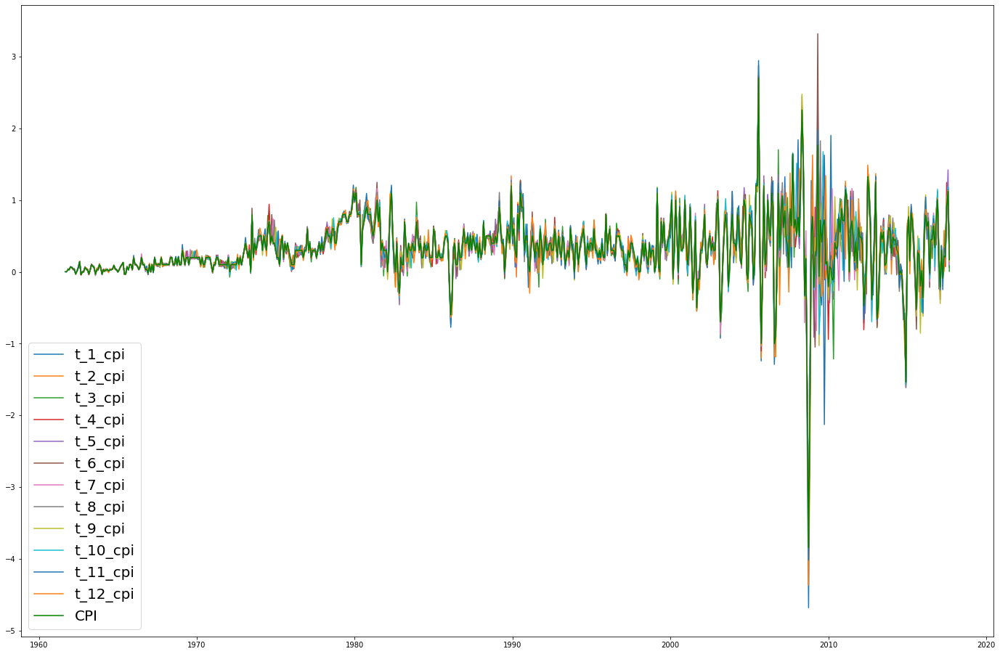

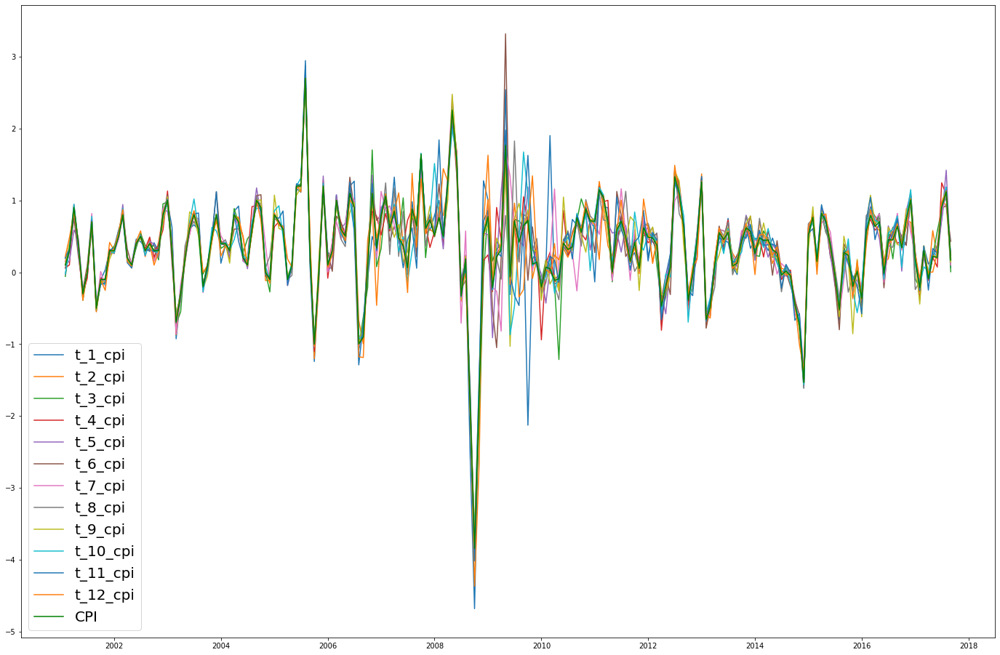

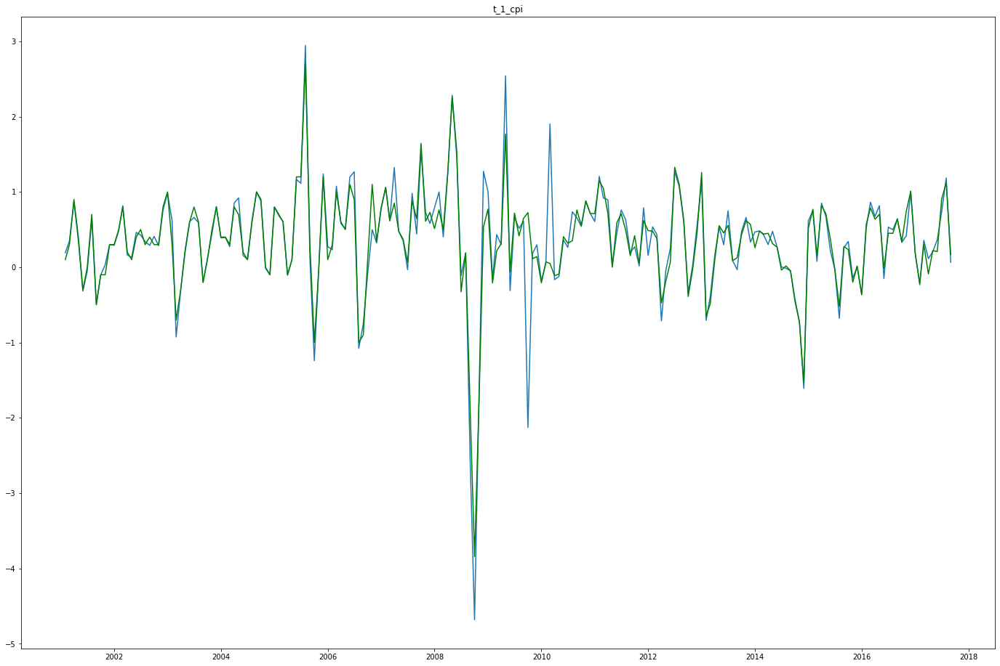

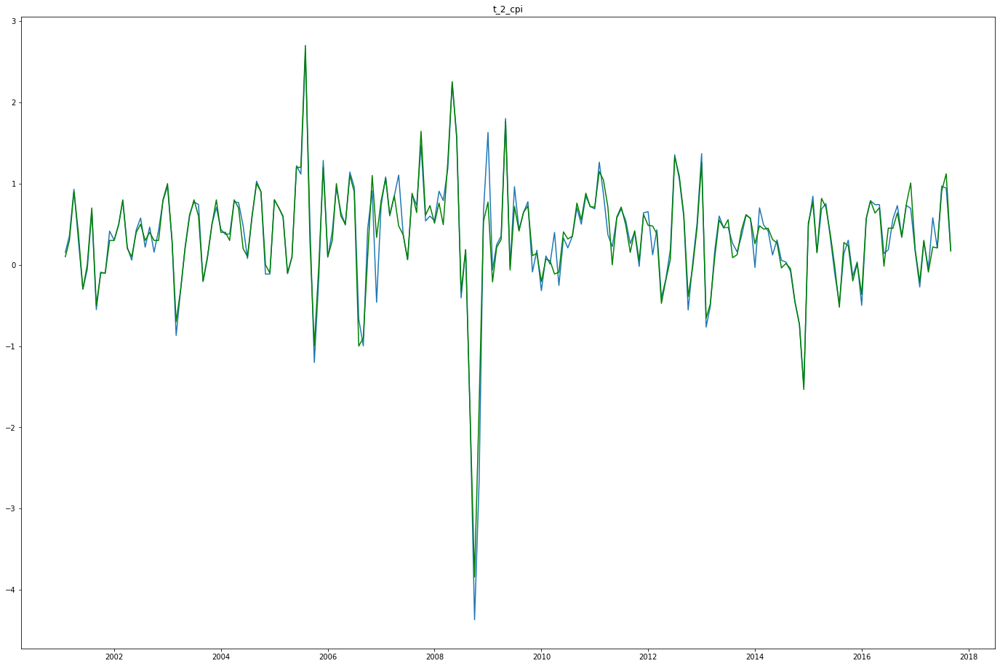

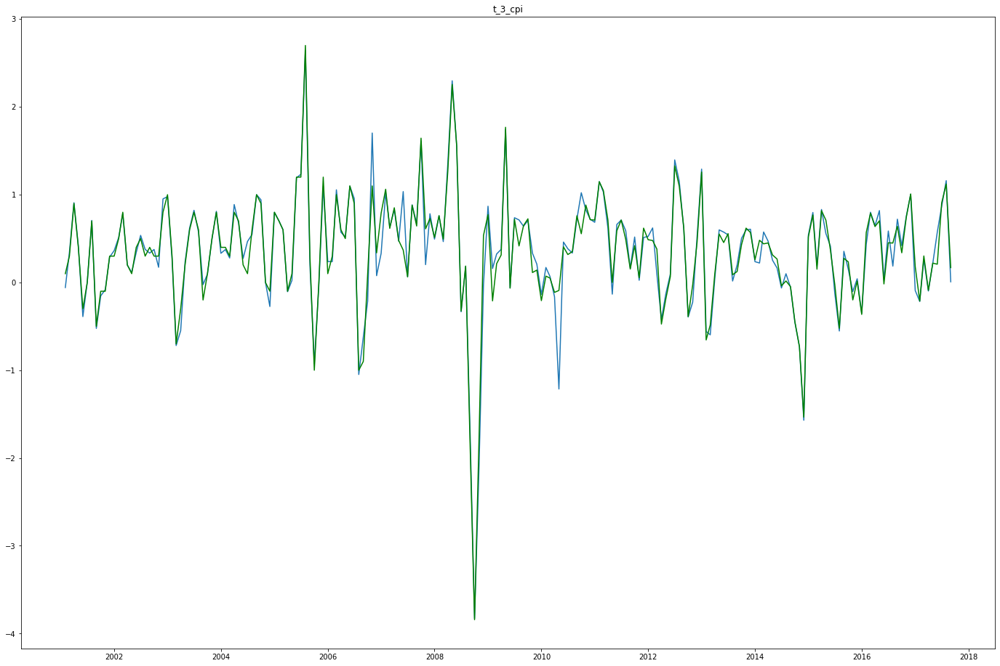

...

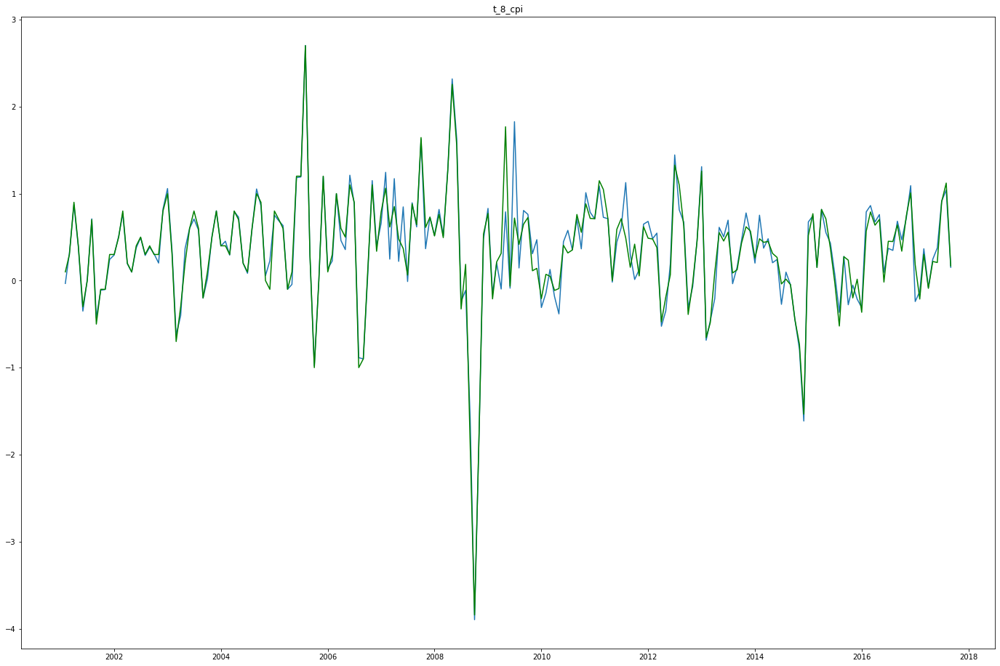

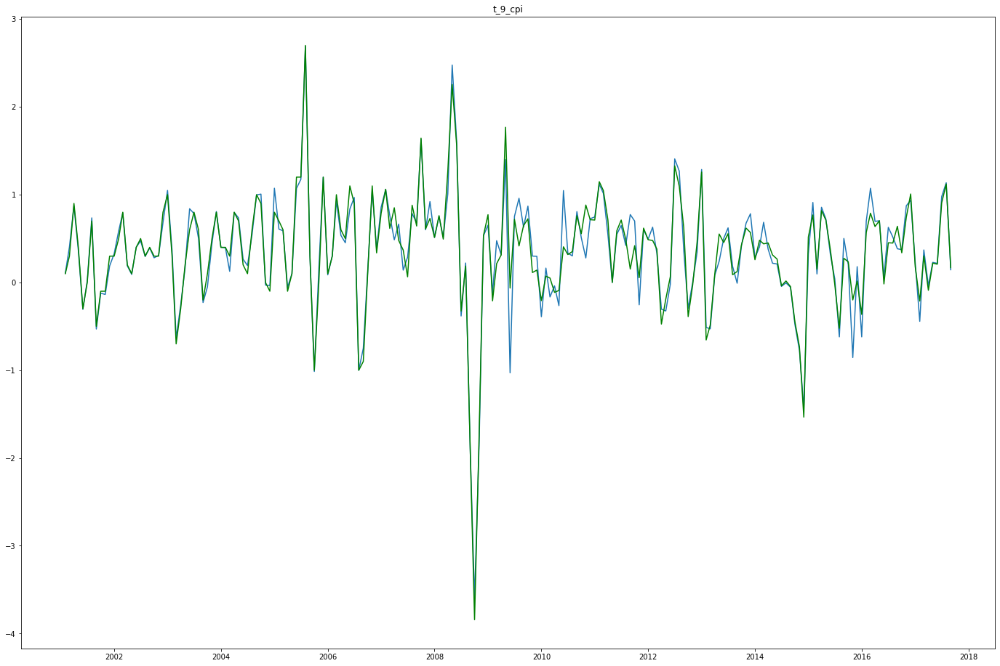

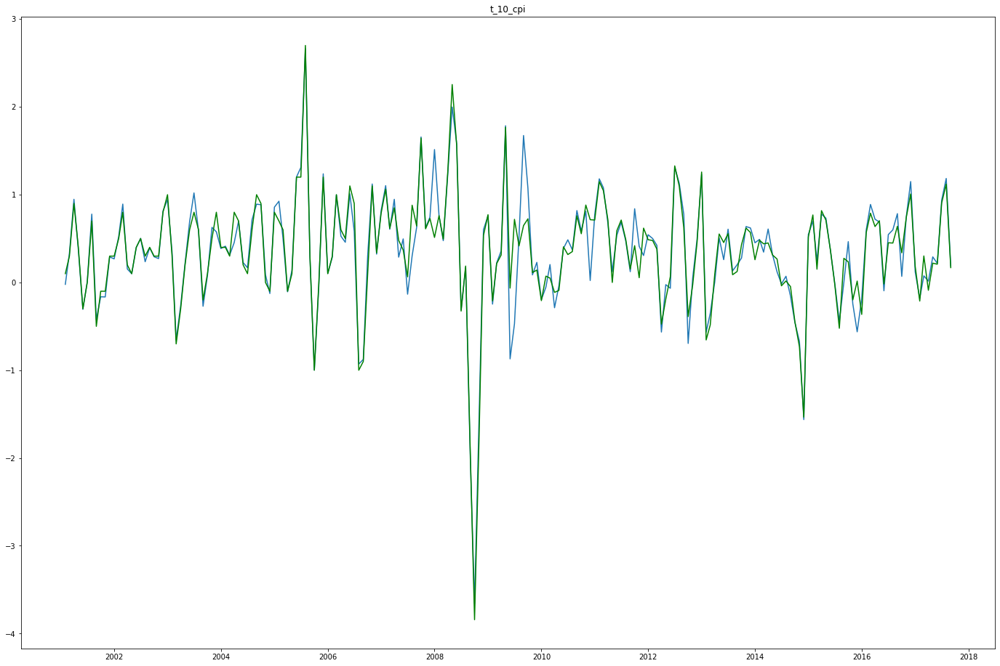

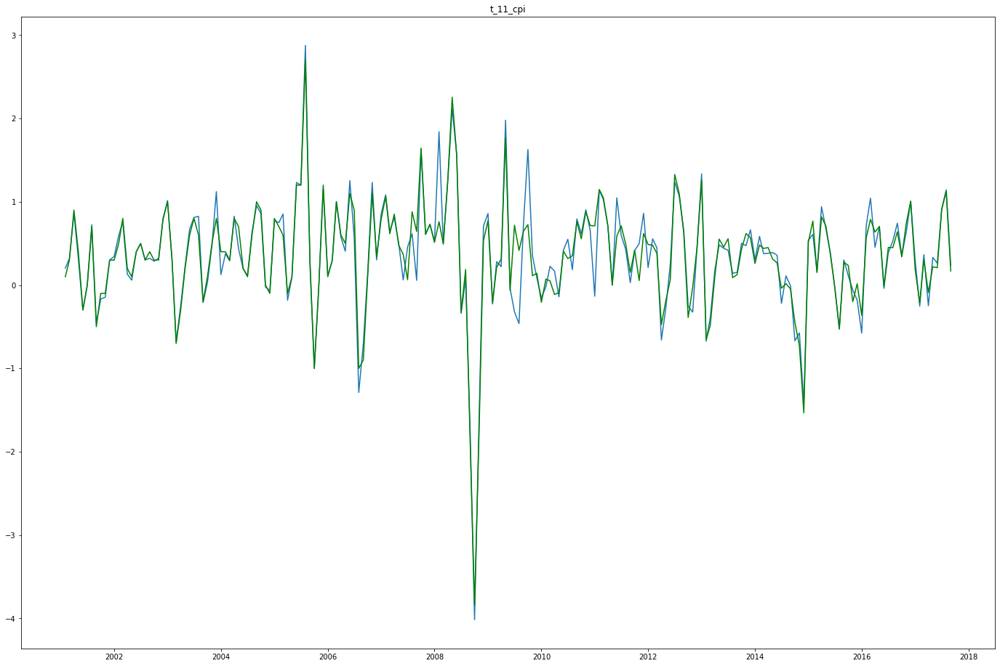

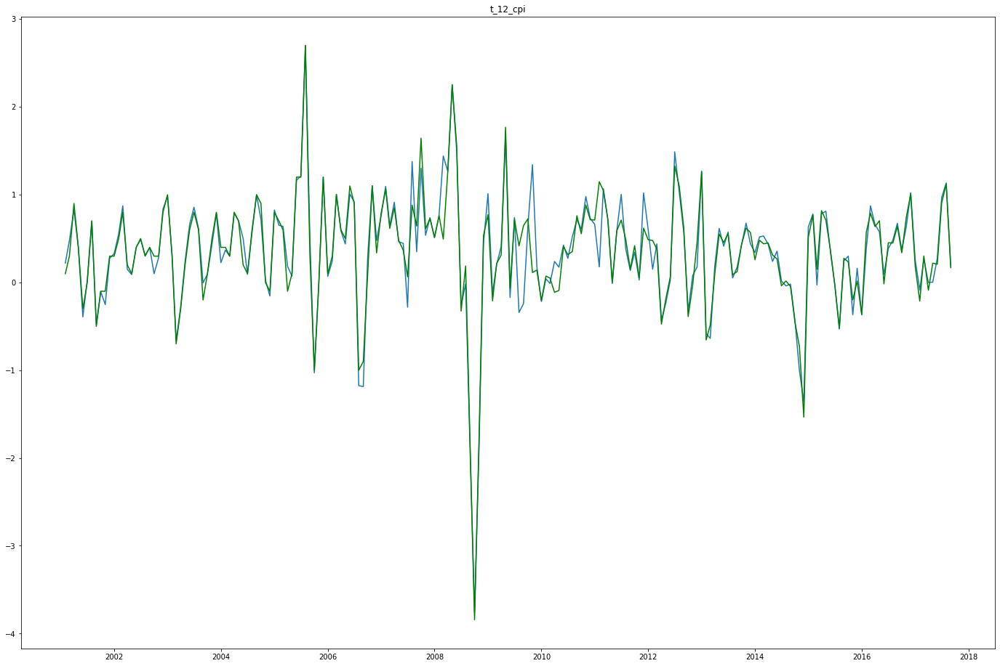

In [124]:
predictions_array = np.array(predictions_rolling)
# data_plt = pd.DataFrame(data.CPIAUCSL['2001-08-01':])
pred_df = pd.DataFrame({'t_1': predictions_array[:, 0], 't_2': predictions_array[:, 1],
                         't_3': predictions_array[:, 2], 't_4': predictions_array[:, 3],
                         't_5': predictions_array[:, 4], 't_6': predictions_array[:, 5],
                         't_7': predictions_array[:, 6], 't_8': predictions_array[:, 7],
                         't_9': predictions_array[:, 8], 't_10': predictions_array[:, 9],
                         't_11': predictions_array[:, 10], 't_12': predictions_array[:, 11]})

pred_plt = pd.DataFrame({'t_1' : pred_df['t_1'], 't_2' : pred_df['t_2'].shift(1),
                         't_3' : pred_df['t_3'].shift(2), 't_4' : pred_df['t_4'].shift(3),
                         't_5' : pred_df['t_5'].shift(4), 't_6' : pred_df['t_6'].shift(5),
                         't_7' : pred_df['t_7'].shift(6), 't_8' : pred_df['t_8'].shift(7),
                         't_9' : pred_df['t_9'].shift(8), 't_10' : pred_df['t_10'].shift(9),
                         't_11': pred_df['t_11'].shift(10), 't_12' : pred_df['t_12'].shift(11)})
for col in list(pred_plt):
#     pred_plt['{}_cpi'.format(col)] = ((pred_plt[col].shift(-12) / pred_plt[col]) - 1)*100
    pred_plt['{}_cpi'.format(col)] = pred_plt[col].shift(-1) - pred_plt[col]

pred_plt['raw_values'] = raw_values[start_idx:-1]
# pred_plt['raw_cpi'] = data.CPI.values[start_idx:-1]
pred_plt['raw_cpi'] = pred_plt['raw_values'].shift(-1) - pred_plt['raw_values']
pred_plt['date'] = data.index[start_idx:-1]
pred_plt.set_index('date', inplace=True)

mpl.rcParams['figure.figsize'] = (24,16)
for col in list(pred_plt)[12:-2]:
    ovr_mse = mean_squared_error(pred_plt['raw_cpi'].values[11:-23], pred_plt[col].values[11:-23])
    ovr_mae = mean_absolute_error(pred_plt['raw_cpi'].values[11:-23], pred_plt[col].values[11:-23])
    test_mse = mean_squared_error(pred_plt['raw_cpi'].iloc[round((len(pred_plt)-20)*.7):-23], 
                                  pred_plt[col].iloc[round((len(pred_plt)-20)*.7):-23])
    test_mae = mean_absolute_error(pred_plt['raw_cpi'].iloc[round((len(pred_plt)-20)*.7):-23], 
                                   pred_plt[col].iloc[round((len(pred_plt)-20)*.7):-23])
    print(col,': Overall RMSE: %.3f' % sqrt(ovr_mse), 'Test RMSE: %.3f' % sqrt(test_mse))
    print(col,': Overall MAE: %.3f' % ovr_mae, 'Test MAE: %.3f' % test_mae)
    plt.plot(pred_plt[col][:-23], label=col)
# line plot of observed vs predicted
# plt.plot(raw_values[20:], color='blue')
plt.plot(pred_plt['raw_cpi'][:-23], color='green', label='CPI')
# plt.plot(test[:,0], color='green')
plt.legend(prop={'size': 20})
plt.show()

for col in list(pred_plt)[12:-2]:
    plt.plot(pred_plt[col].iloc[round((len(pred_plt)-20)*.7):-23], label=col)
plt.plot(pred_plt['raw_cpi'].iloc[round((len(pred_plt)-20)*.7):-23], color='green', label='CPI')
# plt.plot(test[:,0], color='green')
plt.legend(prop={'size': 20})
plt.show()

i = 0
for col in list(pred_plt)[12:-2]:
    plt.plot(pred_plt[col].iloc[round((len(pred_plt)-20)*.7):-23], label=col)
    plt.plot(pred_plt['raw_cpi'].iloc[round((len(pred_plt)-20)*.7):-23], color='green', label='CPI')
    plt.title(col)
    plt.show()

No handles with labels found to put in legend.
/Users/Nick/anaconda3/lib/python3.6/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


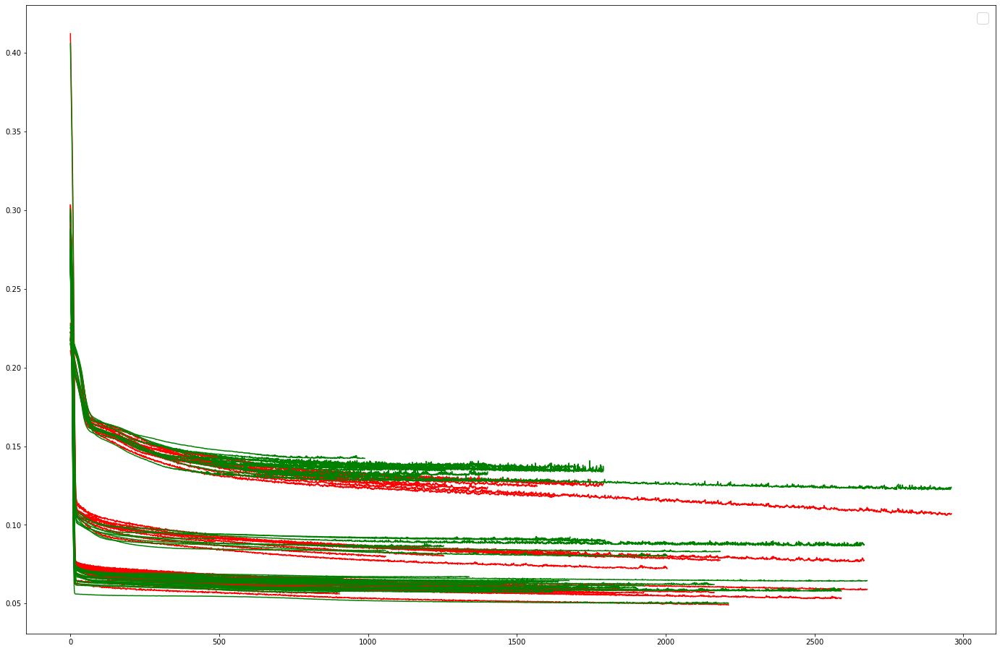

In [123]:
plt.plot(loss_df, color='red')
plt.plot(val_loss_df, color='green')
plt.legend(prop={'size': 20})
plt.show()

In [127]:
# transform data to be stationary
raw_values = data.CPIAUCSL_x.values
diff_values = difference(raw_values, 1)
 
# transform data to be supervised learning
# supervised = timeseries_to_supervised(diff_values, 1)
# print(supervised.shape)
# supervised_values = supervised.values
 
# split data into train and test-sets
train, test = split_dataset_1(diff_values, .7)
 
# transform the scale of the data
scaler, train_scaled, test_scaled = scale(train.values.reshape(-1, 1), test.values.reshape(-1, 1))

window=18
stepsout=12
# fit the model
conv_model, loss, val_loss = fit_conv(train_scaled, validate=True, batch_size=None, nb_epoch=25000, 
                                      neurons=(300,300,300), filter_size=8, drop=0.1, optimizer='adam', 
                                      window=window, callback=True, stepsout=stepsout, l_rate=.00001)

# # forecast the entire training dataset to build up state for forecasting
# # train_reshaped = train_scaled[:, 0].reshape(len(train_scaled), 1, 1)

# orig_test = test[:, 0].reshape(test.shape[0], 1, 1)
# moving_average_test = moving_frame(test[:, 0], [3, 6, 12])
# moving_average_test = moving_average_test.reshape(moving_average_test.shape[0], moving_average_test.shape[1], 1)
# predictions = conv_model.predict([orig_test, moving_average_test], batch_size=None)
loss += [np.nan] * (25000 - len(loss))
val_loss += [np.nan] * (25000 - len(val_loss))
loss_df = pd.DataFrame({'loss': loss})
val_loss_df = pd.DataFrame({'val_loss': val_loss})

start_idx = window + stepsout

# walk-forward validation on the test data
predictions_rolling_2 = list()
history = train.values[:start_idx]
for i in range(len(train[start_idx:])):
#     if i % 10 == 0:
#         print(i)
    scaler, train_scaled, test_scaled = scale(history.reshape(-1, 1), train[i+start_idx].reshape(1,-1))
    # make one-step forecast
#     X, y = test_scaled[:, 0:-1].reshape(1,1), test_scaled[:,-1]
#     history_x = train_scaled[:,0:-1]
#     X_history_x = np.vstack((history_x, X))
#     orig_ = X_history_x[-1, 0].reshape(1, 1, 1)
#     moving_average_ = moving_frame(X_history_x[:, 0], [3, 6, 12])
#     moving_average_ = moving_average_[-1].reshape(1, moving_average_.shape[1], 1)
    train_stack = np.vstack((train_scaled, test_scaled))
    split = split_sequence(train_stack, window, stepsout)
    X = split[0][-1]
    y = split[1][-1]
    orig_ = X.reshape(1, X.shape[0], X.shape[1])
    moving_average_ = split_sequences_multi(moving_frame(train_stack, [3, 6, 12]), window, stepsout)[-1]
    moving_average_ = moving_average_.reshape(1, moving_average_.shape[0], 
                                            moving_average_.shape[1])
    yhat = conv_model.predict([orig_, moving_average_], batch_size=None)
    # invert scaling
    yhat = invert_scale(scaler, X, yhat, stepsout)
    # invert differencing
    yhat = inverse_difference(raw_values, yhat, interval=len(train[start_idx:])+len(test)+1-i)
    # store forecast
    predictions_rolling_2.append(yhat)
    history = np.append(history, train[i+start_idx])
    
history = train.values
iteration = 0
for i in range(len(test)):
#     if i % 10 == 0:
#         print(i)
    scaler, train_scaled, test_scaled = scale(history.reshape(-1, 1), test.values[i].reshape(1, -1))
#     make one-step forecast
    if i % 5 == 0:
#     if len(train_scaled) in [529, 569]:
        iteration += 1
        conv_model, loss, val_loss = fit_conv(train_scaled, validate=True, batch_size=None, nb_epoch=25000, 
                                              neurons=(300,300,300), filter_size=8, drop=0.1, optimizer='adam', 
                                              window=window, callback=True, stepsout=stepsout, l_rate=.00001)
        loss += [np.nan] * (25000 - len(loss))
        val_loss += [np.nan] * (25000 - len(val_loss))
        loss_df['loss_{}'.format(iteration)] = loss
        val_loss_df['val_loss_{}'.format(iteration)] = val_loss
    train_stack = np.vstack((train_scaled, test_scaled))
    split = split_sequence(train_stack, window, stepsout)
    X = split[0][-1]
    y = split[1][-1]
    orig_ = X.reshape(1, X.shape[0], X.shape[1])
    moving_average_ = split_sequences_multi(moving_frame(train_stack, [3, 6, 12]), window, stepsout)[-1]
    moving_average_ = moving_average_.reshape(1, moving_average_.shape[0], 
                                            moving_average_.shape[1])
    yhat = conv_model.predict([orig_, moving_average_], batch_size=None)
    # invert scaling
    yhat = invert_scale(scaler, X, yhat, stepsout)
    # invert differencing
    yhat = inverse_difference(raw_values, yhat, interval=len(test)+1-i)
    # store forecast
    predictions_rolling_2.append(yhat)
    history = np.append(history, test.values[i])

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 18, 1)]      0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 18, 2)]      0                                            
__________________________________________________________________________________________________
model (Model)                   (None, 300)          3390        input_1[0][0]                    
__________________________________________________________________________________________________
model_1 (Model)                 (None, 300)          3470        input_2[0][0]                    
____________________________________________________________________________________________

Epoch 58/25000
431/431 - 0s - loss: 0.1694 - val_loss: 0.1689
Epoch 59/25000
431/431 - 0s - loss: 0.1690 - val_loss: 0.1681
Epoch 60/25000
431/431 - 0s - loss: 0.1682 - val_loss: 0.1673
Epoch 61/25000
431/431 - 0s - loss: 0.1672 - val_loss: 0.1665
Epoch 62/25000
431/431 - 0s - loss: 0.1668 - val_loss: 0.1658
Epoch 63/25000
431/431 - 0s - loss: 0.1658 - val_loss: 0.1651
Epoch 64/25000
431/431 - 0s - loss: 0.1651 - val_loss: 0.1644
Epoch 65/25000
431/431 - 0s - loss: 0.1647 - val_loss: 0.1638
Epoch 66/25000
431/431 - 0s - loss: 0.1644 - val_loss: 0.1633
Epoch 67/25000
431/431 - 0s - loss: 0.1642 - val_loss: 0.1628
Epoch 68/25000
431/431 - 0s - loss: 0.1637 - val_loss: 0.1623
Epoch 69/25000
431/431 - 0s - loss: 0.1631 - val_loss: 0.1620
Epoch 70/25000
431/431 - 0s - loss: 0.1628 - val_loss: 0.1617
Epoch 71/25000
431/431 - 0s - loss: 0.1624 - val_loss: 0.1613
Epoch 72/25000
431/431 - 0s - loss: 0.1626 - val_loss: 0.1610
Epoch 73/25000
431/431 - 0s - loss: 0.1618 - val_loss: 0.1608
Epoch 74

Epoch 189/25000
431/431 - 0s - loss: 0.1512 - val_loss: 0.1506
Epoch 190/25000
431/431 - 0s - loss: 0.1513 - val_loss: 0.1506
Epoch 191/25000
431/431 - 0s - loss: 0.1508 - val_loss: 0.1505
Epoch 192/25000
431/431 - 0s - loss: 0.1506 - val_loss: 0.1505
Epoch 193/25000
431/431 - 0s - loss: 0.1500 - val_loss: 0.1502
Epoch 194/25000
431/431 - 0s - loss: 0.1505 - val_loss: 0.1502
Epoch 195/25000
431/431 - 0s - loss: 0.1506 - val_loss: 0.1503
Epoch 196/25000
431/431 - 0s - loss: 0.1504 - val_loss: 0.1500
Epoch 197/25000
431/431 - 0s - loss: 0.1499 - val_loss: 0.1499
Epoch 198/25000
431/431 - 0s - loss: 0.1494 - val_loss: 0.1498
Epoch 199/25000
431/431 - 0s - loss: 0.1498 - val_loss: 0.1497
Epoch 200/25000
431/431 - 0s - loss: 0.1495 - val_loss: 0.1497
Epoch 201/25000
431/431 - 0s - loss: 0.1496 - val_loss: 0.1495
Epoch 202/25000
431/431 - 0s - loss: 0.1497 - val_loss: 0.1494
Epoch 203/25000
431/431 - 0s - loss: 0.1490 - val_loss: 0.1494
Epoch 204/25000
431/431 - 0s - loss: 0.1493 - val_loss:

431/431 - 0s - loss: 0.1421 - val_loss: 0.1437
Epoch 320/25000
431/431 - 0s - loss: 0.1418 - val_loss: 0.1436
Epoch 321/25000
431/431 - 0s - loss: 0.1422 - val_loss: 0.1435
Epoch 322/25000
431/431 - 0s - loss: 0.1425 - val_loss: 0.1436
Epoch 323/25000
431/431 - 0s - loss: 0.1419 - val_loss: 0.1438
Epoch 324/25000
431/431 - 0s - loss: 0.1425 - val_loss: 0.1438
Epoch 325/25000
431/431 - 0s - loss: 0.1424 - val_loss: 0.1434
Epoch 326/25000
431/431 - 0s - loss: 0.1426 - val_loss: 0.1434
Epoch 327/25000
431/431 - 0s - loss: 0.1419 - val_loss: 0.1435
Epoch 328/25000
431/431 - 0s - loss: 0.1418 - val_loss: 0.1436
Epoch 329/25000
431/431 - 0s - loss: 0.1415 - val_loss: 0.1435
Epoch 330/25000
431/431 - 0s - loss: 0.1420 - val_loss: 0.1436
Epoch 331/25000
431/431 - 0s - loss: 0.1415 - val_loss: 0.1436
Epoch 332/25000
431/431 - 0s - loss: 0.1419 - val_loss: 0.1434
Epoch 333/25000
431/431 - 0s - loss: 0.1415 - val_loss: 0.1434
Epoch 334/25000
431/431 - 0s - loss: 0.1422 - val_loss: 0.1434
Epoch 33

Epoch 450/25000
431/431 - 0s - loss: 0.1366 - val_loss: 0.1402
Epoch 451/25000
431/431 - 0s - loss: 0.1366 - val_loss: 0.1401
Epoch 452/25000
431/431 - 0s - loss: 0.1359 - val_loss: 0.1399
Epoch 453/25000
431/431 - 0s - loss: 0.1363 - val_loss: 0.1400
Epoch 454/25000
431/431 - 0s - loss: 0.1361 - val_loss: 0.1399
Epoch 455/25000
431/431 - 0s - loss: 0.1359 - val_loss: 0.1398
Epoch 456/25000
431/431 - 0s - loss: 0.1362 - val_loss: 0.1401
Epoch 457/25000
431/431 - 0s - loss: 0.1361 - val_loss: 0.1397
Epoch 458/25000
431/431 - 0s - loss: 0.1360 - val_loss: 0.1398
Epoch 459/25000
431/431 - 0s - loss: 0.1361 - val_loss: 0.1398
Epoch 460/25000
431/431 - 0s - loss: 0.1358 - val_loss: 0.1399
Epoch 461/25000
431/431 - 0s - loss: 0.1359 - val_loss: 0.1398
Epoch 462/25000
431/431 - 0s - loss: 0.1358 - val_loss: 0.1395
Epoch 463/25000
431/431 - 0s - loss: 0.1361 - val_loss: 0.1397
Epoch 464/25000
431/431 - 0s - loss: 0.1359 - val_loss: 0.1396
Epoch 465/25000
431/431 - 0s - loss: 0.1364 - val_loss:

431/431 - 0s - loss: 0.1323 - val_loss: 0.1360
Epoch 581/25000
431/431 - 0s - loss: 0.1319 - val_loss: 0.1356
Epoch 582/25000
431/431 - 0s - loss: 0.1313 - val_loss: 0.1355
Epoch 583/25000
431/431 - 0s - loss: 0.1319 - val_loss: 0.1354
Epoch 584/25000
431/431 - 0s - loss: 0.1312 - val_loss: 0.1356
Epoch 585/25000
431/431 - 0s - loss: 0.1322 - val_loss: 0.1354
Epoch 586/25000
431/431 - 0s - loss: 0.1318 - val_loss: 0.1357
Epoch 587/25000
431/431 - 0s - loss: 0.1318 - val_loss: 0.1353
Epoch 588/25000
431/431 - 0s - loss: 0.1320 - val_loss: 0.1357
Epoch 589/25000
431/431 - 0s - loss: 0.1316 - val_loss: 0.1353
Epoch 590/25000
431/431 - 0s - loss: 0.1320 - val_loss: 0.1357
Epoch 591/25000
431/431 - 0s - loss: 0.1319 - val_loss: 0.1351
Epoch 592/25000
431/431 - 0s - loss: 0.1313 - val_loss: 0.1355
Epoch 593/25000
431/431 - 0s - loss: 0.1311 - val_loss: 0.1351
Epoch 594/25000
431/431 - 0s - loss: 0.1309 - val_loss: 0.1352
Epoch 595/25000
431/431 - 0s - loss: 0.1309 - val_loss: 0.1353
Epoch 59

Epoch 711/25000
431/431 - 0s - loss: 0.1287 - val_loss: 0.1329
Epoch 712/25000
431/431 - 0s - loss: 0.1285 - val_loss: 0.1331
Epoch 713/25000
431/431 - 0s - loss: 0.1287 - val_loss: 0.1329
Epoch 714/25000
431/431 - 0s - loss: 0.1279 - val_loss: 0.1331
Epoch 715/25000
431/431 - 0s - loss: 0.1286 - val_loss: 0.1329
Epoch 716/25000
431/431 - 0s - loss: 0.1285 - val_loss: 0.1334
Epoch 717/25000
431/431 - 0s - loss: 0.1283 - val_loss: 0.1329
Epoch 718/25000
431/431 - 0s - loss: 0.1283 - val_loss: 0.1331
Epoch 719/25000
431/431 - 0s - loss: 0.1287 - val_loss: 0.1327
Epoch 720/25000
431/431 - 0s - loss: 0.1289 - val_loss: 0.1332
Epoch 721/25000
431/431 - 0s - loss: 0.1283 - val_loss: 0.1329
Epoch 722/25000
431/431 - 0s - loss: 0.1282 - val_loss: 0.1332
Epoch 723/25000
431/431 - 0s - loss: 0.1284 - val_loss: 0.1330
Epoch 724/25000
431/431 - 0s - loss: 0.1289 - val_loss: 0.1328
Epoch 725/25000
431/431 - 0s - loss: 0.1287 - val_loss: 0.1335
Epoch 726/25000
431/431 - 0s - loss: 0.1286 - val_loss:

431/431 - 0s - loss: 0.1264 - val_loss: 0.1312
Epoch 842/25000
431/431 - 0s - loss: 0.1262 - val_loss: 0.1316
Epoch 843/25000
431/431 - 0s - loss: 0.1261 - val_loss: 0.1312
Epoch 844/25000
431/431 - 0s - loss: 0.1262 - val_loss: 0.1314
Epoch 845/25000
431/431 - 0s - loss: 0.1261 - val_loss: 0.1316
Epoch 846/25000
431/431 - 0s - loss: 0.1264 - val_loss: 0.1311
Epoch 847/25000
431/431 - 0s - loss: 0.1261 - val_loss: 0.1322
Epoch 848/25000
431/431 - 0s - loss: 0.1264 - val_loss: 0.1315
Epoch 849/25000
431/431 - 0s - loss: 0.1262 - val_loss: 0.1315
Epoch 850/25000
431/431 - 0s - loss: 0.1259 - val_loss: 0.1324
Epoch 851/25000
431/431 - 0s - loss: 0.1270 - val_loss: 0.1319
Epoch 852/25000
431/431 - 0s - loss: 0.1274 - val_loss: 0.1349
Epoch 853/25000
431/431 - 0s - loss: 0.1279 - val_loss: 0.1312
Epoch 854/25000
431/431 - 0s - loss: 0.1257 - val_loss: 0.1315
Epoch 855/25000
431/431 - 0s - loss: 0.1257 - val_loss: 0.1310
Epoch 856/25000
431/431 - 0s - loss: 0.1254 - val_loss: 0.1318
Epoch 85

Epoch 972/25000
431/431 - 0s - loss: 0.1244 - val_loss: 0.1312
Epoch 973/25000
431/431 - 0s - loss: 0.1248 - val_loss: 0.1302
Epoch 974/25000
431/431 - 0s - loss: 0.1244 - val_loss: 0.1306
Epoch 975/25000
431/431 - 0s - loss: 0.1246 - val_loss: 0.1305
Epoch 976/25000
431/431 - 0s - loss: 0.1245 - val_loss: 0.1302
Epoch 977/25000
431/431 - 0s - loss: 0.1248 - val_loss: 0.1324
Epoch 978/25000
431/431 - 0s - loss: 0.1249 - val_loss: 0.1300
Epoch 979/25000
431/431 - 0s - loss: 0.1244 - val_loss: 0.1298
Epoch 980/25000
431/431 - 0s - loss: 0.1242 - val_loss: 0.1313
Epoch 981/25000
431/431 - 0s - loss: 0.1248 - val_loss: 0.1303
Epoch 982/25000
431/431 - 0s - loss: 0.1255 - val_loss: 0.1320
Epoch 983/25000
431/431 - 0s - loss: 0.1248 - val_loss: 0.1300
Epoch 984/25000
431/431 - 0s - loss: 0.1246 - val_loss: 0.1298
Epoch 985/25000
431/431 - 0s - loss: 0.1241 - val_loss: 0.1304
Epoch 986/25000
431/431 - 0s - loss: 0.1241 - val_loss: 0.1299
Epoch 987/25000
431/431 - 0s - loss: 0.1247 - val_loss:

Epoch 1101/25000
431/431 - 0s - loss: 0.1230 - val_loss: 0.1297
Epoch 1102/25000
431/431 - 0s - loss: 0.1233 - val_loss: 0.1289
Epoch 1103/25000
431/431 - 0s - loss: 0.1229 - val_loss: 0.1318
Epoch 1104/25000
431/431 - 0s - loss: 0.1238 - val_loss: 0.1287
Epoch 1105/25000
431/431 - 0s - loss: 0.1226 - val_loss: 0.1289
Epoch 1106/25000
431/431 - 0s - loss: 0.1234 - val_loss: 0.1297
Epoch 1107/25000
431/431 - 0s - loss: 0.1229 - val_loss: 0.1287
Epoch 1108/25000
431/431 - 0s - loss: 0.1233 - val_loss: 0.1306
Epoch 1109/25000
431/431 - 0s - loss: 0.1234 - val_loss: 0.1290
Epoch 1110/25000
431/431 - 0s - loss: 0.1227 - val_loss: 0.1287
Epoch 1111/25000
431/431 - 0s - loss: 0.1230 - val_loss: 0.1300
Epoch 1112/25000
431/431 - 0s - loss: 0.1225 - val_loss: 0.1289
Epoch 1113/25000
431/431 - 0s - loss: 0.1235 - val_loss: 0.1308
Epoch 1114/25000
431/431 - 0s - loss: 0.1236 - val_loss: 0.1298
Epoch 1115/25000
431/431 - 0s - loss: 0.1233 - val_loss: 0.1289
Epoch 1116/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1221 - val_loss: 0.1285
Epoch 1230/25000
431/431 - 0s - loss: 0.1226 - val_loss: 0.1294
Epoch 1231/25000
431/431 - 0s - loss: 0.1219 - val_loss: 0.1283
Epoch 1232/25000
431/431 - 0s - loss: 0.1222 - val_loss: 0.1316
Epoch 1233/25000
431/431 - 0s - loss: 0.1231 - val_loss: 0.1289
Epoch 1234/25000
431/431 - 0s - loss: 0.1223 - val_loss: 0.1281
Epoch 1235/25000
431/431 - 0s - loss: 0.1219 - val_loss: 0.1301
Epoch 1236/25000
431/431 - 0s - loss: 0.1220 - val_loss: 0.1282
Epoch 1237/25000
431/431 - 0s - loss: 0.1222 - val_loss: 0.1276
Epoch 1238/25000
431/431 - 0s - loss: 0.1214 - val_loss: 0.1292
Epoch 1239/25000
431/431 - 0s - loss: 0.1214 - val_loss: 0.1282
Epoch 1240/25000
431/431 - 0s - loss: 0.1220 - val_loss: 0.1298
Epoch 1241/25000
431/431 - 0s - loss: 0.1220 - val_loss: 0.1289
Epoch 1242/25000
431/431 - 0s - loss: 0.1229 - val_loss: 0.1281
Epoch 1243/25000
431/431 - 0s - loss: 0.1225 - val_loss: 0.1324
Epoch 1244/25000
431/431 - 0s - loss: 0.1230 - val_loss: 

Epoch 1358/25000
431/431 - 0s - loss: 0.1207 - val_loss: 0.1279
Epoch 1359/25000
431/431 - 0s - loss: 0.1199 - val_loss: 0.1273
Epoch 1360/25000
431/431 - 0s - loss: 0.1203 - val_loss: 0.1285
Epoch 1361/25000
431/431 - 0s - loss: 0.1209 - val_loss: 0.1283
Epoch 1362/25000
431/431 - 0s - loss: 0.1211 - val_loss: 0.1277
Epoch 1363/25000
431/431 - 0s - loss: 0.1216 - val_loss: 0.1323
Epoch 1364/25000
431/431 - 0s - loss: 0.1227 - val_loss: 0.1274
Epoch 1365/25000
431/431 - 0s - loss: 0.1203 - val_loss: 0.1274
Epoch 1366/25000
431/431 - 0s - loss: 0.1208 - val_loss: 0.1281
Epoch 1367/25000
431/431 - 0s - loss: 0.1206 - val_loss: 0.1274
Epoch 1368/25000
431/431 - 0s - loss: 0.1208 - val_loss: 0.1278
Epoch 1369/25000
431/431 - 0s - loss: 0.1205 - val_loss: 0.1279
Epoch 1370/25000
431/431 - 0s - loss: 0.1205 - val_loss: 0.1271
Epoch 1371/25000
431/431 - 0s - loss: 0.1211 - val_loss: 0.1287
Epoch 1372/25000
431/431 - 0s - loss: 0.1209 - val_loss: 0.1276
Epoch 1373/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1211 - val_loss: 0.1272
Epoch 1487/25000
431/431 - 0s - loss: 0.1202 - val_loss: 0.1300
Epoch 1488/25000
431/431 - 0s - loss: 0.1206 - val_loss: 0.1271
Epoch 1489/25000
431/431 - 0s - loss: 0.1204 - val_loss: 0.1271
Epoch 1490/25000
431/431 - 0s - loss: 0.1195 - val_loss: 0.1284
Epoch 1491/25000
431/431 - 0s - loss: 0.1197 - val_loss: 0.1273
Epoch 1492/25000
431/431 - 0s - loss: 0.1195 - val_loss: 0.1292
Epoch 1493/25000
431/431 - 0s - loss: 0.1208 - val_loss: 0.1275
Epoch 1494/25000
431/431 - 0s - loss: 0.1196 - val_loss: 0.1270
Epoch 1495/25000
431/431 - 0s - loss: 0.1197 - val_loss: 0.1298
Epoch 1496/25000
431/431 - 0s - loss: 0.1204 - val_loss: 0.1272
Epoch 1497/25000
431/431 - 0s - loss: 0.1203 - val_loss: 0.1267
Epoch 1498/25000
431/431 - 0s - loss: 0.1204 - val_loss: 0.1297
Epoch 1499/25000
431/431 - 0s - loss: 0.1203 - val_loss: 0.1273
Epoch 1500/25000
431/431 - 0s - loss: 0.1200 - val_loss: 0.1283
Epoch 1501/25000
431/431 - 0s - loss: 0.1206 - val_loss: 

Epoch 1615/25000
431/431 - 0s - loss: 0.1190 - val_loss: 0.1263
Epoch 1616/25000
431/431 - 0s - loss: 0.1194 - val_loss: 0.1289
Epoch 1617/25000
431/431 - 0s - loss: 0.1195 - val_loss: 0.1267
Epoch 1618/25000
431/431 - 0s - loss: 0.1194 - val_loss: 0.1277
Epoch 1619/25000
431/431 - 0s - loss: 0.1199 - val_loss: 0.1271
Epoch 1620/25000
431/431 - 0s - loss: 0.1193 - val_loss: 0.1267
Epoch 1621/25000
431/431 - 0s - loss: 0.1192 - val_loss: 0.1296
Epoch 1622/25000
431/431 - 0s - loss: 0.1197 - val_loss: 0.1267
Epoch 1623/25000
431/431 - 0s - loss: 0.1196 - val_loss: 0.1265
Epoch 1624/25000
431/431 - 0s - loss: 0.1190 - val_loss: 0.1294
Epoch 1625/25000
431/431 - 0s - loss: 0.1192 - val_loss: 0.1266
Epoch 1626/25000
431/431 - 0s - loss: 0.1192 - val_loss: 0.1270
Epoch 1627/25000
431/431 - 0s - loss: 0.1187 - val_loss: 0.1274
Epoch 1628/25000
431/431 - 0s - loss: 0.1191 - val_loss: 0.1267
Epoch 1629/25000
431/431 - 0s - loss: 0.1190 - val_loss: 0.1290
Epoch 1630/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1202 - val_loss: 0.1267
Epoch 1744/25000
431/431 - 0s - loss: 0.1180 - val_loss: 0.1264
Epoch 1745/25000
431/431 - 0s - loss: 0.1185 - val_loss: 0.1280
Epoch 1746/25000
431/431 - 0s - loss: 0.1192 - val_loss: 0.1272
Epoch 1747/25000
431/431 - 0s - loss: 0.1184 - val_loss: 0.1268
Epoch 1748/25000
431/431 - 0s - loss: 0.1189 - val_loss: 0.1295
Epoch 1749/25000
431/431 - 0s - loss: 0.1190 - val_loss: 0.1265
Epoch 1750/25000
431/431 - 0s - loss: 0.1181 - val_loss: 0.1264
Epoch 1751/25000
431/431 - 0s - loss: 0.1181 - val_loss: 0.1286
Epoch 1752/25000
431/431 - 0s - loss: 0.1188 - val_loss: 0.1262
Epoch 1753/25000
431/431 - 0s - loss: 0.1181 - val_loss: 0.1260
Epoch 1754/25000
431/431 - 0s - loss: 0.1178 - val_loss: 0.1278
Epoch 1755/25000
431/431 - 0s - loss: 0.1177 - val_loss: 0.1263
Epoch 1756/25000
431/431 - 0s - loss: 0.1180 - val_loss: 0.1269
Epoch 1757/25000
431/431 - 0s - loss: 0.1183 - val_loss: 0.1269
Epoch 1758/25000
431/431 - 0s - loss: 0.1180 - val_loss: 

Epoch 1872/25000
431/431 - 0s - loss: 0.1184 - val_loss: 0.1310
Epoch 1873/25000
431/431 - 0s - loss: 0.1193 - val_loss: 0.1262
Epoch 1874/25000
431/431 - 0s - loss: 0.1169 - val_loss: 0.1260
Epoch 1875/25000
431/431 - 0s - loss: 0.1170 - val_loss: 0.1266
Epoch 1876/25000
431/431 - 0s - loss: 0.1170 - val_loss: 0.1261
Epoch 1877/25000
431/431 - 0s - loss: 0.1172 - val_loss: 0.1259
Epoch 1878/25000
431/431 - 0s - loss: 0.1166 - val_loss: 0.1278
Epoch 1879/25000
431/431 - 0s - loss: 0.1175 - val_loss: 0.1259
Epoch 1880/25000
431/431 - 0s - loss: 0.1170 - val_loss: 0.1261
Epoch 1881/25000
431/431 - 0s - loss: 0.1170 - val_loss: 0.1275
Epoch 1882/25000
431/431 - 0s - loss: 0.1179 - val_loss: 0.1261
Epoch 1883/25000
431/431 - 0s - loss: 0.1172 - val_loss: 0.1281
Epoch 1884/25000
431/431 - 0s - loss: 0.1177 - val_loss: 0.1262
Epoch 1885/25000
431/431 - 0s - loss: 0.1175 - val_loss: 0.1257
Epoch 1886/25000
431/431 - 0s - loss: 0.1175 - val_loss: 0.1284
Epoch 1887/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1168 - val_loss: 0.1261
Epoch 2001/25000
431/431 - 0s - loss: 0.1165 - val_loss: 0.1257
Epoch 2002/25000
431/431 - 0s - loss: 0.1170 - val_loss: 0.1287
Epoch 2003/25000
431/431 - 0s - loss: 0.1173 - val_loss: 0.1255
Epoch 2004/25000
431/431 - 0s - loss: 0.1163 - val_loss: 0.1252
Epoch 2005/25000
431/431 - 0s - loss: 0.1157 - val_loss: 0.1268
Epoch 2006/25000
431/431 - 0s - loss: 0.1165 - val_loss: 0.1252
Epoch 2007/25000
431/431 - 0s - loss: 0.1159 - val_loss: 0.1253
Epoch 2008/25000
431/431 - 0s - loss: 0.1163 - val_loss: 0.1271
Epoch 2009/25000
431/431 - 0s - loss: 0.1159 - val_loss: 0.1256
Epoch 2010/25000
431/431 - 0s - loss: 0.1168 - val_loss: 0.1270
Epoch 2011/25000
431/431 - 0s - loss: 0.1172 - val_loss: 0.1264
Epoch 2012/25000
431/431 - 0s - loss: 0.1169 - val_loss: 0.1265
Epoch 2013/25000
431/431 - 0s - loss: 0.1173 - val_loss: 0.1302
Epoch 2014/25000
431/431 - 0s - loss: 0.1187 - val_loss: 0.1266
Epoch 2015/25000
431/431 - 0s - loss: 0.1167 - val_loss: 

Epoch 2129/25000
431/431 - 0s - loss: 0.1159 - val_loss: 0.1292
Epoch 2130/25000
431/431 - 0s - loss: 0.1171 - val_loss: 0.1253
Epoch 2131/25000
431/431 - 0s - loss: 0.1156 - val_loss: 0.1249
Epoch 2132/25000
431/431 - 0s - loss: 0.1153 - val_loss: 0.1269
Epoch 2133/25000
431/431 - 0s - loss: 0.1158 - val_loss: 0.1251
Epoch 2134/25000
431/431 - 0s - loss: 0.1148 - val_loss: 0.1250
Epoch 2135/25000
431/431 - 0s - loss: 0.1149 - val_loss: 0.1255
Epoch 2136/25000
431/431 - 0s - loss: 0.1151 - val_loss: 0.1249
Epoch 2137/25000
431/431 - 0s - loss: 0.1148 - val_loss: 0.1250
Epoch 2138/25000
431/431 - 0s - loss: 0.1150 - val_loss: 0.1252
Epoch 2139/25000
431/431 - 0s - loss: 0.1144 - val_loss: 0.1248
Epoch 2140/25000
431/431 - 0s - loss: 0.1146 - val_loss: 0.1265
Epoch 2141/25000
431/431 - 0s - loss: 0.1154 - val_loss: 0.1250
Epoch 2142/25000
431/431 - 0s - loss: 0.1149 - val_loss: 0.1254
Epoch 2143/25000
431/431 - 0s - loss: 0.1155 - val_loss: 0.1257
Epoch 2144/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1137 - val_loss: 0.1255
Epoch 2258/25000
431/431 - 0s - loss: 0.1141 - val_loss: 0.1249
Epoch 2259/25000
431/431 - 0s - loss: 0.1142 - val_loss: 0.1275
Epoch 2260/25000
431/431 - 0s - loss: 0.1153 - val_loss: 0.1250
Epoch 2261/25000
431/431 - 0s - loss: 0.1139 - val_loss: 0.1249
Epoch 2262/25000
431/431 - 0s - loss: 0.1136 - val_loss: 0.1261
Epoch 2263/25000
431/431 - 0s - loss: 0.1141 - val_loss: 0.1247
Epoch 2264/25000
431/431 - 0s - loss: 0.1143 - val_loss: 0.1255
Epoch 2265/25000
431/431 - 0s - loss: 0.1138 - val_loss: 0.1249
Epoch 2266/25000
431/431 - 0s - loss: 0.1138 - val_loss: 0.1246
Epoch 2267/25000
431/431 - 0s - loss: 0.1133 - val_loss: 0.1266
Epoch 2268/25000
431/431 - 0s - loss: 0.1144 - val_loss: 0.1248
Epoch 2269/25000
431/431 - 0s - loss: 0.1141 - val_loss: 0.1250
Epoch 2270/25000
431/431 - 0s - loss: 0.1141 - val_loss: 0.1258
Epoch 2271/25000
431/431 - 0s - loss: 0.1144 - val_loss: 0.1249
Epoch 2272/25000
431/431 - 0s - loss: 0.1145 - val_loss: 

Epoch 2386/25000
431/431 - 0s - loss: 0.1123 - val_loss: 0.1247
Epoch 2387/25000
431/431 - 0s - loss: 0.1130 - val_loss: 0.1243
Epoch 2388/25000
431/431 - 0s - loss: 0.1133 - val_loss: 0.1267
Epoch 2389/25000
431/431 - 0s - loss: 0.1137 - val_loss: 0.1245
Epoch 2390/25000
431/431 - 0s - loss: 0.1135 - val_loss: 0.1254
Epoch 2391/25000
431/431 - 0s - loss: 0.1135 - val_loss: 0.1247
Epoch 2392/25000
431/431 - 0s - loss: 0.1132 - val_loss: 0.1246
Epoch 2393/25000
431/431 - 0s - loss: 0.1134 - val_loss: 0.1275
Epoch 2394/25000
431/431 - 0s - loss: 0.1141 - val_loss: 0.1246
Epoch 2395/25000
431/431 - 0s - loss: 0.1131 - val_loss: 0.1243
Epoch 2396/25000
431/431 - 0s - loss: 0.1129 - val_loss: 0.1257
Epoch 2397/25000
431/431 - 0s - loss: 0.1129 - val_loss: 0.1244
Epoch 2398/25000
431/431 - 0s - loss: 0.1130 - val_loss: 0.1249
Epoch 2399/25000
431/431 - 0s - loss: 0.1130 - val_loss: 0.1253
Epoch 2400/25000
431/431 - 0s - loss: 0.1126 - val_loss: 0.1245
Epoch 2401/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1122 - val_loss: 0.1238
Epoch 2515/25000
431/431 - 0s - loss: 0.1120 - val_loss: 0.1256
Epoch 2516/25000
431/431 - 0s - loss: 0.1119 - val_loss: 0.1239
Epoch 2517/25000
431/431 - 0s - loss: 0.1123 - val_loss: 0.1248
Epoch 2518/25000
431/431 - 0s - loss: 0.1117 - val_loss: 0.1245
Epoch 2519/25000
431/431 - 0s - loss: 0.1117 - val_loss: 0.1241
Epoch 2520/25000
431/431 - 0s - loss: 0.1123 - val_loss: 0.1268
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 18, 1)]      0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 18, 2)]      0                                            
_________________________________________________________

Epoch 51/25000
431/431 - 0s - loss: 0.1728 - val_loss: 0.1705
Epoch 52/25000
431/431 - 0s - loss: 0.1717 - val_loss: 0.1694
Epoch 53/25000
431/431 - 0s - loss: 0.1707 - val_loss: 0.1684
Epoch 54/25000
431/431 - 0s - loss: 0.1698 - val_loss: 0.1674
Epoch 55/25000
431/431 - 0s - loss: 0.1690 - val_loss: 0.1666
Epoch 56/25000
431/431 - 0s - loss: 0.1680 - val_loss: 0.1657
Epoch 57/25000
431/431 - 0s - loss: 0.1671 - val_loss: 0.1649
Epoch 58/25000
431/431 - 0s - loss: 0.1669 - val_loss: 0.1642
Epoch 59/25000
431/431 - 0s - loss: 0.1664 - val_loss: 0.1636
Epoch 60/25000
431/431 - 0s - loss: 0.1657 - val_loss: 0.1630
Epoch 61/25000
431/431 - 0s - loss: 0.1650 - val_loss: 0.1625
Epoch 62/25000
431/431 - 0s - loss: 0.1645 - val_loss: 0.1620
Epoch 63/25000
431/431 - 0s - loss: 0.1644 - val_loss: 0.1615
Epoch 64/25000
431/431 - 0s - loss: 0.1638 - val_loss: 0.1611
Epoch 65/25000
431/431 - 0s - loss: 0.1637 - val_loss: 0.1607
Epoch 66/25000
431/431 - 0s - loss: 0.1634 - val_loss: 0.1603
Epoch 67

Epoch 182/25000
431/431 - 0s - loss: 0.1541 - val_loss: 0.1515
Epoch 183/25000
431/431 - 0s - loss: 0.1538 - val_loss: 0.1514
Epoch 184/25000
431/431 - 0s - loss: 0.1535 - val_loss: 0.1513
Epoch 185/25000
431/431 - 0s - loss: 0.1536 - val_loss: 0.1513
Epoch 186/25000
431/431 - 0s - loss: 0.1536 - val_loss: 0.1512
Epoch 187/25000
431/431 - 0s - loss: 0.1532 - val_loss: 0.1511
Epoch 188/25000
431/431 - 0s - loss: 0.1529 - val_loss: 0.1511
Epoch 189/25000
431/431 - 0s - loss: 0.1533 - val_loss: 0.1510
Epoch 190/25000
431/431 - 0s - loss: 0.1533 - val_loss: 0.1509
Epoch 191/25000
431/431 - 0s - loss: 0.1530 - val_loss: 0.1508
Epoch 192/25000
431/431 - 0s - loss: 0.1526 - val_loss: 0.1508
Epoch 193/25000
431/431 - 0s - loss: 0.1526 - val_loss: 0.1507
Epoch 194/25000
431/431 - 0s - loss: 0.1529 - val_loss: 0.1506
Epoch 195/25000
431/431 - 0s - loss: 0.1528 - val_loss: 0.1505
Epoch 196/25000
431/431 - 0s - loss: 0.1525 - val_loss: 0.1505
Epoch 197/25000
431/431 - 0s - loss: 0.1527 - val_loss:

431/431 - 0s - loss: 0.1435 - val_loss: 0.1410
Epoch 313/25000
431/431 - 0s - loss: 0.1438 - val_loss: 0.1410
Epoch 314/25000
431/431 - 0s - loss: 0.1436 - val_loss: 0.1408
Epoch 315/25000
431/431 - 0s - loss: 0.1438 - val_loss: 0.1407
Epoch 316/25000
431/431 - 0s - loss: 0.1438 - val_loss: 0.1407
Epoch 317/25000
431/431 - 0s - loss: 0.1434 - val_loss: 0.1406
Epoch 318/25000
431/431 - 0s - loss: 0.1429 - val_loss: 0.1406
Epoch 319/25000
431/431 - 0s - loss: 0.1429 - val_loss: 0.1405
Epoch 320/25000
431/431 - 0s - loss: 0.1430 - val_loss: 0.1404
Epoch 321/25000
431/431 - 0s - loss: 0.1430 - val_loss: 0.1403
Epoch 322/25000
431/431 - 0s - loss: 0.1430 - val_loss: 0.1402
Epoch 323/25000
431/431 - 0s - loss: 0.1433 - val_loss: 0.1401
Epoch 324/25000
431/431 - 0s - loss: 0.1427 - val_loss: 0.1401
Epoch 325/25000
431/431 - 0s - loss: 0.1426 - val_loss: 0.1400
Epoch 326/25000
431/431 - 0s - loss: 0.1434 - val_loss: 0.1399
Epoch 327/25000
431/431 - 0s - loss: 0.1422 - val_loss: 0.1399
Epoch 32

Epoch 443/25000
431/431 - 0s - loss: 0.1361 - val_loss: 0.1342
Epoch 444/25000
431/431 - 0s - loss: 0.1367 - val_loss: 0.1343
Epoch 445/25000
431/431 - 0s - loss: 0.1363 - val_loss: 0.1343
Epoch 446/25000
431/431 - 0s - loss: 0.1366 - val_loss: 0.1342
Epoch 447/25000
431/431 - 0s - loss: 0.1361 - val_loss: 0.1342
Epoch 448/25000
431/431 - 0s - loss: 0.1366 - val_loss: 0.1342
Epoch 449/25000
431/431 - 0s - loss: 0.1358 - val_loss: 0.1341
Epoch 450/25000
431/431 - 0s - loss: 0.1365 - val_loss: 0.1342
Epoch 451/25000
431/431 - 0s - loss: 0.1360 - val_loss: 0.1341
Epoch 452/25000
431/431 - 0s - loss: 0.1364 - val_loss: 0.1341
Epoch 453/25000
431/431 - 0s - loss: 0.1360 - val_loss: 0.1340
Epoch 454/25000
431/431 - 0s - loss: 0.1361 - val_loss: 0.1339
Epoch 455/25000
431/431 - 0s - loss: 0.1365 - val_loss: 0.1339
Epoch 456/25000
431/431 - 0s - loss: 0.1362 - val_loss: 0.1338
Epoch 457/25000
431/431 - 0s - loss: 0.1364 - val_loss: 0.1339
Epoch 458/25000
431/431 - 0s - loss: 0.1362 - val_loss:

431/431 - 0s - loss: 0.1328 - val_loss: 0.1321
Epoch 574/25000
431/431 - 0s - loss: 0.1321 - val_loss: 0.1323
Epoch 575/25000
431/431 - 0s - loss: 0.1327 - val_loss: 0.1321
Epoch 576/25000
431/431 - 0s - loss: 0.1317 - val_loss: 0.1322
Epoch 577/25000
431/431 - 0s - loss: 0.1323 - val_loss: 0.1321
Epoch 578/25000
431/431 - 0s - loss: 0.1319 - val_loss: 0.1320
Epoch 579/25000
431/431 - 0s - loss: 0.1320 - val_loss: 0.1322
Epoch 580/25000
431/431 - 0s - loss: 0.1316 - val_loss: 0.1320
Epoch 581/25000
431/431 - 0s - loss: 0.1318 - val_loss: 0.1321
Epoch 582/25000
431/431 - 0s - loss: 0.1315 - val_loss: 0.1320
Epoch 583/25000
431/431 - 0s - loss: 0.1312 - val_loss: 0.1321
Epoch 584/25000
431/431 - 0s - loss: 0.1317 - val_loss: 0.1319
Epoch 585/25000
431/431 - 0s - loss: 0.1315 - val_loss: 0.1321
Epoch 586/25000
431/431 - 0s - loss: 0.1316 - val_loss: 0.1320
Epoch 587/25000
431/431 - 0s - loss: 0.1314 - val_loss: 0.1321
Epoch 588/25000
431/431 - 0s - loss: 0.1314 - val_loss: 0.1322
Epoch 58

Epoch 704/25000
431/431 - 0s - loss: 0.1280 - val_loss: 0.1309
Epoch 705/25000
431/431 - 0s - loss: 0.1286 - val_loss: 0.1311
Epoch 706/25000
431/431 - 0s - loss: 0.1284 - val_loss: 0.1308
Epoch 707/25000
431/431 - 0s - loss: 0.1283 - val_loss: 0.1313
Epoch 708/25000
431/431 - 0s - loss: 0.1288 - val_loss: 0.1308
Epoch 709/25000
431/431 - 0s - loss: 0.1284 - val_loss: 0.1312
Epoch 710/25000
431/431 - 0s - loss: 0.1282 - val_loss: 0.1308
Epoch 711/25000
431/431 - 0s - loss: 0.1284 - val_loss: 0.1309
Epoch 712/25000
431/431 - 0s - loss: 0.1287 - val_loss: 0.1311
Epoch 713/25000
431/431 - 0s - loss: 0.1285 - val_loss: 0.1309
Epoch 714/25000
431/431 - 0s - loss: 0.1280 - val_loss: 0.1311
Epoch 715/25000
431/431 - 0s - loss: 0.1278 - val_loss: 0.1308
Epoch 716/25000
431/431 - 0s - loss: 0.1283 - val_loss: 0.1311
Epoch 717/25000
431/431 - 0s - loss: 0.1277 - val_loss: 0.1308
Epoch 718/25000
431/431 - 0s - loss: 0.1282 - val_loss: 0.1308
Epoch 719/25000
431/431 - 0s - loss: 0.1278 - val_loss:

431/431 - 0s - loss: 0.1263 - val_loss: 0.1303
Epoch 835/25000
431/431 - 0s - loss: 0.1262 - val_loss: 0.1302
Epoch 836/25000
431/431 - 0s - loss: 0.1264 - val_loss: 0.1302
Epoch 837/25000
431/431 - 0s - loss: 0.1263 - val_loss: 0.1301
Epoch 838/25000
431/431 - 0s - loss: 0.1256 - val_loss: 0.1304
Epoch 839/25000
431/431 - 0s - loss: 0.1264 - val_loss: 0.1301
Epoch 840/25000
431/431 - 0s - loss: 0.1260 - val_loss: 0.1304
Epoch 841/25000
431/431 - 0s - loss: 0.1259 - val_loss: 0.1302
Epoch 842/25000
431/431 - 0s - loss: 0.1259 - val_loss: 0.1301
Epoch 843/25000
431/431 - 0s - loss: 0.1263 - val_loss: 0.1301
Epoch 844/25000
431/431 - 0s - loss: 0.1258 - val_loss: 0.1302
Epoch 845/25000
431/431 - 0s - loss: 0.1259 - val_loss: 0.1299
Epoch 846/25000
431/431 - 0s - loss: 0.1261 - val_loss: 0.1305
Epoch 847/25000
431/431 - 0s - loss: 0.1256 - val_loss: 0.1300
Epoch 848/25000
431/431 - 0s - loss: 0.1263 - val_loss: 0.1304
Epoch 849/25000
431/431 - 0s - loss: 0.1259 - val_loss: 0.1301
Epoch 85

Epoch 965/25000
431/431 - 0s - loss: 0.1248 - val_loss: 0.1298
Epoch 966/25000
431/431 - 0s - loss: 0.1249 - val_loss: 0.1299
Epoch 967/25000
431/431 - 0s - loss: 0.1257 - val_loss: 0.1296
Epoch 968/25000
431/431 - 0s - loss: 0.1253 - val_loss: 0.1307
Epoch 969/25000
431/431 - 0s - loss: 0.1252 - val_loss: 0.1292
Epoch 970/25000
431/431 - 0s - loss: 0.1247 - val_loss: 0.1295
Epoch 971/25000
431/431 - 0s - loss: 0.1251 - val_loss: 0.1303
Epoch 972/25000
431/431 - 0s - loss: 0.1253 - val_loss: 0.1295
Epoch 973/25000
431/431 - 0s - loss: 0.1249 - val_loss: 0.1300
Epoch 974/25000
431/431 - 0s - loss: 0.1246 - val_loss: 0.1293
Epoch 975/25000
431/431 - 0s - loss: 0.1245 - val_loss: 0.1292
Epoch 976/25000
431/431 - 0s - loss: 0.1248 - val_loss: 0.1298
Epoch 977/25000
431/431 - 0s - loss: 0.1244 - val_loss: 0.1292
Epoch 978/25000
431/431 - 0s - loss: 0.1242 - val_loss: 0.1295
Epoch 979/25000
431/431 - 0s - loss: 0.1239 - val_loss: 0.1294
Epoch 980/25000
431/431 - 0s - loss: 0.1239 - val_loss:

Epoch 1094/25000
431/431 - 0s - loss: 0.1228 - val_loss: 0.1291
Epoch 1095/25000
431/431 - 0s - loss: 0.1228 - val_loss: 0.1291
Epoch 1096/25000
431/431 - 0s - loss: 0.1238 - val_loss: 0.1292
Epoch 1097/25000
431/431 - 0s - loss: 0.1233 - val_loss: 0.1289
Epoch 1098/25000
431/431 - 0s - loss: 0.1233 - val_loss: 0.1291
Epoch 1099/25000
431/431 - 0s - loss: 0.1233 - val_loss: 0.1291
Epoch 1100/25000
431/431 - 0s - loss: 0.1231 - val_loss: 0.1288
Epoch 1101/25000
431/431 - 0s - loss: 0.1233 - val_loss: 0.1290
Epoch 1102/25000
431/431 - 0s - loss: 0.1234 - val_loss: 0.1291
Epoch 1103/25000
431/431 - 0s - loss: 0.1239 - val_loss: 0.1289
Epoch 1104/25000
431/431 - 0s - loss: 0.1229 - val_loss: 0.1288
Epoch 1105/25000
431/431 - 0s - loss: 0.1234 - val_loss: 0.1300
Epoch 1106/25000
431/431 - 0s - loss: 0.1239 - val_loss: 0.1288
Epoch 1107/25000
431/431 - 0s - loss: 0.1236 - val_loss: 0.1291
Epoch 1108/25000
431/431 - 0s - loss: 0.1236 - val_loss: 0.1296
Epoch 1109/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1221 - val_loss: 0.1293
Epoch 1223/25000
431/431 - 0s - loss: 0.1222 - val_loss: 0.1287
Epoch 1224/25000
431/431 - 0s - loss: 0.1225 - val_loss: 0.1286
Epoch 1225/25000
431/431 - 0s - loss: 0.1226 - val_loss: 0.1290
Epoch 1226/25000
431/431 - 0s - loss: 0.1222 - val_loss: 0.1285
Epoch 1227/25000
431/431 - 0s - loss: 0.1223 - val_loss: 0.1287
Epoch 1228/25000
431/431 - 0s - loss: 0.1226 - val_loss: 0.1290
Epoch 1229/25000
431/431 - 0s - loss: 0.1223 - val_loss: 0.1285
Epoch 1230/25000
431/431 - 0s - loss: 0.1225 - val_loss: 0.1289
Epoch 1231/25000
431/431 - 0s - loss: 0.1217 - val_loss: 0.1285
Epoch 1232/25000
431/431 - 0s - loss: 0.1217 - val_loss: 0.1285
Epoch 1233/25000
431/431 - 0s - loss: 0.1223 - val_loss: 0.1286
Epoch 1234/25000
431/431 - 0s - loss: 0.1220 - val_loss: 0.1285
Epoch 1235/25000
431/431 - 0s - loss: 0.1225 - val_loss: 0.1284
Epoch 1236/25000
431/431 - 0s - loss: 0.1223 - val_loss: 0.1288
Epoch 1237/25000
431/431 - 0s - loss: 0.1220 - val_loss: 

Epoch 1351/25000
431/431 - 0s - loss: 0.1212 - val_loss: 0.1285
Epoch 1352/25000
431/431 - 0s - loss: 0.1216 - val_loss: 0.1283
Epoch 1353/25000
431/431 - 0s - loss: 0.1206 - val_loss: 0.1287
Epoch 1354/25000
431/431 - 0s - loss: 0.1212 - val_loss: 0.1285
Epoch 1355/25000
431/431 - 0s - loss: 0.1212 - val_loss: 0.1282
Epoch 1356/25000
431/431 - 0s - loss: 0.1208 - val_loss: 0.1289
Epoch 1357/25000
431/431 - 0s - loss: 0.1210 - val_loss: 0.1284
Epoch 1358/25000
431/431 - 0s - loss: 0.1216 - val_loss: 0.1286
Epoch 1359/25000
431/431 - 0s - loss: 0.1221 - val_loss: 0.1297
Epoch 1360/25000
431/431 - 0s - loss: 0.1215 - val_loss: 0.1282
Epoch 1361/25000
431/431 - 0s - loss: 0.1219 - val_loss: 0.1289
Epoch 1362/25000
431/431 - 0s - loss: 0.1221 - val_loss: 0.1292
Epoch 1363/25000
431/431 - 0s - loss: 0.1222 - val_loss: 0.1284
Epoch 1364/25000
431/431 - 0s - loss: 0.1214 - val_loss: 0.1295
Epoch 1365/25000
431/431 - 0s - loss: 0.1218 - val_loss: 0.1285
Epoch 1366/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1216 - val_loss: 0.1280
Epoch 1480/25000
431/431 - 0s - loss: 0.1208 - val_loss: 0.1286
Epoch 1481/25000
431/431 - 0s - loss: 0.1205 - val_loss: 0.1286
Epoch 1482/25000
431/431 - 0s - loss: 0.1205 - val_loss: 0.1281
Epoch 1483/25000
431/431 - 0s - loss: 0.1204 - val_loss: 0.1288
Epoch 1484/25000
431/431 - 0s - loss: 0.1203 - val_loss: 0.1283
Epoch 1485/25000
431/431 - 0s - loss: 0.1198 - val_loss: 0.1282
Epoch 1486/25000
431/431 - 0s - loss: 0.1209 - val_loss: 0.1289
Epoch 1487/25000
431/431 - 0s - loss: 0.1203 - val_loss: 0.1279
Epoch 1488/25000
431/431 - 0s - loss: 0.1204 - val_loss: 0.1285
Epoch 1489/25000
431/431 - 0s - loss: 0.1209 - val_loss: 0.1289
Epoch 1490/25000
431/431 - 0s - loss: 0.1206 - val_loss: 0.1283
Epoch 1491/25000
431/431 - 0s - loss: 0.1205 - val_loss: 0.1293
Epoch 1492/25000
431/431 - 0s - loss: 0.1206 - val_loss: 0.1286
Epoch 1493/25000
431/431 - 0s - loss: 0.1211 - val_loss: 0.1283
Epoch 1494/25000
431/431 - 0s - loss: 0.1209 - val_loss: 

Epoch 1608/25000
431/431 - 0s - loss: 0.1198 - val_loss: 0.1278
Epoch 1609/25000
431/431 - 0s - loss: 0.1197 - val_loss: 0.1285
Epoch 1610/25000
431/431 - 0s - loss: 0.1198 - val_loss: 0.1290
Epoch 1611/25000
431/431 - 0s - loss: 0.1196 - val_loss: 0.1279
Epoch 1612/25000
431/431 - 0s - loss: 0.1195 - val_loss: 0.1286
Epoch 1613/25000
431/431 - 0s - loss: 0.1198 - val_loss: 0.1284
Epoch 1614/25000
431/431 - 0s - loss: 0.1199 - val_loss: 0.1281
Epoch 1615/25000
431/431 - 0s - loss: 0.1202 - val_loss: 0.1296
Epoch 1616/25000
431/431 - 0s - loss: 0.1203 - val_loss: 0.1279
Epoch 1617/25000
431/431 - 0s - loss: 0.1208 - val_loss: 0.1282
Epoch 1618/25000
431/431 - 0s - loss: 0.1203 - val_loss: 0.1298
Epoch 1619/25000
431/431 - 0s - loss: 0.1196 - val_loss: 0.1277
Epoch 1620/25000
431/431 - 0s - loss: 0.1201 - val_loss: 0.1285
Epoch 1621/25000
431/431 - 0s - loss: 0.1200 - val_loss: 0.1286
Epoch 1622/25000
431/431 - 0s - loss: 0.1196 - val_loss: 0.1281
Epoch 1623/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1192 - val_loss: 0.1280
Epoch 1737/25000
431/431 - 0s - loss: 0.1189 - val_loss: 0.1282
Epoch 1738/25000
431/431 - 0s - loss: 0.1198 - val_loss: 0.1301
Epoch 1739/25000
431/431 - 0s - loss: 0.1193 - val_loss: 0.1280
Epoch 1740/25000
431/431 - 0s - loss: 0.1188 - val_loss: 0.1287
Epoch 1741/25000
431/431 - 0s - loss: 0.1192 - val_loss: 0.1279
Epoch 1742/25000
431/431 - 0s - loss: 0.1187 - val_loss: 0.1279
Epoch 1743/25000
431/431 - 0s - loss: 0.1189 - val_loss: 0.1290
Epoch 1744/25000
431/431 - 0s - loss: 0.1185 - val_loss: 0.1277
Epoch 1745/25000
431/431 - 0s - loss: 0.1184 - val_loss: 0.1281
Epoch 1746/25000
431/431 - 0s - loss: 0.1188 - val_loss: 0.1281
Epoch 1747/25000
431/431 - 0s - loss: 0.1186 - val_loss: 0.1279
Epoch 1748/25000
431/431 - 0s - loss: 0.1192 - val_loss: 0.1293
Epoch 1749/25000
431/431 - 0s - loss: 0.1186 - val_loss: 0.1277
Epoch 1750/25000
431/431 - 0s - loss: 0.1194 - val_loss: 0.1286
Epoch 1751/25000
431/431 - 0s - loss: 0.1192 - val_loss: 

Epoch 1865/25000
431/431 - 0s - loss: 0.1178 - val_loss: 0.1278
Epoch 1866/25000
431/431 - 0s - loss: 0.1181 - val_loss: 0.1288
Epoch 1867/25000
431/431 - 0s - loss: 0.1182 - val_loss: 0.1280
Epoch 1868/25000
431/431 - 0s - loss: 0.1178 - val_loss: 0.1281
Epoch 1869/25000
431/431 - 0s - loss: 0.1185 - val_loss: 0.1295
Epoch 1870/25000
431/431 - 0s - loss: 0.1187 - val_loss: 0.1276
Epoch 1871/25000
431/431 - 0s - loss: 0.1181 - val_loss: 0.1283
Epoch 1872/25000
431/431 - 0s - loss: 0.1190 - val_loss: 0.1299
Epoch 1873/25000
431/431 - 0s - loss: 0.1187 - val_loss: 0.1279
Epoch 1874/25000
431/431 - 0s - loss: 0.1183 - val_loss: 0.1287
Epoch 1875/25000
431/431 - 0s - loss: 0.1189 - val_loss: 0.1283
Epoch 1876/25000
431/431 - 0s - loss: 0.1182 - val_loss: 0.1286
Epoch 1877/25000
431/431 - 0s - loss: 0.1189 - val_loss: 0.1304
Epoch 1878/25000
431/431 - 0s - loss: 0.1187 - val_loss: 0.1276
Epoch 1879/25000
431/431 - 0s - loss: 0.1176 - val_loss: 0.1279
Epoch 1880/25000
431/431 - 0s - loss: 0.

431/431 - 0s - loss: 0.1178 - val_loss: 0.1281
Epoch 1994/25000
431/431 - 0s - loss: 0.1177 - val_loss: 0.1283
Epoch 1995/25000
431/431 - 0s - loss: 0.1176 - val_loss: 0.1294
Epoch 1996/25000
431/431 - 0s - loss: 0.1183 - val_loss: 0.1275
Epoch 1997/25000
431/431 - 0s - loss: 0.1174 - val_loss: 0.1281
Epoch 1998/25000
431/431 - 0s - loss: 0.1178 - val_loss: 0.1299
Epoch 1999/25000
431/431 - 0s - loss: 0.1170 - val_loss: 0.1277
Epoch 2000/25000
431/431 - 0s - loss: 0.1176 - val_loss: 0.1284
Epoch 2001/25000
431/431 - 0s - loss: 0.1174 - val_loss: 0.1281
Epoch 2002/25000
431/431 - 0s - loss: 0.1175 - val_loss: 0.1281
Epoch 2003/25000
431/431 - 0s - loss: 0.1172 - val_loss: 0.1297
Epoch 2004/25000
431/431 - 0s - loss: 0.1173 - val_loss: 0.1278
Epoch 2005/25000
431/431 - 0s - loss: 0.1173 - val_loss: 0.1282
Epoch 2006/25000
431/431 - 0s - loss: 0.1170 - val_loss: 0.1298
Epoch 2007/25000
431/431 - 0s - loss: 0.1176 - val_loss: 0.1275
Epoch 2008/25000
431/431 - 0s - loss: 0.1174 - val_loss: 

Train on 435 samples, validate on 49 samples
Epoch 1/25000
435/435 - 1s - loss: 0.2214 - val_loss: 0.2218
Epoch 2/25000
435/435 - 0s - loss: 0.2202 - val_loss: 0.2209
Epoch 3/25000
435/435 - 0s - loss: 0.2193 - val_loss: 0.2200
Epoch 4/25000
435/435 - 0s - loss: 0.2183 - val_loss: 0.2192
Epoch 5/25000
435/435 - 0s - loss: 0.2177 - val_loss: 0.2185
Epoch 6/25000
435/435 - 0s - loss: 0.2166 - val_loss: 0.2177
Epoch 7/25000
435/435 - 0s - loss: 0.2163 - val_loss: 0.2170
Epoch 8/25000
435/435 - 0s - loss: 0.2152 - val_loss: 0.2163
Epoch 9/25000
435/435 - 0s - loss: 0.2145 - val_loss: 0.2156
Epoch 10/25000
435/435 - 0s - loss: 0.2137 - val_loss: 0.2149
Epoch 11/25000
435/435 - 0s - loss: 0.2132 - val_loss: 0.2142
Epoch 12/25000
435/435 - 0s - loss: 0.2123 - val_loss: 0.2135
Epoch 13/25000
435/435 - 0s - loss: 0.2119 - val_loss: 0.2128
Epoch 14/25000
435/435 - 0s - loss: 0.2113 - val_loss: 0.2122
Epoch 15/25000
435/435 - 0s - loss: 0.2105 - val_loss: 0.2115
Epoch 16/25000
435/435 - 0s - loss

435/435 - 0s - loss: 0.1581 - val_loss: 0.1584
Epoch 133/25000
435/435 - 0s - loss: 0.1578 - val_loss: 0.1583
Epoch 134/25000
435/435 - 0s - loss: 0.1581 - val_loss: 0.1583
Epoch 135/25000
435/435 - 0s - loss: 0.1578 - val_loss: 0.1582
Epoch 136/25000
435/435 - 0s - loss: 0.1576 - val_loss: 0.1582
Epoch 137/25000
435/435 - 0s - loss: 0.1577 - val_loss: 0.1581
Epoch 138/25000
435/435 - 0s - loss: 0.1575 - val_loss: 0.1581
Epoch 139/25000
435/435 - 0s - loss: 0.1578 - val_loss: 0.1580
Epoch 140/25000
435/435 - 0s - loss: 0.1572 - val_loss: 0.1579
Epoch 141/25000
435/435 - 0s - loss: 0.1576 - val_loss: 0.1578
Epoch 142/25000
435/435 - 0s - loss: 0.1577 - val_loss: 0.1578
Epoch 143/25000
435/435 - 0s - loss: 0.1572 - val_loss: 0.1577
Epoch 144/25000
435/435 - 0s - loss: 0.1572 - val_loss: 0.1577
Epoch 145/25000
435/435 - 0s - loss: 0.1570 - val_loss: 0.1576
Epoch 146/25000
435/435 - 0s - loss: 0.1574 - val_loss: 0.1575
Epoch 147/25000
435/435 - 0s - loss: 0.1570 - val_loss: 0.1574
Epoch 14

Epoch 263/25000
435/435 - 0s - loss: 0.1461 - val_loss: 0.1472
Epoch 264/25000
435/435 - 0s - loss: 0.1462 - val_loss: 0.1472
Epoch 265/25000
435/435 - 0s - loss: 0.1459 - val_loss: 0.1471
Epoch 266/25000
435/435 - 0s - loss: 0.1456 - val_loss: 0.1472
Epoch 267/25000
435/435 - 0s - loss: 0.1455 - val_loss: 0.1470
Epoch 268/25000
435/435 - 0s - loss: 0.1457 - val_loss: 0.1469
Epoch 269/25000
435/435 - 0s - loss: 0.1456 - val_loss: 0.1468
Epoch 270/25000
435/435 - 0s - loss: 0.1452 - val_loss: 0.1467
Epoch 271/25000
435/435 - 0s - loss: 0.1457 - val_loss: 0.1467
Epoch 272/25000
435/435 - 0s - loss: 0.1461 - val_loss: 0.1466
Epoch 273/25000
435/435 - 0s - loss: 0.1457 - val_loss: 0.1466
Epoch 274/25000
435/435 - 0s - loss: 0.1455 - val_loss: 0.1465
Epoch 275/25000
435/435 - 0s - loss: 0.1446 - val_loss: 0.1464
Epoch 276/25000
435/435 - 0s - loss: 0.1451 - val_loss: 0.1462
Epoch 277/25000
435/435 - 0s - loss: 0.1454 - val_loss: 0.1461
Epoch 278/25000
435/435 - 0s - loss: 0.1447 - val_loss:

435/435 - 0s - loss: 0.1366 - val_loss: 0.1390
Epoch 394/25000
435/435 - 0s - loss: 0.1371 - val_loss: 0.1392
Epoch 395/25000
435/435 - 0s - loss: 0.1370 - val_loss: 0.1390
Epoch 396/25000
435/435 - 0s - loss: 0.1370 - val_loss: 0.1388
Epoch 397/25000
435/435 - 0s - loss: 0.1366 - val_loss: 0.1389
Epoch 398/25000
435/435 - 0s - loss: 0.1368 - val_loss: 0.1387
Epoch 399/25000
435/435 - 0s - loss: 0.1363 - val_loss: 0.1386
Epoch 400/25000
435/435 - 0s - loss: 0.1369 - val_loss: 0.1388
Epoch 401/25000
435/435 - 0s - loss: 0.1369 - val_loss: 0.1386
Epoch 402/25000
435/435 - 0s - loss: 0.1365 - val_loss: 0.1389
Epoch 403/25000
435/435 - 0s - loss: 0.1362 - val_loss: 0.1387
Epoch 404/25000
435/435 - 0s - loss: 0.1362 - val_loss: 0.1383
Epoch 405/25000
435/435 - 0s - loss: 0.1361 - val_loss: 0.1385
Epoch 406/25000
435/435 - 0s - loss: 0.1359 - val_loss: 0.1385
Epoch 407/25000
435/435 - 0s - loss: 0.1367 - val_loss: 0.1383
Epoch 408/25000
435/435 - 0s - loss: 0.1363 - val_loss: 0.1383
Epoch 40

Epoch 524/25000
435/435 - 0s - loss: 0.1315 - val_loss: 0.1347
Epoch 525/25000
435/435 - 0s - loss: 0.1319 - val_loss: 0.1345
Epoch 526/25000
435/435 - 0s - loss: 0.1322 - val_loss: 0.1344
Epoch 527/25000
435/435 - 0s - loss: 0.1323 - val_loss: 0.1347
Epoch 528/25000
435/435 - 0s - loss: 0.1320 - val_loss: 0.1350
Epoch 529/25000
435/435 - 0s - loss: 0.1318 - val_loss: 0.1342
Epoch 530/25000
435/435 - 0s - loss: 0.1318 - val_loss: 0.1348
Epoch 531/25000
435/435 - 0s - loss: 0.1316 - val_loss: 0.1346
Epoch 532/25000
435/435 - 0s - loss: 0.1318 - val_loss: 0.1346
Epoch 533/25000
435/435 - 0s - loss: 0.1317 - val_loss: 0.1343
Epoch 534/25000
435/435 - 0s - loss: 0.1313 - val_loss: 0.1342
Epoch 535/25000
435/435 - 0s - loss: 0.1316 - val_loss: 0.1339
Epoch 536/25000
435/435 - 0s - loss: 0.1317 - val_loss: 0.1344
Epoch 537/25000
435/435 - 0s - loss: 0.1316 - val_loss: 0.1342
Epoch 538/25000
435/435 - 0s - loss: 0.1316 - val_loss: 0.1339
Epoch 539/25000
435/435 - 0s - loss: 0.1318 - val_loss:

435/435 - 0s - loss: 0.1287 - val_loss: 0.1324
Epoch 655/25000
435/435 - 0s - loss: 0.1290 - val_loss: 0.1321
Epoch 656/25000
435/435 - 0s - loss: 0.1287 - val_loss: 0.1316
Epoch 657/25000
435/435 - 0s - loss: 0.1289 - val_loss: 0.1320
Epoch 658/25000
435/435 - 0s - loss: 0.1289 - val_loss: 0.1317
Epoch 659/25000
435/435 - 0s - loss: 0.1283 - val_loss: 0.1321
Epoch 660/25000
435/435 - 0s - loss: 0.1288 - val_loss: 0.1316
Epoch 661/25000
435/435 - 0s - loss: 0.1289 - val_loss: 0.1320
Epoch 662/25000
435/435 - 0s - loss: 0.1288 - val_loss: 0.1315
Epoch 663/25000
435/435 - 0s - loss: 0.1291 - val_loss: 0.1329
Epoch 664/25000
435/435 - 0s - loss: 0.1290 - val_loss: 0.1318
Epoch 665/25000
435/435 - 0s - loss: 0.1290 - val_loss: 0.1325
Epoch 666/25000
435/435 - 0s - loss: 0.1290 - val_loss: 0.1320
Epoch 667/25000
435/435 - 0s - loss: 0.1286 - val_loss: 0.1319
Epoch 668/25000
435/435 - 0s - loss: 0.1286 - val_loss: 0.1321
Epoch 669/25000
435/435 - 0s - loss: 0.1283 - val_loss: 0.1316
Epoch 67

Epoch 785/25000
435/435 - 0s - loss: 0.1270 - val_loss: 0.1304
Epoch 786/25000
435/435 - 0s - loss: 0.1270 - val_loss: 0.1311
Epoch 787/25000
435/435 - 0s - loss: 0.1267 - val_loss: 0.1308
Epoch 788/25000
435/435 - 0s - loss: 0.1267 - val_loss: 0.1308
Epoch 789/25000
435/435 - 0s - loss: 0.1267 - val_loss: 0.1306
Epoch 790/25000
435/435 - 0s - loss: 0.1266 - val_loss: 0.1304
Epoch 791/25000
435/435 - 0s - loss: 0.1263 - val_loss: 0.1308
Epoch 792/25000
435/435 - 0s - loss: 0.1264 - val_loss: 0.1305
Epoch 793/25000
435/435 - 0s - loss: 0.1265 - val_loss: 0.1306
Epoch 794/25000
435/435 - 0s - loss: 0.1269 - val_loss: 0.1306
Epoch 795/25000
435/435 - 0s - loss: 0.1265 - val_loss: 0.1305
Epoch 796/25000
435/435 - 0s - loss: 0.1265 - val_loss: 0.1307
Epoch 797/25000
435/435 - 0s - loss: 0.1262 - val_loss: 0.1306
Epoch 798/25000
435/435 - 0s - loss: 0.1263 - val_loss: 0.1305
Epoch 799/25000
435/435 - 0s - loss: 0.1269 - val_loss: 0.1307
Epoch 800/25000
435/435 - 0s - loss: 0.1264 - val_loss:

435/435 - 0s - loss: 0.1251 - val_loss: 0.1300
Epoch 916/25000
435/435 - 0s - loss: 0.1256 - val_loss: 0.1300
Epoch 917/25000
435/435 - 0s - loss: 0.1253 - val_loss: 0.1300
Epoch 918/25000
435/435 - 0s - loss: 0.1252 - val_loss: 0.1301
Epoch 919/25000
435/435 - 0s - loss: 0.1251 - val_loss: 0.1299
Epoch 920/25000
435/435 - 0s - loss: 0.1253 - val_loss: 0.1300
Epoch 921/25000
435/435 - 0s - loss: 0.1252 - val_loss: 0.1299
Epoch 922/25000
435/435 - 0s - loss: 0.1257 - val_loss: 0.1298
Epoch 923/25000
435/435 - 0s - loss: 0.1255 - val_loss: 0.1305
Epoch 924/25000
435/435 - 0s - loss: 0.1250 - val_loss: 0.1300
Epoch 925/25000
435/435 - 0s - loss: 0.1254 - val_loss: 0.1299
Epoch 926/25000
435/435 - 0s - loss: 0.1252 - val_loss: 0.1303
Epoch 927/25000
435/435 - 0s - loss: 0.1253 - val_loss: 0.1298
Epoch 928/25000
435/435 - 0s - loss: 0.1253 - val_loss: 0.1304
Epoch 929/25000
435/435 - 0s - loss: 0.1252 - val_loss: 0.1298
Epoch 930/25000
435/435 - 0s - loss: 0.1255 - val_loss: 0.1302
Epoch 93

Epoch 1045/25000
435/435 - 0s - loss: 0.1243 - val_loss: 0.1296
Epoch 1046/25000
435/435 - 0s - loss: 0.1252 - val_loss: 0.1303
Epoch 1047/25000
435/435 - 0s - loss: 0.1249 - val_loss: 0.1301
Epoch 1048/25000
435/435 - 0s - loss: 0.1244 - val_loss: 0.1293
Epoch 1049/25000
435/435 - 0s - loss: 0.1248 - val_loss: 0.1310
Epoch 1050/25000
435/435 - 0s - loss: 0.1255 - val_loss: 0.1314
Epoch 1051/25000
435/435 - 0s - loss: 0.1257 - val_loss: 0.1312
Epoch 1052/25000
435/435 - 0s - loss: 0.1253 - val_loss: 0.1300
Epoch 1053/25000
435/435 - 0s - loss: 0.1243 - val_loss: 0.1296
Epoch 1054/25000
435/435 - 0s - loss: 0.1248 - val_loss: 0.1298
Epoch 1055/25000
435/435 - 0s - loss: 0.1244 - val_loss: 0.1298
Epoch 1056/25000
435/435 - 0s - loss: 0.1246 - val_loss: 0.1293
Epoch 1057/25000
435/435 - 0s - loss: 0.1247 - val_loss: 0.1303
Epoch 1058/25000
435/435 - 0s - loss: 0.1247 - val_loss: 0.1301
Epoch 1059/25000
435/435 - 0s - loss: 0.1250 - val_loss: 0.1299
Epoch 1060/25000
435/435 - 0s - loss: 0.

435/435 - 0s - loss: 0.1241 - val_loss: 0.1297
Epoch 1174/25000
435/435 - 0s - loss: 0.1237 - val_loss: 0.1297
Epoch 1175/25000
435/435 - 0s - loss: 0.1245 - val_loss: 0.1300
Epoch 1176/25000
435/435 - 0s - loss: 0.1238 - val_loss: 0.1295
Epoch 1177/25000
435/435 - 0s - loss: 0.1231 - val_loss: 0.1292
Epoch 1178/25000
435/435 - 0s - loss: 0.1238 - val_loss: 0.1299
Epoch 1179/25000
435/435 - 0s - loss: 0.1233 - val_loss: 0.1296
Epoch 1180/25000
435/435 - 0s - loss: 0.1237 - val_loss: 0.1291
Epoch 1181/25000
435/435 - 0s - loss: 0.1234 - val_loss: 0.1298
Epoch 1182/25000
435/435 - 0s - loss: 0.1241 - val_loss: 0.1299
Epoch 1183/25000
435/435 - 0s - loss: 0.1237 - val_loss: 0.1296
Epoch 1184/25000
435/435 - 0s - loss: 0.1240 - val_loss: 0.1299
Epoch 1185/25000
435/435 - 0s - loss: 0.1239 - val_loss: 0.1298
Epoch 1186/25000
435/435 - 0s - loss: 0.1240 - val_loss: 0.1298
Epoch 1187/25000
435/435 - 0s - loss: 0.1237 - val_loss: 0.1298
Epoch 1188/25000
435/435 - 0s - loss: 0.1237 - val_loss: 

Epoch 1302/25000
435/435 - 0s - loss: 0.1235 - val_loss: 0.1294
Epoch 1303/25000
435/435 - 0s - loss: 0.1235 - val_loss: 0.1293
Epoch 1304/25000
435/435 - 0s - loss: 0.1229 - val_loss: 0.1292
Epoch 1305/25000
435/435 - 0s - loss: 0.1224 - val_loss: 0.1289
Epoch 1306/25000
435/435 - 0s - loss: 0.1225 - val_loss: 0.1296
Epoch 1307/25000
435/435 - 0s - loss: 0.1233 - val_loss: 0.1293
Epoch 1308/25000
435/435 - 0s - loss: 0.1227 - val_loss: 0.1293
Epoch 1309/25000
435/435 - 0s - loss: 0.1229 - val_loss: 0.1296
Epoch 1310/25000
435/435 - 0s - loss: 0.1230 - val_loss: 0.1290
Epoch 1311/25000
435/435 - 0s - loss: 0.1239 - val_loss: 0.1297
Epoch 1312/25000
435/435 - 0s - loss: 0.1227 - val_loss: 0.1305
Epoch 1313/25000
435/435 - 0s - loss: 0.1234 - val_loss: 0.1294
Epoch 1314/25000
435/435 - 0s - loss: 0.1233 - val_loss: 0.1291
Epoch 1315/25000
435/435 - 0s - loss: 0.1223 - val_loss: 0.1293
Epoch 1316/25000
435/435 - 0s - loss: 0.1233 - val_loss: 0.1290
Epoch 1317/25000
435/435 - 0s - loss: 0.

435/435 - 0s - loss: 0.1224 - val_loss: 0.1290
Epoch 1431/25000
435/435 - 0s - loss: 0.1222 - val_loss: 0.1297
Epoch 1432/25000
435/435 - 0s - loss: 0.1226 - val_loss: 0.1297
Epoch 1433/25000
435/435 - 0s - loss: 0.1226 - val_loss: 0.1287
Epoch 1434/25000
435/435 - 0s - loss: 0.1217 - val_loss: 0.1283
Epoch 1435/25000
435/435 - 0s - loss: 0.1215 - val_loss: 0.1285
Epoch 1436/25000
435/435 - 0s - loss: 0.1213 - val_loss: 0.1288
Epoch 1437/25000
435/435 - 0s - loss: 0.1219 - val_loss: 0.1284
Epoch 1438/25000
435/435 - 0s - loss: 0.1216 - val_loss: 0.1289
Epoch 1439/25000
435/435 - 0s - loss: 0.1216 - val_loss: 0.1286
Epoch 1440/25000
435/435 - 0s - loss: 0.1221 - val_loss: 0.1286
Epoch 1441/25000
435/435 - 0s - loss: 0.1212 - val_loss: 0.1290
Epoch 1442/25000
435/435 - 0s - loss: 0.1218 - val_loss: 0.1284
Epoch 1443/25000
435/435 - 0s - loss: 0.1211 - val_loss: 0.1288
Epoch 1444/25000
435/435 - 0s - loss: 0.1220 - val_loss: 0.1286
Epoch 1445/25000
435/435 - 0s - loss: 0.1217 - val_loss: 

Epoch 1559/25000
435/435 - 0s - loss: 0.1218 - val_loss: 0.1285
Epoch 1560/25000
435/435 - 0s - loss: 0.1220 - val_loss: 0.1285
Epoch 1561/25000
435/435 - 0s - loss: 0.1215 - val_loss: 0.1293
Epoch 1562/25000
435/435 - 0s - loss: 0.1215 - val_loss: 0.1286
Epoch 1563/25000
435/435 - 0s - loss: 0.1210 - val_loss: 0.1285
Epoch 1564/25000
435/435 - 0s - loss: 0.1212 - val_loss: 0.1278
Epoch 1565/25000
435/435 - 0s - loss: 0.1209 - val_loss: 0.1284
Epoch 1566/25000
435/435 - 0s - loss: 0.1211 - val_loss: 0.1291
Epoch 1567/25000
435/435 - 0s - loss: 0.1205 - val_loss: 0.1280
Epoch 1568/25000
435/435 - 0s - loss: 0.1211 - val_loss: 0.1281
Epoch 1569/25000
435/435 - 0s - loss: 0.1205 - val_loss: 0.1284
Epoch 1570/25000
435/435 - 0s - loss: 0.1206 - val_loss: 0.1280
Epoch 1571/25000
435/435 - 0s - loss: 0.1203 - val_loss: 0.1284
Epoch 1572/25000
435/435 - 0s - loss: 0.1205 - val_loss: 0.1277
Epoch 1573/25000
435/435 - 0s - loss: 0.1201 - val_loss: 0.1280
Epoch 1574/25000
435/435 - 0s - loss: 0.

435/435 - 0s - loss: 0.1207 - val_loss: 0.1278
Epoch 1688/25000
435/435 - 0s - loss: 0.1196 - val_loss: 0.1277
Epoch 1689/25000
435/435 - 0s - loss: 0.1199 - val_loss: 0.1280
Epoch 1690/25000
435/435 - 0s - loss: 0.1202 - val_loss: 0.1286
Epoch 1691/25000
435/435 - 0s - loss: 0.1197 - val_loss: 0.1272
Epoch 1692/25000
435/435 - 0s - loss: 0.1199 - val_loss: 0.1273
Epoch 1693/25000
435/435 - 0s - loss: 0.1198 - val_loss: 0.1277
Epoch 1694/25000
435/435 - 0s - loss: 0.1194 - val_loss: 0.1271
Epoch 1695/25000
435/435 - 0s - loss: 0.1200 - val_loss: 0.1275
Epoch 1696/25000
435/435 - 0s - loss: 0.1197 - val_loss: 0.1272
Epoch 1697/25000
435/435 - 0s - loss: 0.1199 - val_loss: 0.1271
Epoch 1698/25000
435/435 - 0s - loss: 0.1196 - val_loss: 0.1279
Epoch 1699/25000
435/435 - 0s - loss: 0.1192 - val_loss: 0.1271
Epoch 1700/25000
435/435 - 0s - loss: 0.1195 - val_loss: 0.1273
Epoch 1701/25000
435/435 - 0s - loss: 0.1194 - val_loss: 0.1277
Epoch 1702/25000
435/435 - 0s - loss: 0.1194 - val_loss: 

Epoch 1816/25000
435/435 - 0s - loss: 0.1201 - val_loss: 0.1272
Epoch 1817/25000
435/435 - 0s - loss: 0.1189 - val_loss: 0.1268
Epoch 1818/25000
435/435 - 0s - loss: 0.1185 - val_loss: 0.1266
Epoch 1819/25000
435/435 - 0s - loss: 0.1181 - val_loss: 0.1275
Epoch 1820/25000
435/435 - 0s - loss: 0.1181 - val_loss: 0.1266
Epoch 1821/25000
435/435 - 0s - loss: 0.1184 - val_loss: 0.1272
Epoch 1822/25000
435/435 - 0s - loss: 0.1181 - val_loss: 0.1272
Epoch 1823/25000
435/435 - 0s - loss: 0.1188 - val_loss: 0.1272
Epoch 1824/25000
435/435 - 0s - loss: 0.1184 - val_loss: 0.1282
Epoch 1825/25000
435/435 - 0s - loss: 0.1185 - val_loss: 0.1267
Epoch 1826/25000
435/435 - 0s - loss: 0.1186 - val_loss: 0.1275
Epoch 1827/25000
435/435 - 0s - loss: 0.1192 - val_loss: 0.1289
Epoch 1828/25000
435/435 - 0s - loss: 0.1196 - val_loss: 0.1271
Epoch 1829/25000
435/435 - 0s - loss: 0.1194 - val_loss: 0.1273
Epoch 1830/25000
435/435 - 0s - loss: 0.1196 - val_loss: 0.1296
Epoch 1831/25000
435/435 - 0s - loss: 0.

435/435 - 0s - loss: 0.1172 - val_loss: 0.1265
Epoch 1945/25000
435/435 - 0s - loss: 0.1173 - val_loss: 0.1271
Epoch 1946/25000
435/435 - 0s - loss: 0.1177 - val_loss: 0.1261
Epoch 1947/25000
435/435 - 0s - loss: 0.1178 - val_loss: 0.1267
Epoch 1948/25000
435/435 - 0s - loss: 0.1177 - val_loss: 0.1265
Epoch 1949/25000
435/435 - 0s - loss: 0.1176 - val_loss: 0.1270
Epoch 1950/25000
435/435 - 0s - loss: 0.1185 - val_loss: 0.1286
Epoch 1951/25000
435/435 - 0s - loss: 0.1176 - val_loss: 0.1267
Epoch 1952/25000
435/435 - 0s - loss: 0.1180 - val_loss: 0.1267
Epoch 1953/25000
435/435 - 0s - loss: 0.1181 - val_loss: 0.1280
Epoch 1954/25000
435/435 - 0s - loss: 0.1183 - val_loss: 0.1268
Epoch 1955/25000
435/435 - 0s - loss: 0.1180 - val_loss: 0.1266
Epoch 1956/25000
435/435 - 0s - loss: 0.1168 - val_loss: 0.1264
Epoch 1957/25000
435/435 - 0s - loss: 0.1179 - val_loss: 0.1263
Epoch 1958/25000
435/435 - 0s - loss: 0.1176 - val_loss: 0.1272
Epoch 1959/25000
435/435 - 0s - loss: 0.1175 - val_loss: 

Epoch 2073/25000
435/435 - 0s - loss: 0.1171 - val_loss: 0.1256
Epoch 2074/25000
435/435 - 0s - loss: 0.1170 - val_loss: 0.1258
Epoch 2075/25000
435/435 - 0s - loss: 0.1163 - val_loss: 0.1274
Epoch 2076/25000
435/435 - 0s - loss: 0.1166 - val_loss: 0.1260
Epoch 2077/25000
435/435 - 0s - loss: 0.1172 - val_loss: 0.1258
Epoch 2078/25000
435/435 - 0s - loss: 0.1167 - val_loss: 0.1275
Epoch 2079/25000
435/435 - 0s - loss: 0.1171 - val_loss: 0.1265
Epoch 2080/25000
435/435 - 0s - loss: 0.1168 - val_loss: 0.1257
Epoch 2081/25000
435/435 - 0s - loss: 0.1161 - val_loss: 0.1258
Epoch 2082/25000
435/435 - 0s - loss: 0.1161 - val_loss: 0.1249
Epoch 2083/25000
435/435 - 0s - loss: 0.1161 - val_loss: 0.1256
Epoch 2084/25000
435/435 - 0s - loss: 0.1154 - val_loss: 0.1251
Epoch 2085/25000
435/435 - 0s - loss: 0.1157 - val_loss: 0.1252
Epoch 2086/25000
435/435 - 0s - loss: 0.1158 - val_loss: 0.1256
Epoch 2087/25000
435/435 - 0s - loss: 0.1157 - val_loss: 0.1251
Epoch 2088/25000
435/435 - 0s - loss: 0.

435/435 - 0s - loss: 0.1149 - val_loss: 0.1259
Epoch 2202/25000
435/435 - 0s - loss: 0.1153 - val_loss: 0.1254
Epoch 2203/25000
435/435 - 0s - loss: 0.1147 - val_loss: 0.1259
Epoch 2204/25000
435/435 - 0s - loss: 0.1147 - val_loss: 0.1249
Epoch 2205/25000
435/435 - 0s - loss: 0.1152 - val_loss: 0.1252
Epoch 2206/25000
435/435 - 0s - loss: 0.1155 - val_loss: 0.1265
Epoch 2207/25000
435/435 - 0s - loss: 0.1151 - val_loss: 0.1249
Epoch 2208/25000
435/435 - 0s - loss: 0.1154 - val_loss: 0.1254
Epoch 2209/25000
435/435 - 0s - loss: 0.1148 - val_loss: 0.1262
Epoch 2210/25000
435/435 - 0s - loss: 0.1148 - val_loss: 0.1248
Epoch 2211/25000
435/435 - 0s - loss: 0.1151 - val_loss: 0.1257
Epoch 2212/25000
435/435 - 0s - loss: 0.1145 - val_loss: 0.1258
Epoch 2213/25000
435/435 - 0s - loss: 0.1153 - val_loss: 0.1252
Epoch 2214/25000
435/435 - 0s - loss: 0.1154 - val_loss: 0.1259
Epoch 2215/25000
435/435 - 0s - loss: 0.1148 - val_loss: 0.1256
Epoch 2216/25000
435/435 - 0s - loss: 0.1151 - val_loss: 

Epoch 2330/25000
435/435 - 0s - loss: 0.1135 - val_loss: 0.1244
Epoch 2331/25000
435/435 - 0s - loss: 0.1134 - val_loss: 0.1251
Epoch 2332/25000
435/435 - 0s - loss: 0.1137 - val_loss: 0.1252
Epoch 2333/25000
435/435 - 0s - loss: 0.1134 - val_loss: 0.1243
Epoch 2334/25000
435/435 - 0s - loss: 0.1134 - val_loss: 0.1251
Epoch 2335/25000
435/435 - 0s - loss: 0.1139 - val_loss: 0.1258
Epoch 2336/25000
435/435 - 0s - loss: 0.1138 - val_loss: 0.1244
Epoch 2337/25000
435/435 - 0s - loss: 0.1140 - val_loss: 0.1252
Epoch 2338/25000
435/435 - 0s - loss: 0.1134 - val_loss: 0.1255
Epoch 2339/25000
435/435 - 0s - loss: 0.1142 - val_loss: 0.1247
Epoch 2340/25000
435/435 - 0s - loss: 0.1139 - val_loss: 0.1255
Epoch 2341/25000
435/435 - 0s - loss: 0.1137 - val_loss: 0.1249
Epoch 2342/25000
435/435 - 0s - loss: 0.1137 - val_loss: 0.1247
Epoch 2343/25000
435/435 - 0s - loss: 0.1135 - val_loss: 0.1254
Epoch 2344/25000
435/435 - 0s - loss: 0.1140 - val_loss: 0.1243
Epoch 2345/25000
435/435 - 0s - loss: 0.

435/435 - 0s - loss: 0.1130 - val_loss: 0.1257
Epoch 2459/25000
435/435 - 0s - loss: 0.1122 - val_loss: 0.1238
Epoch 2460/25000
435/435 - 0s - loss: 0.1137 - val_loss: 0.1251
Epoch 2461/25000
435/435 - 0s - loss: 0.1126 - val_loss: 0.1257
Epoch 2462/25000
435/435 - 0s - loss: 0.1130 - val_loss: 0.1243
Epoch 2463/25000
435/435 - 0s - loss: 0.1129 - val_loss: 0.1249
Epoch 2464/25000
435/435 - 0s - loss: 0.1127 - val_loss: 0.1249
Epoch 2465/25000
435/435 - 0s - loss: 0.1132 - val_loss: 0.1246
Epoch 2466/25000
435/435 - 0s - loss: 0.1129 - val_loss: 0.1263
Epoch 2467/25000
435/435 - 0s - loss: 0.1129 - val_loss: 0.1241
Epoch 2468/25000
435/435 - 0s - loss: 0.1135 - val_loss: 0.1248
Epoch 2469/25000
435/435 - 0s - loss: 0.1130 - val_loss: 0.1260
Epoch 2470/25000
435/435 - 0s - loss: 0.1131 - val_loss: 0.1240
Epoch 2471/25000
435/435 - 0s - loss: 0.1126 - val_loss: 0.1248
Epoch 2472/25000
435/435 - 0s - loss: 0.1130 - val_loss: 0.1257
Epoch 2473/25000
435/435 - 0s - loss: 0.1133 - val_loss: 

Epoch 2587/25000
435/435 - 0s - loss: 0.1119 - val_loss: 0.1254
Epoch 2588/25000
435/435 - 0s - loss: 0.1116 - val_loss: 0.1237
Epoch 2589/25000
435/435 - 0s - loss: 0.1113 - val_loss: 0.1240
Epoch 2590/25000
435/435 - 0s - loss: 0.1113 - val_loss: 0.1252
Epoch 2591/25000
435/435 - 0s - loss: 0.1113 - val_loss: 0.1234
Epoch 2592/25000
435/435 - 0s - loss: 0.1115 - val_loss: 0.1242
Epoch 2593/25000
435/435 - 0s - loss: 0.1118 - val_loss: 0.1253
Epoch 2594/25000
435/435 - 0s - loss: 0.1118 - val_loss: 0.1241
Epoch 2595/25000
435/435 - 0s - loss: 0.1116 - val_loss: 0.1245
Epoch 2596/25000
435/435 - 0s - loss: 0.1113 - val_loss: 0.1250
Epoch 2597/25000
435/435 - 0s - loss: 0.1117 - val_loss: 0.1246
Epoch 2598/25000
435/435 - 0s - loss: 0.1115 - val_loss: 0.1248
Epoch 2599/25000
435/435 - 0s - loss: 0.1113 - val_loss: 0.1241
Epoch 2600/25000
435/435 - 0s - loss: 0.1121 - val_loss: 0.1241
Epoch 2601/25000
435/435 - 0s - loss: 0.1108 - val_loss: 0.1249
Epoch 2602/25000
435/435 - 0s - loss: 0.

435/435 - 0s - loss: 0.1112 - val_loss: 0.1256
Epoch 2716/25000
435/435 - 0s - loss: 0.1112 - val_loss: 0.1245
Epoch 2717/25000
435/435 - 0s - loss: 0.1114 - val_loss: 0.1246
Epoch 2718/25000
435/435 - 0s - loss: 0.1114 - val_loss: 0.1253
Epoch 2719/25000
435/435 - 0s - loss: 0.1111 - val_loss: 0.1242
Epoch 2720/25000
435/435 - 0s - loss: 0.1111 - val_loss: 0.1244
Epoch 2721/25000
435/435 - 0s - loss: 0.1108 - val_loss: 0.1242
Epoch 2722/25000
435/435 - 0s - loss: 0.1111 - val_loss: 0.1242
Epoch 2723/25000
435/435 - 0s - loss: 0.1108 - val_loss: 0.1245
Epoch 2724/25000
435/435 - 0s - loss: 0.1101 - val_loss: 0.1235
Epoch 2725/25000
435/435 - 0s - loss: 0.1109 - val_loss: 0.1237
Epoch 2726/25000
435/435 - 0s - loss: 0.1105 - val_loss: 0.1251
Epoch 2727/25000
435/435 - 0s - loss: 0.1099 - val_loss: 0.1230
Epoch 2728/25000
435/435 - 0s - loss: 0.1106 - val_loss: 0.1242
Epoch 2729/25000
435/435 - 0s - loss: 0.1100 - val_loss: 0.1249
Epoch 2730/25000
435/435 - 0s - loss: 0.1101 - val_loss: 

Epoch 2844/25000
435/435 - 0s - loss: 0.1107 - val_loss: 0.1243
Epoch 2845/25000
435/435 - 0s - loss: 0.1102 - val_loss: 0.1241
Epoch 2846/25000
435/435 - 0s - loss: 0.1097 - val_loss: 0.1236
Epoch 2847/25000
435/435 - 0s - loss: 0.1096 - val_loss: 0.1235
Epoch 2848/25000
435/435 - 0s - loss: 0.1093 - val_loss: 0.1244
Epoch 2849/25000
435/435 - 0s - loss: 0.1095 - val_loss: 0.1227
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 18, 1)]      0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 18, 2)]      0                                            
__________________________________________________________________________________________________
model

Epoch 52/25000
440/440 - 0s - loss: 0.1719 - val_loss: 0.1690
Epoch 53/25000
440/440 - 0s - loss: 0.1713 - val_loss: 0.1681
Epoch 54/25000
440/440 - 0s - loss: 0.1705 - val_loss: 0.1674
Epoch 55/25000
440/440 - 0s - loss: 0.1697 - val_loss: 0.1667
Epoch 56/25000
440/440 - 0s - loss: 0.1696 - val_loss: 0.1661
Epoch 57/25000
440/440 - 0s - loss: 0.1686 - val_loss: 0.1656
Epoch 58/25000
440/440 - 0s - loss: 0.1682 - val_loss: 0.1651
Epoch 59/25000
440/440 - 0s - loss: 0.1674 - val_loss: 0.1646
Epoch 60/25000
440/440 - 0s - loss: 0.1674 - val_loss: 0.1643
Epoch 61/25000
440/440 - 0s - loss: 0.1672 - val_loss: 0.1640
Epoch 62/25000
440/440 - 0s - loss: 0.1664 - val_loss: 0.1637
Epoch 63/25000
440/440 - 0s - loss: 0.1666 - val_loss: 0.1635
Epoch 64/25000
440/440 - 0s - loss: 0.1662 - val_loss: 0.1633
Epoch 65/25000
440/440 - 0s - loss: 0.1663 - val_loss: 0.1631
Epoch 66/25000
440/440 - 0s - loss: 0.1658 - val_loss: 0.1630
Epoch 67/25000
440/440 - 0s - loss: 0.1660 - val_loss: 0.1628
Epoch 68

Epoch 183/25000
440/440 - 0s - loss: 0.1558 - val_loss: 0.1549
Epoch 184/25000
440/440 - 0s - loss: 0.1558 - val_loss: 0.1548
Epoch 185/25000
440/440 - 0s - loss: 0.1552 - val_loss: 0.1547
Epoch 186/25000
440/440 - 0s - loss: 0.1558 - val_loss: 0.1546
Epoch 187/25000
440/440 - 0s - loss: 0.1553 - val_loss: 0.1546
Epoch 188/25000
440/440 - 0s - loss: 0.1557 - val_loss: 0.1545
Epoch 189/25000
440/440 - 0s - loss: 0.1553 - val_loss: 0.1544
Epoch 190/25000
440/440 - 0s - loss: 0.1551 - val_loss: 0.1543
Epoch 191/25000
440/440 - 0s - loss: 0.1546 - val_loss: 0.1543
Epoch 192/25000
440/440 - 0s - loss: 0.1546 - val_loss: 0.1540
Epoch 193/25000
440/440 - 0s - loss: 0.1549 - val_loss: 0.1539
Epoch 194/25000
440/440 - 0s - loss: 0.1545 - val_loss: 0.1539
Epoch 195/25000
440/440 - 0s - loss: 0.1549 - val_loss: 0.1539
Epoch 196/25000
440/440 - 0s - loss: 0.1542 - val_loss: 0.1539
Epoch 197/25000
440/440 - 0s - loss: 0.1543 - val_loss: 0.1537
Epoch 198/25000
440/440 - 0s - loss: 0.1545 - val_loss:

440/440 - 0s - loss: 0.1456 - val_loss: 0.1459
Epoch 314/25000
440/440 - 0s - loss: 0.1456 - val_loss: 0.1460
Epoch 315/25000
440/440 - 0s - loss: 0.1461 - val_loss: 0.1460
Epoch 316/25000
440/440 - 0s - loss: 0.1454 - val_loss: 0.1458
Epoch 317/25000
440/440 - 0s - loss: 0.1453 - val_loss: 0.1457
Epoch 318/25000
440/440 - 0s - loss: 0.1459 - val_loss: 0.1457
Epoch 319/25000
440/440 - 0s - loss: 0.1457 - val_loss: 0.1457
Epoch 320/25000
440/440 - 0s - loss: 0.1455 - val_loss: 0.1457
Epoch 321/25000
440/440 - 0s - loss: 0.1453 - val_loss: 0.1456
Epoch 322/25000
440/440 - 0s - loss: 0.1455 - val_loss: 0.1457
Epoch 323/25000
440/440 - 0s - loss: 0.1452 - val_loss: 0.1456
Epoch 324/25000
440/440 - 0s - loss: 0.1454 - val_loss: 0.1454
Epoch 325/25000
440/440 - 0s - loss: 0.1448 - val_loss: 0.1454
Epoch 326/25000
440/440 - 0s - loss: 0.1458 - val_loss: 0.1454
Epoch 327/25000
440/440 - 0s - loss: 0.1449 - val_loss: 0.1453
Epoch 328/25000
440/440 - 0s - loss: 0.1453 - val_loss: 0.1452
Epoch 32

Epoch 444/25000
440/440 - 0s - loss: 0.1391 - val_loss: 0.1399
Epoch 445/25000
440/440 - 0s - loss: 0.1386 - val_loss: 0.1394
Epoch 446/25000
440/440 - 0s - loss: 0.1391 - val_loss: 0.1398
Epoch 447/25000
440/440 - 0s - loss: 0.1386 - val_loss: 0.1393
Epoch 448/25000
440/440 - 0s - loss: 0.1386 - val_loss: 0.1392
Epoch 449/25000
440/440 - 0s - loss: 0.1386 - val_loss: 0.1391
Epoch 450/25000
440/440 - 0s - loss: 0.1384 - val_loss: 0.1391
Epoch 451/25000
440/440 - 0s - loss: 0.1386 - val_loss: 0.1391
Epoch 452/25000
440/440 - 0s - loss: 0.1388 - val_loss: 0.1390
Epoch 453/25000
440/440 - 0s - loss: 0.1382 - val_loss: 0.1391
Epoch 454/25000
440/440 - 0s - loss: 0.1382 - val_loss: 0.1388
Epoch 455/25000
440/440 - 0s - loss: 0.1384 - val_loss: 0.1392
Epoch 456/25000
440/440 - 0s - loss: 0.1383 - val_loss: 0.1389
Epoch 457/25000
440/440 - 0s - loss: 0.1381 - val_loss: 0.1390
Epoch 458/25000
440/440 - 0s - loss: 0.1383 - val_loss: 0.1388
Epoch 459/25000
440/440 - 0s - loss: 0.1384 - val_loss:

440/440 - 0s - loss: 0.1340 - val_loss: 0.1355
Epoch 575/25000
440/440 - 0s - loss: 0.1345 - val_loss: 0.1356
Epoch 576/25000
440/440 - 0s - loss: 0.1338 - val_loss: 0.1357
Epoch 577/25000
440/440 - 0s - loss: 0.1341 - val_loss: 0.1356
Epoch 578/25000
440/440 - 0s - loss: 0.1338 - val_loss: 0.1359
Epoch 579/25000
440/440 - 0s - loss: 0.1343 - val_loss: 0.1355
Epoch 580/25000
440/440 - 0s - loss: 0.1341 - val_loss: 0.1358
Epoch 581/25000
440/440 - 0s - loss: 0.1340 - val_loss: 0.1351
Epoch 582/25000
440/440 - 0s - loss: 0.1343 - val_loss: 0.1360
Epoch 583/25000
440/440 - 0s - loss: 0.1342 - val_loss: 0.1353
Epoch 584/25000
440/440 - 0s - loss: 0.1339 - val_loss: 0.1356
Epoch 585/25000
440/440 - 0s - loss: 0.1345 - val_loss: 0.1352
Epoch 586/25000
440/440 - 0s - loss: 0.1338 - val_loss: 0.1352
Epoch 587/25000
440/440 - 0s - loss: 0.1340 - val_loss: 0.1359
Epoch 588/25000
440/440 - 0s - loss: 0.1342 - val_loss: 0.1352
Epoch 589/25000
440/440 - 0s - loss: 0.1340 - val_loss: 0.1363
Epoch 59

Epoch 705/25000
440/440 - 0s - loss: 0.1316 - val_loss: 0.1337
Epoch 706/25000
440/440 - 0s - loss: 0.1314 - val_loss: 0.1332
Epoch 707/25000
440/440 - 0s - loss: 0.1314 - val_loss: 0.1349
Epoch 708/25000
440/440 - 0s - loss: 0.1324 - val_loss: 0.1334
Epoch 709/25000
440/440 - 0s - loss: 0.1315 - val_loss: 0.1346
Epoch 710/25000
440/440 - 0s - loss: 0.1314 - val_loss: 0.1331
Epoch 711/25000
440/440 - 0s - loss: 0.1310 - val_loss: 0.1335
Epoch 712/25000
440/440 - 0s - loss: 0.1309 - val_loss: 0.1333
Epoch 713/25000
440/440 - 0s - loss: 0.1315 - val_loss: 0.1332
Epoch 714/25000
440/440 - 0s - loss: 0.1309 - val_loss: 0.1338
Epoch 715/25000
440/440 - 0s - loss: 0.1318 - val_loss: 0.1332
Epoch 716/25000
440/440 - 0s - loss: 0.1312 - val_loss: 0.1342
Epoch 717/25000
440/440 - 0s - loss: 0.1310 - val_loss: 0.1331
Epoch 718/25000
440/440 - 0s - loss: 0.1312 - val_loss: 0.1331
Epoch 719/25000
440/440 - 0s - loss: 0.1310 - val_loss: 0.1335
Epoch 720/25000
440/440 - 0s - loss: 0.1317 - val_loss:

440/440 - 0s - loss: 0.1294 - val_loss: 0.1326
Epoch 836/25000
440/440 - 0s - loss: 0.1290 - val_loss: 0.1321
Epoch 837/25000
440/440 - 0s - loss: 0.1293 - val_loss: 0.1318
Epoch 838/25000
440/440 - 0s - loss: 0.1294 - val_loss: 0.1334
Epoch 839/25000
440/440 - 0s - loss: 0.1300 - val_loss: 0.1322
Epoch 840/25000
440/440 - 0s - loss: 0.1292 - val_loss: 0.1326
Epoch 841/25000
440/440 - 0s - loss: 0.1296 - val_loss: 0.1324
Epoch 842/25000
440/440 - 0s - loss: 0.1298 - val_loss: 0.1319
Epoch 843/25000
440/440 - 0s - loss: 0.1291 - val_loss: 0.1330
Epoch 844/25000
440/440 - 0s - loss: 0.1292 - val_loss: 0.1320
Epoch 845/25000
440/440 - 0s - loss: 0.1296 - val_loss: 0.1330
Epoch 846/25000
440/440 - 0s - loss: 0.1294 - val_loss: 0.1319
Epoch 847/25000
440/440 - 0s - loss: 0.1289 - val_loss: 0.1318
Epoch 848/25000
440/440 - 0s - loss: 0.1288 - val_loss: 0.1321
Epoch 849/25000
440/440 - 0s - loss: 0.1293 - val_loss: 0.1318
Epoch 850/25000
440/440 - 0s - loss: 0.1291 - val_loss: 0.1323
Epoch 85

Epoch 966/25000
440/440 - 0s - loss: 0.1284 - val_loss: 0.1316
Epoch 967/25000
440/440 - 0s - loss: 0.1280 - val_loss: 0.1329
Epoch 968/25000
440/440 - 0s - loss: 0.1281 - val_loss: 0.1314
Epoch 969/25000
440/440 - 0s - loss: 0.1282 - val_loss: 0.1316
Epoch 970/25000
440/440 - 0s - loss: 0.1278 - val_loss: 0.1321
Epoch 971/25000
440/440 - 0s - loss: 0.1284 - val_loss: 0.1309
Epoch 972/25000
440/440 - 0s - loss: 0.1282 - val_loss: 0.1322
Epoch 973/25000
440/440 - 0s - loss: 0.1275 - val_loss: 0.1313
Epoch 974/25000
440/440 - 0s - loss: 0.1278 - val_loss: 0.1312
Epoch 975/25000
440/440 - 0s - loss: 0.1276 - val_loss: 0.1326
Epoch 976/25000
440/440 - 0s - loss: 0.1279 - val_loss: 0.1314
Epoch 977/25000
440/440 - 0s - loss: 0.1277 - val_loss: 0.1315
Epoch 978/25000
440/440 - 0s - loss: 0.1282 - val_loss: 0.1314
Epoch 979/25000
440/440 - 0s - loss: 0.1278 - val_loss: 0.1310
Epoch 980/25000
440/440 - 0s - loss: 0.1282 - val_loss: 0.1325
Epoch 981/25000
440/440 - 0s - loss: 0.1283 - val_loss:

Epoch 1095/25000
440/440 - 0s - loss: 0.1266 - val_loss: 0.1308
Epoch 1096/25000
440/440 - 0s - loss: 0.1264 - val_loss: 0.1313
Epoch 1097/25000
440/440 - 0s - loss: 0.1262 - val_loss: 0.1308
Epoch 1098/25000
440/440 - 0s - loss: 0.1264 - val_loss: 0.1309
Epoch 1099/25000
440/440 - 0s - loss: 0.1268 - val_loss: 0.1316
Epoch 1100/25000
440/440 - 0s - loss: 0.1269 - val_loss: 0.1308
Epoch 1101/25000
440/440 - 0s - loss: 0.1265 - val_loss: 0.1315
Epoch 1102/25000
440/440 - 0s - loss: 0.1261 - val_loss: 0.1311
Epoch 1103/25000
440/440 - 0s - loss: 0.1263 - val_loss: 0.1305
Epoch 1104/25000
440/440 - 0s - loss: 0.1267 - val_loss: 0.1318
Epoch 1105/25000
440/440 - 0s - loss: 0.1269 - val_loss: 0.1310
Epoch 1106/25000
440/440 - 0s - loss: 0.1267 - val_loss: 0.1316
Epoch 1107/25000
440/440 - 0s - loss: 0.1266 - val_loss: 0.1307
Epoch 1108/25000
440/440 - 0s - loss: 0.1262 - val_loss: 0.1306
Epoch 1109/25000
440/440 - 0s - loss: 0.1269 - val_loss: 0.1323
Epoch 1110/25000
440/440 - 0s - loss: 0.

440/440 - 0s - loss: 0.1258 - val_loss: 0.1319
Epoch 1224/25000
440/440 - 0s - loss: 0.1255 - val_loss: 0.1309
Epoch 1225/25000
440/440 - 0s - loss: 0.1255 - val_loss: 0.1307
Epoch 1226/25000
440/440 - 0s - loss: 0.1256 - val_loss: 0.1313
Epoch 1227/25000
440/440 - 0s - loss: 0.1259 - val_loss: 0.1306
Epoch 1228/25000
440/440 - 0s - loss: 0.1267 - val_loss: 0.1319
Epoch 1229/25000
440/440 - 0s - loss: 0.1260 - val_loss: 0.1309
Epoch 1230/25000
440/440 - 0s - loss: 0.1254 - val_loss: 0.1301
Epoch 1231/25000
440/440 - 0s - loss: 0.1260 - val_loss: 0.1319
Epoch 1232/25000
440/440 - 0s - loss: 0.1261 - val_loss: 0.1310
Epoch 1233/25000
440/440 - 0s - loss: 0.1254 - val_loss: 0.1314
Epoch 1234/25000
440/440 - 0s - loss: 0.1257 - val_loss: 0.1307
Epoch 1235/25000
440/440 - 0s - loss: 0.1253 - val_loss: 0.1302
Epoch 1236/25000
440/440 - 0s - loss: 0.1256 - val_loss: 0.1314
Epoch 1237/25000
440/440 - 0s - loss: 0.1256 - val_loss: 0.1306
Epoch 1238/25000
440/440 - 0s - loss: 0.1251 - val_loss: 

Epoch 1352/25000
440/440 - 0s - loss: 0.1251 - val_loss: 0.1320
Epoch 1353/25000
440/440 - 0s - loss: 0.1254 - val_loss: 0.1304
Epoch 1354/25000
440/440 - 0s - loss: 0.1246 - val_loss: 0.1297
Epoch 1355/25000
440/440 - 0s - loss: 0.1249 - val_loss: 0.1307
Epoch 1356/25000
440/440 - 0s - loss: 0.1244 - val_loss: 0.1303
Epoch 1357/25000
440/440 - 0s - loss: 0.1249 - val_loss: 0.1306
Epoch 1358/25000
440/440 - 0s - loss: 0.1246 - val_loss: 0.1304
Epoch 1359/25000
440/440 - 0s - loss: 0.1250 - val_loss: 0.1301
Epoch 1360/25000
440/440 - 0s - loss: 0.1244 - val_loss: 0.1312
Epoch 1361/25000
440/440 - 0s - loss: 0.1248 - val_loss: 0.1304
Epoch 1362/25000
440/440 - 0s - loss: 0.1245 - val_loss: 0.1296
Epoch 1363/25000
440/440 - 0s - loss: 0.1242 - val_loss: 0.1308
Epoch 1364/25000
440/440 - 0s - loss: 0.1245 - val_loss: 0.1304
Epoch 1365/25000
440/440 - 0s - loss: 0.1248 - val_loss: 0.1306
Epoch 1366/25000
440/440 - 0s - loss: 0.1244 - val_loss: 0.1303
Epoch 1367/25000
440/440 - 0s - loss: 0.

440/440 - 0s - loss: 0.1239 - val_loss: 0.1309
Epoch 1481/25000
440/440 - 0s - loss: 0.1236 - val_loss: 0.1308
Epoch 1482/25000
440/440 - 0s - loss: 0.1242 - val_loss: 0.1299
Epoch 1483/25000
440/440 - 0s - loss: 0.1242 - val_loss: 0.1307
Epoch 1484/25000
440/440 - 0s - loss: 0.1249 - val_loss: 0.1308
Epoch 1485/25000
440/440 - 0s - loss: 0.1244 - val_loss: 0.1316
Epoch 1486/25000
440/440 - 0s - loss: 0.1243 - val_loss: 0.1302
Epoch 1487/25000
440/440 - 0s - loss: 0.1237 - val_loss: 0.1296
Epoch 1488/25000
440/440 - 0s - loss: 0.1236 - val_loss: 0.1307
Epoch 1489/25000
440/440 - 0s - loss: 0.1236 - val_loss: 0.1302
Epoch 1490/25000
440/440 - 0s - loss: 0.1239 - val_loss: 0.1304
Epoch 1491/25000
440/440 - 0s - loss: 0.1237 - val_loss: 0.1302
Epoch 1492/25000
440/440 - 0s - loss: 0.1234 - val_loss: 0.1299
Epoch 1493/25000
440/440 - 0s - loss: 0.1235 - val_loss: 0.1308
Epoch 1494/25000
440/440 - 0s - loss: 0.1235 - val_loss: 0.1303
Epoch 1495/25000
440/440 - 0s - loss: 0.1236 - val_loss: 

Epoch 15/25000
444/444 - 0s - loss: 0.2140 - val_loss: 0.2138
Epoch 16/25000
444/444 - 0s - loss: 0.2134 - val_loss: 0.2131
Epoch 17/25000
444/444 - 0s - loss: 0.2125 - val_loss: 0.2124
Epoch 18/25000
444/444 - 0s - loss: 0.2119 - val_loss: 0.2117
Epoch 19/25000
444/444 - 0s - loss: 0.2113 - val_loss: 0.2110
Epoch 20/25000
444/444 - 0s - loss: 0.2106 - val_loss: 0.2103
Epoch 21/25000
444/444 - 0s - loss: 0.2095 - val_loss: 0.2095
Epoch 22/25000
444/444 - 0s - loss: 0.2088 - val_loss: 0.2088
Epoch 23/25000
444/444 - 0s - loss: 0.2085 - val_loss: 0.2080
Epoch 24/25000
444/444 - 0s - loss: 0.2073 - val_loss: 0.2072
Epoch 25/25000
444/444 - 0s - loss: 0.2065 - val_loss: 0.2064
Epoch 26/25000
444/444 - 0s - loss: 0.2057 - val_loss: 0.2055
Epoch 27/25000
444/444 - 0s - loss: 0.2046 - val_loss: 0.2046
Epoch 28/25000
444/444 - 0s - loss: 0.2035 - val_loss: 0.2036
Epoch 29/25000
444/444 - 0s - loss: 0.2030 - val_loss: 0.2026
Epoch 30/25000
444/444 - 0s - loss: 0.2017 - val_loss: 0.2015
Epoch 31

Epoch 147/25000
444/444 - 0s - loss: 0.1602 - val_loss: 0.1603
Epoch 148/25000
444/444 - 0s - loss: 0.1603 - val_loss: 0.1601
Epoch 149/25000
444/444 - 0s - loss: 0.1603 - val_loss: 0.1601
Epoch 150/25000
444/444 - 0s - loss: 0.1603 - val_loss: 0.1600
Epoch 151/25000
444/444 - 0s - loss: 0.1599 - val_loss: 0.1599
Epoch 152/25000
444/444 - 0s - loss: 0.1601 - val_loss: 0.1598
Epoch 153/25000
444/444 - 0s - loss: 0.1601 - val_loss: 0.1597
Epoch 154/25000
444/444 - 0s - loss: 0.1604 - val_loss: 0.1596
Epoch 155/25000
444/444 - 0s - loss: 0.1601 - val_loss: 0.1595
Epoch 156/25000
444/444 - 0s - loss: 0.1600 - val_loss: 0.1595
Epoch 157/25000
444/444 - 0s - loss: 0.1600 - val_loss: 0.1594
Epoch 158/25000
444/444 - 0s - loss: 0.1598 - val_loss: 0.1593
Epoch 159/25000
444/444 - 0s - loss: 0.1596 - val_loss: 0.1593
Epoch 160/25000
444/444 - 0s - loss: 0.1591 - val_loss: 0.1592
Epoch 161/25000
444/444 - 0s - loss: 0.1594 - val_loss: 0.1591
Epoch 162/25000
444/444 - 0s - loss: 0.1595 - val_loss:

444/444 - 0s - loss: 0.1515 - val_loss: 0.1498
Epoch 278/25000
444/444 - 0s - loss: 0.1513 - val_loss: 0.1497
Epoch 279/25000
444/444 - 0s - loss: 0.1512 - val_loss: 0.1496
Epoch 280/25000
444/444 - 0s - loss: 0.1511 - val_loss: 0.1495
Epoch 281/25000
444/444 - 0s - loss: 0.1510 - val_loss: 0.1494
Epoch 282/25000
444/444 - 0s - loss: 0.1509 - val_loss: 0.1495
Epoch 283/25000
444/444 - 0s - loss: 0.1507 - val_loss: 0.1494
Epoch 284/25000
444/444 - 0s - loss: 0.1511 - val_loss: 0.1492
Epoch 285/25000
444/444 - 0s - loss: 0.1506 - val_loss: 0.1492
Epoch 286/25000
444/444 - 0s - loss: 0.1502 - val_loss: 0.1493
Epoch 287/25000
444/444 - 0s - loss: 0.1502 - val_loss: 0.1492
Epoch 288/25000
444/444 - 0s - loss: 0.1506 - val_loss: 0.1491
Epoch 289/25000
444/444 - 0s - loss: 0.1508 - val_loss: 0.1491
Epoch 290/25000
444/444 - 0s - loss: 0.1505 - val_loss: 0.1490
Epoch 291/25000
444/444 - 0s - loss: 0.1508 - val_loss: 0.1489
Epoch 292/25000
444/444 - 0s - loss: 0.1505 - val_loss: 0.1489
Epoch 29

Epoch 408/25000
444/444 - 0s - loss: 0.1451 - val_loss: 0.1444
Epoch 409/25000
444/444 - 0s - loss: 0.1444 - val_loss: 0.1443
Epoch 410/25000
444/444 - 0s - loss: 0.1449 - val_loss: 0.1443
Epoch 411/25000
444/444 - 0s - loss: 0.1446 - val_loss: 0.1443
Epoch 412/25000
444/444 - 0s - loss: 0.1446 - val_loss: 0.1441
Epoch 413/25000
444/444 - 0s - loss: 0.1444 - val_loss: 0.1444
Epoch 414/25000
444/444 - 0s - loss: 0.1440 - val_loss: 0.1443
Epoch 415/25000
444/444 - 0s - loss: 0.1446 - val_loss: 0.1440
Epoch 416/25000
444/444 - 0s - loss: 0.1441 - val_loss: 0.1441
Epoch 417/25000
444/444 - 0s - loss: 0.1442 - val_loss: 0.1440
Epoch 418/25000
444/444 - 0s - loss: 0.1442 - val_loss: 0.1441
Epoch 419/25000
444/444 - 0s - loss: 0.1438 - val_loss: 0.1442
Epoch 420/25000
444/444 - 0s - loss: 0.1442 - val_loss: 0.1440
Epoch 421/25000
444/444 - 0s - loss: 0.1442 - val_loss: 0.1439
Epoch 422/25000
444/444 - 0s - loss: 0.1444 - val_loss: 0.1437
Epoch 423/25000
444/444 - 0s - loss: 0.1440 - val_loss:

444/444 - 0s - loss: 0.1398 - val_loss: 0.1411
Epoch 539/25000
444/444 - 0s - loss: 0.1400 - val_loss: 0.1413
Epoch 540/25000
444/444 - 0s - loss: 0.1400 - val_loss: 0.1411
Epoch 541/25000
444/444 - 0s - loss: 0.1393 - val_loss: 0.1412
Epoch 542/25000
444/444 - 0s - loss: 0.1400 - val_loss: 0.1409
Epoch 543/25000
444/444 - 0s - loss: 0.1397 - val_loss: 0.1412
Epoch 544/25000
444/444 - 0s - loss: 0.1399 - val_loss: 0.1413
Epoch 545/25000
444/444 - 0s - loss: 0.1400 - val_loss: 0.1412
Epoch 546/25000
444/444 - 0s - loss: 0.1390 - val_loss: 0.1411
Epoch 547/25000
444/444 - 0s - loss: 0.1395 - val_loss: 0.1414
Epoch 548/25000
444/444 - 0s - loss: 0.1398 - val_loss: 0.1410
Epoch 549/25000
444/444 - 0s - loss: 0.1398 - val_loss: 0.1413
Epoch 550/25000
444/444 - 0s - loss: 0.1395 - val_loss: 0.1411
Epoch 551/25000
444/444 - 0s - loss: 0.1401 - val_loss: 0.1409
Epoch 552/25000
444/444 - 0s - loss: 0.1399 - val_loss: 0.1407
Epoch 553/25000
444/444 - 0s - loss: 0.1395 - val_loss: 0.1412
Epoch 55

Epoch 669/25000
444/444 - 0s - loss: 0.1368 - val_loss: 0.1394
Epoch 670/25000
444/444 - 0s - loss: 0.1365 - val_loss: 0.1396
Epoch 671/25000
444/444 - 0s - loss: 0.1370 - val_loss: 0.1394
Epoch 672/25000
444/444 - 0s - loss: 0.1373 - val_loss: 0.1396
Epoch 673/25000
444/444 - 0s - loss: 0.1370 - val_loss: 0.1395
Epoch 674/25000
444/444 - 0s - loss: 0.1368 - val_loss: 0.1392
Epoch 675/25000
444/444 - 0s - loss: 0.1373 - val_loss: 0.1396
Epoch 676/25000
444/444 - 0s - loss: 0.1367 - val_loss: 0.1397
Epoch 677/25000
444/444 - 0s - loss: 0.1369 - val_loss: 0.1392
Epoch 678/25000
444/444 - 0s - loss: 0.1372 - val_loss: 0.1393
Epoch 679/25000
444/444 - 0s - loss: 0.1369 - val_loss: 0.1394
Epoch 680/25000
444/444 - 0s - loss: 0.1370 - val_loss: 0.1393
Epoch 681/25000
444/444 - 0s - loss: 0.1368 - val_loss: 0.1397
Epoch 682/25000
444/444 - 0s - loss: 0.1370 - val_loss: 0.1393
Epoch 683/25000
444/444 - 0s - loss: 0.1372 - val_loss: 0.1393
Epoch 684/25000
444/444 - 0s - loss: 0.1369 - val_loss:

444/444 - 0s - loss: 0.1350 - val_loss: 0.1384
Epoch 800/25000
444/444 - 0s - loss: 0.1343 - val_loss: 0.1391
Epoch 801/25000
444/444 - 0s - loss: 0.1352 - val_loss: 0.1382
Epoch 802/25000
444/444 - 0s - loss: 0.1351 - val_loss: 0.1392
Epoch 803/25000
444/444 - 0s - loss: 0.1350 - val_loss: 0.1384
Epoch 804/25000
444/444 - 0s - loss: 0.1353 - val_loss: 0.1395
Epoch 805/25000
444/444 - 0s - loss: 0.1351 - val_loss: 0.1390
Epoch 806/25000
444/444 - 0s - loss: 0.1353 - val_loss: 0.1392
Epoch 807/25000
444/444 - 0s - loss: 0.1350 - val_loss: 0.1386
Epoch 808/25000
444/444 - 0s - loss: 0.1348 - val_loss: 0.1385
Epoch 809/25000
444/444 - 0s - loss: 0.1346 - val_loss: 0.1385
Epoch 810/25000
444/444 - 0s - loss: 0.1349 - val_loss: 0.1382
Epoch 811/25000
444/444 - 0s - loss: 0.1343 - val_loss: 0.1386
Epoch 812/25000
444/444 - 0s - loss: 0.1346 - val_loss: 0.1383
Epoch 813/25000
444/444 - 0s - loss: 0.1345 - val_loss: 0.1383
Epoch 814/25000
444/444 - 0s - loss: 0.1345 - val_loss: 0.1386
Epoch 81

Epoch 930/25000
444/444 - 0s - loss: 0.1334 - val_loss: 0.1381
Epoch 931/25000
444/444 - 0s - loss: 0.1330 - val_loss: 0.1383
Epoch 932/25000
444/444 - 0s - loss: 0.1333 - val_loss: 0.1383
Epoch 933/25000
444/444 - 0s - loss: 0.1334 - val_loss: 0.1381
Epoch 934/25000
444/444 - 0s - loss: 0.1328 - val_loss: 0.1382
Epoch 935/25000
444/444 - 0s - loss: 0.1336 - val_loss: 0.1384
Epoch 936/25000
444/444 - 0s - loss: 0.1331 - val_loss: 0.1381
Epoch 937/25000
444/444 - 0s - loss: 0.1331 - val_loss: 0.1382
Epoch 938/25000
444/444 - 0s - loss: 0.1330 - val_loss: 0.1380
Epoch 939/25000
444/444 - 0s - loss: 0.1330 - val_loss: 0.1388
Epoch 940/25000
444/444 - 0s - loss: 0.1328 - val_loss: 0.1380
Epoch 941/25000
444/444 - 0s - loss: 0.1330 - val_loss: 0.1383
Epoch 942/25000
444/444 - 0s - loss: 0.1327 - val_loss: 0.1383
Epoch 943/25000
444/444 - 0s - loss: 0.1324 - val_loss: 0.1377
Epoch 944/25000
444/444 - 0s - loss: 0.1331 - val_loss: 0.1383
Epoch 945/25000
444/444 - 0s - loss: 0.1324 - val_loss:

444/444 - 0s - loss: 0.1313 - val_loss: 0.1377
Epoch 1060/25000
444/444 - 0s - loss: 0.1312 - val_loss: 0.1383
Epoch 1061/25000
444/444 - 0s - loss: 0.1318 - val_loss: 0.1380
Epoch 1062/25000
444/444 - 0s - loss: 0.1317 - val_loss: 0.1386
Epoch 1063/25000
444/444 - 0s - loss: 0.1314 - val_loss: 0.1383
Epoch 1064/25000
444/444 - 0s - loss: 0.1318 - val_loss: 0.1383
Epoch 1065/25000
444/444 - 0s - loss: 0.1311 - val_loss: 0.1385
Epoch 1066/25000
444/444 - 0s - loss: 0.1314 - val_loss: 0.1376
Epoch 1067/25000
444/444 - 0s - loss: 0.1317 - val_loss: 0.1388
Epoch 1068/25000
444/444 - 0s - loss: 0.1322 - val_loss: 0.1381
Epoch 1069/25000
444/444 - 0s - loss: 0.1316 - val_loss: 0.1388
Epoch 1070/25000
444/444 - 0s - loss: 0.1321 - val_loss: 0.1390
Epoch 1071/25000
444/444 - 0s - loss: 0.1314 - val_loss: 0.1385
Epoch 1072/25000
444/444 - 0s - loss: 0.1324 - val_loss: 0.1383
Epoch 1073/25000
444/444 - 0s - loss: 0.1316 - val_loss: 0.1382
Epoch 1074/25000
444/444 - 0s - loss: 0.1307 - val_loss: 

Epoch 1188/25000
444/444 - 0s - loss: 0.1299 - val_loss: 0.1380
Epoch 1189/25000
444/444 - 0s - loss: 0.1302 - val_loss: 0.1387
Epoch 1190/25000
444/444 - 0s - loss: 0.1299 - val_loss: 0.1380
Epoch 1191/25000
444/444 - 0s - loss: 0.1309 - val_loss: 0.1390
Epoch 1192/25000
444/444 - 0s - loss: 0.1309 - val_loss: 0.1391
Epoch 1193/25000
444/444 - 0s - loss: 0.1311 - val_loss: 0.1387
Epoch 1194/25000
444/444 - 0s - loss: 0.1308 - val_loss: 0.1388
Epoch 1195/25000
444/444 - 0s - loss: 0.1302 - val_loss: 0.1379
Epoch 1196/25000
444/444 - 0s - loss: 0.1298 - val_loss: 0.1385
Epoch 1197/25000
444/444 - 0s - loss: 0.1302 - val_loss: 0.1385
Epoch 1198/25000
444/444 - 0s - loss: 0.1303 - val_loss: 0.1383
Epoch 1199/25000
444/444 - 0s - loss: 0.1306 - val_loss: 0.1386
Epoch 1200/25000
444/444 - 0s - loss: 0.1309 - val_loss: 0.1375
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape        

Epoch 45/25000
449/449 - 0s - loss: 0.1860 - val_loss: 0.1860
Epoch 46/25000
449/449 - 0s - loss: 0.1851 - val_loss: 0.1847
Epoch 47/25000
449/449 - 0s - loss: 0.1833 - val_loss: 0.1834
Epoch 48/25000
449/449 - 0s - loss: 0.1821 - val_loss: 0.1821
Epoch 49/25000
449/449 - 0s - loss: 0.1811 - val_loss: 0.1808
Epoch 50/25000
449/449 - 0s - loss: 0.1798 - val_loss: 0.1796
Epoch 51/25000
449/449 - 0s - loss: 0.1783 - val_loss: 0.1784
Epoch 52/25000
449/449 - 0s - loss: 0.1775 - val_loss: 0.1773
Epoch 53/25000
449/449 - 0s - loss: 0.1763 - val_loss: 0.1761
Epoch 54/25000
449/449 - 0s - loss: 0.1746 - val_loss: 0.1752
Epoch 55/25000
449/449 - 0s - loss: 0.1742 - val_loss: 0.1742
Epoch 56/25000
449/449 - 0s - loss: 0.1734 - val_loss: 0.1734
Epoch 57/25000
449/449 - 0s - loss: 0.1726 - val_loss: 0.1727
Epoch 58/25000
449/449 - 0s - loss: 0.1722 - val_loss: 0.1720
Epoch 59/25000
449/449 - 0s - loss: 0.1714 - val_loss: 0.1714
Epoch 60/25000
449/449 - 0s - loss: 0.1707 - val_loss: 0.1709
Epoch 61

Epoch 176/25000
449/449 - 0s - loss: 0.1578 - val_loss: 0.1580
Epoch 177/25000
449/449 - 0s - loss: 0.1576 - val_loss: 0.1578
Epoch 178/25000
449/449 - 0s - loss: 0.1575 - val_loss: 0.1577
Epoch 179/25000
449/449 - 0s - loss: 0.1574 - val_loss: 0.1575
Epoch 180/25000
449/449 - 0s - loss: 0.1574 - val_loss: 0.1574
Epoch 181/25000
449/449 - 0s - loss: 0.1572 - val_loss: 0.1573
Epoch 182/25000
449/449 - 0s - loss: 0.1574 - val_loss: 0.1573
Epoch 183/25000
449/449 - 0s - loss: 0.1568 - val_loss: 0.1572
Epoch 184/25000
449/449 - 0s - loss: 0.1568 - val_loss: 0.1570
Epoch 185/25000
449/449 - 0s - loss: 0.1570 - val_loss: 0.1570
Epoch 186/25000
449/449 - 0s - loss: 0.1566 - val_loss: 0.1568
Epoch 187/25000
449/449 - 0s - loss: 0.1570 - val_loss: 0.1567
Epoch 188/25000
449/449 - 0s - loss: 0.1567 - val_loss: 0.1567
Epoch 189/25000
449/449 - 0s - loss: 0.1566 - val_loss: 0.1567
Epoch 190/25000
449/449 - 0s - loss: 0.1568 - val_loss: 0.1566
Epoch 191/25000
449/449 - 0s - loss: 0.1565 - val_loss:

449/449 - 0s - loss: 0.1496 - val_loss: 0.1482
Epoch 307/25000
449/449 - 0s - loss: 0.1491 - val_loss: 0.1481
Epoch 308/25000
449/449 - 0s - loss: 0.1495 - val_loss: 0.1480
Epoch 309/25000
449/449 - 0s - loss: 0.1492 - val_loss: 0.1481
Epoch 310/25000
449/449 - 0s - loss: 0.1493 - val_loss: 0.1480
Epoch 311/25000
449/449 - 0s - loss: 0.1495 - val_loss: 0.1479
Epoch 312/25000
449/449 - 0s - loss: 0.1492 - val_loss: 0.1480
Epoch 313/25000
449/449 - 0s - loss: 0.1496 - val_loss: 0.1480
Epoch 314/25000
449/449 - 0s - loss: 0.1494 - val_loss: 0.1479
Epoch 315/25000
449/449 - 0s - loss: 0.1495 - val_loss: 0.1477
Epoch 316/25000
449/449 - 0s - loss: 0.1493 - val_loss: 0.1476
Epoch 317/25000
449/449 - 0s - loss: 0.1490 - val_loss: 0.1474
Epoch 318/25000
449/449 - 0s - loss: 0.1493 - val_loss: 0.1474
Epoch 319/25000
449/449 - 0s - loss: 0.1492 - val_loss: 0.1473
Epoch 320/25000
449/449 - 0s - loss: 0.1490 - val_loss: 0.1475
Epoch 321/25000
449/449 - 0s - loss: 0.1489 - val_loss: 0.1474
Epoch 32

Epoch 437/25000
449/449 - 0s - loss: 0.1447 - val_loss: 0.1429
Epoch 438/25000
449/449 - 0s - loss: 0.1450 - val_loss: 0.1427
Epoch 439/25000
449/449 - 0s - loss: 0.1446 - val_loss: 0.1427
Epoch 440/25000
449/449 - 0s - loss: 0.1448 - val_loss: 0.1426
Epoch 441/25000
449/449 - 0s - loss: 0.1446 - val_loss: 0.1425
Epoch 442/25000
449/449 - 0s - loss: 0.1445 - val_loss: 0.1424
Epoch 443/25000
449/449 - 0s - loss: 0.1444 - val_loss: 0.1422
Epoch 444/25000
449/449 - 0s - loss: 0.1449 - val_loss: 0.1421
Epoch 445/25000
449/449 - 0s - loss: 0.1441 - val_loss: 0.1421
Epoch 446/25000
449/449 - 0s - loss: 0.1452 - val_loss: 0.1422
Epoch 447/25000
449/449 - 0s - loss: 0.1447 - val_loss: 0.1423
Epoch 448/25000
449/449 - 0s - loss: 0.1443 - val_loss: 0.1425
Epoch 449/25000
449/449 - 0s - loss: 0.1444 - val_loss: 0.1422
Epoch 450/25000
449/449 - 0s - loss: 0.1447 - val_loss: 0.1419
Epoch 451/25000
449/449 - 0s - loss: 0.1440 - val_loss: 0.1418
Epoch 452/25000
449/449 - 0s - loss: 0.1438 - val_loss:

449/449 - 0s - loss: 0.1401 - val_loss: 0.1391
Epoch 568/25000
449/449 - 0s - loss: 0.1410 - val_loss: 0.1390
Epoch 569/25000
449/449 - 0s - loss: 0.1406 - val_loss: 0.1389
Epoch 570/25000
449/449 - 0s - loss: 0.1409 - val_loss: 0.1388
Epoch 571/25000
449/449 - 0s - loss: 0.1402 - val_loss: 0.1387
Epoch 572/25000
449/449 - 0s - loss: 0.1412 - val_loss: 0.1388
Epoch 573/25000
449/449 - 0s - loss: 0.1405 - val_loss: 0.1391
Epoch 574/25000
449/449 - 0s - loss: 0.1407 - val_loss: 0.1386
Epoch 575/25000
449/449 - 0s - loss: 0.1402 - val_loss: 0.1386
Epoch 576/25000
449/449 - 0s - loss: 0.1404 - val_loss: 0.1385
Epoch 577/25000
449/449 - 0s - loss: 0.1411 - val_loss: 0.1386
Epoch 578/25000
449/449 - 0s - loss: 0.1400 - val_loss: 0.1387
Epoch 579/25000
449/449 - 0s - loss: 0.1407 - val_loss: 0.1387
Epoch 580/25000
449/449 - 0s - loss: 0.1402 - val_loss: 0.1386
Epoch 581/25000
449/449 - 0s - loss: 0.1402 - val_loss: 0.1387
Epoch 582/25000
449/449 - 0s - loss: 0.1406 - val_loss: 0.1386
Epoch 58

Epoch 698/25000
449/449 - 0s - loss: 0.1367 - val_loss: 0.1359
Epoch 699/25000
449/449 - 0s - loss: 0.1370 - val_loss: 0.1359
Epoch 700/25000
449/449 - 0s - loss: 0.1367 - val_loss: 0.1359
Epoch 701/25000
449/449 - 0s - loss: 0.1364 - val_loss: 0.1362
Epoch 702/25000
449/449 - 0s - loss: 0.1369 - val_loss: 0.1359
Epoch 703/25000
449/449 - 0s - loss: 0.1368 - val_loss: 0.1360
Epoch 704/25000
449/449 - 0s - loss: 0.1369 - val_loss: 0.1355
Epoch 705/25000
449/449 - 0s - loss: 0.1368 - val_loss: 0.1357
Epoch 706/25000
449/449 - 0s - loss: 0.1367 - val_loss: 0.1354
Epoch 707/25000
449/449 - 0s - loss: 0.1374 - val_loss: 0.1361
Epoch 708/25000
449/449 - 0s - loss: 0.1371 - val_loss: 0.1355
Epoch 709/25000
449/449 - 0s - loss: 0.1362 - val_loss: 0.1359
Epoch 710/25000
449/449 - 0s - loss: 0.1369 - val_loss: 0.1359
Epoch 711/25000
449/449 - 0s - loss: 0.1363 - val_loss: 0.1356
Epoch 712/25000
449/449 - 0s - loss: 0.1364 - val_loss: 0.1360
Epoch 713/25000
449/449 - 0s - loss: 0.1365 - val_loss:

449/449 - 0s - loss: 0.1346 - val_loss: 0.1344
Epoch 829/25000
449/449 - 0s - loss: 0.1344 - val_loss: 0.1347
Epoch 830/25000
449/449 - 0s - loss: 0.1349 - val_loss: 0.1341
Epoch 831/25000
449/449 - 0s - loss: 0.1351 - val_loss: 0.1351
Epoch 832/25000
449/449 - 0s - loss: 0.1353 - val_loss: 0.1343
Epoch 833/25000
449/449 - 0s - loss: 0.1351 - val_loss: 0.1347
Epoch 834/25000
449/449 - 0s - loss: 0.1347 - val_loss: 0.1343
Epoch 835/25000
449/449 - 0s - loss: 0.1341 - val_loss: 0.1346
Epoch 836/25000
449/449 - 0s - loss: 0.1346 - val_loss: 0.1343
Epoch 837/25000
449/449 - 0s - loss: 0.1344 - val_loss: 0.1346
Epoch 838/25000
449/449 - 0s - loss: 0.1340 - val_loss: 0.1344
Epoch 839/25000
449/449 - 0s - loss: 0.1346 - val_loss: 0.1344
Epoch 840/25000
449/449 - 0s - loss: 0.1344 - val_loss: 0.1346
Epoch 841/25000
449/449 - 0s - loss: 0.1344 - val_loss: 0.1346
Epoch 842/25000
449/449 - 0s - loss: 0.1345 - val_loss: 0.1346
Epoch 843/25000
449/449 - 0s - loss: 0.1345 - val_loss: 0.1347
Epoch 84

Epoch 959/25000
449/449 - 0s - loss: 0.1332 - val_loss: 0.1340
Epoch 960/25000
449/449 - 0s - loss: 0.1334 - val_loss: 0.1335
Epoch 961/25000
449/449 - 0s - loss: 0.1329 - val_loss: 0.1336
Epoch 962/25000
449/449 - 0s - loss: 0.1327 - val_loss: 0.1336
Epoch 963/25000
449/449 - 0s - loss: 0.1330 - val_loss: 0.1336
Epoch 964/25000
449/449 - 0s - loss: 0.1326 - val_loss: 0.1342
Epoch 965/25000
449/449 - 0s - loss: 0.1333 - val_loss: 0.1337
Epoch 966/25000
449/449 - 0s - loss: 0.1324 - val_loss: 0.1339
Epoch 967/25000
449/449 - 0s - loss: 0.1336 - val_loss: 0.1337
Epoch 968/25000
449/449 - 0s - loss: 0.1332 - val_loss: 0.1341
Epoch 969/25000
449/449 - 0s - loss: 0.1333 - val_loss: 0.1338
Epoch 970/25000
449/449 - 0s - loss: 0.1325 - val_loss: 0.1339
Epoch 971/25000
449/449 - 0s - loss: 0.1327 - val_loss: 0.1338
Epoch 972/25000
449/449 - 0s - loss: 0.1328 - val_loss: 0.1337
Epoch 973/25000
449/449 - 0s - loss: 0.1327 - val_loss: 0.1338
Epoch 974/25000
449/449 - 0s - loss: 0.1329 - val_loss:

Epoch 1088/25000
449/449 - 0s - loss: 0.1316 - val_loss: 0.1332
Epoch 1089/25000
449/449 - 0s - loss: 0.1315 - val_loss: 0.1331
Epoch 1090/25000
449/449 - 0s - loss: 0.1316 - val_loss: 0.1331
Epoch 1091/25000
449/449 - 0s - loss: 0.1315 - val_loss: 0.1330
Epoch 1092/25000
449/449 - 0s - loss: 0.1313 - val_loss: 0.1331
Epoch 1093/25000
449/449 - 0s - loss: 0.1315 - val_loss: 0.1330
Epoch 1094/25000
449/449 - 0s - loss: 0.1312 - val_loss: 0.1331
Epoch 1095/25000
449/449 - 0s - loss: 0.1313 - val_loss: 0.1331
Epoch 1096/25000
449/449 - 0s - loss: 0.1314 - val_loss: 0.1330
Epoch 1097/25000
449/449 - 0s - loss: 0.1315 - val_loss: 0.1331
Epoch 1098/25000
449/449 - 0s - loss: 0.1315 - val_loss: 0.1329
Epoch 1099/25000
449/449 - 0s - loss: 0.1316 - val_loss: 0.1329
Epoch 1100/25000
449/449 - 0s - loss: 0.1318 - val_loss: 0.1330
Epoch 1101/25000
449/449 - 0s - loss: 0.1318 - val_loss: 0.1330
Epoch 1102/25000
449/449 - 0s - loss: 0.1308 - val_loss: 0.1329
Epoch 1103/25000
449/449 - 0s - loss: 0.

449/449 - 0s - loss: 0.1300 - val_loss: 0.1324
Epoch 1217/25000
449/449 - 0s - loss: 0.1303 - val_loss: 0.1324
Epoch 1218/25000
449/449 - 0s - loss: 0.1304 - val_loss: 0.1329
Epoch 1219/25000
449/449 - 0s - loss: 0.1306 - val_loss: 0.1328
Epoch 1220/25000
449/449 - 0s - loss: 0.1308 - val_loss: 0.1329
Epoch 1221/25000
449/449 - 0s - loss: 0.1307 - val_loss: 0.1326
Epoch 1222/25000
449/449 - 0s - loss: 0.1303 - val_loss: 0.1325
Epoch 1223/25000
449/449 - 0s - loss: 0.1303 - val_loss: 0.1326
Epoch 1224/25000
449/449 - 0s - loss: 0.1305 - val_loss: 0.1324
Epoch 1225/25000
449/449 - 0s - loss: 0.1301 - val_loss: 0.1322
Epoch 1226/25000
449/449 - 0s - loss: 0.1301 - val_loss: 0.1324
Epoch 1227/25000
449/449 - 0s - loss: 0.1304 - val_loss: 0.1325
Epoch 1228/25000
449/449 - 0s - loss: 0.1304 - val_loss: 0.1328
Epoch 1229/25000
449/449 - 0s - loss: 0.1306 - val_loss: 0.1325
Epoch 1230/25000
449/449 - 0s - loss: 0.1299 - val_loss: 0.1324
Epoch 1231/25000
449/449 - 0s - loss: 0.1302 - val_loss: 

Epoch 1345/25000
449/449 - 0s - loss: 0.1291 - val_loss: 0.1323
Epoch 1346/25000
449/449 - 0s - loss: 0.1296 - val_loss: 0.1324
Epoch 1347/25000
449/449 - 0s - loss: 0.1293 - val_loss: 0.1323
Epoch 1348/25000
449/449 - 0s - loss: 0.1291 - val_loss: 0.1322
Epoch 1349/25000
449/449 - 0s - loss: 0.1292 - val_loss: 0.1325
Epoch 1350/25000
449/449 - 0s - loss: 0.1294 - val_loss: 0.1325
Epoch 1351/25000
449/449 - 0s - loss: 0.1292 - val_loss: 0.1324
Epoch 1352/25000
449/449 - 0s - loss: 0.1306 - val_loss: 0.1339
Epoch 1353/25000
449/449 - 0s - loss: 0.1302 - val_loss: 0.1331
Epoch 1354/25000
449/449 - 0s - loss: 0.1302 - val_loss: 0.1326
Epoch 1355/25000
449/449 - 0s - loss: 0.1296 - val_loss: 0.1322
Epoch 1356/25000
449/449 - 0s - loss: 0.1292 - val_loss: 0.1324
Epoch 1357/25000
449/449 - 0s - loss: 0.1304 - val_loss: 0.1335
Epoch 1358/25000
449/449 - 0s - loss: 0.1303 - val_loss: 0.1338
Epoch 1359/25000
449/449 - 0s - loss: 0.1306 - val_loss: 0.1328
Epoch 1360/25000
449/449 - 0s - loss: 0.

449/449 - 0s - loss: 0.1281 - val_loss: 0.1324
Epoch 1474/25000
449/449 - 0s - loss: 0.1286 - val_loss: 0.1321
Epoch 1475/25000
449/449 - 0s - loss: 0.1282 - val_loss: 0.1321
Epoch 1476/25000
449/449 - 0s - loss: 0.1286 - val_loss: 0.1332
Epoch 1477/25000
449/449 - 0s - loss: 0.1289 - val_loss: 0.1326
Epoch 1478/25000
449/449 - 0s - loss: 0.1291 - val_loss: 0.1323
Epoch 1479/25000
449/449 - 0s - loss: 0.1291 - val_loss: 0.1326
Epoch 1480/25000
449/449 - 0s - loss: 0.1289 - val_loss: 0.1325
Epoch 1481/25000
449/449 - 0s - loss: 0.1288 - val_loss: 0.1330
Epoch 1482/25000
449/449 - 0s - loss: 0.1291 - val_loss: 0.1320
Epoch 1483/25000
449/449 - 0s - loss: 0.1282 - val_loss: 0.1322
Epoch 1484/25000
449/449 - 0s - loss: 0.1281 - val_loss: 0.1320
Epoch 1485/25000
449/449 - 0s - loss: 0.1289 - val_loss: 0.1319
Epoch 1486/25000
449/449 - 0s - loss: 0.1288 - val_loss: 0.1327
Epoch 1487/25000
449/449 - 0s - loss: 0.1284 - val_loss: 0.1320
Epoch 1488/25000
449/449 - 0s - loss: 0.1284 - val_loss: 

Epoch 1602/25000
449/449 - 0s - loss: 0.1272 - val_loss: 0.1321
Epoch 1603/25000
449/449 - 0s - loss: 0.1277 - val_loss: 0.1318
Epoch 1604/25000
449/449 - 0s - loss: 0.1277 - val_loss: 0.1328
Epoch 1605/25000
449/449 - 0s - loss: 0.1281 - val_loss: 0.1319
Epoch 1606/25000
449/449 - 0s - loss: 0.1274 - val_loss: 0.1320
Epoch 1607/25000
449/449 - 0s - loss: 0.1276 - val_loss: 0.1329
Epoch 1608/25000
449/449 - 0s - loss: 0.1277 - val_loss: 0.1323
Epoch 1609/25000
449/449 - 0s - loss: 0.1283 - val_loss: 0.1325
Epoch 1610/25000
449/449 - 0s - loss: 0.1278 - val_loss: 0.1325
Epoch 1611/25000
449/449 - 0s - loss: 0.1284 - val_loss: 0.1326
Epoch 1612/25000
449/449 - 0s - loss: 0.1284 - val_loss: 0.1333
Epoch 1613/25000
449/449 - 0s - loss: 0.1280 - val_loss: 0.1323
Epoch 1614/25000
449/449 - 0s - loss: 0.1282 - val_loss: 0.1321
Epoch 1615/25000
449/449 - 0s - loss: 0.1276 - val_loss: 0.1323
Epoch 1616/25000
449/449 - 0s - loss: 0.1275 - val_loss: 0.1319
Epoch 1617/25000
449/449 - 0s - loss: 0.

449/449 - 0s - loss: 0.1274 - val_loss: 0.1327
Epoch 1731/25000
449/449 - 0s - loss: 0.1271 - val_loss: 0.1317
Epoch 1732/25000
449/449 - 0s - loss: 0.1263 - val_loss: 0.1322
Epoch 1733/25000
449/449 - 0s - loss: 0.1271 - val_loss: 0.1323
Epoch 1734/25000
449/449 - 0s - loss: 0.1268 - val_loss: 0.1321
Epoch 1735/25000
449/449 - 0s - loss: 0.1270 - val_loss: 0.1329
Epoch 1736/25000
449/449 - 0s - loss: 0.1261 - val_loss: 0.1317
Epoch 1737/25000
449/449 - 0s - loss: 0.1269 - val_loss: 0.1321
Epoch 1738/25000
449/449 - 0s - loss: 0.1267 - val_loss: 0.1327
Epoch 1739/25000
449/449 - 0s - loss: 0.1270 - val_loss: 0.1321
Epoch 1740/25000
449/449 - 0s - loss: 0.1267 - val_loss: 0.1326
Epoch 1741/25000
449/449 - 0s - loss: 0.1267 - val_loss: 0.1320
Epoch 1742/25000
449/449 - 0s - loss: 0.1267 - val_loss: 0.1323
Epoch 1743/25000
449/449 - 0s - loss: 0.1274 - val_loss: 0.1336
Epoch 1744/25000
449/449 - 0s - loss: 0.1268 - val_loss: 0.1326
Epoch 1745/25000
449/449 - 0s - loss: 0.1274 - val_loss: 

Train on 453 samples, validate on 51 samples
Epoch 1/25000
453/453 - 1s - loss: 0.2103 - val_loss: 0.2145
Epoch 2/25000
453/453 - 0s - loss: 0.2083 - val_loss: 0.2132
Epoch 3/25000
453/453 - 0s - loss: 0.2070 - val_loss: 0.2120
Epoch 4/25000
453/453 - 0s - loss: 0.2063 - val_loss: 0.2108
Epoch 5/25000
453/453 - 0s - loss: 0.2049 - val_loss: 0.2096
Epoch 6/25000
453/453 - 0s - loss: 0.2039 - val_loss: 0.2085
Epoch 7/25000
453/453 - 0s - loss: 0.2029 - val_loss: 0.2074
Epoch 8/25000
453/453 - 0s - loss: 0.2022 - val_loss: 0.2062
Epoch 9/25000
453/453 - 0s - loss: 0.2012 - val_loss: 0.2051
Epoch 10/25000
453/453 - 0s - loss: 0.2005 - val_loss: 0.2040
Epoch 11/25000
453/453 - 0s - loss: 0.1995 - val_loss: 0.2030
Epoch 12/25000
453/453 - 0s - loss: 0.1983 - val_loss: 0.2019
Epoch 13/25000
453/453 - 0s - loss: 0.1971 - val_loss: 0.2008
Epoch 14/25000
453/453 - 0s - loss: 0.1964 - val_loss: 0.1997
Epoch 15/25000
453/453 - 0s - loss: 0.1956 - val_loss: 0.1988
Epoch 16/25000
453/453 - 0s - loss

453/453 - 0s - loss: 0.1560 - val_loss: 0.1580
Epoch 133/25000
453/453 - 0s - loss: 0.1559 - val_loss: 0.1580
Epoch 134/25000
453/453 - 0s - loss: 0.1560 - val_loss: 0.1578
Epoch 135/25000
453/453 - 0s - loss: 0.1553 - val_loss: 0.1578
Epoch 136/25000
453/453 - 0s - loss: 0.1555 - val_loss: 0.1577
Epoch 137/25000
453/453 - 0s - loss: 0.1557 - val_loss: 0.1577
Epoch 138/25000
453/453 - 0s - loss: 0.1553 - val_loss: 0.1577
Epoch 139/25000
453/453 - 0s - loss: 0.1561 - val_loss: 0.1576
Epoch 140/25000
453/453 - 0s - loss: 0.1551 - val_loss: 0.1576
Epoch 141/25000
453/453 - 0s - loss: 0.1556 - val_loss: 0.1575
Epoch 142/25000
453/453 - 0s - loss: 0.1553 - val_loss: 0.1575
Epoch 143/25000
453/453 - 0s - loss: 0.1558 - val_loss: 0.1575
Epoch 144/25000
453/453 - 0s - loss: 0.1551 - val_loss: 0.1575
Epoch 145/25000
453/453 - 0s - loss: 0.1553 - val_loss: 0.1574
Epoch 146/25000
453/453 - 0s - loss: 0.1551 - val_loss: 0.1573
Epoch 147/25000
453/453 - 0s - loss: 0.1554 - val_loss: 0.1572
Epoch 14

Epoch 263/25000
453/453 - 0s - loss: 0.1464 - val_loss: 0.1499
Epoch 264/25000
453/453 - 0s - loss: 0.1465 - val_loss: 0.1498
Epoch 265/25000
453/453 - 0s - loss: 0.1463 - val_loss: 0.1497
Epoch 266/25000
453/453 - 0s - loss: 0.1462 - val_loss: 0.1497
Epoch 267/25000
453/453 - 0s - loss: 0.1464 - val_loss: 0.1496
Epoch 268/25000
453/453 - 0s - loss: 0.1460 - val_loss: 0.1495
Epoch 269/25000
453/453 - 0s - loss: 0.1467 - val_loss: 0.1494
Epoch 270/25000
453/453 - 0s - loss: 0.1462 - val_loss: 0.1493
Epoch 271/25000
453/453 - 0s - loss: 0.1459 - val_loss: 0.1493
Epoch 272/25000
453/453 - 0s - loss: 0.1462 - val_loss: 0.1492
Epoch 273/25000
453/453 - 0s - loss: 0.1461 - val_loss: 0.1492
Epoch 274/25000
453/453 - 0s - loss: 0.1460 - val_loss: 0.1491
Epoch 275/25000
453/453 - 0s - loss: 0.1455 - val_loss: 0.1490
Epoch 276/25000
453/453 - 0s - loss: 0.1461 - val_loss: 0.1490
Epoch 277/25000
453/453 - 0s - loss: 0.1451 - val_loss: 0.1489
Epoch 278/25000
453/453 - 0s - loss: 0.1455 - val_loss:

453/453 - 0s - loss: 0.1402 - val_loss: 0.1436
Epoch 394/25000
453/453 - 0s - loss: 0.1403 - val_loss: 0.1435
Epoch 395/25000
453/453 - 0s - loss: 0.1401 - val_loss: 0.1434
Epoch 396/25000
453/453 - 0s - loss: 0.1398 - val_loss: 0.1435
Epoch 397/25000
453/453 - 0s - loss: 0.1402 - val_loss: 0.1434
Epoch 398/25000
453/453 - 0s - loss: 0.1394 - val_loss: 0.1435
Epoch 399/25000
453/453 - 0s - loss: 0.1401 - val_loss: 0.1434
Epoch 400/25000
453/453 - 0s - loss: 0.1398 - val_loss: 0.1433
Epoch 401/25000
453/453 - 0s - loss: 0.1394 - val_loss: 0.1432
Epoch 402/25000
453/453 - 0s - loss: 0.1395 - val_loss: 0.1432
Epoch 403/25000
453/453 - 0s - loss: 0.1398 - val_loss: 0.1431
Epoch 404/25000
453/453 - 0s - loss: 0.1392 - val_loss: 0.1429
Epoch 405/25000
453/453 - 0s - loss: 0.1400 - val_loss: 0.1429
Epoch 406/25000
453/453 - 0s - loss: 0.1392 - val_loss: 0.1431
Epoch 407/25000
453/453 - 0s - loss: 0.1394 - val_loss: 0.1432
Epoch 408/25000
453/453 - 0s - loss: 0.1397 - val_loss: 0.1430
Epoch 40

Epoch 524/25000
453/453 - 0s - loss: 0.1363 - val_loss: 0.1411
Epoch 525/25000
453/453 - 0s - loss: 0.1360 - val_loss: 0.1406
Epoch 526/25000
453/453 - 0s - loss: 0.1363 - val_loss: 0.1406
Epoch 527/25000
453/453 - 0s - loss: 0.1360 - val_loss: 0.1409
Epoch 528/25000
453/453 - 0s - loss: 0.1359 - val_loss: 0.1410
Epoch 529/25000
453/453 - 0s - loss: 0.1362 - val_loss: 0.1410
Epoch 530/25000
453/453 - 0s - loss: 0.1360 - val_loss: 0.1407
Epoch 531/25000
453/453 - 0s - loss: 0.1361 - val_loss: 0.1404
Epoch 532/25000
453/453 - 0s - loss: 0.1356 - val_loss: 0.1407
Epoch 533/25000
453/453 - 0s - loss: 0.1358 - val_loss: 0.1406
Epoch 534/25000
453/453 - 0s - loss: 0.1363 - val_loss: 0.1409
Epoch 535/25000
453/453 - 0s - loss: 0.1358 - val_loss: 0.1409
Epoch 536/25000
453/453 - 0s - loss: 0.1358 - val_loss: 0.1406
Epoch 537/25000
453/453 - 0s - loss: 0.1358 - val_loss: 0.1408
Epoch 538/25000
453/453 - 0s - loss: 0.1359 - val_loss: 0.1406
Epoch 539/25000
453/453 - 0s - loss: 0.1358 - val_loss:

453/453 - 0s - loss: 0.1329 - val_loss: 0.1389
Epoch 655/25000
453/453 - 0s - loss: 0.1327 - val_loss: 0.1386
Epoch 656/25000
453/453 - 0s - loss: 0.1331 - val_loss: 0.1389
Epoch 657/25000
453/453 - 0s - loss: 0.1334 - val_loss: 0.1390
Epoch 658/25000
453/453 - 0s - loss: 0.1319 - val_loss: 0.1385
Epoch 659/25000
453/453 - 0s - loss: 0.1330 - val_loss: 0.1389
Epoch 660/25000
453/453 - 0s - loss: 0.1333 - val_loss: 0.1388
Epoch 661/25000
453/453 - 0s - loss: 0.1331 - val_loss: 0.1390
Epoch 662/25000
453/453 - 0s - loss: 0.1325 - val_loss: 0.1386
Epoch 663/25000
453/453 - 0s - loss: 0.1324 - val_loss: 0.1387
Epoch 664/25000
453/453 - 0s - loss: 0.1327 - val_loss: 0.1384
Epoch 665/25000
453/453 - 0s - loss: 0.1323 - val_loss: 0.1387
Epoch 666/25000
453/453 - 0s - loss: 0.1329 - val_loss: 0.1386
Epoch 667/25000
453/453 - 0s - loss: 0.1325 - val_loss: 0.1385
Epoch 668/25000
453/453 - 0s - loss: 0.1318 - val_loss: 0.1383
Epoch 669/25000
453/453 - 0s - loss: 0.1329 - val_loss: 0.1386
Epoch 67

Epoch 785/25000
453/453 - 0s - loss: 0.1306 - val_loss: 0.1370
Epoch 786/25000
453/453 - 0s - loss: 0.1303 - val_loss: 0.1368
Epoch 787/25000
453/453 - 0s - loss: 0.1304 - val_loss: 0.1367
Epoch 788/25000
453/453 - 0s - loss: 0.1305 - val_loss: 0.1368
Epoch 789/25000
453/453 - 0s - loss: 0.1301 - val_loss: 0.1365
Epoch 790/25000
453/453 - 0s - loss: 0.1303 - val_loss: 0.1369
Epoch 791/25000
453/453 - 0s - loss: 0.1297 - val_loss: 0.1368
Epoch 792/25000
453/453 - 0s - loss: 0.1304 - val_loss: 0.1368
Epoch 793/25000
453/453 - 0s - loss: 0.1304 - val_loss: 0.1368
Epoch 794/25000
453/453 - 0s - loss: 0.1299 - val_loss: 0.1371
Epoch 795/25000
453/453 - 0s - loss: 0.1294 - val_loss: 0.1366
Epoch 796/25000
453/453 - 0s - loss: 0.1300 - val_loss: 0.1371
Epoch 797/25000
453/453 - 0s - loss: 0.1302 - val_loss: 0.1368
Epoch 798/25000
453/453 - 0s - loss: 0.1303 - val_loss: 0.1371
Epoch 799/25000
453/453 - 0s - loss: 0.1302 - val_loss: 0.1369
Epoch 800/25000
453/453 - 0s - loss: 0.1299 - val_loss:

Epoch 916/25000
453/453 - 0s - loss: 0.1284 - val_loss: 0.1354
Epoch 917/25000
453/453 - 0s - loss: 0.1282 - val_loss: 0.1353
Epoch 918/25000
453/453 - 0s - loss: 0.1284 - val_loss: 0.1357
Epoch 919/25000
453/453 - 0s - loss: 0.1283 - val_loss: 0.1354
Epoch 920/25000
453/453 - 0s - loss: 0.1280 - val_loss: 0.1354
Epoch 921/25000
453/453 - 0s - loss: 0.1284 - val_loss: 0.1353
Epoch 922/25000
453/453 - 0s - loss: 0.1283 - val_loss: 0.1355
Epoch 923/25000
453/453 - 0s - loss: 0.1286 - val_loss: 0.1355
Epoch 924/25000
453/453 - 0s - loss: 0.1285 - val_loss: 0.1354
Epoch 925/25000
453/453 - 0s - loss: 0.1282 - val_loss: 0.1352
Epoch 926/25000
453/453 - 0s - loss: 0.1286 - val_loss: 0.1360
Epoch 927/25000
453/453 - 0s - loss: 0.1286 - val_loss: 0.1350
Epoch 928/25000
453/453 - 0s - loss: 0.1281 - val_loss: 0.1361
Epoch 929/25000
453/453 - 0s - loss: 0.1282 - val_loss: 0.1353
Epoch 930/25000
453/453 - 0s - loss: 0.1283 - val_loss: 0.1352
Epoch 931/25000
453/453 - 0s - loss: 0.1287 - val_loss:

Epoch 1046/25000
453/453 - 0s - loss: 0.1269 - val_loss: 0.1342
Epoch 1047/25000
453/453 - 0s - loss: 0.1267 - val_loss: 0.1347
Epoch 1048/25000
453/453 - 0s - loss: 0.1267 - val_loss: 0.1346
Epoch 1049/25000
453/453 - 0s - loss: 0.1265 - val_loss: 0.1342
Epoch 1050/25000
453/453 - 0s - loss: 0.1269 - val_loss: 0.1351
Epoch 1051/25000
453/453 - 0s - loss: 0.1273 - val_loss: 0.1340
Epoch 1052/25000
453/453 - 0s - loss: 0.1275 - val_loss: 0.1361
Epoch 1053/25000
453/453 - 0s - loss: 0.1279 - val_loss: 0.1346
Epoch 1054/25000
453/453 - 0s - loss: 0.1279 - val_loss: 0.1364
Epoch 1055/25000
453/453 - 0s - loss: 0.1283 - val_loss: 0.1346
Epoch 1056/25000
453/453 - 0s - loss: 0.1269 - val_loss: 0.1343
Epoch 1057/25000
453/453 - 0s - loss: 0.1267 - val_loss: 0.1345
Epoch 1058/25000
453/453 - 0s - loss: 0.1270 - val_loss: 0.1343
Epoch 1059/25000
453/453 - 0s - loss: 0.1268 - val_loss: 0.1346
Epoch 1060/25000
453/453 - 0s - loss: 0.1268 - val_loss: 0.1342
Epoch 1061/25000
453/453 - 0s - loss: 0.

453/453 - 0s - loss: 0.1257 - val_loss: 0.1338
Epoch 1175/25000
453/453 - 0s - loss: 0.1259 - val_loss: 0.1334
Epoch 1176/25000
453/453 - 0s - loss: 0.1256 - val_loss: 0.1342
Epoch 1177/25000
453/453 - 0s - loss: 0.1255 - val_loss: 0.1333
Epoch 1178/25000
453/453 - 0s - loss: 0.1255 - val_loss: 0.1335
Epoch 1179/25000
453/453 - 0s - loss: 0.1260 - val_loss: 0.1342
Epoch 1180/25000
453/453 - 0s - loss: 0.1259 - val_loss: 0.1330
Epoch 1181/25000
453/453 - 0s - loss: 0.1261 - val_loss: 0.1342
Epoch 1182/25000
453/453 - 0s - loss: 0.1251 - val_loss: 0.1334
Epoch 1183/25000
453/453 - 0s - loss: 0.1261 - val_loss: 0.1341
Epoch 1184/25000
453/453 - 0s - loss: 0.1256 - val_loss: 0.1337
Epoch 1185/25000
453/453 - 0s - loss: 0.1258 - val_loss: 0.1331
Epoch 1186/25000
453/453 - 0s - loss: 0.1252 - val_loss: 0.1336
Epoch 1187/25000
453/453 - 0s - loss: 0.1254 - val_loss: 0.1332
Epoch 1188/25000
453/453 - 0s - loss: 0.1250 - val_loss: 0.1340
Epoch 1189/25000
453/453 - 0s - loss: 0.1254 - val_loss: 

Epoch 1303/25000
453/453 - 0s - loss: 0.1244 - val_loss: 0.1325
Epoch 1304/25000
453/453 - 0s - loss: 0.1241 - val_loss: 0.1327
Epoch 1305/25000
453/453 - 0s - loss: 0.1244 - val_loss: 0.1334
Epoch 1306/25000
453/453 - 0s - loss: 0.1245 - val_loss: 0.1323
Epoch 1307/25000
453/453 - 0s - loss: 0.1253 - val_loss: 0.1336
Epoch 1308/25000
453/453 - 0s - loss: 0.1247 - val_loss: 0.1329
Epoch 1309/25000
453/453 - 0s - loss: 0.1247 - val_loss: 0.1332
Epoch 1310/25000
453/453 - 0s - loss: 0.1249 - val_loss: 0.1330
Epoch 1311/25000
453/453 - 0s - loss: 0.1244 - val_loss: 0.1324
Epoch 1312/25000
453/453 - 0s - loss: 0.1242 - val_loss: 0.1332
Epoch 1313/25000
453/453 - 0s - loss: 0.1245 - val_loss: 0.1324
Epoch 1314/25000
453/453 - 0s - loss: 0.1241 - val_loss: 0.1328
Epoch 1315/25000
453/453 - 0s - loss: 0.1239 - val_loss: 0.1328
Epoch 1316/25000
453/453 - 0s - loss: 0.1243 - val_loss: 0.1326
Epoch 1317/25000
453/453 - 0s - loss: 0.1244 - val_loss: 0.1331
Epoch 1318/25000
453/453 - 0s - loss: 0.

453/453 - 0s - loss: 0.1235 - val_loss: 0.1324
Epoch 1432/25000
453/453 - 0s - loss: 0.1233 - val_loss: 0.1321
Epoch 1433/25000
453/453 - 0s - loss: 0.1236 - val_loss: 0.1323
Epoch 1434/25000
453/453 - 0s - loss: 0.1237 - val_loss: 0.1317
Epoch 1435/25000
453/453 - 0s - loss: 0.1233 - val_loss: 0.1321
Epoch 1436/25000
453/453 - 0s - loss: 0.1230 - val_loss: 0.1320
Epoch 1437/25000
453/453 - 0s - loss: 0.1232 - val_loss: 0.1323
Epoch 1438/25000
453/453 - 0s - loss: 0.1235 - val_loss: 0.1321
Epoch 1439/25000
453/453 - 0s - loss: 0.1236 - val_loss: 0.1317
Epoch 1440/25000
453/453 - 0s - loss: 0.1235 - val_loss: 0.1325
Epoch 1441/25000
453/453 - 0s - loss: 0.1231 - val_loss: 0.1320
Epoch 1442/25000
453/453 - 0s - loss: 0.1229 - val_loss: 0.1319
Epoch 1443/25000
453/453 - 0s - loss: 0.1234 - val_loss: 0.1322
Epoch 1444/25000
453/453 - 0s - loss: 0.1232 - val_loss: 0.1318
Epoch 1445/25000
453/453 - 0s - loss: 0.1238 - val_loss: 0.1331
Epoch 1446/25000
453/453 - 0s - loss: 0.1244 - val_loss: 

Epoch 1560/25000
453/453 - 0s - loss: 0.1222 - val_loss: 0.1317
Epoch 1561/25000
453/453 - 0s - loss: 0.1227 - val_loss: 0.1318
Epoch 1562/25000
453/453 - 0s - loss: 0.1222 - val_loss: 0.1314
Epoch 1563/25000
453/453 - 0s - loss: 0.1223 - val_loss: 0.1320
Epoch 1564/25000
453/453 - 0s - loss: 0.1227 - val_loss: 0.1316
Epoch 1565/25000
453/453 - 0s - loss: 0.1223 - val_loss: 0.1322
Epoch 1566/25000
453/453 - 0s - loss: 0.1224 - val_loss: 0.1324
Epoch 1567/25000
453/453 - 0s - loss: 0.1224 - val_loss: 0.1319
Epoch 1568/25000
453/453 - 0s - loss: 0.1233 - val_loss: 0.1324
Epoch 1569/25000
453/453 - 0s - loss: 0.1228 - val_loss: 0.1318
Epoch 1570/25000
453/453 - 0s - loss: 0.1230 - val_loss: 0.1329
Epoch 1571/25000
453/453 - 0s - loss: 0.1232 - val_loss: 0.1324
Epoch 1572/25000
453/453 - 0s - loss: 0.1229 - val_loss: 0.1318
Epoch 1573/25000
453/453 - 0s - loss: 0.1232 - val_loss: 0.1322
Epoch 1574/25000
453/453 - 0s - loss: 0.1227 - val_loss: 0.1320
Epoch 1575/25000
453/453 - 0s - loss: 0.

453/453 - 0s - loss: 0.1219 - val_loss: 0.1319
Epoch 1689/25000
453/453 - 0s - loss: 0.1220 - val_loss: 0.1314
Epoch 1690/25000
453/453 - 0s - loss: 0.1219 - val_loss: 0.1322
Epoch 1691/25000
453/453 - 0s - loss: 0.1222 - val_loss: 0.1321
Epoch 1692/25000
453/453 - 0s - loss: 0.1219 - val_loss: 0.1322
Epoch 1693/25000
453/453 - 0s - loss: 0.1223 - val_loss: 0.1316
Epoch 1694/25000
453/453 - 0s - loss: 0.1215 - val_loss: 0.1311
Epoch 1695/25000
453/453 - 0s - loss: 0.1210 - val_loss: 0.1316
Epoch 1696/25000
453/453 - 0s - loss: 0.1212 - val_loss: 0.1315
Epoch 1697/25000
453/453 - 0s - loss: 0.1212 - val_loss: 0.1314
Epoch 1698/25000
453/453 - 0s - loss: 0.1211 - val_loss: 0.1318
Epoch 1699/25000
453/453 - 0s - loss: 0.1213 - val_loss: 0.1313
Epoch 1700/25000
453/453 - 0s - loss: 0.1217 - val_loss: 0.1319
Epoch 1701/25000
453/453 - 0s - loss: 0.1217 - val_loss: 0.1316
Epoch 1702/25000
453/453 - 0s - loss: 0.1215 - val_loss: 0.1317
Epoch 1703/25000
453/453 - 0s - loss: 0.1219 - val_loss: 

Epoch 1817/25000
453/453 - 0s - loss: 0.1201 - val_loss: 0.1316
Epoch 1818/25000
453/453 - 0s - loss: 0.1201 - val_loss: 0.1311
Epoch 1819/25000
453/453 - 0s - loss: 0.1207 - val_loss: 0.1316
Epoch 1820/25000
453/453 - 0s - loss: 0.1211 - val_loss: 0.1310
Epoch 1821/25000
453/453 - 0s - loss: 0.1206 - val_loss: 0.1315
Epoch 1822/25000
453/453 - 0s - loss: 0.1206 - val_loss: 0.1314
Epoch 1823/25000
453/453 - 0s - loss: 0.1203 - val_loss: 0.1312
Epoch 1824/25000
453/453 - 0s - loss: 0.1208 - val_loss: 0.1315
Epoch 1825/25000
453/453 - 0s - loss: 0.1205 - val_loss: 0.1310
Epoch 1826/25000
453/453 - 0s - loss: 0.1201 - val_loss: 0.1316
Epoch 1827/25000
453/453 - 0s - loss: 0.1204 - val_loss: 0.1320
Epoch 1828/25000
453/453 - 0s - loss: 0.1209 - val_loss: 0.1317
Epoch 1829/25000
453/453 - 0s - loss: 0.1217 - val_loss: 0.1318
Epoch 1830/25000
453/453 - 0s - loss: 0.1215 - val_loss: 0.1315
Epoch 1831/25000
453/453 - 0s - loss: 0.1216 - val_loss: 0.1327
Epoch 1832/25000
453/453 - 0s - loss: 0.

453/453 - 0s - loss: 0.1200 - val_loss: 0.1316
Epoch 1946/25000
453/453 - 0s - loss: 0.1202 - val_loss: 0.1314
Epoch 1947/25000
453/453 - 0s - loss: 0.1207 - val_loss: 0.1316
Epoch 1948/25000
453/453 - 0s - loss: 0.1206 - val_loss: 0.1310
Epoch 1949/25000
453/453 - 0s - loss: 0.1198 - val_loss: 0.1317
Epoch 1950/25000
453/453 - 0s - loss: 0.1198 - val_loss: 0.1321
Epoch 1951/25000
453/453 - 0s - loss: 0.1200 - val_loss: 0.1315
Epoch 1952/25000
453/453 - 0s - loss: 0.1204 - val_loss: 0.1315
Epoch 1953/25000
453/453 - 0s - loss: 0.1198 - val_loss: 0.1313
Epoch 1954/25000
453/453 - 0s - loss: 0.1202 - val_loss: 0.1317
Epoch 1955/25000
453/453 - 0s - loss: 0.1200 - val_loss: 0.1315
Epoch 1956/25000
453/453 - 0s - loss: 0.1196 - val_loss: 0.1307
Epoch 1957/25000
453/453 - 0s - loss: 0.1197 - val_loss: 0.1315
Epoch 1958/25000
453/453 - 0s - loss: 0.1204 - val_loss: 0.1313
Epoch 1959/25000
453/453 - 0s - loss: 0.1198 - val_loss: 0.1321
Epoch 1960/25000
453/453 - 0s - loss: 0.1206 - val_loss: 

Epoch 2074/25000
453/453 - 0s - loss: 0.1186 - val_loss: 0.1311
Epoch 2075/25000
453/453 - 0s - loss: 0.1188 - val_loss: 0.1308
Epoch 2076/25000
453/453 - 0s - loss: 0.1190 - val_loss: 0.1314
Epoch 2077/25000
453/453 - 0s - loss: 0.1187 - val_loss: 0.1307
Epoch 2078/25000
453/453 - 0s - loss: 0.1185 - val_loss: 0.1309
Epoch 2079/25000
453/453 - 0s - loss: 0.1183 - val_loss: 0.1311
Epoch 2080/25000
453/453 - 0s - loss: 0.1188 - val_loss: 0.1308
Epoch 2081/25000
453/453 - 0s - loss: 0.1186 - val_loss: 0.1311
Epoch 2082/25000
453/453 - 0s - loss: 0.1183 - val_loss: 0.1315
Epoch 2083/25000
453/453 - 0s - loss: 0.1187 - val_loss: 0.1315
Epoch 2084/25000
453/453 - 0s - loss: 0.1192 - val_loss: 0.1314
Epoch 2085/25000
453/453 - 0s - loss: 0.1188 - val_loss: 0.1308
Epoch 2086/25000
453/453 - 0s - loss: 0.1192 - val_loss: 0.1315
Epoch 2087/25000
453/453 - 0s - loss: 0.1189 - val_loss: 0.1314
Epoch 2088/25000
453/453 - 0s - loss: 0.1186 - val_loss: 0.1314
Epoch 2089/25000
453/453 - 0s - loss: 0.

Epoch 33/25000
458/458 - 0s - loss: 0.1844 - val_loss: 0.1818
Epoch 34/25000
458/458 - 0s - loss: 0.1833 - val_loss: 0.1809
Epoch 35/25000
458/458 - 0s - loss: 0.1830 - val_loss: 0.1800
Epoch 36/25000
458/458 - 0s - loss: 0.1818 - val_loss: 0.1792
Epoch 37/25000
458/458 - 0s - loss: 0.1812 - val_loss: 0.1784
Epoch 38/25000
458/458 - 0s - loss: 0.1801 - val_loss: 0.1776
Epoch 39/25000
458/458 - 0s - loss: 0.1795 - val_loss: 0.1768
Epoch 40/25000
458/458 - 0s - loss: 0.1788 - val_loss: 0.1761
Epoch 41/25000
458/458 - 0s - loss: 0.1784 - val_loss: 0.1754
Epoch 42/25000
458/458 - 0s - loss: 0.1773 - val_loss: 0.1747
Epoch 43/25000
458/458 - 0s - loss: 0.1768 - val_loss: 0.1739
Epoch 44/25000
458/458 - 0s - loss: 0.1763 - val_loss: 0.1732
Epoch 45/25000
458/458 - 0s - loss: 0.1752 - val_loss: 0.1726
Epoch 46/25000
458/458 - 0s - loss: 0.1748 - val_loss: 0.1719
Epoch 47/25000
458/458 - 0s - loss: 0.1742 - val_loss: 0.1713
Epoch 48/25000
458/458 - 0s - loss: 0.1735 - val_loss: 0.1707
Epoch 49

458/458 - 0s - loss: 0.1558 - val_loss: 0.1551
Epoch 165/25000
458/458 - 0s - loss: 0.1556 - val_loss: 0.1550
Epoch 166/25000
458/458 - 0s - loss: 0.1559 - val_loss: 0.1549
Epoch 167/25000
458/458 - 0s - loss: 0.1560 - val_loss: 0.1548
Epoch 168/25000
458/458 - 0s - loss: 0.1557 - val_loss: 0.1548
Epoch 169/25000
458/458 - 0s - loss: 0.1559 - val_loss: 0.1546
Epoch 170/25000
458/458 - 0s - loss: 0.1553 - val_loss: 0.1545
Epoch 171/25000
458/458 - 0s - loss: 0.1552 - val_loss: 0.1545
Epoch 172/25000
458/458 - 0s - loss: 0.1549 - val_loss: 0.1545
Epoch 173/25000
458/458 - 0s - loss: 0.1551 - val_loss: 0.1543
Epoch 174/25000
458/458 - 0s - loss: 0.1551 - val_loss: 0.1542
Epoch 175/25000
458/458 - 0s - loss: 0.1548 - val_loss: 0.1541
Epoch 176/25000
458/458 - 0s - loss: 0.1552 - val_loss: 0.1541
Epoch 177/25000
458/458 - 0s - loss: 0.1551 - val_loss: 0.1541
Epoch 178/25000
458/458 - 0s - loss: 0.1544 - val_loss: 0.1540
Epoch 179/25000
458/458 - 0s - loss: 0.1546 - val_loss: 0.1539
Epoch 18

Epoch 295/25000
458/458 - 0s - loss: 0.1452 - val_loss: 0.1432
Epoch 296/25000
458/458 - 0s - loss: 0.1451 - val_loss: 0.1430
Epoch 297/25000
458/458 - 0s - loss: 0.1446 - val_loss: 0.1432
Epoch 298/25000
458/458 - 0s - loss: 0.1452 - val_loss: 0.1431
Epoch 299/25000
458/458 - 0s - loss: 0.1449 - val_loss: 0.1430
Epoch 300/25000
458/458 - 0s - loss: 0.1451 - val_loss: 0.1427
Epoch 301/25000
458/458 - 0s - loss: 0.1446 - val_loss: 0.1427
Epoch 302/25000
458/458 - 0s - loss: 0.1448 - val_loss: 0.1426
Epoch 303/25000
458/458 - 0s - loss: 0.1446 - val_loss: 0.1426
Epoch 304/25000
458/458 - 0s - loss: 0.1448 - val_loss: 0.1428
Epoch 305/25000
458/458 - 0s - loss: 0.1447 - val_loss: 0.1424
Epoch 306/25000
458/458 - 0s - loss: 0.1447 - val_loss: 0.1422
Epoch 307/25000
458/458 - 0s - loss: 0.1445 - val_loss: 0.1424
Epoch 308/25000
458/458 - 0s - loss: 0.1446 - val_loss: 0.1426
Epoch 309/25000
458/458 - 0s - loss: 0.1447 - val_loss: 0.1422
Epoch 310/25000
458/458 - 0s - loss: 0.1445 - val_loss:

458/458 - 0s - loss: 0.1406 - val_loss: 0.1379
Epoch 426/25000
458/458 - 0s - loss: 0.1399 - val_loss: 0.1380
Epoch 427/25000
458/458 - 0s - loss: 0.1400 - val_loss: 0.1382
Epoch 428/25000
458/458 - 0s - loss: 0.1395 - val_loss: 0.1375
Epoch 429/25000
458/458 - 0s - loss: 0.1404 - val_loss: 0.1381
Epoch 430/25000
458/458 - 0s - loss: 0.1400 - val_loss: 0.1379
Epoch 431/25000
458/458 - 0s - loss: 0.1396 - val_loss: 0.1378
Epoch 432/25000
458/458 - 0s - loss: 0.1398 - val_loss: 0.1375
Epoch 433/25000
458/458 - 0s - loss: 0.1398 - val_loss: 0.1381
Epoch 434/25000
458/458 - 0s - loss: 0.1398 - val_loss: 0.1379
Epoch 435/25000
458/458 - 0s - loss: 0.1397 - val_loss: 0.1379
Epoch 436/25000
458/458 - 0s - loss: 0.1395 - val_loss: 0.1377
Epoch 437/25000
458/458 - 0s - loss: 0.1400 - val_loss: 0.1378
Epoch 438/25000
458/458 - 0s - loss: 0.1398 - val_loss: 0.1379
Epoch 439/25000
458/458 - 0s - loss: 0.1395 - val_loss: 0.1380
Epoch 440/25000
458/458 - 0s - loss: 0.1396 - val_loss: 0.1376
Epoch 44

Epoch 556/25000
458/458 - 0s - loss: 0.1356 - val_loss: 0.1360
Epoch 557/25000
458/458 - 0s - loss: 0.1361 - val_loss: 0.1359
Epoch 558/25000
458/458 - 0s - loss: 0.1362 - val_loss: 0.1359
Epoch 559/25000
458/458 - 0s - loss: 0.1361 - val_loss: 0.1361
Epoch 560/25000
458/458 - 0s - loss: 0.1357 - val_loss: 0.1359
Epoch 561/25000
458/458 - 0s - loss: 0.1356 - val_loss: 0.1359
Epoch 562/25000
458/458 - 0s - loss: 0.1357 - val_loss: 0.1357
Epoch 563/25000
458/458 - 0s - loss: 0.1355 - val_loss: 0.1362
Epoch 564/25000
458/458 - 0s - loss: 0.1359 - val_loss: 0.1358
Epoch 565/25000
458/458 - 0s - loss: 0.1360 - val_loss: 0.1358
Epoch 566/25000
458/458 - 0s - loss: 0.1359 - val_loss: 0.1358
Epoch 567/25000
458/458 - 0s - loss: 0.1358 - val_loss: 0.1357
Epoch 568/25000
458/458 - 0s - loss: 0.1359 - val_loss: 0.1364
Epoch 569/25000
458/458 - 0s - loss: 0.1362 - val_loss: 0.1357
Epoch 570/25000
458/458 - 0s - loss: 0.1357 - val_loss: 0.1360
Epoch 571/25000
458/458 - 0s - loss: 0.1356 - val_loss:

458/458 - 0s - loss: 0.1321 - val_loss: 0.1347
Epoch 687/25000
458/458 - 0s - loss: 0.1324 - val_loss: 0.1345
Epoch 688/25000
458/458 - 0s - loss: 0.1330 - val_loss: 0.1355
Epoch 689/25000
458/458 - 0s - loss: 0.1326 - val_loss: 0.1343
Epoch 690/25000
458/458 - 0s - loss: 0.1330 - val_loss: 0.1357
Epoch 691/25000
458/458 - 0s - loss: 0.1329 - val_loss: 0.1344
Epoch 692/25000
458/458 - 0s - loss: 0.1323 - val_loss: 0.1356
Epoch 693/25000
458/458 - 0s - loss: 0.1330 - val_loss: 0.1344
Epoch 694/25000
458/458 - 0s - loss: 0.1326 - val_loss: 0.1347
Epoch 695/25000
458/458 - 0s - loss: 0.1325 - val_loss: 0.1344
Epoch 696/25000
458/458 - 0s - loss: 0.1329 - val_loss: 0.1350
Epoch 697/25000
458/458 - 0s - loss: 0.1324 - val_loss: 0.1339
Epoch 698/25000
458/458 - 0s - loss: 0.1326 - val_loss: 0.1355
Epoch 699/25000
458/458 - 0s - loss: 0.1324 - val_loss: 0.1343
Epoch 700/25000
458/458 - 0s - loss: 0.1327 - val_loss: 0.1350
Epoch 701/25000
458/458 - 0s - loss: 0.1323 - val_loss: 0.1344
Epoch 70

Epoch 817/25000
458/458 - 0s - loss: 0.1299 - val_loss: 0.1336
Epoch 818/25000
458/458 - 0s - loss: 0.1300 - val_loss: 0.1335
Epoch 819/25000
458/458 - 0s - loss: 0.1299 - val_loss: 0.1338
Epoch 820/25000
458/458 - 0s - loss: 0.1304 - val_loss: 0.1331
Epoch 821/25000
458/458 - 0s - loss: 0.1300 - val_loss: 0.1337
Epoch 822/25000
458/458 - 0s - loss: 0.1294 - val_loss: 0.1331
Epoch 823/25000
458/458 - 0s - loss: 0.1306 - val_loss: 0.1341
Epoch 824/25000
458/458 - 0s - loss: 0.1302 - val_loss: 0.1333
Epoch 825/25000
458/458 - 0s - loss: 0.1301 - val_loss: 0.1336
Epoch 826/25000
458/458 - 0s - loss: 0.1304 - val_loss: 0.1338
Epoch 827/25000
458/458 - 0s - loss: 0.1300 - val_loss: 0.1328
Epoch 828/25000
458/458 - 0s - loss: 0.1307 - val_loss: 0.1343
Epoch 829/25000
458/458 - 0s - loss: 0.1301 - val_loss: 0.1334
Epoch 830/25000
458/458 - 0s - loss: 0.1307 - val_loss: 0.1345
Epoch 831/25000
458/458 - 0s - loss: 0.1304 - val_loss: 0.1334
Epoch 832/25000
458/458 - 0s - loss: 0.1304 - val_loss:

458/458 - 0s - loss: 0.1290 - val_loss: 0.1343
Epoch 948/25000
458/458 - 0s - loss: 0.1290 - val_loss: 0.1329
Epoch 949/25000
458/458 - 0s - loss: 0.1294 - val_loss: 0.1341
Epoch 950/25000
458/458 - 0s - loss: 0.1294 - val_loss: 0.1329
Epoch 951/25000
458/458 - 0s - loss: 0.1285 - val_loss: 0.1323
Epoch 952/25000
458/458 - 0s - loss: 0.1284 - val_loss: 0.1333
Epoch 953/25000
458/458 - 0s - loss: 0.1283 - val_loss: 0.1326
Epoch 954/25000
458/458 - 0s - loss: 0.1282 - val_loss: 0.1329
Epoch 955/25000
458/458 - 0s - loss: 0.1287 - val_loss: 0.1335
Epoch 956/25000
458/458 - 0s - loss: 0.1288 - val_loss: 0.1319
Epoch 957/25000
458/458 - 0s - loss: 0.1295 - val_loss: 0.1347
Epoch 958/25000
458/458 - 0s - loss: 0.1288 - val_loss: 0.1335
Epoch 959/25000
458/458 - 0s - loss: 0.1292 - val_loss: 0.1337
Epoch 960/25000
458/458 - 0s - loss: 0.1300 - val_loss: 0.1336
Epoch 961/25000
458/458 - 0s - loss: 0.1288 - val_loss: 0.1325
Epoch 962/25000
458/458 - 0s - loss: 0.1288 - val_loss: 0.1341
Epoch 96

458/458 - 0s - loss: 0.1270 - val_loss: 0.1326
Epoch 1077/25000
458/458 - 0s - loss: 0.1273 - val_loss: 0.1316
Epoch 1078/25000
458/458 - 0s - loss: 0.1272 - val_loss: 0.1328
Epoch 1079/25000
458/458 - 0s - loss: 0.1271 - val_loss: 0.1316
Epoch 1080/25000
458/458 - 0s - loss: 0.1274 - val_loss: 0.1324
Epoch 1081/25000
458/458 - 0s - loss: 0.1272 - val_loss: 0.1329
Epoch 1082/25000
458/458 - 0s - loss: 0.1277 - val_loss: 0.1312
Epoch 1083/25000
458/458 - 0s - loss: 0.1281 - val_loss: 0.1341
Epoch 1084/25000
458/458 - 0s - loss: 0.1278 - val_loss: 0.1324
Epoch 1085/25000
458/458 - 0s - loss: 0.1288 - val_loss: 0.1345
Epoch 1086/25000
458/458 - 0s - loss: 0.1286 - val_loss: 0.1321
Epoch 1087/25000
458/458 - 0s - loss: 0.1270 - val_loss: 0.1319
Epoch 1088/25000
458/458 - 0s - loss: 0.1270 - val_loss: 0.1321
Epoch 1089/25000
458/458 - 0s - loss: 0.1272 - val_loss: 0.1318
Epoch 1090/25000
458/458 - 0s - loss: 0.1269 - val_loss: 0.1319
Epoch 1091/25000
458/458 - 0s - loss: 0.1267 - val_loss: 

Epoch 1205/25000
458/458 - 0s - loss: 0.1260 - val_loss: 0.1315
Epoch 1206/25000
458/458 - 0s - loss: 0.1261 - val_loss: 0.1332
Epoch 1207/25000
458/458 - 0s - loss: 0.1261 - val_loss: 0.1315
Epoch 1208/25000
458/458 - 0s - loss: 0.1263 - val_loss: 0.1327
Epoch 1209/25000
458/458 - 0s - loss: 0.1265 - val_loss: 0.1319
Epoch 1210/25000
458/458 - 0s - loss: 0.1264 - val_loss: 0.1314
Epoch 1211/25000
458/458 - 0s - loss: 0.1260 - val_loss: 0.1327
Epoch 1212/25000
458/458 - 0s - loss: 0.1262 - val_loss: 0.1313
Epoch 1213/25000
458/458 - 0s - loss: 0.1263 - val_loss: 0.1332
Epoch 1214/25000
458/458 - 0s - loss: 0.1261 - val_loss: 0.1318
Epoch 1215/25000
458/458 - 0s - loss: 0.1266 - val_loss: 0.1325
Epoch 1216/25000
458/458 - 0s - loss: 0.1266 - val_loss: 0.1322
Epoch 1217/25000
458/458 - 0s - loss: 0.1264 - val_loss: 0.1310
Epoch 1218/25000
458/458 - 0s - loss: 0.1265 - val_loss: 0.1331
Epoch 1219/25000
458/458 - 0s - loss: 0.1259 - val_loss: 0.1324
Epoch 1220/25000
458/458 - 0s - loss: 0.

458/458 - 0s - loss: 0.1256 - val_loss: 0.1333
Epoch 1334/25000
458/458 - 0s - loss: 0.1251 - val_loss: 0.1319
Epoch 1335/25000
458/458 - 0s - loss: 0.1253 - val_loss: 0.1319
Epoch 1336/25000
458/458 - 0s - loss: 0.1260 - val_loss: 0.1326
Epoch 1337/25000
458/458 - 0s - loss: 0.1252 - val_loss: 0.1312
Epoch 1338/25000
458/458 - 0s - loss: 0.1255 - val_loss: 0.1329
Epoch 1339/25000
458/458 - 0s - loss: 0.1254 - val_loss: 0.1316
Epoch 1340/25000
458/458 - 0s - loss: 0.1249 - val_loss: 0.1319
Epoch 1341/25000
458/458 - 0s - loss: 0.1256 - val_loss: 0.1326
Epoch 1342/25000
458/458 - 0s - loss: 0.1254 - val_loss: 0.1310
Epoch 1343/25000
458/458 - 0s - loss: 0.1256 - val_loss: 0.1335
Epoch 1344/25000
458/458 - 0s - loss: 0.1250 - val_loss: 0.1322
Epoch 1345/25000
458/458 - 0s - loss: 0.1260 - val_loss: 0.1335
Epoch 1346/25000
458/458 - 0s - loss: 0.1261 - val_loss: 0.1317
Epoch 1347/25000
458/458 - 0s - loss: 0.1250 - val_loss: 0.1315
Epoch 1348/25000
458/458 - 0s - loss: 0.1249 - val_loss: 

Train on 462 samples, validate on 52 samples
Epoch 1/25000
462/462 - 1s - loss: 0.2089 - val_loss: 0.2096
Epoch 2/25000
462/462 - 0s - loss: 0.2074 - val_loss: 0.2086
Epoch 3/25000
462/462 - 0s - loss: 0.2067 - val_loss: 0.2077
Epoch 4/25000
462/462 - 0s - loss: 0.2058 - val_loss: 0.2067
Epoch 5/25000
462/462 - 0s - loss: 0.2049 - val_loss: 0.2058
Epoch 6/25000
462/462 - 0s - loss: 0.2038 - val_loss: 0.2049
Epoch 7/25000
462/462 - 0s - loss: 0.2028 - val_loss: 0.2040
Epoch 8/25000
462/462 - 0s - loss: 0.2021 - val_loss: 0.2031
Epoch 9/25000
462/462 - 0s - loss: 0.2010 - val_loss: 0.2022
Epoch 10/25000
462/462 - 0s - loss: 0.2003 - val_loss: 0.2013
Epoch 11/25000
462/462 - 0s - loss: 0.1995 - val_loss: 0.2004
Epoch 12/25000
462/462 - 0s - loss: 0.1987 - val_loss: 0.1997
Epoch 13/25000
462/462 - 0s - loss: 0.1977 - val_loss: 0.1989
Epoch 14/25000
462/462 - 0s - loss: 0.1972 - val_loss: 0.1981
Epoch 15/25000
462/462 - 0s - loss: 0.1960 - val_loss: 0.1974
Epoch 16/25000
462/462 - 0s - loss

462/462 - 0s - loss: 0.1595 - val_loss: 0.1615
Epoch 133/25000
462/462 - 0s - loss: 0.1594 - val_loss: 0.1614
Epoch 134/25000
462/462 - 0s - loss: 0.1601 - val_loss: 0.1614
Epoch 135/25000
462/462 - 0s - loss: 0.1594 - val_loss: 0.1614
Epoch 136/25000
462/462 - 0s - loss: 0.1593 - val_loss: 0.1614
Epoch 137/25000
462/462 - 0s - loss: 0.1594 - val_loss: 0.1614
Epoch 138/25000
462/462 - 0s - loss: 0.1593 - val_loss: 0.1613
Epoch 139/25000
462/462 - 0s - loss: 0.1593 - val_loss: 0.1613
Epoch 140/25000
462/462 - 0s - loss: 0.1592 - val_loss: 0.1613
Epoch 141/25000
462/462 - 0s - loss: 0.1596 - val_loss: 0.1613
Epoch 142/25000
462/462 - 0s - loss: 0.1594 - val_loss: 0.1613
Epoch 143/25000
462/462 - 0s - loss: 0.1596 - val_loss: 0.1612
Epoch 144/25000
462/462 - 0s - loss: 0.1593 - val_loss: 0.1611
Epoch 145/25000
462/462 - 0s - loss: 0.1599 - val_loss: 0.1611
Epoch 146/25000
462/462 - 0s - loss: 0.1591 - val_loss: 0.1611
Epoch 147/25000
462/462 - 0s - loss: 0.1588 - val_loss: 0.1610
Epoch 14

Epoch 263/25000
462/462 - 0s - loss: 0.1525 - val_loss: 0.1551
Epoch 264/25000
462/462 - 0s - loss: 0.1523 - val_loss: 0.1550
Epoch 265/25000
462/462 - 0s - loss: 0.1521 - val_loss: 0.1549
Epoch 266/25000
462/462 - 0s - loss: 0.1523 - val_loss: 0.1548
Epoch 267/25000
462/462 - 0s - loss: 0.1525 - val_loss: 0.1548
Epoch 268/25000
462/462 - 0s - loss: 0.1525 - val_loss: 0.1547
Epoch 269/25000
462/462 - 0s - loss: 0.1521 - val_loss: 0.1546
Epoch 270/25000
462/462 - 0s - loss: 0.1516 - val_loss: 0.1545
Epoch 271/25000
462/462 - 0s - loss: 0.1521 - val_loss: 0.1545
Epoch 272/25000
462/462 - 0s - loss: 0.1520 - val_loss: 0.1544
Epoch 273/25000
462/462 - 0s - loss: 0.1519 - val_loss: 0.1543
Epoch 274/25000
462/462 - 0s - loss: 0.1516 - val_loss: 0.1542
Epoch 275/25000
462/462 - 0s - loss: 0.1515 - val_loss: 0.1541
Epoch 276/25000
462/462 - 0s - loss: 0.1516 - val_loss: 0.1541
Epoch 277/25000
462/462 - 0s - loss: 0.1515 - val_loss: 0.1541
Epoch 278/25000
462/462 - 0s - loss: 0.1514 - val_loss:

Epoch 393/25000
462/462 - 0s - loss: 0.1439 - val_loss: 0.1472
Epoch 394/25000
462/462 - 0s - loss: 0.1440 - val_loss: 0.1472
Epoch 395/25000
462/462 - 0s - loss: 0.1445 - val_loss: 0.1470
Epoch 396/25000
462/462 - 0s - loss: 0.1437 - val_loss: 0.1470
Epoch 397/25000
462/462 - 0s - loss: 0.1444 - val_loss: 0.1471
Epoch 398/25000
462/462 - 0s - loss: 0.1443 - val_loss: 0.1473
Epoch 399/25000
462/462 - 0s - loss: 0.1446 - val_loss: 0.1470
Epoch 400/25000
462/462 - 0s - loss: 0.1446 - val_loss: 0.1470
Epoch 401/25000
462/462 - 0s - loss: 0.1445 - val_loss: 0.1468
Epoch 402/25000
462/462 - 0s - loss: 0.1445 - val_loss: 0.1470
Epoch 403/25000
462/462 - 0s - loss: 0.1441 - val_loss: 0.1468
Epoch 404/25000
462/462 - 0s - loss: 0.1436 - val_loss: 0.1467
Epoch 405/25000
462/462 - 0s - loss: 0.1439 - val_loss: 0.1467
Epoch 406/25000
462/462 - 0s - loss: 0.1443 - val_loss: 0.1467
Epoch 407/25000
462/462 - 0s - loss: 0.1434 - val_loss: 0.1468
Epoch 408/25000
462/462 - 0s - loss: 0.1440 - val_loss:

462/462 - 0s - loss: 0.1401 - val_loss: 0.1457
Epoch 524/25000
462/462 - 0s - loss: 0.1399 - val_loss: 0.1448
Epoch 525/25000
462/462 - 0s - loss: 0.1395 - val_loss: 0.1454
Epoch 526/25000
462/462 - 0s - loss: 0.1398 - val_loss: 0.1456
Epoch 527/25000
462/462 - 0s - loss: 0.1403 - val_loss: 0.1451
Epoch 528/25000
462/462 - 0s - loss: 0.1392 - val_loss: 0.1456
Epoch 529/25000
462/462 - 0s - loss: 0.1394 - val_loss: 0.1449
Epoch 530/25000
462/462 - 0s - loss: 0.1391 - val_loss: 0.1456
Epoch 531/25000
462/462 - 0s - loss: 0.1395 - val_loss: 0.1447
Epoch 532/25000
462/462 - 0s - loss: 0.1393 - val_loss: 0.1452
Epoch 533/25000
462/462 - 0s - loss: 0.1397 - val_loss: 0.1451
Epoch 534/25000
462/462 - 0s - loss: 0.1393 - val_loss: 0.1454
Epoch 535/25000
462/462 - 0s - loss: 0.1396 - val_loss: 0.1450
Epoch 536/25000
462/462 - 0s - loss: 0.1391 - val_loss: 0.1455
Epoch 537/25000
462/462 - 0s - loss: 0.1397 - val_loss: 0.1449
Epoch 538/25000
462/462 - 0s - loss: 0.1390 - val_loss: 0.1455
Epoch 53

Epoch 654/25000
462/462 - 0s - loss: 0.1362 - val_loss: 0.1450
Epoch 655/25000
462/462 - 0s - loss: 0.1367 - val_loss: 0.1424
Epoch 656/25000
462/462 - 0s - loss: 0.1372 - val_loss: 0.1452
Epoch 657/25000
462/462 - 0s - loss: 0.1369 - val_loss: 0.1421
Epoch 658/25000
462/462 - 0s - loss: 0.1375 - val_loss: 0.1460
Epoch 659/25000
462/462 - 0s - loss: 0.1370 - val_loss: 0.1423
Epoch 660/25000
462/462 - 0s - loss: 0.1368 - val_loss: 0.1457
Epoch 661/25000
462/462 - 0s - loss: 0.1371 - val_loss: 0.1425
Epoch 662/25000
462/462 - 0s - loss: 0.1371 - val_loss: 0.1461
Epoch 663/25000
462/462 - 0s - loss: 0.1372 - val_loss: 0.1420
Epoch 664/25000
462/462 - 0s - loss: 0.1368 - val_loss: 0.1453
Epoch 665/25000
462/462 - 0s - loss: 0.1375 - val_loss: 0.1418
Epoch 666/25000
462/462 - 0s - loss: 0.1370 - val_loss: 0.1459
Epoch 667/25000
462/462 - 0s - loss: 0.1375 - val_loss: 0.1422
Epoch 668/25000
462/462 - 0s - loss: 0.1369 - val_loss: 0.1455
Epoch 669/25000
462/462 - 0s - loss: 0.1369 - val_loss:

462/462 - 0s - loss: 0.1342 - val_loss: 0.1430
Epoch 785/25000
462/462 - 0s - loss: 0.1340 - val_loss: 0.1415
Epoch 786/25000
462/462 - 0s - loss: 0.1346 - val_loss: 0.1433
Epoch 787/25000
462/462 - 0s - loss: 0.1343 - val_loss: 0.1416
Epoch 788/25000
462/462 - 0s - loss: 0.1345 - val_loss: 0.1433
Epoch 789/25000
462/462 - 0s - loss: 0.1344 - val_loss: 0.1416
Epoch 790/25000
462/462 - 0s - loss: 0.1340 - val_loss: 0.1426
Epoch 791/25000
462/462 - 0s - loss: 0.1341 - val_loss: 0.1420
Epoch 792/25000
462/462 - 0s - loss: 0.1340 - val_loss: 0.1424
Epoch 793/25000
462/462 - 0s - loss: 0.1341 - val_loss: 0.1418
Epoch 794/25000
462/462 - 0s - loss: 0.1343 - val_loss: 0.1426
Epoch 795/25000
462/462 - 0s - loss: 0.1336 - val_loss: 0.1415
Epoch 796/25000
462/462 - 0s - loss: 0.1340 - val_loss: 0.1427
Epoch 797/25000
462/462 - 0s - loss: 0.1333 - val_loss: 0.1415
Epoch 798/25000
462/462 - 0s - loss: 0.1346 - val_loss: 0.1429
Epoch 799/25000
462/462 - 0s - loss: 0.1339 - val_loss: 0.1415
Epoch 80

Epoch 915/25000
462/462 - 0s - loss: 0.1331 - val_loss: 0.1436
Epoch 916/25000
462/462 - 0s - loss: 0.1333 - val_loss: 0.1405
Epoch 917/25000
462/462 - 0s - loss: 0.1329 - val_loss: 0.1438
Epoch 918/25000
462/462 - 0s - loss: 0.1335 - val_loss: 0.1405
Epoch 919/25000
462/462 - 0s - loss: 0.1331 - val_loss: 0.1431
Epoch 920/25000
462/462 - 0s - loss: 0.1328 - val_loss: 0.1408
Epoch 921/25000
462/462 - 0s - loss: 0.1329 - val_loss: 0.1421
Epoch 922/25000
462/462 - 0s - loss: 0.1326 - val_loss: 0.1410
Epoch 923/25000
462/462 - 0s - loss: 0.1327 - val_loss: 0.1417
Epoch 924/25000
462/462 - 0s - loss: 0.1327 - val_loss: 0.1416
Epoch 925/25000
462/462 - 0s - loss: 0.1325 - val_loss: 0.1412
Epoch 926/25000
462/462 - 0s - loss: 0.1322 - val_loss: 0.1415
Epoch 927/25000
462/462 - 0s - loss: 0.1318 - val_loss: 0.1411
Epoch 928/25000
462/462 - 0s - loss: 0.1324 - val_loss: 0.1415
Epoch 929/25000
462/462 - 0s - loss: 0.1327 - val_loss: 0.1412
Epoch 930/25000
462/462 - 0s - loss: 0.1323 - val_loss:

Epoch 1045/25000
462/462 - 0s - loss: 0.1316 - val_loss: 0.1400
Epoch 1046/25000
462/462 - 0s - loss: 0.1310 - val_loss: 0.1424
Epoch 1047/25000
462/462 - 0s - loss: 0.1306 - val_loss: 0.1398
Epoch 1048/25000
462/462 - 0s - loss: 0.1314 - val_loss: 0.1428
Epoch 1049/25000
462/462 - 0s - loss: 0.1312 - val_loss: 0.1400
Epoch 1050/25000
462/462 - 0s - loss: 0.1316 - val_loss: 0.1428
Epoch 1051/25000
462/462 - 0s - loss: 0.1312 - val_loss: 0.1401
Epoch 1052/25000
462/462 - 0s - loss: 0.1309 - val_loss: 0.1423
Epoch 1053/25000
462/462 - 0s - loss: 0.1307 - val_loss: 0.1401
Epoch 1054/25000
462/462 - 0s - loss: 0.1313 - val_loss: 0.1423
Epoch 1055/25000
462/462 - 0s - loss: 0.1314 - val_loss: 0.1400
Epoch 1056/25000
462/462 - 0s - loss: 0.1312 - val_loss: 0.1423
Epoch 1057/25000
462/462 - 0s - loss: 0.1313 - val_loss: 0.1400
Epoch 1058/25000
462/462 - 0s - loss: 0.1315 - val_loss: 0.1425
Epoch 1059/25000
462/462 - 0s - loss: 0.1311 - val_loss: 0.1402
Epoch 1060/25000
462/462 - 0s - loss: 0.

Train on 467 samples, validate on 52 samples
Epoch 1/25000
467/467 - 1s - loss: 0.2197 - val_loss: 0.2194
Epoch 2/25000
467/467 - 0s - loss: 0.2182 - val_loss: 0.2182
Epoch 3/25000
467/467 - 0s - loss: 0.2171 - val_loss: 0.2172
Epoch 4/25000
467/467 - 0s - loss: 0.2160 - val_loss: 0.2161
Epoch 5/25000
467/467 - 0s - loss: 0.2147 - val_loss: 0.2151
Epoch 6/25000
467/467 - 0s - loss: 0.2136 - val_loss: 0.2141
Epoch 7/25000
467/467 - 0s - loss: 0.2127 - val_loss: 0.2131
Epoch 8/25000
467/467 - 0s - loss: 0.2117 - val_loss: 0.2121
Epoch 9/25000
467/467 - 0s - loss: 0.2107 - val_loss: 0.2110
Epoch 10/25000
467/467 - 0s - loss: 0.2097 - val_loss: 0.2100
Epoch 11/25000
467/467 - 0s - loss: 0.2085 - val_loss: 0.2089
Epoch 12/25000
467/467 - 0s - loss: 0.2075 - val_loss: 0.2078
Epoch 13/25000
467/467 - 0s - loss: 0.2065 - val_loss: 0.2067
Epoch 14/25000
467/467 - 0s - loss: 0.2055 - val_loss: 0.2057
Epoch 15/25000
467/467 - 0s - loss: 0.2043 - val_loss: 0.2046
Epoch 16/25000
467/467 - 0s - loss

Epoch 133/25000
467/467 - 0s - loss: 0.1587 - val_loss: 0.1605
Epoch 134/25000
467/467 - 0s - loss: 0.1586 - val_loss: 0.1604
Epoch 135/25000
467/467 - 0s - loss: 0.1585 - val_loss: 0.1603
Epoch 136/25000
467/467 - 0s - loss: 0.1584 - val_loss: 0.1602
Epoch 137/25000
467/467 - 0s - loss: 0.1582 - val_loss: 0.1602
Epoch 138/25000
467/467 - 0s - loss: 0.1581 - val_loss: 0.1601
Epoch 139/25000
467/467 - 0s - loss: 0.1580 - val_loss: 0.1600
Epoch 140/25000
467/467 - 0s - loss: 0.1578 - val_loss: 0.1599
Epoch 141/25000
467/467 - 0s - loss: 0.1581 - val_loss: 0.1598
Epoch 142/25000
467/467 - 0s - loss: 0.1579 - val_loss: 0.1598
Epoch 143/25000
467/467 - 0s - loss: 0.1579 - val_loss: 0.1597
Epoch 144/25000
467/467 - 0s - loss: 0.1576 - val_loss: 0.1596
Epoch 145/25000
467/467 - 0s - loss: 0.1573 - val_loss: 0.1595
Epoch 146/25000
467/467 - 0s - loss: 0.1576 - val_loss: 0.1594
Epoch 147/25000
467/467 - 0s - loss: 0.1576 - val_loss: 0.1593
Epoch 148/25000
467/467 - 0s - loss: 0.1569 - val_loss:

467/467 - 0s - loss: 0.1473 - val_loss: 0.1502
Epoch 264/25000
467/467 - 0s - loss: 0.1469 - val_loss: 0.1501
Epoch 265/25000
467/467 - 0s - loss: 0.1474 - val_loss: 0.1501
Epoch 266/25000
467/467 - 0s - loss: 0.1472 - val_loss: 0.1501
Epoch 267/25000
467/467 - 0s - loss: 0.1475 - val_loss: 0.1501
Epoch 268/25000
467/467 - 0s - loss: 0.1470 - val_loss: 0.1500
Epoch 269/25000
467/467 - 0s - loss: 0.1468 - val_loss: 0.1500
Epoch 270/25000
467/467 - 0s - loss: 0.1461 - val_loss: 0.1500
Epoch 271/25000
467/467 - 0s - loss: 0.1465 - val_loss: 0.1500
Epoch 272/25000
467/467 - 0s - loss: 0.1467 - val_loss: 0.1499
Epoch 273/25000
467/467 - 0s - loss: 0.1464 - val_loss: 0.1499
Epoch 274/25000
467/467 - 0s - loss: 0.1466 - val_loss: 0.1499
Epoch 275/25000
467/467 - 0s - loss: 0.1469 - val_loss: 0.1499
Epoch 276/25000
467/467 - 0s - loss: 0.1464 - val_loss: 0.1499
Epoch 277/25000
467/467 - 0s - loss: 0.1467 - val_loss: 0.1499
Epoch 278/25000
467/467 - 0s - loss: 0.1467 - val_loss: 0.1499
Epoch 27

Epoch 394/25000
467/467 - 0s - loss: 0.1432 - val_loss: 0.1476
Epoch 395/25000
467/467 - 0s - loss: 0.1431 - val_loss: 0.1475
Epoch 396/25000
467/467 - 0s - loss: 0.1428 - val_loss: 0.1474
Epoch 397/25000
467/467 - 0s - loss: 0.1437 - val_loss: 0.1474
Epoch 398/25000
467/467 - 0s - loss: 0.1423 - val_loss: 0.1474
Epoch 399/25000
467/467 - 0s - loss: 0.1428 - val_loss: 0.1474
Epoch 400/25000
467/467 - 0s - loss: 0.1429 - val_loss: 0.1475
Epoch 401/25000
467/467 - 0s - loss: 0.1432 - val_loss: 0.1474
Epoch 402/25000
467/467 - 0s - loss: 0.1429 - val_loss: 0.1473
Epoch 403/25000
467/467 - 0s - loss: 0.1424 - val_loss: 0.1474
Epoch 404/25000
467/467 - 0s - loss: 0.1423 - val_loss: 0.1473
Epoch 405/25000
467/467 - 0s - loss: 0.1430 - val_loss: 0.1472
Epoch 406/25000
467/467 - 0s - loss: 0.1426 - val_loss: 0.1472
Epoch 407/25000
467/467 - 0s - loss: 0.1428 - val_loss: 0.1471
Epoch 408/25000
467/467 - 0s - loss: 0.1425 - val_loss: 0.1473
Epoch 409/25000
467/467 - 0s - loss: 0.1424 - val_loss:

Epoch 525/25000
467/467 - 0s - loss: 0.1393 - val_loss: 0.1458
Epoch 526/25000
467/467 - 0s - loss: 0.1397 - val_loss: 0.1460
Epoch 527/25000
467/467 - 0s - loss: 0.1392 - val_loss: 0.1457
Epoch 528/25000
467/467 - 0s - loss: 0.1388 - val_loss: 0.1456
Epoch 529/25000
467/467 - 0s - loss: 0.1392 - val_loss: 0.1458
Epoch 530/25000
467/467 - 0s - loss: 0.1392 - val_loss: 0.1458
Epoch 531/25000
467/467 - 0s - loss: 0.1395 - val_loss: 0.1456
Epoch 532/25000
467/467 - 0s - loss: 0.1391 - val_loss: 0.1460
Epoch 533/25000
467/467 - 0s - loss: 0.1392 - val_loss: 0.1455
Epoch 534/25000
467/467 - 0s - loss: 0.1391 - val_loss: 0.1457
Epoch 535/25000
467/467 - 0s - loss: 0.1392 - val_loss: 0.1455
Epoch 536/25000
467/467 - 0s - loss: 0.1387 - val_loss: 0.1456
Epoch 537/25000
467/467 - 0s - loss: 0.1386 - val_loss: 0.1455
Epoch 538/25000
467/467 - 0s - loss: 0.1391 - val_loss: 0.1455
Epoch 539/25000
467/467 - 0s - loss: 0.1390 - val_loss: 0.1457
Epoch 540/25000
467/467 - 0s - loss: 0.1392 - val_loss:

467/467 - 0s - loss: 0.1361 - val_loss: 0.1432
Epoch 656/25000
467/467 - 0s - loss: 0.1358 - val_loss: 0.1430
Epoch 657/25000
467/467 - 0s - loss: 0.1362 - val_loss: 0.1437
Epoch 658/25000
467/467 - 0s - loss: 0.1361 - val_loss: 0.1433
Epoch 659/25000
467/467 - 0s - loss: 0.1360 - val_loss: 0.1434
Epoch 660/25000
467/467 - 0s - loss: 0.1361 - val_loss: 0.1436
Epoch 661/25000
467/467 - 0s - loss: 0.1363 - val_loss: 0.1428
Epoch 662/25000
467/467 - 0s - loss: 0.1358 - val_loss: 0.1436
Epoch 663/25000
467/467 - 0s - loss: 0.1358 - val_loss: 0.1428
Epoch 664/25000
467/467 - 0s - loss: 0.1366 - val_loss: 0.1435
Epoch 665/25000
467/467 - 0s - loss: 0.1364 - val_loss: 0.1429
Epoch 666/25000
467/467 - 0s - loss: 0.1356 - val_loss: 0.1430
Epoch 667/25000
467/467 - 0s - loss: 0.1362 - val_loss: 0.1430
Epoch 668/25000
467/467 - 0s - loss: 0.1355 - val_loss: 0.1430
Epoch 669/25000
467/467 - 0s - loss: 0.1357 - val_loss: 0.1430
Epoch 670/25000
467/467 - 0s - loss: 0.1357 - val_loss: 0.1431
Epoch 67

Epoch 786/25000
467/467 - 0s - loss: 0.1336 - val_loss: 0.1414
Epoch 787/25000
467/467 - 0s - loss: 0.1333 - val_loss: 0.1408
Epoch 788/25000
467/467 - 0s - loss: 0.1333 - val_loss: 0.1417
Epoch 789/25000
467/467 - 0s - loss: 0.1333 - val_loss: 0.1412
Epoch 790/25000
467/467 - 0s - loss: 0.1336 - val_loss: 0.1408
Epoch 791/25000
467/467 - 0s - loss: 0.1336 - val_loss: 0.1424
Epoch 792/25000
467/467 - 0s - loss: 0.1336 - val_loss: 0.1405
Epoch 793/25000
467/467 - 0s - loss: 0.1338 - val_loss: 0.1432
Epoch 794/25000
467/467 - 0s - loss: 0.1341 - val_loss: 0.1407
Epoch 795/25000
467/467 - 0s - loss: 0.1339 - val_loss: 0.1419
Epoch 796/25000
467/467 - 0s - loss: 0.1335 - val_loss: 0.1409
Epoch 797/25000
467/467 - 0s - loss: 0.1332 - val_loss: 0.1406
Epoch 798/25000
467/467 - 0s - loss: 0.1333 - val_loss: 0.1414
Epoch 799/25000
467/467 - 0s - loss: 0.1331 - val_loss: 0.1407
Epoch 800/25000
467/467 - 0s - loss: 0.1329 - val_loss: 0.1413
Epoch 801/25000
467/467 - 0s - loss: 0.1334 - val_loss:

467/467 - 0s - loss: 0.1314 - val_loss: 0.1395
Epoch 917/25000
467/467 - 0s - loss: 0.1322 - val_loss: 0.1417
Epoch 918/25000
467/467 - 0s - loss: 0.1320 - val_loss: 0.1395
Epoch 919/25000
467/467 - 0s - loss: 0.1328 - val_loss: 0.1429
Epoch 920/25000
467/467 - 0s - loss: 0.1325 - val_loss: 0.1398
Epoch 921/25000
467/467 - 0s - loss: 0.1316 - val_loss: 0.1400
Epoch 922/25000
467/467 - 0s - loss: 0.1316 - val_loss: 0.1398
Epoch 923/25000
467/467 - 0s - loss: 0.1313 - val_loss: 0.1398
Epoch 924/25000
467/467 - 0s - loss: 0.1313 - val_loss: 0.1402
Epoch 925/25000
467/467 - 0s - loss: 0.1313 - val_loss: 0.1398
Epoch 926/25000
467/467 - 0s - loss: 0.1312 - val_loss: 0.1401
Epoch 927/25000
467/467 - 0s - loss: 0.1307 - val_loss: 0.1396
Epoch 928/25000
467/467 - 0s - loss: 0.1314 - val_loss: 0.1404
Epoch 929/25000
467/467 - 0s - loss: 0.1309 - val_loss: 0.1398
Epoch 930/25000
467/467 - 0s - loss: 0.1312 - val_loss: 0.1401
Epoch 931/25000
467/467 - 0s - loss: 0.1316 - val_loss: 0.1407
Epoch 93

Epoch 1046/25000
467/467 - 0s - loss: 0.1306 - val_loss: 0.1410
Epoch 1047/25000
467/467 - 0s - loss: 0.1302 - val_loss: 0.1392
Epoch 1048/25000
467/467 - 0s - loss: 0.1305 - val_loss: 0.1416
Epoch 1049/25000
467/467 - 0s - loss: 0.1308 - val_loss: 0.1394
Epoch 1050/25000
467/467 - 0s - loss: 0.1298 - val_loss: 0.1398
Epoch 1051/25000
467/467 - 0s - loss: 0.1299 - val_loss: 0.1400
Epoch 1052/25000
467/467 - 0s - loss: 0.1301 - val_loss: 0.1390
Epoch 1053/25000
467/467 - 0s - loss: 0.1303 - val_loss: 0.1414
Epoch 1054/25000
467/467 - 0s - loss: 0.1303 - val_loss: 0.1392
Epoch 1055/25000
467/467 - 0s - loss: 0.1302 - val_loss: 0.1406
Epoch 1056/25000
467/467 - 0s - loss: 0.1303 - val_loss: 0.1395
Epoch 1057/25000
467/467 - 0s - loss: 0.1298 - val_loss: 0.1392
Epoch 1058/25000
467/467 - 0s - loss: 0.1296 - val_loss: 0.1409
Epoch 1059/25000
467/467 - 0s - loss: 0.1304 - val_loss: 0.1391
Epoch 1060/25000
467/467 - 0s - loss: 0.1305 - val_loss: 0.1412
Epoch 1061/25000
467/467 - 0s - loss: 0.

467/467 - 0s - loss: 0.1286 - val_loss: 0.1405
Epoch 1175/25000
467/467 - 0s - loss: 0.1286 - val_loss: 0.1388
Epoch 1176/25000
467/467 - 0s - loss: 0.1285 - val_loss: 0.1397
Epoch 1177/25000
467/467 - 0s - loss: 0.1288 - val_loss: 0.1396
Epoch 1178/25000
467/467 - 0s - loss: 0.1286 - val_loss: 0.1387
Epoch 1179/25000
467/467 - 0s - loss: 0.1287 - val_loss: 0.1403
Epoch 1180/25000
467/467 - 0s - loss: 0.1285 - val_loss: 0.1388
Epoch 1181/25000
467/467 - 0s - loss: 0.1286 - val_loss: 0.1396
Epoch 1182/25000
467/467 - 0s - loss: 0.1286 - val_loss: 0.1395
Epoch 1183/25000
467/467 - 0s - loss: 0.1287 - val_loss: 0.1386
Epoch 1184/25000
467/467 - 0s - loss: 0.1293 - val_loss: 0.1411
Epoch 1185/25000
467/467 - 0s - loss: 0.1291 - val_loss: 0.1389
Epoch 1186/25000
467/467 - 0s - loss: 0.1288 - val_loss: 0.1408
Epoch 1187/25000
467/467 - 0s - loss: 0.1291 - val_loss: 0.1398
Epoch 1188/25000
467/467 - 0s - loss: 0.1289 - val_loss: 0.1385
Epoch 1189/25000
467/467 - 0s - loss: 0.1292 - val_loss: 

Epoch 1303/25000
467/467 - 0s - loss: 0.1272 - val_loss: 0.1387
Epoch 1304/25000
467/467 - 0s - loss: 0.1269 - val_loss: 0.1386
Epoch 1305/25000
467/467 - 0s - loss: 0.1273 - val_loss: 0.1399
Epoch 1306/25000
467/467 - 0s - loss: 0.1281 - val_loss: 0.1382
Epoch 1307/25000
467/467 - 0s - loss: 0.1273 - val_loss: 0.1397
Epoch 1308/25000
467/467 - 0s - loss: 0.1271 - val_loss: 0.1387
Epoch 1309/25000
467/467 - 0s - loss: 0.1271 - val_loss: 0.1386
Epoch 1310/25000
467/467 - 0s - loss: 0.1274 - val_loss: 0.1403
Epoch 1311/25000
467/467 - 0s - loss: 0.1279 - val_loss: 0.1383
Epoch 1312/25000
467/467 - 0s - loss: 0.1277 - val_loss: 0.1398
Epoch 1313/25000
467/467 - 0s - loss: 0.1272 - val_loss: 0.1391
Epoch 1314/25000
467/467 - 0s - loss: 0.1274 - val_loss: 0.1384
Epoch 1315/25000
467/467 - 0s - loss: 0.1272 - val_loss: 0.1394
Epoch 1316/25000
467/467 - 0s - loss: 0.1269 - val_loss: 0.1388
Epoch 1317/25000
467/467 - 0s - loss: 0.1270 - val_loss: 0.1384
Epoch 1318/25000
467/467 - 0s - loss: 0.

467/467 - 0s - loss: 0.1255 - val_loss: 0.1384
Epoch 1432/25000
467/467 - 0s - loss: 0.1264 - val_loss: 0.1384
Epoch 1433/25000
467/467 - 0s - loss: 0.1266 - val_loss: 0.1392
Epoch 1434/25000
467/467 - 0s - loss: 0.1260 - val_loss: 0.1379
Epoch 1435/25000
467/467 - 0s - loss: 0.1259 - val_loss: 0.1393
Epoch 1436/25000
467/467 - 0s - loss: 0.1260 - val_loss: 0.1389
Epoch 1437/25000
467/467 - 0s - loss: 0.1262 - val_loss: 0.1379
Epoch 1438/25000
467/467 - 0s - loss: 0.1262 - val_loss: 0.1397
Epoch 1439/25000
467/467 - 0s - loss: 0.1260 - val_loss: 0.1382
Epoch 1440/25000
467/467 - 0s - loss: 0.1263 - val_loss: 0.1389
Epoch 1441/25000
467/467 - 0s - loss: 0.1262 - val_loss: 0.1389
Epoch 1442/25000
467/467 - 0s - loss: 0.1264 - val_loss: 0.1377
Epoch 1443/25000
467/467 - 0s - loss: 0.1261 - val_loss: 0.1396
Epoch 1444/25000
467/467 - 0s - loss: 0.1262 - val_loss: 0.1381
Epoch 1445/25000
467/467 - 0s - loss: 0.1259 - val_loss: 0.1381
Epoch 1446/25000
467/467 - 0s - loss: 0.1265 - val_loss: 

Epoch 1560/25000
467/467 - 0s - loss: 0.1251 - val_loss: 0.1371
Epoch 1561/25000
467/467 - 0s - loss: 0.1254 - val_loss: 0.1388
Epoch 1562/25000
467/467 - 0s - loss: 0.1247 - val_loss: 0.1380
Epoch 1563/25000
467/467 - 0s - loss: 0.1250 - val_loss: 0.1373
Epoch 1564/25000
467/467 - 0s - loss: 0.1244 - val_loss: 0.1382
Epoch 1565/25000
467/467 - 0s - loss: 0.1244 - val_loss: 0.1373
Epoch 1566/25000
467/467 - 0s - loss: 0.1245 - val_loss: 0.1376
Epoch 1567/25000
467/467 - 0s - loss: 0.1246 - val_loss: 0.1389
Epoch 1568/25000
467/467 - 0s - loss: 0.1249 - val_loss: 0.1371
Epoch 1569/25000
467/467 - 0s - loss: 0.1248 - val_loss: 0.1394
Epoch 1570/25000
467/467 - 0s - loss: 0.1246 - val_loss: 0.1378
Epoch 1571/25000
467/467 - 0s - loss: 0.1248 - val_loss: 0.1373
Epoch 1572/25000
467/467 - 0s - loss: 0.1256 - val_loss: 0.1398
Epoch 1573/25000
467/467 - 0s - loss: 0.1252 - val_loss: 0.1375
Epoch 1574/25000
467/467 - 0s - loss: 0.1251 - val_loss: 0.1383
Epoch 1575/25000
467/467 - 0s - loss: 0.

467/467 - 0s - loss: 0.1239 - val_loss: 0.1387
Epoch 1689/25000
467/467 - 0s - loss: 0.1235 - val_loss: 0.1367
Epoch 1690/25000
467/467 - 0s - loss: 0.1236 - val_loss: 0.1381
Epoch 1691/25000
467/467 - 0s - loss: 0.1243 - val_loss: 0.1379
Epoch 1692/25000
467/467 - 0s - loss: 0.1238 - val_loss: 0.1368
Epoch 1693/25000
467/467 - 0s - loss: 0.1239 - val_loss: 0.1384
Epoch 1694/25000
467/467 - 0s - loss: 0.1232 - val_loss: 0.1372
Epoch 1695/25000
467/467 - 0s - loss: 0.1237 - val_loss: 0.1370
Epoch 1696/25000
467/467 - 0s - loss: 0.1239 - val_loss: 0.1388
Epoch 1697/25000
467/467 - 0s - loss: 0.1237 - val_loss: 0.1369
Epoch 1698/25000
467/467 - 0s - loss: 0.1235 - val_loss: 0.1379
Epoch 1699/25000
467/467 - 0s - loss: 0.1237 - val_loss: 0.1383
Epoch 1700/25000
467/467 - 0s - loss: 0.1239 - val_loss: 0.1368
Epoch 1701/25000
467/467 - 0s - loss: 0.1231 - val_loss: 0.1387
Epoch 1702/25000
467/467 - 0s - loss: 0.1238 - val_loss: 0.1373
Epoch 1703/25000
467/467 - 0s - loss: 0.1237 - val_loss: 

Epoch 1817/25000
467/467 - 0s - loss: 0.1218 - val_loss: 0.1368
Epoch 1818/25000
467/467 - 0s - loss: 0.1222 - val_loss: 0.1372
Epoch 1819/25000
467/467 - 0s - loss: 0.1223 - val_loss: 0.1382
Epoch 1820/25000
467/467 - 0s - loss: 0.1225 - val_loss: 0.1363
Epoch 1821/25000
467/467 - 0s - loss: 0.1221 - val_loss: 0.1375
Epoch 1822/25000
467/467 - 0s - loss: 0.1218 - val_loss: 0.1373
Epoch 1823/25000
467/467 - 0s - loss: 0.1224 - val_loss: 0.1365
Epoch 1824/25000
467/467 - 0s - loss: 0.1227 - val_loss: 0.1382
Epoch 1825/25000
467/467 - 0s - loss: 0.1223 - val_loss: 0.1366
Epoch 1826/25000
467/467 - 0s - loss: 0.1225 - val_loss: 0.1369
Epoch 1827/25000
467/467 - 0s - loss: 0.1227 - val_loss: 0.1376
Epoch 1828/25000
467/467 - 0s - loss: 0.1223 - val_loss: 0.1362
Epoch 1829/25000
467/467 - 0s - loss: 0.1215 - val_loss: 0.1374
Epoch 1830/25000
467/467 - 0s - loss: 0.1217 - val_loss: 0.1372
Epoch 1831/25000
467/467 - 0s - loss: 0.1224 - val_loss: 0.1365
Epoch 1832/25000
467/467 - 0s - loss: 0.

467/467 - 0s - loss: 0.1218 - val_loss: 0.1384
Epoch 1946/25000
467/467 - 0s - loss: 0.1217 - val_loss: 0.1363
Epoch 1947/25000
467/467 - 0s - loss: 0.1212 - val_loss: 0.1388
Epoch 1948/25000
467/467 - 0s - loss: 0.1223 - val_loss: 0.1371
Epoch 1949/25000
467/467 - 0s - loss: 0.1215 - val_loss: 0.1360
Epoch 1950/25000
467/467 - 0s - loss: 0.1217 - val_loss: 0.1387
Epoch 1951/25000
467/467 - 0s - loss: 0.1210 - val_loss: 0.1362
Epoch 1952/25000
467/467 - 0s - loss: 0.1213 - val_loss: 0.1366
Epoch 1953/25000
467/467 - 0s - loss: 0.1218 - val_loss: 0.1383
Epoch 1954/25000
467/467 - 0s - loss: 0.1214 - val_loss: 0.1361
Epoch 1955/25000
467/467 - 0s - loss: 0.1209 - val_loss: 0.1375
Epoch 1956/25000
467/467 - 0s - loss: 0.1209 - val_loss: 0.1372
Epoch 1957/25000
467/467 - 0s - loss: 0.1217 - val_loss: 0.1362
Epoch 1958/25000
467/467 - 0s - loss: 0.1213 - val_loss: 0.1382
Epoch 1959/25000
467/467 - 0s - loss: 0.1209 - val_loss: 0.1362
Epoch 1960/25000
467/467 - 0s - loss: 0.1210 - val_loss: 

Epoch 2074/25000
467/467 - 0s - loss: 0.1188 - val_loss: 0.1369
Epoch 2075/25000
467/467 - 0s - loss: 0.1192 - val_loss: 0.1363
Epoch 2076/25000
467/467 - 0s - loss: 0.1194 - val_loss: 0.1366
Epoch 2077/25000
467/467 - 0s - loss: 0.1192 - val_loss: 0.1368
Epoch 2078/25000
467/467 - 0s - loss: 0.1194 - val_loss: 0.1363
Epoch 2079/25000
467/467 - 0s - loss: 0.1188 - val_loss: 0.1366
Epoch 2080/25000
467/467 - 0s - loss: 0.1187 - val_loss: 0.1366
Epoch 2081/25000
467/467 - 0s - loss: 0.1191 - val_loss: 0.1362
Epoch 2082/25000
467/467 - 0s - loss: 0.1186 - val_loss: 0.1364
Epoch 2083/25000
467/467 - 0s - loss: 0.1190 - val_loss: 0.1363
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 18, 1)]      0                                            
______________________________________________

Epoch 48/25000
471/471 - 0s - loss: 0.1768 - val_loss: 0.1785
Epoch 49/25000
471/471 - 0s - loss: 0.1759 - val_loss: 0.1779
Epoch 50/25000
471/471 - 0s - loss: 0.1749 - val_loss: 0.1772
Epoch 51/25000
471/471 - 0s - loss: 0.1745 - val_loss: 0.1766
Epoch 52/25000
471/471 - 0s - loss: 0.1735 - val_loss: 0.1759
Epoch 53/25000
471/471 - 0s - loss: 0.1728 - val_loss: 0.1752
Epoch 54/25000
471/471 - 0s - loss: 0.1724 - val_loss: 0.1745
Epoch 55/25000
471/471 - 0s - loss: 0.1722 - val_loss: 0.1738
Epoch 56/25000
471/471 - 0s - loss: 0.1713 - val_loss: 0.1732
Epoch 57/25000
471/471 - 0s - loss: 0.1709 - val_loss: 0.1725
Epoch 58/25000
471/471 - 0s - loss: 0.1697 - val_loss: 0.1719
Epoch 59/25000
471/471 - 0s - loss: 0.1695 - val_loss: 0.1712
Epoch 60/25000
471/471 - 0s - loss: 0.1688 - val_loss: 0.1707
Epoch 61/25000
471/471 - 0s - loss: 0.1683 - val_loss: 0.1702
Epoch 62/25000
471/471 - 0s - loss: 0.1678 - val_loss: 0.1697
Epoch 63/25000
471/471 - 0s - loss: 0.1673 - val_loss: 0.1693
Epoch 64

Epoch 179/25000
471/471 - 0s - loss: 0.1560 - val_loss: 0.1603
Epoch 180/25000
471/471 - 0s - loss: 0.1563 - val_loss: 0.1602
Epoch 181/25000
471/471 - 0s - loss: 0.1555 - val_loss: 0.1601
Epoch 182/25000
471/471 - 0s - loss: 0.1551 - val_loss: 0.1600
Epoch 183/25000
471/471 - 0s - loss: 0.1554 - val_loss: 0.1599
Epoch 184/25000
471/471 - 0s - loss: 0.1558 - val_loss: 0.1598
Epoch 185/25000
471/471 - 0s - loss: 0.1554 - val_loss: 0.1598
Epoch 186/25000
471/471 - 0s - loss: 0.1555 - val_loss: 0.1597
Epoch 187/25000
471/471 - 0s - loss: 0.1549 - val_loss: 0.1595
Epoch 188/25000
471/471 - 0s - loss: 0.1544 - val_loss: 0.1594
Epoch 189/25000
471/471 - 0s - loss: 0.1549 - val_loss: 0.1594
Epoch 190/25000
471/471 - 0s - loss: 0.1544 - val_loss: 0.1593
Epoch 191/25000
471/471 - 0s - loss: 0.1544 - val_loss: 0.1593
Epoch 192/25000
471/471 - 0s - loss: 0.1540 - val_loss: 0.1592
Epoch 193/25000
471/471 - 0s - loss: 0.1541 - val_loss: 0.1590
Epoch 194/25000
471/471 - 0s - loss: 0.1544 - val_loss:

471/471 - 0s - loss: 0.1474 - val_loss: 0.1517
Epoch 310/25000
471/471 - 0s - loss: 0.1465 - val_loss: 0.1518
Epoch 311/25000
471/471 - 0s - loss: 0.1463 - val_loss: 0.1517
Epoch 312/25000
471/471 - 0s - loss: 0.1467 - val_loss: 0.1517
Epoch 313/25000
471/471 - 0s - loss: 0.1471 - val_loss: 0.1518
Epoch 314/25000
471/471 - 0s - loss: 0.1464 - val_loss: 0.1518
Epoch 315/25000
471/471 - 0s - loss: 0.1463 - val_loss: 0.1518
Epoch 316/25000
471/471 - 0s - loss: 0.1472 - val_loss: 0.1517
Epoch 317/25000
471/471 - 0s - loss: 0.1464 - val_loss: 0.1517
Epoch 318/25000
471/471 - 0s - loss: 0.1462 - val_loss: 0.1517
Epoch 319/25000
471/471 - 0s - loss: 0.1466 - val_loss: 0.1516
Epoch 320/25000
471/471 - 0s - loss: 0.1461 - val_loss: 0.1517
Epoch 321/25000
471/471 - 0s - loss: 0.1472 - val_loss: 0.1516
Epoch 322/25000
471/471 - 0s - loss: 0.1465 - val_loss: 0.1517
Epoch 323/25000
471/471 - 0s - loss: 0.1465 - val_loss: 0.1515
Epoch 324/25000
471/471 - 0s - loss: 0.1460 - val_loss: 0.1516
Epoch 32

Epoch 440/25000
471/471 - 0s - loss: 0.1428 - val_loss: 0.1488
Epoch 441/25000
471/471 - 0s - loss: 0.1429 - val_loss: 0.1489
Epoch 442/25000
471/471 - 0s - loss: 0.1430 - val_loss: 0.1488
Epoch 443/25000
471/471 - 0s - loss: 0.1431 - val_loss: 0.1488
Epoch 444/25000
471/471 - 0s - loss: 0.1431 - val_loss: 0.1489
Epoch 445/25000
471/471 - 0s - loss: 0.1430 - val_loss: 0.1489
Epoch 446/25000
471/471 - 0s - loss: 0.1429 - val_loss: 0.1488
Epoch 447/25000
471/471 - 0s - loss: 0.1429 - val_loss: 0.1490
Epoch 448/25000
471/471 - 0s - loss: 0.1424 - val_loss: 0.1487
Epoch 449/25000
471/471 - 0s - loss: 0.1424 - val_loss: 0.1488
Epoch 450/25000
471/471 - 0s - loss: 0.1432 - val_loss: 0.1489
Epoch 451/25000
471/471 - 0s - loss: 0.1430 - val_loss: 0.1489
Epoch 452/25000
471/471 - 0s - loss: 0.1429 - val_loss: 0.1490
Epoch 453/25000
471/471 - 0s - loss: 0.1426 - val_loss: 0.1487
Epoch 454/25000
471/471 - 0s - loss: 0.1431 - val_loss: 0.1488
Epoch 455/25000
471/471 - 0s - loss: 0.1423 - val_loss:

471/471 - 0s - loss: 0.1395 - val_loss: 0.1463
Epoch 571/25000
471/471 - 0s - loss: 0.1395 - val_loss: 0.1463
Epoch 572/25000
471/471 - 0s - loss: 0.1400 - val_loss: 0.1463
Epoch 573/25000
471/471 - 0s - loss: 0.1396 - val_loss: 0.1464
Epoch 574/25000
471/471 - 0s - loss: 0.1395 - val_loss: 0.1464
Epoch 575/25000
471/471 - 0s - loss: 0.1393 - val_loss: 0.1461
Epoch 576/25000
471/471 - 0s - loss: 0.1392 - val_loss: 0.1462
Epoch 577/25000
471/471 - 0s - loss: 0.1392 - val_loss: 0.1461
Epoch 578/25000
471/471 - 0s - loss: 0.1395 - val_loss: 0.1461
Epoch 579/25000
471/471 - 0s - loss: 0.1392 - val_loss: 0.1461
Epoch 580/25000
471/471 - 0s - loss: 0.1394 - val_loss: 0.1462
Epoch 581/25000
471/471 - 0s - loss: 0.1393 - val_loss: 0.1461
Epoch 582/25000
471/471 - 0s - loss: 0.1387 - val_loss: 0.1461
Epoch 583/25000
471/471 - 0s - loss: 0.1385 - val_loss: 0.1462
Epoch 584/25000
471/471 - 0s - loss: 0.1389 - val_loss: 0.1461
Epoch 585/25000
471/471 - 0s - loss: 0.1390 - val_loss: 0.1462
Epoch 58

Epoch 701/25000
471/471 - 0s - loss: 0.1369 - val_loss: 0.1448
Epoch 702/25000
471/471 - 0s - loss: 0.1366 - val_loss: 0.1450
Epoch 703/25000
471/471 - 0s - loss: 0.1368 - val_loss: 0.1447
Epoch 704/25000
471/471 - 0s - loss: 0.1361 - val_loss: 0.1449
Epoch 705/25000
471/471 - 0s - loss: 0.1366 - val_loss: 0.1447
Epoch 706/25000
471/471 - 0s - loss: 0.1371 - val_loss: 0.1447
Epoch 707/25000
471/471 - 0s - loss: 0.1368 - val_loss: 0.1450
Epoch 708/25000
471/471 - 0s - loss: 0.1365 - val_loss: 0.1446
Epoch 709/25000
471/471 - 0s - loss: 0.1366 - val_loss: 0.1451
Epoch 710/25000
471/471 - 0s - loss: 0.1371 - val_loss: 0.1449
Epoch 711/25000
471/471 - 0s - loss: 0.1365 - val_loss: 0.1447
Epoch 712/25000
471/471 - 0s - loss: 0.1370 - val_loss: 0.1447
Epoch 713/25000
471/471 - 0s - loss: 0.1369 - val_loss: 0.1445
Epoch 714/25000
471/471 - 0s - loss: 0.1366 - val_loss: 0.1453
Epoch 715/25000
471/471 - 0s - loss: 0.1363 - val_loss: 0.1447
Epoch 716/25000
471/471 - 0s - loss: 0.1366 - val_loss:

471/471 - 0s - loss: 0.1346 - val_loss: 0.1440
Epoch 832/25000
471/471 - 0s - loss: 0.1346 - val_loss: 0.1440
Epoch 833/25000
471/471 - 0s - loss: 0.1350 - val_loss: 0.1434
Epoch 834/25000
471/471 - 0s - loss: 0.1349 - val_loss: 0.1446
Epoch 835/25000
471/471 - 0s - loss: 0.1346 - val_loss: 0.1434
Epoch 836/25000
471/471 - 0s - loss: 0.1349 - val_loss: 0.1451
Epoch 837/25000
471/471 - 0s - loss: 0.1354 - val_loss: 0.1442
Epoch 838/25000
471/471 - 0s - loss: 0.1350 - val_loss: 0.1434
Epoch 839/25000
471/471 - 0s - loss: 0.1353 - val_loss: 0.1449
Epoch 840/25000
471/471 - 0s - loss: 0.1349 - val_loss: 0.1434
Epoch 841/25000
471/471 - 0s - loss: 0.1350 - val_loss: 0.1450
Epoch 842/25000
471/471 - 0s - loss: 0.1354 - val_loss: 0.1438
Epoch 843/25000
471/471 - 0s - loss: 0.1349 - val_loss: 0.1437
Epoch 844/25000
471/471 - 0s - loss: 0.1351 - val_loss: 0.1443
Epoch 845/25000
471/471 - 0s - loss: 0.1352 - val_loss: 0.1431
Epoch 846/25000
471/471 - 0s - loss: 0.1355 - val_loss: 0.1455
Epoch 84

Epoch 962/25000
471/471 - 0s - loss: 0.1335 - val_loss: 0.1442
Epoch 963/25000
471/471 - 0s - loss: 0.1332 - val_loss: 0.1434
Epoch 964/25000
471/471 - 0s - loss: 0.1334 - val_loss: 0.1435
Epoch 965/25000
471/471 - 0s - loss: 0.1338 - val_loss: 0.1437
Epoch 966/25000
471/471 - 0s - loss: 0.1331 - val_loss: 0.1428
Epoch 967/25000
471/471 - 0s - loss: 0.1328 - val_loss: 0.1440
Epoch 968/25000
471/471 - 0s - loss: 0.1335 - val_loss: 0.1433
Epoch 969/25000
471/471 - 0s - loss: 0.1333 - val_loss: 0.1431
Epoch 970/25000
471/471 - 0s - loss: 0.1328 - val_loss: 0.1439
Epoch 971/25000
471/471 - 0s - loss: 0.1334 - val_loss: 0.1427
Epoch 972/25000
471/471 - 0s - loss: 0.1329 - val_loss: 0.1436
Epoch 973/25000
471/471 - 0s - loss: 0.1333 - val_loss: 0.1431
Epoch 974/25000
471/471 - 0s - loss: 0.1337 - val_loss: 0.1432
Epoch 975/25000
471/471 - 0s - loss: 0.1332 - val_loss: 0.1443
Epoch 976/25000
471/471 - 0s - loss: 0.1337 - val_loss: 0.1428
Epoch 977/25000
471/471 - 0s - loss: 0.1336 - val_loss:

Epoch 1091/25000
471/471 - 0s - loss: 0.1326 - val_loss: 0.1441
Epoch 1092/25000
471/471 - 0s - loss: 0.1331 - val_loss: 0.1426
Epoch 1093/25000
471/471 - 0s - loss: 0.1331 - val_loss: 0.1445
Epoch 1094/25000
471/471 - 0s - loss: 0.1323 - val_loss: 0.1436
Epoch 1095/25000
471/471 - 0s - loss: 0.1325 - val_loss: 0.1432
Epoch 1096/25000
471/471 - 0s - loss: 0.1320 - val_loss: 0.1431
Epoch 1097/25000
471/471 - 0s - loss: 0.1319 - val_loss: 0.1427
Epoch 1098/25000
471/471 - 0s - loss: 0.1318 - val_loss: 0.1440
Epoch 1099/25000
471/471 - 0s - loss: 0.1321 - val_loss: 0.1433
Epoch 1100/25000
471/471 - 0s - loss: 0.1323 - val_loss: 0.1427
Epoch 1101/25000
471/471 - 0s - loss: 0.1323 - val_loss: 0.1439
Epoch 1102/25000
471/471 - 0s - loss: 0.1321 - val_loss: 0.1429
Epoch 1103/25000
471/471 - 0s - loss: 0.1317 - val_loss: 0.1433
Epoch 1104/25000
471/471 - 0s - loss: 0.1318 - val_loss: 0.1433
Epoch 1105/25000
471/471 - 0s - loss: 0.1322 - val_loss: 0.1426
Epoch 1106/25000
471/471 - 0s - loss: 0.

471/471 - 0s - loss: 0.1307 - val_loss: 0.1432
Epoch 1220/25000
471/471 - 0s - loss: 0.1305 - val_loss: 0.1429
Epoch 1221/25000
471/471 - 0s - loss: 0.1307 - val_loss: 0.1427
Epoch 1222/25000
471/471 - 0s - loss: 0.1301 - val_loss: 0.1432
Epoch 1223/25000
471/471 - 0s - loss: 0.1306 - val_loss: 0.1426
Epoch 1224/25000
471/471 - 0s - loss: 0.1304 - val_loss: 0.1430
Epoch 1225/25000
471/471 - 0s - loss: 0.1304 - val_loss: 0.1428
Epoch 1226/25000
471/471 - 0s - loss: 0.1305 - val_loss: 0.1428
Epoch 1227/25000
471/471 - 0s - loss: 0.1302 - val_loss: 0.1430
Epoch 1228/25000
471/471 - 0s - loss: 0.1308 - val_loss: 0.1422
Epoch 1229/25000
471/471 - 0s - loss: 0.1311 - val_loss: 0.1438
Epoch 1230/25000
471/471 - 0s - loss: 0.1308 - val_loss: 0.1430
Epoch 1231/25000
471/471 - 0s - loss: 0.1309 - val_loss: 0.1430
Epoch 1232/25000
471/471 - 0s - loss: 0.1313 - val_loss: 0.1435
Epoch 1233/25000
471/471 - 0s - loss: 0.1310 - val_loss: 0.1425
Epoch 1234/25000
471/471 - 0s - loss: 0.1313 - val_loss: 

Epoch 41/25000
476/476 - 0s - loss: 0.1092 - val_loss: 0.0996
Epoch 42/25000
476/476 - 0s - loss: 0.1085 - val_loss: 0.0995
Epoch 43/25000
476/476 - 0s - loss: 0.1085 - val_loss: 0.0994
Epoch 44/25000
476/476 - 0s - loss: 0.1088 - val_loss: 0.0995
Epoch 45/25000
476/476 - 0s - loss: 0.1084 - val_loss: 0.0995
Epoch 46/25000
476/476 - 0s - loss: 0.1088 - val_loss: 0.0995
Epoch 47/25000
476/476 - 0s - loss: 0.1084 - val_loss: 0.0994
Epoch 48/25000
476/476 - 0s - loss: 0.1081 - val_loss: 0.0994
Epoch 49/25000
476/476 - 0s - loss: 0.1079 - val_loss: 0.0993
Epoch 50/25000
476/476 - 0s - loss: 0.1091 - val_loss: 0.0993
Epoch 51/25000
476/476 - 0s - loss: 0.1080 - val_loss: 0.0993
Epoch 52/25000
476/476 - 0s - loss: 0.1084 - val_loss: 0.0994
Epoch 53/25000
476/476 - 0s - loss: 0.1078 - val_loss: 0.0994
Epoch 54/25000
476/476 - 0s - loss: 0.1078 - val_loss: 0.0993
Epoch 55/25000
476/476 - 0s - loss: 0.1074 - val_loss: 0.0993
Epoch 56/25000
476/476 - 0s - loss: 0.1078 - val_loss: 0.0993
Epoch 57

Epoch 172/25000
476/476 - 0s - loss: 0.1038 - val_loss: 0.0958
Epoch 173/25000
476/476 - 0s - loss: 0.1039 - val_loss: 0.0958
Epoch 174/25000
476/476 - 0s - loss: 0.1038 - val_loss: 0.0956
Epoch 175/25000
476/476 - 0s - loss: 0.1042 - val_loss: 0.0955
Epoch 176/25000
476/476 - 0s - loss: 0.1032 - val_loss: 0.0955
Epoch 177/25000
476/476 - 0s - loss: 0.1034 - val_loss: 0.0955
Epoch 178/25000
476/476 - 0s - loss: 0.1039 - val_loss: 0.0954
Epoch 179/25000
476/476 - 0s - loss: 0.1035 - val_loss: 0.0954
Epoch 180/25000
476/476 - 0s - loss: 0.1034 - val_loss: 0.0954
Epoch 181/25000
476/476 - 0s - loss: 0.1036 - val_loss: 0.0953
Epoch 182/25000
476/476 - 0s - loss: 0.1035 - val_loss: 0.0953
Epoch 183/25000
476/476 - 0s - loss: 0.1037 - val_loss: 0.0953
Epoch 184/25000
476/476 - 0s - loss: 0.1033 - val_loss: 0.0952
Epoch 185/25000
476/476 - 0s - loss: 0.1026 - val_loss: 0.0953
Epoch 186/25000
476/476 - 0s - loss: 0.1028 - val_loss: 0.0951
Epoch 187/25000
476/476 - 0s - loss: 0.1027 - val_loss:

Epoch 303/25000
476/476 - 0s - loss: 0.0999 - val_loss: 0.0915
Epoch 304/25000
476/476 - 0s - loss: 0.0981 - val_loss: 0.0914
Epoch 305/25000
476/476 - 0s - loss: 0.0990 - val_loss: 0.0914
Epoch 306/25000
476/476 - 0s - loss: 0.0989 - val_loss: 0.0914
Epoch 307/25000
476/476 - 0s - loss: 0.0987 - val_loss: 0.0914
Epoch 308/25000
476/476 - 0s - loss: 0.0985 - val_loss: 0.0913
Epoch 309/25000
476/476 - 0s - loss: 0.0986 - val_loss: 0.0913
Epoch 310/25000
476/476 - 0s - loss: 0.0984 - val_loss: 0.0913
Epoch 311/25000
476/476 - 0s - loss: 0.0991 - val_loss: 0.0912
Epoch 312/25000
476/476 - 0s - loss: 0.0989 - val_loss: 0.0913
Epoch 313/25000
476/476 - 0s - loss: 0.0987 - val_loss: 0.0913
Epoch 314/25000
476/476 - 0s - loss: 0.0991 - val_loss: 0.0912
Epoch 315/25000
476/476 - 0s - loss: 0.0986 - val_loss: 0.0912
Epoch 316/25000
476/476 - 0s - loss: 0.0990 - val_loss: 0.0912
Epoch 317/25000
476/476 - 0s - loss: 0.0978 - val_loss: 0.0911
Epoch 318/25000
476/476 - 0s - loss: 0.0984 - val_loss:

Epoch 433/25000
476/476 - 0s - loss: 0.0947 - val_loss: 0.0893
Epoch 434/25000
476/476 - 0s - loss: 0.0952 - val_loss: 0.0893
Epoch 435/25000
476/476 - 0s - loss: 0.0952 - val_loss: 0.0893
Epoch 436/25000
476/476 - 0s - loss: 0.0956 - val_loss: 0.0893
Epoch 437/25000
476/476 - 0s - loss: 0.0953 - val_loss: 0.0894
Epoch 438/25000
476/476 - 0s - loss: 0.0950 - val_loss: 0.0894
Epoch 439/25000
476/476 - 0s - loss: 0.0953 - val_loss: 0.0892
Epoch 440/25000
476/476 - 0s - loss: 0.0952 - val_loss: 0.0892
Epoch 441/25000
476/476 - 0s - loss: 0.0949 - val_loss: 0.0892
Epoch 442/25000
476/476 - 0s - loss: 0.0948 - val_loss: 0.0892
Epoch 443/25000
476/476 - 0s - loss: 0.0949 - val_loss: 0.0892
Epoch 444/25000
476/476 - 0s - loss: 0.0949 - val_loss: 0.0892
Epoch 445/25000
476/476 - 0s - loss: 0.0954 - val_loss: 0.0892
Epoch 446/25000
476/476 - 0s - loss: 0.0946 - val_loss: 0.0892
Epoch 447/25000
476/476 - 0s - loss: 0.0943 - val_loss: 0.0892
Epoch 448/25000
476/476 - 0s - loss: 0.0949 - val_loss:

476/476 - 0s - loss: 0.0923 - val_loss: 0.0884
Epoch 564/25000
476/476 - 0s - loss: 0.0922 - val_loss: 0.0883
Epoch 565/25000
476/476 - 0s - loss: 0.0923 - val_loss: 0.0883
Epoch 566/25000
476/476 - 0s - loss: 0.0922 - val_loss: 0.0883
Epoch 567/25000
476/476 - 0s - loss: 0.0928 - val_loss: 0.0883
Epoch 568/25000
476/476 - 0s - loss: 0.0923 - val_loss: 0.0883
Epoch 569/25000
476/476 - 0s - loss: 0.0918 - val_loss: 0.0883
Epoch 570/25000
476/476 - 0s - loss: 0.0923 - val_loss: 0.0883
Epoch 571/25000
476/476 - 0s - loss: 0.0922 - val_loss: 0.0882
Epoch 572/25000
476/476 - 0s - loss: 0.0920 - val_loss: 0.0882
Epoch 573/25000
476/476 - 0s - loss: 0.0923 - val_loss: 0.0883
Epoch 574/25000
476/476 - 0s - loss: 0.0918 - val_loss: 0.0883
Epoch 575/25000
476/476 - 0s - loss: 0.0917 - val_loss: 0.0883
Epoch 576/25000
476/476 - 0s - loss: 0.0924 - val_loss: 0.0883
Epoch 577/25000
476/476 - 0s - loss: 0.0919 - val_loss: 0.0883
Epoch 578/25000
476/476 - 0s - loss: 0.0916 - val_loss: 0.0882
Epoch 57

Epoch 694/25000
476/476 - 0s - loss: 0.0897 - val_loss: 0.0876
Epoch 695/25000
476/476 - 0s - loss: 0.0899 - val_loss: 0.0875
Epoch 696/25000
476/476 - 0s - loss: 0.0898 - val_loss: 0.0876
Epoch 697/25000
476/476 - 0s - loss: 0.0904 - val_loss: 0.0876
Epoch 698/25000
476/476 - 0s - loss: 0.0899 - val_loss: 0.0877
Epoch 699/25000
476/476 - 0s - loss: 0.0894 - val_loss: 0.0877
Epoch 700/25000
476/476 - 0s - loss: 0.0898 - val_loss: 0.0875
Epoch 701/25000
476/476 - 0s - loss: 0.0901 - val_loss: 0.0875
Epoch 702/25000
476/476 - 0s - loss: 0.0898 - val_loss: 0.0876
Epoch 703/25000
476/476 - 0s - loss: 0.0900 - val_loss: 0.0876
Epoch 704/25000
476/476 - 0s - loss: 0.0897 - val_loss: 0.0876
Epoch 705/25000
476/476 - 0s - loss: 0.0899 - val_loss: 0.0876
Epoch 706/25000
476/476 - 0s - loss: 0.0901 - val_loss: 0.0876
Epoch 707/25000
476/476 - 0s - loss: 0.0897 - val_loss: 0.0876
Epoch 708/25000
476/476 - 0s - loss: 0.0901 - val_loss: 0.0876
Epoch 709/25000
476/476 - 0s - loss: 0.0900 - val_loss:

476/476 - 0s - loss: 0.0887 - val_loss: 0.0871
Epoch 825/25000
476/476 - 0s - loss: 0.0877 - val_loss: 0.0872
Epoch 826/25000
476/476 - 0s - loss: 0.0884 - val_loss: 0.0872
Epoch 827/25000
476/476 - 0s - loss: 0.0883 - val_loss: 0.0872
Epoch 828/25000
476/476 - 0s - loss: 0.0885 - val_loss: 0.0871
Epoch 829/25000
476/476 - 0s - loss: 0.0880 - val_loss: 0.0871
Epoch 830/25000
476/476 - 0s - loss: 0.0877 - val_loss: 0.0872
Epoch 831/25000
476/476 - 0s - loss: 0.0876 - val_loss: 0.0872
Epoch 832/25000
476/476 - 0s - loss: 0.0871 - val_loss: 0.0872
Epoch 833/25000
476/476 - 0s - loss: 0.0880 - val_loss: 0.0872
Epoch 834/25000
476/476 - 0s - loss: 0.0878 - val_loss: 0.0872
Epoch 835/25000
476/476 - 0s - loss: 0.0877 - val_loss: 0.0872
Epoch 836/25000
476/476 - 0s - loss: 0.0878 - val_loss: 0.0872
Epoch 837/25000
476/476 - 0s - loss: 0.0878 - val_loss: 0.0872
Epoch 838/25000
476/476 - 0s - loss: 0.0883 - val_loss: 0.0872
Epoch 839/25000
476/476 - 0s - loss: 0.0879 - val_loss: 0.0873
Epoch 84

Epoch 955/25000
476/476 - 0s - loss: 0.0859 - val_loss: 0.0872
Epoch 956/25000
476/476 - 0s - loss: 0.0864 - val_loss: 0.0870
Epoch 957/25000
476/476 - 0s - loss: 0.0860 - val_loss: 0.0870
Epoch 958/25000
476/476 - 0s - loss: 0.0860 - val_loss: 0.0870
Epoch 959/25000
476/476 - 0s - loss: 0.0864 - val_loss: 0.0870
Epoch 960/25000
476/476 - 0s - loss: 0.0862 - val_loss: 0.0870
Epoch 961/25000
476/476 - 0s - loss: 0.0864 - val_loss: 0.0870
Epoch 962/25000
476/476 - 0s - loss: 0.0860 - val_loss: 0.0870
Epoch 963/25000
476/476 - 0s - loss: 0.0862 - val_loss: 0.0870
Epoch 964/25000
476/476 - 0s - loss: 0.0861 - val_loss: 0.0870
Epoch 965/25000
476/476 - 0s - loss: 0.0862 - val_loss: 0.0870
Epoch 966/25000
476/476 - 0s - loss: 0.0867 - val_loss: 0.0871
Epoch 967/25000
476/476 - 0s - loss: 0.0858 - val_loss: 0.0870
Epoch 968/25000
476/476 - 0s - loss: 0.0868 - val_loss: 0.0870
Epoch 969/25000
476/476 - 0s - loss: 0.0867 - val_loss: 0.0870
Epoch 970/25000
476/476 - 0s - loss: 0.0864 - val_loss:

Epoch 1084/25000
476/476 - 0s - loss: 0.0850 - val_loss: 0.0866
Epoch 1085/25000
476/476 - 0s - loss: 0.0854 - val_loss: 0.0866
Epoch 1086/25000
476/476 - 0s - loss: 0.0859 - val_loss: 0.0869
Epoch 1087/25000
476/476 - 0s - loss: 0.0852 - val_loss: 0.0866
Epoch 1088/25000
476/476 - 0s - loss: 0.0861 - val_loss: 0.0867
Epoch 1089/25000
476/476 - 0s - loss: 0.0859 - val_loss: 0.0866
Epoch 1090/25000
476/476 - 0s - loss: 0.0850 - val_loss: 0.0867
Epoch 1091/25000
476/476 - 0s - loss: 0.0849 - val_loss: 0.0865
Epoch 1092/25000
476/476 - 0s - loss: 0.0856 - val_loss: 0.0865
Epoch 1093/25000
476/476 - 0s - loss: 0.0853 - val_loss: 0.0866
Epoch 1094/25000
476/476 - 0s - loss: 0.0856 - val_loss: 0.0865
Epoch 1095/25000
476/476 - 0s - loss: 0.0852 - val_loss: 0.0864
Epoch 1096/25000
476/476 - 0s - loss: 0.0852 - val_loss: 0.0865
Epoch 1097/25000
476/476 - 0s - loss: 0.0852 - val_loss: 0.0866
Epoch 1098/25000
476/476 - 0s - loss: 0.0851 - val_loss: 0.0868
Epoch 1099/25000
476/476 - 0s - loss: 0.

476/476 - 0s - loss: 0.0849 - val_loss: 0.0865
Epoch 1213/25000
476/476 - 0s - loss: 0.0844 - val_loss: 0.0866
Epoch 1214/25000
476/476 - 0s - loss: 0.0843 - val_loss: 0.0865
Epoch 1215/25000
476/476 - 0s - loss: 0.0841 - val_loss: 0.0868
Epoch 1216/25000
476/476 - 0s - loss: 0.0844 - val_loss: 0.0864
Epoch 1217/25000
476/476 - 0s - loss: 0.0841 - val_loss: 0.0864
Epoch 1218/25000
476/476 - 0s - loss: 0.0844 - val_loss: 0.0865
Epoch 1219/25000
476/476 - 0s - loss: 0.0839 - val_loss: 0.0867
Epoch 1220/25000
476/476 - 0s - loss: 0.0845 - val_loss: 0.0864
Epoch 1221/25000
476/476 - 0s - loss: 0.0845 - val_loss: 0.0865
Epoch 1222/25000
476/476 - 0s - loss: 0.0845 - val_loss: 0.0865
Epoch 1223/25000
476/476 - 0s - loss: 0.0849 - val_loss: 0.0865
Epoch 1224/25000
476/476 - 0s - loss: 0.0847 - val_loss: 0.0864
Epoch 1225/25000
476/476 - 0s - loss: 0.0841 - val_loss: 0.0865
Epoch 1226/25000
476/476 - 0s - loss: 0.0843 - val_loss: 0.0866
Epoch 1227/25000
476/476 - 0s - loss: 0.0843 - val_loss: 

Epoch 1341/25000
476/476 - 0s - loss: 0.0840 - val_loss: 0.0865
Epoch 1342/25000
476/476 - 0s - loss: 0.0837 - val_loss: 0.0863
Epoch 1343/25000
476/476 - 0s - loss: 0.0838 - val_loss: 0.0863
Epoch 1344/25000
476/476 - 0s - loss: 0.0836 - val_loss: 0.0864
Epoch 1345/25000
476/476 - 0s - loss: 0.0837 - val_loss: 0.0862
Epoch 1346/25000
476/476 - 0s - loss: 0.0832 - val_loss: 0.0864
Epoch 1347/25000
476/476 - 0s - loss: 0.0836 - val_loss: 0.0864
Epoch 1348/25000
476/476 - 0s - loss: 0.0834 - val_loss: 0.0865
Epoch 1349/25000
476/476 - 0s - loss: 0.0843 - val_loss: 0.0861
Epoch 1350/25000
476/476 - 0s - loss: 0.0836 - val_loss: 0.0863
Epoch 1351/25000
476/476 - 0s - loss: 0.0837 - val_loss: 0.0864
Epoch 1352/25000
476/476 - 0s - loss: 0.0835 - val_loss: 0.0866
Epoch 1353/25000
476/476 - 0s - loss: 0.0843 - val_loss: 0.0862
Epoch 1354/25000
476/476 - 0s - loss: 0.0833 - val_loss: 0.0865
Epoch 1355/25000
476/476 - 0s - loss: 0.0831 - val_loss: 0.0865
Epoch 1356/25000
476/476 - 0s - loss: 0.

Epoch 1470/25000
476/476 - 0s - loss: 0.0834 - val_loss: 0.0861
Epoch 1471/25000
476/476 - 0s - loss: 0.0832 - val_loss: 0.0860
Epoch 1472/25000
476/476 - 0s - loss: 0.0830 - val_loss: 0.0861
Epoch 1473/25000
476/476 - 0s - loss: 0.0824 - val_loss: 0.0862
Epoch 1474/25000
476/476 - 0s - loss: 0.0831 - val_loss: 0.0861
Epoch 1475/25000
476/476 - 0s - loss: 0.0826 - val_loss: 0.0861
Epoch 1476/25000
476/476 - 0s - loss: 0.0823 - val_loss: 0.0861
Epoch 1477/25000
476/476 - 0s - loss: 0.0826 - val_loss: 0.0861
Epoch 1478/25000
476/476 - 0s - loss: 0.0829 - val_loss: 0.0860
Epoch 1479/25000
476/476 - 0s - loss: 0.0828 - val_loss: 0.0864
Epoch 1480/25000
476/476 - 0s - loss: 0.0827 - val_loss: 0.0862
Epoch 1481/25000
476/476 - 0s - loss: 0.0827 - val_loss: 0.0862
Epoch 1482/25000
476/476 - 0s - loss: 0.0828 - val_loss: 0.0862
Epoch 1483/25000
476/476 - 0s - loss: 0.0825 - val_loss: 0.0863
Epoch 1484/25000
476/476 - 0s - loss: 0.0828 - val_loss: 0.0861
Epoch 1485/25000
476/476 - 0s - loss: 0.

Epoch 1599/25000
476/476 - 0s - loss: 0.0819 - val_loss: 0.0860
Epoch 1600/25000
476/476 - 0s - loss: 0.0822 - val_loss: 0.0859
Epoch 1601/25000
476/476 - 0s - loss: 0.0826 - val_loss: 0.0858
Epoch 1602/25000
476/476 - 0s - loss: 0.0820 - val_loss: 0.0860
Epoch 1603/25000
476/476 - 0s - loss: 0.0825 - val_loss: 0.0864
Epoch 1604/25000
476/476 - 0s - loss: 0.0821 - val_loss: 0.0862
Epoch 1605/25000
476/476 - 0s - loss: 0.0825 - val_loss: 0.0858
Epoch 1606/25000
476/476 - 0s - loss: 0.0820 - val_loss: 0.0864
Epoch 1607/25000
476/476 - 0s - loss: 0.0823 - val_loss: 0.0863
Epoch 1608/25000
476/476 - 0s - loss: 0.0824 - val_loss: 0.0865
Epoch 1609/25000
476/476 - 0s - loss: 0.0832 - val_loss: 0.0858
Epoch 1610/25000
476/476 - 0s - loss: 0.0822 - val_loss: 0.0868
Epoch 1611/25000
476/476 - 0s - loss: 0.0827 - val_loss: 0.0863
Epoch 1612/25000
476/476 - 0s - loss: 0.0828 - val_loss: 0.0868
Epoch 1613/25000
476/476 - 0s - loss: 0.0830 - val_loss: 0.0856
Epoch 1614/25000
476/476 - 0s - loss: 0.

Train on 480 samples, validate on 54 samples
Epoch 1/25000
480/480 - 1s - loss: 0.3134 - val_loss: 0.3093
Epoch 2/25000
480/480 - 0s - loss: 0.3049 - val_loss: 0.3008
Epoch 3/25000
480/480 - 0s - loss: 0.2961 - val_loss: 0.2924
Epoch 4/25000
480/480 - 0s - loss: 0.2878 - val_loss: 0.2839
Epoch 5/25000
480/480 - 0s - loss: 0.2793 - val_loss: 0.2753
Epoch 6/25000
480/480 - 0s - loss: 0.2705 - val_loss: 0.2665
Epoch 7/25000
480/480 - 0s - loss: 0.2617 - val_loss: 0.2574
Epoch 8/25000
480/480 - 0s - loss: 0.2523 - val_loss: 0.2477
Epoch 9/25000
480/480 - 0s - loss: 0.2420 - val_loss: 0.2372
Epoch 10/25000
480/480 - 0s - loss: 0.2314 - val_loss: 0.2258
Epoch 11/25000
480/480 - 0s - loss: 0.2197 - val_loss: 0.2133
Epoch 12/25000
480/480 - 0s - loss: 0.2068 - val_loss: 0.1997
Epoch 13/25000
480/480 - 0s - loss: 0.1935 - val_loss: 0.1852
Epoch 14/25000
480/480 - 0s - loss: 0.1794 - val_loss: 0.1704
Epoch 15/25000
480/480 - 0s - loss: 0.1647 - val_loss: 0.1552
Epoch 16/25000
480/480 - 0s - loss

480/480 - 0s - loss: 0.0953 - val_loss: 0.0927
Epoch 133/25000
480/480 - 0s - loss: 0.0959 - val_loss: 0.0926
Epoch 134/25000
480/480 - 0s - loss: 0.0957 - val_loss: 0.0925
Epoch 135/25000
480/480 - 0s - loss: 0.0963 - val_loss: 0.0924
Epoch 136/25000
480/480 - 0s - loss: 0.0957 - val_loss: 0.0923
Epoch 137/25000
480/480 - 0s - loss: 0.0953 - val_loss: 0.0923
Epoch 138/25000
480/480 - 0s - loss: 0.0947 - val_loss: 0.0922
Epoch 139/25000
480/480 - 0s - loss: 0.0956 - val_loss: 0.0921
Epoch 140/25000
480/480 - 0s - loss: 0.0957 - val_loss: 0.0920
Epoch 141/25000
480/480 - 0s - loss: 0.0951 - val_loss: 0.0919
Epoch 142/25000
480/480 - 0s - loss: 0.0955 - val_loss: 0.0919
Epoch 143/25000
480/480 - 0s - loss: 0.0944 - val_loss: 0.0919
Epoch 144/25000
480/480 - 0s - loss: 0.0948 - val_loss: 0.0918
Epoch 145/25000
480/480 - 0s - loss: 0.0945 - val_loss: 0.0917
Epoch 146/25000
480/480 - 0s - loss: 0.0949 - val_loss: 0.0916
Epoch 147/25000
480/480 - 0s - loss: 0.0942 - val_loss: 0.0915
Epoch 14

Epoch 263/25000
480/480 - 0s - loss: 0.0899 - val_loss: 0.0873
Epoch 264/25000
480/480 - 0s - loss: 0.0896 - val_loss: 0.0872
Epoch 265/25000
480/480 - 0s - loss: 0.0899 - val_loss: 0.0872
Epoch 266/25000
480/480 - 0s - loss: 0.0902 - val_loss: 0.0873
Epoch 267/25000
480/480 - 0s - loss: 0.0904 - val_loss: 0.0872
Epoch 268/25000
480/480 - 0s - loss: 0.0899 - val_loss: 0.0872
Epoch 269/25000
480/480 - 0s - loss: 0.0897 - val_loss: 0.0872
Epoch 270/25000
480/480 - 0s - loss: 0.0899 - val_loss: 0.0871
Epoch 271/25000
480/480 - 0s - loss: 0.0898 - val_loss: 0.0871
Epoch 272/25000
480/480 - 0s - loss: 0.0895 - val_loss: 0.0871
Epoch 273/25000
480/480 - 0s - loss: 0.0901 - val_loss: 0.0871
Epoch 274/25000
480/480 - 0s - loss: 0.0897 - val_loss: 0.0871
Epoch 275/25000
480/480 - 0s - loss: 0.0893 - val_loss: 0.0870
Epoch 276/25000
480/480 - 0s - loss: 0.0896 - val_loss: 0.0870
Epoch 277/25000
480/480 - 0s - loss: 0.0891 - val_loss: 0.0870
Epoch 278/25000
480/480 - 0s - loss: 0.0900 - val_loss:

480/480 - 0s - loss: 0.0871 - val_loss: 0.0854
Epoch 394/25000
480/480 - 0s - loss: 0.0865 - val_loss: 0.0854
Epoch 395/25000
480/480 - 0s - loss: 0.0868 - val_loss: 0.0854
Epoch 396/25000
480/480 - 0s - loss: 0.0869 - val_loss: 0.0853
Epoch 397/25000
480/480 - 0s - loss: 0.0866 - val_loss: 0.0853
Epoch 398/25000
480/480 - 0s - loss: 0.0866 - val_loss: 0.0853
Epoch 399/25000
480/480 - 0s - loss: 0.0866 - val_loss: 0.0853
Epoch 400/25000
480/480 - 0s - loss: 0.0868 - val_loss: 0.0854
Epoch 401/25000
480/480 - 0s - loss: 0.0869 - val_loss: 0.0854
Epoch 402/25000
480/480 - 0s - loss: 0.0866 - val_loss: 0.0854
Epoch 403/25000
480/480 - 0s - loss: 0.0864 - val_loss: 0.0853
Epoch 404/25000
480/480 - 0s - loss: 0.0869 - val_loss: 0.0853
Epoch 405/25000
480/480 - 0s - loss: 0.0868 - val_loss: 0.0852
Epoch 406/25000
480/480 - 0s - loss: 0.0866 - val_loss: 0.0852
Epoch 407/25000
480/480 - 0s - loss: 0.0862 - val_loss: 0.0852
Epoch 408/25000
480/480 - 0s - loss: 0.0865 - val_loss: 0.0852
Epoch 40

Epoch 524/25000
480/480 - 0s - loss: 0.0842 - val_loss: 0.0840
Epoch 525/25000
480/480 - 0s - loss: 0.0843 - val_loss: 0.0843
Epoch 526/25000
480/480 - 0s - loss: 0.0841 - val_loss: 0.0840
Epoch 527/25000
480/480 - 0s - loss: 0.0842 - val_loss: 0.0840
Epoch 528/25000
480/480 - 0s - loss: 0.0840 - val_loss: 0.0840
Epoch 529/25000
480/480 - 0s - loss: 0.0845 - val_loss: 0.0840
Epoch 530/25000
480/480 - 0s - loss: 0.0838 - val_loss: 0.0839
Epoch 531/25000
480/480 - 0s - loss: 0.0840 - val_loss: 0.0840
Epoch 532/25000
480/480 - 0s - loss: 0.0842 - val_loss: 0.0839
Epoch 533/25000
480/480 - 0s - loss: 0.0843 - val_loss: 0.0841
Epoch 534/25000
480/480 - 0s - loss: 0.0839 - val_loss: 0.0839
Epoch 535/25000
480/480 - 0s - loss: 0.0840 - val_loss: 0.0839
Epoch 536/25000
480/480 - 0s - loss: 0.0839 - val_loss: 0.0840
Epoch 537/25000
480/480 - 0s - loss: 0.0835 - val_loss: 0.0839
Epoch 538/25000
480/480 - 0s - loss: 0.0837 - val_loss: 0.0840
Epoch 539/25000
480/480 - 0s - loss: 0.0841 - val_loss:

480/480 - 0s - loss: 0.0823 - val_loss: 0.0832
Epoch 655/25000
480/480 - 0s - loss: 0.0823 - val_loss: 0.0832
Epoch 656/25000
480/480 - 0s - loss: 0.0820 - val_loss: 0.0831
Epoch 657/25000
480/480 - 0s - loss: 0.0824 - val_loss: 0.0833
Epoch 658/25000
480/480 - 0s - loss: 0.0824 - val_loss: 0.0831
Epoch 659/25000
480/480 - 0s - loss: 0.0821 - val_loss: 0.0831
Epoch 660/25000
480/480 - 0s - loss: 0.0827 - val_loss: 0.0832
Epoch 661/25000
480/480 - 0s - loss: 0.0821 - val_loss: 0.0831
Epoch 662/25000
480/480 - 0s - loss: 0.0819 - val_loss: 0.0834
Epoch 663/25000
480/480 - 0s - loss: 0.0818 - val_loss: 0.0831
Epoch 664/25000
480/480 - 0s - loss: 0.0818 - val_loss: 0.0831
Epoch 665/25000
480/480 - 0s - loss: 0.0817 - val_loss: 0.0832
Epoch 666/25000
480/480 - 0s - loss: 0.0818 - val_loss: 0.0831
Epoch 667/25000
480/480 - 0s - loss: 0.0821 - val_loss: 0.0832
Epoch 668/25000
480/480 - 0s - loss: 0.0818 - val_loss: 0.0831
Epoch 669/25000
480/480 - 0s - loss: 0.0823 - val_loss: 0.0832
Epoch 67

Epoch 785/25000
480/480 - 0s - loss: 0.0809 - val_loss: 0.0825
Epoch 786/25000
480/480 - 0s - loss: 0.0807 - val_loss: 0.0826
Epoch 787/25000
480/480 - 0s - loss: 0.0806 - val_loss: 0.0825
Epoch 788/25000
480/480 - 0s - loss: 0.0802 - val_loss: 0.0826
Epoch 789/25000
480/480 - 0s - loss: 0.0806 - val_loss: 0.0826
Epoch 790/25000
480/480 - 0s - loss: 0.0805 - val_loss: 0.0827
Epoch 791/25000
480/480 - 0s - loss: 0.0805 - val_loss: 0.0827
Epoch 792/25000
480/480 - 0s - loss: 0.0806 - val_loss: 0.0825
Epoch 793/25000
480/480 - 0s - loss: 0.0804 - val_loss: 0.0826
Epoch 794/25000
480/480 - 0s - loss: 0.0803 - val_loss: 0.0825
Epoch 795/25000
480/480 - 0s - loss: 0.0802 - val_loss: 0.0825
Epoch 796/25000
480/480 - 0s - loss: 0.0801 - val_loss: 0.0826
Epoch 797/25000
480/480 - 0s - loss: 0.0809 - val_loss: 0.0826
Epoch 798/25000
480/480 - 0s - loss: 0.0804 - val_loss: 0.0825
Epoch 799/25000
480/480 - 0s - loss: 0.0803 - val_loss: 0.0825
Epoch 800/25000
480/480 - 0s - loss: 0.0801 - val_loss:

480/480 - 0s - loss: 0.0789 - val_loss: 0.0821
Epoch 916/25000
480/480 - 0s - loss: 0.0793 - val_loss: 0.0821
Epoch 917/25000
480/480 - 0s - loss: 0.0795 - val_loss: 0.0821
Epoch 918/25000
480/480 - 0s - loss: 0.0793 - val_loss: 0.0821
Epoch 919/25000
480/480 - 0s - loss: 0.0790 - val_loss: 0.0821
Epoch 920/25000
480/480 - 0s - loss: 0.0793 - val_loss: 0.0821
Epoch 921/25000
480/480 - 0s - loss: 0.0791 - val_loss: 0.0821
Epoch 922/25000
480/480 - 0s - loss: 0.0794 - val_loss: 0.0820
Epoch 923/25000
480/480 - 0s - loss: 0.0792 - val_loss: 0.0820
Epoch 924/25000
480/480 - 0s - loss: 0.0788 - val_loss: 0.0822
Epoch 925/25000
480/480 - 0s - loss: 0.0791 - val_loss: 0.0822
Epoch 926/25000
480/480 - 0s - loss: 0.0794 - val_loss: 0.0820
Epoch 927/25000
480/480 - 0s - loss: 0.0794 - val_loss: 0.0821
Epoch 928/25000
480/480 - 0s - loss: 0.0794 - val_loss: 0.0821
Epoch 929/25000
480/480 - 0s - loss: 0.0789 - val_loss: 0.0822
Epoch 930/25000
480/480 - 0s - loss: 0.0795 - val_loss: 0.0820
Epoch 93

Epoch 1045/25000
480/480 - 0s - loss: 0.0786 - val_loss: 0.0817
Epoch 1046/25000
480/480 - 0s - loss: 0.0787 - val_loss: 0.0815
Epoch 1047/25000
480/480 - 0s - loss: 0.0786 - val_loss: 0.0814
Epoch 1048/25000
480/480 - 0s - loss: 0.0780 - val_loss: 0.0820
Epoch 1049/25000
480/480 - 0s - loss: 0.0783 - val_loss: 0.0816
Epoch 1050/25000
480/480 - 0s - loss: 0.0785 - val_loss: 0.0814
Epoch 1051/25000
480/480 - 0s - loss: 0.0781 - val_loss: 0.0817
Epoch 1052/25000
480/480 - 0s - loss: 0.0781 - val_loss: 0.0817
Epoch 1053/25000
480/480 - 0s - loss: 0.0779 - val_loss: 0.0816
Epoch 1054/25000
480/480 - 0s - loss: 0.0785 - val_loss: 0.0817
Epoch 1055/25000
480/480 - 0s - loss: 0.0782 - val_loss: 0.0818
Epoch 1056/25000
480/480 - 0s - loss: 0.0779 - val_loss: 0.0816
Epoch 1057/25000
480/480 - 0s - loss: 0.0785 - val_loss: 0.0813
Epoch 1058/25000
480/480 - 0s - loss: 0.0780 - val_loss: 0.0821
Epoch 1059/25000
480/480 - 0s - loss: 0.0781 - val_loss: 0.0815
Epoch 1060/25000
480/480 - 0s - loss: 0.

Epoch 1174/25000
480/480 - 0s - loss: 0.0774 - val_loss: 0.0817
Epoch 1175/25000
480/480 - 0s - loss: 0.0777 - val_loss: 0.0811
Epoch 1176/25000
480/480 - 0s - loss: 0.0775 - val_loss: 0.0809
Epoch 1177/25000
480/480 - 0s - loss: 0.0778 - val_loss: 0.0815
Epoch 1178/25000
480/480 - 0s - loss: 0.0775 - val_loss: 0.0814
Epoch 1179/25000
480/480 - 0s - loss: 0.0773 - val_loss: 0.0812
Epoch 1180/25000
480/480 - 0s - loss: 0.0779 - val_loss: 0.0809
Epoch 1181/25000
480/480 - 0s - loss: 0.0773 - val_loss: 0.0818
Epoch 1182/25000
480/480 - 0s - loss: 0.0773 - val_loss: 0.0814
Epoch 1183/25000
480/480 - 0s - loss: 0.0775 - val_loss: 0.0815
Epoch 1184/25000
480/480 - 0s - loss: 0.0777 - val_loss: 0.0810
Epoch 1185/25000
480/480 - 0s - loss: 0.0778 - val_loss: 0.0827
Epoch 1186/25000
480/480 - 0s - loss: 0.0780 - val_loss: 0.0816
Epoch 1187/25000
480/480 - 0s - loss: 0.0783 - val_loss: 0.0809
Epoch 1188/25000
480/480 - 0s - loss: 0.0776 - val_loss: 0.0830
Epoch 1189/25000
480/480 - 0s - loss: 0.

480/480 - 0s - loss: 0.0770 - val_loss: 0.0804
Epoch 1303/25000
480/480 - 0s - loss: 0.0770 - val_loss: 0.0816
Epoch 1304/25000
480/480 - 0s - loss: 0.0771 - val_loss: 0.0810
Epoch 1305/25000
480/480 - 0s - loss: 0.0769 - val_loss: 0.0809
Epoch 1306/25000
480/480 - 0s - loss: 0.0772 - val_loss: 0.0806
Epoch 1307/25000
480/480 - 0s - loss: 0.0765 - val_loss: 0.0817
Epoch 1308/25000
480/480 - 0s - loss: 0.0770 - val_loss: 0.0806
Epoch 1309/25000
480/480 - 0s - loss: 0.0768 - val_loss: 0.0804
Epoch 1310/25000
480/480 - 0s - loss: 0.0766 - val_loss: 0.0815
Epoch 1311/25000
480/480 - 0s - loss: 0.0764 - val_loss: 0.0807
Epoch 1312/25000
480/480 - 0s - loss: 0.0768 - val_loss: 0.0807
Epoch 1313/25000
480/480 - 0s - loss: 0.0774 - val_loss: 0.0807
Epoch 1314/25000
480/480 - 0s - loss: 0.0766 - val_loss: 0.0816
Epoch 1315/25000
480/480 - 0s - loss: 0.0770 - val_loss: 0.0807
Epoch 1316/25000
480/480 - 0s - loss: 0.0771 - val_loss: 0.0804
Epoch 1317/25000
480/480 - 0s - loss: 0.0769 - val_loss: 

Epoch 1431/25000
480/480 - 0s - loss: 0.0765 - val_loss: 0.0813
Epoch 1432/25000
480/480 - 0s - loss: 0.0764 - val_loss: 0.0808
Epoch 1433/25000
480/480 - 0s - loss: 0.0761 - val_loss: 0.0805
Epoch 1434/25000
480/480 - 0s - loss: 0.0765 - val_loss: 0.0801
Epoch 1435/25000
480/480 - 0s - loss: 0.0763 - val_loss: 0.0817
Epoch 1436/25000
480/480 - 0s - loss: 0.0765 - val_loss: 0.0803
Epoch 1437/25000
480/480 - 0s - loss: 0.0764 - val_loss: 0.0804
Epoch 1438/25000
480/480 - 0s - loss: 0.0769 - val_loss: 0.0813
Epoch 1439/25000
480/480 - 0s - loss: 0.0764 - val_loss: 0.0814
Epoch 1440/25000
480/480 - 0s - loss: 0.0766 - val_loss: 0.0810
Epoch 1441/25000
480/480 - 0s - loss: 0.0771 - val_loss: 0.0799
Epoch 1442/25000
480/480 - 0s - loss: 0.0761 - val_loss: 0.0815
Epoch 1443/25000
480/480 - 0s - loss: 0.0763 - val_loss: 0.0803
Epoch 1444/25000
480/480 - 0s - loss: 0.0759 - val_loss: 0.0801
Epoch 1445/25000
480/480 - 0s - loss: 0.0761 - val_loss: 0.0805
Epoch 1446/25000
480/480 - 0s - loss: 0.

480/480 - 0s - loss: 0.0755 - val_loss: 0.0807
Epoch 1560/25000
480/480 - 0s - loss: 0.0759 - val_loss: 0.0801
Epoch 1561/25000
480/480 - 0s - loss: 0.0759 - val_loss: 0.0804
Epoch 1562/25000
480/480 - 0s - loss: 0.0766 - val_loss: 0.0801
Epoch 1563/25000
480/480 - 0s - loss: 0.0756 - val_loss: 0.0812
Epoch 1564/25000
480/480 - 0s - loss: 0.0759 - val_loss: 0.0800
Epoch 1565/25000
480/480 - 0s - loss: 0.0758 - val_loss: 0.0794
Epoch 1566/25000
480/480 - 0s - loss: 0.0757 - val_loss: 0.0809
Epoch 1567/25000
480/480 - 0s - loss: 0.0757 - val_loss: 0.0802
Epoch 1568/25000
480/480 - 0s - loss: 0.0756 - val_loss: 0.0802
Epoch 1569/25000
480/480 - 0s - loss: 0.0763 - val_loss: 0.0797
Epoch 1570/25000
480/480 - 0s - loss: 0.0753 - val_loss: 0.0810
Epoch 1571/25000
480/480 - 0s - loss: 0.0759 - val_loss: 0.0798
Epoch 1572/25000
480/480 - 0s - loss: 0.0755 - val_loss: 0.0797
Epoch 1573/25000
480/480 - 0s - loss: 0.0757 - val_loss: 0.0801
Epoch 1574/25000
480/480 - 0s - loss: 0.0753 - val_loss: 

Epoch 1688/25000
480/480 - 0s - loss: 0.0755 - val_loss: 0.0801
Epoch 1689/25000
480/480 - 0s - loss: 0.0754 - val_loss: 0.0799
Epoch 1690/25000
480/480 - 0s - loss: 0.0756 - val_loss: 0.0795
Epoch 1691/25000
480/480 - 0s - loss: 0.0748 - val_loss: 0.0808
Epoch 1692/25000
480/480 - 0s - loss: 0.0760 - val_loss: 0.0795
Epoch 1693/25000
480/480 - 0s - loss: 0.0754 - val_loss: 0.0795
Epoch 1694/25000
480/480 - 0s - loss: 0.0755 - val_loss: 0.0810
Epoch 1695/25000
480/480 - 0s - loss: 0.0760 - val_loss: 0.0811
Epoch 1696/25000
480/480 - 0s - loss: 0.0758 - val_loss: 0.0805
Epoch 1697/25000
480/480 - 0s - loss: 0.0758 - val_loss: 0.0793
Epoch 1698/25000
480/480 - 0s - loss: 0.0752 - val_loss: 0.0808
Epoch 1699/25000
480/480 - 0s - loss: 0.0753 - val_loss: 0.0796
Epoch 1700/25000
480/480 - 0s - loss: 0.0755 - val_loss: 0.0792
Epoch 1701/25000
480/480 - 0s - loss: 0.0750 - val_loss: 0.0801
Epoch 1702/25000
480/480 - 0s - loss: 0.0749 - val_loss: 0.0801
Epoch 1703/25000
480/480 - 0s - loss: 0.

480/480 - 0s - loss: 0.0746 - val_loss: 0.0804
Epoch 1817/25000
480/480 - 0s - loss: 0.0749 - val_loss: 0.0792
Epoch 1818/25000
480/480 - 0s - loss: 0.0748 - val_loss: 0.0788
Epoch 1819/25000
480/480 - 0s - loss: 0.0745 - val_loss: 0.0793
Epoch 1820/25000
480/480 - 0s - loss: 0.0741 - val_loss: 0.0799
Epoch 1821/25000
480/480 - 0s - loss: 0.0744 - val_loss: 0.0790
Epoch 1822/25000
480/480 - 0s - loss: 0.0745 - val_loss: 0.0788
Epoch 1823/25000
480/480 - 0s - loss: 0.0742 - val_loss: 0.0803
Epoch 1824/25000
480/480 - 0s - loss: 0.0742 - val_loss: 0.0791
Epoch 1825/25000
480/480 - 0s - loss: 0.0742 - val_loss: 0.0790
Epoch 1826/25000
480/480 - 0s - loss: 0.0745 - val_loss: 0.0791
Epoch 1827/25000
480/480 - 0s - loss: 0.0744 - val_loss: 0.0809
Epoch 1828/25000
480/480 - 0s - loss: 0.0748 - val_loss: 0.0793
Epoch 1829/25000
480/480 - 0s - loss: 0.0748 - val_loss: 0.0790
Epoch 1830/25000
480/480 - 0s - loss: 0.0750 - val_loss: 0.0808
Epoch 1831/25000
480/480 - 0s - loss: 0.0747 - val_loss: 

Epoch 1945/25000
480/480 - 0s - loss: 0.0742 - val_loss: 0.0798
Epoch 1946/25000
480/480 - 0s - loss: 0.0737 - val_loss: 0.0790
Epoch 1947/25000
480/480 - 0s - loss: 0.0744 - val_loss: 0.0785
Epoch 1948/25000
480/480 - 0s - loss: 0.0743 - val_loss: 0.0806
Epoch 1949/25000
480/480 - 0s - loss: 0.0743 - val_loss: 0.0790
Epoch 1950/25000
480/480 - 0s - loss: 0.0738 - val_loss: 0.0792
Epoch 1951/25000
480/480 - 0s - loss: 0.0748 - val_loss: 0.0789
Epoch 1952/25000
480/480 - 0s - loss: 0.0742 - val_loss: 0.0807
Epoch 1953/25000
480/480 - 0s - loss: 0.0746 - val_loss: 0.0796
Epoch 1954/25000
480/480 - 0s - loss: 0.0747 - val_loss: 0.0785
Epoch 1955/25000
480/480 - 0s - loss: 0.0738 - val_loss: 0.0805
Epoch 1956/25000
480/480 - 0s - loss: 0.0742 - val_loss: 0.0791
Epoch 1957/25000
480/480 - 0s - loss: 0.0740 - val_loss: 0.0793
Epoch 1958/25000
480/480 - 0s - loss: 0.0743 - val_loss: 0.0792
Epoch 1959/25000
480/480 - 0s - loss: 0.0741 - val_loss: 0.0804
Epoch 1960/25000
480/480 - 0s - loss: 0.

480/480 - 0s - loss: 0.0729 - val_loss: 0.0792
Epoch 2074/25000
480/480 - 0s - loss: 0.0732 - val_loss: 0.0787
Epoch 2075/25000
480/480 - 0s - loss: 0.0731 - val_loss: 0.0786
Epoch 2076/25000
480/480 - 0s - loss: 0.0736 - val_loss: 0.0786
Epoch 2077/25000
480/480 - 0s - loss: 0.0729 - val_loss: 0.0799
Epoch 2078/25000
480/480 - 0s - loss: 0.0736 - val_loss: 0.0785
Epoch 2079/25000
480/480 - 0s - loss: 0.0735 - val_loss: 0.0783
Epoch 2080/25000
480/480 - 0s - loss: 0.0733 - val_loss: 0.0792
Epoch 2081/25000
480/480 - 0s - loss: 0.0733 - val_loss: 0.0789
Epoch 2082/25000
480/480 - 0s - loss: 0.0734 - val_loss: 0.0786
Epoch 2083/25000
480/480 - 0s - loss: 0.0735 - val_loss: 0.0783
Epoch 2084/25000
480/480 - 0s - loss: 0.0731 - val_loss: 0.0799
Epoch 2085/25000
480/480 - 0s - loss: 0.0735 - val_loss: 0.0784
Epoch 2086/25000
480/480 - 0s - loss: 0.0731 - val_loss: 0.0784
Epoch 2087/25000
480/480 - 0s - loss: 0.0738 - val_loss: 0.0792
Epoch 2088/25000
480/480 - 0s - loss: 0.0736 - val_loss: 

Epoch 2202/25000
480/480 - 0s - loss: 0.0727 - val_loss: 0.0794
Epoch 2203/25000
480/480 - 0s - loss: 0.0731 - val_loss: 0.0782
Epoch 2204/25000
480/480 - 0s - loss: 0.0728 - val_loss: 0.0779
Epoch 2205/25000
480/480 - 0s - loss: 0.0722 - val_loss: 0.0787
Epoch 2206/25000
480/480 - 0s - loss: 0.0727 - val_loss: 0.0785
Epoch 2207/25000
480/480 - 0s - loss: 0.0728 - val_loss: 0.0780
Epoch 2208/25000
480/480 - 0s - loss: 0.0726 - val_loss: 0.0779
Epoch 2209/25000
480/480 - 0s - loss: 0.0722 - val_loss: 0.0789
Epoch 2210/25000
480/480 - 0s - loss: 0.0725 - val_loss: 0.0780
Epoch 2211/25000
480/480 - 0s - loss: 0.0726 - val_loss: 0.0779
Epoch 2212/25000
480/480 - 0s - loss: 0.0725 - val_loss: 0.0779
Epoch 2213/25000
480/480 - 0s - loss: 0.0723 - val_loss: 0.0789
Epoch 2214/25000
480/480 - 0s - loss: 0.0727 - val_loss: 0.0780
Epoch 2215/25000
480/480 - 0s - loss: 0.0724 - val_loss: 0.0778
Epoch 2216/25000
480/480 - 0s - loss: 0.0723 - val_loss: 0.0785
Epoch 2217/25000
480/480 - 0s - loss: 0.

480/480 - 0s - loss: 0.0722 - val_loss: 0.0790
Epoch 2331/25000
480/480 - 0s - loss: 0.0726 - val_loss: 0.0778
Epoch 2332/25000
480/480 - 0s - loss: 0.0724 - val_loss: 0.0782
Epoch 2333/25000
480/480 - 0s - loss: 0.0727 - val_loss: 0.0788
Epoch 2334/25000
480/480 - 0s - loss: 0.0728 - val_loss: 0.0795
Epoch 2335/25000
480/480 - 0s - loss: 0.0730 - val_loss: 0.0786
Epoch 2336/25000
480/480 - 0s - loss: 0.0727 - val_loss: 0.0777
Epoch 2337/25000
480/480 - 0s - loss: 0.0721 - val_loss: 0.0797
Epoch 2338/25000
480/480 - 0s - loss: 0.0729 - val_loss: 0.0780
Epoch 2339/25000
480/480 - 0s - loss: 0.0723 - val_loss: 0.0785
Epoch 2340/25000
480/480 - 0s - loss: 0.0730 - val_loss: 0.0782
Epoch 2341/25000
480/480 - 0s - loss: 0.0719 - val_loss: 0.0787
Epoch 2342/25000
480/480 - 0s - loss: 0.0725 - val_loss: 0.0780
Epoch 2343/25000
480/480 - 0s - loss: 0.0725 - val_loss: 0.0776
Epoch 2344/25000
480/480 - 0s - loss: 0.0719 - val_loss: 0.0785
Epoch 2345/25000
480/480 - 0s - loss: 0.0720 - val_loss: 

Epoch 2459/25000
480/480 - 0s - loss: 0.0714 - val_loss: 0.0791
Epoch 2460/25000
480/480 - 0s - loss: 0.0719 - val_loss: 0.0774
Epoch 2461/25000
480/480 - 0s - loss: 0.0713 - val_loss: 0.0776
Epoch 2462/25000
480/480 - 0s - loss: 0.0721 - val_loss: 0.0785
Epoch 2463/25000
480/480 - 0s - loss: 0.0719 - val_loss: 0.0784
Epoch 2464/25000
480/480 - 0s - loss: 0.0721 - val_loss: 0.0780
Epoch 2465/25000
480/480 - 0s - loss: 0.0720 - val_loss: 0.0773
Epoch 2466/25000
480/480 - 0s - loss: 0.0715 - val_loss: 0.0791
Epoch 2467/25000
480/480 - 0s - loss: 0.0721 - val_loss: 0.0775
Epoch 2468/25000
480/480 - 0s - loss: 0.0716 - val_loss: 0.0777
Epoch 2469/25000
480/480 - 0s - loss: 0.0721 - val_loss: 0.0780
Epoch 2470/25000
480/480 - 0s - loss: 0.0717 - val_loss: 0.0789
Epoch 2471/25000
480/480 - 0s - loss: 0.0720 - val_loss: 0.0784
Epoch 2472/25000
480/480 - 0s - loss: 0.0717 - val_loss: 0.0774
Epoch 2473/25000
480/480 - 0s - loss: 0.0715 - val_loss: 0.0799
Epoch 2474/25000
480/480 - 0s - loss: 0.

480/480 - 0s - loss: 0.0707 - val_loss: 0.0771
Epoch 2588/25000
480/480 - 0s - loss: 0.0706 - val_loss: 0.0771
Epoch 2589/25000
480/480 - 0s - loss: 0.0699 - val_loss: 0.0774
Epoch 2590/25000
480/480 - 0s - loss: 0.0708 - val_loss: 0.0771
Epoch 2591/25000
480/480 - 0s - loss: 0.0707 - val_loss: 0.0772
Epoch 2592/25000
480/480 - 0s - loss: 0.0708 - val_loss: 0.0772
Epoch 2593/25000
480/480 - 0s - loss: 0.0702 - val_loss: 0.0776
Epoch 2594/25000
480/480 - 0s - loss: 0.0709 - val_loss: 0.0771
Epoch 2595/25000
480/480 - 0s - loss: 0.0709 - val_loss: 0.0771
Epoch 2596/25000
480/480 - 0s - loss: 0.0708 - val_loss: 0.0774
Epoch 2597/25000
480/480 - 0s - loss: 0.0703 - val_loss: 0.0774
Epoch 2598/25000
480/480 - 0s - loss: 0.0704 - val_loss: 0.0772
Epoch 2599/25000
480/480 - 0s - loss: 0.0711 - val_loss: 0.0770
Epoch 2600/25000
480/480 - 0s - loss: 0.0710 - val_loss: 0.0787
Epoch 2601/25000
480/480 - 0s - loss: 0.0717 - val_loss: 0.0771
Epoch 2602/25000
480/480 - 0s - loss: 0.0711 - val_loss: 

Epoch 2716/25000
480/480 - 0s - loss: 0.0699 - val_loss: 0.0774
Epoch 2717/25000
480/480 - 0s - loss: 0.0700 - val_loss: 0.0769
Epoch 2718/25000
480/480 - 0s - loss: 0.0700 - val_loss: 0.0769
Epoch 2719/25000
480/480 - 0s - loss: 0.0697 - val_loss: 0.0772
Epoch 2720/25000
480/480 - 0s - loss: 0.0699 - val_loss: 0.0769
Epoch 2721/25000
480/480 - 0s - loss: 0.0702 - val_loss: 0.0770
Epoch 2722/25000
480/480 - 0s - loss: 0.0701 - val_loss: 0.0769
Epoch 2723/25000
480/480 - 0s - loss: 0.0697 - val_loss: 0.0772
Epoch 2724/25000
480/480 - 0s - loss: 0.0698 - val_loss: 0.0767
Epoch 2725/25000
480/480 - 0s - loss: 0.0700 - val_loss: 0.0767
Epoch 2726/25000
480/480 - 0s - loss: 0.0697 - val_loss: 0.0770
Epoch 2727/25000
480/480 - 0s - loss: 0.0701 - val_loss: 0.0770
Epoch 2728/25000
480/480 - 0s - loss: 0.0698 - val_loss: 0.0771
Epoch 2729/25000
480/480 - 0s - loss: 0.0702 - val_loss: 0.0769
Epoch 2730/25000
480/480 - 0s - loss: 0.0701 - val_loss: 0.0774
Epoch 2731/25000
480/480 - 0s - loss: 0.

Epoch 2844/25000
480/480 - 0s - loss: 0.0691 - val_loss: 0.0763
Epoch 2845/25000
480/480 - 0s - loss: 0.0692 - val_loss: 0.0764
Epoch 2846/25000
480/480 - 0s - loss: 0.0691 - val_loss: 0.0766
Epoch 2847/25000
480/480 - 0s - loss: 0.0692 - val_loss: 0.0764
Epoch 2848/25000
480/480 - 0s - loss: 0.0693 - val_loss: 0.0765
Epoch 2849/25000
480/480 - 0s - loss: 0.0694 - val_loss: 0.0764
Epoch 2850/25000
480/480 - 0s - loss: 0.0691 - val_loss: 0.0775
Epoch 2851/25000
480/480 - 0s - loss: 0.0700 - val_loss: 0.0765
Epoch 2852/25000
480/480 - 0s - loss: 0.0697 - val_loss: 0.0770
Epoch 2853/25000
480/480 - 0s - loss: 0.0701 - val_loss: 0.0771
Epoch 2854/25000
480/480 - 0s - loss: 0.0701 - val_loss: 0.0781
Epoch 2855/25000
480/480 - 0s - loss: 0.0700 - val_loss: 0.0767
Epoch 2856/25000
480/480 - 0s - loss: 0.0701 - val_loss: 0.0770
Epoch 2857/25000
480/480 - 0s - loss: 0.0705 - val_loss: 0.0784
Epoch 2858/25000
480/480 - 0s - loss: 0.0704 - val_loss: 0.0773
Epoch 2859/25000
480/480 - 0s - loss: 0.

Epoch 2972/25000
480/480 - 0s - loss: 0.0696 - val_loss: 0.0765
Epoch 2973/25000
480/480 - 0s - loss: 0.0695 - val_loss: 0.0764
Epoch 2974/25000
480/480 - 0s - loss: 0.0699 - val_loss: 0.0781
Epoch 2975/25000
480/480 - 0s - loss: 0.0695 - val_loss: 0.0765
Epoch 2976/25000
480/480 - 0s - loss: 0.0696 - val_loss: 0.0772
Epoch 2977/25000
480/480 - 0s - loss: 0.0701 - val_loss: 0.0768
Epoch 2978/25000
480/480 - 0s - loss: 0.0688 - val_loss: 0.0768
Epoch 2979/25000
480/480 - 0s - loss: 0.0693 - val_loss: 0.0769
Epoch 2980/25000
480/480 - 0s - loss: 0.0691 - val_loss: 0.0765
Epoch 2981/25000
480/480 - 0s - loss: 0.0690 - val_loss: 0.0773
Epoch 2982/25000
480/480 - 0s - loss: 0.0691 - val_loss: 0.0762
Epoch 2983/25000
480/480 - 0s - loss: 0.0689 - val_loss: 0.0766
Epoch 2984/25000
480/480 - 0s - loss: 0.0693 - val_loss: 0.0773
Epoch 2985/25000
480/480 - 0s - loss: 0.0695 - val_loss: 0.0768
Epoch 2986/25000
480/480 - 0s - loss: 0.0692 - val_loss: 0.0771
Epoch 2987/25000
480/480 - 0s - loss: 0.

480/480 - 0s - loss: 0.0680 - val_loss: 0.0761
Epoch 3101/25000
480/480 - 0s - loss: 0.0679 - val_loss: 0.0759
Epoch 3102/25000
480/480 - 0s - loss: 0.0677 - val_loss: 0.0759
Epoch 3103/25000
480/480 - 0s - loss: 0.0683 - val_loss: 0.0759
Epoch 3104/25000
480/480 - 0s - loss: 0.0677 - val_loss: 0.0761
Epoch 3105/25000
480/480 - 0s - loss: 0.0682 - val_loss: 0.0760
Epoch 3106/25000
480/480 - 0s - loss: 0.0680 - val_loss: 0.0760
Epoch 3107/25000
480/480 - 0s - loss: 0.0680 - val_loss: 0.0760
Epoch 3108/25000
480/480 - 0s - loss: 0.0680 - val_loss: 0.0764
Epoch 3109/25000
480/480 - 0s - loss: 0.0683 - val_loss: 0.0760
Epoch 3110/25000
480/480 - 0s - loss: 0.0680 - val_loss: 0.0759
Epoch 3111/25000
480/480 - 0s - loss: 0.0683 - val_loss: 0.0766
Epoch 3112/25000
480/480 - 0s - loss: 0.0684 - val_loss: 0.0759
Epoch 3113/25000
480/480 - 0s - loss: 0.0679 - val_loss: 0.0759
Epoch 3114/25000
480/480 - 0s - loss: 0.0678 - val_loss: 0.0758
Epoch 3115/25000
480/480 - 0s - loss: 0.0679 - val_loss: 

Epoch 3229/25000
480/480 - 0s - loss: 0.0678 - val_loss: 0.0760
Epoch 3230/25000
480/480 - 0s - loss: 0.0674 - val_loss: 0.0760
Epoch 3231/25000
480/480 - 0s - loss: 0.0674 - val_loss: 0.0757
Epoch 3232/25000
480/480 - 0s - loss: 0.0672 - val_loss: 0.0755
Epoch 3233/25000
480/480 - 0s - loss: 0.0670 - val_loss: 0.0763
Epoch 3234/25000
480/480 - 0s - loss: 0.0676 - val_loss: 0.0757
Epoch 3235/25000
480/480 - 0s - loss: 0.0676 - val_loss: 0.0760
Epoch 3236/25000
480/480 - 0s - loss: 0.0684 - val_loss: 0.0761
Epoch 3237/25000
480/480 - 0s - loss: 0.0677 - val_loss: 0.0764
Epoch 3238/25000
480/480 - 0s - loss: 0.0678 - val_loss: 0.0757
Epoch 3239/25000
480/480 - 0s - loss: 0.0677 - val_loss: 0.0757
Epoch 3240/25000
480/480 - 0s - loss: 0.0678 - val_loss: 0.0768
Epoch 3241/25000
480/480 - 0s - loss: 0.0677 - val_loss: 0.0757
Epoch 3242/25000
480/480 - 0s - loss: 0.0675 - val_loss: 0.0761
Epoch 3243/25000
480/480 - 0s - loss: 0.0679 - val_loss: 0.0761
Epoch 3244/25000
480/480 - 0s - loss: 0.

Epoch 3358/25000
480/480 - 0s - loss: 0.0671 - val_loss: 0.0756
Epoch 3359/25000
480/480 - 0s - loss: 0.0672 - val_loss: 0.0760
Epoch 3360/25000
480/480 - 0s - loss: 0.0671 - val_loss: 0.0759
Epoch 3361/25000
480/480 - 0s - loss: 0.0671 - val_loss: 0.0758
Epoch 3362/25000
480/480 - 0s - loss: 0.0672 - val_loss: 0.0753
Epoch 3363/25000
480/480 - 0s - loss: 0.0672 - val_loss: 0.0778
Epoch 3364/25000
480/480 - 0s - loss: 0.0680 - val_loss: 0.0756
Epoch 3365/25000
480/480 - 0s - loss: 0.0674 - val_loss: 0.0759
Epoch 3366/25000
480/480 - 0s - loss: 0.0677 - val_loss: 0.0768
Epoch 3367/25000
480/480 - 0s - loss: 0.0673 - val_loss: 0.0756
Epoch 3368/25000
480/480 - 0s - loss: 0.0669 - val_loss: 0.0757
Epoch 3369/25000
480/480 - 0s - loss: 0.0672 - val_loss: 0.0759
Epoch 3370/25000
480/480 - 0s - loss: 0.0670 - val_loss: 0.0759
Epoch 3371/25000
480/480 - 0s - loss: 0.0669 - val_loss: 0.0755
Epoch 3372/25000
480/480 - 0s - loss: 0.0666 - val_loss: 0.0753
Epoch 3373/25000
480/480 - 0s - loss: 0.

Epoch 3487/25000
480/480 - 0s - loss: 0.0668 - val_loss: 0.0756
Epoch 3488/25000
480/480 - 0s - loss: 0.0665 - val_loss: 0.0752
Epoch 3489/25000
480/480 - 0s - loss: 0.0666 - val_loss: 0.0774
Epoch 3490/25000
480/480 - 0s - loss: 0.0670 - val_loss: 0.0756
Epoch 3491/25000
480/480 - 0s - loss: 0.0666 - val_loss: 0.0753
Epoch 3492/25000
480/480 - 0s - loss: 0.0663 - val_loss: 0.0760
Epoch 3493/25000
480/480 - 0s - loss: 0.0665 - val_loss: 0.0759
Epoch 3494/25000
480/480 - 0s - loss: 0.0665 - val_loss: 0.0762
Epoch 3495/25000
480/480 - 0s - loss: 0.0670 - val_loss: 0.0759
Epoch 3496/25000
480/480 - 0s - loss: 0.0669 - val_loss: 0.0761
Epoch 3497/25000
480/480 - 0s - loss: 0.0668 - val_loss: 0.0757
Epoch 3498/25000
480/480 - 0s - loss: 0.0666 - val_loss: 0.0753
Epoch 3499/25000
480/480 - 0s - loss: 0.0665 - val_loss: 0.0766
Epoch 3500/25000
480/480 - 0s - loss: 0.0667 - val_loss: 0.0754
Epoch 3501/25000
480/480 - 0s - loss: 0.0666 - val_loss: 0.0753
Epoch 3502/25000
480/480 - 0s - loss: 0.

Epoch 16/25000
485/485 - 0s - loss: 0.1279 - val_loss: 0.1147
Epoch 17/25000
485/485 - 0s - loss: 0.1197 - val_loss: 0.1084
Epoch 18/25000
485/485 - 0s - loss: 0.1138 - val_loss: 0.1048
Epoch 19/25000
485/485 - 0s - loss: 0.1116 - val_loss: 0.1028
Epoch 20/25000
485/485 - 0s - loss: 0.1089 - val_loss: 0.1016
Epoch 21/25000
485/485 - 0s - loss: 0.1071 - val_loss: 0.1008
Epoch 22/25000
485/485 - 0s - loss: 0.1070 - val_loss: 0.1003
Epoch 23/25000
485/485 - 0s - loss: 0.1071 - val_loss: 0.1001
Epoch 24/25000
485/485 - 0s - loss: 0.1070 - val_loss: 0.0997
Epoch 25/25000
485/485 - 0s - loss: 0.1061 - val_loss: 0.0995
Epoch 26/25000
485/485 - 0s - loss: 0.1061 - val_loss: 0.0994
Epoch 27/25000
485/485 - 0s - loss: 0.1059 - val_loss: 0.0993
Epoch 28/25000
485/485 - 0s - loss: 0.1054 - val_loss: 0.0993
Epoch 29/25000
485/485 - 0s - loss: 0.1058 - val_loss: 0.0992
Epoch 30/25000
485/485 - 0s - loss: 0.1052 - val_loss: 0.0990
Epoch 31/25000
485/485 - 0s - loss: 0.1055 - val_loss: 0.0989
Epoch 32

Epoch 148/25000
485/485 - 0s - loss: 0.0956 - val_loss: 0.0894
Epoch 149/25000
485/485 - 0s - loss: 0.0960 - val_loss: 0.0893
Epoch 150/25000
485/485 - 0s - loss: 0.0953 - val_loss: 0.0893
Epoch 151/25000
485/485 - 0s - loss: 0.0960 - val_loss: 0.0893
Epoch 152/25000
485/485 - 0s - loss: 0.0956 - val_loss: 0.0893
Epoch 153/25000
485/485 - 0s - loss: 0.0951 - val_loss: 0.0893
Epoch 154/25000
485/485 - 0s - loss: 0.0949 - val_loss: 0.0892
Epoch 155/25000
485/485 - 0s - loss: 0.0956 - val_loss: 0.0891
Epoch 156/25000
485/485 - 0s - loss: 0.0955 - val_loss: 0.0891
Epoch 157/25000
485/485 - 0s - loss: 0.0956 - val_loss: 0.0891
Epoch 158/25000
485/485 - 0s - loss: 0.0954 - val_loss: 0.0890
Epoch 159/25000
485/485 - 0s - loss: 0.0952 - val_loss: 0.0889
Epoch 160/25000
485/485 - 0s - loss: 0.0953 - val_loss: 0.0889
Epoch 161/25000
485/485 - 0s - loss: 0.0954 - val_loss: 0.0889
Epoch 162/25000
485/485 - 0s - loss: 0.0952 - val_loss: 0.0888
Epoch 163/25000
485/485 - 0s - loss: 0.0948 - val_loss:

485/485 - 0s - loss: 0.0915 - val_loss: 0.0869
Epoch 279/25000
485/485 - 0s - loss: 0.0913 - val_loss: 0.0869
Epoch 280/25000
485/485 - 0s - loss: 0.0914 - val_loss: 0.0868
Epoch 281/25000
485/485 - 0s - loss: 0.0908 - val_loss: 0.0868
Epoch 282/25000
485/485 - 0s - loss: 0.0910 - val_loss: 0.0867
Epoch 283/25000
485/485 - 0s - loss: 0.0905 - val_loss: 0.0868
Epoch 284/25000
485/485 - 0s - loss: 0.0910 - val_loss: 0.0867
Epoch 285/25000
485/485 - 0s - loss: 0.0905 - val_loss: 0.0868
Epoch 286/25000
485/485 - 0s - loss: 0.0910 - val_loss: 0.0868
Epoch 287/25000
485/485 - 0s - loss: 0.0911 - val_loss: 0.0868
Epoch 288/25000
485/485 - 0s - loss: 0.0910 - val_loss: 0.0868
Epoch 289/25000
485/485 - 0s - loss: 0.0909 - val_loss: 0.0868
Epoch 290/25000
485/485 - 0s - loss: 0.0906 - val_loss: 0.0868
Epoch 291/25000
485/485 - 0s - loss: 0.0913 - val_loss: 0.0867
Epoch 292/25000
485/485 - 0s - loss: 0.0907 - val_loss: 0.0867
Epoch 293/25000
485/485 - 0s - loss: 0.0909 - val_loss: 0.0867
Epoch 29

Epoch 409/25000
485/485 - 0s - loss: 0.0879 - val_loss: 0.0859
Epoch 410/25000
485/485 - 0s - loss: 0.0880 - val_loss: 0.0859
Epoch 411/25000
485/485 - 0s - loss: 0.0881 - val_loss: 0.0859
Epoch 412/25000
485/485 - 0s - loss: 0.0882 - val_loss: 0.0859
Epoch 413/25000
485/485 - 0s - loss: 0.0885 - val_loss: 0.0858
Epoch 414/25000
485/485 - 0s - loss: 0.0881 - val_loss: 0.0858
Epoch 415/25000
485/485 - 0s - loss: 0.0878 - val_loss: 0.0858
Epoch 416/25000
485/485 - 0s - loss: 0.0878 - val_loss: 0.0859
Epoch 417/25000
485/485 - 0s - loss: 0.0879 - val_loss: 0.0858
Epoch 418/25000
485/485 - 0s - loss: 0.0876 - val_loss: 0.0858
Epoch 419/25000
485/485 - 0s - loss: 0.0881 - val_loss: 0.0857
Epoch 420/25000
485/485 - 0s - loss: 0.0877 - val_loss: 0.0857
Epoch 421/25000
485/485 - 0s - loss: 0.0881 - val_loss: 0.0857
Epoch 422/25000
485/485 - 0s - loss: 0.0881 - val_loss: 0.0858
Epoch 423/25000
485/485 - 0s - loss: 0.0877 - val_loss: 0.0857
Epoch 424/25000
485/485 - 0s - loss: 0.0878 - val_loss:

Epoch 540/25000
485/485 - 0s - loss: 0.0864 - val_loss: 0.0847
Epoch 541/25000
485/485 - 0s - loss: 0.0858 - val_loss: 0.0847
Epoch 542/25000
485/485 - 0s - loss: 0.0860 - val_loss: 0.0847
Epoch 543/25000
485/485 - 0s - loss: 0.0856 - val_loss: 0.0846
Epoch 544/25000
485/485 - 0s - loss: 0.0858 - val_loss: 0.0846
Epoch 545/25000
485/485 - 0s - loss: 0.0856 - val_loss: 0.0846
Epoch 546/25000
485/485 - 0s - loss: 0.0860 - val_loss: 0.0846
Epoch 547/25000
485/485 - 0s - loss: 0.0854 - val_loss: 0.0846
Epoch 548/25000
485/485 - 0s - loss: 0.0856 - val_loss: 0.0846
Epoch 549/25000
485/485 - 0s - loss: 0.0856 - val_loss: 0.0846
Epoch 550/25000
485/485 - 0s - loss: 0.0853 - val_loss: 0.0846
Epoch 551/25000
485/485 - 0s - loss: 0.0856 - val_loss: 0.0845
Epoch 552/25000
485/485 - 0s - loss: 0.0858 - val_loss: 0.0846
Epoch 553/25000
485/485 - 0s - loss: 0.0856 - val_loss: 0.0845
Epoch 554/25000
485/485 - 0s - loss: 0.0857 - val_loss: 0.0845
Epoch 555/25000
485/485 - 0s - loss: 0.0853 - val_loss:

Epoch 671/25000
485/485 - 0s - loss: 0.0840 - val_loss: 0.0836
Epoch 672/25000
485/485 - 0s - loss: 0.0844 - val_loss: 0.0837
Epoch 673/25000
485/485 - 0s - loss: 0.0842 - val_loss: 0.0837
Epoch 674/25000
485/485 - 0s - loss: 0.0840 - val_loss: 0.0837
Epoch 675/25000
485/485 - 0s - loss: 0.0842 - val_loss: 0.0837
Epoch 676/25000
485/485 - 0s - loss: 0.0839 - val_loss: 0.0837
Epoch 677/25000
485/485 - 0s - loss: 0.0843 - val_loss: 0.0837
Epoch 678/25000
485/485 - 0s - loss: 0.0841 - val_loss: 0.0837
Epoch 679/25000
485/485 - 0s - loss: 0.0845 - val_loss: 0.0837
Epoch 680/25000
485/485 - 0s - loss: 0.0841 - val_loss: 0.0836
Epoch 681/25000
485/485 - 0s - loss: 0.0842 - val_loss: 0.0836
Epoch 682/25000
485/485 - 0s - loss: 0.0838 - val_loss: 0.0836
Epoch 683/25000
485/485 - 0s - loss: 0.0840 - val_loss: 0.0836
Epoch 684/25000
485/485 - 0s - loss: 0.0838 - val_loss: 0.0836
Epoch 685/25000
485/485 - 0s - loss: 0.0842 - val_loss: 0.0836
Epoch 686/25000
485/485 - 0s - loss: 0.0842 - val_loss:

485/485 - 0s - loss: 0.0833 - val_loss: 0.0828
Epoch 802/25000
485/485 - 0s - loss: 0.0833 - val_loss: 0.0828
Epoch 803/25000
485/485 - 0s - loss: 0.0831 - val_loss: 0.0828
Epoch 804/25000
485/485 - 0s - loss: 0.0828 - val_loss: 0.0828
Epoch 805/25000
485/485 - 0s - loss: 0.0832 - val_loss: 0.0828
Epoch 806/25000
485/485 - 0s - loss: 0.0830 - val_loss: 0.0828
Epoch 807/25000
485/485 - 0s - loss: 0.0829 - val_loss: 0.0828
Epoch 808/25000
485/485 - 0s - loss: 0.0831 - val_loss: 0.0828
Epoch 809/25000
485/485 - 0s - loss: 0.0827 - val_loss: 0.0828
Epoch 810/25000
485/485 - 0s - loss: 0.0827 - val_loss: 0.0828
Epoch 811/25000
485/485 - 0s - loss: 0.0829 - val_loss: 0.0828
Epoch 812/25000
485/485 - 0s - loss: 0.0829 - val_loss: 0.0828
Epoch 813/25000
485/485 - 0s - loss: 0.0833 - val_loss: 0.0828
Epoch 814/25000
485/485 - 0s - loss: 0.0827 - val_loss: 0.0827
Epoch 815/25000
485/485 - 0s - loss: 0.0827 - val_loss: 0.0827
Epoch 816/25000
485/485 - 0s - loss: 0.0831 - val_loss: 0.0828
Epoch 81

Epoch 932/25000
485/485 - 0s - loss: 0.0817 - val_loss: 0.0824
Epoch 933/25000
485/485 - 0s - loss: 0.0813 - val_loss: 0.0824
Epoch 934/25000
485/485 - 0s - loss: 0.0819 - val_loss: 0.0823
Epoch 935/25000
485/485 - 0s - loss: 0.0816 - val_loss: 0.0824
Epoch 936/25000
485/485 - 0s - loss: 0.0816 - val_loss: 0.0823
Epoch 937/25000
485/485 - 0s - loss: 0.0820 - val_loss: 0.0823
Epoch 938/25000
485/485 - 0s - loss: 0.0818 - val_loss: 0.0823
Epoch 939/25000
485/485 - 0s - loss: 0.0818 - val_loss: 0.0823
Epoch 940/25000
485/485 - 0s - loss: 0.0819 - val_loss: 0.0823
Epoch 941/25000
485/485 - 0s - loss: 0.0819 - val_loss: 0.0823
Epoch 942/25000
485/485 - 0s - loss: 0.0819 - val_loss: 0.0823
Epoch 943/25000
485/485 - 0s - loss: 0.0817 - val_loss: 0.0823
Epoch 944/25000
485/485 - 0s - loss: 0.0818 - val_loss: 0.0823
Epoch 945/25000
485/485 - 0s - loss: 0.0818 - val_loss: 0.0822
Epoch 946/25000
485/485 - 0s - loss: 0.0814 - val_loss: 0.0823
Epoch 947/25000
485/485 - 0s - loss: 0.0817 - val_loss:

485/485 - 0s - loss: 0.0807 - val_loss: 0.0821
Epoch 1062/25000
485/485 - 0s - loss: 0.0813 - val_loss: 0.0819
Epoch 1063/25000
485/485 - 0s - loss: 0.0806 - val_loss: 0.0818
Epoch 1064/25000
485/485 - 0s - loss: 0.0810 - val_loss: 0.0818
Epoch 1065/25000
485/485 - 0s - loss: 0.0811 - val_loss: 0.0818
Epoch 1066/25000
485/485 - 0s - loss: 0.0804 - val_loss: 0.0818
Epoch 1067/25000
485/485 - 0s - loss: 0.0805 - val_loss: 0.0819
Epoch 1068/25000
485/485 - 0s - loss: 0.0811 - val_loss: 0.0818
Epoch 1069/25000
485/485 - 0s - loss: 0.0808 - val_loss: 0.0818
Epoch 1070/25000
485/485 - 0s - loss: 0.0807 - val_loss: 0.0819
Epoch 1071/25000
485/485 - 0s - loss: 0.0810 - val_loss: 0.0818
Epoch 1072/25000
485/485 - 0s - loss: 0.0808 - val_loss: 0.0818
Epoch 1073/25000
485/485 - 0s - loss: 0.0812 - val_loss: 0.0818
Epoch 1074/25000
485/485 - 0s - loss: 0.0811 - val_loss: 0.0818
Epoch 1075/25000
485/485 - 0s - loss: 0.0809 - val_loss: 0.0818
Epoch 1076/25000
485/485 - 0s - loss: 0.0807 - val_loss: 

Epoch 1190/25000
485/485 - 0s - loss: 0.0803 - val_loss: 0.0813
Epoch 1191/25000
485/485 - 0s - loss: 0.0801 - val_loss: 0.0813
Epoch 1192/25000
485/485 - 0s - loss: 0.0798 - val_loss: 0.0815
Epoch 1193/25000
485/485 - 0s - loss: 0.0804 - val_loss: 0.0814
Epoch 1194/25000
485/485 - 0s - loss: 0.0801 - val_loss: 0.0815
Epoch 1195/25000
485/485 - 0s - loss: 0.0803 - val_loss: 0.0814
Epoch 1196/25000
485/485 - 0s - loss: 0.0802 - val_loss: 0.0815
Epoch 1197/25000
485/485 - 0s - loss: 0.0801 - val_loss: 0.0813
Epoch 1198/25000
485/485 - 0s - loss: 0.0802 - val_loss: 0.0814
Epoch 1199/25000
485/485 - 0s - loss: 0.0801 - val_loss: 0.0814
Epoch 1200/25000
485/485 - 0s - loss: 0.0801 - val_loss: 0.0815
Epoch 1201/25000
485/485 - 0s - loss: 0.0804 - val_loss: 0.0814
Epoch 1202/25000
485/485 - 0s - loss: 0.0798 - val_loss: 0.0813
Epoch 1203/25000
485/485 - 0s - loss: 0.0797 - val_loss: 0.0813
Epoch 1204/25000
485/485 - 0s - loss: 0.0801 - val_loss: 0.0815
Epoch 1205/25000
485/485 - 0s - loss: 0.

485/485 - 0s - loss: 0.0794 - val_loss: 0.0815
Epoch 1319/25000
485/485 - 0s - loss: 0.0793 - val_loss: 0.0811
Epoch 1320/25000
485/485 - 0s - loss: 0.0789 - val_loss: 0.0812
Epoch 1321/25000
485/485 - 0s - loss: 0.0792 - val_loss: 0.0812
Epoch 1322/25000
485/485 - 0s - loss: 0.0795 - val_loss: 0.0813
Epoch 1323/25000
485/485 - 0s - loss: 0.0797 - val_loss: 0.0811
Epoch 1324/25000
485/485 - 0s - loss: 0.0792 - val_loss: 0.0811
Epoch 1325/25000
485/485 - 0s - loss: 0.0794 - val_loss: 0.0812
Epoch 1326/25000
485/485 - 0s - loss: 0.0799 - val_loss: 0.0820
Epoch 1327/25000
485/485 - 0s - loss: 0.0805 - val_loss: 0.0811
Epoch 1328/25000
485/485 - 0s - loss: 0.0797 - val_loss: 0.0816
Epoch 1329/25000
485/485 - 0s - loss: 0.0801 - val_loss: 0.0812
Epoch 1330/25000
485/485 - 0s - loss: 0.0796 - val_loss: 0.0815
Epoch 1331/25000
485/485 - 0s - loss: 0.0799 - val_loss: 0.0812
Epoch 1332/25000
485/485 - 0s - loss: 0.0799 - val_loss: 0.0815
Epoch 1333/25000
485/485 - 0s - loss: 0.0796 - val_loss: 

Epoch 1447/25000
485/485 - 0s - loss: 0.0792 - val_loss: 0.0817
Epoch 1448/25000
485/485 - 0s - loss: 0.0796 - val_loss: 0.0810
Epoch 1449/25000
485/485 - 0s - loss: 0.0793 - val_loss: 0.0813
Epoch 1450/25000
485/485 - 0s - loss: 0.0795 - val_loss: 0.0817
Epoch 1451/25000
485/485 - 0s - loss: 0.0795 - val_loss: 0.0809
Epoch 1452/25000
485/485 - 0s - loss: 0.0790 - val_loss: 0.0813
Epoch 1453/25000
485/485 - 0s - loss: 0.0791 - val_loss: 0.0810
Epoch 1454/25000
485/485 - 0s - loss: 0.0793 - val_loss: 0.0819
Epoch 1455/25000
485/485 - 0s - loss: 0.0801 - val_loss: 0.0809
Epoch 1456/25000
485/485 - 0s - loss: 0.0791 - val_loss: 0.0813
Epoch 1457/25000
485/485 - 0s - loss: 0.0794 - val_loss: 0.0811
Epoch 1458/25000
485/485 - 0s - loss: 0.0792 - val_loss: 0.0815
Epoch 1459/25000
485/485 - 0s - loss: 0.0795 - val_loss: 0.0811
Epoch 1460/25000
485/485 - 0s - loss: 0.0788 - val_loss: 0.0811
Epoch 1461/25000
485/485 - 0s - loss: 0.0792 - val_loss: 0.0814
Epoch 1462/25000
485/485 - 0s - loss: 0.

485/485 - 0s - loss: 0.0789 - val_loss: 0.0809
Epoch 1576/25000
485/485 - 0s - loss: 0.0785 - val_loss: 0.0818
Epoch 1577/25000
485/485 - 0s - loss: 0.0787 - val_loss: 0.0812
Epoch 1578/25000
485/485 - 0s - loss: 0.0788 - val_loss: 0.0813
Epoch 1579/25000
485/485 - 0s - loss: 0.0783 - val_loss: 0.0816
Epoch 1580/25000
485/485 - 0s - loss: 0.0789 - val_loss: 0.0812
Epoch 1581/25000
485/485 - 0s - loss: 0.0787 - val_loss: 0.0817
Epoch 1582/25000
485/485 - 0s - loss: 0.0793 - val_loss: 0.0808
Epoch 1583/25000
485/485 - 0s - loss: 0.0787 - val_loss: 0.0822
Epoch 1584/25000
485/485 - 0s - loss: 0.0797 - val_loss: 0.0807
Epoch 1585/25000
485/485 - 0s - loss: 0.0784 - val_loss: 0.0811
Epoch 1586/25000
485/485 - 0s - loss: 0.0785 - val_loss: 0.0812
Epoch 1587/25000
485/485 - 0s - loss: 0.0783 - val_loss: 0.0812
Epoch 1588/25000
485/485 - 0s - loss: 0.0783 - val_loss: 0.0809
Epoch 1589/25000
485/485 - 0s - loss: 0.0782 - val_loss: 0.0811
Epoch 1590/25000
485/485 - 0s - loss: 0.0783 - val_loss: 

Epoch 1704/25000
485/485 - 0s - loss: 0.0771 - val_loss: 0.0807
Epoch 1705/25000
485/485 - 0s - loss: 0.0775 - val_loss: 0.0807
Epoch 1706/25000
485/485 - 0s - loss: 0.0773 - val_loss: 0.0807
Epoch 1707/25000
485/485 - 0s - loss: 0.0774 - val_loss: 0.0807
Epoch 1708/25000
485/485 - 0s - loss: 0.0771 - val_loss: 0.0807
Epoch 1709/25000
485/485 - 0s - loss: 0.0772 - val_loss: 0.0808
Epoch 1710/25000
485/485 - 0s - loss: 0.0773 - val_loss: 0.0807
Epoch 1711/25000
485/485 - 0s - loss: 0.0777 - val_loss: 0.0807
Epoch 1712/25000
485/485 - 0s - loss: 0.0771 - val_loss: 0.0807
Epoch 1713/25000
485/485 - 0s - loss: 0.0772 - val_loss: 0.0808
Epoch 1714/25000
485/485 - 0s - loss: 0.0775 - val_loss: 0.0810
Epoch 1715/25000
485/485 - 0s - loss: 0.0778 - val_loss: 0.0807
Epoch 1716/25000
485/485 - 0s - loss: 0.0773 - val_loss: 0.0811
Epoch 1717/25000
485/485 - 0s - loss: 0.0774 - val_loss: 0.0807
Epoch 1718/25000
485/485 - 0s - loss: 0.0773 - val_loss: 0.0810
Epoch 1719/25000
485/485 - 0s - loss: 0.

485/485 - 0s - loss: 0.0764 - val_loss: 0.0806
Epoch 1833/25000
485/485 - 0s - loss: 0.0767 - val_loss: 0.0806
Epoch 1834/25000
485/485 - 0s - loss: 0.0768 - val_loss: 0.0806
Epoch 1835/25000
485/485 - 0s - loss: 0.0765 - val_loss: 0.0806
Epoch 1836/25000
485/485 - 0s - loss: 0.0765 - val_loss: 0.0808
Epoch 1837/25000
485/485 - 0s - loss: 0.0765 - val_loss: 0.0806
Epoch 1838/25000
485/485 - 0s - loss: 0.0765 - val_loss: 0.0807
Epoch 1839/25000
485/485 - 0s - loss: 0.0770 - val_loss: 0.0806
Epoch 1840/25000
485/485 - 0s - loss: 0.0768 - val_loss: 0.0807
Epoch 1841/25000
485/485 - 0s - loss: 0.0770 - val_loss: 0.0807
Epoch 1842/25000
485/485 - 0s - loss: 0.0767 - val_loss: 0.0811
Epoch 1843/25000
485/485 - 0s - loss: 0.0768 - val_loss: 0.0805
Epoch 1844/25000
485/485 - 0s - loss: 0.0768 - val_loss: 0.0807
Epoch 1845/25000
485/485 - 0s - loss: 0.0770 - val_loss: 0.0807
Epoch 1846/25000
485/485 - 0s - loss: 0.0764 - val_loss: 0.0806
Epoch 1847/25000
485/485 - 0s - loss: 0.0766 - val_loss: 

Train on 489 samples, validate on 55 samples
Epoch 1/25000
489/489 - 1s - loss: 0.2803 - val_loss: 0.2757
Epoch 2/25000
489/489 - 0s - loss: 0.2712 - val_loss: 0.2665
Epoch 3/25000
489/489 - 0s - loss: 0.2620 - val_loss: 0.2568
Epoch 4/25000
489/489 - 0s - loss: 0.2522 - val_loss: 0.2463
Epoch 5/25000
489/489 - 0s - loss: 0.2414 - val_loss: 0.2349
Epoch 6/25000
489/489 - 0s - loss: 0.2302 - val_loss: 0.2227
Epoch 7/25000
489/489 - 0s - loss: 0.2180 - val_loss: 0.2093
Epoch 8/25000
489/489 - 0s - loss: 0.2045 - val_loss: 0.1947
Epoch 9/25000
489/489 - 0s - loss: 0.1895 - val_loss: 0.1789
Epoch 10/25000
489/489 - 0s - loss: 0.1747 - val_loss: 0.1626
Epoch 11/25000
489/489 - 0s - loss: 0.1590 - val_loss: 0.1469
Epoch 12/25000
489/489 - 0s - loss: 0.1442 - val_loss: 0.1324
Epoch 13/25000
489/489 - 0s - loss: 0.1317 - val_loss: 0.1209
Epoch 14/25000
489/489 - 0s - loss: 0.1211 - val_loss: 0.1131
Epoch 15/25000
489/489 - 0s - loss: 0.1148 - val_loss: 0.1083
Epoch 16/25000
489/489 - 0s - loss

Epoch 133/25000
489/489 - 0s - loss: 0.0966 - val_loss: 0.0943
Epoch 134/25000
489/489 - 0s - loss: 0.0961 - val_loss: 0.0943
Epoch 135/25000
489/489 - 0s - loss: 0.0963 - val_loss: 0.0943
Epoch 136/25000
489/489 - 0s - loss: 0.0965 - val_loss: 0.0943
Epoch 137/25000
489/489 - 0s - loss: 0.0958 - val_loss: 0.0943
Epoch 138/25000
489/489 - 0s - loss: 0.0965 - val_loss: 0.0943
Epoch 139/25000
489/489 - 0s - loss: 0.0960 - val_loss: 0.0943
Epoch 140/25000
489/489 - 0s - loss: 0.0959 - val_loss: 0.0942
Epoch 141/25000
489/489 - 0s - loss: 0.0957 - val_loss: 0.0942
Epoch 142/25000
489/489 - 0s - loss: 0.0961 - val_loss: 0.0942
Epoch 143/25000
489/489 - 0s - loss: 0.0957 - val_loss: 0.0942
Epoch 144/25000
489/489 - 0s - loss: 0.0957 - val_loss: 0.0942
Epoch 145/25000
489/489 - 0s - loss: 0.0953 - val_loss: 0.0942
Epoch 146/25000
489/489 - 0s - loss: 0.0958 - val_loss: 0.0941
Epoch 147/25000
489/489 - 0s - loss: 0.0964 - val_loss: 0.0941
Epoch 148/25000
489/489 - 0s - loss: 0.0959 - val_loss:

Epoch 264/25000
489/489 - 0s - loss: 0.0934 - val_loss: 0.0933
Epoch 265/25000
489/489 - 0s - loss: 0.0938 - val_loss: 0.0933
Epoch 266/25000
489/489 - 0s - loss: 0.0935 - val_loss: 0.0933
Epoch 267/25000
489/489 - 0s - loss: 0.0934 - val_loss: 0.0933
Epoch 268/25000
489/489 - 0s - loss: 0.0935 - val_loss: 0.0933
Epoch 269/25000
489/489 - 0s - loss: 0.0931 - val_loss: 0.0933
Epoch 270/25000
489/489 - 0s - loss: 0.0931 - val_loss: 0.0933
Epoch 271/25000
489/489 - 0s - loss: 0.0928 - val_loss: 0.0932
Epoch 272/25000
489/489 - 0s - loss: 0.0931 - val_loss: 0.0932
Epoch 273/25000
489/489 - 0s - loss: 0.0931 - val_loss: 0.0932
Epoch 274/25000
489/489 - 0s - loss: 0.0931 - val_loss: 0.0931
Epoch 275/25000
489/489 - 0s - loss: 0.0928 - val_loss: 0.0930
Epoch 276/25000
489/489 - 0s - loss: 0.0927 - val_loss: 0.0931
Epoch 277/25000
489/489 - 0s - loss: 0.0928 - val_loss: 0.0931
Epoch 278/25000
489/489 - 0s - loss: 0.0928 - val_loss: 0.0931
Epoch 279/25000
489/489 - 0s - loss: 0.0929 - val_loss:

489/489 - 0s - loss: 0.0909 - val_loss: 0.0921
Epoch 395/25000
489/489 - 0s - loss: 0.0910 - val_loss: 0.0920
Epoch 396/25000
489/489 - 0s - loss: 0.0905 - val_loss: 0.0921
Epoch 397/25000
489/489 - 0s - loss: 0.0903 - val_loss: 0.0921
Epoch 398/25000
489/489 - 0s - loss: 0.0902 - val_loss: 0.0921
Epoch 399/25000
489/489 - 0s - loss: 0.0907 - val_loss: 0.0922
Epoch 400/25000
489/489 - 0s - loss: 0.0907 - val_loss: 0.0920
Epoch 401/25000
489/489 - 0s - loss: 0.0907 - val_loss: 0.0921
Epoch 402/25000
489/489 - 0s - loss: 0.0904 - val_loss: 0.0920
Epoch 403/25000
489/489 - 0s - loss: 0.0904 - val_loss: 0.0920
Epoch 404/25000
489/489 - 0s - loss: 0.0911 - val_loss: 0.0920
Epoch 405/25000
489/489 - 0s - loss: 0.0908 - val_loss: 0.0921
Epoch 406/25000
489/489 - 0s - loss: 0.0904 - val_loss: 0.0920
Epoch 407/25000
489/489 - 0s - loss: 0.0906 - val_loss: 0.0920
Epoch 408/25000
489/489 - 0s - loss: 0.0908 - val_loss: 0.0920
Epoch 409/25000
489/489 - 0s - loss: 0.0904 - val_loss: 0.0920
Epoch 41

Epoch 525/25000
489/489 - 0s - loss: 0.0882 - val_loss: 0.0912
Epoch 526/25000
489/489 - 0s - loss: 0.0884 - val_loss: 0.0911
Epoch 527/25000
489/489 - 0s - loss: 0.0879 - val_loss: 0.0910
Epoch 528/25000
489/489 - 0s - loss: 0.0881 - val_loss: 0.0910
Epoch 529/25000
489/489 - 0s - loss: 0.0886 - val_loss: 0.0910
Epoch 530/25000
489/489 - 0s - loss: 0.0884 - val_loss: 0.0911
Epoch 531/25000
489/489 - 0s - loss: 0.0879 - val_loss: 0.0911
Epoch 532/25000
489/489 - 0s - loss: 0.0879 - val_loss: 0.0911
Epoch 533/25000
489/489 - 0s - loss: 0.0879 - val_loss: 0.0911
Epoch 534/25000
489/489 - 0s - loss: 0.0879 - val_loss: 0.0912
Epoch 535/25000
489/489 - 0s - loss: 0.0880 - val_loss: 0.0910
Epoch 536/25000
489/489 - 0s - loss: 0.0882 - val_loss: 0.0910
Epoch 537/25000
489/489 - 0s - loss: 0.0879 - val_loss: 0.0911
Epoch 538/25000
489/489 - 0s - loss: 0.0880 - val_loss: 0.0911
Epoch 539/25000
489/489 - 0s - loss: 0.0883 - val_loss: 0.0911
Epoch 540/25000
489/489 - 0s - loss: 0.0879 - val_loss:

489/489 - 0s - loss: 0.0860 - val_loss: 0.0906
Epoch 656/25000
489/489 - 0s - loss: 0.0858 - val_loss: 0.0907
Epoch 657/25000
489/489 - 0s - loss: 0.0857 - val_loss: 0.0908
Epoch 658/25000
489/489 - 0s - loss: 0.0860 - val_loss: 0.0907
Epoch 659/25000
489/489 - 0s - loss: 0.0860 - val_loss: 0.0906
Epoch 660/25000
489/489 - 0s - loss: 0.0861 - val_loss: 0.0906
Epoch 661/25000
489/489 - 0s - loss: 0.0861 - val_loss: 0.0905
Epoch 662/25000
489/489 - 0s - loss: 0.0861 - val_loss: 0.0906
Epoch 663/25000
489/489 - 0s - loss: 0.0860 - val_loss: 0.0906
Epoch 664/25000
489/489 - 0s - loss: 0.0859 - val_loss: 0.0906
Epoch 665/25000
489/489 - 0s - loss: 0.0861 - val_loss: 0.0907
Epoch 666/25000
489/489 - 0s - loss: 0.0860 - val_loss: 0.0905
Epoch 667/25000
489/489 - 0s - loss: 0.0854 - val_loss: 0.0906
Epoch 668/25000
489/489 - 0s - loss: 0.0860 - val_loss: 0.0908
Epoch 669/25000
489/489 - 0s - loss: 0.0860 - val_loss: 0.0907
Epoch 670/25000
489/489 - 0s - loss: 0.0861 - val_loss: 0.0907
Epoch 67

Epoch 786/25000
489/489 - 0s - loss: 0.0847 - val_loss: 0.0902
Epoch 787/25000
489/489 - 0s - loss: 0.0843 - val_loss: 0.0902
Epoch 788/25000
489/489 - 0s - loss: 0.0844 - val_loss: 0.0902
Epoch 789/25000
489/489 - 0s - loss: 0.0846 - val_loss: 0.0902
Epoch 790/25000
489/489 - 0s - loss: 0.0842 - val_loss: 0.0902
Epoch 791/25000
489/489 - 0s - loss: 0.0842 - val_loss: 0.0903
Epoch 792/25000
489/489 - 0s - loss: 0.0845 - val_loss: 0.0902
Epoch 793/25000
489/489 - 0s - loss: 0.0847 - val_loss: 0.0901
Epoch 794/25000
489/489 - 0s - loss: 0.0846 - val_loss: 0.0902
Epoch 795/25000
489/489 - 0s - loss: 0.0844 - val_loss: 0.0901
Epoch 796/25000
489/489 - 0s - loss: 0.0845 - val_loss: 0.0901
Epoch 797/25000
489/489 - 0s - loss: 0.0843 - val_loss: 0.0902
Epoch 798/25000
489/489 - 0s - loss: 0.0843 - val_loss: 0.0902
Epoch 799/25000
489/489 - 0s - loss: 0.0841 - val_loss: 0.0901
Epoch 800/25000
489/489 - 0s - loss: 0.0843 - val_loss: 0.0902
Epoch 801/25000
489/489 - 0s - loss: 0.0840 - val_loss:

489/489 - 0s - loss: 0.0829 - val_loss: 0.0896
Epoch 917/25000
489/489 - 0s - loss: 0.0826 - val_loss: 0.0896
Epoch 918/25000
489/489 - 0s - loss: 0.0825 - val_loss: 0.0896
Epoch 919/25000
489/489 - 0s - loss: 0.0827 - val_loss: 0.0898
Epoch 920/25000
489/489 - 0s - loss: 0.0826 - val_loss: 0.0896
Epoch 921/25000
489/489 - 0s - loss: 0.0827 - val_loss: 0.0898
Epoch 922/25000
489/489 - 0s - loss: 0.0829 - val_loss: 0.0896
Epoch 923/25000
489/489 - 0s - loss: 0.0828 - val_loss: 0.0897
Epoch 924/25000
489/489 - 0s - loss: 0.0823 - val_loss: 0.0896
Epoch 925/25000
489/489 - 0s - loss: 0.0821 - val_loss: 0.0895
Epoch 926/25000
489/489 - 0s - loss: 0.0833 - val_loss: 0.0897
Epoch 927/25000
489/489 - 0s - loss: 0.0826 - val_loss: 0.0895
Epoch 928/25000
489/489 - 0s - loss: 0.0826 - val_loss: 0.0897
Epoch 929/25000
489/489 - 0s - loss: 0.0828 - val_loss: 0.0896
Epoch 930/25000
489/489 - 0s - loss: 0.0825 - val_loss: 0.0899
Epoch 931/25000
489/489 - 0s - loss: 0.0826 - val_loss: 0.0897
Epoch 93

Epoch 1046/25000
489/489 - 0s - loss: 0.0812 - val_loss: 0.0888
Epoch 1047/25000
489/489 - 0s - loss: 0.0812 - val_loss: 0.0888
Epoch 1048/25000
489/489 - 0s - loss: 0.0813 - val_loss: 0.0888
Epoch 1049/25000
489/489 - 0s - loss: 0.0808 - val_loss: 0.0887
Epoch 1050/25000
489/489 - 0s - loss: 0.0818 - val_loss: 0.0891
Epoch 1051/25000
489/489 - 0s - loss: 0.0814 - val_loss: 0.0889
Epoch 1052/25000
489/489 - 0s - loss: 0.0812 - val_loss: 0.0888
Epoch 1053/25000
489/489 - 0s - loss: 0.0809 - val_loss: 0.0889
Epoch 1054/25000
489/489 - 0s - loss: 0.0810 - val_loss: 0.0887
Epoch 1055/25000
489/489 - 0s - loss: 0.0811 - val_loss: 0.0888
Epoch 1056/25000
489/489 - 0s - loss: 0.0813 - val_loss: 0.0888
Epoch 1057/25000
489/489 - 0s - loss: 0.0813 - val_loss: 0.0888
Epoch 1058/25000
489/489 - 0s - loss: 0.0814 - val_loss: 0.0888
Epoch 1059/25000
489/489 - 0s - loss: 0.0810 - val_loss: 0.0888
Epoch 1060/25000
489/489 - 0s - loss: 0.0814 - val_loss: 0.0888
Epoch 1061/25000
489/489 - 0s - loss: 0.

Epoch 1175/25000
489/489 - 0s - loss: 0.0808 - val_loss: 0.0881
Epoch 1176/25000
489/489 - 0s - loss: 0.0804 - val_loss: 0.0881
Epoch 1177/25000
489/489 - 0s - loss: 0.0804 - val_loss: 0.0879
Epoch 1178/25000
489/489 - 0s - loss: 0.0801 - val_loss: 0.0879
Epoch 1179/25000
489/489 - 0s - loss: 0.0802 - val_loss: 0.0881
Epoch 1180/25000
489/489 - 0s - loss: 0.0799 - val_loss: 0.0881
Epoch 1181/25000
489/489 - 0s - loss: 0.0800 - val_loss: 0.0881
Epoch 1182/25000
489/489 - 0s - loss: 0.0803 - val_loss: 0.0878
Epoch 1183/25000
489/489 - 0s - loss: 0.0803 - val_loss: 0.0889
Epoch 1184/25000
489/489 - 0s - loss: 0.0811 - val_loss: 0.0882
Epoch 1185/25000
489/489 - 0s - loss: 0.0803 - val_loss: 0.0881
Epoch 1186/25000
489/489 - 0s - loss: 0.0802 - val_loss: 0.0878
Epoch 1187/25000
489/489 - 0s - loss: 0.0798 - val_loss: 0.0882
Epoch 1188/25000
489/489 - 0s - loss: 0.0805 - val_loss: 0.0880
Epoch 1189/25000
489/489 - 0s - loss: 0.0802 - val_loss: 0.0881
Epoch 1190/25000
489/489 - 0s - loss: 0.

Epoch 1304/25000
489/489 - 0s - loss: 0.0800 - val_loss: 0.0875
Epoch 1305/25000
489/489 - 0s - loss: 0.0793 - val_loss: 0.0878
Epoch 1306/25000
489/489 - 0s - loss: 0.0792 - val_loss: 0.0874
Epoch 1307/25000
489/489 - 0s - loss: 0.0794 - val_loss: 0.0873
Epoch 1308/25000
489/489 - 0s - loss: 0.0791 - val_loss: 0.0874
Epoch 1309/25000
489/489 - 0s - loss: 0.0792 - val_loss: 0.0873
Epoch 1310/25000
489/489 - 0s - loss: 0.0791 - val_loss: 0.0872
Epoch 1311/25000
489/489 - 0s - loss: 0.0791 - val_loss: 0.0873
Epoch 1312/25000
489/489 - 0s - loss: 0.0792 - val_loss: 0.0874
Epoch 1313/25000
489/489 - 0s - loss: 0.0789 - val_loss: 0.0874
Epoch 1314/25000
489/489 - 0s - loss: 0.0795 - val_loss: 0.0874
Epoch 1315/25000
489/489 - 0s - loss: 0.0790 - val_loss: 0.0873
Epoch 1316/25000
489/489 - 0s - loss: 0.0795 - val_loss: 0.0874
Epoch 1317/25000
489/489 - 0s - loss: 0.0795 - val_loss: 0.0874
Epoch 1318/25000
489/489 - 0s - loss: 0.0793 - val_loss: 0.0875
Epoch 1319/25000
489/489 - 0s - loss: 0.

489/489 - 0s - loss: 0.0784 - val_loss: 0.0867
Epoch 1433/25000
489/489 - 0s - loss: 0.0784 - val_loss: 0.0872
Epoch 1434/25000
489/489 - 0s - loss: 0.0785 - val_loss: 0.0869
Epoch 1435/25000
489/489 - 0s - loss: 0.0783 - val_loss: 0.0872
Epoch 1436/25000
489/489 - 0s - loss: 0.0786 - val_loss: 0.0868
Epoch 1437/25000
489/489 - 0s - loss: 0.0778 - val_loss: 0.0873
Epoch 1438/25000
489/489 - 0s - loss: 0.0788 - val_loss: 0.0871
Epoch 1439/25000
489/489 - 0s - loss: 0.0785 - val_loss: 0.0872
Epoch 1440/25000
489/489 - 0s - loss: 0.0788 - val_loss: 0.0869
Epoch 1441/25000
489/489 - 0s - loss: 0.0780 - val_loss: 0.0871
Epoch 1442/25000
489/489 - 0s - loss: 0.0788 - val_loss: 0.0871
Epoch 1443/25000
489/489 - 0s - loss: 0.0786 - val_loss: 0.0880
Epoch 1444/25000
489/489 - 0s - loss: 0.0786 - val_loss: 0.0867
Epoch 1445/25000
489/489 - 0s - loss: 0.0783 - val_loss: 0.0879
Epoch 1446/25000
489/489 - 0s - loss: 0.0795 - val_loss: 0.0868
Epoch 1447/25000
489/489 - 0s - loss: 0.0787 - val_loss: 

Epoch 1561/25000
489/489 - 0s - loss: 0.0776 - val_loss: 0.0866
Epoch 1562/25000
489/489 - 0s - loss: 0.0772 - val_loss: 0.0863
Epoch 1563/25000
489/489 - 0s - loss: 0.0776 - val_loss: 0.0869
Epoch 1564/25000
489/489 - 0s - loss: 0.0774 - val_loss: 0.0865
Epoch 1565/25000
489/489 - 0s - loss: 0.0772 - val_loss: 0.0864
Epoch 1566/25000
489/489 - 0s - loss: 0.0776 - val_loss: 0.0861
Epoch 1567/25000
489/489 - 0s - loss: 0.0773 - val_loss: 0.0870
Epoch 1568/25000
489/489 - 0s - loss: 0.0778 - val_loss: 0.0867
Epoch 1569/25000
489/489 - 0s - loss: 0.0772 - val_loss: 0.0870
Epoch 1570/25000
489/489 - 0s - loss: 0.0776 - val_loss: 0.0862
Epoch 1571/25000
489/489 - 0s - loss: 0.0779 - val_loss: 0.0867
Epoch 1572/25000
489/489 - 0s - loss: 0.0776 - val_loss: 0.0875
Epoch 1573/25000
489/489 - 0s - loss: 0.0780 - val_loss: 0.0872
Epoch 1574/25000
489/489 - 0s - loss: 0.0775 - val_loss: 0.0864
Epoch 1575/25000
489/489 - 0s - loss: 0.0773 - val_loss: 0.0862
Epoch 1576/25000
489/489 - 0s - loss: 0.

489/489 - 0s - loss: 0.0780 - val_loss: 0.0864
Epoch 1690/25000
489/489 - 0s - loss: 0.0767 - val_loss: 0.0869
Epoch 1691/25000
489/489 - 0s - loss: 0.0769 - val_loss: 0.0859
Epoch 1692/25000
489/489 - 0s - loss: 0.0770 - val_loss: 0.0876
Epoch 1693/25000
489/489 - 0s - loss: 0.0776 - val_loss: 0.0863
Epoch 1694/25000
489/489 - 0s - loss: 0.0770 - val_loss: 0.0874
Epoch 1695/25000
489/489 - 0s - loss: 0.0774 - val_loss: 0.0857
Epoch 1696/25000
489/489 - 0s - loss: 0.0772 - val_loss: 0.0872
Epoch 1697/25000
489/489 - 0s - loss: 0.0775 - val_loss: 0.0862
Epoch 1698/25000
489/489 - 0s - loss: 0.0767 - val_loss: 0.0863
Epoch 1699/25000
489/489 - 0s - loss: 0.0768 - val_loss: 0.0857
Epoch 1700/25000
489/489 - 0s - loss: 0.0770 - val_loss: 0.0864
Epoch 1701/25000
489/489 - 0s - loss: 0.0769 - val_loss: 0.0861
Epoch 1702/25000
489/489 - 0s - loss: 0.0765 - val_loss: 0.0867
Epoch 1703/25000
489/489 - 0s - loss: 0.0767 - val_loss: 0.0857
Epoch 1704/25000
489/489 - 0s - loss: 0.0767 - val_loss: 

Epoch 1818/25000
489/489 - 0s - loss: 0.0758 - val_loss: 0.0860
Epoch 1819/25000
489/489 - 0s - loss: 0.0756 - val_loss: 0.0857
Epoch 1820/25000
489/489 - 0s - loss: 0.0760 - val_loss: 0.0858
Epoch 1821/25000
489/489 - 0s - loss: 0.0761 - val_loss: 0.0861
Epoch 1822/25000
489/489 - 0s - loss: 0.0760 - val_loss: 0.0860
Epoch 1823/25000
489/489 - 0s - loss: 0.0758 - val_loss: 0.0859
Epoch 1824/25000
489/489 - 0s - loss: 0.0759 - val_loss: 0.0858
Epoch 1825/25000
489/489 - 0s - loss: 0.0759 - val_loss: 0.0862
Epoch 1826/25000
489/489 - 0s - loss: 0.0760 - val_loss: 0.0858
Epoch 1827/25000
489/489 - 0s - loss: 0.0754 - val_loss: 0.0858
Epoch 1828/25000
489/489 - 0s - loss: 0.0756 - val_loss: 0.0855
Epoch 1829/25000
489/489 - 0s - loss: 0.0758 - val_loss: 0.0866
Epoch 1830/25000
489/489 - 0s - loss: 0.0764 - val_loss: 0.0860
Epoch 1831/25000
489/489 - 0s - loss: 0.0756 - val_loss: 0.0865
Epoch 1832/25000
489/489 - 0s - loss: 0.0762 - val_loss: 0.0855
Epoch 1833/25000
489/489 - 0s - loss: 0.

Train on 494 samples, validate on 55 samples
Epoch 1/25000
494/494 - 1s - loss: 0.2952 - val_loss: 0.2912
Epoch 2/25000
494/494 - 0s - loss: 0.2878 - val_loss: 0.2840
Epoch 3/25000
494/494 - 0s - loss: 0.2808 - val_loss: 0.2769
Epoch 4/25000
494/494 - 0s - loss: 0.2736 - val_loss: 0.2693
Epoch 5/25000
494/494 - 0s - loss: 0.2662 - val_loss: 0.2614
Epoch 6/25000
494/494 - 0s - loss: 0.2581 - val_loss: 0.2529
Epoch 7/25000
494/494 - 0s - loss: 0.2496 - val_loss: 0.2438
Epoch 8/25000
494/494 - 0s - loss: 0.2405 - val_loss: 0.2338
Epoch 9/25000
494/494 - 0s - loss: 0.2305 - val_loss: 0.2229
Epoch 10/25000
494/494 - 0s - loss: 0.2193 - val_loss: 0.2106
Epoch 11/25000
494/494 - 0s - loss: 0.2069 - val_loss: 0.1969
Epoch 12/25000
494/494 - 0s - loss: 0.1932 - val_loss: 0.1819
Epoch 13/25000
494/494 - 0s - loss: 0.1788 - val_loss: 0.1662
Epoch 14/25000
494/494 - 0s - loss: 0.1643 - val_loss: 0.1504
Epoch 15/25000
494/494 - 0s - loss: 0.1497 - val_loss: 0.1362
Epoch 16/25000
494/494 - 0s - loss

494/494 - 0s - loss: 0.1033 - val_loss: 0.0986
Epoch 133/25000
494/494 - 0s - loss: 0.1028 - val_loss: 0.0986
Epoch 134/25000
494/494 - 0s - loss: 0.1033 - val_loss: 0.0986
Epoch 135/25000
494/494 - 0s - loss: 0.1027 - val_loss: 0.0986
Epoch 136/25000
494/494 - 0s - loss: 0.1035 - val_loss: 0.0985
Epoch 137/25000
494/494 - 0s - loss: 0.1030 - val_loss: 0.0984
Epoch 138/25000
494/494 - 0s - loss: 0.1031 - val_loss: 0.0984
Epoch 139/25000
494/494 - 0s - loss: 0.1026 - val_loss: 0.0984
Epoch 140/25000
494/494 - 0s - loss: 0.1028 - val_loss: 0.0983
Epoch 141/25000
494/494 - 0s - loss: 0.1027 - val_loss: 0.0983
Epoch 142/25000
494/494 - 0s - loss: 0.1025 - val_loss: 0.0983
Epoch 143/25000
494/494 - 0s - loss: 0.1029 - val_loss: 0.0983
Epoch 144/25000
494/494 - 0s - loss: 0.1025 - val_loss: 0.0983
Epoch 145/25000
494/494 - 0s - loss: 0.1026 - val_loss: 0.0982
Epoch 146/25000
494/494 - 0s - loss: 0.1028 - val_loss: 0.0982
Epoch 147/25000
494/494 - 0s - loss: 0.1021 - val_loss: 0.0981
Epoch 14

Epoch 263/25000
494/494 - 0s - loss: 0.0983 - val_loss: 0.0939
Epoch 264/25000
494/494 - 0s - loss: 0.0979 - val_loss: 0.0939
Epoch 265/25000
494/494 - 0s - loss: 0.0983 - val_loss: 0.0939
Epoch 266/25000
494/494 - 0s - loss: 0.0982 - val_loss: 0.0938
Epoch 267/25000
494/494 - 0s - loss: 0.0976 - val_loss: 0.0937
Epoch 268/25000
494/494 - 0s - loss: 0.0973 - val_loss: 0.0937
Epoch 269/25000
494/494 - 0s - loss: 0.0984 - val_loss: 0.0937
Epoch 270/25000
494/494 - 0s - loss: 0.0983 - val_loss: 0.0937
Epoch 271/25000
494/494 - 0s - loss: 0.0977 - val_loss: 0.0936
Epoch 272/25000
494/494 - 0s - loss: 0.0984 - val_loss: 0.0936
Epoch 273/25000
494/494 - 0s - loss: 0.0975 - val_loss: 0.0936
Epoch 274/25000
494/494 - 0s - loss: 0.0983 - val_loss: 0.0935
Epoch 275/25000
494/494 - 0s - loss: 0.0977 - val_loss: 0.0936
Epoch 276/25000
494/494 - 0s - loss: 0.0984 - val_loss: 0.0934
Epoch 277/25000
494/494 - 0s - loss: 0.0981 - val_loss: 0.0934
Epoch 278/25000
494/494 - 0s - loss: 0.0977 - val_loss:

494/494 - 0s - loss: 0.0939 - val_loss: 0.0905
Epoch 394/25000
494/494 - 0s - loss: 0.0943 - val_loss: 0.0904
Epoch 395/25000
494/494 - 0s - loss: 0.0938 - val_loss: 0.0904
Epoch 396/25000
494/494 - 0s - loss: 0.0940 - val_loss: 0.0904
Epoch 397/25000
494/494 - 0s - loss: 0.0936 - val_loss: 0.0904
Epoch 398/25000
494/494 - 0s - loss: 0.0938 - val_loss: 0.0904
Epoch 399/25000
494/494 - 0s - loss: 0.0941 - val_loss: 0.0903
Epoch 400/25000
494/494 - 0s - loss: 0.0937 - val_loss: 0.0903
Epoch 401/25000
494/494 - 0s - loss: 0.0939 - val_loss: 0.0904
Epoch 402/25000
494/494 - 0s - loss: 0.0934 - val_loss: 0.0903
Epoch 403/25000
494/494 - 0s - loss: 0.0938 - val_loss: 0.0904
Epoch 404/25000
494/494 - 0s - loss: 0.0934 - val_loss: 0.0903
Epoch 405/25000
494/494 - 0s - loss: 0.0940 - val_loss: 0.0903
Epoch 406/25000
494/494 - 0s - loss: 0.0936 - val_loss: 0.0903
Epoch 407/25000
494/494 - 0s - loss: 0.0937 - val_loss: 0.0903
Epoch 408/25000
494/494 - 0s - loss: 0.0935 - val_loss: 0.0902
Epoch 40

Epoch 524/25000
494/494 - 0s - loss: 0.0911 - val_loss: 0.0886
Epoch 525/25000
494/494 - 0s - loss: 0.0911 - val_loss: 0.0886
Epoch 526/25000
494/494 - 0s - loss: 0.0908 - val_loss: 0.0886
Epoch 527/25000
494/494 - 0s - loss: 0.0910 - val_loss: 0.0886
Epoch 528/25000
494/494 - 0s - loss: 0.0907 - val_loss: 0.0886
Epoch 529/25000
494/494 - 0s - loss: 0.0908 - val_loss: 0.0886
Epoch 530/25000
494/494 - 0s - loss: 0.0912 - val_loss: 0.0886
Epoch 531/25000
494/494 - 0s - loss: 0.0911 - val_loss: 0.0885
Epoch 532/25000
494/494 - 0s - loss: 0.0909 - val_loss: 0.0887
Epoch 533/25000
494/494 - 0s - loss: 0.0912 - val_loss: 0.0885
Epoch 534/25000
494/494 - 0s - loss: 0.0906 - val_loss: 0.0886
Epoch 535/25000
494/494 - 0s - loss: 0.0910 - val_loss: 0.0886
Epoch 536/25000
494/494 - 0s - loss: 0.0912 - val_loss: 0.0886
Epoch 537/25000
494/494 - 0s - loss: 0.0906 - val_loss: 0.0885
Epoch 538/25000
494/494 - 0s - loss: 0.0906 - val_loss: 0.0886
Epoch 539/25000
494/494 - 0s - loss: 0.0903 - val_loss:

494/494 - 0s - loss: 0.0881 - val_loss: 0.0876
Epoch 655/25000
494/494 - 0s - loss: 0.0880 - val_loss: 0.0876
Epoch 656/25000
494/494 - 0s - loss: 0.0884 - val_loss: 0.0878
Epoch 657/25000
494/494 - 0s - loss: 0.0884 - val_loss: 0.0875
Epoch 658/25000
494/494 - 0s - loss: 0.0883 - val_loss: 0.0875
Epoch 659/25000
494/494 - 0s - loss: 0.0884 - val_loss: 0.0875
Epoch 660/25000
494/494 - 0s - loss: 0.0879 - val_loss: 0.0876
Epoch 661/25000
494/494 - 0s - loss: 0.0883 - val_loss: 0.0876
Epoch 662/25000
494/494 - 0s - loss: 0.0883 - val_loss: 0.0875
Epoch 663/25000
494/494 - 0s - loss: 0.0879 - val_loss: 0.0876
Epoch 664/25000
494/494 - 0s - loss: 0.0880 - val_loss: 0.0875
Epoch 665/25000
494/494 - 0s - loss: 0.0884 - val_loss: 0.0876
Epoch 666/25000
494/494 - 0s - loss: 0.0882 - val_loss: 0.0875
Epoch 667/25000
494/494 - 0s - loss: 0.0885 - val_loss: 0.0875
Epoch 668/25000
494/494 - 0s - loss: 0.0879 - val_loss: 0.0875
Epoch 669/25000
494/494 - 0s - loss: 0.0874 - val_loss: 0.0875
Epoch 67

Epoch 785/25000
494/494 - 0s - loss: 0.0858 - val_loss: 0.0865
Epoch 786/25000
494/494 - 0s - loss: 0.0859 - val_loss: 0.0867
Epoch 787/25000
494/494 - 0s - loss: 0.0857 - val_loss: 0.0867
Epoch 788/25000
494/494 - 0s - loss: 0.0856 - val_loss: 0.0866
Epoch 789/25000
494/494 - 0s - loss: 0.0858 - val_loss: 0.0866
Epoch 790/25000
494/494 - 0s - loss: 0.0863 - val_loss: 0.0869
Epoch 791/25000
494/494 - 0s - loss: 0.0855 - val_loss: 0.0866
Epoch 792/25000
494/494 - 0s - loss: 0.0856 - val_loss: 0.0867
Epoch 793/25000
494/494 - 0s - loss: 0.0856 - val_loss: 0.0866
Epoch 794/25000
494/494 - 0s - loss: 0.0857 - val_loss: 0.0868
Epoch 795/25000
494/494 - 0s - loss: 0.0857 - val_loss: 0.0866
Epoch 796/25000
494/494 - 0s - loss: 0.0858 - val_loss: 0.0865
Epoch 797/25000
494/494 - 0s - loss: 0.0857 - val_loss: 0.0872
Epoch 798/25000
494/494 - 0s - loss: 0.0857 - val_loss: 0.0868
Epoch 799/25000
494/494 - 0s - loss: 0.0861 - val_loss: 0.0866
Epoch 800/25000
494/494 - 0s - loss: 0.0858 - val_loss:

Epoch 916/25000
494/494 - 0s - loss: 0.0834 - val_loss: 0.0863
Epoch 917/25000
494/494 - 0s - loss: 0.0836 - val_loss: 0.0860
Epoch 918/25000
494/494 - 0s - loss: 0.0839 - val_loss: 0.0858
Epoch 919/25000
494/494 - 0s - loss: 0.0839 - val_loss: 0.0862
Epoch 920/25000
494/494 - 0s - loss: 0.0837 - val_loss: 0.0864
Epoch 921/25000
494/494 - 0s - loss: 0.0838 - val_loss: 0.0861
Epoch 922/25000
494/494 - 0s - loss: 0.0841 - val_loss: 0.0859
Epoch 923/25000
494/494 - 0s - loss: 0.0841 - val_loss: 0.0865
Epoch 924/25000
494/494 - 0s - loss: 0.0840 - val_loss: 0.0864
Epoch 925/25000
494/494 - 0s - loss: 0.0839 - val_loss: 0.0860
Epoch 926/25000
494/494 - 0s - loss: 0.0834 - val_loss: 0.0859
Epoch 927/25000
494/494 - 0s - loss: 0.0837 - val_loss: 0.0861
Epoch 928/25000
494/494 - 0s - loss: 0.0836 - val_loss: 0.0866
Epoch 929/25000
494/494 - 0s - loss: 0.0836 - val_loss: 0.0861
Epoch 930/25000
494/494 - 0s - loss: 0.0836 - val_loss: 0.0860
Epoch 931/25000
494/494 - 0s - loss: 0.0844 - val_loss:

Epoch 1046/25000
494/494 - 0s - loss: 0.0827 - val_loss: 0.0857
Epoch 1047/25000
494/494 - 0s - loss: 0.0826 - val_loss: 0.0856
Epoch 1048/25000
494/494 - 0s - loss: 0.0826 - val_loss: 0.0856
Epoch 1049/25000
494/494 - 0s - loss: 0.0826 - val_loss: 0.0864
Epoch 1050/25000
494/494 - 0s - loss: 0.0827 - val_loss: 0.0858
Epoch 1051/25000
494/494 - 0s - loss: 0.0825 - val_loss: 0.0856
Epoch 1052/25000
494/494 - 0s - loss: 0.0828 - val_loss: 0.0858
Epoch 1053/25000
494/494 - 0s - loss: 0.0822 - val_loss: 0.0864
Epoch 1054/25000
494/494 - 0s - loss: 0.0827 - val_loss: 0.0863
Epoch 1055/25000
494/494 - 0s - loss: 0.0824 - val_loss: 0.0862
Epoch 1056/25000
494/494 - 0s - loss: 0.0831 - val_loss: 0.0859
Epoch 1057/25000
494/494 - 0s - loss: 0.0828 - val_loss: 0.0865
Epoch 1058/25000
494/494 - 0s - loss: 0.0824 - val_loss: 0.0860
Epoch 1059/25000
494/494 - 0s - loss: 0.0826 - val_loss: 0.0856
Epoch 1060/25000
494/494 - 0s - loss: 0.0824 - val_loss: 0.0856
Epoch 1061/25000
494/494 - 0s - loss: 0.

494/494 - 0s - loss: 0.0815 - val_loss: 0.0864
Epoch 1175/25000
494/494 - 0s - loss: 0.0817 - val_loss: 0.0856
Epoch 1176/25000
494/494 - 0s - loss: 0.0813 - val_loss: 0.0855
Epoch 1177/25000
494/494 - 0s - loss: 0.0815 - val_loss: 0.0859
Epoch 1178/25000
494/494 - 0s - loss: 0.0817 - val_loss: 0.0859
Epoch 1179/25000
494/494 - 0s - loss: 0.0815 - val_loss: 0.0856
Epoch 1180/25000
494/494 - 0s - loss: 0.0819 - val_loss: 0.0855
Epoch 1181/25000
494/494 - 0s - loss: 0.0815 - val_loss: 0.0867
Epoch 1182/25000
494/494 - 0s - loss: 0.0817 - val_loss: 0.0860
Epoch 1183/25000
494/494 - 0s - loss: 0.0818 - val_loss: 0.0859
Epoch 1184/25000
494/494 - 0s - loss: 0.0822 - val_loss: 0.0855
Epoch 1185/25000
494/494 - 0s - loss: 0.0817 - val_loss: 0.0874
Epoch 1186/25000
494/494 - 0s - loss: 0.0819 - val_loss: 0.0855
Epoch 1187/25000
494/494 - 0s - loss: 0.0818 - val_loss: 0.0858
Epoch 1188/25000
494/494 - 0s - loss: 0.0824 - val_loss: 0.0867
Model: "model_2"
________________________________________

Epoch 43/25000
498/498 - 0s - loss: 0.1081 - val_loss: 0.1054
Epoch 44/25000
498/498 - 0s - loss: 0.1085 - val_loss: 0.1053
Epoch 45/25000
498/498 - 0s - loss: 0.1091 - val_loss: 0.1053
Epoch 46/25000
498/498 - 0s - loss: 0.1086 - val_loss: 0.1052
Epoch 47/25000
498/498 - 0s - loss: 0.1085 - val_loss: 0.1050
Epoch 48/25000
498/498 - 0s - loss: 0.1084 - val_loss: 0.1048
Epoch 49/25000
498/498 - 0s - loss: 0.1083 - val_loss: 0.1047
Epoch 50/25000
498/498 - 0s - loss: 0.1082 - val_loss: 0.1046
Epoch 51/25000
498/498 - 0s - loss: 0.1077 - val_loss: 0.1044
Epoch 52/25000
498/498 - 0s - loss: 0.1073 - val_loss: 0.1043
Epoch 53/25000
498/498 - 0s - loss: 0.1075 - val_loss: 0.1042
Epoch 54/25000
498/498 - 0s - loss: 0.1077 - val_loss: 0.1041
Epoch 55/25000
498/498 - 0s - loss: 0.1078 - val_loss: 0.1040
Epoch 56/25000
498/498 - 0s - loss: 0.1075 - val_loss: 0.1039
Epoch 57/25000
498/498 - 0s - loss: 0.1074 - val_loss: 0.1038
Epoch 58/25000
498/498 - 0s - loss: 0.1073 - val_loss: 0.1037
Epoch 59

Epoch 174/25000
498/498 - 0s - loss: 0.0996 - val_loss: 0.0968
Epoch 175/25000
498/498 - 0s - loss: 0.0994 - val_loss: 0.0967
Epoch 176/25000
498/498 - 0s - loss: 0.0994 - val_loss: 0.0967
Epoch 177/25000
498/498 - 0s - loss: 0.0997 - val_loss: 0.0967
Epoch 178/25000
498/498 - 0s - loss: 0.0996 - val_loss: 0.0967
Epoch 179/25000
498/498 - 0s - loss: 0.0991 - val_loss: 0.0966
Epoch 180/25000
498/498 - 0s - loss: 0.0998 - val_loss: 0.0967
Epoch 181/25000
498/498 - 0s - loss: 0.0994 - val_loss: 0.0967
Epoch 182/25000
498/498 - 0s - loss: 0.0989 - val_loss: 0.0966
Epoch 183/25000
498/498 - 0s - loss: 0.0991 - val_loss: 0.0966
Epoch 184/25000
498/498 - 0s - loss: 0.0985 - val_loss: 0.0965
Epoch 185/25000
498/498 - 0s - loss: 0.0989 - val_loss: 0.0965
Epoch 186/25000
498/498 - 0s - loss: 0.0986 - val_loss: 0.0964
Epoch 187/25000
498/498 - 0s - loss: 0.0991 - val_loss: 0.0965
Epoch 188/25000
498/498 - 0s - loss: 0.0988 - val_loss: 0.0964
Epoch 189/25000
498/498 - 0s - loss: 0.0990 - val_loss:

498/498 - 0s - loss: 0.0955 - val_loss: 0.0940
Epoch 305/25000
498/498 - 0s - loss: 0.0952 - val_loss: 0.0940
Epoch 306/25000
498/498 - 0s - loss: 0.0956 - val_loss: 0.0939
Epoch 307/25000
498/498 - 0s - loss: 0.0952 - val_loss: 0.0939
Epoch 308/25000
498/498 - 0s - loss: 0.0957 - val_loss: 0.0939
Epoch 309/25000
498/498 - 0s - loss: 0.0955 - val_loss: 0.0939
Epoch 310/25000
498/498 - 0s - loss: 0.0951 - val_loss: 0.0938
Epoch 311/25000
498/498 - 0s - loss: 0.0957 - val_loss: 0.0938
Epoch 312/25000
498/498 - 0s - loss: 0.0949 - val_loss: 0.0938
Epoch 313/25000
498/498 - 0s - loss: 0.0950 - val_loss: 0.0938
Epoch 314/25000
498/498 - 0s - loss: 0.0954 - val_loss: 0.0938
Epoch 315/25000
498/498 - 0s - loss: 0.0949 - val_loss: 0.0938
Epoch 316/25000
498/498 - 0s - loss: 0.0953 - val_loss: 0.0938
Epoch 317/25000
498/498 - 0s - loss: 0.0954 - val_loss: 0.0938
Epoch 318/25000
498/498 - 0s - loss: 0.0954 - val_loss: 0.0938
Epoch 319/25000
498/498 - 0s - loss: 0.0952 - val_loss: 0.0938
Epoch 32

Epoch 435/25000
498/498 - 0s - loss: 0.0930 - val_loss: 0.0924
Epoch 436/25000
498/498 - 0s - loss: 0.0928 - val_loss: 0.0923
Epoch 437/25000
498/498 - 0s - loss: 0.0931 - val_loss: 0.0923
Epoch 438/25000
498/498 - 0s - loss: 0.0932 - val_loss: 0.0923
Epoch 439/25000
498/498 - 0s - loss: 0.0928 - val_loss: 0.0922
Epoch 440/25000
498/498 - 0s - loss: 0.0931 - val_loss: 0.0923
Epoch 441/25000
498/498 - 0s - loss: 0.0928 - val_loss: 0.0922
Epoch 442/25000
498/498 - 0s - loss: 0.0934 - val_loss: 0.0925
Epoch 443/25000
498/498 - 0s - loss: 0.0932 - val_loss: 0.0922
Epoch 444/25000
498/498 - 0s - loss: 0.0931 - val_loss: 0.0923
Epoch 445/25000
498/498 - 0s - loss: 0.0932 - val_loss: 0.0923
Epoch 446/25000
498/498 - 0s - loss: 0.0932 - val_loss: 0.0922
Epoch 447/25000
498/498 - 0s - loss: 0.0928 - val_loss: 0.0923
Epoch 448/25000
498/498 - 0s - loss: 0.0928 - val_loss: 0.0922
Epoch 449/25000
498/498 - 0s - loss: 0.0928 - val_loss: 0.0922
Epoch 450/25000
498/498 - 0s - loss: 0.0927 - val_loss:

498/498 - 0s - loss: 0.0909 - val_loss: 0.0906
Epoch 566/25000
498/498 - 0s - loss: 0.0908 - val_loss: 0.0906
Epoch 567/25000
498/498 - 0s - loss: 0.0908 - val_loss: 0.0907
Epoch 568/25000
498/498 - 0s - loss: 0.0911 - val_loss: 0.0905
Epoch 569/25000
498/498 - 0s - loss: 0.0912 - val_loss: 0.0908
Epoch 570/25000
498/498 - 0s - loss: 0.0907 - val_loss: 0.0905
Epoch 571/25000
498/498 - 0s - loss: 0.0905 - val_loss: 0.0908
Epoch 572/25000
498/498 - 0s - loss: 0.0907 - val_loss: 0.0904
Epoch 573/25000
498/498 - 0s - loss: 0.0905 - val_loss: 0.0906
Epoch 574/25000
498/498 - 0s - loss: 0.0905 - val_loss: 0.0905
Epoch 575/25000
498/498 - 0s - loss: 0.0912 - val_loss: 0.0906
Epoch 576/25000
498/498 - 0s - loss: 0.0905 - val_loss: 0.0904
Epoch 577/25000
498/498 - 0s - loss: 0.0905 - val_loss: 0.0905
Epoch 578/25000
498/498 - 0s - loss: 0.0903 - val_loss: 0.0904
Epoch 579/25000
498/498 - 0s - loss: 0.0905 - val_loss: 0.0905
Epoch 580/25000
498/498 - 0s - loss: 0.0906 - val_loss: 0.0903
Epoch 58

Epoch 696/25000
498/498 - 0s - loss: 0.0889 - val_loss: 0.0888
Epoch 697/25000
498/498 - 0s - loss: 0.0884 - val_loss: 0.0888
Epoch 698/25000
498/498 - 0s - loss: 0.0886 - val_loss: 0.0888
Epoch 699/25000
498/498 - 0s - loss: 0.0886 - val_loss: 0.0889
Epoch 700/25000
498/498 - 0s - loss: 0.0886 - val_loss: 0.0888
Epoch 701/25000
498/498 - 0s - loss: 0.0887 - val_loss: 0.0888
Epoch 702/25000
498/498 - 0s - loss: 0.0885 - val_loss: 0.0888
Epoch 703/25000
498/498 - 0s - loss: 0.0884 - val_loss: 0.0888
Epoch 704/25000
498/498 - 0s - loss: 0.0884 - val_loss: 0.0888
Epoch 705/25000
498/498 - 0s - loss: 0.0880 - val_loss: 0.0887
Epoch 706/25000
498/498 - 0s - loss: 0.0886 - val_loss: 0.0887
Epoch 707/25000
498/498 - 0s - loss: 0.0883 - val_loss: 0.0888
Epoch 708/25000
498/498 - 0s - loss: 0.0880 - val_loss: 0.0887
Epoch 709/25000
498/498 - 0s - loss: 0.0884 - val_loss: 0.0887
Epoch 710/25000
498/498 - 0s - loss: 0.0883 - val_loss: 0.0887
Epoch 711/25000
498/498 - 0s - loss: 0.0885 - val_loss:

Epoch 827/25000
498/498 - 0s - loss: 0.0869 - val_loss: 0.0882
Epoch 828/25000
498/498 - 0s - loss: 0.0869 - val_loss: 0.0882
Epoch 829/25000
498/498 - 0s - loss: 0.0871 - val_loss: 0.0881
Epoch 830/25000
498/498 - 0s - loss: 0.0868 - val_loss: 0.0882
Epoch 831/25000
498/498 - 0s - loss: 0.0867 - val_loss: 0.0881
Epoch 832/25000
498/498 - 0s - loss: 0.0866 - val_loss: 0.0884
Epoch 833/25000
498/498 - 0s - loss: 0.0871 - val_loss: 0.0881
Epoch 834/25000
498/498 - 0s - loss: 0.0863 - val_loss: 0.0882
Epoch 835/25000
498/498 - 0s - loss: 0.0868 - val_loss: 0.0880
Epoch 836/25000
498/498 - 0s - loss: 0.0865 - val_loss: 0.0880
Epoch 837/25000
498/498 - 0s - loss: 0.0864 - val_loss: 0.0882
Epoch 838/25000
498/498 - 0s - loss: 0.0870 - val_loss: 0.0880
Epoch 839/25000
498/498 - 0s - loss: 0.0864 - val_loss: 0.0880
Epoch 840/25000
498/498 - 0s - loss: 0.0867 - val_loss: 0.0882
Epoch 841/25000
498/498 - 0s - loss: 0.0867 - val_loss: 0.0880
Epoch 842/25000
498/498 - 0s - loss: 0.0865 - val_loss:

498/498 - 0s - loss: 0.0855 - val_loss: 0.0878
Epoch 958/25000
498/498 - 0s - loss: 0.0858 - val_loss: 0.0878
Epoch 959/25000
498/498 - 0s - loss: 0.0857 - val_loss: 0.0878
Epoch 960/25000
498/498 - 0s - loss: 0.0853 - val_loss: 0.0878
Epoch 961/25000
498/498 - 0s - loss: 0.0855 - val_loss: 0.0878
Epoch 962/25000
498/498 - 0s - loss: 0.0853 - val_loss: 0.0877
Epoch 963/25000
498/498 - 0s - loss: 0.0856 - val_loss: 0.0878
Epoch 964/25000
498/498 - 0s - loss: 0.0851 - val_loss: 0.0877
Epoch 965/25000
498/498 - 0s - loss: 0.0855 - val_loss: 0.0879
Epoch 966/25000
498/498 - 0s - loss: 0.0855 - val_loss: 0.0878
Epoch 967/25000
498/498 - 0s - loss: 0.0855 - val_loss: 0.0879
Epoch 968/25000
498/498 - 0s - loss: 0.0854 - val_loss: 0.0880
Epoch 969/25000
498/498 - 0s - loss: 0.0851 - val_loss: 0.0878
Epoch 970/25000
498/498 - 0s - loss: 0.0854 - val_loss: 0.0878
Epoch 971/25000
498/498 - 0s - loss: 0.0856 - val_loss: 0.0877
Epoch 972/25000
498/498 - 0s - loss: 0.0853 - val_loss: 0.0879
Epoch 97

Epoch 1086/25000
498/498 - 0s - loss: 0.0844 - val_loss: 0.0880
Epoch 1087/25000
498/498 - 0s - loss: 0.0843 - val_loss: 0.0879
Epoch 1088/25000
498/498 - 0s - loss: 0.0851 - val_loss: 0.0879
Epoch 1089/25000
498/498 - 0s - loss: 0.0844 - val_loss: 0.0884
Epoch 1090/25000
498/498 - 0s - loss: 0.0848 - val_loss: 0.0878
Epoch 1091/25000
498/498 - 0s - loss: 0.0845 - val_loss: 0.0880
Epoch 1092/25000
498/498 - 0s - loss: 0.0845 - val_loss: 0.0878
Epoch 1093/25000
498/498 - 0s - loss: 0.0837 - val_loss: 0.0879
Epoch 1094/25000
498/498 - 0s - loss: 0.0841 - val_loss: 0.0878
Epoch 1095/25000
498/498 - 0s - loss: 0.0846 - val_loss: 0.0879
Epoch 1096/25000
498/498 - 0s - loss: 0.0843 - val_loss: 0.0878
Epoch 1097/25000
498/498 - 0s - loss: 0.0846 - val_loss: 0.0879
Epoch 1098/25000
498/498 - 0s - loss: 0.0842 - val_loss: 0.0878
Epoch 1099/25000
498/498 - 0s - loss: 0.0843 - val_loss: 0.0879
Epoch 1100/25000
498/498 - 0s - loss: 0.0846 - val_loss: 0.0878
Epoch 1101/25000
498/498 - 0s - loss: 0.

503/503 - 0s - loss: 0.1122 - val_loss: 0.1071
Epoch 40/25000
503/503 - 0s - loss: 0.1125 - val_loss: 0.1069
Epoch 41/25000
503/503 - 0s - loss: 0.1122 - val_loss: 0.1067
Epoch 42/25000
503/503 - 0s - loss: 0.1117 - val_loss: 0.1066
Epoch 43/25000
503/503 - 0s - loss: 0.1116 - val_loss: 0.1064
Epoch 44/25000
503/503 - 0s - loss: 0.1115 - val_loss: 0.1063
Epoch 45/25000
503/503 - 0s - loss: 0.1112 - val_loss: 0.1061
Epoch 46/25000
503/503 - 0s - loss: 0.1109 - val_loss: 0.1060
Epoch 47/25000
503/503 - 0s - loss: 0.1108 - val_loss: 0.1059
Epoch 48/25000
503/503 - 0s - loss: 0.1105 - val_loss: 0.1057
Epoch 49/25000
503/503 - 0s - loss: 0.1104 - val_loss: 0.1056
Epoch 50/25000
503/503 - 0s - loss: 0.1107 - val_loss: 0.1055
Epoch 51/25000
503/503 - 0s - loss: 0.1093 - val_loss: 0.1054
Epoch 52/25000
503/503 - 0s - loss: 0.1093 - val_loss: 0.1053
Epoch 53/25000
503/503 - 0s - loss: 0.1099 - val_loss: 0.1052
Epoch 54/25000
503/503 - 0s - loss: 0.1096 - val_loss: 0.1050
Epoch 55/25000
503/503 

503/503 - 0s - loss: 0.1020 - val_loss: 0.0991
Epoch 171/25000
503/503 - 0s - loss: 0.1020 - val_loss: 0.0990
Epoch 172/25000
503/503 - 0s - loss: 0.1012 - val_loss: 0.0990
Epoch 173/25000
503/503 - 0s - loss: 0.1016 - val_loss: 0.0989
Epoch 174/25000
503/503 - 0s - loss: 0.1011 - val_loss: 0.0989
Epoch 175/25000
503/503 - 0s - loss: 0.1010 - val_loss: 0.0989
Epoch 176/25000
503/503 - 0s - loss: 0.1015 - val_loss: 0.0989
Epoch 177/25000
503/503 - 0s - loss: 0.1020 - val_loss: 0.0988
Epoch 178/25000
503/503 - 0s - loss: 0.1013 - val_loss: 0.0988
Epoch 179/25000
503/503 - 0s - loss: 0.1017 - val_loss: 0.0987
Epoch 180/25000
503/503 - 0s - loss: 0.1011 - val_loss: 0.0987
Epoch 181/25000
503/503 - 0s - loss: 0.1016 - val_loss: 0.0987
Epoch 182/25000
503/503 - 0s - loss: 0.1014 - val_loss: 0.0987
Epoch 183/25000
503/503 - 0s - loss: 0.1014 - val_loss: 0.0986
Epoch 184/25000
503/503 - 0s - loss: 0.1010 - val_loss: 0.0985
Epoch 185/25000
503/503 - 0s - loss: 0.1014 - val_loss: 0.0985
Epoch 18

Epoch 301/25000
503/503 - 0s - loss: 0.0965 - val_loss: 0.0949
Epoch 302/25000
503/503 - 0s - loss: 0.0964 - val_loss: 0.0949
Epoch 303/25000
503/503 - 0s - loss: 0.0967 - val_loss: 0.0950
Epoch 304/25000
503/503 - 0s - loss: 0.0962 - val_loss: 0.0949
Epoch 305/25000
503/503 - 0s - loss: 0.0963 - val_loss: 0.0949
Epoch 306/25000
503/503 - 0s - loss: 0.0962 - val_loss: 0.0949
Epoch 307/25000
503/503 - 0s - loss: 0.0963 - val_loss: 0.0948
Epoch 308/25000
503/503 - 0s - loss: 0.0966 - val_loss: 0.0948
Epoch 309/25000
503/503 - 0s - loss: 0.0964 - val_loss: 0.0948
Epoch 310/25000
503/503 - 0s - loss: 0.0961 - val_loss: 0.0948
Epoch 311/25000
503/503 - 0s - loss: 0.0962 - val_loss: 0.0948
Epoch 312/25000
503/503 - 0s - loss: 0.0967 - val_loss: 0.0947
Epoch 313/25000
503/503 - 0s - loss: 0.0961 - val_loss: 0.0947
Epoch 314/25000
503/503 - 0s - loss: 0.0959 - val_loss: 0.0947
Epoch 315/25000
503/503 - 0s - loss: 0.0964 - val_loss: 0.0946
Epoch 316/25000
503/503 - 0s - loss: 0.0961 - val_loss:

503/503 - 0s - loss: 0.0933 - val_loss: 0.0928
Epoch 432/25000
503/503 - 0s - loss: 0.0933 - val_loss: 0.0928
Epoch 433/25000
503/503 - 0s - loss: 0.0932 - val_loss: 0.0928
Epoch 434/25000
503/503 - 0s - loss: 0.0934 - val_loss: 0.0928
Epoch 435/25000
503/503 - 0s - loss: 0.0934 - val_loss: 0.0928
Epoch 436/25000
503/503 - 0s - loss: 0.0937 - val_loss: 0.0928
Epoch 437/25000
503/503 - 0s - loss: 0.0929 - val_loss: 0.0928
Epoch 438/25000
503/503 - 0s - loss: 0.0937 - val_loss: 0.0927
Epoch 439/25000
503/503 - 0s - loss: 0.0937 - val_loss: 0.0927
Epoch 440/25000
503/503 - 0s - loss: 0.0935 - val_loss: 0.0927
Epoch 441/25000
503/503 - 0s - loss: 0.0930 - val_loss: 0.0928
Epoch 442/25000
503/503 - 0s - loss: 0.0931 - val_loss: 0.0927
Epoch 443/25000
503/503 - 0s - loss: 0.0933 - val_loss: 0.0928
Epoch 444/25000
503/503 - 0s - loss: 0.0930 - val_loss: 0.0927
Epoch 445/25000
503/503 - 0s - loss: 0.0932 - val_loss: 0.0927
Epoch 446/25000
503/503 - 0s - loss: 0.0932 - val_loss: 0.0927
Epoch 44

Epoch 562/25000
503/503 - 0s - loss: 0.0915 - val_loss: 0.0918
Epoch 563/25000
503/503 - 0s - loss: 0.0914 - val_loss: 0.0918
Epoch 564/25000
503/503 - 0s - loss: 0.0912 - val_loss: 0.0917
Epoch 565/25000
503/503 - 0s - loss: 0.0911 - val_loss: 0.0918
Epoch 566/25000
503/503 - 0s - loss: 0.0916 - val_loss: 0.0917
Epoch 567/25000
503/503 - 0s - loss: 0.0912 - val_loss: 0.0917
Epoch 568/25000
503/503 - 0s - loss: 0.0913 - val_loss: 0.0917
Epoch 569/25000
503/503 - 0s - loss: 0.0913 - val_loss: 0.0917
Epoch 570/25000
503/503 - 0s - loss: 0.0912 - val_loss: 0.0917
Epoch 571/25000
503/503 - 0s - loss: 0.0915 - val_loss: 0.0917
Epoch 572/25000
503/503 - 0s - loss: 0.0910 - val_loss: 0.0916
Epoch 573/25000
503/503 - 0s - loss: 0.0913 - val_loss: 0.0916
Epoch 574/25000
503/503 - 0s - loss: 0.0916 - val_loss: 0.0917
Epoch 575/25000
503/503 - 0s - loss: 0.0911 - val_loss: 0.0916
Epoch 576/25000
503/503 - 0s - loss: 0.0913 - val_loss: 0.0917
Epoch 577/25000
503/503 - 0s - loss: 0.0911 - val_loss:

503/503 - 0s - loss: 0.0896 - val_loss: 0.0908
Epoch 693/25000
503/503 - 0s - loss: 0.0899 - val_loss: 0.0908
Epoch 694/25000
503/503 - 0s - loss: 0.0891 - val_loss: 0.0908
Epoch 695/25000
503/503 - 0s - loss: 0.0894 - val_loss: 0.0908
Epoch 696/25000
503/503 - 0s - loss: 0.0894 - val_loss: 0.0907
Epoch 697/25000
503/503 - 0s - loss: 0.0892 - val_loss: 0.0909
Epoch 698/25000
503/503 - 0s - loss: 0.0899 - val_loss: 0.0907
Epoch 699/25000
503/503 - 0s - loss: 0.0897 - val_loss: 0.0906
Epoch 700/25000
503/503 - 0s - loss: 0.0893 - val_loss: 0.0908
Epoch 701/25000
503/503 - 0s - loss: 0.0894 - val_loss: 0.0906
Epoch 702/25000
503/503 - 0s - loss: 0.0894 - val_loss: 0.0907
Epoch 703/25000
503/503 - 0s - loss: 0.0890 - val_loss: 0.0909
Epoch 704/25000
503/503 - 0s - loss: 0.0893 - val_loss: 0.0907
Epoch 705/25000
503/503 - 0s - loss: 0.0894 - val_loss: 0.0907
Epoch 706/25000
503/503 - 0s - loss: 0.0892 - val_loss: 0.0906
Epoch 707/25000
503/503 - 0s - loss: 0.0889 - val_loss: 0.0906
Epoch 70

Epoch 823/25000
503/503 - 0s - loss: 0.0875 - val_loss: 0.0895
Epoch 824/25000
503/503 - 0s - loss: 0.0876 - val_loss: 0.0896
Epoch 825/25000
503/503 - 0s - loss: 0.0874 - val_loss: 0.0896
Epoch 826/25000
503/503 - 0s - loss: 0.0875 - val_loss: 0.0895
Epoch 827/25000
503/503 - 0s - loss: 0.0871 - val_loss: 0.0897
Epoch 828/25000
503/503 - 0s - loss: 0.0875 - val_loss: 0.0897
Epoch 829/25000
503/503 - 0s - loss: 0.0874 - val_loss: 0.0896
Epoch 830/25000
503/503 - 0s - loss: 0.0874 - val_loss: 0.0896
Epoch 831/25000
503/503 - 0s - loss: 0.0874 - val_loss: 0.0896
Epoch 832/25000
503/503 - 0s - loss: 0.0875 - val_loss: 0.0895
Epoch 833/25000
503/503 - 0s - loss: 0.0874 - val_loss: 0.0894
Epoch 834/25000
503/503 - 0s - loss: 0.0872 - val_loss: 0.0897
Epoch 835/25000
503/503 - 0s - loss: 0.0874 - val_loss: 0.0897
Epoch 836/25000
503/503 - 0s - loss: 0.0872 - val_loss: 0.0896
Epoch 837/25000
503/503 - 0s - loss: 0.0877 - val_loss: 0.0895
Epoch 838/25000
503/503 - 0s - loss: 0.0876 - val_loss:

503/503 - 0s - loss: 0.0866 - val_loss: 0.0889
Epoch 954/25000
503/503 - 0s - loss: 0.0863 - val_loss: 0.0887
Epoch 955/25000
503/503 - 0s - loss: 0.0862 - val_loss: 0.0887
Epoch 956/25000
503/503 - 0s - loss: 0.0862 - val_loss: 0.0890
Epoch 957/25000
503/503 - 0s - loss: 0.0864 - val_loss: 0.0887
Epoch 958/25000
503/503 - 0s - loss: 0.0866 - val_loss: 0.0885
Epoch 959/25000
503/503 - 0s - loss: 0.0858 - val_loss: 0.0890
Epoch 960/25000
503/503 - 0s - loss: 0.0861 - val_loss: 0.0888
Epoch 961/25000
503/503 - 0s - loss: 0.0865 - val_loss: 0.0885
Epoch 962/25000
503/503 - 0s - loss: 0.0867 - val_loss: 0.0885
Epoch 963/25000
503/503 - 0s - loss: 0.0861 - val_loss: 0.0893
Epoch 964/25000
503/503 - 0s - loss: 0.0862 - val_loss: 0.0887
Epoch 965/25000
503/503 - 0s - loss: 0.0862 - val_loss: 0.0885
Epoch 966/25000
503/503 - 0s - loss: 0.0860 - val_loss: 0.0889
Epoch 967/25000
503/503 - 0s - loss: 0.0858 - val_loss: 0.0888
Epoch 968/25000
503/503 - 0s - loss: 0.0864 - val_loss: 0.0885
Epoch 96

Epoch 1082/25000
503/503 - 0s - loss: 0.0853 - val_loss: 0.0883
Epoch 1083/25000
503/503 - 0s - loss: 0.0855 - val_loss: 0.0882
Epoch 1084/25000
503/503 - 0s - loss: 0.0857 - val_loss: 0.0881
Epoch 1085/25000
503/503 - 0s - loss: 0.0849 - val_loss: 0.0888
Epoch 1086/25000
503/503 - 0s - loss: 0.0851 - val_loss: 0.0882
Epoch 1087/25000
503/503 - 0s - loss: 0.0855 - val_loss: 0.0880
Epoch 1088/25000
503/503 - 0s - loss: 0.0855 - val_loss: 0.0880
Epoch 1089/25000
503/503 - 0s - loss: 0.0853 - val_loss: 0.0889
Epoch 1090/25000
503/503 - 0s - loss: 0.0854 - val_loss: 0.0882
Epoch 1091/25000
503/503 - 0s - loss: 0.0860 - val_loss: 0.0877
Epoch 1092/25000
503/503 - 0s - loss: 0.0850 - val_loss: 0.0882
Epoch 1093/25000
503/503 - 0s - loss: 0.0847 - val_loss: 0.0884
Epoch 1094/25000
503/503 - 0s - loss: 0.0850 - val_loss: 0.0880
Epoch 1095/25000
503/503 - 0s - loss: 0.0849 - val_loss: 0.0877
Epoch 1096/25000
503/503 - 0s - loss: 0.0854 - val_loss: 0.0884
Epoch 1097/25000
503/503 - 0s - loss: 0.

503/503 - 0s - loss: 0.0845 - val_loss: 0.0875
Epoch 1211/25000
503/503 - 0s - loss: 0.0842 - val_loss: 0.0882
Epoch 1212/25000
503/503 - 0s - loss: 0.0844 - val_loss: 0.0877
Epoch 1213/25000
503/503 - 0s - loss: 0.0849 - val_loss: 0.0876
Epoch 1214/25000
503/503 - 0s - loss: 0.0847 - val_loss: 0.0876
Epoch 1215/25000
503/503 - 0s - loss: 0.0845 - val_loss: 0.0884
Epoch 1216/25000
503/503 - 0s - loss: 0.0847 - val_loss: 0.0878
Epoch 1217/25000
503/503 - 0s - loss: 0.0848 - val_loss: 0.0878
Epoch 1218/25000
503/503 - 0s - loss: 0.0850 - val_loss: 0.0876
Epoch 1219/25000
503/503 - 0s - loss: 0.0845 - val_loss: 0.0887
Epoch 1220/25000
503/503 - 0s - loss: 0.0848 - val_loss: 0.0878
Epoch 1221/25000
503/503 - 0s - loss: 0.0849 - val_loss: 0.0883
Epoch 1222/25000
503/503 - 0s - loss: 0.0852 - val_loss: 0.0877
Epoch 1223/25000
503/503 - 0s - loss: 0.0846 - val_loss: 0.0887
Epoch 1224/25000
503/503 - 0s - loss: 0.0854 - val_loss: 0.0877
Epoch 1225/25000
503/503 - 0s - loss: 0.0845 - val_loss: 

Epoch 1339/25000
503/503 - 0s - loss: 0.0837 - val_loss: 0.0877
Epoch 1340/25000
503/503 - 0s - loss: 0.0839 - val_loss: 0.0876
Epoch 1341/25000
503/503 - 0s - loss: 0.0841 - val_loss: 0.0872
Epoch 1342/25000
503/503 - 0s - loss: 0.0839 - val_loss: 0.0879
Epoch 1343/25000
503/503 - 0s - loss: 0.0838 - val_loss: 0.0874
Epoch 1344/25000
503/503 - 0s - loss: 0.0836 - val_loss: 0.0871
Epoch 1345/25000
503/503 - 0s - loss: 0.0837 - val_loss: 0.0873
Epoch 1346/25000
503/503 - 0s - loss: 0.0832 - val_loss: 0.0876
Epoch 1347/25000
503/503 - 0s - loss: 0.0837 - val_loss: 0.0873
Epoch 1348/25000
503/503 - 0s - loss: 0.0838 - val_loss: 0.0872
Epoch 1349/25000
503/503 - 0s - loss: 0.0838 - val_loss: 0.0876
Epoch 1350/25000
503/503 - 0s - loss: 0.0839 - val_loss: 0.0880
Epoch 1351/25000
503/503 - 0s - loss: 0.0843 - val_loss: 0.0874
Epoch 1352/25000
503/503 - 0s - loss: 0.0839 - val_loss: 0.0872
Epoch 1353/25000
503/503 - 0s - loss: 0.0839 - val_loss: 0.0877
Epoch 1354/25000
503/503 - 0s - loss: 0.

503/503 - 0s - loss: 0.0837 - val_loss: 0.0875
Epoch 1468/25000
503/503 - 0s - loss: 0.0831 - val_loss: 0.0870
Epoch 1469/25000
503/503 - 0s - loss: 0.0834 - val_loss: 0.0879
Epoch 1470/25000
503/503 - 0s - loss: 0.0836 - val_loss: 0.0875
Epoch 1471/25000
503/503 - 0s - loss: 0.0833 - val_loss: 0.0875
Epoch 1472/25000
503/503 - 0s - loss: 0.0837 - val_loss: 0.0871
Epoch 1473/25000
503/503 - 0s - loss: 0.0829 - val_loss: 0.0880
Epoch 1474/25000
503/503 - 0s - loss: 0.0832 - val_loss: 0.0872
Epoch 1475/25000
503/503 - 0s - loss: 0.0835 - val_loss: 0.0871
Epoch 1476/25000
503/503 - 0s - loss: 0.0828 - val_loss: 0.0872
Epoch 1477/25000
503/503 - 0s - loss: 0.0827 - val_loss: 0.0878
Epoch 1478/25000
503/503 - 0s - loss: 0.0830 - val_loss: 0.0873
Epoch 1479/25000
503/503 - 0s - loss: 0.0832 - val_loss: 0.0874
Epoch 1480/25000
503/503 - 0s - loss: 0.0831 - val_loss: 0.0871
Epoch 1481/25000
503/503 - 0s - loss: 0.0831 - val_loss: 0.0881
Epoch 1482/25000
503/503 - 0s - loss: 0.0834 - val_loss: 

507/507 - 1s - loss: 0.3054 - val_loss: 0.3023
Epoch 2/25000
507/507 - 0s - loss: 0.2983 - val_loss: 0.2952
Epoch 3/25000
507/507 - 0s - loss: 0.2915 - val_loss: 0.2882
Epoch 4/25000
507/507 - 0s - loss: 0.2842 - val_loss: 0.2810
Epoch 5/25000
507/507 - 0s - loss: 0.2770 - val_loss: 0.2734
Epoch 6/25000
507/507 - 0s - loss: 0.2695 - val_loss: 0.2653
Epoch 7/25000
507/507 - 0s - loss: 0.2616 - val_loss: 0.2566
Epoch 8/25000
507/507 - 0s - loss: 0.2531 - val_loss: 0.2471
Epoch 9/25000
507/507 - 0s - loss: 0.2435 - val_loss: 0.2368
Epoch 10/25000
507/507 - 0s - loss: 0.2337 - val_loss: 0.2257
Epoch 11/25000
507/507 - 0s - loss: 0.2224 - val_loss: 0.2134
Epoch 12/25000
507/507 - 0s - loss: 0.2102 - val_loss: 0.2000
Epoch 13/25000
507/507 - 0s - loss: 0.1971 - val_loss: 0.1855
Epoch 14/25000
507/507 - 0s - loss: 0.1827 - val_loss: 0.1703
Epoch 15/25000
507/507 - 0s - loss: 0.1691 - val_loss: 0.1554
Epoch 16/25000
507/507 - 0s - loss: 0.1547 - val_loss: 0.1420
Epoch 17/25000
507/507 - 0s - l

Epoch 133/25000
507/507 - 0s - loss: 0.1024 - val_loss: 0.0990
Epoch 134/25000
507/507 - 0s - loss: 0.1022 - val_loss: 0.0989
Epoch 135/25000
507/507 - 0s - loss: 0.1022 - val_loss: 0.0989
Epoch 136/25000
507/507 - 0s - loss: 0.1021 - val_loss: 0.0989
Epoch 137/25000
507/507 - 0s - loss: 0.1023 - val_loss: 0.0988
Epoch 138/25000
507/507 - 0s - loss: 0.1021 - val_loss: 0.0988
Epoch 139/25000
507/507 - 0s - loss: 0.1024 - val_loss: 0.0988
Epoch 140/25000
507/507 - 0s - loss: 0.1020 - val_loss: 0.0987
Epoch 141/25000
507/507 - 0s - loss: 0.1021 - val_loss: 0.0987
Epoch 142/25000
507/507 - 0s - loss: 0.1022 - val_loss: 0.0986
Epoch 143/25000
507/507 - 0s - loss: 0.1024 - val_loss: 0.0986
Epoch 144/25000
507/507 - 0s - loss: 0.1015 - val_loss: 0.0986
Epoch 145/25000
507/507 - 0s - loss: 0.1018 - val_loss: 0.0985
Epoch 146/25000
507/507 - 0s - loss: 0.1019 - val_loss: 0.0985
Epoch 147/25000
507/507 - 0s - loss: 0.1020 - val_loss: 0.0985
Epoch 148/25000
507/507 - 0s - loss: 0.1016 - val_loss:

507/507 - 0s - loss: 0.0985 - val_loss: 0.0960
Epoch 264/25000
507/507 - 0s - loss: 0.0982 - val_loss: 0.0961
Epoch 265/25000
507/507 - 0s - loss: 0.0986 - val_loss: 0.0960
Epoch 266/25000
507/507 - 0s - loss: 0.0993 - val_loss: 0.0959
Epoch 267/25000
507/507 - 0s - loss: 0.0983 - val_loss: 0.0960
Epoch 268/25000
507/507 - 0s - loss: 0.0988 - val_loss: 0.0960
Epoch 269/25000
507/507 - 0s - loss: 0.0983 - val_loss: 0.0960
Epoch 270/25000
507/507 - 0s - loss: 0.0978 - val_loss: 0.0960
Epoch 271/25000
507/507 - 0s - loss: 0.0988 - val_loss: 0.0959
Epoch 272/25000
507/507 - 0s - loss: 0.0982 - val_loss: 0.0959
Epoch 273/25000
507/507 - 0s - loss: 0.0982 - val_loss: 0.0959
Epoch 274/25000
507/507 - 0s - loss: 0.0983 - val_loss: 0.0959
Epoch 275/25000
507/507 - 0s - loss: 0.0981 - val_loss: 0.0959
Epoch 276/25000
507/507 - 0s - loss: 0.0982 - val_loss: 0.0959
Epoch 277/25000
507/507 - 0s - loss: 0.0982 - val_loss: 0.0959
Epoch 278/25000
507/507 - 0s - loss: 0.0983 - val_loss: 0.0960
Epoch 27

Epoch 394/25000
507/507 - 0s - loss: 0.0957 - val_loss: 0.0948
Epoch 395/25000
507/507 - 0s - loss: 0.0959 - val_loss: 0.0948
Epoch 396/25000
507/507 - 0s - loss: 0.0959 - val_loss: 0.0947
Epoch 397/25000
507/507 - 0s - loss: 0.0959 - val_loss: 0.0947
Epoch 398/25000
507/507 - 0s - loss: 0.0954 - val_loss: 0.0947
Epoch 399/25000
507/507 - 0s - loss: 0.0955 - val_loss: 0.0947
Epoch 400/25000
507/507 - 0s - loss: 0.0957 - val_loss: 0.0947
Epoch 401/25000
507/507 - 0s - loss: 0.0955 - val_loss: 0.0948
Epoch 402/25000
507/507 - 0s - loss: 0.0957 - val_loss: 0.0947
Epoch 403/25000
507/507 - 0s - loss: 0.0958 - val_loss: 0.0947
Epoch 404/25000
507/507 - 0s - loss: 0.0953 - val_loss: 0.0946
Epoch 405/25000
507/507 - 0s - loss: 0.0956 - val_loss: 0.0946
Epoch 406/25000
507/507 - 0s - loss: 0.0953 - val_loss: 0.0946
Epoch 407/25000
507/507 - 0s - loss: 0.0956 - val_loss: 0.0946
Epoch 408/25000
507/507 - 0s - loss: 0.0961 - val_loss: 0.0947
Epoch 409/25000
507/507 - 0s - loss: 0.0953 - val_loss:

507/507 - 0s - loss: 0.0934 - val_loss: 0.0935
Epoch 525/25000
507/507 - 0s - loss: 0.0934 - val_loss: 0.0935
Epoch 526/25000
507/507 - 0s - loss: 0.0929 - val_loss: 0.0935
Epoch 527/25000
507/507 - 0s - loss: 0.0935 - val_loss: 0.0935
Epoch 528/25000
507/507 - 0s - loss: 0.0932 - val_loss: 0.0935
Epoch 529/25000
507/507 - 0s - loss: 0.0932 - val_loss: 0.0935
Epoch 530/25000
507/507 - 0s - loss: 0.0923 - val_loss: 0.0935
Epoch 531/25000
507/507 - 0s - loss: 0.0929 - val_loss: 0.0935
Epoch 532/25000
507/507 - 0s - loss: 0.0929 - val_loss: 0.0935
Epoch 533/25000
507/507 - 0s - loss: 0.0931 - val_loss: 0.0935
Epoch 534/25000
507/507 - 0s - loss: 0.0927 - val_loss: 0.0935
Epoch 535/25000
507/507 - 0s - loss: 0.0927 - val_loss: 0.0935
Epoch 536/25000
507/507 - 0s - loss: 0.0933 - val_loss: 0.0935
Epoch 537/25000
507/507 - 0s - loss: 0.0931 - val_loss: 0.0935
Epoch 538/25000
507/507 - 0s - loss: 0.0933 - val_loss: 0.0934
Epoch 539/25000
507/507 - 0s - loss: 0.0929 - val_loss: 0.0934
Epoch 54

Epoch 655/25000
507/507 - 0s - loss: 0.0906 - val_loss: 0.0928
Epoch 656/25000
507/507 - 0s - loss: 0.0905 - val_loss: 0.0928
Epoch 657/25000
507/507 - 0s - loss: 0.0908 - val_loss: 0.0929
Epoch 658/25000
507/507 - 0s - loss: 0.0909 - val_loss: 0.0928
Epoch 659/25000
507/507 - 0s - loss: 0.0907 - val_loss: 0.0928
Epoch 660/25000
507/507 - 0s - loss: 0.0908 - val_loss: 0.0928
Epoch 661/25000
507/507 - 0s - loss: 0.0909 - val_loss: 0.0928
Epoch 662/25000
507/507 - 0s - loss: 0.0901 - val_loss: 0.0928
Epoch 663/25000
507/507 - 0s - loss: 0.0905 - val_loss: 0.0928
Epoch 664/25000
507/507 - 0s - loss: 0.0905 - val_loss: 0.0928
Epoch 665/25000
507/507 - 0s - loss: 0.0904 - val_loss: 0.0927
Epoch 666/25000
507/507 - 0s - loss: 0.0906 - val_loss: 0.0927
Epoch 667/25000
507/507 - 0s - loss: 0.0910 - val_loss: 0.0927
Epoch 668/25000
507/507 - 0s - loss: 0.0907 - val_loss: 0.0928
Epoch 669/25000
507/507 - 0s - loss: 0.0908 - val_loss: 0.0927
Epoch 670/25000
507/507 - 0s - loss: 0.0905 - val_loss:

507/507 - 0s - loss: 0.0888 - val_loss: 0.0920
Epoch 786/25000
507/507 - 0s - loss: 0.0885 - val_loss: 0.0919
Epoch 787/25000
507/507 - 0s - loss: 0.0886 - val_loss: 0.0919
Epoch 788/25000
507/507 - 0s - loss: 0.0885 - val_loss: 0.0919
Epoch 789/25000
507/507 - 0s - loss: 0.0888 - val_loss: 0.0920
Epoch 790/25000
507/507 - 0s - loss: 0.0883 - val_loss: 0.0919
Epoch 791/25000
507/507 - 0s - loss: 0.0883 - val_loss: 0.0919
Epoch 792/25000
507/507 - 0s - loss: 0.0890 - val_loss: 0.0919
Epoch 793/25000
507/507 - 0s - loss: 0.0888 - val_loss: 0.0918
Epoch 794/25000
507/507 - 0s - loss: 0.0886 - val_loss: 0.0919
Epoch 795/25000
507/507 - 0s - loss: 0.0885 - val_loss: 0.0919
Epoch 796/25000
507/507 - 0s - loss: 0.0885 - val_loss: 0.0918
Epoch 797/25000
507/507 - 0s - loss: 0.0883 - val_loss: 0.0918
Epoch 798/25000
507/507 - 0s - loss: 0.0886 - val_loss: 0.0918
Epoch 799/25000
507/507 - 0s - loss: 0.0884 - val_loss: 0.0918
Epoch 800/25000
507/507 - 0s - loss: 0.0887 - val_loss: 0.0918
Epoch 80

Epoch 916/25000
507/507 - 0s - loss: 0.0870 - val_loss: 0.0916
Epoch 917/25000
507/507 - 0s - loss: 0.0869 - val_loss: 0.0915
Epoch 918/25000
507/507 - 0s - loss: 0.0873 - val_loss: 0.0913
Epoch 919/25000
507/507 - 0s - loss: 0.0867 - val_loss: 0.0915
Epoch 920/25000
507/507 - 0s - loss: 0.0866 - val_loss: 0.0916
Epoch 921/25000
507/507 - 0s - loss: 0.0872 - val_loss: 0.0913
Epoch 922/25000
507/507 - 0s - loss: 0.0866 - val_loss: 0.0913
Epoch 923/25000
507/507 - 0s - loss: 0.0870 - val_loss: 0.0913
Epoch 924/25000
507/507 - 0s - loss: 0.0868 - val_loss: 0.0913
Epoch 925/25000
507/507 - 0s - loss: 0.0870 - val_loss: 0.0913
Epoch 926/25000
507/507 - 0s - loss: 0.0869 - val_loss: 0.0913
Epoch 927/25000
507/507 - 0s - loss: 0.0867 - val_loss: 0.0916
Epoch 928/25000
507/507 - 0s - loss: 0.0868 - val_loss: 0.0913
Epoch 929/25000
507/507 - 0s - loss: 0.0870 - val_loss: 0.0913
Epoch 930/25000
507/507 - 0s - loss: 0.0864 - val_loss: 0.0914
Epoch 931/25000
507/507 - 0s - loss: 0.0870 - val_loss:

Epoch 1046/25000
507/507 - 0s - loss: 0.0857 - val_loss: 0.0907
Epoch 1047/25000
507/507 - 0s - loss: 0.0854 - val_loss: 0.0907
Epoch 1048/25000
507/507 - 0s - loss: 0.0859 - val_loss: 0.0907
Epoch 1049/25000
507/507 - 0s - loss: 0.0855 - val_loss: 0.0907
Epoch 1050/25000
507/507 - 0s - loss: 0.0855 - val_loss: 0.0909
Epoch 1051/25000
507/507 - 0s - loss: 0.0855 - val_loss: 0.0908
Epoch 1052/25000
507/507 - 0s - loss: 0.0856 - val_loss: 0.0907
Epoch 1053/25000
507/507 - 0s - loss: 0.0853 - val_loss: 0.0906
Epoch 1054/25000
507/507 - 0s - loss: 0.0854 - val_loss: 0.0906
Epoch 1055/25000
507/507 - 0s - loss: 0.0855 - val_loss: 0.0906
Epoch 1056/25000
507/507 - 0s - loss: 0.0858 - val_loss: 0.0908
Epoch 1057/25000
507/507 - 0s - loss: 0.0857 - val_loss: 0.0906
Epoch 1058/25000
507/507 - 0s - loss: 0.0851 - val_loss: 0.0906
Epoch 1059/25000
507/507 - 0s - loss: 0.0855 - val_loss: 0.0905
Epoch 1060/25000
507/507 - 0s - loss: 0.0853 - val_loss: 0.0909
Epoch 1061/25000
507/507 - 0s - loss: 0.

507/507 - 0s - loss: 0.0845 - val_loss: 0.0905
Epoch 1175/25000
507/507 - 0s - loss: 0.0848 - val_loss: 0.0909
Epoch 1176/25000
507/507 - 0s - loss: 0.0851 - val_loss: 0.0902
Epoch 1177/25000
507/507 - 0s - loss: 0.0847 - val_loss: 0.0912
Epoch 1178/25000
507/507 - 0s - loss: 0.0850 - val_loss: 0.0913
Epoch 1179/25000
507/507 - 0s - loss: 0.0848 - val_loss: 0.0907
Epoch 1180/25000
507/507 - 0s - loss: 0.0854 - val_loss: 0.0905
Epoch 1181/25000
507/507 - 0s - loss: 0.0849 - val_loss: 0.0908
Epoch 1182/25000
507/507 - 0s - loss: 0.0848 - val_loss: 0.0912
Epoch 1183/25000
507/507 - 0s - loss: 0.0847 - val_loss: 0.0905
Epoch 1184/25000
507/507 - 0s - loss: 0.0850 - val_loss: 0.0905
Epoch 1185/25000
507/507 - 0s - loss: 0.0851 - val_loss: 0.0902
Epoch 1186/25000
507/507 - 0s - loss: 0.0850 - val_loss: 0.0915
Epoch 1187/25000
507/507 - 0s - loss: 0.0847 - val_loss: 0.0904
Epoch 1188/25000
507/507 - 0s - loss: 0.0851 - val_loss: 0.0906
Epoch 1189/25000
507/507 - 0s - loss: 0.0853 - val_loss: 

Epoch 1303/25000
507/507 - 0s - loss: 0.0841 - val_loss: 0.0899
Epoch 1304/25000
507/507 - 0s - loss: 0.0838 - val_loss: 0.0899
Epoch 1305/25000
507/507 - 0s - loss: 0.0837 - val_loss: 0.0902
Epoch 1306/25000
507/507 - 0s - loss: 0.0840 - val_loss: 0.0900
Epoch 1307/25000
507/507 - 0s - loss: 0.0838 - val_loss: 0.0899
Epoch 1308/25000
507/507 - 0s - loss: 0.0834 - val_loss: 0.0899
Epoch 1309/25000
507/507 - 0s - loss: 0.0837 - val_loss: 0.0899
Epoch 1310/25000
507/507 - 0s - loss: 0.0836 - val_loss: 0.0899
Epoch 1311/25000
507/507 - 0s - loss: 0.0837 - val_loss: 0.0899
Epoch 1312/25000
507/507 - 0s - loss: 0.0834 - val_loss: 0.0900
Epoch 1313/25000
507/507 - 0s - loss: 0.0832 - val_loss: 0.0899
Epoch 1314/25000
507/507 - 0s - loss: 0.0833 - val_loss: 0.0899
Epoch 1315/25000
507/507 - 0s - loss: 0.0837 - val_loss: 0.0899
Epoch 1316/25000
507/507 - 0s - loss: 0.0833 - val_loss: 0.0900
Epoch 1317/25000
507/507 - 0s - loss: 0.0837 - val_loss: 0.0899
Epoch 1318/25000
507/507 - 0s - loss: 0.

507/507 - 0s - loss: 0.0832 - val_loss: 0.0905
Epoch 1432/25000
507/507 - 0s - loss: 0.0827 - val_loss: 0.0899
Epoch 1433/25000
507/507 - 0s - loss: 0.0831 - val_loss: 0.0900
Epoch 1434/25000
507/507 - 0s - loss: 0.0835 - val_loss: 0.0897
Epoch 1435/25000
507/507 - 0s - loss: 0.0832 - val_loss: 0.0905
Epoch 1436/25000
507/507 - 0s - loss: 0.0835 - val_loss: 0.0910
Epoch 1437/25000
507/507 - 0s - loss: 0.0832 - val_loss: 0.0901
Epoch 1438/25000
507/507 - 0s - loss: 0.0835 - val_loss: 0.0901
Epoch 1439/25000
507/507 - 0s - loss: 0.0833 - val_loss: 0.0896
Epoch 1440/25000
507/507 - 0s - loss: 0.0829 - val_loss: 0.0904
Epoch 1441/25000
507/507 - 0s - loss: 0.0830 - val_loss: 0.0900
Epoch 1442/25000
507/507 - 0s - loss: 0.0829 - val_loss: 0.0898
Epoch 1443/25000
507/507 - 0s - loss: 0.0830 - val_loss: 0.0897
Epoch 1444/25000
507/507 - 0s - loss: 0.0826 - val_loss: 0.0897
Epoch 1445/25000
507/507 - 0s - loss: 0.0831 - val_loss: 0.0906
Epoch 1446/25000
507/507 - 0s - loss: 0.0830 - val_loss: 

Epoch 1560/25000
507/507 - 0s - loss: 0.0822 - val_loss: 0.0898
Epoch 1561/25000
507/507 - 0s - loss: 0.0824 - val_loss: 0.0899
Epoch 1562/25000
507/507 - 0s - loss: 0.0820 - val_loss: 0.0894
Epoch 1563/25000
507/507 - 0s - loss: 0.0825 - val_loss: 0.0913
Epoch 1564/25000
507/507 - 0s - loss: 0.0822 - val_loss: 0.0908
Epoch 1565/25000
507/507 - 0s - loss: 0.0825 - val_loss: 0.0899
Epoch 1566/25000
507/507 - 0s - loss: 0.0831 - val_loss: 0.0900
Epoch 1567/25000
507/507 - 0s - loss: 0.0825 - val_loss: 0.0896
Epoch 1568/25000
507/507 - 0s - loss: 0.0828 - val_loss: 0.0916
Epoch 1569/25000
507/507 - 0s - loss: 0.0827 - val_loss: 0.0909
Epoch 1570/25000
507/507 - 0s - loss: 0.0827 - val_loss: 0.0901
Epoch 1571/25000
507/507 - 0s - loss: 0.0826 - val_loss: 0.0898
Epoch 1572/25000
507/507 - 0s - loss: 0.0827 - val_loss: 0.0900
Epoch 1573/25000
507/507 - 0s - loss: 0.0830 - val_loss: 0.0922
Epoch 1574/25000
507/507 - 0s - loss: 0.0827 - val_loss: 0.0903
Epoch 1575/25000
507/507 - 0s - loss: 0.

507/507 - 0s - loss: 0.0819 - val_loss: 0.0898
Epoch 1689/25000
507/507 - 0s - loss: 0.0819 - val_loss: 0.0893
Epoch 1690/25000
507/507 - 0s - loss: 0.0809 - val_loss: 0.0898
Epoch 1691/25000
507/507 - 0s - loss: 0.0815 - val_loss: 0.0906
Epoch 1692/25000
507/507 - 0s - loss: 0.0815 - val_loss: 0.0899
Epoch 1693/25000
507/507 - 0s - loss: 0.0816 - val_loss: 0.0900
Epoch 1694/25000
507/507 - 0s - loss: 0.0817 - val_loss: 0.0894
Epoch 1695/25000
507/507 - 0s - loss: 0.0817 - val_loss: 0.0905
Epoch 1696/25000
507/507 - 0s - loss: 0.0819 - val_loss: 0.0909
Epoch 1697/25000
507/507 - 0s - loss: 0.0818 - val_loss: 0.0897
Epoch 1698/25000
507/507 - 0s - loss: 0.0819 - val_loss: 0.0896
Epoch 1699/25000
507/507 - 0s - loss: 0.0819 - val_loss: 0.0894
Epoch 1700/25000
507/507 - 0s - loss: 0.0815 - val_loss: 0.0910
Epoch 1701/25000
507/507 - 0s - loss: 0.0819 - val_loss: 0.0903
Epoch 1702/25000
507/507 - 0s - loss: 0.0820 - val_loss: 0.0898
Epoch 1703/25000
507/507 - 0s - loss: 0.0821 - val_loss: 

512/512 - 1s - loss: 0.2647 - val_loss: 0.2588
Epoch 2/25000
512/512 - 0s - loss: 0.2579 - val_loss: 0.2521
Epoch 3/25000
512/512 - 0s - loss: 0.2510 - val_loss: 0.2450
Epoch 4/25000
512/512 - 0s - loss: 0.2436 - val_loss: 0.2375
Epoch 5/25000
512/512 - 0s - loss: 0.2357 - val_loss: 0.2292
Epoch 6/25000
512/512 - 0s - loss: 0.2272 - val_loss: 0.2199
Epoch 7/25000
512/512 - 0s - loss: 0.2172 - val_loss: 0.2094
Epoch 8/25000
512/512 - 0s - loss: 0.2059 - val_loss: 0.1974
Epoch 9/25000
512/512 - 0s - loss: 0.1926 - val_loss: 0.1835
Epoch 10/25000
512/512 - 0s - loss: 0.1777 - val_loss: 0.1671
Epoch 11/25000
512/512 - 0s - loss: 0.1606 - val_loss: 0.1487
Epoch 12/25000
512/512 - 0s - loss: 0.1412 - val_loss: 0.1283
Epoch 13/25000
512/512 - 0s - loss: 0.1195 - val_loss: 0.1067
Epoch 14/25000
512/512 - 0s - loss: 0.0994 - val_loss: 0.0871
Epoch 15/25000
512/512 - 0s - loss: 0.0828 - val_loss: 0.0734
Epoch 16/25000
512/512 - 0s - loss: 0.0724 - val_loss: 0.0655
Epoch 17/25000
512/512 - 0s - l

Epoch 133/25000
512/512 - 0s - loss: 0.0602 - val_loss: 0.0568
Epoch 134/25000
512/512 - 0s - loss: 0.0602 - val_loss: 0.0568
Epoch 135/25000
512/512 - 0s - loss: 0.0598 - val_loss: 0.0568
Epoch 136/25000
512/512 - 0s - loss: 0.0600 - val_loss: 0.0569
Epoch 137/25000
512/512 - 0s - loss: 0.0600 - val_loss: 0.0568
Epoch 138/25000
512/512 - 0s - loss: 0.0602 - val_loss: 0.0568
Epoch 139/25000
512/512 - 0s - loss: 0.0600 - val_loss: 0.0568
Epoch 140/25000
512/512 - 0s - loss: 0.0602 - val_loss: 0.0568
Epoch 141/25000
512/512 - 0s - loss: 0.0599 - val_loss: 0.0568
Epoch 142/25000
512/512 - 0s - loss: 0.0598 - val_loss: 0.0568
Epoch 143/25000
512/512 - 0s - loss: 0.0599 - val_loss: 0.0568
Epoch 144/25000
512/512 - 0s - loss: 0.0598 - val_loss: 0.0568
Epoch 145/25000
512/512 - 0s - loss: 0.0599 - val_loss: 0.0567
Epoch 146/25000
512/512 - 0s - loss: 0.0600 - val_loss: 0.0567
Epoch 147/25000
512/512 - 0s - loss: 0.0603 - val_loss: 0.0567
Epoch 148/25000
512/512 - 0s - loss: 0.0596 - val_loss:

512/512 - 0s - loss: 0.0582 - val_loss: 0.0558
Epoch 264/25000
512/512 - 0s - loss: 0.0580 - val_loss: 0.0557
Epoch 265/25000
512/512 - 0s - loss: 0.0582 - val_loss: 0.0558
Epoch 266/25000
512/512 - 0s - loss: 0.0585 - val_loss: 0.0557
Epoch 267/25000
512/512 - 0s - loss: 0.0578 - val_loss: 0.0557
Epoch 268/25000
512/512 - 0s - loss: 0.0579 - val_loss: 0.0557
Epoch 269/25000
512/512 - 0s - loss: 0.0583 - val_loss: 0.0557
Epoch 270/25000
512/512 - 0s - loss: 0.0581 - val_loss: 0.0558
Epoch 271/25000
512/512 - 0s - loss: 0.0579 - val_loss: 0.0557
Epoch 272/25000
512/512 - 0s - loss: 0.0580 - val_loss: 0.0557
Epoch 273/25000
512/512 - 0s - loss: 0.0580 - val_loss: 0.0556
Epoch 274/25000
512/512 - 0s - loss: 0.0580 - val_loss: 0.0557
Epoch 275/25000
512/512 - 0s - loss: 0.0582 - val_loss: 0.0557
Epoch 276/25000
512/512 - 0s - loss: 0.0583 - val_loss: 0.0557
Epoch 277/25000
512/512 - 0s - loss: 0.0579 - val_loss: 0.0557
Epoch 278/25000
512/512 - 0s - loss: 0.0575 - val_loss: 0.0557
Epoch 27

Epoch 394/25000
512/512 - 0s - loss: 0.0569 - val_loss: 0.0550
Epoch 395/25000
512/512 - 0s - loss: 0.0568 - val_loss: 0.0551
Epoch 396/25000
512/512 - 0s - loss: 0.0570 - val_loss: 0.0550
Epoch 397/25000
512/512 - 0s - loss: 0.0568 - val_loss: 0.0550
Epoch 398/25000
512/512 - 0s - loss: 0.0567 - val_loss: 0.0550
Epoch 399/25000
512/512 - 0s - loss: 0.0569 - val_loss: 0.0550
Epoch 400/25000
512/512 - 0s - loss: 0.0569 - val_loss: 0.0550
Epoch 401/25000
512/512 - 0s - loss: 0.0566 - val_loss: 0.0550
Epoch 402/25000
512/512 - 0s - loss: 0.0564 - val_loss: 0.0550
Epoch 403/25000
512/512 - 0s - loss: 0.0570 - val_loss: 0.0550
Epoch 404/25000
512/512 - 0s - loss: 0.0568 - val_loss: 0.0550
Epoch 405/25000
512/512 - 0s - loss: 0.0566 - val_loss: 0.0550
Epoch 406/25000
512/512 - 0s - loss: 0.0568 - val_loss: 0.0550
Epoch 407/25000
512/512 - 0s - loss: 0.0569 - val_loss: 0.0550
Epoch 408/25000
512/512 - 0s - loss: 0.0564 - val_loss: 0.0550
Epoch 409/25000
512/512 - 0s - loss: 0.0567 - val_loss:

512/512 - 0s - loss: 0.0556 - val_loss: 0.0543
Epoch 525/25000
512/512 - 0s - loss: 0.0555 - val_loss: 0.0544
Epoch 526/25000
512/512 - 0s - loss: 0.0557 - val_loss: 0.0543
Epoch 527/25000
512/512 - 0s - loss: 0.0556 - val_loss: 0.0543
Epoch 528/25000
512/512 - 0s - loss: 0.0556 - val_loss: 0.0543
Epoch 529/25000
512/512 - 0s - loss: 0.0558 - val_loss: 0.0543
Epoch 530/25000
512/512 - 0s - loss: 0.0559 - val_loss: 0.0544
Epoch 531/25000
512/512 - 0s - loss: 0.0559 - val_loss: 0.0543
Epoch 532/25000
512/512 - 0s - loss: 0.0556 - val_loss: 0.0543
Epoch 533/25000
512/512 - 0s - loss: 0.0555 - val_loss: 0.0542
Epoch 534/25000
512/512 - 0s - loss: 0.0553 - val_loss: 0.0542
Epoch 535/25000
512/512 - 0s - loss: 0.0557 - val_loss: 0.0543
Epoch 536/25000
512/512 - 0s - loss: 0.0558 - val_loss: 0.0543
Epoch 537/25000
512/512 - 0s - loss: 0.0558 - val_loss: 0.0543
Epoch 538/25000
512/512 - 0s - loss: 0.0560 - val_loss: 0.0542
Epoch 539/25000
512/512 - 0s - loss: 0.0558 - val_loss: 0.0542
Epoch 54

Epoch 655/25000
512/512 - 0s - loss: 0.0549 - val_loss: 0.0536
Epoch 656/25000
512/512 - 0s - loss: 0.0550 - val_loss: 0.0537
Epoch 657/25000
512/512 - 0s - loss: 0.0553 - val_loss: 0.0536
Epoch 658/25000
512/512 - 0s - loss: 0.0547 - val_loss: 0.0536
Epoch 659/25000
512/512 - 0s - loss: 0.0549 - val_loss: 0.0537
Epoch 660/25000
512/512 - 0s - loss: 0.0547 - val_loss: 0.0537
Epoch 661/25000
512/512 - 0s - loss: 0.0552 - val_loss: 0.0536
Epoch 662/25000
512/512 - 0s - loss: 0.0549 - val_loss: 0.0537
Epoch 663/25000
512/512 - 0s - loss: 0.0548 - val_loss: 0.0536
Epoch 664/25000
512/512 - 0s - loss: 0.0550 - val_loss: 0.0537
Epoch 665/25000
512/512 - 0s - loss: 0.0547 - val_loss: 0.0536
Epoch 666/25000
512/512 - 0s - loss: 0.0554 - val_loss: 0.0537
Epoch 667/25000
512/512 - 0s - loss: 0.0547 - val_loss: 0.0536
Epoch 668/25000
512/512 - 0s - loss: 0.0548 - val_loss: 0.0536
Epoch 669/25000
512/512 - 0s - loss: 0.0548 - val_loss: 0.0536
Epoch 670/25000
512/512 - 0s - loss: 0.0550 - val_loss:

512/512 - 0s - loss: 0.0544 - val_loss: 0.0531
Epoch 786/25000
512/512 - 0s - loss: 0.0544 - val_loss: 0.0531
Epoch 787/25000
512/512 - 0s - loss: 0.0542 - val_loss: 0.0532
Epoch 788/25000
512/512 - 0s - loss: 0.0546 - val_loss: 0.0531
Epoch 789/25000
512/512 - 0s - loss: 0.0543 - val_loss: 0.0532
Epoch 790/25000
512/512 - 0s - loss: 0.0543 - val_loss: 0.0531
Epoch 791/25000
512/512 - 0s - loss: 0.0544 - val_loss: 0.0531
Epoch 792/25000
512/512 - 0s - loss: 0.0540 - val_loss: 0.0531
Epoch 793/25000
512/512 - 0s - loss: 0.0540 - val_loss: 0.0531
Epoch 794/25000
512/512 - 0s - loss: 0.0544 - val_loss: 0.0531
Epoch 795/25000
512/512 - 0s - loss: 0.0543 - val_loss: 0.0531
Epoch 796/25000
512/512 - 0s - loss: 0.0544 - val_loss: 0.0531
Epoch 797/25000
512/512 - 0s - loss: 0.0544 - val_loss: 0.0531
Epoch 798/25000
512/512 - 0s - loss: 0.0542 - val_loss: 0.0531
Epoch 799/25000
512/512 - 0s - loss: 0.0546 - val_loss: 0.0531
Epoch 800/25000
512/512 - 0s - loss: 0.0541 - val_loss: 0.0531
Epoch 80

Epoch 916/25000
512/512 - 0s - loss: 0.0537 - val_loss: 0.0528
Epoch 917/25000
512/512 - 0s - loss: 0.0537 - val_loss: 0.0528
Epoch 918/25000
512/512 - 0s - loss: 0.0536 - val_loss: 0.0529
Epoch 919/25000
512/512 - 0s - loss: 0.0535 - val_loss: 0.0528
Epoch 920/25000
512/512 - 0s - loss: 0.0537 - val_loss: 0.0528
Epoch 921/25000
512/512 - 0s - loss: 0.0536 - val_loss: 0.0529
Epoch 922/25000
512/512 - 0s - loss: 0.0536 - val_loss: 0.0528
Epoch 923/25000
512/512 - 0s - loss: 0.0537 - val_loss: 0.0528
Epoch 924/25000
512/512 - 0s - loss: 0.0536 - val_loss: 0.0528
Epoch 925/25000
512/512 - 0s - loss: 0.0538 - val_loss: 0.0528
Epoch 926/25000
512/512 - 0s - loss: 0.0537 - val_loss: 0.0528
Epoch 927/25000
512/512 - 0s - loss: 0.0536 - val_loss: 0.0528
Epoch 928/25000
512/512 - 0s - loss: 0.0538 - val_loss: 0.0528
Epoch 929/25000
512/512 - 0s - loss: 0.0538 - val_loss: 0.0528
Epoch 930/25000
512/512 - 0s - loss: 0.0537 - val_loss: 0.0528
Epoch 931/25000
512/512 - 0s - loss: 0.0538 - val_loss:

Epoch 1046/25000
512/512 - 0s - loss: 0.0528 - val_loss: 0.0526
Epoch 1047/25000
512/512 - 0s - loss: 0.0531 - val_loss: 0.0526
Epoch 1048/25000
512/512 - 0s - loss: 0.0532 - val_loss: 0.0526
Epoch 1049/25000
512/512 - 0s - loss: 0.0532 - val_loss: 0.0526
Epoch 1050/25000
512/512 - 0s - loss: 0.0535 - val_loss: 0.0526
Epoch 1051/25000
512/512 - 0s - loss: 0.0531 - val_loss: 0.0525
Epoch 1052/25000
512/512 - 0s - loss: 0.0530 - val_loss: 0.0526
Epoch 1053/25000
512/512 - 0s - loss: 0.0535 - val_loss: 0.0526
Epoch 1054/25000
512/512 - 0s - loss: 0.0533 - val_loss: 0.0527
Epoch 1055/25000
512/512 - 0s - loss: 0.0533 - val_loss: 0.0526
Epoch 1056/25000
512/512 - 0s - loss: 0.0531 - val_loss: 0.0527
Epoch 1057/25000
512/512 - 0s - loss: 0.0532 - val_loss: 0.0526
Epoch 1058/25000
512/512 - 0s - loss: 0.0531 - val_loss: 0.0527
Epoch 1059/25000
512/512 - 0s - loss: 0.0534 - val_loss: 0.0525
Epoch 1060/25000
512/512 - 0s - loss: 0.0530 - val_loss: 0.0526
Epoch 1061/25000
512/512 - 0s - loss: 0.

512/512 - 0s - loss: 0.0528 - val_loss: 0.0526
Epoch 1175/25000
512/512 - 0s - loss: 0.0530 - val_loss: 0.0525
Epoch 1176/25000
512/512 - 0s - loss: 0.0526 - val_loss: 0.0525
Epoch 1177/25000
512/512 - 0s - loss: 0.0531 - val_loss: 0.0525
Epoch 1178/25000
512/512 - 0s - loss: 0.0527 - val_loss: 0.0526
Epoch 1179/25000
512/512 - 0s - loss: 0.0532 - val_loss: 0.0525
Epoch 1180/25000
512/512 - 0s - loss: 0.0528 - val_loss: 0.0526
Epoch 1181/25000
512/512 - 0s - loss: 0.0527 - val_loss: 0.0525
Epoch 1182/25000
512/512 - 0s - loss: 0.0528 - val_loss: 0.0525
Epoch 1183/25000
512/512 - 0s - loss: 0.0530 - val_loss: 0.0526
Epoch 1184/25000
512/512 - 0s - loss: 0.0527 - val_loss: 0.0525
Epoch 1185/25000
512/512 - 0s - loss: 0.0527 - val_loss: 0.0525
Epoch 1186/25000
512/512 - 0s - loss: 0.0527 - val_loss: 0.0525
Epoch 1187/25000
512/512 - 0s - loss: 0.0527 - val_loss: 0.0525
Epoch 1188/25000
512/512 - 0s - loss: 0.0524 - val_loss: 0.0525
Epoch 1189/25000
512/512 - 0s - loss: 0.0528 - val_loss: 

Epoch 1303/25000
512/512 - 0s - loss: 0.0525 - val_loss: 0.0525
Epoch 1304/25000
512/512 - 0s - loss: 0.0524 - val_loss: 0.0524
Epoch 1305/25000
512/512 - 0s - loss: 0.0521 - val_loss: 0.0524
Epoch 1306/25000
512/512 - 0s - loss: 0.0525 - val_loss: 0.0525
Epoch 1307/25000
512/512 - 0s - loss: 0.0523 - val_loss: 0.0524
Epoch 1308/25000
512/512 - 0s - loss: 0.0524 - val_loss: 0.0525
Epoch 1309/25000
512/512 - 0s - loss: 0.0524 - val_loss: 0.0524
Epoch 1310/25000
512/512 - 0s - loss: 0.0524 - val_loss: 0.0525
Epoch 1311/25000
512/512 - 0s - loss: 0.0521 - val_loss: 0.0524
Epoch 1312/25000
512/512 - 0s - loss: 0.0521 - val_loss: 0.0525
Epoch 1313/25000
512/512 - 0s - loss: 0.0523 - val_loss: 0.0524
Epoch 1314/25000
512/512 - 0s - loss: 0.0523 - val_loss: 0.0524
Epoch 1315/25000
512/512 - 0s - loss: 0.0520 - val_loss: 0.0525
Epoch 1316/25000
512/512 - 0s - loss: 0.0522 - val_loss: 0.0524
Epoch 1317/25000
512/512 - 0s - loss: 0.0523 - val_loss: 0.0524
Epoch 1318/25000
512/512 - 0s - loss: 0.

Epoch 1432/25000
512/512 - 0s - loss: 0.0520 - val_loss: 0.0524
Epoch 1433/25000
512/512 - 0s - loss: 0.0519 - val_loss: 0.0525
Epoch 1434/25000
512/512 - 0s - loss: 0.0520 - val_loss: 0.0524
Epoch 1435/25000
512/512 - 0s - loss: 0.0519 - val_loss: 0.0525
Epoch 1436/25000
512/512 - 0s - loss: 0.0516 - val_loss: 0.0525
Epoch 1437/25000
512/512 - 0s - loss: 0.0518 - val_loss: 0.0524
Epoch 1438/25000
512/512 - 0s - loss: 0.0521 - val_loss: 0.0524
Epoch 1439/25000
512/512 - 0s - loss: 0.0519 - val_loss: 0.0524
Epoch 1440/25000
512/512 - 0s - loss: 0.0517 - val_loss: 0.0524
Epoch 1441/25000
512/512 - 0s - loss: 0.0522 - val_loss: 0.0524
Epoch 1442/25000
512/512 - 0s - loss: 0.0518 - val_loss: 0.0524
Epoch 1443/25000
512/512 - 0s - loss: 0.0520 - val_loss: 0.0524
Epoch 1444/25000
512/512 - 0s - loss: 0.0518 - val_loss: 0.0525
Epoch 1445/25000
512/512 - 0s - loss: 0.0517 - val_loss: 0.0524
Epoch 1446/25000
512/512 - 0s - loss: 0.0519 - val_loss: 0.0524
Epoch 1447/25000
512/512 - 0s - loss: 0.

Train on 516 samples, validate on 58 samples
Epoch 1/25000
516/516 - 1s - loss: 0.2858 - val_loss: 0.2797
Epoch 2/25000
516/516 - 0s - loss: 0.2762 - val_loss: 0.2706
Epoch 3/25000
516/516 - 0s - loss: 0.2668 - val_loss: 0.2614
Epoch 4/25000
516/516 - 0s - loss: 0.2574 - val_loss: 0.2516
Epoch 5/25000
516/516 - 0s - loss: 0.2470 - val_loss: 0.2411
Epoch 6/25000
516/516 - 0s - loss: 0.2359 - val_loss: 0.2299
Epoch 7/25000
516/516 - 0s - loss: 0.2246 - val_loss: 0.2176
Epoch 8/25000
516/516 - 0s - loss: 0.2114 - val_loss: 0.2039
Epoch 9/25000
516/516 - 0s - loss: 0.1967 - val_loss: 0.1882
Epoch 10/25000
516/516 - 0s - loss: 0.1796 - val_loss: 0.1700
Epoch 11/25000
516/516 - 0s - loss: 0.1602 - val_loss: 0.1494
Epoch 12/25000
516/516 - 0s - loss: 0.1395 - val_loss: 0.1268
Epoch 13/25000
516/516 - 0s - loss: 0.1165 - val_loss: 0.1040
Epoch 14/25000
516/516 - 0s - loss: 0.0979 - val_loss: 0.0866
Epoch 15/25000
516/516 - 0s - loss: 0.0845 - val_loss: 0.0764
Epoch 16/25000
516/516 - 0s - loss

516/516 - 0s - loss: 0.0624 - val_loss: 0.0607
Epoch 133/25000
516/516 - 0s - loss: 0.0629 - val_loss: 0.0607
Epoch 134/25000
516/516 - 0s - loss: 0.0629 - val_loss: 0.0608
Epoch 135/25000
516/516 - 0s - loss: 0.0623 - val_loss: 0.0608
Epoch 136/25000
516/516 - 0s - loss: 0.0626 - val_loss: 0.0607
Epoch 137/25000
516/516 - 0s - loss: 0.0628 - val_loss: 0.0607
Epoch 138/25000
516/516 - 0s - loss: 0.0623 - val_loss: 0.0607
Epoch 139/25000
516/516 - 0s - loss: 0.0627 - val_loss: 0.0607
Epoch 140/25000
516/516 - 0s - loss: 0.0627 - val_loss: 0.0607
Epoch 141/25000
516/516 - 0s - loss: 0.0624 - val_loss: 0.0606
Epoch 142/25000
516/516 - 0s - loss: 0.0626 - val_loss: 0.0606
Epoch 143/25000
516/516 - 0s - loss: 0.0631 - val_loss: 0.0607
Epoch 144/25000
516/516 - 0s - loss: 0.0624 - val_loss: 0.0607
Epoch 145/25000
516/516 - 0s - loss: 0.0627 - val_loss: 0.0607
Epoch 146/25000
516/516 - 0s - loss: 0.0625 - val_loss: 0.0606
Epoch 147/25000
516/516 - 0s - loss: 0.0624 - val_loss: 0.0606
Epoch 14

Epoch 263/25000
516/516 - 0s - loss: 0.0613 - val_loss: 0.0604
Epoch 264/25000
516/516 - 0s - loss: 0.0624 - val_loss: 0.0605
Epoch 265/25000
516/516 - 0s - loss: 0.0613 - val_loss: 0.0604
Epoch 266/25000
516/516 - 0s - loss: 0.0611 - val_loss: 0.0604
Epoch 267/25000
516/516 - 0s - loss: 0.0615 - val_loss: 0.0604
Epoch 268/25000
516/516 - 0s - loss: 0.0614 - val_loss: 0.0604
Epoch 269/25000
516/516 - 0s - loss: 0.0617 - val_loss: 0.0604
Epoch 270/25000
516/516 - 0s - loss: 0.0616 - val_loss: 0.0604
Epoch 271/25000
516/516 - 0s - loss: 0.0612 - val_loss: 0.0604
Epoch 272/25000
516/516 - 0s - loss: 0.0619 - val_loss: 0.0604
Epoch 273/25000
516/516 - 0s - loss: 0.0616 - val_loss: 0.0604
Epoch 274/25000
516/516 - 0s - loss: 0.0617 - val_loss: 0.0604
Epoch 275/25000
516/516 - 0s - loss: 0.0615 - val_loss: 0.0604
Epoch 276/25000
516/516 - 0s - loss: 0.0610 - val_loss: 0.0604
Epoch 277/25000
516/516 - 0s - loss: 0.0615 - val_loss: 0.0604
Epoch 278/25000
516/516 - 0s - loss: 0.0617 - val_loss:

516/516 - 0s - loss: 0.0612 - val_loss: 0.0602
Epoch 394/25000
516/516 - 0s - loss: 0.0602 - val_loss: 0.0602
Epoch 395/25000
516/516 - 0s - loss: 0.0608 - val_loss: 0.0602
Epoch 396/25000
516/516 - 0s - loss: 0.0605 - val_loss: 0.0602
Epoch 397/25000
516/516 - 0s - loss: 0.0605 - val_loss: 0.0602
Epoch 398/25000
516/516 - 0s - loss: 0.0604 - val_loss: 0.0602
Epoch 399/25000
516/516 - 0s - loss: 0.0605 - val_loss: 0.0602
Epoch 400/25000
516/516 - 0s - loss: 0.0606 - val_loss: 0.0603
Epoch 401/25000
516/516 - 0s - loss: 0.0604 - val_loss: 0.0603
Epoch 402/25000
516/516 - 0s - loss: 0.0605 - val_loss: 0.0602
Epoch 403/25000
516/516 - 0s - loss: 0.0603 - val_loss: 0.0602
Epoch 404/25000
516/516 - 0s - loss: 0.0605 - val_loss: 0.0603
Epoch 405/25000
516/516 - 0s - loss: 0.0602 - val_loss: 0.0603
Epoch 406/25000
516/516 - 0s - loss: 0.0602 - val_loss: 0.0603
Epoch 407/25000
516/516 - 0s - loss: 0.0604 - val_loss: 0.0602
Epoch 408/25000
516/516 - 0s - loss: 0.0602 - val_loss: 0.0602
Epoch 40

Epoch 524/25000
516/516 - 0s - loss: 0.0598 - val_loss: 0.0598
Epoch 525/25000
516/516 - 0s - loss: 0.0595 - val_loss: 0.0598
Epoch 526/25000
516/516 - 0s - loss: 0.0597 - val_loss: 0.0598
Epoch 527/25000
516/516 - 0s - loss: 0.0595 - val_loss: 0.0598
Epoch 528/25000
516/516 - 0s - loss: 0.0594 - val_loss: 0.0597
Epoch 529/25000
516/516 - 0s - loss: 0.0599 - val_loss: 0.0597
Epoch 530/25000
516/516 - 0s - loss: 0.0597 - val_loss: 0.0598
Epoch 531/25000
516/516 - 0s - loss: 0.0590 - val_loss: 0.0597
Epoch 532/25000
516/516 - 0s - loss: 0.0591 - val_loss: 0.0597
Epoch 533/25000
516/516 - 0s - loss: 0.0596 - val_loss: 0.0598
Epoch 534/25000
516/516 - 0s - loss: 0.0596 - val_loss: 0.0597
Epoch 535/25000
516/516 - 0s - loss: 0.0596 - val_loss: 0.0597
Epoch 536/25000
516/516 - 0s - loss: 0.0593 - val_loss: 0.0597
Epoch 537/25000
516/516 - 0s - loss: 0.0591 - val_loss: 0.0597
Epoch 538/25000
516/516 - 0s - loss: 0.0595 - val_loss: 0.0597
Epoch 539/25000
516/516 - 0s - loss: 0.0598 - val_loss:

516/516 - 0s - loss: 0.0586 - val_loss: 0.0591
Epoch 655/25000
516/516 - 0s - loss: 0.0585 - val_loss: 0.0590
Epoch 656/25000
516/516 - 0s - loss: 0.0582 - val_loss: 0.0590
Epoch 657/25000
516/516 - 0s - loss: 0.0587 - val_loss: 0.0590
Epoch 658/25000
516/516 - 0s - loss: 0.0585 - val_loss: 0.0591
Epoch 659/25000
516/516 - 0s - loss: 0.0583 - val_loss: 0.0589
Epoch 660/25000
516/516 - 0s - loss: 0.0587 - val_loss: 0.0590
Epoch 661/25000
516/516 - 0s - loss: 0.0586 - val_loss: 0.0589
Epoch 662/25000
516/516 - 0s - loss: 0.0586 - val_loss: 0.0589
Epoch 663/25000
516/516 - 0s - loss: 0.0583 - val_loss: 0.0589
Epoch 664/25000
516/516 - 0s - loss: 0.0587 - val_loss: 0.0590
Epoch 665/25000
516/516 - 0s - loss: 0.0585 - val_loss: 0.0589
Epoch 666/25000
516/516 - 0s - loss: 0.0582 - val_loss: 0.0589
Epoch 667/25000
516/516 - 0s - loss: 0.0582 - val_loss: 0.0590
Epoch 668/25000
516/516 - 0s - loss: 0.0585 - val_loss: 0.0590
Epoch 669/25000
516/516 - 0s - loss: 0.0583 - val_loss: 0.0590
Epoch 67

Epoch 785/25000
516/516 - 0s - loss: 0.0575 - val_loss: 0.0583
Epoch 786/25000
516/516 - 0s - loss: 0.0573 - val_loss: 0.0582
Epoch 787/25000
516/516 - 0s - loss: 0.0576 - val_loss: 0.0583
Epoch 788/25000
516/516 - 0s - loss: 0.0579 - val_loss: 0.0582
Epoch 789/25000
516/516 - 0s - loss: 0.0574 - val_loss: 0.0582
Epoch 790/25000
516/516 - 0s - loss: 0.0575 - val_loss: 0.0582
Epoch 791/25000
516/516 - 0s - loss: 0.0575 - val_loss: 0.0582
Epoch 792/25000
516/516 - 0s - loss: 0.0575 - val_loss: 0.0582
Epoch 793/25000
516/516 - 0s - loss: 0.0579 - val_loss: 0.0582
Epoch 794/25000
516/516 - 0s - loss: 0.0578 - val_loss: 0.0581
Epoch 795/25000
516/516 - 0s - loss: 0.0575 - val_loss: 0.0582
Epoch 796/25000
516/516 - 0s - loss: 0.0576 - val_loss: 0.0581
Epoch 797/25000
516/516 - 0s - loss: 0.0575 - val_loss: 0.0582
Epoch 798/25000
516/516 - 0s - loss: 0.0576 - val_loss: 0.0581
Epoch 799/25000
516/516 - 0s - loss: 0.0576 - val_loss: 0.0581
Epoch 800/25000
516/516 - 0s - loss: 0.0574 - val_loss:

516/516 - 0s - loss: 0.0568 - val_loss: 0.0577
Epoch 916/25000
516/516 - 0s - loss: 0.0568 - val_loss: 0.0578
Epoch 917/25000
516/516 - 0s - loss: 0.0569 - val_loss: 0.0577
Epoch 918/25000
516/516 - 0s - loss: 0.0572 - val_loss: 0.0577
Epoch 919/25000
516/516 - 0s - loss: 0.0566 - val_loss: 0.0577
Epoch 920/25000
516/516 - 0s - loss: 0.0569 - val_loss: 0.0578
Epoch 921/25000
516/516 - 0s - loss: 0.0569 - val_loss: 0.0578
Epoch 922/25000
516/516 - 0s - loss: 0.0571 - val_loss: 0.0577
Epoch 923/25000
516/516 - 0s - loss: 0.0568 - val_loss: 0.0577
Epoch 924/25000
516/516 - 0s - loss: 0.0569 - val_loss: 0.0577
Epoch 925/25000
516/516 - 0s - loss: 0.0570 - val_loss: 0.0577
Epoch 926/25000
516/516 - 0s - loss: 0.0569 - val_loss: 0.0577
Epoch 927/25000
516/516 - 0s - loss: 0.0566 - val_loss: 0.0577
Epoch 928/25000
516/516 - 0s - loss: 0.0567 - val_loss: 0.0577
Epoch 929/25000
516/516 - 0s - loss: 0.0572 - val_loss: 0.0577
Epoch 930/25000
516/516 - 0s - loss: 0.0568 - val_loss: 0.0577
Epoch 93

Epoch 1045/25000
516/516 - 0s - loss: 0.0570 - val_loss: 0.0575
Epoch 1046/25000
516/516 - 0s - loss: 0.0565 - val_loss: 0.0576
Epoch 1047/25000
516/516 - 0s - loss: 0.0564 - val_loss: 0.0576
Epoch 1048/25000
516/516 - 0s - loss: 0.0563 - val_loss: 0.0575
Epoch 1049/25000
516/516 - 0s - loss: 0.0565 - val_loss: 0.0576
Epoch 1050/25000
516/516 - 0s - loss: 0.0567 - val_loss: 0.0576
Epoch 1051/25000
516/516 - 0s - loss: 0.0566 - val_loss: 0.0575
Epoch 1052/25000
516/516 - 0s - loss: 0.0562 - val_loss: 0.0575
Epoch 1053/25000
516/516 - 0s - loss: 0.0566 - val_loss: 0.0575
Epoch 1054/25000
516/516 - 0s - loss: 0.0564 - val_loss: 0.0575
Epoch 1055/25000
516/516 - 0s - loss: 0.0567 - val_loss: 0.0576
Epoch 1056/25000
516/516 - 0s - loss: 0.0565 - val_loss: 0.0575
Epoch 1057/25000
516/516 - 0s - loss: 0.0564 - val_loss: 0.0577
Epoch 1058/25000
516/516 - 0s - loss: 0.0564 - val_loss: 0.0576
Epoch 1059/25000
516/516 - 0s - loss: 0.0565 - val_loss: 0.0576
Epoch 1060/25000
516/516 - 0s - loss: 0.

516/516 - 0s - loss: 0.0562 - val_loss: 0.0574
Epoch 1174/25000
516/516 - 0s - loss: 0.0559 - val_loss: 0.0574
Epoch 1175/25000
516/516 - 0s - loss: 0.0560 - val_loss: 0.0574
Epoch 1176/25000
516/516 - 0s - loss: 0.0562 - val_loss: 0.0575
Epoch 1177/25000
516/516 - 0s - loss: 0.0561 - val_loss: 0.0574
Epoch 1178/25000
516/516 - 0s - loss: 0.0563 - val_loss: 0.0573
Epoch 1179/25000
516/516 - 0s - loss: 0.0559 - val_loss: 0.0575
Epoch 1180/25000
516/516 - 0s - loss: 0.0564 - val_loss: 0.0573
Epoch 1181/25000
516/516 - 0s - loss: 0.0560 - val_loss: 0.0573
Epoch 1182/25000
516/516 - 0s - loss: 0.0560 - val_loss: 0.0576
Epoch 1183/25000
516/516 - 0s - loss: 0.0562 - val_loss: 0.0573
Epoch 1184/25000
516/516 - 0s - loss: 0.0559 - val_loss: 0.0576
Epoch 1185/25000
516/516 - 0s - loss: 0.0559 - val_loss: 0.0573
Epoch 1186/25000
516/516 - 0s - loss: 0.0560 - val_loss: 0.0573
Epoch 1187/25000
516/516 - 0s - loss: 0.0558 - val_loss: 0.0574
Epoch 1188/25000
516/516 - 0s - loss: 0.0563 - val_loss: 

Epoch 1302/25000
516/516 - 0s - loss: 0.0556 - val_loss: 0.0574
Epoch 1303/25000
516/516 - 0s - loss: 0.0558 - val_loss: 0.0575
Epoch 1304/25000
516/516 - 0s - loss: 0.0559 - val_loss: 0.0574
Epoch 1305/25000
516/516 - 0s - loss: 0.0555 - val_loss: 0.0574
Epoch 1306/25000
516/516 - 0s - loss: 0.0557 - val_loss: 0.0574
Epoch 1307/25000
516/516 - 0s - loss: 0.0551 - val_loss: 0.0575
Epoch 1308/25000
516/516 - 0s - loss: 0.0554 - val_loss: 0.0574
Epoch 1309/25000
516/516 - 0s - loss: 0.0553 - val_loss: 0.0574
Epoch 1310/25000
516/516 - 0s - loss: 0.0559 - val_loss: 0.0574
Epoch 1311/25000
516/516 - 0s - loss: 0.0556 - val_loss: 0.0573
Epoch 1312/25000
516/516 - 0s - loss: 0.0551 - val_loss: 0.0574
Epoch 1313/25000
516/516 - 0s - loss: 0.0556 - val_loss: 0.0575
Epoch 1314/25000
516/516 - 0s - loss: 0.0555 - val_loss: 0.0575
Epoch 1315/25000
516/516 - 0s - loss: 0.0556 - val_loss: 0.0574
Epoch 1316/25000
516/516 - 0s - loss: 0.0553 - val_loss: 0.0573
Epoch 1317/25000
516/516 - 0s - loss: 0.

Epoch 31/25000
521/521 - 0s - loss: 0.0675 - val_loss: 0.0626
Epoch 32/25000
521/521 - 0s - loss: 0.0677 - val_loss: 0.0625
Epoch 33/25000
521/521 - 0s - loss: 0.0674 - val_loss: 0.0625
Epoch 34/25000
521/521 - 0s - loss: 0.0677 - val_loss: 0.0624
Epoch 35/25000
521/521 - 0s - loss: 0.0673 - val_loss: 0.0624
Epoch 36/25000
521/521 - 0s - loss: 0.0677 - val_loss: 0.0624
Epoch 37/25000
521/521 - 0s - loss: 0.0672 - val_loss: 0.0625
Epoch 38/25000
521/521 - 0s - loss: 0.0674 - val_loss: 0.0625
Epoch 39/25000
521/521 - 0s - loss: 0.0675 - val_loss: 0.0624
Epoch 40/25000
521/521 - 0s - loss: 0.0672 - val_loss: 0.0624
Epoch 41/25000
521/521 - 0s - loss: 0.0679 - val_loss: 0.0624
Epoch 42/25000
521/521 - 0s - loss: 0.0672 - val_loss: 0.0623
Epoch 43/25000
521/521 - 0s - loss: 0.0670 - val_loss: 0.0624
Epoch 44/25000
521/521 - 0s - loss: 0.0677 - val_loss: 0.0624
Epoch 45/25000
521/521 - 0s - loss: 0.0674 - val_loss: 0.0624
Epoch 46/25000
521/521 - 0s - loss: 0.0667 - val_loss: 0.0623
Epoch 47

521/521 - 0s - loss: 0.0658 - val_loss: 0.0616
Epoch 163/25000
521/521 - 0s - loss: 0.0652 - val_loss: 0.0616
Epoch 164/25000
521/521 - 0s - loss: 0.0656 - val_loss: 0.0616
Epoch 165/25000
521/521 - 0s - loss: 0.0655 - val_loss: 0.0615
Epoch 166/25000
521/521 - 0s - loss: 0.0654 - val_loss: 0.0615
Epoch 167/25000
521/521 - 0s - loss: 0.0658 - val_loss: 0.0615
Epoch 168/25000
521/521 - 0s - loss: 0.0657 - val_loss: 0.0615
Epoch 169/25000
521/521 - 0s - loss: 0.0658 - val_loss: 0.0615
Epoch 170/25000
521/521 - 0s - loss: 0.0657 - val_loss: 0.0615
Epoch 171/25000
521/521 - 0s - loss: 0.0655 - val_loss: 0.0615
Epoch 172/25000
521/521 - 0s - loss: 0.0659 - val_loss: 0.0615
Epoch 173/25000
521/521 - 0s - loss: 0.0659 - val_loss: 0.0615
Epoch 174/25000
521/521 - 0s - loss: 0.0657 - val_loss: 0.0615
Epoch 175/25000
521/521 - 0s - loss: 0.0656 - val_loss: 0.0615
Epoch 176/25000
521/521 - 0s - loss: 0.0657 - val_loss: 0.0615
Epoch 177/25000
521/521 - 0s - loss: 0.0655 - val_loss: 0.0615
Epoch 17

Epoch 293/25000
521/521 - 0s - loss: 0.0640 - val_loss: 0.0604
Epoch 294/25000
521/521 - 0s - loss: 0.0641 - val_loss: 0.0604
Epoch 295/25000
521/521 - 0s - loss: 0.0641 - val_loss: 0.0604
Epoch 296/25000
521/521 - 0s - loss: 0.0637 - val_loss: 0.0604
Epoch 297/25000
521/521 - 0s - loss: 0.0644 - val_loss: 0.0604
Epoch 298/25000
521/521 - 0s - loss: 0.0637 - val_loss: 0.0603
Epoch 299/25000
521/521 - 0s - loss: 0.0638 - val_loss: 0.0604
Epoch 300/25000
521/521 - 0s - loss: 0.0642 - val_loss: 0.0604
Epoch 301/25000
521/521 - 0s - loss: 0.0642 - val_loss: 0.0603
Epoch 302/25000
521/521 - 0s - loss: 0.0640 - val_loss: 0.0603
Epoch 303/25000
521/521 - 0s - loss: 0.0641 - val_loss: 0.0603
Epoch 304/25000
521/521 - 0s - loss: 0.0642 - val_loss: 0.0603
Epoch 305/25000
521/521 - 0s - loss: 0.0641 - val_loss: 0.0603
Epoch 306/25000
521/521 - 0s - loss: 0.0638 - val_loss: 0.0602
Epoch 307/25000
521/521 - 0s - loss: 0.0640 - val_loss: 0.0602
Epoch 308/25000
521/521 - 0s - loss: 0.0638 - val_loss:

521/521 - 0s - loss: 0.0616 - val_loss: 0.0590
Epoch 424/25000
521/521 - 0s - loss: 0.0618 - val_loss: 0.0590
Epoch 425/25000
521/521 - 0s - loss: 0.0618 - val_loss: 0.0591
Epoch 426/25000
521/521 - 0s - loss: 0.0620 - val_loss: 0.0591
Epoch 427/25000
521/521 - 0s - loss: 0.0619 - val_loss: 0.0591
Epoch 428/25000
521/521 - 0s - loss: 0.0620 - val_loss: 0.0591
Epoch 429/25000
521/521 - 0s - loss: 0.0621 - val_loss: 0.0591
Epoch 430/25000
521/521 - 0s - loss: 0.0621 - val_loss: 0.0591
Epoch 431/25000
521/521 - 0s - loss: 0.0616 - val_loss: 0.0591
Epoch 432/25000
521/521 - 0s - loss: 0.0620 - val_loss: 0.0590
Epoch 433/25000
521/521 - 0s - loss: 0.0618 - val_loss: 0.0590
Epoch 434/25000
521/521 - 0s - loss: 0.0616 - val_loss: 0.0590
Epoch 435/25000
521/521 - 0s - loss: 0.0614 - val_loss: 0.0590
Epoch 436/25000
521/521 - 0s - loss: 0.0618 - val_loss: 0.0590
Epoch 437/25000
521/521 - 0s - loss: 0.0619 - val_loss: 0.0590
Epoch 438/25000
521/521 - 0s - loss: 0.0617 - val_loss: 0.0590
Epoch 43

Epoch 554/25000
521/521 - 0s - loss: 0.0605 - val_loss: 0.0582
Epoch 555/25000
521/521 - 0s - loss: 0.0606 - val_loss: 0.0583
Epoch 556/25000
521/521 - 0s - loss: 0.0606 - val_loss: 0.0583
Epoch 557/25000
521/521 - 0s - loss: 0.0603 - val_loss: 0.0583
Epoch 558/25000
521/521 - 0s - loss: 0.0601 - val_loss: 0.0583
Epoch 559/25000
521/521 - 0s - loss: 0.0601 - val_loss: 0.0583
Epoch 560/25000
521/521 - 0s - loss: 0.0603 - val_loss: 0.0583
Epoch 561/25000
521/521 - 0s - loss: 0.0602 - val_loss: 0.0583
Epoch 562/25000
521/521 - 0s - loss: 0.0606 - val_loss: 0.0583
Epoch 563/25000
521/521 - 0s - loss: 0.0604 - val_loss: 0.0582
Epoch 564/25000
521/521 - 0s - loss: 0.0605 - val_loss: 0.0582
Epoch 565/25000
521/521 - 0s - loss: 0.0604 - val_loss: 0.0582
Epoch 566/25000
521/521 - 0s - loss: 0.0604 - val_loss: 0.0583
Epoch 567/25000
521/521 - 0s - loss: 0.0601 - val_loss: 0.0583
Epoch 568/25000
521/521 - 0s - loss: 0.0603 - val_loss: 0.0582
Epoch 569/25000
521/521 - 0s - loss: 0.0601 - val_loss:

521/521 - 0s - loss: 0.0592 - val_loss: 0.0579
Epoch 685/25000
521/521 - 0s - loss: 0.0595 - val_loss: 0.0580
Epoch 686/25000
521/521 - 0s - loss: 0.0593 - val_loss: 0.0580
Epoch 687/25000
521/521 - 0s - loss: 0.0595 - val_loss: 0.0579
Epoch 688/25000
521/521 - 0s - loss: 0.0595 - val_loss: 0.0579
Epoch 689/25000
521/521 - 0s - loss: 0.0592 - val_loss: 0.0579
Epoch 690/25000
521/521 - 0s - loss: 0.0594 - val_loss: 0.0579
Epoch 691/25000
521/521 - 0s - loss: 0.0597 - val_loss: 0.0579
Epoch 692/25000
521/521 - 0s - loss: 0.0597 - val_loss: 0.0579
Epoch 693/25000
521/521 - 0s - loss: 0.0596 - val_loss: 0.0579
Epoch 694/25000
521/521 - 0s - loss: 0.0594 - val_loss: 0.0579
Epoch 695/25000
521/521 - 0s - loss: 0.0591 - val_loss: 0.0578
Epoch 696/25000
521/521 - 0s - loss: 0.0594 - val_loss: 0.0579
Epoch 697/25000
521/521 - 0s - loss: 0.0593 - val_loss: 0.0579
Epoch 698/25000
521/521 - 0s - loss: 0.0594 - val_loss: 0.0579
Epoch 699/25000
521/521 - 0s - loss: 0.0591 - val_loss: 0.0579
Epoch 70

Epoch 815/25000
521/521 - 0s - loss: 0.0587 - val_loss: 0.0579
Epoch 816/25000
521/521 - 0s - loss: 0.0587 - val_loss: 0.0578
Epoch 817/25000
521/521 - 0s - loss: 0.0583 - val_loss: 0.0578
Epoch 818/25000
521/521 - 0s - loss: 0.0587 - val_loss: 0.0578
Epoch 819/25000
521/521 - 0s - loss: 0.0586 - val_loss: 0.0579
Epoch 820/25000
521/521 - 0s - loss: 0.0589 - val_loss: 0.0579
Epoch 821/25000
521/521 - 0s - loss: 0.0590 - val_loss: 0.0578
Epoch 822/25000
521/521 - 0s - loss: 0.0585 - val_loss: 0.0578
Epoch 823/25000
521/521 - 0s - loss: 0.0586 - val_loss: 0.0579
Epoch 824/25000
521/521 - 0s - loss: 0.0586 - val_loss: 0.0578
Epoch 825/25000
521/521 - 0s - loss: 0.0588 - val_loss: 0.0578
Epoch 826/25000
521/521 - 0s - loss: 0.0588 - val_loss: 0.0578
Epoch 827/25000
521/521 - 0s - loss: 0.0588 - val_loss: 0.0580
Epoch 828/25000
521/521 - 0s - loss: 0.0585 - val_loss: 0.0578
Epoch 829/25000
521/521 - 0s - loss: 0.0585 - val_loss: 0.0580
Epoch 830/25000
521/521 - 0s - loss: 0.0590 - val_loss:

Train on 525 samples, validate on 59 samples
Epoch 1/25000
525/525 - 1s - loss: 0.2825 - val_loss: 0.2758
Epoch 2/25000
525/525 - 0s - loss: 0.2733 - val_loss: 0.2665
Epoch 3/25000
525/525 - 0s - loss: 0.2636 - val_loss: 0.2573
Epoch 4/25000
525/525 - 0s - loss: 0.2543 - val_loss: 0.2475
Epoch 5/25000
525/525 - 0s - loss: 0.2444 - val_loss: 0.2369
Epoch 6/25000
525/525 - 0s - loss: 0.2330 - val_loss: 0.2254
Epoch 7/25000
525/525 - 0s - loss: 0.2213 - val_loss: 0.2128
Epoch 8/25000
525/525 - 0s - loss: 0.2080 - val_loss: 0.1987
Epoch 9/25000
525/525 - 0s - loss: 0.1930 - val_loss: 0.1826
Epoch 10/25000
525/525 - 0s - loss: 0.1767 - val_loss: 0.1645
Epoch 11/25000
525/525 - 0s - loss: 0.1581 - val_loss: 0.1444
Epoch 12/25000
525/525 - 0s - loss: 0.1384 - val_loss: 0.1237
Epoch 13/25000
525/525 - 0s - loss: 0.1177 - val_loss: 0.1037
Epoch 14/25000
525/525 - 0s - loss: 0.1001 - val_loss: 0.0875
Epoch 15/25000
525/525 - 0s - loss: 0.0858 - val_loss: 0.0758
Epoch 16/25000
525/525 - 0s - loss

525/525 - 0s - loss: 0.0668 - val_loss: 0.0627
Epoch 133/25000
525/525 - 0s - loss: 0.0672 - val_loss: 0.0627
Epoch 134/25000
525/525 - 0s - loss: 0.0674 - val_loss: 0.0627
Epoch 135/25000
525/525 - 0s - loss: 0.0667 - val_loss: 0.0627
Epoch 136/25000
525/525 - 0s - loss: 0.0668 - val_loss: 0.0627
Epoch 137/25000
525/525 - 0s - loss: 0.0667 - val_loss: 0.0627
Epoch 138/25000
525/525 - 0s - loss: 0.0670 - val_loss: 0.0626
Epoch 139/25000
525/525 - 0s - loss: 0.0671 - val_loss: 0.0626
Epoch 140/25000
525/525 - 0s - loss: 0.0666 - val_loss: 0.0626
Epoch 141/25000
525/525 - 0s - loss: 0.0667 - val_loss: 0.0626
Epoch 142/25000
525/525 - 0s - loss: 0.0667 - val_loss: 0.0627
Epoch 143/25000
525/525 - 0s - loss: 0.0672 - val_loss: 0.0626
Epoch 144/25000
525/525 - 0s - loss: 0.0669 - val_loss: 0.0626
Epoch 145/25000
525/525 - 0s - loss: 0.0667 - val_loss: 0.0626
Epoch 146/25000
525/525 - 0s - loss: 0.0667 - val_loss: 0.0626
Epoch 147/25000
525/525 - 0s - loss: 0.0670 - val_loss: 0.0625
Epoch 14

Epoch 263/25000
525/525 - 0s - loss: 0.0656 - val_loss: 0.0620
Epoch 264/25000
525/525 - 0s - loss: 0.0651 - val_loss: 0.0620
Epoch 265/25000
525/525 - 0s - loss: 0.0653 - val_loss: 0.0620
Epoch 266/25000
525/525 - 0s - loss: 0.0655 - val_loss: 0.0620
Epoch 267/25000
525/525 - 0s - loss: 0.0657 - val_loss: 0.0620
Epoch 268/25000
525/525 - 0s - loss: 0.0657 - val_loss: 0.0620
Epoch 269/25000
525/525 - 0s - loss: 0.0653 - val_loss: 0.0620
Epoch 270/25000
525/525 - 0s - loss: 0.0657 - val_loss: 0.0620
Epoch 271/25000
525/525 - 0s - loss: 0.0652 - val_loss: 0.0620
Epoch 272/25000
525/525 - 0s - loss: 0.0651 - val_loss: 0.0620
Epoch 273/25000
525/525 - 0s - loss: 0.0653 - val_loss: 0.0620
Epoch 274/25000
525/525 - 0s - loss: 0.0651 - val_loss: 0.0619
Epoch 275/25000
525/525 - 0s - loss: 0.0657 - val_loss: 0.0619
Epoch 276/25000
525/525 - 0s - loss: 0.0652 - val_loss: 0.0619
Epoch 277/25000
525/525 - 0s - loss: 0.0652 - val_loss: 0.0619
Epoch 278/25000
525/525 - 0s - loss: 0.0653 - val_loss:

525/525 - 0s - loss: 0.0638 - val_loss: 0.0612
Epoch 394/25000
525/525 - 0s - loss: 0.0638 - val_loss: 0.0612
Epoch 395/25000
525/525 - 0s - loss: 0.0641 - val_loss: 0.0612
Epoch 396/25000
525/525 - 0s - loss: 0.0645 - val_loss: 0.0612
Epoch 397/25000
525/525 - 0s - loss: 0.0641 - val_loss: 0.0611
Epoch 398/25000
525/525 - 0s - loss: 0.0639 - val_loss: 0.0611
Epoch 399/25000
525/525 - 0s - loss: 0.0640 - val_loss: 0.0611
Epoch 400/25000
525/525 - 0s - loss: 0.0640 - val_loss: 0.0612
Epoch 401/25000
525/525 - 0s - loss: 0.0642 - val_loss: 0.0612
Epoch 402/25000
525/525 - 0s - loss: 0.0642 - val_loss: 0.0612
Epoch 403/25000
525/525 - 0s - loss: 0.0643 - val_loss: 0.0612
Epoch 404/25000
525/525 - 0s - loss: 0.0644 - val_loss: 0.0611
Epoch 405/25000
525/525 - 0s - loss: 0.0634 - val_loss: 0.0611
Epoch 406/25000
525/525 - 0s - loss: 0.0638 - val_loss: 0.0611
Epoch 407/25000
525/525 - 0s - loss: 0.0638 - val_loss: 0.0611
Epoch 408/25000
525/525 - 0s - loss: 0.0635 - val_loss: 0.0611
Epoch 40

Epoch 524/25000
525/525 - 0s - loss: 0.0626 - val_loss: 0.0605
Epoch 525/25000
525/525 - 0s - loss: 0.0626 - val_loss: 0.0605
Epoch 526/25000
525/525 - 0s - loss: 0.0626 - val_loss: 0.0605
Epoch 527/25000
525/525 - 0s - loss: 0.0626 - val_loss: 0.0605
Epoch 528/25000
525/525 - 0s - loss: 0.0627 - val_loss: 0.0605
Epoch 529/25000
525/525 - 0s - loss: 0.0627 - val_loss: 0.0605
Epoch 530/25000
525/525 - 0s - loss: 0.0628 - val_loss: 0.0605
Epoch 531/25000
525/525 - 0s - loss: 0.0623 - val_loss: 0.0605
Epoch 532/25000
525/525 - 0s - loss: 0.0623 - val_loss: 0.0605
Epoch 533/25000
525/525 - 0s - loss: 0.0625 - val_loss: 0.0605
Epoch 534/25000
525/525 - 0s - loss: 0.0625 - val_loss: 0.0605
Epoch 535/25000
525/525 - 0s - loss: 0.0623 - val_loss: 0.0604
Epoch 536/25000
525/525 - 0s - loss: 0.0626 - val_loss: 0.0604
Epoch 537/25000
525/525 - 0s - loss: 0.0629 - val_loss: 0.0604
Epoch 538/25000
525/525 - 0s - loss: 0.0624 - val_loss: 0.0604
Epoch 539/25000
525/525 - 0s - loss: 0.0626 - val_loss:

525/525 - 0s - loss: 0.0611 - val_loss: 0.0602
Epoch 655/25000
525/525 - 0s - loss: 0.0616 - val_loss: 0.0601
Epoch 656/25000
525/525 - 0s - loss: 0.0615 - val_loss: 0.0602
Epoch 657/25000
525/525 - 0s - loss: 0.0612 - val_loss: 0.0602
Epoch 658/25000
525/525 - 0s - loss: 0.0614 - val_loss: 0.0602
Epoch 659/25000
525/525 - 0s - loss: 0.0613 - val_loss: 0.0602
Epoch 660/25000
525/525 - 0s - loss: 0.0611 - val_loss: 0.0602
Epoch 661/25000
525/525 - 0s - loss: 0.0615 - val_loss: 0.0602
Epoch 662/25000
525/525 - 0s - loss: 0.0614 - val_loss: 0.0602
Epoch 663/25000
525/525 - 0s - loss: 0.0613 - val_loss: 0.0602
Epoch 664/25000
525/525 - 0s - loss: 0.0614 - val_loss: 0.0602
Epoch 665/25000
525/525 - 0s - loss: 0.0612 - val_loss: 0.0602
Epoch 666/25000
525/525 - 0s - loss: 0.0615 - val_loss: 0.0602
Epoch 667/25000
525/525 - 0s - loss: 0.0611 - val_loss: 0.0603
Epoch 668/25000
525/525 - 0s - loss: 0.0620 - val_loss: 0.0602
Epoch 669/25000
525/525 - 0s - loss: 0.0613 - val_loss: 0.0602
Epoch 67

Epoch 785/25000
525/525 - 0s - loss: 0.0606 - val_loss: 0.0600
Epoch 786/25000
525/525 - 0s - loss: 0.0604 - val_loss: 0.0600
Epoch 787/25000
525/525 - 0s - loss: 0.0608 - val_loss: 0.0600
Epoch 788/25000
525/525 - 0s - loss: 0.0606 - val_loss: 0.0601
Epoch 789/25000
525/525 - 0s - loss: 0.0607 - val_loss: 0.0601
Epoch 790/25000
525/525 - 0s - loss: 0.0606 - val_loss: 0.0600
Epoch 791/25000
525/525 - 0s - loss: 0.0605 - val_loss: 0.0600
Epoch 792/25000
525/525 - 0s - loss: 0.0606 - val_loss: 0.0601
Epoch 793/25000
525/525 - 0s - loss: 0.0609 - val_loss: 0.0600
Epoch 794/25000
525/525 - 0s - loss: 0.0606 - val_loss: 0.0600
Epoch 795/25000
525/525 - 0s - loss: 0.0606 - val_loss: 0.0600
Epoch 796/25000
525/525 - 0s - loss: 0.0606 - val_loss: 0.0600
Epoch 797/25000
525/525 - 0s - loss: 0.0607 - val_loss: 0.0600
Epoch 798/25000
525/525 - 0s - loss: 0.0603 - val_loss: 0.0600
Epoch 799/25000
525/525 - 0s - loss: 0.0604 - val_loss: 0.0600
Epoch 800/25000
525/525 - 0s - loss: 0.0610 - val_loss:

525/525 - 0s - loss: 0.0599 - val_loss: 0.0597
Epoch 916/25000
525/525 - 0s - loss: 0.0602 - val_loss: 0.0598
Epoch 917/25000
525/525 - 0s - loss: 0.0600 - val_loss: 0.0598
Epoch 918/25000
525/525 - 0s - loss: 0.0602 - val_loss: 0.0597
Epoch 919/25000
525/525 - 0s - loss: 0.0599 - val_loss: 0.0597
Epoch 920/25000
525/525 - 0s - loss: 0.0600 - val_loss: 0.0598
Epoch 921/25000
525/525 - 0s - loss: 0.0601 - val_loss: 0.0597
Epoch 922/25000
525/525 - 0s - loss: 0.0601 - val_loss: 0.0597
Epoch 923/25000
525/525 - 0s - loss: 0.0602 - val_loss: 0.0597
Epoch 924/25000
525/525 - 0s - loss: 0.0602 - val_loss: 0.0597
Epoch 925/25000
525/525 - 0s - loss: 0.0600 - val_loss: 0.0598
Epoch 926/25000
525/525 - 0s - loss: 0.0600 - val_loss: 0.0597
Epoch 927/25000
525/525 - 0s - loss: 0.0602 - val_loss: 0.0597
Epoch 928/25000
525/525 - 0s - loss: 0.0597 - val_loss: 0.0597
Epoch 929/25000
525/525 - 0s - loss: 0.0603 - val_loss: 0.0597
Epoch 930/25000
525/525 - 0s - loss: 0.0600 - val_loss: 0.0597
Epoch 93

Epoch 1045/25000
525/525 - 0s - loss: 0.0595 - val_loss: 0.0595
Epoch 1046/25000
525/525 - 0s - loss: 0.0594 - val_loss: 0.0595
Epoch 1047/25000
525/525 - 0s - loss: 0.0600 - val_loss: 0.0595
Epoch 1048/25000
525/525 - 0s - loss: 0.0596 - val_loss: 0.0596
Epoch 1049/25000
525/525 - 0s - loss: 0.0593 - val_loss: 0.0595
Epoch 1050/25000
525/525 - 0s - loss: 0.0591 - val_loss: 0.0595
Epoch 1051/25000
525/525 - 0s - loss: 0.0594 - val_loss: 0.0595
Epoch 1052/25000
525/525 - 0s - loss: 0.0598 - val_loss: 0.0595
Epoch 1053/25000
525/525 - 0s - loss: 0.0593 - val_loss: 0.0595
Epoch 1054/25000
525/525 - 0s - loss: 0.0595 - val_loss: 0.0595
Epoch 1055/25000
525/525 - 0s - loss: 0.0596 - val_loss: 0.0595
Epoch 1056/25000
525/525 - 0s - loss: 0.0599 - val_loss: 0.0595
Epoch 1057/25000
525/525 - 0s - loss: 0.0594 - val_loss: 0.0595
Epoch 1058/25000
525/525 - 0s - loss: 0.0595 - val_loss: 0.0595
Epoch 1059/25000
525/525 - 0s - loss: 0.0596 - val_loss: 0.0595
Epoch 1060/25000
525/525 - 0s - loss: 0.

525/525 - 0s - loss: 0.0591 - val_loss: 0.0593
Epoch 1174/25000
525/525 - 0s - loss: 0.0593 - val_loss: 0.0593
Epoch 1175/25000
525/525 - 0s - loss: 0.0591 - val_loss: 0.0593
Epoch 1176/25000
525/525 - 0s - loss: 0.0589 - val_loss: 0.0593
Epoch 1177/25000
525/525 - 0s - loss: 0.0592 - val_loss: 0.0592
Epoch 1178/25000
525/525 - 0s - loss: 0.0589 - val_loss: 0.0593
Epoch 1179/25000
525/525 - 0s - loss: 0.0593 - val_loss: 0.0595
Epoch 1180/25000
525/525 - 0s - loss: 0.0592 - val_loss: 0.0593
Epoch 1181/25000
525/525 - 0s - loss: 0.0592 - val_loss: 0.0593
Epoch 1182/25000
525/525 - 0s - loss: 0.0592 - val_loss: 0.0592
Epoch 1183/25000
525/525 - 0s - loss: 0.0591 - val_loss: 0.0593
Epoch 1184/25000
525/525 - 0s - loss: 0.0587 - val_loss: 0.0593
Epoch 1185/25000
525/525 - 0s - loss: 0.0588 - val_loss: 0.0592
Epoch 1186/25000
525/525 - 0s - loss: 0.0588 - val_loss: 0.0594
Epoch 1187/25000
525/525 - 0s - loss: 0.0590 - val_loss: 0.0592
Epoch 1188/25000
525/525 - 0s - loss: 0.0591 - val_loss: 

Epoch 1302/25000
525/525 - 0s - loss: 0.0585 - val_loss: 0.0594
Epoch 1303/25000
525/525 - 0s - loss: 0.0589 - val_loss: 0.0591
Epoch 1304/25000
525/525 - 0s - loss: 0.0588 - val_loss: 0.0592
Epoch 1305/25000
525/525 - 0s - loss: 0.0586 - val_loss: 0.0593
Epoch 1306/25000
525/525 - 0s - loss: 0.0587 - val_loss: 0.0592
Epoch 1307/25000
525/525 - 0s - loss: 0.0584 - val_loss: 0.0595
Epoch 1308/25000
525/525 - 0s - loss: 0.0588 - val_loss: 0.0592
Epoch 1309/25000
525/525 - 0s - loss: 0.0590 - val_loss: 0.0593
Epoch 1310/25000
525/525 - 0s - loss: 0.0585 - val_loss: 0.0593
Epoch 1311/25000
525/525 - 0s - loss: 0.0590 - val_loss: 0.0592
Epoch 1312/25000
525/525 - 0s - loss: 0.0587 - val_loss: 0.0594
Epoch 1313/25000
525/525 - 0s - loss: 0.0586 - val_loss: 0.0593
Epoch 1314/25000
525/525 - 0s - loss: 0.0587 - val_loss: 0.0594
Epoch 1315/25000
525/525 - 0s - loss: 0.0584 - val_loss: 0.0593
Epoch 1316/25000
525/525 - 0s - loss: 0.0588 - val_loss: 0.0591
Epoch 1317/25000
525/525 - 0s - loss: 0.

525/525 - 0s - loss: 0.0581 - val_loss: 0.0592
Epoch 1431/25000
525/525 - 0s - loss: 0.0580 - val_loss: 0.0592
Epoch 1432/25000
525/525 - 0s - loss: 0.0580 - val_loss: 0.0594
Epoch 1433/25000
525/525 - 0s - loss: 0.0581 - val_loss: 0.0593
Epoch 1434/25000
525/525 - 0s - loss: 0.0584 - val_loss: 0.0592
Epoch 1435/25000
525/525 - 0s - loss: 0.0581 - val_loss: 0.0595
Epoch 1436/25000
525/525 - 0s - loss: 0.0580 - val_loss: 0.0591
Epoch 1437/25000
525/525 - 0s - loss: 0.0578 - val_loss: 0.0593
Epoch 1438/25000
525/525 - 0s - loss: 0.0581 - val_loss: 0.0591
Epoch 1439/25000
525/525 - 0s - loss: 0.0582 - val_loss: 0.0594
Epoch 1440/25000
525/525 - 0s - loss: 0.0581 - val_loss: 0.0592
Epoch 1441/25000
525/525 - 0s - loss: 0.0582 - val_loss: 0.0591
Epoch 1442/25000
525/525 - 0s - loss: 0.0578 - val_loss: 0.0595
Epoch 1443/25000
525/525 - 0s - loss: 0.0582 - val_loss: 0.0590
Epoch 1444/25000
525/525 - 0s - loss: 0.0582 - val_loss: 0.0593
Epoch 1445/25000
525/525 - 0s - loss: 0.0580 - val_loss: 

Epoch 26/25000
530/530 - 0s - loss: 0.0694 - val_loss: 0.0652
Epoch 27/25000
530/530 - 0s - loss: 0.0698 - val_loss: 0.0652
Epoch 28/25000
530/530 - 0s - loss: 0.0692 - val_loss: 0.0651
Epoch 29/25000
530/530 - 0s - loss: 0.0694 - val_loss: 0.0650
Epoch 30/25000
530/530 - 0s - loss: 0.0691 - val_loss: 0.0649
Epoch 31/25000
530/530 - 0s - loss: 0.0694 - val_loss: 0.0648
Epoch 32/25000
530/530 - 0s - loss: 0.0685 - val_loss: 0.0648
Epoch 33/25000
530/530 - 0s - loss: 0.0686 - val_loss: 0.0648
Epoch 34/25000
530/530 - 0s - loss: 0.0689 - val_loss: 0.0647
Epoch 35/25000
530/530 - 0s - loss: 0.0686 - val_loss: 0.0646
Epoch 36/25000
530/530 - 0s - loss: 0.0688 - val_loss: 0.0646
Epoch 37/25000
530/530 - 0s - loss: 0.0687 - val_loss: 0.0645
Epoch 38/25000
530/530 - 0s - loss: 0.0683 - val_loss: 0.0645
Epoch 39/25000
530/530 - 0s - loss: 0.0690 - val_loss: 0.0644
Epoch 40/25000
530/530 - 0s - loss: 0.0688 - val_loss: 0.0643
Epoch 41/25000
530/530 - 0s - loss: 0.0684 - val_loss: 0.0643
Epoch 42

530/530 - 0s - loss: 0.0653 - val_loss: 0.0624
Epoch 158/25000
530/530 - 0s - loss: 0.0650 - val_loss: 0.0624
Epoch 159/25000
530/530 - 0s - loss: 0.0651 - val_loss: 0.0624
Epoch 160/25000
530/530 - 0s - loss: 0.0656 - val_loss: 0.0624
Epoch 161/25000
530/530 - 0s - loss: 0.0654 - val_loss: 0.0624
Epoch 162/25000
530/530 - 0s - loss: 0.0649 - val_loss: 0.0624
Epoch 163/25000
530/530 - 0s - loss: 0.0654 - val_loss: 0.0623
Epoch 164/25000
530/530 - 0s - loss: 0.0647 - val_loss: 0.0624
Epoch 165/25000
530/530 - 0s - loss: 0.0651 - val_loss: 0.0624
Epoch 166/25000
530/530 - 0s - loss: 0.0650 - val_loss: 0.0624
Epoch 167/25000
530/530 - 0s - loss: 0.0647 - val_loss: 0.0624
Epoch 168/25000
530/530 - 0s - loss: 0.0652 - val_loss: 0.0624
Epoch 169/25000
530/530 - 0s - loss: 0.0650 - val_loss: 0.0624
Epoch 170/25000
530/530 - 0s - loss: 0.0655 - val_loss: 0.0624
Epoch 171/25000
530/530 - 0s - loss: 0.0652 - val_loss: 0.0624
Epoch 172/25000
530/530 - 0s - loss: 0.0653 - val_loss: 0.0623
Epoch 17

Epoch 288/25000
530/530 - 0s - loss: 0.0638 - val_loss: 0.0615
Epoch 289/25000
530/530 - 0s - loss: 0.0639 - val_loss: 0.0615
Epoch 290/25000
530/530 - 0s - loss: 0.0633 - val_loss: 0.0615
Epoch 291/25000
530/530 - 0s - loss: 0.0641 - val_loss: 0.0615
Epoch 292/25000
530/530 - 0s - loss: 0.0634 - val_loss: 0.0615
Epoch 293/25000
530/530 - 0s - loss: 0.0640 - val_loss: 0.0615
Epoch 294/25000
530/530 - 0s - loss: 0.0638 - val_loss: 0.0615
Epoch 295/25000
530/530 - 0s - loss: 0.0632 - val_loss: 0.0615
Epoch 296/25000
530/530 - 0s - loss: 0.0635 - val_loss: 0.0615
Epoch 297/25000
530/530 - 0s - loss: 0.0634 - val_loss: 0.0615
Epoch 298/25000
530/530 - 0s - loss: 0.0630 - val_loss: 0.0615
Epoch 299/25000
530/530 - 0s - loss: 0.0637 - val_loss: 0.0614
Epoch 300/25000
530/530 - 0s - loss: 0.0635 - val_loss: 0.0614
Epoch 301/25000
530/530 - 0s - loss: 0.0635 - val_loss: 0.0614
Epoch 302/25000
530/530 - 0s - loss: 0.0635 - val_loss: 0.0614
Epoch 303/25000
530/530 - 0s - loss: 0.0634 - val_loss:

530/530 - 0s - loss: 0.0619 - val_loss: 0.0610
Epoch 419/25000
530/530 - 0s - loss: 0.0623 - val_loss: 0.0610
Epoch 420/25000
530/530 - 0s - loss: 0.0625 - val_loss: 0.0610
Epoch 421/25000
530/530 - 0s - loss: 0.0623 - val_loss: 0.0610
Epoch 422/25000
530/530 - 0s - loss: 0.0619 - val_loss: 0.0609
Epoch 423/25000
530/530 - 0s - loss: 0.0619 - val_loss: 0.0609
Epoch 424/25000
530/530 - 0s - loss: 0.0621 - val_loss: 0.0609
Epoch 425/25000
530/530 - 0s - loss: 0.0622 - val_loss: 0.0609
Epoch 426/25000
530/530 - 0s - loss: 0.0619 - val_loss: 0.0609
Epoch 427/25000
530/530 - 0s - loss: 0.0618 - val_loss: 0.0609
Epoch 428/25000
530/530 - 0s - loss: 0.0621 - val_loss: 0.0609
Epoch 429/25000
530/530 - 0s - loss: 0.0621 - val_loss: 0.0609
Epoch 430/25000
530/530 - 0s - loss: 0.0626 - val_loss: 0.0609
Epoch 431/25000
530/530 - 0s - loss: 0.0621 - val_loss: 0.0609
Epoch 432/25000
530/530 - 0s - loss: 0.0623 - val_loss: 0.0609
Epoch 433/25000
530/530 - 0s - loss: 0.0617 - val_loss: 0.0609
Epoch 43

Epoch 549/25000
530/530 - 0s - loss: 0.0613 - val_loss: 0.0607
Epoch 550/25000
530/530 - 0s - loss: 0.0612 - val_loss: 0.0607
Epoch 551/25000
530/530 - 0s - loss: 0.0611 - val_loss: 0.0607
Epoch 552/25000
530/530 - 0s - loss: 0.0614 - val_loss: 0.0607
Epoch 553/25000
530/530 - 0s - loss: 0.0611 - val_loss: 0.0606
Epoch 554/25000
530/530 - 0s - loss: 0.0607 - val_loss: 0.0607
Epoch 555/25000
530/530 - 0s - loss: 0.0611 - val_loss: 0.0606
Epoch 556/25000
530/530 - 0s - loss: 0.0611 - val_loss: 0.0606
Epoch 557/25000
530/530 - 0s - loss: 0.0612 - val_loss: 0.0606
Epoch 558/25000
530/530 - 0s - loss: 0.0613 - val_loss: 0.0606
Epoch 559/25000
530/530 - 0s - loss: 0.0615 - val_loss: 0.0607
Epoch 560/25000
530/530 - 0s - loss: 0.0613 - val_loss: 0.0607
Epoch 561/25000
530/530 - 0s - loss: 0.0611 - val_loss: 0.0607
Epoch 562/25000
530/530 - 0s - loss: 0.0610 - val_loss: 0.0607
Epoch 563/25000
530/530 - 0s - loss: 0.0611 - val_loss: 0.0606
Epoch 564/25000
530/530 - 0s - loss: 0.0610 - val_loss:

530/530 - 0s - loss: 0.0604 - val_loss: 0.0606
Epoch 680/25000
530/530 - 0s - loss: 0.0603 - val_loss: 0.0605
Epoch 681/25000
530/530 - 0s - loss: 0.0603 - val_loss: 0.0605
Epoch 682/25000
530/530 - 0s - loss: 0.0603 - val_loss: 0.0606
Epoch 683/25000
530/530 - 0s - loss: 0.0605 - val_loss: 0.0605
Epoch 684/25000
530/530 - 0s - loss: 0.0604 - val_loss: 0.0605
Epoch 685/25000
530/530 - 0s - loss: 0.0605 - val_loss: 0.0605
Epoch 686/25000
530/530 - 0s - loss: 0.0606 - val_loss: 0.0605
Epoch 687/25000
530/530 - 0s - loss: 0.0601 - val_loss: 0.0605
Epoch 688/25000
530/530 - 0s - loss: 0.0605 - val_loss: 0.0605
Epoch 689/25000
530/530 - 0s - loss: 0.0605 - val_loss: 0.0606
Epoch 690/25000
530/530 - 0s - loss: 0.0607 - val_loss: 0.0606
Epoch 691/25000
530/530 - 0s - loss: 0.0601 - val_loss: 0.0606
Epoch 692/25000
530/530 - 0s - loss: 0.0605 - val_loss: 0.0606
Epoch 693/25000
530/530 - 0s - loss: 0.0604 - val_loss: 0.0605
Epoch 694/25000
530/530 - 0s - loss: 0.0605 - val_loss: 0.0606
Epoch 69

Epoch 810/25000
530/530 - 0s - loss: 0.0602 - val_loss: 0.0604
Epoch 811/25000
530/530 - 0s - loss: 0.0599 - val_loss: 0.0603
Epoch 812/25000
530/530 - 0s - loss: 0.0602 - val_loss: 0.0605
Epoch 813/25000
530/530 - 0s - loss: 0.0602 - val_loss: 0.0604
Epoch 814/25000
530/530 - 0s - loss: 0.0602 - val_loss: 0.0604
Epoch 815/25000
530/530 - 0s - loss: 0.0601 - val_loss: 0.0604
Epoch 816/25000
530/530 - 0s - loss: 0.0601 - val_loss: 0.0604
Epoch 817/25000
530/530 - 0s - loss: 0.0598 - val_loss: 0.0603
Epoch 818/25000
530/530 - 0s - loss: 0.0601 - val_loss: 0.0605
Epoch 819/25000
530/530 - 0s - loss: 0.0600 - val_loss: 0.0604
Epoch 820/25000
530/530 - 0s - loss: 0.0600 - val_loss: 0.0604
Epoch 821/25000
530/530 - 0s - loss: 0.0602 - val_loss: 0.0604
Epoch 822/25000
530/530 - 0s - loss: 0.0600 - val_loss: 0.0605
Epoch 823/25000
530/530 - 0s - loss: 0.0600 - val_loss: 0.0604
Epoch 824/25000
530/530 - 0s - loss: 0.0599 - val_loss: 0.0604
Epoch 825/25000
530/530 - 0s - loss: 0.0602 - val_loss:

530/530 - 0s - loss: 0.0594 - val_loss: 0.0603
Epoch 941/25000
530/530 - 0s - loss: 0.0595 - val_loss: 0.0602
Epoch 942/25000
530/530 - 0s - loss: 0.0599 - val_loss: 0.0603
Epoch 943/25000
530/530 - 0s - loss: 0.0593 - val_loss: 0.0603
Epoch 944/25000
530/530 - 0s - loss: 0.0595 - val_loss: 0.0603
Epoch 945/25000
530/530 - 0s - loss: 0.0595 - val_loss: 0.0603
Epoch 946/25000
530/530 - 0s - loss: 0.0597 - val_loss: 0.0604
Epoch 947/25000
530/530 - 0s - loss: 0.0600 - val_loss: 0.0603
Epoch 948/25000
530/530 - 0s - loss: 0.0595 - val_loss: 0.0603
Epoch 949/25000
530/530 - 0s - loss: 0.0596 - val_loss: 0.0603
Epoch 950/25000
530/530 - 0s - loss: 0.0596 - val_loss: 0.0604
Epoch 951/25000
530/530 - 0s - loss: 0.0594 - val_loss: 0.0603
Epoch 952/25000
530/530 - 0s - loss: 0.0596 - val_loss: 0.0604
Epoch 953/25000
530/530 - 0s - loss: 0.0596 - val_loss: 0.0602
Epoch 954/25000
530/530 - 0s - loss: 0.0596 - val_loss: 0.0603
Epoch 955/25000
530/530 - 0s - loss: 0.0593 - val_loss: 0.0603
Epoch 95

530/530 - 0s - loss: 0.0588 - val_loss: 0.0602
Epoch 1070/25000
530/530 - 0s - loss: 0.0594 - val_loss: 0.0602
Epoch 1071/25000
530/530 - 0s - loss: 0.0592 - val_loss: 0.0602
Epoch 1072/25000
530/530 - 0s - loss: 0.0592 - val_loss: 0.0603
Epoch 1073/25000
530/530 - 0s - loss: 0.0592 - val_loss: 0.0602
Epoch 1074/25000
530/530 - 0s - loss: 0.0592 - val_loss: 0.0602
Epoch 1075/25000
530/530 - 0s - loss: 0.0592 - val_loss: 0.0602
Epoch 1076/25000
530/530 - 0s - loss: 0.0592 - val_loss: 0.0601
Epoch 1077/25000
530/530 - 0s - loss: 0.0591 - val_loss: 0.0602
Epoch 1078/25000
530/530 - 0s - loss: 0.0594 - val_loss: 0.0601
Epoch 1079/25000
530/530 - 0s - loss: 0.0591 - val_loss: 0.0602
Epoch 1080/25000
530/530 - 0s - loss: 0.0589 - val_loss: 0.0602
Epoch 1081/25000
530/530 - 0s - loss: 0.0592 - val_loss: 0.0603
Epoch 1082/25000
530/530 - 0s - loss: 0.0592 - val_loss: 0.0602
Epoch 1083/25000
530/530 - 0s - loss: 0.0594 - val_loss: 0.0602
Epoch 1084/25000
530/530 - 0s - loss: 0.0590 - val_loss: 

Epoch 1198/25000
530/530 - 0s - loss: 0.0586 - val_loss: 0.0601
Epoch 1199/25000
530/530 - 0s - loss: 0.0586 - val_loss: 0.0600
Epoch 1200/25000
530/530 - 0s - loss: 0.0590 - val_loss: 0.0601
Epoch 1201/25000
530/530 - 0s - loss: 0.0584 - val_loss: 0.0602
Epoch 1202/25000
530/530 - 0s - loss: 0.0590 - val_loss: 0.0600
Epoch 1203/25000
530/530 - 0s - loss: 0.0588 - val_loss: 0.0601
Epoch 1204/25000
530/530 - 0s - loss: 0.0586 - val_loss: 0.0600
Epoch 1205/25000
530/530 - 0s - loss: 0.0589 - val_loss: 0.0601
Epoch 1206/25000
530/530 - 0s - loss: 0.0587 - val_loss: 0.0600
Epoch 1207/25000
530/530 - 0s - loss: 0.0585 - val_loss: 0.0602
Epoch 1208/25000
530/530 - 0s - loss: 0.0588 - val_loss: 0.0600
Epoch 1209/25000
530/530 - 0s - loss: 0.0588 - val_loss: 0.0600
Epoch 1210/25000
530/530 - 0s - loss: 0.0586 - val_loss: 0.0601
Epoch 1211/25000
530/530 - 0s - loss: 0.0588 - val_loss: 0.0600
Epoch 1212/25000
530/530 - 0s - loss: 0.0586 - val_loss: 0.0601
Epoch 1213/25000
530/530 - 0s - loss: 0.

530/530 - 0s - loss: 0.0581 - val_loss: 0.0600
Epoch 1327/25000
530/530 - 0s - loss: 0.0584 - val_loss: 0.0600
Epoch 1328/25000
530/530 - 0s - loss: 0.0584 - val_loss: 0.0600
Epoch 1329/25000
530/530 - 0s - loss: 0.0581 - val_loss: 0.0601
Epoch 1330/25000
530/530 - 0s - loss: 0.0582 - val_loss: 0.0600
Epoch 1331/25000
530/530 - 0s - loss: 0.0584 - val_loss: 0.0600
Epoch 1332/25000
530/530 - 0s - loss: 0.0581 - val_loss: 0.0600
Epoch 1333/25000
530/530 - 0s - loss: 0.0584 - val_loss: 0.0600
Epoch 1334/25000
530/530 - 0s - loss: 0.0584 - val_loss: 0.0599
Epoch 1335/25000
530/530 - 0s - loss: 0.0581 - val_loss: 0.0601
Epoch 1336/25000
530/530 - 0s - loss: 0.0584 - val_loss: 0.0600
Epoch 1337/25000
530/530 - 0s - loss: 0.0580 - val_loss: 0.0599
Epoch 1338/25000
530/530 - 0s - loss: 0.0584 - val_loss: 0.0601
Epoch 1339/25000
530/530 - 0s - loss: 0.0582 - val_loss: 0.0599
Epoch 1340/25000
530/530 - 0s - loss: 0.0581 - val_loss: 0.0600
Epoch 1341/25000
530/530 - 0s - loss: 0.0577 - val_loss: 

Epoch 1455/25000
530/530 - 0s - loss: 0.0578 - val_loss: 0.0599
Epoch 1456/25000
530/530 - 0s - loss: 0.0576 - val_loss: 0.0601
Epoch 1457/25000
530/530 - 0s - loss: 0.0579 - val_loss: 0.0599
Epoch 1458/25000
530/530 - 0s - loss: 0.0579 - val_loss: 0.0598
Epoch 1459/25000
530/530 - 0s - loss: 0.0578 - val_loss: 0.0599
Epoch 1460/25000
530/530 - 0s - loss: 0.0580 - val_loss: 0.0599
Epoch 1461/25000
530/530 - 0s - loss: 0.0578 - val_loss: 0.0599
Epoch 1462/25000
530/530 - 0s - loss: 0.0581 - val_loss: 0.0598
Epoch 1463/25000
530/530 - 0s - loss: 0.0578 - val_loss: 0.0600
Epoch 1464/25000
530/530 - 0s - loss: 0.0580 - val_loss: 0.0599
Epoch 1465/25000
530/530 - 0s - loss: 0.0581 - val_loss: 0.0598
Epoch 1466/25000
530/530 - 0s - loss: 0.0580 - val_loss: 0.0601
Epoch 1467/25000
530/530 - 0s - loss: 0.0578 - val_loss: 0.0598
Epoch 1468/25000
530/530 - 0s - loss: 0.0579 - val_loss: 0.0601
Epoch 1469/25000
530/530 - 0s - loss: 0.0580 - val_loss: 0.0598
Epoch 1470/25000
530/530 - 0s - loss: 0.

530/530 - 0s - loss: 0.0572 - val_loss: 0.0597
Epoch 1584/25000
530/530 - 0s - loss: 0.0575 - val_loss: 0.0601
Epoch 1585/25000
530/530 - 0s - loss: 0.0575 - val_loss: 0.0597
Epoch 1586/25000
530/530 - 0s - loss: 0.0575 - val_loss: 0.0598
Epoch 1587/25000
530/530 - 0s - loss: 0.0573 - val_loss: 0.0597
Epoch 1588/25000
530/530 - 0s - loss: 0.0578 - val_loss: 0.0599
Epoch 1589/25000
530/530 - 0s - loss: 0.0575 - val_loss: 0.0597
Epoch 1590/25000
530/530 - 0s - loss: 0.0573 - val_loss: 0.0599
Epoch 1591/25000
530/530 - 0s - loss: 0.0575 - val_loss: 0.0599
Epoch 1592/25000
530/530 - 0s - loss: 0.0575 - val_loss: 0.0598
Epoch 1593/25000
530/530 - 0s - loss: 0.0576 - val_loss: 0.0597
Epoch 1594/25000
530/530 - 0s - loss: 0.0574 - val_loss: 0.0599
Epoch 1595/25000
530/530 - 0s - loss: 0.0575 - val_loss: 0.0597
Epoch 1596/25000
530/530 - 0s - loss: 0.0573 - val_loss: 0.0600
Epoch 1597/25000
530/530 - 0s - loss: 0.0575 - val_loss: 0.0598
Epoch 1598/25000
530/530 - 0s - loss: 0.0575 - val_loss: 

Epoch 1712/25000
530/530 - 0s - loss: 0.0569 - val_loss: 0.0598
Epoch 1713/25000
530/530 - 0s - loss: 0.0571 - val_loss: 0.0597
Epoch 1714/25000
530/530 - 0s - loss: 0.0570 - val_loss: 0.0597
Epoch 1715/25000
530/530 - 0s - loss: 0.0570 - val_loss: 0.0598
Epoch 1716/25000
530/530 - 0s - loss: 0.0570 - val_loss: 0.0597
Epoch 1717/25000
530/530 - 0s - loss: 0.0572 - val_loss: 0.0597
Epoch 1718/25000
530/530 - 0s - loss: 0.0568 - val_loss: 0.0599
Epoch 1719/25000
530/530 - 0s - loss: 0.0572 - val_loss: 0.0596
Epoch 1720/25000
530/530 - 0s - loss: 0.0569 - val_loss: 0.0596
Epoch 1721/25000
530/530 - 0s - loss: 0.0569 - val_loss: 0.0600
Epoch 1722/25000
530/530 - 0s - loss: 0.0570 - val_loss: 0.0597
Epoch 1723/25000
530/530 - 0s - loss: 0.0570 - val_loss: 0.0596
Epoch 1724/25000
530/530 - 0s - loss: 0.0572 - val_loss: 0.0597
Epoch 1725/25000
530/530 - 0s - loss: 0.0571 - val_loss: 0.0598
Epoch 1726/25000
530/530 - 0s - loss: 0.0569 - val_loss: 0.0599
Epoch 1727/25000
530/530 - 0s - loss: 0.

530/530 - 0s - loss: 0.0567 - val_loss: 0.0595
Epoch 1841/25000
530/530 - 0s - loss: 0.0567 - val_loss: 0.0597
Epoch 1842/25000
530/530 - 0s - loss: 0.0565 - val_loss: 0.0598
Epoch 1843/25000
530/530 - 0s - loss: 0.0565 - val_loss: 0.0596
Epoch 1844/25000
530/530 - 0s - loss: 0.0565 - val_loss: 0.0596
Epoch 1845/25000
530/530 - 0s - loss: 0.0564 - val_loss: 0.0598
Epoch 1846/25000
530/530 - 0s - loss: 0.0567 - val_loss: 0.0595
Epoch 1847/25000
530/530 - 0s - loss: 0.0565 - val_loss: 0.0596
Epoch 1848/25000
530/530 - 0s - loss: 0.0565 - val_loss: 0.0596
Epoch 1849/25000
530/530 - 0s - loss: 0.0568 - val_loss: 0.0596
Epoch 1850/25000
530/530 - 0s - loss: 0.0566 - val_loss: 0.0598
Epoch 1851/25000
530/530 - 0s - loss: 0.0566 - val_loss: 0.0597
Epoch 1852/25000
530/530 - 0s - loss: 0.0564 - val_loss: 0.0595
Epoch 1853/25000
530/530 - 0s - loss: 0.0565 - val_loss: 0.0596
Epoch 1854/25000
530/530 - 0s - loss: 0.0564 - val_loss: 0.0599
Epoch 1855/25000
530/530 - 0s - loss: 0.0567 - val_loss: 

Epoch 1969/25000
530/530 - 0s - loss: 0.0564 - val_loss: 0.0595
Epoch 1970/25000
530/530 - 0s - loss: 0.0562 - val_loss: 0.0599
Epoch 1971/25000
530/530 - 0s - loss: 0.0562 - val_loss: 0.0597
Epoch 1972/25000
530/530 - 0s - loss: 0.0563 - val_loss: 0.0596
Epoch 1973/25000
530/530 - 0s - loss: 0.0564 - val_loss: 0.0594
Epoch 1974/25000
530/530 - 0s - loss: 0.0561 - val_loss: 0.0598
Epoch 1975/25000
530/530 - 0s - loss: 0.0562 - val_loss: 0.0601
Epoch 1976/25000
530/530 - 0s - loss: 0.0562 - val_loss: 0.0595
Epoch 1977/25000
530/530 - 0s - loss: 0.0563 - val_loss: 0.0593
Epoch 1978/25000
530/530 - 0s - loss: 0.0562 - val_loss: 0.0599
Epoch 1979/25000
530/530 - 0s - loss: 0.0561 - val_loss: 0.0597
Epoch 1980/25000
530/530 - 0s - loss: 0.0561 - val_loss: 0.0596
Epoch 1981/25000
530/530 - 0s - loss: 0.0562 - val_loss: 0.0595
Epoch 1982/25000
530/530 - 0s - loss: 0.0557 - val_loss: 0.0599
Epoch 1983/25000
530/530 - 0s - loss: 0.0561 - val_loss: 0.0597
Epoch 1984/25000
530/530 - 0s - loss: 0.

534/534 - 0s - loss: 0.1921 - val_loss: 0.1837
Epoch 11/25000
534/534 - 0s - loss: 0.1755 - val_loss: 0.1659
Epoch 12/25000
534/534 - 0s - loss: 0.1563 - val_loss: 0.1456
Epoch 13/25000
534/534 - 0s - loss: 0.1354 - val_loss: 0.1229
Epoch 14/25000
534/534 - 0s - loss: 0.1127 - val_loss: 0.1005
Epoch 15/25000
534/534 - 0s - loss: 0.0937 - val_loss: 0.0826
Epoch 16/25000
534/534 - 0s - loss: 0.0804 - val_loss: 0.0734
Epoch 17/25000
534/534 - 0s - loss: 0.0750 - val_loss: 0.0699
Epoch 18/25000
534/534 - 0s - loss: 0.0724 - val_loss: 0.0685
Epoch 19/25000
534/534 - 0s - loss: 0.0721 - val_loss: 0.0679
Epoch 20/25000
534/534 - 0s - loss: 0.0712 - val_loss: 0.0676
Epoch 21/25000
534/534 - 0s - loss: 0.0711 - val_loss: 0.0675
Epoch 22/25000
534/534 - 0s - loss: 0.0706 - val_loss: 0.0674
Epoch 23/25000
534/534 - 0s - loss: 0.0706 - val_loss: 0.0672
Epoch 24/25000
534/534 - 0s - loss: 0.0705 - val_loss: 0.0671
Epoch 25/25000
534/534 - 0s - loss: 0.0705 - val_loss: 0.0670
Epoch 26/25000
534/534 

Epoch 142/25000
534/534 - 0s - loss: 0.0660 - val_loss: 0.0621
Epoch 143/25000
534/534 - 0s - loss: 0.0661 - val_loss: 0.0622
Epoch 144/25000
534/534 - 0s - loss: 0.0661 - val_loss: 0.0622
Epoch 145/25000
534/534 - 0s - loss: 0.0659 - val_loss: 0.0621
Epoch 146/25000
534/534 - 0s - loss: 0.0660 - val_loss: 0.0621
Epoch 147/25000
534/534 - 0s - loss: 0.0660 - val_loss: 0.0622
Epoch 148/25000
534/534 - 0s - loss: 0.0657 - val_loss: 0.0622
Epoch 149/25000
534/534 - 0s - loss: 0.0657 - val_loss: 0.0621
Epoch 150/25000
534/534 - 0s - loss: 0.0658 - val_loss: 0.0622
Epoch 151/25000
534/534 - 0s - loss: 0.0656 - val_loss: 0.0621
Epoch 152/25000
534/534 - 0s - loss: 0.0656 - val_loss: 0.0621
Epoch 153/25000
534/534 - 0s - loss: 0.0656 - val_loss: 0.0621
Epoch 154/25000
534/534 - 0s - loss: 0.0660 - val_loss: 0.0621
Epoch 155/25000
534/534 - 0s - loss: 0.0657 - val_loss: 0.0621
Epoch 156/25000
534/534 - 0s - loss: 0.0655 - val_loss: 0.0621
Epoch 157/25000
534/534 - 0s - loss: 0.0658 - val_loss:

534/534 - 0s - loss: 0.0639 - val_loss: 0.0614
Epoch 273/25000
534/534 - 0s - loss: 0.0641 - val_loss: 0.0614
Epoch 274/25000
534/534 - 0s - loss: 0.0643 - val_loss: 0.0615
Epoch 275/25000
534/534 - 0s - loss: 0.0643 - val_loss: 0.0615
Epoch 276/25000
534/534 - 0s - loss: 0.0645 - val_loss: 0.0614
Epoch 277/25000
534/534 - 0s - loss: 0.0640 - val_loss: 0.0615
Epoch 278/25000
534/534 - 0s - loss: 0.0641 - val_loss: 0.0615
Epoch 279/25000
534/534 - 0s - loss: 0.0644 - val_loss: 0.0614
Epoch 280/25000
534/534 - 0s - loss: 0.0642 - val_loss: 0.0614
Epoch 281/25000
534/534 - 0s - loss: 0.0644 - val_loss: 0.0614
Epoch 282/25000
534/534 - 0s - loss: 0.0640 - val_loss: 0.0614
Epoch 283/25000
534/534 - 0s - loss: 0.0643 - val_loss: 0.0614
Epoch 284/25000
534/534 - 0s - loss: 0.0640 - val_loss: 0.0614
Epoch 285/25000
534/534 - 0s - loss: 0.0644 - val_loss: 0.0614
Epoch 286/25000
534/534 - 0s - loss: 0.0642 - val_loss: 0.0614
Epoch 287/25000
534/534 - 0s - loss: 0.0643 - val_loss: 0.0614
Epoch 28

Epoch 403/25000
534/534 - 0s - loss: 0.0631 - val_loss: 0.0605
Epoch 404/25000
534/534 - 0s - loss: 0.0627 - val_loss: 0.0605
Epoch 405/25000
534/534 - 0s - loss: 0.0629 - val_loss: 0.0605
Epoch 406/25000
534/534 - 0s - loss: 0.0630 - val_loss: 0.0605
Epoch 407/25000
534/534 - 0s - loss: 0.0628 - val_loss: 0.0605
Epoch 408/25000
534/534 - 0s - loss: 0.0622 - val_loss: 0.0605
Epoch 409/25000
534/534 - 0s - loss: 0.0629 - val_loss: 0.0605
Epoch 410/25000
534/534 - 0s - loss: 0.0629 - val_loss: 0.0606
Epoch 411/25000
534/534 - 0s - loss: 0.0629 - val_loss: 0.0606
Epoch 412/25000
534/534 - 0s - loss: 0.0626 - val_loss: 0.0605
Epoch 413/25000
534/534 - 0s - loss: 0.0629 - val_loss: 0.0605
Epoch 414/25000
534/534 - 0s - loss: 0.0627 - val_loss: 0.0605
Epoch 415/25000
534/534 - 0s - loss: 0.0627 - val_loss: 0.0605
Epoch 416/25000
534/534 - 0s - loss: 0.0628 - val_loss: 0.0605
Epoch 417/25000
534/534 - 0s - loss: 0.0626 - val_loss: 0.0605
Epoch 418/25000
534/534 - 0s - loss: 0.0630 - val_loss:

534/534 - 0s - loss: 0.0613 - val_loss: 0.0596
Epoch 534/25000
534/534 - 0s - loss: 0.0615 - val_loss: 0.0596
Epoch 535/25000
534/534 - 0s - loss: 0.0613 - val_loss: 0.0596
Epoch 536/25000
534/534 - 0s - loss: 0.0610 - val_loss: 0.0596
Epoch 537/25000
534/534 - 0s - loss: 0.0614 - val_loss: 0.0596
Epoch 538/25000
534/534 - 0s - loss: 0.0609 - val_loss: 0.0596
Epoch 539/25000
534/534 - 0s - loss: 0.0609 - val_loss: 0.0596
Epoch 540/25000
534/534 - 0s - loss: 0.0610 - val_loss: 0.0596
Epoch 541/25000
534/534 - 0s - loss: 0.0605 - val_loss: 0.0596
Epoch 542/25000
534/534 - 0s - loss: 0.0612 - val_loss: 0.0596
Epoch 543/25000
534/534 - 0s - loss: 0.0613 - val_loss: 0.0596
Epoch 544/25000
534/534 - 0s - loss: 0.0609 - val_loss: 0.0596
Epoch 545/25000
534/534 - 0s - loss: 0.0610 - val_loss: 0.0596
Epoch 546/25000
534/534 - 0s - loss: 0.0612 - val_loss: 0.0595
Epoch 547/25000
534/534 - 0s - loss: 0.0607 - val_loss: 0.0595
Epoch 548/25000
534/534 - 0s - loss: 0.0607 - val_loss: 0.0595
Epoch 54

Epoch 664/25000
534/534 - 0s - loss: 0.0596 - val_loss: 0.0590
Epoch 665/25000
534/534 - 0s - loss: 0.0599 - val_loss: 0.0589
Epoch 666/25000
534/534 - 0s - loss: 0.0599 - val_loss: 0.0589
Epoch 667/25000
534/534 - 0s - loss: 0.0599 - val_loss: 0.0590
Epoch 668/25000
534/534 - 0s - loss: 0.0595 - val_loss: 0.0589
Epoch 669/25000
534/534 - 0s - loss: 0.0598 - val_loss: 0.0588
Epoch 670/25000
534/534 - 0s - loss: 0.0598 - val_loss: 0.0588
Epoch 671/25000
534/534 - 0s - loss: 0.0598 - val_loss: 0.0590
Epoch 672/25000
534/534 - 0s - loss: 0.0598 - val_loss: 0.0590
Epoch 673/25000
534/534 - 0s - loss: 0.0598 - val_loss: 0.0590
Epoch 674/25000
534/534 - 0s - loss: 0.0601 - val_loss: 0.0590
Epoch 675/25000
534/534 - 0s - loss: 0.0600 - val_loss: 0.0589
Epoch 676/25000
534/534 - 0s - loss: 0.0598 - val_loss: 0.0589
Epoch 677/25000
534/534 - 0s - loss: 0.0597 - val_loss: 0.0589
Epoch 678/25000
534/534 - 0s - loss: 0.0599 - val_loss: 0.0589
Epoch 679/25000
534/534 - 0s - loss: 0.0597 - val_loss:

534/534 - 0s - loss: 0.0592 - val_loss: 0.0586
Epoch 795/25000
534/534 - 0s - loss: 0.0591 - val_loss: 0.0585
Epoch 796/25000
534/534 - 0s - loss: 0.0588 - val_loss: 0.0585
Epoch 797/25000
534/534 - 0s - loss: 0.0589 - val_loss: 0.0585
Epoch 798/25000
534/534 - 0s - loss: 0.0590 - val_loss: 0.0585
Epoch 799/25000
534/534 - 0s - loss: 0.0591 - val_loss: 0.0585
Epoch 800/25000
534/534 - 0s - loss: 0.0591 - val_loss: 0.0586
Epoch 801/25000
534/534 - 0s - loss: 0.0587 - val_loss: 0.0585
Epoch 802/25000
534/534 - 0s - loss: 0.0589 - val_loss: 0.0586
Epoch 803/25000
534/534 - 0s - loss: 0.0588 - val_loss: 0.0587
Epoch 804/25000
534/534 - 0s - loss: 0.0592 - val_loss: 0.0585
Epoch 805/25000
534/534 - 0s - loss: 0.0588 - val_loss: 0.0585
Epoch 806/25000
534/534 - 0s - loss: 0.0587 - val_loss: 0.0586
Epoch 807/25000
534/534 - 0s - loss: 0.0587 - val_loss: 0.0586
Epoch 808/25000
534/534 - 0s - loss: 0.0588 - val_loss: 0.0586
Epoch 809/25000
534/534 - 0s - loss: 0.0587 - val_loss: 0.0585
Epoch 81

Epoch 925/25000
534/534 - 0s - loss: 0.0580 - val_loss: 0.0581
Epoch 926/25000
534/534 - 0s - loss: 0.0581 - val_loss: 0.0582
Epoch 927/25000
534/534 - 0s - loss: 0.0583 - val_loss: 0.0581
Epoch 928/25000
534/534 - 0s - loss: 0.0581 - val_loss: 0.0581
Epoch 929/25000
534/534 - 0s - loss: 0.0582 - val_loss: 0.0583
Epoch 930/25000
534/534 - 0s - loss: 0.0579 - val_loss: 0.0582
Epoch 931/25000
534/534 - 0s - loss: 0.0578 - val_loss: 0.0582
Epoch 932/25000
534/534 - 0s - loss: 0.0581 - val_loss: 0.0582
Epoch 933/25000
534/534 - 0s - loss: 0.0583 - val_loss: 0.0582
Epoch 934/25000
534/534 - 0s - loss: 0.0581 - val_loss: 0.0581
Epoch 935/25000
534/534 - 0s - loss: 0.0579 - val_loss: 0.0582
Epoch 936/25000
534/534 - 0s - loss: 0.0580 - val_loss: 0.0582
Epoch 937/25000
534/534 - 0s - loss: 0.0581 - val_loss: 0.0581
Epoch 938/25000
534/534 - 0s - loss: 0.0580 - val_loss: 0.0581
Epoch 939/25000
534/534 - 0s - loss: 0.0581 - val_loss: 0.0583
Epoch 940/25000
534/534 - 0s - loss: 0.0584 - val_loss:

534/534 - 0s - loss: 0.0574 - val_loss: 0.0578
Epoch 1055/25000
534/534 - 0s - loss: 0.0576 - val_loss: 0.0579
Epoch 1056/25000
534/534 - 0s - loss: 0.0576 - val_loss: 0.0579
Epoch 1057/25000
534/534 - 0s - loss: 0.0574 - val_loss: 0.0578
Epoch 1058/25000
534/534 - 0s - loss: 0.0577 - val_loss: 0.0578
Epoch 1059/25000
534/534 - 0s - loss: 0.0574 - val_loss: 0.0581
Epoch 1060/25000
534/534 - 0s - loss: 0.0575 - val_loss: 0.0577
Epoch 1061/25000
534/534 - 0s - loss: 0.0577 - val_loss: 0.0578
Epoch 1062/25000
534/534 - 0s - loss: 0.0575 - val_loss: 0.0579
Epoch 1063/25000
534/534 - 0s - loss: 0.0575 - val_loss: 0.0577
Epoch 1064/25000
534/534 - 0s - loss: 0.0573 - val_loss: 0.0579
Epoch 1065/25000
534/534 - 0s - loss: 0.0578 - val_loss: 0.0578
Epoch 1066/25000
534/534 - 0s - loss: 0.0574 - val_loss: 0.0578
Epoch 1067/25000
534/534 - 0s - loss: 0.0576 - val_loss: 0.0578
Epoch 1068/25000
534/534 - 0s - loss: 0.0573 - val_loss: 0.0579
Epoch 1069/25000
534/534 - 0s - loss: 0.0573 - val_loss: 

Epoch 1183/25000
534/534 - 0s - loss: 0.0572 - val_loss: 0.0575
Epoch 1184/25000
534/534 - 0s - loss: 0.0569 - val_loss: 0.0576
Epoch 1185/25000
534/534 - 0s - loss: 0.0575 - val_loss: 0.0575
Epoch 1186/25000
534/534 - 0s - loss: 0.0570 - val_loss: 0.0575
Epoch 1187/25000
534/534 - 0s - loss: 0.0572 - val_loss: 0.0576
Epoch 1188/25000
534/534 - 0s - loss: 0.0570 - val_loss: 0.0577
Epoch 1189/25000
534/534 - 0s - loss: 0.0571 - val_loss: 0.0577
Epoch 1190/25000
534/534 - 0s - loss: 0.0572 - val_loss: 0.0576
Epoch 1191/25000
534/534 - 0s - loss: 0.0567 - val_loss: 0.0576
Epoch 1192/25000
534/534 - 0s - loss: 0.0570 - val_loss: 0.0575
Epoch 1193/25000
534/534 - 0s - loss: 0.0569 - val_loss: 0.0576
Epoch 1194/25000
534/534 - 0s - loss: 0.0572 - val_loss: 0.0575
Epoch 1195/25000
534/534 - 0s - loss: 0.0571 - val_loss: 0.0576
Epoch 1196/25000
534/534 - 0s - loss: 0.0568 - val_loss: 0.0576
Epoch 1197/25000
534/534 - 0s - loss: 0.0566 - val_loss: 0.0575
Epoch 1198/25000
534/534 - 0s - loss: 0.

534/534 - 0s - loss: 0.0562 - val_loss: 0.0576
Epoch 1312/25000
534/534 - 0s - loss: 0.0568 - val_loss: 0.0574
Epoch 1313/25000
534/534 - 0s - loss: 0.0567 - val_loss: 0.0574
Epoch 1314/25000
534/534 - 0s - loss: 0.0565 - val_loss: 0.0575
Epoch 1315/25000
534/534 - 0s - loss: 0.0565 - val_loss: 0.0576
Epoch 1316/25000
534/534 - 0s - loss: 0.0565 - val_loss: 0.0574
Epoch 1317/25000
534/534 - 0s - loss: 0.0565 - val_loss: 0.0575
Epoch 1318/25000
534/534 - 0s - loss: 0.0563 - val_loss: 0.0574
Epoch 1319/25000
534/534 - 0s - loss: 0.0565 - val_loss: 0.0575
Epoch 1320/25000
534/534 - 0s - loss: 0.0567 - val_loss: 0.0576
Epoch 1321/25000
534/534 - 0s - loss: 0.0568 - val_loss: 0.0574
Epoch 1322/25000
534/534 - 0s - loss: 0.0564 - val_loss: 0.0573
Epoch 1323/25000
534/534 - 0s - loss: 0.0567 - val_loss: 0.0579
Epoch 1324/25000
534/534 - 0s - loss: 0.0566 - val_loss: 0.0575
Epoch 1325/25000
534/534 - 0s - loss: 0.0567 - val_loss: 0.0574
Epoch 1326/25000
534/534 - 0s - loss: 0.0565 - val_loss: 

Epoch 1440/25000
534/534 - 0s - loss: 0.0564 - val_loss: 0.0574
Epoch 1441/25000
534/534 - 0s - loss: 0.0562 - val_loss: 0.0574
Epoch 1442/25000
534/534 - 0s - loss: 0.0562 - val_loss: 0.0573
Epoch 1443/25000
534/534 - 0s - loss: 0.0562 - val_loss: 0.0573
Epoch 1444/25000
534/534 - 0s - loss: 0.0563 - val_loss: 0.0574
Epoch 1445/25000
534/534 - 0s - loss: 0.0561 - val_loss: 0.0573
Epoch 1446/25000
534/534 - 0s - loss: 0.0561 - val_loss: 0.0572
Epoch 1447/25000
534/534 - 0s - loss: 0.0562 - val_loss: 0.0573
Epoch 1448/25000
534/534 - 0s - loss: 0.0562 - val_loss: 0.0574
Epoch 1449/25000
534/534 - 0s - loss: 0.0561 - val_loss: 0.0575
Epoch 1450/25000
534/534 - 0s - loss: 0.0565 - val_loss: 0.0574
Epoch 1451/25000
534/534 - 0s - loss: 0.0564 - val_loss: 0.0572
Epoch 1452/25000
534/534 - 0s - loss: 0.0563 - val_loss: 0.0573
Epoch 1453/25000
534/534 - 0s - loss: 0.0566 - val_loss: 0.0576
Epoch 1454/25000
534/534 - 0s - loss: 0.0560 - val_loss: 0.0575
Epoch 1455/25000
534/534 - 0s - loss: 0.

534/534 - 0s - loss: 0.0560 - val_loss: 0.0573
Epoch 1569/25000
534/534 - 0s - loss: 0.0559 - val_loss: 0.0571
Epoch 1570/25000
534/534 - 0s - loss: 0.0558 - val_loss: 0.0570
Epoch 1571/25000
534/534 - 0s - loss: 0.0560 - val_loss: 0.0575
Epoch 1572/25000
534/534 - 0s - loss: 0.0558 - val_loss: 0.0577
Epoch 1573/25000
534/534 - 0s - loss: 0.0560 - val_loss: 0.0572
Epoch 1574/25000
534/534 - 0s - loss: 0.0557 - val_loss: 0.0571
Epoch 1575/25000
534/534 - 0s - loss: 0.0558 - val_loss: 0.0571
Epoch 1576/25000
534/534 - 0s - loss: 0.0560 - val_loss: 0.0576
Epoch 1577/25000
534/534 - 0s - loss: 0.0558 - val_loss: 0.0573
Epoch 1578/25000
534/534 - 0s - loss: 0.0558 - val_loss: 0.0571
Epoch 1579/25000
534/534 - 0s - loss: 0.0558 - val_loss: 0.0570
Epoch 1580/25000
534/534 - 0s - loss: 0.0557 - val_loss: 0.0572
Epoch 1581/25000
534/534 - 0s - loss: 0.0559 - val_loss: 0.0576
Epoch 1582/25000
534/534 - 0s - loss: 0.0559 - val_loss: 0.0573
Epoch 1583/25000
534/534 - 0s - loss: 0.0559 - val_loss: 

Train on 539 samples, validate on 60 samples
Epoch 1/25000
539/539 - 1s - loss: 0.2731 - val_loss: 0.2662
Epoch 2/25000
539/539 - 0s - loss: 0.2639 - val_loss: 0.2571
Epoch 3/25000
539/539 - 0s - loss: 0.2547 - val_loss: 0.2479
Epoch 4/25000
539/539 - 0s - loss: 0.2452 - val_loss: 0.2381
Epoch 5/25000
539/539 - 0s - loss: 0.2349 - val_loss: 0.2274
Epoch 6/25000
539/539 - 0s - loss: 0.2242 - val_loss: 0.2156
Epoch 7/25000
539/539 - 0s - loss: 0.2116 - val_loss: 0.2024
Epoch 8/25000
539/539 - 0s - loss: 0.1980 - val_loss: 0.1875
Epoch 9/25000
539/539 - 0s - loss: 0.1820 - val_loss: 0.1705
Epoch 10/25000
539/539 - 0s - loss: 0.1642 - val_loss: 0.1517
Epoch 11/25000
539/539 - 0s - loss: 0.1448 - val_loss: 0.1318
Epoch 12/25000
539/539 - 0s - loss: 0.1258 - val_loss: 0.1118
Epoch 13/25000
539/539 - 0s - loss: 0.1067 - val_loss: 0.0945
Epoch 14/25000
539/539 - 0s - loss: 0.0924 - val_loss: 0.0826
Epoch 15/25000
539/539 - 0s - loss: 0.0825 - val_loss: 0.0753
Epoch 16/25000
539/539 - 0s - loss

539/539 - 0s - loss: 0.0665 - val_loss: 0.0632
Epoch 133/25000
539/539 - 0s - loss: 0.0666 - val_loss: 0.0632
Epoch 134/25000
539/539 - 0s - loss: 0.0667 - val_loss: 0.0632
Epoch 135/25000
539/539 - 0s - loss: 0.0664 - val_loss: 0.0631
Epoch 136/25000
539/539 - 0s - loss: 0.0666 - val_loss: 0.0631
Epoch 137/25000
539/539 - 0s - loss: 0.0668 - val_loss: 0.0631
Epoch 138/25000
539/539 - 0s - loss: 0.0665 - val_loss: 0.0631
Epoch 139/25000
539/539 - 0s - loss: 0.0663 - val_loss: 0.0631
Epoch 140/25000
539/539 - 0s - loss: 0.0663 - val_loss: 0.0631
Epoch 141/25000
539/539 - 0s - loss: 0.0668 - val_loss: 0.0631
Epoch 142/25000
539/539 - 0s - loss: 0.0665 - val_loss: 0.0631
Epoch 143/25000
539/539 - 0s - loss: 0.0664 - val_loss: 0.0631
Epoch 144/25000
539/539 - 0s - loss: 0.0667 - val_loss: 0.0631
Epoch 145/25000
539/539 - 0s - loss: 0.0665 - val_loss: 0.0631
Epoch 146/25000
539/539 - 0s - loss: 0.0665 - val_loss: 0.0631
Epoch 147/25000
539/539 - 0s - loss: 0.0662 - val_loss: 0.0631
Epoch 14

Epoch 263/25000
539/539 - 0s - loss: 0.0648 - val_loss: 0.0629
Epoch 264/25000
539/539 - 0s - loss: 0.0646 - val_loss: 0.0629
Epoch 265/25000
539/539 - 0s - loss: 0.0647 - val_loss: 0.0629
Epoch 266/25000
539/539 - 0s - loss: 0.0646 - val_loss: 0.0629
Epoch 267/25000
539/539 - 0s - loss: 0.0641 - val_loss: 0.0629
Epoch 268/25000
539/539 - 0s - loss: 0.0641 - val_loss: 0.0629
Epoch 269/25000
539/539 - 0s - loss: 0.0645 - val_loss: 0.0629
Epoch 270/25000
539/539 - 0s - loss: 0.0642 - val_loss: 0.0629
Epoch 271/25000
539/539 - 0s - loss: 0.0646 - val_loss: 0.0628
Epoch 272/25000
539/539 - 0s - loss: 0.0642 - val_loss: 0.0629
Epoch 273/25000
539/539 - 0s - loss: 0.0641 - val_loss: 0.0629
Epoch 274/25000
539/539 - 0s - loss: 0.0644 - val_loss: 0.0629
Epoch 275/25000
539/539 - 0s - loss: 0.0644 - val_loss: 0.0629
Epoch 276/25000
539/539 - 0s - loss: 0.0640 - val_loss: 0.0629
Epoch 277/25000
539/539 - 0s - loss: 0.0645 - val_loss: 0.0628
Epoch 278/25000
539/539 - 0s - loss: 0.0645 - val_loss:

539/539 - 0s - loss: 0.0627 - val_loss: 0.0622
Epoch 394/25000
539/539 - 0s - loss: 0.0628 - val_loss: 0.0622
Epoch 395/25000
539/539 - 0s - loss: 0.0627 - val_loss: 0.0622
Epoch 396/25000
539/539 - 0s - loss: 0.0626 - val_loss: 0.0622
Epoch 397/25000
539/539 - 0s - loss: 0.0623 - val_loss: 0.0622
Epoch 398/25000
539/539 - 0s - loss: 0.0625 - val_loss: 0.0622
Epoch 399/25000
539/539 - 0s - loss: 0.0625 - val_loss: 0.0621
Epoch 400/25000
539/539 - 0s - loss: 0.0628 - val_loss: 0.0621
Epoch 401/25000
539/539 - 0s - loss: 0.0629 - val_loss: 0.0621
Epoch 402/25000
539/539 - 0s - loss: 0.0627 - val_loss: 0.0621
Epoch 403/25000
539/539 - 0s - loss: 0.0622 - val_loss: 0.0621
Epoch 404/25000
539/539 - 0s - loss: 0.0626 - val_loss: 0.0620
Epoch 405/25000
539/539 - 0s - loss: 0.0625 - val_loss: 0.0620
Epoch 406/25000
539/539 - 0s - loss: 0.0623 - val_loss: 0.0621
Epoch 407/25000
539/539 - 0s - loss: 0.0626 - val_loss: 0.0621
Epoch 408/25000
539/539 - 0s - loss: 0.0624 - val_loss: 0.0621
Epoch 40

Epoch 524/25000
539/539 - 0s - loss: 0.0609 - val_loss: 0.0613
Epoch 525/25000
539/539 - 0s - loss: 0.0608 - val_loss: 0.0614
Epoch 526/25000
539/539 - 0s - loss: 0.0608 - val_loss: 0.0613
Epoch 527/25000
539/539 - 0s - loss: 0.0611 - val_loss: 0.0613
Epoch 528/25000
539/539 - 0s - loss: 0.0609 - val_loss: 0.0614
Epoch 529/25000
539/539 - 0s - loss: 0.0611 - val_loss: 0.0612
Epoch 530/25000
539/539 - 0s - loss: 0.0608 - val_loss: 0.0613
Epoch 531/25000
539/539 - 0s - loss: 0.0603 - val_loss: 0.0612
Epoch 532/25000
539/539 - 0s - loss: 0.0610 - val_loss: 0.0613
Epoch 533/25000
539/539 - 0s - loss: 0.0610 - val_loss: 0.0612
Epoch 534/25000
539/539 - 0s - loss: 0.0609 - val_loss: 0.0612
Epoch 535/25000
539/539 - 0s - loss: 0.0608 - val_loss: 0.0613
Epoch 536/25000
539/539 - 0s - loss: 0.0606 - val_loss: 0.0612
Epoch 537/25000
539/539 - 0s - loss: 0.0607 - val_loss: 0.0612
Epoch 538/25000
539/539 - 0s - loss: 0.0605 - val_loss: 0.0611
Epoch 539/25000
539/539 - 0s - loss: 0.0610 - val_loss:

539/539 - 0s - loss: 0.0599 - val_loss: 0.0607
Epoch 655/25000
539/539 - 0s - loss: 0.0599 - val_loss: 0.0605
Epoch 656/25000
539/539 - 0s - loss: 0.0599 - val_loss: 0.0606
Epoch 657/25000
539/539 - 0s - loss: 0.0595 - val_loss: 0.0605
Epoch 658/25000
539/539 - 0s - loss: 0.0594 - val_loss: 0.0607
Epoch 659/25000
539/539 - 0s - loss: 0.0595 - val_loss: 0.0605
Epoch 660/25000
539/539 - 0s - loss: 0.0596 - val_loss: 0.0605
Epoch 661/25000
539/539 - 0s - loss: 0.0598 - val_loss: 0.0607
Epoch 662/25000
539/539 - 0s - loss: 0.0598 - val_loss: 0.0606
Epoch 663/25000
539/539 - 0s - loss: 0.0599 - val_loss: 0.0606
Epoch 664/25000
539/539 - 0s - loss: 0.0592 - val_loss: 0.0605
Epoch 665/25000
539/539 - 0s - loss: 0.0594 - val_loss: 0.0606
Epoch 666/25000
539/539 - 0s - loss: 0.0598 - val_loss: 0.0605
Epoch 667/25000
539/539 - 0s - loss: 0.0595 - val_loss: 0.0605
Epoch 668/25000
539/539 - 0s - loss: 0.0597 - val_loss: 0.0606
Epoch 669/25000
539/539 - 0s - loss: 0.0596 - val_loss: 0.0607
Epoch 67

Epoch 785/25000
539/539 - 0s - loss: 0.0588 - val_loss: 0.0603
Epoch 786/25000
539/539 - 0s - loss: 0.0590 - val_loss: 0.0600
Epoch 787/25000
539/539 - 0s - loss: 0.0590 - val_loss: 0.0602
Epoch 788/25000
539/539 - 0s - loss: 0.0589 - val_loss: 0.0602
Epoch 789/25000
539/539 - 0s - loss: 0.0590 - val_loss: 0.0601
Epoch 790/25000
539/539 - 0s - loss: 0.0592 - val_loss: 0.0601
Epoch 791/25000
539/539 - 0s - loss: 0.0590 - val_loss: 0.0602
Epoch 792/25000
539/539 - 0s - loss: 0.0589 - val_loss: 0.0602
Epoch 793/25000
539/539 - 0s - loss: 0.0588 - val_loss: 0.0602
Epoch 794/25000
539/539 - 0s - loss: 0.0589 - val_loss: 0.0602
Epoch 795/25000
539/539 - 0s - loss: 0.0587 - val_loss: 0.0601
Epoch 796/25000
539/539 - 0s - loss: 0.0589 - val_loss: 0.0601
Epoch 797/25000
539/539 - 0s - loss: 0.0588 - val_loss: 0.0603
Epoch 798/25000
539/539 - 0s - loss: 0.0582 - val_loss: 0.0602
Epoch 799/25000
539/539 - 0s - loss: 0.0586 - val_loss: 0.0601
Epoch 800/25000
539/539 - 0s - loss: 0.0589 - val_loss:

539/539 - 0s - loss: 0.0584 - val_loss: 0.0599
Epoch 916/25000
539/539 - 0s - loss: 0.0587 - val_loss: 0.0602
Epoch 917/25000
539/539 - 0s - loss: 0.0582 - val_loss: 0.0600
Epoch 918/25000
539/539 - 0s - loss: 0.0582 - val_loss: 0.0601
Epoch 919/25000
539/539 - 0s - loss: 0.0585 - val_loss: 0.0600
Epoch 920/25000
539/539 - 0s - loss: 0.0582 - val_loss: 0.0600
Epoch 921/25000
539/539 - 0s - loss: 0.0582 - val_loss: 0.0602
Epoch 922/25000
539/539 - 0s - loss: 0.0581 - val_loss: 0.0599
Epoch 923/25000
539/539 - 0s - loss: 0.0584 - val_loss: 0.0602
Epoch 924/25000
539/539 - 0s - loss: 0.0581 - val_loss: 0.0600
Epoch 925/25000
539/539 - 0s - loss: 0.0583 - val_loss: 0.0600
Epoch 926/25000
539/539 - 0s - loss: 0.0583 - val_loss: 0.0599
Epoch 927/25000
539/539 - 0s - loss: 0.0584 - val_loss: 0.0600
Epoch 928/25000
539/539 - 0s - loss: 0.0580 - val_loss: 0.0600
Epoch 929/25000
539/539 - 0s - loss: 0.0584 - val_loss: 0.0600
Epoch 930/25000
539/539 - 0s - loss: 0.0580 - val_loss: 0.0600
Epoch 93

Train on 543 samples, validate on 61 samples
Epoch 1/25000
543/543 - 1s - loss: 0.2801 - val_loss: 0.2746
Epoch 2/25000
543/543 - 0s - loss: 0.2714 - val_loss: 0.2662
Epoch 3/25000
543/543 - 0s - loss: 0.2631 - val_loss: 0.2575
Epoch 4/25000
543/543 - 0s - loss: 0.2543 - val_loss: 0.2485
Epoch 5/25000
543/543 - 0s - loss: 0.2447 - val_loss: 0.2386
Epoch 6/25000
543/543 - 0s - loss: 0.2347 - val_loss: 0.2276
Epoch 7/25000
543/543 - 0s - loss: 0.2229 - val_loss: 0.2152
Epoch 8/25000
543/543 - 0s - loss: 0.2097 - val_loss: 0.2010
Epoch 9/25000
543/543 - 0s - loss: 0.1950 - val_loss: 0.1845
Epoch 10/25000
543/543 - 0s - loss: 0.1769 - val_loss: 0.1655
Epoch 11/25000
543/543 - 0s - loss: 0.1568 - val_loss: 0.1436
Epoch 12/25000
543/543 - 0s - loss: 0.1339 - val_loss: 0.1194
Epoch 13/25000
543/543 - 0s - loss: 0.1103 - val_loss: 0.0963
Epoch 14/25000
543/543 - 0s - loss: 0.0907 - val_loss: 0.0800
Epoch 15/25000
543/543 - 0s - loss: 0.0798 - val_loss: 0.0726
Epoch 16/25000
543/543 - 0s - loss

543/543 - 0s - loss: 0.0671 - val_loss: 0.0641
Epoch 133/25000
543/543 - 0s - loss: 0.0671 - val_loss: 0.0641
Epoch 134/25000
543/543 - 0s - loss: 0.0669 - val_loss: 0.0641
Epoch 135/25000
543/543 - 0s - loss: 0.0668 - val_loss: 0.0641
Epoch 136/25000
543/543 - 0s - loss: 0.0675 - val_loss: 0.0641
Epoch 137/25000
543/543 - 0s - loss: 0.0667 - val_loss: 0.0641
Epoch 138/25000
543/543 - 0s - loss: 0.0673 - val_loss: 0.0641
Epoch 139/25000
543/543 - 0s - loss: 0.0670 - val_loss: 0.0641
Epoch 140/25000
543/543 - 0s - loss: 0.0669 - val_loss: 0.0641
Epoch 141/25000
543/543 - 0s - loss: 0.0675 - val_loss: 0.0641
Epoch 142/25000
543/543 - 0s - loss: 0.0672 - val_loss: 0.0640
Epoch 143/25000
543/543 - 0s - loss: 0.0670 - val_loss: 0.0640
Epoch 144/25000
543/543 - 0s - loss: 0.0668 - val_loss: 0.0640
Epoch 145/25000
543/543 - 0s - loss: 0.0673 - val_loss: 0.0640
Epoch 146/25000
543/543 - 0s - loss: 0.0672 - val_loss: 0.0640
Epoch 147/25000
543/543 - 0s - loss: 0.0674 - val_loss: 0.0640
Epoch 14

Epoch 263/25000
543/543 - 0s - loss: 0.0647 - val_loss: 0.0631
Epoch 264/25000
543/543 - 0s - loss: 0.0645 - val_loss: 0.0631
Epoch 265/25000
543/543 - 0s - loss: 0.0647 - val_loss: 0.0631
Epoch 266/25000
543/543 - 0s - loss: 0.0645 - val_loss: 0.0631
Epoch 267/25000
543/543 - 0s - loss: 0.0639 - val_loss: 0.0631
Epoch 268/25000
543/543 - 0s - loss: 0.0641 - val_loss: 0.0631
Epoch 269/25000
543/543 - 0s - loss: 0.0642 - val_loss: 0.0631
Epoch 270/25000
543/543 - 0s - loss: 0.0645 - val_loss: 0.0631
Epoch 271/25000
543/543 - 0s - loss: 0.0644 - val_loss: 0.0631
Epoch 272/25000
543/543 - 0s - loss: 0.0645 - val_loss: 0.0631
Epoch 273/25000
543/543 - 0s - loss: 0.0648 - val_loss: 0.0631
Epoch 274/25000
543/543 - 0s - loss: 0.0642 - val_loss: 0.0631
Epoch 275/25000
543/543 - 0s - loss: 0.0644 - val_loss: 0.0631
Epoch 276/25000
543/543 - 0s - loss: 0.0644 - val_loss: 0.0631
Epoch 277/25000
543/543 - 0s - loss: 0.0643 - val_loss: 0.0631
Epoch 278/25000
543/543 - 0s - loss: 0.0639 - val_loss:

543/543 - 0s - loss: 0.0628 - val_loss: 0.0627
Epoch 394/25000
543/543 - 0s - loss: 0.0630 - val_loss: 0.0627
Epoch 395/25000
543/543 - 0s - loss: 0.0628 - val_loss: 0.0627
Epoch 396/25000
543/543 - 0s - loss: 0.0628 - val_loss: 0.0626
Epoch 397/25000
543/543 - 0s - loss: 0.0626 - val_loss: 0.0626
Epoch 398/25000
543/543 - 0s - loss: 0.0629 - val_loss: 0.0626
Epoch 399/25000
543/543 - 0s - loss: 0.0629 - val_loss: 0.0626
Epoch 400/25000
543/543 - 0s - loss: 0.0630 - val_loss: 0.0626
Epoch 401/25000
543/543 - 0s - loss: 0.0629 - val_loss: 0.0626
Epoch 402/25000
543/543 - 0s - loss: 0.0627 - val_loss: 0.0625
Epoch 403/25000
543/543 - 0s - loss: 0.0628 - val_loss: 0.0625
Epoch 404/25000
543/543 - 0s - loss: 0.0628 - val_loss: 0.0626
Epoch 405/25000
543/543 - 0s - loss: 0.0627 - val_loss: 0.0625
Epoch 406/25000
543/543 - 0s - loss: 0.0630 - val_loss: 0.0626
Epoch 407/25000
543/543 - 0s - loss: 0.0626 - val_loss: 0.0625
Epoch 408/25000
543/543 - 0s - loss: 0.0627 - val_loss: 0.0625
Epoch 40

Epoch 524/25000
543/543 - 0s - loss: 0.0620 - val_loss: 0.0619
Epoch 525/25000
543/543 - 0s - loss: 0.0619 - val_loss: 0.0618
Epoch 526/25000
543/543 - 0s - loss: 0.0620 - val_loss: 0.0618
Epoch 527/25000
543/543 - 0s - loss: 0.0619 - val_loss: 0.0619
Epoch 528/25000
543/543 - 0s - loss: 0.0620 - val_loss: 0.0618
Epoch 529/25000
543/543 - 0s - loss: 0.0616 - val_loss: 0.0618
Epoch 530/25000
543/543 - 0s - loss: 0.0619 - val_loss: 0.0618
Epoch 531/25000
543/543 - 0s - loss: 0.0618 - val_loss: 0.0618
Epoch 532/25000
543/543 - 0s - loss: 0.0612 - val_loss: 0.0619
Epoch 533/25000
543/543 - 0s - loss: 0.0614 - val_loss: 0.0618
Epoch 534/25000
543/543 - 0s - loss: 0.0617 - val_loss: 0.0618
Epoch 535/25000
543/543 - 0s - loss: 0.0616 - val_loss: 0.0618
Epoch 536/25000
543/543 - 0s - loss: 0.0614 - val_loss: 0.0618
Epoch 537/25000
543/543 - 0s - loss: 0.0617 - val_loss: 0.0617
Epoch 538/25000
543/543 - 0s - loss: 0.0616 - val_loss: 0.0619
Epoch 539/25000
543/543 - 0s - loss: 0.0616 - val_loss:

543/543 - 0s - loss: 0.0604 - val_loss: 0.0612
Epoch 655/25000
543/543 - 0s - loss: 0.0604 - val_loss: 0.0612
Epoch 656/25000
543/543 - 0s - loss: 0.0607 - val_loss: 0.0612
Epoch 657/25000
543/543 - 0s - loss: 0.0606 - val_loss: 0.0612
Epoch 658/25000
543/543 - 0s - loss: 0.0605 - val_loss: 0.0612
Epoch 659/25000
543/543 - 0s - loss: 0.0605 - val_loss: 0.0612
Epoch 660/25000
543/543 - 0s - loss: 0.0606 - val_loss: 0.0612
Epoch 661/25000
543/543 - 0s - loss: 0.0606 - val_loss: 0.0612
Epoch 662/25000
543/543 - 0s - loss: 0.0606 - val_loss: 0.0613
Epoch 663/25000
543/543 - 0s - loss: 0.0607 - val_loss: 0.0612
Epoch 664/25000
543/543 - 0s - loss: 0.0606 - val_loss: 0.0612
Epoch 665/25000
543/543 - 0s - loss: 0.0606 - val_loss: 0.0612
Epoch 666/25000
543/543 - 0s - loss: 0.0603 - val_loss: 0.0612
Epoch 667/25000
543/543 - 0s - loss: 0.0606 - val_loss: 0.0611
Epoch 668/25000
543/543 - 0s - loss: 0.0604 - val_loss: 0.0612
Epoch 669/25000
543/543 - 0s - loss: 0.0605 - val_loss: 0.0611
Epoch 67

Epoch 785/25000
543/543 - 0s - loss: 0.0596 - val_loss: 0.0608
Epoch 786/25000
543/543 - 0s - loss: 0.0597 - val_loss: 0.0607
Epoch 787/25000
543/543 - 0s - loss: 0.0594 - val_loss: 0.0608
Epoch 788/25000
543/543 - 0s - loss: 0.0595 - val_loss: 0.0606
Epoch 789/25000
543/543 - 0s - loss: 0.0597 - val_loss: 0.0607
Epoch 790/25000
543/543 - 0s - loss: 0.0595 - val_loss: 0.0607
Epoch 791/25000
543/543 - 0s - loss: 0.0596 - val_loss: 0.0610
Epoch 792/25000
543/543 - 0s - loss: 0.0595 - val_loss: 0.0607
Epoch 793/25000
543/543 - 0s - loss: 0.0594 - val_loss: 0.0608
Epoch 794/25000
543/543 - 0s - loss: 0.0596 - val_loss: 0.0608
Epoch 795/25000
543/543 - 0s - loss: 0.0596 - val_loss: 0.0608
Epoch 796/25000
543/543 - 0s - loss: 0.0596 - val_loss: 0.0609
Epoch 797/25000
543/543 - 0s - loss: 0.0596 - val_loss: 0.0608
Epoch 798/25000
543/543 - 0s - loss: 0.0597 - val_loss: 0.0609
Epoch 799/25000
543/543 - 0s - loss: 0.0594 - val_loss: 0.0608
Epoch 800/25000
543/543 - 0s - loss: 0.0594 - val_loss:

543/543 - 0s - loss: 0.0588 - val_loss: 0.0606
Epoch 916/25000
543/543 - 0s - loss: 0.0593 - val_loss: 0.0604
Epoch 917/25000
543/543 - 0s - loss: 0.0588 - val_loss: 0.0604
Epoch 918/25000
543/543 - 0s - loss: 0.0594 - val_loss: 0.0605
Epoch 919/25000
543/543 - 0s - loss: 0.0587 - val_loss: 0.0605
Epoch 920/25000
543/543 - 0s - loss: 0.0590 - val_loss: 0.0604
Epoch 921/25000
543/543 - 0s - loss: 0.0588 - val_loss: 0.0605
Epoch 922/25000
543/543 - 0s - loss: 0.0588 - val_loss: 0.0604
Epoch 923/25000
543/543 - 0s - loss: 0.0588 - val_loss: 0.0606
Epoch 924/25000
543/543 - 0s - loss: 0.0588 - val_loss: 0.0604
Epoch 925/25000
543/543 - 0s - loss: 0.0588 - val_loss: 0.0605
Epoch 926/25000
543/543 - 0s - loss: 0.0589 - val_loss: 0.0604
Epoch 927/25000
543/543 - 0s - loss: 0.0590 - val_loss: 0.0606
Epoch 928/25000
543/543 - 0s - loss: 0.0587 - val_loss: 0.0604
Epoch 929/25000
543/543 - 0s - loss: 0.0591 - val_loss: 0.0604
Epoch 930/25000
543/543 - 0s - loss: 0.0586 - val_loss: 0.0604
Epoch 93

Epoch 1045/25000
543/543 - 0s - loss: 0.0581 - val_loss: 0.0603
Epoch 1046/25000
543/543 - 0s - loss: 0.0584 - val_loss: 0.0601
Epoch 1047/25000
543/543 - 0s - loss: 0.0583 - val_loss: 0.0601
Epoch 1048/25000
543/543 - 0s - loss: 0.0584 - val_loss: 0.0603
Epoch 1049/25000
543/543 - 0s - loss: 0.0581 - val_loss: 0.0602
Epoch 1050/25000
543/543 - 0s - loss: 0.0582 - val_loss: 0.0601
Epoch 1051/25000
543/543 - 0s - loss: 0.0585 - val_loss: 0.0602
Epoch 1052/25000
543/543 - 0s - loss: 0.0583 - val_loss: 0.0601
Epoch 1053/25000
543/543 - 0s - loss: 0.0580 - val_loss: 0.0601
Epoch 1054/25000
543/543 - 0s - loss: 0.0581 - val_loss: 0.0604
Epoch 1055/25000
543/543 - 0s - loss: 0.0580 - val_loss: 0.0602
Epoch 1056/25000
543/543 - 0s - loss: 0.0582 - val_loss: 0.0600
Epoch 1057/25000
543/543 - 0s - loss: 0.0581 - val_loss: 0.0603
Epoch 1058/25000
543/543 - 0s - loss: 0.0579 - val_loss: 0.0601
Epoch 1059/25000
543/543 - 0s - loss: 0.0582 - val_loss: 0.0600
Epoch 1060/25000
543/543 - 0s - loss: 0.

543/543 - 0s - loss: 0.0578 - val_loss: 0.0599
Epoch 1174/25000
543/543 - 0s - loss: 0.0576 - val_loss: 0.0600
Epoch 1175/25000
543/543 - 0s - loss: 0.0576 - val_loss: 0.0599
Epoch 1176/25000
543/543 - 0s - loss: 0.0577 - val_loss: 0.0600
Epoch 1177/25000
543/543 - 0s - loss: 0.0574 - val_loss: 0.0600
Epoch 1178/25000
543/543 - 0s - loss: 0.0576 - val_loss: 0.0599
Epoch 1179/25000
543/543 - 0s - loss: 0.0576 - val_loss: 0.0599
Epoch 1180/25000
543/543 - 0s - loss: 0.0575 - val_loss: 0.0599
Epoch 1181/25000
543/543 - 0s - loss: 0.0576 - val_loss: 0.0599
Epoch 1182/25000
543/543 - 0s - loss: 0.0572 - val_loss: 0.0600
Epoch 1183/25000
543/543 - 0s - loss: 0.0575 - val_loss: 0.0599
Epoch 1184/25000
543/543 - 0s - loss: 0.0574 - val_loss: 0.0599
Epoch 1185/25000
543/543 - 0s - loss: 0.0578 - val_loss: 0.0600
Epoch 1186/25000
543/543 - 0s - loss: 0.0573 - val_loss: 0.0599
Epoch 1187/25000
543/543 - 0s - loss: 0.0576 - val_loss: 0.0598
Epoch 1188/25000
543/543 - 0s - loss: 0.0580 - val_loss: 

Epoch 1302/25000
543/543 - 0s - loss: 0.0570 - val_loss: 0.0599
Epoch 1303/25000
543/543 - 0s - loss: 0.0569 - val_loss: 0.0599
Epoch 1304/25000
543/543 - 0s - loss: 0.0570 - val_loss: 0.0604
Epoch 1305/25000
543/543 - 0s - loss: 0.0572 - val_loss: 0.0600
Epoch 1306/25000
543/543 - 0s - loss: 0.0572 - val_loss: 0.0600
Epoch 1307/25000
543/543 - 0s - loss: 0.0572 - val_loss: 0.0600
Epoch 1308/25000
543/543 - 0s - loss: 0.0572 - val_loss: 0.0601
Epoch 1309/25000
543/543 - 0s - loss: 0.0568 - val_loss: 0.0599
Epoch 1310/25000
543/543 - 0s - loss: 0.0568 - val_loss: 0.0599
Epoch 1311/25000
543/543 - 0s - loss: 0.0568 - val_loss: 0.0600
Epoch 1312/25000
543/543 - 0s - loss: 0.0570 - val_loss: 0.0600
Epoch 1313/25000
543/543 - 0s - loss: 0.0571 - val_loss: 0.0601
Epoch 1314/25000
543/543 - 0s - loss: 0.0570 - val_loss: 0.0599
Epoch 1315/25000
543/543 - 0s - loss: 0.0574 - val_loss: 0.0600
Epoch 1316/25000
543/543 - 0s - loss: 0.0569 - val_loss: 0.0601
Epoch 1317/25000
543/543 - 0s - loss: 0.

Train on 548 samples, validate on 61 samples
Epoch 1/25000
548/548 - 1s - loss: 0.2784 - val_loss: 0.2731
Epoch 2/25000
548/548 - 0s - loss: 0.2709 - val_loss: 0.2656
Epoch 3/25000
548/548 - 0s - loss: 0.2633 - val_loss: 0.2580
Epoch 4/25000
548/548 - 0s - loss: 0.2554 - val_loss: 0.2501
Epoch 5/25000
548/548 - 0s - loss: 0.2473 - val_loss: 0.2416
Epoch 6/25000
548/548 - 0s - loss: 0.2383 - val_loss: 0.2323
Epoch 7/25000
548/548 - 0s - loss: 0.2286 - val_loss: 0.2219
Epoch 8/25000
548/548 - 0s - loss: 0.2176 - val_loss: 0.2101
Epoch 9/25000
548/548 - 0s - loss: 0.2048 - val_loss: 0.1966
Epoch 10/25000
548/548 - 0s - loss: 0.1903 - val_loss: 0.1813
Epoch 11/25000
548/548 - 0s - loss: 0.1745 - val_loss: 0.1637
Epoch 12/25000
548/548 - 0s - loss: 0.1562 - val_loss: 0.1440
Epoch 13/25000
548/548 - 0s - loss: 0.1368 - val_loss: 0.1230
Epoch 14/25000
548/548 - 0s - loss: 0.1169 - val_loss: 0.1039
Epoch 15/25000
548/548 - 0s - loss: 0.1002 - val_loss: 0.0885
Epoch 16/25000
548/548 - 0s - loss

548/548 - 0s - loss: 0.0671 - val_loss: 0.0638
Epoch 133/25000
548/548 - 0s - loss: 0.0670 - val_loss: 0.0638
Epoch 134/25000
548/548 - 0s - loss: 0.0669 - val_loss: 0.0637
Epoch 135/25000
548/548 - 0s - loss: 0.0666 - val_loss: 0.0638
Epoch 136/25000
548/548 - 0s - loss: 0.0666 - val_loss: 0.0637
Epoch 137/25000
548/548 - 0s - loss: 0.0668 - val_loss: 0.0637
Epoch 138/25000
548/548 - 0s - loss: 0.0671 - val_loss: 0.0637
Epoch 139/25000
548/548 - 0s - loss: 0.0663 - val_loss: 0.0637
Epoch 140/25000
548/548 - 0s - loss: 0.0670 - val_loss: 0.0637
Epoch 141/25000
548/548 - 0s - loss: 0.0666 - val_loss: 0.0637
Epoch 142/25000
548/548 - 0s - loss: 0.0669 - val_loss: 0.0636
Epoch 143/25000
548/548 - 0s - loss: 0.0668 - val_loss: 0.0636
Epoch 144/25000
548/548 - 0s - loss: 0.0669 - val_loss: 0.0636
Epoch 145/25000
548/548 - 0s - loss: 0.0666 - val_loss: 0.0636
Epoch 146/25000
548/548 - 0s - loss: 0.0668 - val_loss: 0.0636
Epoch 147/25000
548/548 - 0s - loss: 0.0663 - val_loss: 0.0637
Epoch 14

Epoch 263/25000
548/548 - 0s - loss: 0.0652 - val_loss: 0.0631
Epoch 264/25000
548/548 - 0s - loss: 0.0650 - val_loss: 0.0631
Epoch 265/25000
548/548 - 0s - loss: 0.0649 - val_loss: 0.0632
Epoch 266/25000
548/548 - 0s - loss: 0.0652 - val_loss: 0.0632
Epoch 267/25000
548/548 - 0s - loss: 0.0644 - val_loss: 0.0631
Epoch 268/25000
548/548 - 0s - loss: 0.0649 - val_loss: 0.0631
Epoch 269/25000
548/548 - 0s - loss: 0.0647 - val_loss: 0.0631
Epoch 270/25000
548/548 - 0s - loss: 0.0649 - val_loss: 0.0631
Epoch 271/25000
548/548 - 0s - loss: 0.0649 - val_loss: 0.0631
Epoch 272/25000
548/548 - 0s - loss: 0.0652 - val_loss: 0.0632
Epoch 273/25000
548/548 - 0s - loss: 0.0647 - val_loss: 0.0631
Epoch 274/25000
548/548 - 0s - loss: 0.0651 - val_loss: 0.0631
Epoch 275/25000
548/548 - 0s - loss: 0.0648 - val_loss: 0.0632
Epoch 276/25000
548/548 - 0s - loss: 0.0649 - val_loss: 0.0632
Epoch 277/25000
548/548 - 0s - loss: 0.0650 - val_loss: 0.0632
Epoch 278/25000
548/548 - 0s - loss: 0.0649 - val_loss:

548/548 - 0s - loss: 0.0632 - val_loss: 0.0628
Epoch 394/25000
548/548 - 0s - loss: 0.0637 - val_loss: 0.0628
Epoch 395/25000
548/548 - 0s - loss: 0.0633 - val_loss: 0.0628
Epoch 396/25000
548/548 - 0s - loss: 0.0632 - val_loss: 0.0628
Epoch 397/25000
548/548 - 0s - loss: 0.0631 - val_loss: 0.0627
Epoch 398/25000
548/548 - 0s - loss: 0.0634 - val_loss: 0.0627
Epoch 399/25000
548/548 - 0s - loss: 0.0633 - val_loss: 0.0627
Epoch 400/25000
548/548 - 0s - loss: 0.0636 - val_loss: 0.0628
Epoch 401/25000
548/548 - 0s - loss: 0.0634 - val_loss: 0.0627
Epoch 402/25000
548/548 - 0s - loss: 0.0630 - val_loss: 0.0627
Epoch 403/25000
548/548 - 0s - loss: 0.0635 - val_loss: 0.0627
Epoch 404/25000
548/548 - 0s - loss: 0.0633 - val_loss: 0.0628
Epoch 405/25000
548/548 - 0s - loss: 0.0631 - val_loss: 0.0627
Epoch 406/25000
548/548 - 0s - loss: 0.0635 - val_loss: 0.0628
Epoch 407/25000
548/548 - 0s - loss: 0.0631 - val_loss: 0.0627
Epoch 408/25000
548/548 - 0s - loss: 0.0632 - val_loss: 0.0627
Epoch 40

Epoch 524/25000
548/548 - 0s - loss: 0.0620 - val_loss: 0.0621
Epoch 525/25000
548/548 - 0s - loss: 0.0619 - val_loss: 0.0622
Epoch 526/25000
548/548 - 0s - loss: 0.0619 - val_loss: 0.0622
Epoch 527/25000
548/548 - 0s - loss: 0.0619 - val_loss: 0.0622
Epoch 528/25000
548/548 - 0s - loss: 0.0616 - val_loss: 0.0621
Epoch 529/25000
548/548 - 0s - loss: 0.0618 - val_loss: 0.0622
Epoch 530/25000
548/548 - 0s - loss: 0.0614 - val_loss: 0.0622
Epoch 531/25000
548/548 - 0s - loss: 0.0615 - val_loss: 0.0621
Epoch 532/25000
548/548 - 0s - loss: 0.0616 - val_loss: 0.0621
Epoch 533/25000
548/548 - 0s - loss: 0.0617 - val_loss: 0.0621
Epoch 534/25000
548/548 - 0s - loss: 0.0614 - val_loss: 0.0621
Epoch 535/25000
548/548 - 0s - loss: 0.0618 - val_loss: 0.0621
Epoch 536/25000
548/548 - 0s - loss: 0.0616 - val_loss: 0.0621
Epoch 537/25000
548/548 - 0s - loss: 0.0617 - val_loss: 0.0620
Epoch 538/25000
548/548 - 0s - loss: 0.0615 - val_loss: 0.0620
Epoch 539/25000
548/548 - 0s - loss: 0.0617 - val_loss:

548/548 - 0s - loss: 0.0606 - val_loss: 0.0614
Epoch 655/25000
548/548 - 0s - loss: 0.0610 - val_loss: 0.0614
Epoch 656/25000
548/548 - 0s - loss: 0.0600 - val_loss: 0.0614
Epoch 657/25000
548/548 - 0s - loss: 0.0607 - val_loss: 0.0614
Epoch 658/25000
548/548 - 0s - loss: 0.0602 - val_loss: 0.0613
Epoch 659/25000
548/548 - 0s - loss: 0.0603 - val_loss: 0.0614
Epoch 660/25000
548/548 - 0s - loss: 0.0603 - val_loss: 0.0613
Epoch 661/25000
548/548 - 0s - loss: 0.0603 - val_loss: 0.0614
Epoch 662/25000
548/548 - 0s - loss: 0.0603 - val_loss: 0.0614
Epoch 663/25000
548/548 - 0s - loss: 0.0605 - val_loss: 0.0614
Epoch 664/25000
548/548 - 0s - loss: 0.0602 - val_loss: 0.0614
Epoch 665/25000
548/548 - 0s - loss: 0.0603 - val_loss: 0.0615
Epoch 666/25000
548/548 - 0s - loss: 0.0603 - val_loss: 0.0614
Epoch 667/25000
548/548 - 0s - loss: 0.0605 - val_loss: 0.0614
Epoch 668/25000
548/548 - 0s - loss: 0.0603 - val_loss: 0.0615
Epoch 669/25000
548/548 - 0s - loss: 0.0602 - val_loss: 0.0615
Epoch 67

Epoch 785/25000
548/548 - 0s - loss: 0.0592 - val_loss: 0.0610
Epoch 786/25000
548/548 - 0s - loss: 0.0595 - val_loss: 0.0611
Epoch 787/25000
548/548 - 0s - loss: 0.0592 - val_loss: 0.0610
Epoch 788/25000
548/548 - 0s - loss: 0.0594 - val_loss: 0.0611
Epoch 789/25000
548/548 - 0s - loss: 0.0594 - val_loss: 0.0611
Epoch 790/25000
548/548 - 0s - loss: 0.0593 - val_loss: 0.0610
Epoch 791/25000
548/548 - 0s - loss: 0.0596 - val_loss: 0.0611
Epoch 792/25000
548/548 - 0s - loss: 0.0596 - val_loss: 0.0610
Epoch 793/25000
548/548 - 0s - loss: 0.0596 - val_loss: 0.0610
Epoch 794/25000
548/548 - 0s - loss: 0.0596 - val_loss: 0.0611
Epoch 795/25000
548/548 - 0s - loss: 0.0592 - val_loss: 0.0610
Epoch 796/25000
548/548 - 0s - loss: 0.0595 - val_loss: 0.0609
Epoch 797/25000
548/548 - 0s - loss: 0.0592 - val_loss: 0.0611
Epoch 798/25000
548/548 - 0s - loss: 0.0594 - val_loss: 0.0610
Epoch 799/25000
548/548 - 0s - loss: 0.0593 - val_loss: 0.0612
Epoch 800/25000
548/548 - 0s - loss: 0.0594 - val_loss:

548/548 - 0s - loss: 0.0587 - val_loss: 0.0607
Epoch 916/25000
548/548 - 0s - loss: 0.0586 - val_loss: 0.0607
Epoch 917/25000
548/548 - 0s - loss: 0.0587 - val_loss: 0.0608
Epoch 918/25000
548/548 - 0s - loss: 0.0586 - val_loss: 0.0607
Epoch 919/25000
548/548 - 0s - loss: 0.0586 - val_loss: 0.0607
Epoch 920/25000
548/548 - 0s - loss: 0.0590 - val_loss: 0.0607
Epoch 921/25000
548/548 - 0s - loss: 0.0586 - val_loss: 0.0607
Epoch 922/25000
548/548 - 0s - loss: 0.0585 - val_loss: 0.0607
Epoch 923/25000
548/548 - 0s - loss: 0.0587 - val_loss: 0.0608
Epoch 924/25000
548/548 - 0s - loss: 0.0585 - val_loss: 0.0607
Epoch 925/25000
548/548 - 0s - loss: 0.0588 - val_loss: 0.0606
Epoch 926/25000
548/548 - 0s - loss: 0.0585 - val_loss: 0.0608
Epoch 927/25000
548/548 - 0s - loss: 0.0587 - val_loss: 0.0606
Epoch 928/25000
548/548 - 0s - loss: 0.0586 - val_loss: 0.0608
Epoch 929/25000
548/548 - 0s - loss: 0.0588 - val_loss: 0.0606
Epoch 930/25000
548/548 - 0s - loss: 0.0591 - val_loss: 0.0607
Epoch 93

Epoch 1045/25000
548/548 - 0s - loss: 0.0584 - val_loss: 0.0604
Epoch 1046/25000
548/548 - 0s - loss: 0.0584 - val_loss: 0.0605
Epoch 1047/25000
548/548 - 0s - loss: 0.0582 - val_loss: 0.0604
Epoch 1048/25000
548/548 - 0s - loss: 0.0582 - val_loss: 0.0604
Epoch 1049/25000
548/548 - 0s - loss: 0.0579 - val_loss: 0.0605
Epoch 1050/25000
548/548 - 0s - loss: 0.0583 - val_loss: 0.0604
Epoch 1051/25000
548/548 - 0s - loss: 0.0581 - val_loss: 0.0604
Epoch 1052/25000
548/548 - 0s - loss: 0.0580 - val_loss: 0.0604
Epoch 1053/25000
548/548 - 0s - loss: 0.0580 - val_loss: 0.0604
Epoch 1054/25000
548/548 - 0s - loss: 0.0581 - val_loss: 0.0604
Epoch 1055/25000
548/548 - 0s - loss: 0.0581 - val_loss: 0.0605
Epoch 1056/25000
548/548 - 0s - loss: 0.0585 - val_loss: 0.0603
Epoch 1057/25000
548/548 - 0s - loss: 0.0579 - val_loss: 0.0604
Epoch 1058/25000
548/548 - 0s - loss: 0.0582 - val_loss: 0.0604
Epoch 1059/25000
548/548 - 0s - loss: 0.0582 - val_loss: 0.0604
Epoch 1060/25000
548/548 - 0s - loss: 0.

548/548 - 0s - loss: 0.0580 - val_loss: 0.0604
Epoch 1174/25000
548/548 - 0s - loss: 0.0577 - val_loss: 0.0601
Epoch 1175/25000
548/548 - 0s - loss: 0.0577 - val_loss: 0.0606
Epoch 1176/25000
548/548 - 0s - loss: 0.0577 - val_loss: 0.0604
Epoch 1177/25000
548/548 - 0s - loss: 0.0579 - val_loss: 0.0603
Epoch 1178/25000
548/548 - 0s - loss: 0.0579 - val_loss: 0.0601
Epoch 1179/25000
548/548 - 0s - loss: 0.0575 - val_loss: 0.0604
Epoch 1180/25000
548/548 - 0s - loss: 0.0575 - val_loss: 0.0602
Epoch 1181/25000
548/548 - 0s - loss: 0.0575 - val_loss: 0.0603
Epoch 1182/25000
548/548 - 0s - loss: 0.0576 - val_loss: 0.0603
Epoch 1183/25000
548/548 - 0s - loss: 0.0578 - val_loss: 0.0602
Epoch 1184/25000
548/548 - 0s - loss: 0.0574 - val_loss: 0.0601
Epoch 1185/25000
548/548 - 0s - loss: 0.0576 - val_loss: 0.0602
Epoch 1186/25000
548/548 - 0s - loss: 0.0578 - val_loss: 0.0602
Epoch 1187/25000
548/548 - 0s - loss: 0.0579 - val_loss: 0.0602
Epoch 1188/25000
548/548 - 0s - loss: 0.0576 - val_loss: 

Epoch 1302/25000
548/548 - 0s - loss: 0.0578 - val_loss: 0.0602
Epoch 1303/25000
548/548 - 0s - loss: 0.0570 - val_loss: 0.0600
Epoch 1304/25000
548/548 - 0s - loss: 0.0572 - val_loss: 0.0602
Epoch 1305/25000
548/548 - 0s - loss: 0.0572 - val_loss: 0.0602
Epoch 1306/25000
548/548 - 0s - loss: 0.0573 - val_loss: 0.0601
Epoch 1307/25000
548/548 - 0s - loss: 0.0572 - val_loss: 0.0601
Epoch 1308/25000
548/548 - 0s - loss: 0.0571 - val_loss: 0.0601
Epoch 1309/25000
548/548 - 0s - loss: 0.0574 - val_loss: 0.0602
Epoch 1310/25000
548/548 - 0s - loss: 0.0570 - val_loss: 0.0601
Epoch 1311/25000
548/548 - 0s - loss: 0.0571 - val_loss: 0.0602
Epoch 1312/25000
548/548 - 0s - loss: 0.0571 - val_loss: 0.0601
Epoch 1313/25000
548/548 - 0s - loss: 0.0571 - val_loss: 0.0602
Epoch 1314/25000
548/548 - 0s - loss: 0.0570 - val_loss: 0.0601
Epoch 1315/25000
548/548 - 0s - loss: 0.0570 - val_loss: 0.0602
Epoch 1316/25000
548/548 - 0s - loss: 0.0568 - val_loss: 0.0601
Epoch 1317/25000
548/548 - 0s - loss: 0.

Train on 552 samples, validate on 62 samples
Epoch 1/25000
552/552 - 1s - loss: 0.2846 - val_loss: 0.2780
Epoch 2/25000
552/552 - 0s - loss: 0.2755 - val_loss: 0.2692
Epoch 3/25000
552/552 - 0s - loss: 0.2665 - val_loss: 0.2599
Epoch 4/25000
552/552 - 0s - loss: 0.2566 - val_loss: 0.2496
Epoch 5/25000
552/552 - 0s - loss: 0.2458 - val_loss: 0.2380
Epoch 6/25000
552/552 - 0s - loss: 0.2333 - val_loss: 0.2248
Epoch 7/25000
552/552 - 0s - loss: 0.2187 - val_loss: 0.2096
Epoch 8/25000
552/552 - 0s - loss: 0.2021 - val_loss: 0.1915
Epoch 9/25000
552/552 - 0s - loss: 0.1831 - val_loss: 0.1703
Epoch 10/25000
552/552 - 0s - loss: 0.1606 - val_loss: 0.1457
Epoch 11/25000
552/552 - 0s - loss: 0.1345 - val_loss: 0.1193
Epoch 12/25000
552/552 - 0s - loss: 0.1097 - val_loss: 0.0941
Epoch 13/25000
552/552 - 0s - loss: 0.0897 - val_loss: 0.0775
Epoch 14/25000
552/552 - 0s - loss: 0.0798 - val_loss: 0.0715
Epoch 15/25000
552/552 - 0s - loss: 0.0749 - val_loss: 0.0700
Epoch 16/25000
552/552 - 0s - loss

552/552 - 0s - loss: 0.0679 - val_loss: 0.0647
Epoch 133/25000
552/552 - 0s - loss: 0.0677 - val_loss: 0.0647
Epoch 134/25000
552/552 - 0s - loss: 0.0680 - val_loss: 0.0647
Epoch 135/25000
552/552 - 0s - loss: 0.0674 - val_loss: 0.0647
Epoch 136/25000
552/552 - 0s - loss: 0.0677 - val_loss: 0.0646
Epoch 137/25000
552/552 - 0s - loss: 0.0678 - val_loss: 0.0646
Epoch 138/25000
552/552 - 0s - loss: 0.0677 - val_loss: 0.0647
Epoch 139/25000
552/552 - 0s - loss: 0.0677 - val_loss: 0.0646
Epoch 140/25000
552/552 - 0s - loss: 0.0672 - val_loss: 0.0646
Epoch 141/25000
552/552 - 0s - loss: 0.0671 - val_loss: 0.0646
Epoch 142/25000
552/552 - 0s - loss: 0.0676 - val_loss: 0.0647
Epoch 143/25000
552/552 - 0s - loss: 0.0681 - val_loss: 0.0646
Epoch 144/25000
552/552 - 0s - loss: 0.0676 - val_loss: 0.0646
Epoch 145/25000
552/552 - 0s - loss: 0.0680 - val_loss: 0.0646
Epoch 146/25000
552/552 - 0s - loss: 0.0677 - val_loss: 0.0646
Epoch 147/25000
552/552 - 0s - loss: 0.0678 - val_loss: 0.0646
Epoch 14

Epoch 263/25000
552/552 - 0s - loss: 0.0655 - val_loss: 0.0637
Epoch 264/25000
552/552 - 0s - loss: 0.0653 - val_loss: 0.0637
Epoch 265/25000
552/552 - 0s - loss: 0.0651 - val_loss: 0.0637
Epoch 266/25000
552/552 - 0s - loss: 0.0653 - val_loss: 0.0638
Epoch 267/25000
552/552 - 0s - loss: 0.0658 - val_loss: 0.0637
Epoch 268/25000
552/552 - 0s - loss: 0.0656 - val_loss: 0.0637
Epoch 269/25000
552/552 - 0s - loss: 0.0653 - val_loss: 0.0637
Epoch 270/25000
552/552 - 0s - loss: 0.0655 - val_loss: 0.0637
Epoch 271/25000
552/552 - 0s - loss: 0.0658 - val_loss: 0.0637
Epoch 272/25000
552/552 - 0s - loss: 0.0659 - val_loss: 0.0637
Epoch 273/25000
552/552 - 0s - loss: 0.0652 - val_loss: 0.0636
Epoch 274/25000
552/552 - 0s - loss: 0.0653 - val_loss: 0.0636
Epoch 275/25000
552/552 - 0s - loss: 0.0654 - val_loss: 0.0636
Epoch 276/25000
552/552 - 0s - loss: 0.0654 - val_loss: 0.0636
Epoch 277/25000
552/552 - 0s - loss: 0.0652 - val_loss: 0.0636
Epoch 278/25000
552/552 - 0s - loss: 0.0658 - val_loss:

552/552 - 0s - loss: 0.0637 - val_loss: 0.0628
Epoch 394/25000
552/552 - 0s - loss: 0.0636 - val_loss: 0.0628
Epoch 395/25000
552/552 - 0s - loss: 0.0636 - val_loss: 0.0628
Epoch 396/25000
552/552 - 0s - loss: 0.0635 - val_loss: 0.0627
Epoch 397/25000
552/552 - 0s - loss: 0.0635 - val_loss: 0.0627
Epoch 398/25000
552/552 - 0s - loss: 0.0636 - val_loss: 0.0627
Epoch 399/25000
552/552 - 0s - loss: 0.0636 - val_loss: 0.0628
Epoch 400/25000
552/552 - 0s - loss: 0.0632 - val_loss: 0.0627
Epoch 401/25000
552/552 - 0s - loss: 0.0639 - val_loss: 0.0627
Epoch 402/25000
552/552 - 0s - loss: 0.0635 - val_loss: 0.0627
Epoch 403/25000
552/552 - 0s - loss: 0.0631 - val_loss: 0.0627
Epoch 404/25000
552/552 - 0s - loss: 0.0630 - val_loss: 0.0627
Epoch 405/25000
552/552 - 0s - loss: 0.0636 - val_loss: 0.0627
Epoch 406/25000
552/552 - 0s - loss: 0.0632 - val_loss: 0.0627
Epoch 407/25000
552/552 - 0s - loss: 0.0634 - val_loss: 0.0627
Epoch 408/25000
552/552 - 0s - loss: 0.0635 - val_loss: 0.0626
Epoch 40

Epoch 524/25000
552/552 - 0s - loss: 0.0620 - val_loss: 0.0619
Epoch 525/25000
552/552 - 0s - loss: 0.0620 - val_loss: 0.0619
Epoch 526/25000
552/552 - 0s - loss: 0.0621 - val_loss: 0.0618
Epoch 527/25000
552/552 - 0s - loss: 0.0623 - val_loss: 0.0618
Epoch 528/25000
552/552 - 0s - loss: 0.0618 - val_loss: 0.0619
Epoch 529/25000
552/552 - 0s - loss: 0.0618 - val_loss: 0.0619
Epoch 530/25000
552/552 - 0s - loss: 0.0618 - val_loss: 0.0619
Epoch 531/25000
552/552 - 0s - loss: 0.0617 - val_loss: 0.0618
Epoch 532/25000
552/552 - 0s - loss: 0.0622 - val_loss: 0.0618
Epoch 533/25000
552/552 - 0s - loss: 0.0619 - val_loss: 0.0618
Epoch 534/25000
552/552 - 0s - loss: 0.0621 - val_loss: 0.0618
Epoch 535/25000
552/552 - 0s - loss: 0.0616 - val_loss: 0.0617
Epoch 536/25000
552/552 - 0s - loss: 0.0620 - val_loss: 0.0618
Epoch 537/25000
552/552 - 0s - loss: 0.0620 - val_loss: 0.0617
Epoch 538/25000
552/552 - 0s - loss: 0.0615 - val_loss: 0.0617
Epoch 539/25000
552/552 - 0s - loss: 0.0618 - val_loss:

552/552 - 0s - loss: 0.0610 - val_loss: 0.0612
Epoch 655/25000
552/552 - 0s - loss: 0.0609 - val_loss: 0.0612
Epoch 656/25000
552/552 - 0s - loss: 0.0610 - val_loss: 0.0612
Epoch 657/25000
552/552 - 0s - loss: 0.0608 - val_loss: 0.0611
Epoch 658/25000
552/552 - 0s - loss: 0.0608 - val_loss: 0.0612
Epoch 659/25000
552/552 - 0s - loss: 0.0604 - val_loss: 0.0611
Epoch 660/25000
552/552 - 0s - loss: 0.0608 - val_loss: 0.0612
Epoch 661/25000
552/552 - 0s - loss: 0.0606 - val_loss: 0.0611
Epoch 662/25000
552/552 - 0s - loss: 0.0606 - val_loss: 0.0610
Epoch 663/25000
552/552 - 0s - loss: 0.0603 - val_loss: 0.0612
Epoch 664/25000
552/552 - 0s - loss: 0.0607 - val_loss: 0.0610
Epoch 665/25000
552/552 - 0s - loss: 0.0604 - val_loss: 0.0612
Epoch 666/25000
552/552 - 0s - loss: 0.0608 - val_loss: 0.0610
Epoch 667/25000
552/552 - 0s - loss: 0.0606 - val_loss: 0.0612
Epoch 668/25000
552/552 - 0s - loss: 0.0607 - val_loss: 0.0610
Epoch 669/25000
552/552 - 0s - loss: 0.0607 - val_loss: 0.0611
Epoch 67

Epoch 785/25000
552/552 - 0s - loss: 0.0599 - val_loss: 0.0607
Epoch 786/25000
552/552 - 0s - loss: 0.0600 - val_loss: 0.0605
Epoch 787/25000
552/552 - 0s - loss: 0.0602 - val_loss: 0.0605
Epoch 788/25000
552/552 - 0s - loss: 0.0603 - val_loss: 0.0607
Epoch 789/25000
552/552 - 0s - loss: 0.0603 - val_loss: 0.0607
Epoch 790/25000
552/552 - 0s - loss: 0.0600 - val_loss: 0.0604
Epoch 791/25000
552/552 - 0s - loss: 0.0601 - val_loss: 0.0607
Epoch 792/25000
552/552 - 0s - loss: 0.0599 - val_loss: 0.0605
Epoch 793/25000
552/552 - 0s - loss: 0.0601 - val_loss: 0.0607
Epoch 794/25000
552/552 - 0s - loss: 0.0602 - val_loss: 0.0606
Epoch 795/25000
552/552 - 0s - loss: 0.0599 - val_loss: 0.0606
Epoch 796/25000
552/552 - 0s - loss: 0.0601 - val_loss: 0.0607
Epoch 797/25000
552/552 - 0s - loss: 0.0600 - val_loss: 0.0608
Epoch 798/25000
552/552 - 0s - loss: 0.0600 - val_loss: 0.0606
Epoch 799/25000
552/552 - 0s - loss: 0.0602 - val_loss: 0.0605
Epoch 800/25000
552/552 - 0s - loss: 0.0598 - val_loss:

552/552 - 0s - loss: 0.0598 - val_loss: 0.0602
Epoch 916/25000
552/552 - 0s - loss: 0.0593 - val_loss: 0.0603
Epoch 917/25000
552/552 - 0s - loss: 0.0595 - val_loss: 0.0603
Epoch 918/25000
552/552 - 0s - loss: 0.0594 - val_loss: 0.0603
Epoch 919/25000
552/552 - 0s - loss: 0.0595 - val_loss: 0.0601
Epoch 920/25000
552/552 - 0s - loss: 0.0595 - val_loss: 0.0601
Epoch 921/25000
552/552 - 0s - loss: 0.0593 - val_loss: 0.0601
Epoch 922/25000
552/552 - 0s - loss: 0.0597 - val_loss: 0.0606
Epoch 923/25000
552/552 - 0s - loss: 0.0596 - val_loss: 0.0602
Epoch 924/25000
552/552 - 0s - loss: 0.0595 - val_loss: 0.0601
Epoch 925/25000
552/552 - 0s - loss: 0.0593 - val_loss: 0.0602
Epoch 926/25000
552/552 - 0s - loss: 0.0596 - val_loss: 0.0603
Epoch 927/25000
552/552 - 0s - loss: 0.0596 - val_loss: 0.0602
Epoch 928/25000
552/552 - 0s - loss: 0.0594 - val_loss: 0.0600
Epoch 929/25000
552/552 - 0s - loss: 0.0596 - val_loss: 0.0602
Epoch 930/25000
552/552 - 0s - loss: 0.0595 - val_loss: 0.0602
Epoch 93

Epoch 1045/25000
552/552 - 0s - loss: 0.0590 - val_loss: 0.0601
Epoch 1046/25000
552/552 - 0s - loss: 0.0589 - val_loss: 0.0599
Epoch 1047/25000
552/552 - 0s - loss: 0.0588 - val_loss: 0.0602
Epoch 1048/25000
552/552 - 0s - loss: 0.0591 - val_loss: 0.0600
Epoch 1049/25000
552/552 - 0s - loss: 0.0589 - val_loss: 0.0599
Epoch 1050/25000
552/552 - 0s - loss: 0.0590 - val_loss: 0.0598
Epoch 1051/25000
552/552 - 0s - loss: 0.0585 - val_loss: 0.0600
Epoch 1052/25000
552/552 - 0s - loss: 0.0587 - val_loss: 0.0603
Epoch 1053/25000
552/552 - 0s - loss: 0.0590 - val_loss: 0.0600
Epoch 1054/25000
552/552 - 0s - loss: 0.0587 - val_loss: 0.0599
Epoch 1055/25000
552/552 - 0s - loss: 0.0590 - val_loss: 0.0599
Epoch 1056/25000
552/552 - 0s - loss: 0.0586 - val_loss: 0.0600
Epoch 1057/25000
552/552 - 0s - loss: 0.0589 - val_loss: 0.0601
Epoch 1058/25000
552/552 - 0s - loss: 0.0586 - val_loss: 0.0599
Epoch 1059/25000
552/552 - 0s - loss: 0.0590 - val_loss: 0.0600
Epoch 1060/25000
552/552 - 0s - loss: 0.

552/552 - 0s - loss: 0.0586 - val_loss: 0.0596
Epoch 1174/25000
552/552 - 0s - loss: 0.0587 - val_loss: 0.0599
Epoch 1175/25000
552/552 - 0s - loss: 0.0585 - val_loss: 0.0600
Epoch 1176/25000
552/552 - 0s - loss: 0.0586 - val_loss: 0.0598
Epoch 1177/25000
552/552 - 0s - loss: 0.0583 - val_loss: 0.0598
Epoch 1178/25000
552/552 - 0s - loss: 0.0583 - val_loss: 0.0599
Epoch 1179/25000
552/552 - 0s - loss: 0.0582 - val_loss: 0.0598
Epoch 1180/25000
552/552 - 0s - loss: 0.0583 - val_loss: 0.0598
Epoch 1181/25000
552/552 - 0s - loss: 0.0584 - val_loss: 0.0597
Epoch 1182/25000
552/552 - 0s - loss: 0.0586 - val_loss: 0.0597
Epoch 1183/25000
552/552 - 0s - loss: 0.0584 - val_loss: 0.0598
Epoch 1184/25000
552/552 - 0s - loss: 0.0585 - val_loss: 0.0596
Epoch 1185/25000
552/552 - 0s - loss: 0.0585 - val_loss: 0.0595
Epoch 1186/25000
552/552 - 0s - loss: 0.0584 - val_loss: 0.0597
Epoch 1187/25000
552/552 - 0s - loss: 0.0582 - val_loss: 0.0599
Epoch 1188/25000
552/552 - 0s - loss: 0.0582 - val_loss: 

Epoch 1302/25000
552/552 - 0s - loss: 0.0580 - val_loss: 0.0596
Epoch 1303/25000
552/552 - 0s - loss: 0.0578 - val_loss: 0.0595
Epoch 1304/25000
552/552 - 0s - loss: 0.0578 - val_loss: 0.0596
Epoch 1305/25000
552/552 - 0s - loss: 0.0577 - val_loss: 0.0598
Epoch 1306/25000
552/552 - 0s - loss: 0.0581 - val_loss: 0.0596
Epoch 1307/25000
552/552 - 0s - loss: 0.0577 - val_loss: 0.0596
Epoch 1308/25000
552/552 - 0s - loss: 0.0577 - val_loss: 0.0598
Epoch 1309/25000
552/552 - 0s - loss: 0.0578 - val_loss: 0.0596
Epoch 1310/25000
552/552 - 0s - loss: 0.0579 - val_loss: 0.0597
Epoch 1311/25000
552/552 - 0s - loss: 0.0580 - val_loss: 0.0600
Epoch 1312/25000
552/552 - 0s - loss: 0.0578 - val_loss: 0.0599
Epoch 1313/25000
552/552 - 0s - loss: 0.0579 - val_loss: 0.0596
Epoch 1314/25000
552/552 - 0s - loss: 0.0578 - val_loss: 0.0596
Epoch 1315/25000
552/552 - 0s - loss: 0.0578 - val_loss: 0.0597
Epoch 1316/25000
552/552 - 0s - loss: 0.0578 - val_loss: 0.0596
Epoch 1317/25000
552/552 - 0s - loss: 0.

552/552 - 0s - loss: 0.0576 - val_loss: 0.0594
Epoch 1431/25000
552/552 - 0s - loss: 0.0573 - val_loss: 0.0596
Epoch 1432/25000
552/552 - 0s - loss: 0.0574 - val_loss: 0.0595
Epoch 1433/25000
552/552 - 0s - loss: 0.0572 - val_loss: 0.0596
Epoch 1434/25000
552/552 - 0s - loss: 0.0573 - val_loss: 0.0595
Epoch 1435/25000
552/552 - 0s - loss: 0.0572 - val_loss: 0.0595
Epoch 1436/25000
552/552 - 0s - loss: 0.0577 - val_loss: 0.0595
Epoch 1437/25000
552/552 - 0s - loss: 0.0573 - val_loss: 0.0594
Epoch 1438/25000
552/552 - 0s - loss: 0.0573 - val_loss: 0.0593
Epoch 1439/25000
552/552 - 0s - loss: 0.0571 - val_loss: 0.0595
Epoch 1440/25000
552/552 - 0s - loss: 0.0571 - val_loss: 0.0598
Epoch 1441/25000
552/552 - 0s - loss: 0.0574 - val_loss: 0.0596
Epoch 1442/25000
552/552 - 0s - loss: 0.0577 - val_loss: 0.0594
Epoch 1443/25000
552/552 - 0s - loss: 0.0576 - val_loss: 0.0593
Epoch 1444/25000
552/552 - 0s - loss: 0.0575 - val_loss: 0.0594
Epoch 1445/25000
552/552 - 0s - loss: 0.0572 - val_loss: 

Epoch 1559/25000
552/552 - 0s - loss: 0.0570 - val_loss: 0.0594
Epoch 1560/25000
552/552 - 0s - loss: 0.0569 - val_loss: 0.0594
Epoch 1561/25000
552/552 - 0s - loss: 0.0567 - val_loss: 0.0595
Epoch 1562/25000
552/552 - 0s - loss: 0.0566 - val_loss: 0.0595
Epoch 1563/25000
552/552 - 0s - loss: 0.0568 - val_loss: 0.0595
Epoch 1564/25000
552/552 - 0s - loss: 0.0571 - val_loss: 0.0593
Epoch 1565/25000
552/552 - 0s - loss: 0.0567 - val_loss: 0.0593
Epoch 1566/25000
552/552 - 0s - loss: 0.0569 - val_loss: 0.0595
Epoch 1567/25000
552/552 - 0s - loss: 0.0567 - val_loss: 0.0597
Epoch 1568/25000
552/552 - 0s - loss: 0.0567 - val_loss: 0.0595
Epoch 1569/25000
552/552 - 0s - loss: 0.0571 - val_loss: 0.0594
Epoch 1570/25000
552/552 - 0s - loss: 0.0571 - val_loss: 0.0594
Epoch 1571/25000
552/552 - 0s - loss: 0.0568 - val_loss: 0.0594
Epoch 1572/25000
552/552 - 0s - loss: 0.0570 - val_loss: 0.0593
Epoch 1573/25000
552/552 - 0s - loss: 0.0567 - val_loss: 0.0593
Epoch 1574/25000
552/552 - 0s - loss: 0.

557/557 - 0s - loss: 0.0725 - val_loss: 0.0684
Epoch 39/25000
557/557 - 0s - loss: 0.0728 - val_loss: 0.0683
Epoch 40/25000
557/557 - 0s - loss: 0.0723 - val_loss: 0.0681
Epoch 41/25000
557/557 - 0s - loss: 0.0724 - val_loss: 0.0681
Epoch 42/25000
557/557 - 0s - loss: 0.0725 - val_loss: 0.0680
Epoch 43/25000
557/557 - 0s - loss: 0.0723 - val_loss: 0.0679
Epoch 44/25000
557/557 - 0s - loss: 0.0715 - val_loss: 0.0678
Epoch 45/25000
557/557 - 0s - loss: 0.0719 - val_loss: 0.0677
Epoch 46/25000
557/557 - 0s - loss: 0.0719 - val_loss: 0.0676
Epoch 47/25000
557/557 - 0s - loss: 0.0719 - val_loss: 0.0675
Epoch 48/25000
557/557 - 0s - loss: 0.0720 - val_loss: 0.0675
Epoch 49/25000
557/557 - 0s - loss: 0.0719 - val_loss: 0.0674
Epoch 50/25000
557/557 - 0s - loss: 0.0713 - val_loss: 0.0673
Epoch 51/25000
557/557 - 0s - loss: 0.0713 - val_loss: 0.0673
Epoch 52/25000
557/557 - 0s - loss: 0.0707 - val_loss: 0.0672
Epoch 53/25000
557/557 - 0s - loss: 0.0720 - val_loss: 0.0671
Epoch 54/25000
557/557 

Epoch 170/25000
557/557 - 0s - loss: 0.0677 - val_loss: 0.0638
Epoch 171/25000
557/557 - 0s - loss: 0.0674 - val_loss: 0.0638
Epoch 172/25000
557/557 - 0s - loss: 0.0675 - val_loss: 0.0638
Epoch 173/25000
557/557 - 0s - loss: 0.0673 - val_loss: 0.0637
Epoch 174/25000
557/557 - 0s - loss: 0.0675 - val_loss: 0.0638
Epoch 175/25000
557/557 - 0s - loss: 0.0676 - val_loss: 0.0637
Epoch 176/25000
557/557 - 0s - loss: 0.0677 - val_loss: 0.0637
Epoch 177/25000
557/557 - 0s - loss: 0.0675 - val_loss: 0.0637
Epoch 178/25000
557/557 - 0s - loss: 0.0676 - val_loss: 0.0637
Epoch 179/25000
557/557 - 0s - loss: 0.0674 - val_loss: 0.0637
Epoch 180/25000
557/557 - 0s - loss: 0.0673 - val_loss: 0.0637
Epoch 181/25000
557/557 - 0s - loss: 0.0674 - val_loss: 0.0637
Epoch 182/25000
557/557 - 0s - loss: 0.0672 - val_loss: 0.0637
Epoch 183/25000
557/557 - 0s - loss: 0.0673 - val_loss: 0.0637
Epoch 184/25000
557/557 - 0s - loss: 0.0676 - val_loss: 0.0637
Epoch 185/25000
557/557 - 0s - loss: 0.0671 - val_loss:

557/557 - 0s - loss: 0.0654 - val_loss: 0.0631
Epoch 301/25000
557/557 - 0s - loss: 0.0656 - val_loss: 0.0631
Epoch 302/25000
557/557 - 0s - loss: 0.0654 - val_loss: 0.0631
Epoch 303/25000
557/557 - 0s - loss: 0.0659 - val_loss: 0.0631
Epoch 304/25000
557/557 - 0s - loss: 0.0657 - val_loss: 0.0631
Epoch 305/25000
557/557 - 0s - loss: 0.0654 - val_loss: 0.0631
Epoch 306/25000
557/557 - 0s - loss: 0.0657 - val_loss: 0.0631
Epoch 307/25000
557/557 - 0s - loss: 0.0659 - val_loss: 0.0631
Epoch 308/25000
557/557 - 0s - loss: 0.0659 - val_loss: 0.0631
Epoch 309/25000
557/557 - 0s - loss: 0.0658 - val_loss: 0.0631
Epoch 310/25000
557/557 - 0s - loss: 0.0652 - val_loss: 0.0631
Epoch 311/25000
557/557 - 0s - loss: 0.0656 - val_loss: 0.0631
Epoch 312/25000
557/557 - 0s - loss: 0.0656 - val_loss: 0.0630
Epoch 313/25000
557/557 - 0s - loss: 0.0658 - val_loss: 0.0630
Epoch 314/25000
557/557 - 0s - loss: 0.0654 - val_loss: 0.0630
Epoch 315/25000
557/557 - 0s - loss: 0.0657 - val_loss: 0.0630
Epoch 31

Epoch 431/25000
557/557 - 0s - loss: 0.0640 - val_loss: 0.0625
Epoch 432/25000
557/557 - 0s - loss: 0.0638 - val_loss: 0.0625
Epoch 433/25000
557/557 - 0s - loss: 0.0636 - val_loss: 0.0624
Epoch 434/25000
557/557 - 0s - loss: 0.0644 - val_loss: 0.0625
Epoch 435/25000
557/557 - 0s - loss: 0.0642 - val_loss: 0.0625
Epoch 436/25000
557/557 - 0s - loss: 0.0640 - val_loss: 0.0625
Epoch 437/25000
557/557 - 0s - loss: 0.0639 - val_loss: 0.0625
Epoch 438/25000
557/557 - 0s - loss: 0.0641 - val_loss: 0.0625
Epoch 439/25000
557/557 - 0s - loss: 0.0644 - val_loss: 0.0624
Epoch 440/25000
557/557 - 0s - loss: 0.0639 - val_loss: 0.0625
Epoch 441/25000
557/557 - 0s - loss: 0.0640 - val_loss: 0.0624
Epoch 442/25000
557/557 - 0s - loss: 0.0642 - val_loss: 0.0624
Epoch 443/25000
557/557 - 0s - loss: 0.0640 - val_loss: 0.0624
Epoch 444/25000
557/557 - 0s - loss: 0.0640 - val_loss: 0.0624
Epoch 445/25000
557/557 - 0s - loss: 0.0642 - val_loss: 0.0624
Epoch 446/25000
557/557 - 0s - loss: 0.0640 - val_loss:

557/557 - 0s - loss: 0.0629 - val_loss: 0.0620
Epoch 562/25000
557/557 - 0s - loss: 0.0629 - val_loss: 0.0620
Epoch 563/25000
557/557 - 0s - loss: 0.0625 - val_loss: 0.0619
Epoch 564/25000
557/557 - 0s - loss: 0.0625 - val_loss: 0.0619
Epoch 565/25000
557/557 - 0s - loss: 0.0627 - val_loss: 0.0619
Epoch 566/25000
557/557 - 0s - loss: 0.0627 - val_loss: 0.0619
Epoch 567/25000
557/557 - 0s - loss: 0.0626 - val_loss: 0.0619
Epoch 568/25000
557/557 - 0s - loss: 0.0626 - val_loss: 0.0619
Epoch 569/25000
557/557 - 0s - loss: 0.0625 - val_loss: 0.0620
Epoch 570/25000
557/557 - 0s - loss: 0.0628 - val_loss: 0.0620
Epoch 571/25000
557/557 - 0s - loss: 0.0626 - val_loss: 0.0620
Epoch 572/25000
557/557 - 0s - loss: 0.0626 - val_loss: 0.0619
Epoch 573/25000
557/557 - 0s - loss: 0.0623 - val_loss: 0.0619
Epoch 574/25000
557/557 - 0s - loss: 0.0626 - val_loss: 0.0619
Epoch 575/25000
557/557 - 0s - loss: 0.0626 - val_loss: 0.0619
Epoch 576/25000
557/557 - 0s - loss: 0.0626 - val_loss: 0.0619
Epoch 57

Epoch 692/25000
557/557 - 0s - loss: 0.0618 - val_loss: 0.0615
Epoch 693/25000
557/557 - 0s - loss: 0.0617 - val_loss: 0.0615
Epoch 694/25000
557/557 - 0s - loss: 0.0616 - val_loss: 0.0615
Epoch 695/25000
557/557 - 0s - loss: 0.0616 - val_loss: 0.0615
Epoch 696/25000
557/557 - 0s - loss: 0.0613 - val_loss: 0.0615
Epoch 697/25000
557/557 - 0s - loss: 0.0615 - val_loss: 0.0615
Epoch 698/25000
557/557 - 0s - loss: 0.0617 - val_loss: 0.0615
Epoch 699/25000
557/557 - 0s - loss: 0.0614 - val_loss: 0.0615
Epoch 700/25000
557/557 - 0s - loss: 0.0617 - val_loss: 0.0615
Epoch 701/25000
557/557 - 0s - loss: 0.0616 - val_loss: 0.0615
Epoch 702/25000
557/557 - 0s - loss: 0.0613 - val_loss: 0.0615
Epoch 703/25000
557/557 - 0s - loss: 0.0614 - val_loss: 0.0615
Epoch 704/25000
557/557 - 0s - loss: 0.0613 - val_loss: 0.0615
Epoch 705/25000
557/557 - 0s - loss: 0.0614 - val_loss: 0.0615
Epoch 706/25000
557/557 - 0s - loss: 0.0613 - val_loss: 0.0615
Epoch 707/25000
557/557 - 0s - loss: 0.0616 - val_loss:

557/557 - 0s - loss: 0.0605 - val_loss: 0.0610
Epoch 823/25000
557/557 - 0s - loss: 0.0609 - val_loss: 0.0610
Epoch 824/25000
557/557 - 0s - loss: 0.0606 - val_loss: 0.0611
Epoch 825/25000
557/557 - 0s - loss: 0.0607 - val_loss: 0.0610
Epoch 826/25000
557/557 - 0s - loss: 0.0607 - val_loss: 0.0611
Epoch 827/25000
557/557 - 0s - loss: 0.0606 - val_loss: 0.0610
Epoch 828/25000
557/557 - 0s - loss: 0.0607 - val_loss: 0.0610
Epoch 829/25000
557/557 - 0s - loss: 0.0608 - val_loss: 0.0610
Epoch 830/25000
557/557 - 0s - loss: 0.0608 - val_loss: 0.0610
Epoch 831/25000
557/557 - 0s - loss: 0.0605 - val_loss: 0.0611
Epoch 832/25000
557/557 - 0s - loss: 0.0608 - val_loss: 0.0610
Epoch 833/25000
557/557 - 0s - loss: 0.0608 - val_loss: 0.0610
Epoch 834/25000
557/557 - 0s - loss: 0.0605 - val_loss: 0.0610
Epoch 835/25000
557/557 - 0s - loss: 0.0606 - val_loss: 0.0610
Epoch 836/25000
557/557 - 0s - loss: 0.0607 - val_loss: 0.0610
Epoch 837/25000
557/557 - 0s - loss: 0.0607 - val_loss: 0.0610
Epoch 83

Epoch 953/25000
557/557 - 0s - loss: 0.0600 - val_loss: 0.0607
Epoch 954/25000
557/557 - 0s - loss: 0.0598 - val_loss: 0.0607
Epoch 955/25000
557/557 - 0s - loss: 0.0602 - val_loss: 0.0607
Epoch 956/25000
557/557 - 0s - loss: 0.0599 - val_loss: 0.0607
Epoch 957/25000
557/557 - 0s - loss: 0.0603 - val_loss: 0.0607
Epoch 958/25000
557/557 - 0s - loss: 0.0597 - val_loss: 0.0607
Epoch 959/25000
557/557 - 0s - loss: 0.0600 - val_loss: 0.0607
Epoch 960/25000
557/557 - 0s - loss: 0.0599 - val_loss: 0.0607
Epoch 961/25000
557/557 - 0s - loss: 0.0602 - val_loss: 0.0607
Epoch 962/25000
557/557 - 0s - loss: 0.0597 - val_loss: 0.0608
Epoch 963/25000
557/557 - 0s - loss: 0.0601 - val_loss: 0.0607
Epoch 964/25000
557/557 - 0s - loss: 0.0599 - val_loss: 0.0607
Epoch 965/25000
557/557 - 0s - loss: 0.0600 - val_loss: 0.0607
Epoch 966/25000
557/557 - 0s - loss: 0.0597 - val_loss: 0.0607
Epoch 967/25000
557/557 - 0s - loss: 0.0597 - val_loss: 0.0607
Epoch 968/25000
557/557 - 0s - loss: 0.0597 - val_loss:

Epoch 1082/25000
557/557 - 0s - loss: 0.0594 - val_loss: 0.0603
Epoch 1083/25000
557/557 - 0s - loss: 0.0595 - val_loss: 0.0605
Epoch 1084/25000
557/557 - 0s - loss: 0.0595 - val_loss: 0.0604
Epoch 1085/25000
557/557 - 0s - loss: 0.0592 - val_loss: 0.0603
Epoch 1086/25000
557/557 - 0s - loss: 0.0592 - val_loss: 0.0604
Epoch 1087/25000
557/557 - 0s - loss: 0.0593 - val_loss: 0.0603
Epoch 1088/25000
557/557 - 0s - loss: 0.0591 - val_loss: 0.0604
Epoch 1089/25000
557/557 - 0s - loss: 0.0593 - val_loss: 0.0603
Epoch 1090/25000
557/557 - 0s - loss: 0.0591 - val_loss: 0.0604
Epoch 1091/25000
557/557 - 0s - loss: 0.0591 - val_loss: 0.0604
Epoch 1092/25000
557/557 - 0s - loss: 0.0593 - val_loss: 0.0604
Epoch 1093/25000
557/557 - 0s - loss: 0.0592 - val_loss: 0.0603
Epoch 1094/25000
557/557 - 0s - loss: 0.0592 - val_loss: 0.0603
Epoch 1095/25000
557/557 - 0s - loss: 0.0595 - val_loss: 0.0604
Epoch 1096/25000
557/557 - 0s - loss: 0.0592 - val_loss: 0.0603
Epoch 1097/25000
557/557 - 0s - loss: 0.

557/557 - 0s - loss: 0.0588 - val_loss: 0.0601
Epoch 1211/25000
557/557 - 0s - loss: 0.0588 - val_loss: 0.0600
Epoch 1212/25000
557/557 - 0s - loss: 0.0588 - val_loss: 0.0600
Epoch 1213/25000
557/557 - 0s - loss: 0.0586 - val_loss: 0.0600
Epoch 1214/25000
557/557 - 0s - loss: 0.0589 - val_loss: 0.0600
Epoch 1215/25000
557/557 - 0s - loss: 0.0589 - val_loss: 0.0600
Epoch 1216/25000
557/557 - 0s - loss: 0.0589 - val_loss: 0.0600
Epoch 1217/25000
557/557 - 0s - loss: 0.0589 - val_loss: 0.0601
Epoch 1218/25000
557/557 - 0s - loss: 0.0587 - val_loss: 0.0600
Epoch 1219/25000
557/557 - 0s - loss: 0.0588 - val_loss: 0.0600
Epoch 1220/25000
557/557 - 0s - loss: 0.0588 - val_loss: 0.0600
Epoch 1221/25000
557/557 - 0s - loss: 0.0588 - val_loss: 0.0601
Epoch 1222/25000
557/557 - 0s - loss: 0.0588 - val_loss: 0.0600
Epoch 1223/25000
557/557 - 0s - loss: 0.0590 - val_loss: 0.0600
Epoch 1224/25000
557/557 - 0s - loss: 0.0585 - val_loss: 0.0600
Epoch 1225/25000
557/557 - 0s - loss: 0.0588 - val_loss: 

Epoch 1339/25000
557/557 - 0s - loss: 0.0587 - val_loss: 0.0597
Epoch 1340/25000
557/557 - 0s - loss: 0.0586 - val_loss: 0.0598
Epoch 1341/25000
557/557 - 0s - loss: 0.0588 - val_loss: 0.0597
Epoch 1342/25000
557/557 - 0s - loss: 0.0583 - val_loss: 0.0605
Epoch 1343/25000
557/557 - 0s - loss: 0.0582 - val_loss: 0.0597
Epoch 1344/25000
557/557 - 0s - loss: 0.0584 - val_loss: 0.0598
Epoch 1345/25000
557/557 - 0s - loss: 0.0584 - val_loss: 0.0596
Epoch 1346/25000
557/557 - 0s - loss: 0.0583 - val_loss: 0.0598
Epoch 1347/25000
557/557 - 0s - loss: 0.0581 - val_loss: 0.0597
Epoch 1348/25000
557/557 - 0s - loss: 0.0580 - val_loss: 0.0597
Epoch 1349/25000
557/557 - 0s - loss: 0.0583 - val_loss: 0.0596
Epoch 1350/25000
557/557 - 0s - loss: 0.0582 - val_loss: 0.0598
Epoch 1351/25000
557/557 - 0s - loss: 0.0583 - val_loss: 0.0598
Epoch 1352/25000
557/557 - 0s - loss: 0.0582 - val_loss: 0.0596
Epoch 1353/25000
557/557 - 0s - loss: 0.0584 - val_loss: 0.0596
Epoch 1354/25000
557/557 - 0s - loss: 0.

557/557 - 0s - loss: 0.0579 - val_loss: 0.0593
Epoch 1468/25000
557/557 - 0s - loss: 0.0577 - val_loss: 0.0598
Epoch 1469/25000
557/557 - 0s - loss: 0.0575 - val_loss: 0.0597
Epoch 1470/25000
557/557 - 0s - loss: 0.0578 - val_loss: 0.0594
Epoch 1471/25000
557/557 - 0s - loss: 0.0579 - val_loss: 0.0595
Epoch 1472/25000
557/557 - 0s - loss: 0.0578 - val_loss: 0.0594
Epoch 1473/25000
557/557 - 0s - loss: 0.0577 - val_loss: 0.0596
Epoch 1474/25000
557/557 - 0s - loss: 0.0576 - val_loss: 0.0598
Epoch 1475/25000
557/557 - 0s - loss: 0.0579 - val_loss: 0.0594
Epoch 1476/25000
557/557 - 0s - loss: 0.0580 - val_loss: 0.0594
Epoch 1477/25000
557/557 - 0s - loss: 0.0579 - val_loss: 0.0594
Epoch 1478/25000
557/557 - 0s - loss: 0.0579 - val_loss: 0.0596
Epoch 1479/25000
557/557 - 0s - loss: 0.0579 - val_loss: 0.0598
Epoch 1480/25000
557/557 - 0s - loss: 0.0579 - val_loss: 0.0595
Epoch 1481/25000
557/557 - 0s - loss: 0.0579 - val_loss: 0.0594
Epoch 1482/25000
557/557 - 0s - loss: 0.0576 - val_loss: 

Epoch 1596/25000
557/557 - 0s - loss: 0.0572 - val_loss: 0.0593
Epoch 1597/25000
557/557 - 0s - loss: 0.0573 - val_loss: 0.0592
Epoch 1598/25000
557/557 - 0s - loss: 0.0574 - val_loss: 0.0592
Epoch 1599/25000
557/557 - 0s - loss: 0.0576 - val_loss: 0.0592
Epoch 1600/25000
557/557 - 0s - loss: 0.0572 - val_loss: 0.0594
Epoch 1601/25000
557/557 - 0s - loss: 0.0572 - val_loss: 0.0593
Epoch 1602/25000
557/557 - 0s - loss: 0.0575 - val_loss: 0.0592
Epoch 1603/25000
557/557 - 0s - loss: 0.0571 - val_loss: 0.0591
Epoch 1604/25000
557/557 - 0s - loss: 0.0571 - val_loss: 0.0591
Epoch 1605/25000
557/557 - 0s - loss: 0.0573 - val_loss: 0.0592
Epoch 1606/25000
557/557 - 0s - loss: 0.0573 - val_loss: 0.0592
Epoch 1607/25000
557/557 - 0s - loss: 0.0575 - val_loss: 0.0592
Epoch 1608/25000
557/557 - 0s - loss: 0.0574 - val_loss: 0.0595
Epoch 1609/25000
557/557 - 0s - loss: 0.0573 - val_loss: 0.0598
Epoch 1610/25000
557/557 - 0s - loss: 0.0570 - val_loss: 0.0593
Epoch 1611/25000
557/557 - 0s - loss: 0.

557/557 - 0s - loss: 0.0570 - val_loss: 0.0591
Epoch 1725/25000
557/557 - 0s - loss: 0.0568 - val_loss: 0.0592
Epoch 1726/25000
557/557 - 0s - loss: 0.0569 - val_loss: 0.0593
Epoch 1727/25000
557/557 - 0s - loss: 0.0569 - val_loss: 0.0594
Epoch 1728/25000
557/557 - 0s - loss: 0.0570 - val_loss: 0.0590
Epoch 1729/25000
557/557 - 0s - loss: 0.0571 - val_loss: 0.0590
Epoch 1730/25000
557/557 - 0s - loss: 0.0571 - val_loss: 0.0593
Epoch 1731/25000
557/557 - 0s - loss: 0.0571 - val_loss: 0.0592
Epoch 1732/25000
557/557 - 0s - loss: 0.0572 - val_loss: 0.0596
Epoch 1733/25000
557/557 - 0s - loss: 0.0571 - val_loss: 0.0599
Epoch 1734/25000
557/557 - 0s - loss: 0.0573 - val_loss: 0.0591
Epoch 1735/25000
557/557 - 0s - loss: 0.0573 - val_loss: 0.0593
Epoch 1736/25000
557/557 - 0s - loss: 0.0574 - val_loss: 0.0592
Epoch 1737/25000
557/557 - 0s - loss: 0.0574 - val_loss: 0.0593
Epoch 1738/25000
557/557 - 0s - loss: 0.0569 - val_loss: 0.0607
Epoch 1739/25000
557/557 - 0s - loss: 0.0573 - val_loss: 

Epoch 1853/25000
557/557 - 0s - loss: 0.0566 - val_loss: 0.0590
Epoch 1854/25000
557/557 - 0s - loss: 0.0568 - val_loss: 0.0591
Epoch 1855/25000
557/557 - 0s - loss: 0.0566 - val_loss: 0.0590
Epoch 1856/25000
557/557 - 0s - loss: 0.0569 - val_loss: 0.0600
Epoch 1857/25000
557/557 - 0s - loss: 0.0569 - val_loss: 0.0594
Epoch 1858/25000
557/557 - 0s - loss: 0.0566 - val_loss: 0.0590
Epoch 1859/25000
557/557 - 0s - loss: 0.0565 - val_loss: 0.0592
Epoch 1860/25000
557/557 - 0s - loss: 0.0572 - val_loss: 0.0590
Epoch 1861/25000
557/557 - 0s - loss: 0.0568 - val_loss: 0.0601
Epoch 1862/25000
557/557 - 0s - loss: 0.0568 - val_loss: 0.0595
Epoch 1863/25000
557/557 - 0s - loss: 0.0570 - val_loss: 0.0591
Epoch 1864/25000
557/557 - 0s - loss: 0.0568 - val_loss: 0.0592
Epoch 1865/25000
557/557 - 0s - loss: 0.0568 - val_loss: 0.0591
Epoch 1866/25000
557/557 - 0s - loss: 0.0570 - val_loss: 0.0604
Epoch 1867/25000
557/557 - 0s - loss: 0.0568 - val_loss: 0.0596
Epoch 1868/25000
557/557 - 0s - loss: 0.

Train on 561 samples, validate on 63 samples
Epoch 1/25000
561/561 - 1s - loss: 0.2779 - val_loss: 0.2711
Epoch 2/25000
561/561 - 0s - loss: 0.2676 - val_loss: 0.2614
Epoch 3/25000
561/561 - 0s - loss: 0.2575 - val_loss: 0.2511
Epoch 4/25000
561/561 - 0s - loss: 0.2468 - val_loss: 0.2400
Epoch 5/25000
561/561 - 0s - loss: 0.2352 - val_loss: 0.2278
Epoch 6/25000
561/561 - 0s - loss: 0.2222 - val_loss: 0.2140
Epoch 7/25000
561/561 - 0s - loss: 0.2074 - val_loss: 0.1983
Epoch 8/25000
561/561 - 0s - loss: 0.1914 - val_loss: 0.1803
Epoch 9/25000
561/561 - 0s - loss: 0.1716 - val_loss: 0.1593
Epoch 10/25000
561/561 - 0s - loss: 0.1496 - val_loss: 0.1355
Epoch 11/25000
561/561 - 0s - loss: 0.1247 - val_loss: 0.1109
Epoch 12/25000
561/561 - 0s - loss: 0.1029 - val_loss: 0.0897
Epoch 13/25000
561/561 - 0s - loss: 0.0855 - val_loss: 0.0767
Epoch 14/25000
561/561 - 0s - loss: 0.0783 - val_loss: 0.0719
Epoch 15/25000
561/561 - 0s - loss: 0.0753 - val_loss: 0.0702
Epoch 16/25000
561/561 - 0s - loss

561/561 - 0s - loss: 0.0686 - val_loss: 0.0657
Epoch 133/25000
561/561 - 0s - loss: 0.0688 - val_loss: 0.0657
Epoch 134/25000
561/561 - 0s - loss: 0.0687 - val_loss: 0.0657
Epoch 135/25000
561/561 - 0s - loss: 0.0689 - val_loss: 0.0657
Epoch 136/25000
561/561 - 0s - loss: 0.0692 - val_loss: 0.0657
Epoch 137/25000
561/561 - 0s - loss: 0.0690 - val_loss: 0.0656
Epoch 138/25000
561/561 - 0s - loss: 0.0689 - val_loss: 0.0656
Epoch 139/25000
561/561 - 0s - loss: 0.0686 - val_loss: 0.0657
Epoch 140/25000
561/561 - 0s - loss: 0.0691 - val_loss: 0.0657
Epoch 141/25000
561/561 - 0s - loss: 0.0691 - val_loss: 0.0657
Epoch 142/25000
561/561 - 0s - loss: 0.0688 - val_loss: 0.0657
Epoch 143/25000
561/561 - 0s - loss: 0.0692 - val_loss: 0.0657
Epoch 144/25000
561/561 - 0s - loss: 0.0689 - val_loss: 0.0657
Epoch 145/25000
561/561 - 0s - loss: 0.0687 - val_loss: 0.0657
Epoch 146/25000
561/561 - 0s - loss: 0.0684 - val_loss: 0.0657
Epoch 147/25000
561/561 - 0s - loss: 0.0689 - val_loss: 0.0657
Epoch 14

Epoch 263/25000
561/561 - 0s - loss: 0.0673 - val_loss: 0.0650
Epoch 264/25000
561/561 - 0s - loss: 0.0671 - val_loss: 0.0650
Epoch 265/25000
561/561 - 0s - loss: 0.0666 - val_loss: 0.0650
Epoch 266/25000
561/561 - 0s - loss: 0.0667 - val_loss: 0.0650
Epoch 267/25000
561/561 - 0s - loss: 0.0668 - val_loss: 0.0650
Epoch 268/25000
561/561 - 0s - loss: 0.0670 - val_loss: 0.0650
Epoch 269/25000
561/561 - 0s - loss: 0.0667 - val_loss: 0.0650
Epoch 270/25000
561/561 - 0s - loss: 0.0670 - val_loss: 0.0650
Epoch 271/25000
561/561 - 0s - loss: 0.0670 - val_loss: 0.0650
Epoch 272/25000
561/561 - 0s - loss: 0.0669 - val_loss: 0.0650
Epoch 273/25000
561/561 - 0s - loss: 0.0664 - val_loss: 0.0650
Epoch 274/25000
561/561 - 0s - loss: 0.0668 - val_loss: 0.0650
Epoch 275/25000
561/561 - 0s - loss: 0.0664 - val_loss: 0.0649
Epoch 276/25000
561/561 - 0s - loss: 0.0672 - val_loss: 0.0650
Epoch 277/25000
561/561 - 0s - loss: 0.0665 - val_loss: 0.0650
Epoch 278/25000
561/561 - 0s - loss: 0.0668 - val_loss:

561/561 - 0s - loss: 0.0653 - val_loss: 0.0643
Epoch 394/25000
561/561 - 0s - loss: 0.0653 - val_loss: 0.0643
Epoch 395/25000
561/561 - 0s - loss: 0.0652 - val_loss: 0.0643
Epoch 396/25000
561/561 - 0s - loss: 0.0650 - val_loss: 0.0643
Epoch 397/25000
561/561 - 0s - loss: 0.0650 - val_loss: 0.0643
Epoch 398/25000
561/561 - 0s - loss: 0.0645 - val_loss: 0.0643
Epoch 399/25000
561/561 - 0s - loss: 0.0648 - val_loss: 0.0643
Epoch 400/25000
561/561 - 0s - loss: 0.0650 - val_loss: 0.0642
Epoch 401/25000
561/561 - 0s - loss: 0.0646 - val_loss: 0.0642
Epoch 402/25000
561/561 - 0s - loss: 0.0649 - val_loss: 0.0643
Epoch 403/25000
561/561 - 0s - loss: 0.0651 - val_loss: 0.0642
Epoch 404/25000
561/561 - 0s - loss: 0.0647 - val_loss: 0.0642
Epoch 405/25000
561/561 - 0s - loss: 0.0652 - val_loss: 0.0642
Epoch 406/25000
561/561 - 0s - loss: 0.0648 - val_loss: 0.0642
Epoch 407/25000
561/561 - 0s - loss: 0.0651 - val_loss: 0.0642
Epoch 408/25000
561/561 - 0s - loss: 0.0652 - val_loss: 0.0642
Epoch 40

Epoch 524/25000
561/561 - 0s - loss: 0.0633 - val_loss: 0.0633
Epoch 525/25000
561/561 - 0s - loss: 0.0636 - val_loss: 0.0634
Epoch 526/25000
561/561 - 0s - loss: 0.0637 - val_loss: 0.0633
Epoch 527/25000
561/561 - 0s - loss: 0.0636 - val_loss: 0.0633
Epoch 528/25000
561/561 - 0s - loss: 0.0634 - val_loss: 0.0633
Epoch 529/25000
561/561 - 0s - loss: 0.0637 - val_loss: 0.0633
Epoch 530/25000
561/561 - 0s - loss: 0.0635 - val_loss: 0.0633
Epoch 531/25000
561/561 - 0s - loss: 0.0633 - val_loss: 0.0633
Epoch 532/25000
561/561 - 0s - loss: 0.0637 - val_loss: 0.0633
Epoch 533/25000
561/561 - 0s - loss: 0.0636 - val_loss: 0.0633
Epoch 534/25000
561/561 - 0s - loss: 0.0633 - val_loss: 0.0632
Epoch 535/25000
561/561 - 0s - loss: 0.0633 - val_loss: 0.0633
Epoch 536/25000
561/561 - 0s - loss: 0.0632 - val_loss: 0.0632
Epoch 537/25000
561/561 - 0s - loss: 0.0633 - val_loss: 0.0633
Epoch 538/25000
561/561 - 0s - loss: 0.0637 - val_loss: 0.0632
Epoch 539/25000
561/561 - 0s - loss: 0.0635 - val_loss:

561/561 - 0s - loss: 0.0623 - val_loss: 0.0625
Epoch 655/25000
561/561 - 0s - loss: 0.0625 - val_loss: 0.0626
Epoch 656/25000
561/561 - 0s - loss: 0.0627 - val_loss: 0.0625
Epoch 657/25000
561/561 - 0s - loss: 0.0625 - val_loss: 0.0625
Epoch 658/25000
561/561 - 0s - loss: 0.0625 - val_loss: 0.0625
Epoch 659/25000
561/561 - 0s - loss: 0.0625 - val_loss: 0.0625
Epoch 660/25000
561/561 - 0s - loss: 0.0627 - val_loss: 0.0624
Epoch 661/25000
561/561 - 0s - loss: 0.0624 - val_loss: 0.0625
Epoch 662/25000
561/561 - 0s - loss: 0.0623 - val_loss: 0.0624
Epoch 663/25000
561/561 - 0s - loss: 0.0626 - val_loss: 0.0624
Epoch 664/25000
561/561 - 0s - loss: 0.0623 - val_loss: 0.0624
Epoch 665/25000
561/561 - 0s - loss: 0.0622 - val_loss: 0.0624
Epoch 666/25000
561/561 - 0s - loss: 0.0623 - val_loss: 0.0623
Epoch 667/25000
561/561 - 0s - loss: 0.0623 - val_loss: 0.0624
Epoch 668/25000
561/561 - 0s - loss: 0.0619 - val_loss: 0.0624
Epoch 669/25000
561/561 - 0s - loss: 0.0622 - val_loss: 0.0624
Epoch 67

Epoch 785/25000
561/561 - 0s - loss: 0.0616 - val_loss: 0.0619
Epoch 786/25000
561/561 - 0s - loss: 0.0614 - val_loss: 0.0618
Epoch 787/25000
561/561 - 0s - loss: 0.0615 - val_loss: 0.0618
Epoch 788/25000
561/561 - 0s - loss: 0.0618 - val_loss: 0.0618
Epoch 789/25000
561/561 - 0s - loss: 0.0615 - val_loss: 0.0618
Epoch 790/25000
561/561 - 0s - loss: 0.0616 - val_loss: 0.0618
Epoch 791/25000
561/561 - 0s - loss: 0.0613 - val_loss: 0.0618
Epoch 792/25000
561/561 - 0s - loss: 0.0616 - val_loss: 0.0619
Epoch 793/25000
561/561 - 0s - loss: 0.0614 - val_loss: 0.0618
Epoch 794/25000
561/561 - 0s - loss: 0.0614 - val_loss: 0.0618
Epoch 795/25000
561/561 - 0s - loss: 0.0617 - val_loss: 0.0619
Epoch 796/25000
561/561 - 0s - loss: 0.0612 - val_loss: 0.0618
Epoch 797/25000
561/561 - 0s - loss: 0.0619 - val_loss: 0.0619
Epoch 798/25000
561/561 - 0s - loss: 0.0617 - val_loss: 0.0618
Epoch 799/25000
561/561 - 0s - loss: 0.0617 - val_loss: 0.0618
Epoch 800/25000
561/561 - 0s - loss: 0.0614 - val_loss:

561/561 - 0s - loss: 0.0609 - val_loss: 0.0616
Epoch 916/25000
561/561 - 0s - loss: 0.0610 - val_loss: 0.0616
Epoch 917/25000
561/561 - 0s - loss: 0.0604 - val_loss: 0.0616
Epoch 918/25000
561/561 - 0s - loss: 0.0609 - val_loss: 0.0616
Epoch 919/25000
561/561 - 0s - loss: 0.0608 - val_loss: 0.0615
Epoch 920/25000
561/561 - 0s - loss: 0.0610 - val_loss: 0.0615
Epoch 921/25000
561/561 - 0s - loss: 0.0607 - val_loss: 0.0615
Epoch 922/25000
561/561 - 0s - loss: 0.0611 - val_loss: 0.0615
Epoch 923/25000
561/561 - 0s - loss: 0.0609 - val_loss: 0.0616
Epoch 924/25000
561/561 - 0s - loss: 0.0611 - val_loss: 0.0616
Epoch 925/25000
561/561 - 0s - loss: 0.0611 - val_loss: 0.0616
Epoch 926/25000
561/561 - 0s - loss: 0.0608 - val_loss: 0.0618
Epoch 927/25000
561/561 - 0s - loss: 0.0614 - val_loss: 0.0615
Epoch 928/25000
561/561 - 0s - loss: 0.0609 - val_loss: 0.0615
Epoch 929/25000
561/561 - 0s - loss: 0.0610 - val_loss: 0.0615
Epoch 930/25000
561/561 - 0s - loss: 0.0608 - val_loss: 0.0615
Epoch 93

Epoch 1045/25000
561/561 - 0s - loss: 0.0605 - val_loss: 0.0614
Epoch 1046/25000
561/561 - 0s - loss: 0.0603 - val_loss: 0.0614
Epoch 1047/25000
561/561 - 0s - loss: 0.0604 - val_loss: 0.0613
Epoch 1048/25000
561/561 - 0s - loss: 0.0605 - val_loss: 0.0613
Epoch 1049/25000
561/561 - 0s - loss: 0.0602 - val_loss: 0.0613
Epoch 1050/25000
561/561 - 0s - loss: 0.0604 - val_loss: 0.0614
Epoch 1051/25000
561/561 - 0s - loss: 0.0602 - val_loss: 0.0613
Epoch 1052/25000
561/561 - 0s - loss: 0.0602 - val_loss: 0.0614
Epoch 1053/25000
561/561 - 0s - loss: 0.0604 - val_loss: 0.0614
Epoch 1054/25000
561/561 - 0s - loss: 0.0603 - val_loss: 0.0614
Epoch 1055/25000
561/561 - 0s - loss: 0.0604 - val_loss: 0.0614
Epoch 1056/25000
561/561 - 0s - loss: 0.0602 - val_loss: 0.0614
Epoch 1057/25000
561/561 - 0s - loss: 0.0604 - val_loss: 0.0613
Epoch 1058/25000
561/561 - 0s - loss: 0.0603 - val_loss: 0.0614
Epoch 1059/25000
561/561 - 0s - loss: 0.0600 - val_loss: 0.0613
Epoch 1060/25000
561/561 - 0s - loss: 0.

561/561 - 0s - loss: 0.0601 - val_loss: 0.0614
Epoch 1174/25000
561/561 - 0s - loss: 0.0600 - val_loss: 0.0614
Epoch 1175/25000
561/561 - 0s - loss: 0.0601 - val_loss: 0.0612
Epoch 1176/25000
561/561 - 0s - loss: 0.0598 - val_loss: 0.0612
Epoch 1177/25000
561/561 - 0s - loss: 0.0600 - val_loss: 0.0614
Epoch 1178/25000
561/561 - 0s - loss: 0.0600 - val_loss: 0.0613
Epoch 1179/25000
561/561 - 0s - loss: 0.0599 - val_loss: 0.0611
Epoch 1180/25000
561/561 - 0s - loss: 0.0597 - val_loss: 0.0614
Epoch 1181/25000
561/561 - 0s - loss: 0.0600 - val_loss: 0.0612
Epoch 1182/25000
561/561 - 0s - loss: 0.0600 - val_loss: 0.0612
Epoch 1183/25000
561/561 - 0s - loss: 0.0598 - val_loss: 0.0614
Epoch 1184/25000
561/561 - 0s - loss: 0.0599 - val_loss: 0.0612
Epoch 1185/25000
561/561 - 0s - loss: 0.0599 - val_loss: 0.0612
Epoch 1186/25000
561/561 - 0s - loss: 0.0598 - val_loss: 0.0613
Epoch 1187/25000
561/561 - 0s - loss: 0.0600 - val_loss: 0.0613
Epoch 1188/25000
561/561 - 0s - loss: 0.0598 - val_loss: 

Epoch 1302/25000
561/561 - 0s - loss: 0.0594 - val_loss: 0.0613
Epoch 1303/25000
561/561 - 0s - loss: 0.0592 - val_loss: 0.0614
Epoch 1304/25000
561/561 - 0s - loss: 0.0594 - val_loss: 0.0611
Epoch 1305/25000
561/561 - 0s - loss: 0.0593 - val_loss: 0.0611
Epoch 1306/25000
561/561 - 0s - loss: 0.0592 - val_loss: 0.0611
Epoch 1307/25000
561/561 - 0s - loss: 0.0596 - val_loss: 0.0613
Epoch 1308/25000
561/561 - 0s - loss: 0.0595 - val_loss: 0.0611
Epoch 1309/25000
561/561 - 0s - loss: 0.0598 - val_loss: 0.0611
Epoch 1310/25000
561/561 - 0s - loss: 0.0598 - val_loss: 0.0611
Epoch 1311/25000
561/561 - 0s - loss: 0.0594 - val_loss: 0.0611
Epoch 1312/25000
561/561 - 0s - loss: 0.0593 - val_loss: 0.0612
Epoch 1313/25000
561/561 - 0s - loss: 0.0596 - val_loss: 0.0611
Epoch 1314/25000
561/561 - 0s - loss: 0.0593 - val_loss: 0.0612
Epoch 1315/25000
561/561 - 0s - loss: 0.0595 - val_loss: 0.0611
Epoch 1316/25000
561/561 - 0s - loss: 0.0593 - val_loss: 0.0612
Epoch 1317/25000
561/561 - 0s - loss: 0.

561/561 - 0s - loss: 0.0593 - val_loss: 0.0612
Epoch 1431/25000
561/561 - 0s - loss: 0.0592 - val_loss: 0.0611
Epoch 1432/25000
561/561 - 0s - loss: 0.0589 - val_loss: 0.0611
Epoch 1433/25000
561/561 - 0s - loss: 0.0593 - val_loss: 0.0611
Epoch 1434/25000
561/561 - 0s - loss: 0.0589 - val_loss: 0.0611
Epoch 1435/25000
561/561 - 0s - loss: 0.0593 - val_loss: 0.0611
Epoch 1436/25000
561/561 - 0s - loss: 0.0589 - val_loss: 0.0611
Epoch 1437/25000
561/561 - 0s - loss: 0.0588 - val_loss: 0.0613
Epoch 1438/25000
561/561 - 0s - loss: 0.0594 - val_loss: 0.0610
Epoch 1439/25000
561/561 - 0s - loss: 0.0589 - val_loss: 0.0611
Epoch 1440/25000
561/561 - 0s - loss: 0.0589 - val_loss: 0.0611
Epoch 1441/25000
561/561 - 0s - loss: 0.0591 - val_loss: 0.0612
Epoch 1442/25000
561/561 - 0s - loss: 0.0591 - val_loss: 0.0612
Epoch 1443/25000
561/561 - 0s - loss: 0.0591 - val_loss: 0.0611
Epoch 1444/25000
561/561 - 0s - loss: 0.0591 - val_loss: 0.0610
Epoch 1445/25000
561/561 - 0s - loss: 0.0592 - val_loss: 

Train on 566 samples, validate on 63 samples
Epoch 1/25000
566/566 - 1s - loss: 0.2842 - val_loss: 0.2772
Epoch 2/25000
566/566 - 0s - loss: 0.2748 - val_loss: 0.2678
Epoch 3/25000
566/566 - 0s - loss: 0.2650 - val_loss: 0.2584
Epoch 4/25000
566/566 - 0s - loss: 0.2553 - val_loss: 0.2483
Epoch 5/25000
566/566 - 0s - loss: 0.2445 - val_loss: 0.2371
Epoch 6/25000
566/566 - 0s - loss: 0.2326 - val_loss: 0.2245
Epoch 7/25000
566/566 - 0s - loss: 0.2192 - val_loss: 0.2104
Epoch 8/25000
566/566 - 0s - loss: 0.2042 - val_loss: 0.1943
Epoch 9/25000
566/566 - 0s - loss: 0.1868 - val_loss: 0.1759
Epoch 10/25000
566/566 - 0s - loss: 0.1675 - val_loss: 0.1548
Epoch 11/25000
566/566 - 0s - loss: 0.1458 - val_loss: 0.1318
Epoch 12/25000
566/566 - 0s - loss: 0.1220 - val_loss: 0.1082
Epoch 13/25000
566/566 - 0s - loss: 0.1013 - val_loss: 0.0881
Epoch 14/25000
566/566 - 0s - loss: 0.0859 - val_loss: 0.0762
Epoch 15/25000
566/566 - 0s - loss: 0.0781 - val_loss: 0.0716
Epoch 16/25000
566/566 - 0s - loss

566/566 - 0s - loss: 0.0697 - val_loss: 0.0657
Epoch 133/25000
566/566 - 0s - loss: 0.0698 - val_loss: 0.0657
Epoch 134/25000
566/566 - 0s - loss: 0.0694 - val_loss: 0.0658
Epoch 135/25000
566/566 - 0s - loss: 0.0692 - val_loss: 0.0657
Epoch 136/25000
566/566 - 0s - loss: 0.0695 - val_loss: 0.0657
Epoch 137/25000
566/566 - 0s - loss: 0.0693 - val_loss: 0.0657
Epoch 138/25000
566/566 - 0s - loss: 0.0692 - val_loss: 0.0657
Epoch 139/25000
566/566 - 0s - loss: 0.0694 - val_loss: 0.0657
Epoch 140/25000
566/566 - 0s - loss: 0.0693 - val_loss: 0.0657
Epoch 141/25000
566/566 - 0s - loss: 0.0694 - val_loss: 0.0658
Epoch 142/25000
566/566 - 0s - loss: 0.0689 - val_loss: 0.0657
Epoch 143/25000
566/566 - 0s - loss: 0.0695 - val_loss: 0.0657
Epoch 144/25000
566/566 - 0s - loss: 0.0687 - val_loss: 0.0657
Epoch 145/25000
566/566 - 0s - loss: 0.0694 - val_loss: 0.0656
Epoch 146/25000
566/566 - 0s - loss: 0.0695 - val_loss: 0.0656
Epoch 147/25000
566/566 - 0s - loss: 0.0690 - val_loss: 0.0656
Epoch 14

Epoch 263/25000
566/566 - 0s - loss: 0.0676 - val_loss: 0.0651
Epoch 264/25000
566/566 - 0s - loss: 0.0672 - val_loss: 0.0651
Epoch 265/25000
566/566 - 0s - loss: 0.0674 - val_loss: 0.0651
Epoch 266/25000
566/566 - 0s - loss: 0.0674 - val_loss: 0.0652
Epoch 267/25000
566/566 - 0s - loss: 0.0674 - val_loss: 0.0651
Epoch 268/25000
566/566 - 0s - loss: 0.0671 - val_loss: 0.0651
Epoch 269/25000
566/566 - 0s - loss: 0.0677 - val_loss: 0.0651
Epoch 270/25000
566/566 - 0s - loss: 0.0680 - val_loss: 0.0652
Epoch 271/25000
566/566 - 0s - loss: 0.0670 - val_loss: 0.0651
Epoch 272/25000
566/566 - 0s - loss: 0.0671 - val_loss: 0.0651
Epoch 273/25000
566/566 - 0s - loss: 0.0675 - val_loss: 0.0651
Epoch 274/25000
566/566 - 0s - loss: 0.0675 - val_loss: 0.0651
Epoch 275/25000
566/566 - 0s - loss: 0.0672 - val_loss: 0.0651
Epoch 276/25000
566/566 - 0s - loss: 0.0674 - val_loss: 0.0651
Epoch 277/25000
566/566 - 0s - loss: 0.0677 - val_loss: 0.0651
Epoch 278/25000
566/566 - 0s - loss: 0.0676 - val_loss:

566/566 - 0s - loss: 0.0655 - val_loss: 0.0643
Epoch 394/25000
566/566 - 0s - loss: 0.0655 - val_loss: 0.0643
Epoch 395/25000
566/566 - 0s - loss: 0.0649 - val_loss: 0.0643
Epoch 396/25000
566/566 - 0s - loss: 0.0652 - val_loss: 0.0643
Epoch 397/25000
566/566 - 0s - loss: 0.0658 - val_loss: 0.0643
Epoch 398/25000
566/566 - 0s - loss: 0.0656 - val_loss: 0.0643
Epoch 399/25000
566/566 - 0s - loss: 0.0655 - val_loss: 0.0643
Epoch 400/25000
566/566 - 0s - loss: 0.0655 - val_loss: 0.0643
Epoch 401/25000
566/566 - 0s - loss: 0.0656 - val_loss: 0.0643
Epoch 402/25000
566/566 - 0s - loss: 0.0654 - val_loss: 0.0643
Epoch 403/25000
566/566 - 0s - loss: 0.0653 - val_loss: 0.0642
Epoch 404/25000
566/566 - 0s - loss: 0.0652 - val_loss: 0.0642
Epoch 405/25000
566/566 - 0s - loss: 0.0656 - val_loss: 0.0643
Epoch 406/25000
566/566 - 0s - loss: 0.0655 - val_loss: 0.0643
Epoch 407/25000
566/566 - 0s - loss: 0.0654 - val_loss: 0.0642
Epoch 408/25000
566/566 - 0s - loss: 0.0651 - val_loss: 0.0642
Epoch 40

Epoch 524/25000
566/566 - 0s - loss: 0.0640 - val_loss: 0.0630
Epoch 525/25000
566/566 - 0s - loss: 0.0637 - val_loss: 0.0630
Epoch 526/25000
566/566 - 0s - loss: 0.0638 - val_loss: 0.0630
Epoch 527/25000
566/566 - 0s - loss: 0.0637 - val_loss: 0.0630
Epoch 528/25000
566/566 - 0s - loss: 0.0641 - val_loss: 0.0630
Epoch 529/25000
566/566 - 0s - loss: 0.0640 - val_loss: 0.0630
Epoch 530/25000
566/566 - 0s - loss: 0.0636 - val_loss: 0.0630
Epoch 531/25000
566/566 - 0s - loss: 0.0639 - val_loss: 0.0630
Epoch 532/25000
566/566 - 0s - loss: 0.0641 - val_loss: 0.0629
Epoch 533/25000
566/566 - 0s - loss: 0.0637 - val_loss: 0.0629
Epoch 534/25000
566/566 - 0s - loss: 0.0638 - val_loss: 0.0629
Epoch 535/25000
566/566 - 0s - loss: 0.0641 - val_loss: 0.0629
Epoch 536/25000
566/566 - 0s - loss: 0.0639 - val_loss: 0.0629
Epoch 537/25000
566/566 - 0s - loss: 0.0636 - val_loss: 0.0629
Epoch 538/25000
566/566 - 0s - loss: 0.0640 - val_loss: 0.0628
Epoch 539/25000
566/566 - 0s - loss: 0.0640 - val_loss:

566/566 - 0s - loss: 0.0625 - val_loss: 0.0618
Epoch 655/25000
566/566 - 0s - loss: 0.0626 - val_loss: 0.0618
Epoch 656/25000
566/566 - 0s - loss: 0.0624 - val_loss: 0.0618
Epoch 657/25000
566/566 - 0s - loss: 0.0627 - val_loss: 0.0618
Epoch 658/25000
566/566 - 0s - loss: 0.0624 - val_loss: 0.0617
Epoch 659/25000
566/566 - 0s - loss: 0.0627 - val_loss: 0.0618
Epoch 660/25000
566/566 - 0s - loss: 0.0628 - val_loss: 0.0617
Epoch 661/25000
566/566 - 0s - loss: 0.0623 - val_loss: 0.0618
Epoch 662/25000
566/566 - 0s - loss: 0.0624 - val_loss: 0.0617
Epoch 663/25000
566/566 - 0s - loss: 0.0625 - val_loss: 0.0617
Epoch 664/25000
566/566 - 0s - loss: 0.0622 - val_loss: 0.0617
Epoch 665/25000
566/566 - 0s - loss: 0.0625 - val_loss: 0.0617
Epoch 666/25000
566/566 - 0s - loss: 0.0622 - val_loss: 0.0616
Epoch 667/25000
566/566 - 0s - loss: 0.0629 - val_loss: 0.0616
Epoch 668/25000
566/566 - 0s - loss: 0.0623 - val_loss: 0.0616
Epoch 669/25000
566/566 - 0s - loss: 0.0625 - val_loss: 0.0616
Epoch 67

Epoch 785/25000
566/566 - 0s - loss: 0.0618 - val_loss: 0.0611
Epoch 786/25000
566/566 - 0s - loss: 0.0615 - val_loss: 0.0611
Epoch 787/25000
566/566 - 0s - loss: 0.0615 - val_loss: 0.0611
Epoch 788/25000
566/566 - 0s - loss: 0.0615 - val_loss: 0.0611
Epoch 789/25000
566/566 - 0s - loss: 0.0617 - val_loss: 0.0610
Epoch 790/25000
566/566 - 0s - loss: 0.0619 - val_loss: 0.0611
Epoch 791/25000
566/566 - 0s - loss: 0.0615 - val_loss: 0.0611
Epoch 792/25000
566/566 - 0s - loss: 0.0618 - val_loss: 0.0611
Epoch 793/25000
566/566 - 0s - loss: 0.0618 - val_loss: 0.0610
Epoch 794/25000
566/566 - 0s - loss: 0.0616 - val_loss: 0.0612
Epoch 795/25000
566/566 - 0s - loss: 0.0615 - val_loss: 0.0611
Epoch 796/25000
566/566 - 0s - loss: 0.0615 - val_loss: 0.0611
Epoch 797/25000
566/566 - 0s - loss: 0.0617 - val_loss: 0.0610
Epoch 798/25000
566/566 - 0s - loss: 0.0616 - val_loss: 0.0611
Epoch 799/25000
566/566 - 0s - loss: 0.0616 - val_loss: 0.0611
Epoch 800/25000
566/566 - 0s - loss: 0.0613 - val_loss:

566/566 - 0s - loss: 0.0606 - val_loss: 0.0608
Epoch 916/25000
566/566 - 0s - loss: 0.0609 - val_loss: 0.0607
Epoch 917/25000
566/566 - 0s - loss: 0.0609 - val_loss: 0.0607
Epoch 918/25000
566/566 - 0s - loss: 0.0609 - val_loss: 0.0607
Epoch 919/25000
566/566 - 0s - loss: 0.0613 - val_loss: 0.0607
Epoch 920/25000
566/566 - 0s - loss: 0.0605 - val_loss: 0.0607
Epoch 921/25000
566/566 - 0s - loss: 0.0610 - val_loss: 0.0607
Epoch 922/25000
566/566 - 0s - loss: 0.0608 - val_loss: 0.0607
Epoch 923/25000
566/566 - 0s - loss: 0.0607 - val_loss: 0.0606
Epoch 924/25000
566/566 - 0s - loss: 0.0609 - val_loss: 0.0607
Epoch 925/25000
566/566 - 0s - loss: 0.0608 - val_loss: 0.0607
Epoch 926/25000
566/566 - 0s - loss: 0.0609 - val_loss: 0.0608
Epoch 927/25000
566/566 - 0s - loss: 0.0609 - val_loss: 0.0606
Epoch 928/25000
566/566 - 0s - loss: 0.0604 - val_loss: 0.0606
Epoch 929/25000
566/566 - 0s - loss: 0.0607 - val_loss: 0.0607
Epoch 930/25000
566/566 - 0s - loss: 0.0608 - val_loss: 0.0607
Epoch 93

Epoch 1045/25000
566/566 - 0s - loss: 0.0603 - val_loss: 0.0606
Epoch 1046/25000
566/566 - 0s - loss: 0.0603 - val_loss: 0.0604
Epoch 1047/25000
566/566 - 0s - loss: 0.0603 - val_loss: 0.0606
Epoch 1048/25000
566/566 - 0s - loss: 0.0604 - val_loss: 0.0605
Epoch 1049/25000
566/566 - 0s - loss: 0.0604 - val_loss: 0.0604
Epoch 1050/25000
566/566 - 0s - loss: 0.0603 - val_loss: 0.0606
Epoch 1051/25000
566/566 - 0s - loss: 0.0605 - val_loss: 0.0605
Epoch 1052/25000
566/566 - 0s - loss: 0.0604 - val_loss: 0.0604
Epoch 1053/25000
566/566 - 0s - loss: 0.0603 - val_loss: 0.0605
Epoch 1054/25000
566/566 - 0s - loss: 0.0603 - val_loss: 0.0606
Epoch 1055/25000
566/566 - 0s - loss: 0.0602 - val_loss: 0.0604
Epoch 1056/25000
566/566 - 0s - loss: 0.0604 - val_loss: 0.0605
Epoch 1057/25000
566/566 - 0s - loss: 0.0602 - val_loss: 0.0605
Epoch 1058/25000
566/566 - 0s - loss: 0.0602 - val_loss: 0.0604
Epoch 1059/25000
566/566 - 0s - loss: 0.0600 - val_loss: 0.0606
Epoch 1060/25000
566/566 - 0s - loss: 0.

566/566 - 0s - loss: 0.0595 - val_loss: 0.0606
Epoch 1174/25000
566/566 - 0s - loss: 0.0598 - val_loss: 0.0603
Epoch 1175/25000
566/566 - 0s - loss: 0.0598 - val_loss: 0.0604
Epoch 1176/25000
566/566 - 0s - loss: 0.0596 - val_loss: 0.0603
Epoch 1177/25000
566/566 - 0s - loss: 0.0599 - val_loss: 0.0605
Epoch 1178/25000
566/566 - 0s - loss: 0.0597 - val_loss: 0.0604
Epoch 1179/25000
566/566 - 0s - loss: 0.0600 - val_loss: 0.0604
Epoch 1180/25000
566/566 - 0s - loss: 0.0597 - val_loss: 0.0605
Epoch 1181/25000
566/566 - 0s - loss: 0.0599 - val_loss: 0.0604
Epoch 1182/25000
566/566 - 0s - loss: 0.0597 - val_loss: 0.0604
Epoch 1183/25000
566/566 - 0s - loss: 0.0599 - val_loss: 0.0604
Epoch 1184/25000
566/566 - 0s - loss: 0.0599 - val_loss: 0.0606
Epoch 1185/25000
566/566 - 0s - loss: 0.0599 - val_loss: 0.0605
Epoch 1186/25000
566/566 - 0s - loss: 0.0598 - val_loss: 0.0604
Epoch 1187/25000
566/566 - 0s - loss: 0.0599 - val_loss: 0.0604
Epoch 1188/25000
566/566 - 0s - loss: 0.0598 - val_loss: 

Epoch 1302/25000
566/566 - 0s - loss: 0.0595 - val_loss: 0.0604
Epoch 1303/25000
566/566 - 0s - loss: 0.0592 - val_loss: 0.0604
Epoch 1304/25000
566/566 - 0s - loss: 0.0591 - val_loss: 0.0604
Epoch 1305/25000
566/566 - 0s - loss: 0.0591 - val_loss: 0.0603
Epoch 1306/25000
566/566 - 0s - loss: 0.0594 - val_loss: 0.0604
Epoch 1307/25000
566/566 - 0s - loss: 0.0591 - val_loss: 0.0603
Epoch 1308/25000
566/566 - 0s - loss: 0.0591 - val_loss: 0.0604
Epoch 1309/25000
566/566 - 0s - loss: 0.0593 - val_loss: 0.0605
Epoch 1310/25000
566/566 - 0s - loss: 0.0590 - val_loss: 0.0605
Epoch 1311/25000
566/566 - 0s - loss: 0.0590 - val_loss: 0.0603
Epoch 1312/25000
566/566 - 0s - loss: 0.0593 - val_loss: 0.0604
Epoch 1313/25000
566/566 - 0s - loss: 0.0589 - val_loss: 0.0605
Epoch 1314/25000
566/566 - 0s - loss: 0.0591 - val_loss: 0.0604
Epoch 1315/25000
566/566 - 0s - loss: 0.0591 - val_loss: 0.0603
Epoch 1316/25000
566/566 - 0s - loss: 0.0590 - val_loss: 0.0603
Epoch 1317/25000
566/566 - 0s - loss: 0.

570/570 - 1s - loss: 0.2719 - val_loss: 0.2655
Epoch 2/25000
570/570 - 0s - loss: 0.2634 - val_loss: 0.2571
Epoch 3/25000
570/570 - 0s - loss: 0.2549 - val_loss: 0.2486
Epoch 4/25000
570/570 - 0s - loss: 0.2461 - val_loss: 0.2396
Epoch 5/25000
570/570 - 0s - loss: 0.2369 - val_loss: 0.2296
Epoch 6/25000
570/570 - 0s - loss: 0.2259 - val_loss: 0.2183
Epoch 7/25000
570/570 - 0s - loss: 0.2140 - val_loss: 0.2056
Epoch 8/25000
570/570 - 0s - loss: 0.2005 - val_loss: 0.1909
Epoch 9/25000
570/570 - 0s - loss: 0.1849 - val_loss: 0.1741
Epoch 10/25000
570/570 - 0s - loss: 0.1671 - val_loss: 0.1548
Epoch 11/25000
570/570 - 0s - loss: 0.1471 - val_loss: 0.1339
Epoch 12/25000
570/570 - 0s - loss: 0.1250 - val_loss: 0.1122
Epoch 13/25000
570/570 - 0s - loss: 0.1042 - val_loss: 0.0931
Epoch 14/25000
570/570 - 0s - loss: 0.0870 - val_loss: 0.0799
Epoch 15/25000
570/570 - 0s - loss: 0.0784 - val_loss: 0.0734
Epoch 16/25000
570/570 - 0s - loss: 0.0752 - val_loss: 0.0713
Epoch 17/25000
570/570 - 0s - l

Epoch 133/25000
570/570 - 0s - loss: 0.0690 - val_loss: 0.0658
Epoch 134/25000
570/570 - 0s - loss: 0.0693 - val_loss: 0.0658
Epoch 135/25000
570/570 - 0s - loss: 0.0690 - val_loss: 0.0657
Epoch 136/25000
570/570 - 0s - loss: 0.0691 - val_loss: 0.0657
Epoch 137/25000
570/570 - 0s - loss: 0.0694 - val_loss: 0.0657
Epoch 138/25000
570/570 - 0s - loss: 0.0693 - val_loss: 0.0657
Epoch 139/25000
570/570 - 0s - loss: 0.0693 - val_loss: 0.0656
Epoch 140/25000
570/570 - 0s - loss: 0.0690 - val_loss: 0.0656
Epoch 141/25000
570/570 - 0s - loss: 0.0691 - val_loss: 0.0656
Epoch 142/25000
570/570 - 0s - loss: 0.0689 - val_loss: 0.0656
Epoch 143/25000
570/570 - 0s - loss: 0.0692 - val_loss: 0.0656
Epoch 144/25000
570/570 - 0s - loss: 0.0690 - val_loss: 0.0656
Epoch 145/25000
570/570 - 0s - loss: 0.0688 - val_loss: 0.0655
Epoch 146/25000
570/570 - 0s - loss: 0.0689 - val_loss: 0.0656
Epoch 147/25000
570/570 - 0s - loss: 0.0689 - val_loss: 0.0655
Epoch 148/25000
570/570 - 0s - loss: 0.0687 - val_loss:

570/570 - 0s - loss: 0.0663 - val_loss: 0.0643
Epoch 264/25000
570/570 - 0s - loss: 0.0664 - val_loss: 0.0643
Epoch 265/25000
570/570 - 0s - loss: 0.0666 - val_loss: 0.0643
Epoch 266/25000
570/570 - 0s - loss: 0.0659 - val_loss: 0.0643
Epoch 267/25000
570/570 - 0s - loss: 0.0665 - val_loss: 0.0643
Epoch 268/25000
570/570 - 0s - loss: 0.0662 - val_loss: 0.0643
Epoch 269/25000
570/570 - 0s - loss: 0.0658 - val_loss: 0.0642
Epoch 270/25000
570/570 - 0s - loss: 0.0665 - val_loss: 0.0642
Epoch 271/25000
570/570 - 0s - loss: 0.0658 - val_loss: 0.0643
Epoch 272/25000
570/570 - 0s - loss: 0.0656 - val_loss: 0.0643
Epoch 273/25000
570/570 - 0s - loss: 0.0658 - val_loss: 0.0642
Epoch 274/25000
570/570 - 0s - loss: 0.0663 - val_loss: 0.0642
Epoch 275/25000
570/570 - 0s - loss: 0.0661 - val_loss: 0.0642
Epoch 276/25000
570/570 - 0s - loss: 0.0663 - val_loss: 0.0642
Epoch 277/25000
570/570 - 0s - loss: 0.0662 - val_loss: 0.0642
Epoch 278/25000
570/570 - 0s - loss: 0.0661 - val_loss: 0.0642
Epoch 27

Epoch 394/25000
570/570 - 0s - loss: 0.0640 - val_loss: 0.0636
Epoch 395/25000
570/570 - 0s - loss: 0.0644 - val_loss: 0.0637
Epoch 396/25000
570/570 - 0s - loss: 0.0644 - val_loss: 0.0636
Epoch 397/25000
570/570 - 0s - loss: 0.0641 - val_loss: 0.0636
Epoch 398/25000
570/570 - 0s - loss: 0.0644 - val_loss: 0.0636
Epoch 399/25000
570/570 - 0s - loss: 0.0641 - val_loss: 0.0636
Epoch 400/25000
570/570 - 0s - loss: 0.0643 - val_loss: 0.0636
Epoch 401/25000
570/570 - 0s - loss: 0.0640 - val_loss: 0.0635
Epoch 402/25000
570/570 - 0s - loss: 0.0642 - val_loss: 0.0636
Epoch 403/25000
570/570 - 0s - loss: 0.0641 - val_loss: 0.0636
Epoch 404/25000
570/570 - 0s - loss: 0.0647 - val_loss: 0.0636
Epoch 405/25000
570/570 - 0s - loss: 0.0637 - val_loss: 0.0636
Epoch 406/25000
570/570 - 0s - loss: 0.0644 - val_loss: 0.0636
Epoch 407/25000
570/570 - 0s - loss: 0.0640 - val_loss: 0.0636
Epoch 408/25000
570/570 - 0s - loss: 0.0646 - val_loss: 0.0636
Epoch 409/25000
570/570 - 0s - loss: 0.0642 - val_loss:

570/570 - 0s - loss: 0.0630 - val_loss: 0.0628
Epoch 525/25000
570/570 - 0s - loss: 0.0626 - val_loss: 0.0630
Epoch 526/25000
570/570 - 0s - loss: 0.0629 - val_loss: 0.0628
Epoch 527/25000
570/570 - 0s - loss: 0.0632 - val_loss: 0.0629
Epoch 528/25000
570/570 - 0s - loss: 0.0629 - val_loss: 0.0629
Epoch 529/25000
570/570 - 0s - loss: 0.0628 - val_loss: 0.0631
Epoch 530/25000
570/570 - 0s - loss: 0.0630 - val_loss: 0.0628
Epoch 531/25000
570/570 - 0s - loss: 0.0626 - val_loss: 0.0628
Epoch 532/25000
570/570 - 0s - loss: 0.0628 - val_loss: 0.0629
Epoch 533/25000
570/570 - 0s - loss: 0.0629 - val_loss: 0.0628
Epoch 534/25000
570/570 - 0s - loss: 0.0629 - val_loss: 0.0629
Epoch 535/25000
570/570 - 0s - loss: 0.0628 - val_loss: 0.0628
Epoch 536/25000
570/570 - 0s - loss: 0.0627 - val_loss: 0.0629
Epoch 537/25000
570/570 - 0s - loss: 0.0630 - val_loss: 0.0629
Epoch 538/25000
570/570 - 0s - loss: 0.0628 - val_loss: 0.0629
Epoch 539/25000
570/570 - 0s - loss: 0.0628 - val_loss: 0.0628
Epoch 54

Epoch 655/25000
570/570 - 0s - loss: 0.0620 - val_loss: 0.0621
Epoch 656/25000
570/570 - 0s - loss: 0.0615 - val_loss: 0.0623
Epoch 657/25000
570/570 - 0s - loss: 0.0618 - val_loss: 0.0622
Epoch 658/25000
570/570 - 0s - loss: 0.0619 - val_loss: 0.0622
Epoch 659/25000
570/570 - 0s - loss: 0.0618 - val_loss: 0.0622
Epoch 660/25000
570/570 - 0s - loss: 0.0617 - val_loss: 0.0621
Epoch 661/25000
570/570 - 0s - loss: 0.0620 - val_loss: 0.0624
Epoch 662/25000
570/570 - 0s - loss: 0.0618 - val_loss: 0.0621
Epoch 663/25000
570/570 - 0s - loss: 0.0620 - val_loss: 0.0623
Epoch 664/25000
570/570 - 0s - loss: 0.0615 - val_loss: 0.0623
Epoch 665/25000
570/570 - 0s - loss: 0.0618 - val_loss: 0.0622
Epoch 666/25000
570/570 - 0s - loss: 0.0619 - val_loss: 0.0621
Epoch 667/25000
570/570 - 0s - loss: 0.0617 - val_loss: 0.0622
Epoch 668/25000
570/570 - 0s - loss: 0.0618 - val_loss: 0.0621
Epoch 669/25000
570/570 - 0s - loss: 0.0619 - val_loss: 0.0623
Epoch 670/25000
570/570 - 0s - loss: 0.0621 - val_loss:

570/570 - 0s - loss: 0.0613 - val_loss: 0.0616
Epoch 786/25000
570/570 - 0s - loss: 0.0609 - val_loss: 0.0616
Epoch 787/25000
570/570 - 0s - loss: 0.0611 - val_loss: 0.0618
Epoch 788/25000
570/570 - 0s - loss: 0.0613 - val_loss: 0.0616
Epoch 789/25000
570/570 - 0s - loss: 0.0614 - val_loss: 0.0616
Epoch 790/25000
570/570 - 0s - loss: 0.0611 - val_loss: 0.0618
Epoch 791/25000
570/570 - 0s - loss: 0.0609 - val_loss: 0.0617
Epoch 792/25000
570/570 - 0s - loss: 0.0612 - val_loss: 0.0618
Epoch 793/25000
570/570 - 0s - loss: 0.0609 - val_loss: 0.0617
Epoch 794/25000
570/570 - 0s - loss: 0.0609 - val_loss: 0.0616
Epoch 795/25000
570/570 - 0s - loss: 0.0612 - val_loss: 0.0618
Epoch 796/25000
570/570 - 0s - loss: 0.0611 - val_loss: 0.0616
Epoch 797/25000
570/570 - 0s - loss: 0.0610 - val_loss: 0.0616
Epoch 798/25000
570/570 - 0s - loss: 0.0607 - val_loss: 0.0617
Epoch 799/25000
570/570 - 0s - loss: 0.0610 - val_loss: 0.0616
Epoch 800/25000
570/570 - 0s - loss: 0.0606 - val_loss: 0.0615
Epoch 80

Epoch 916/25000
570/570 - 0s - loss: 0.0608 - val_loss: 0.0612
Epoch 917/25000
570/570 - 0s - loss: 0.0606 - val_loss: 0.0614
Epoch 918/25000
570/570 - 0s - loss: 0.0606 - val_loss: 0.0612
Epoch 919/25000
570/570 - 0s - loss: 0.0604 - val_loss: 0.0613
Epoch 920/25000
570/570 - 0s - loss: 0.0602 - val_loss: 0.0613
Epoch 921/25000
570/570 - 0s - loss: 0.0604 - val_loss: 0.0611
Epoch 922/25000
570/570 - 0s - loss: 0.0604 - val_loss: 0.0613
Epoch 923/25000
570/570 - 0s - loss: 0.0604 - val_loss: 0.0613
Epoch 924/25000
570/570 - 0s - loss: 0.0602 - val_loss: 0.0612
Epoch 925/25000
570/570 - 0s - loss: 0.0604 - val_loss: 0.0613
Epoch 926/25000
570/570 - 0s - loss: 0.0603 - val_loss: 0.0613
Epoch 927/25000
570/570 - 0s - loss: 0.0602 - val_loss: 0.0611
Epoch 928/25000
570/570 - 0s - loss: 0.0605 - val_loss: 0.0615
Epoch 929/25000
570/570 - 0s - loss: 0.0601 - val_loss: 0.0613
Epoch 930/25000
570/570 - 0s - loss: 0.0605 - val_loss: 0.0611
Epoch 931/25000
570/570 - 0s - loss: 0.0602 - val_loss:

Epoch 1046/25000
570/570 - 0s - loss: 0.0598 - val_loss: 0.0609
Epoch 1047/25000
570/570 - 0s - loss: 0.0595 - val_loss: 0.0610
Epoch 1048/25000
570/570 - 0s - loss: 0.0597 - val_loss: 0.0610
Epoch 1049/25000
570/570 - 0s - loss: 0.0596 - val_loss: 0.0609
Epoch 1050/25000
570/570 - 0s - loss: 0.0597 - val_loss: 0.0609
Epoch 1051/25000
570/570 - 0s - loss: 0.0600 - val_loss: 0.0609
Epoch 1052/25000
570/570 - 0s - loss: 0.0596 - val_loss: 0.0609
Epoch 1053/25000
570/570 - 0s - loss: 0.0595 - val_loss: 0.0610
Epoch 1054/25000
570/570 - 0s - loss: 0.0597 - val_loss: 0.0610
Epoch 1055/25000
570/570 - 0s - loss: 0.0599 - val_loss: 0.0609
Epoch 1056/25000
570/570 - 0s - loss: 0.0597 - val_loss: 0.0609
Epoch 1057/25000
570/570 - 0s - loss: 0.0597 - val_loss: 0.0611
Epoch 1058/25000
570/570 - 0s - loss: 0.0596 - val_loss: 0.0610
Epoch 1059/25000
570/570 - 0s - loss: 0.0597 - val_loss: 0.0609
Epoch 1060/25000
570/570 - 0s - loss: 0.0595 - val_loss: 0.0609
Epoch 1061/25000
570/570 - 0s - loss: 0.

570/570 - 0s - loss: 0.0592 - val_loss: 0.0605
Epoch 1175/25000
570/570 - 0s - loss: 0.0590 - val_loss: 0.0609
Epoch 1176/25000
570/570 - 0s - loss: 0.0594 - val_loss: 0.0608
Epoch 1177/25000
570/570 - 0s - loss: 0.0594 - val_loss: 0.0606
Epoch 1178/25000
570/570 - 0s - loss: 0.0592 - val_loss: 0.0605
Epoch 1179/25000
570/570 - 0s - loss: 0.0595 - val_loss: 0.0608
Epoch 1180/25000
570/570 - 0s - loss: 0.0595 - val_loss: 0.0607
Epoch 1181/25000
570/570 - 0s - loss: 0.0593 - val_loss: 0.0606
Epoch 1182/25000
570/570 - 0s - loss: 0.0595 - val_loss: 0.0606
Epoch 1183/25000
570/570 - 0s - loss: 0.0590 - val_loss: 0.0606
Epoch 1184/25000
570/570 - 0s - loss: 0.0591 - val_loss: 0.0604
Epoch 1185/25000
570/570 - 0s - loss: 0.0592 - val_loss: 0.0606
Epoch 1186/25000
570/570 - 0s - loss: 0.0592 - val_loss: 0.0607
Epoch 1187/25000
570/570 - 0s - loss: 0.0591 - val_loss: 0.0606
Epoch 1188/25000
570/570 - 0s - loss: 0.0591 - val_loss: 0.0606
Epoch 1189/25000
570/570 - 0s - loss: 0.0590 - val_loss: 

Epoch 1303/25000
570/570 - 0s - loss: 0.0589 - val_loss: 0.0602
Epoch 1304/25000
570/570 - 0s - loss: 0.0590 - val_loss: 0.0604
Epoch 1305/25000
570/570 - 0s - loss: 0.0589 - val_loss: 0.0604
Epoch 1306/25000
570/570 - 0s - loss: 0.0591 - val_loss: 0.0603
Epoch 1307/25000
570/570 - 0s - loss: 0.0588 - val_loss: 0.0604
Epoch 1308/25000
570/570 - 0s - loss: 0.0588 - val_loss: 0.0604
Epoch 1309/25000
570/570 - 0s - loss: 0.0589 - val_loss: 0.0604
Epoch 1310/25000
570/570 - 0s - loss: 0.0588 - val_loss: 0.0604
Epoch 1311/25000
570/570 - 0s - loss: 0.0587 - val_loss: 0.0605
Epoch 1312/25000
570/570 - 0s - loss: 0.0589 - val_loss: 0.0605
Epoch 1313/25000
570/570 - 0s - loss: 0.0588 - val_loss: 0.0604
Epoch 1314/25000
570/570 - 0s - loss: 0.0587 - val_loss: 0.0603
Epoch 1315/25000
570/570 - 0s - loss: 0.0588 - val_loss: 0.0604
Epoch 1316/25000
570/570 - 0s - loss: 0.0586 - val_loss: 0.0604
Epoch 1317/25000
570/570 - 0s - loss: 0.0588 - val_loss: 0.0604
Epoch 1318/25000
570/570 - 0s - loss: 0.

570/570 - 0s - loss: 0.0585 - val_loss: 0.0602
Epoch 1432/25000
570/570 - 0s - loss: 0.0586 - val_loss: 0.0601
Epoch 1433/25000
570/570 - 0s - loss: 0.0581 - val_loss: 0.0603
Epoch 1434/25000
570/570 - 0s - loss: 0.0584 - val_loss: 0.0601
Epoch 1435/25000
570/570 - 0s - loss: 0.0586 - val_loss: 0.0602
Epoch 1436/25000
570/570 - 0s - loss: 0.0583 - val_loss: 0.0602
Epoch 1437/25000
570/570 - 0s - loss: 0.0584 - val_loss: 0.0602
Epoch 1438/25000
570/570 - 0s - loss: 0.0582 - val_loss: 0.0604
Epoch 1439/25000
570/570 - 0s - loss: 0.0585 - val_loss: 0.0602
Epoch 1440/25000
570/570 - 0s - loss: 0.0582 - val_loss: 0.0602
Epoch 1441/25000
570/570 - 0s - loss: 0.0585 - val_loss: 0.0603
Epoch 1442/25000
570/570 - 0s - loss: 0.0581 - val_loss: 0.0604
Epoch 1443/25000
570/570 - 0s - loss: 0.0586 - val_loss: 0.0602
Epoch 1444/25000
570/570 - 0s - loss: 0.0581 - val_loss: 0.0602
Epoch 1445/25000
570/570 - 0s - loss: 0.0586 - val_loss: 0.0604
Epoch 1446/25000
570/570 - 0s - loss: 0.0583 - val_loss: 

Epoch 1560/25000
570/570 - 0s - loss: 0.0580 - val_loss: 0.0602
Epoch 1561/25000
570/570 - 0s - loss: 0.0580 - val_loss: 0.0600
Epoch 1562/25000
570/570 - 0s - loss: 0.0584 - val_loss: 0.0600
Epoch 1563/25000
570/570 - 0s - loss: 0.0581 - val_loss: 0.0602
Epoch 1564/25000
570/570 - 0s - loss: 0.0577 - val_loss: 0.0600
Epoch 1565/25000
570/570 - 0s - loss: 0.0576 - val_loss: 0.0600
Epoch 1566/25000
570/570 - 0s - loss: 0.0579 - val_loss: 0.0601
Epoch 1567/25000
570/570 - 0s - loss: 0.0580 - val_loss: 0.0603
Epoch 1568/25000
570/570 - 0s - loss: 0.0576 - val_loss: 0.0600
Epoch 1569/25000
570/570 - 0s - loss: 0.0579 - val_loss: 0.0601
Epoch 1570/25000
570/570 - 0s - loss: 0.0578 - val_loss: 0.0601
Epoch 1571/25000
570/570 - 0s - loss: 0.0580 - val_loss: 0.0602
Epoch 1572/25000
570/570 - 0s - loss: 0.0580 - val_loss: 0.0601
Epoch 1573/25000
570/570 - 0s - loss: 0.0577 - val_loss: 0.0601
Epoch 1574/25000
570/570 - 0s - loss: 0.0578 - val_loss: 0.0600
Epoch 1575/25000
570/570 - 0s - loss: 0.

570/570 - 0s - loss: 0.0572 - val_loss: 0.0600
Epoch 1689/25000
570/570 - 0s - loss: 0.0576 - val_loss: 0.0600
Epoch 1690/25000
570/570 - 0s - loss: 0.0575 - val_loss: 0.0600
Epoch 1691/25000
570/570 - 0s - loss: 0.0575 - val_loss: 0.0601
Epoch 1692/25000
570/570 - 0s - loss: 0.0575 - val_loss: 0.0602
Epoch 1693/25000
570/570 - 0s - loss: 0.0575 - val_loss: 0.0600
Epoch 1694/25000
570/570 - 0s - loss: 0.0576 - val_loss: 0.0599
Epoch 1695/25000
570/570 - 0s - loss: 0.0575 - val_loss: 0.0600
Epoch 1696/25000
570/570 - 0s - loss: 0.0573 - val_loss: 0.0600
Epoch 1697/25000
570/570 - 0s - loss: 0.0575 - val_loss: 0.0600
Epoch 1698/25000
570/570 - 0s - loss: 0.0574 - val_loss: 0.0600
Epoch 1699/25000
570/570 - 0s - loss: 0.0571 - val_loss: 0.0602
Epoch 1700/25000
570/570 - 0s - loss: 0.0574 - val_loss: 0.0601
Epoch 1701/25000
570/570 - 0s - loss: 0.0574 - val_loss: 0.0600
Epoch 1702/25000
570/570 - 0s - loss: 0.0576 - val_loss: 0.0600
Epoch 1703/25000
570/570 - 0s - loss: 0.0573 - val_loss: 

Epoch 23/25000
575/575 - 0s - loss: 0.0733 - val_loss: 0.0691
Epoch 24/25000
575/575 - 0s - loss: 0.0734 - val_loss: 0.0690
Epoch 25/25000
575/575 - 0s - loss: 0.0728 - val_loss: 0.0689
Epoch 26/25000
575/575 - 0s - loss: 0.0727 - val_loss: 0.0688
Epoch 27/25000
575/575 - 0s - loss: 0.0725 - val_loss: 0.0687
Epoch 28/25000
575/575 - 0s - loss: 0.0727 - val_loss: 0.0687
Epoch 29/25000
575/575 - 0s - loss: 0.0723 - val_loss: 0.0686
Epoch 30/25000
575/575 - 0s - loss: 0.0728 - val_loss: 0.0686
Epoch 31/25000
575/575 - 0s - loss: 0.0724 - val_loss: 0.0685
Epoch 32/25000
575/575 - 0s - loss: 0.0725 - val_loss: 0.0684
Epoch 33/25000
575/575 - 0s - loss: 0.0723 - val_loss: 0.0683
Epoch 34/25000
575/575 - 0s - loss: 0.0724 - val_loss: 0.0683
Epoch 35/25000
575/575 - 0s - loss: 0.0722 - val_loss: 0.0682
Epoch 36/25000
575/575 - 0s - loss: 0.0718 - val_loss: 0.0682
Epoch 37/25000
575/575 - 0s - loss: 0.0722 - val_loss: 0.0681
Epoch 38/25000
575/575 - 0s - loss: 0.0722 - val_loss: 0.0681
Epoch 39

Epoch 155/25000
575/575 - 0s - loss: 0.0685 - val_loss: 0.0656
Epoch 156/25000
575/575 - 0s - loss: 0.0691 - val_loss: 0.0656
Epoch 157/25000
575/575 - 0s - loss: 0.0688 - val_loss: 0.0657
Epoch 158/25000
575/575 - 0s - loss: 0.0682 - val_loss: 0.0657
Epoch 159/25000
575/575 - 0s - loss: 0.0688 - val_loss: 0.0656
Epoch 160/25000
575/575 - 0s - loss: 0.0689 - val_loss: 0.0656
Epoch 161/25000
575/575 - 0s - loss: 0.0688 - val_loss: 0.0656
Epoch 162/25000
575/575 - 0s - loss: 0.0683 - val_loss: 0.0656
Epoch 163/25000
575/575 - 0s - loss: 0.0688 - val_loss: 0.0656
Epoch 164/25000
575/575 - 0s - loss: 0.0681 - val_loss: 0.0657
Epoch 165/25000
575/575 - 0s - loss: 0.0682 - val_loss: 0.0656
Epoch 166/25000
575/575 - 0s - loss: 0.0688 - val_loss: 0.0656
Epoch 167/25000
575/575 - 0s - loss: 0.0685 - val_loss: 0.0656
Epoch 168/25000
575/575 - 0s - loss: 0.0681 - val_loss: 0.0656
Epoch 169/25000
575/575 - 0s - loss: 0.0685 - val_loss: 0.0656
Epoch 170/25000
575/575 - 0s - loss: 0.0688 - val_loss:

575/575 - 0s - loss: 0.0669 - val_loss: 0.0649
Epoch 286/25000
575/575 - 0s - loss: 0.0671 - val_loss: 0.0649
Epoch 287/25000
575/575 - 0s - loss: 0.0670 - val_loss: 0.0648
Epoch 288/25000
575/575 - 0s - loss: 0.0667 - val_loss: 0.0649
Epoch 289/25000
575/575 - 0s - loss: 0.0668 - val_loss: 0.0648
Epoch 290/25000
575/575 - 0s - loss: 0.0669 - val_loss: 0.0648
Epoch 291/25000
575/575 - 0s - loss: 0.0664 - val_loss: 0.0648
Epoch 292/25000
575/575 - 0s - loss: 0.0670 - val_loss: 0.0648
Epoch 293/25000
575/575 - 0s - loss: 0.0667 - val_loss: 0.0649
Epoch 294/25000
575/575 - 0s - loss: 0.0670 - val_loss: 0.0648
Epoch 295/25000
575/575 - 0s - loss: 0.0669 - val_loss: 0.0648
Epoch 296/25000
575/575 - 0s - loss: 0.0669 - val_loss: 0.0648
Epoch 297/25000
575/575 - 0s - loss: 0.0664 - val_loss: 0.0648
Epoch 298/25000
575/575 - 0s - loss: 0.0663 - val_loss: 0.0648
Epoch 299/25000
575/575 - 0s - loss: 0.0666 - val_loss: 0.0648
Epoch 300/25000
575/575 - 0s - loss: 0.0664 - val_loss: 0.0647
Epoch 30

Epoch 416/25000
575/575 - 0s - loss: 0.0648 - val_loss: 0.0640
Epoch 417/25000
575/575 - 0s - loss: 0.0653 - val_loss: 0.0640
Epoch 418/25000
575/575 - 0s - loss: 0.0649 - val_loss: 0.0640
Epoch 419/25000
575/575 - 0s - loss: 0.0651 - val_loss: 0.0639
Epoch 420/25000
575/575 - 0s - loss: 0.0653 - val_loss: 0.0638
Epoch 421/25000
575/575 - 0s - loss: 0.0651 - val_loss: 0.0638
Epoch 422/25000
575/575 - 0s - loss: 0.0650 - val_loss: 0.0639
Epoch 423/25000
575/575 - 0s - loss: 0.0652 - val_loss: 0.0639
Epoch 424/25000
575/575 - 0s - loss: 0.0648 - val_loss: 0.0640
Epoch 425/25000
575/575 - 0s - loss: 0.0647 - val_loss: 0.0639
Epoch 426/25000
575/575 - 0s - loss: 0.0652 - val_loss: 0.0639
Epoch 427/25000
575/575 - 0s - loss: 0.0649 - val_loss: 0.0639
Epoch 428/25000
575/575 - 0s - loss: 0.0650 - val_loss: 0.0640
Epoch 429/25000
575/575 - 0s - loss: 0.0651 - val_loss: 0.0639
Epoch 430/25000
575/575 - 0s - loss: 0.0652 - val_loss: 0.0639
Epoch 431/25000
575/575 - 0s - loss: 0.0649 - val_loss:

575/575 - 0s - loss: 0.0635 - val_loss: 0.0629
Epoch 547/25000
575/575 - 0s - loss: 0.0637 - val_loss: 0.0628
Epoch 548/25000
575/575 - 0s - loss: 0.0638 - val_loss: 0.0629
Epoch 549/25000
575/575 - 0s - loss: 0.0638 - val_loss: 0.0628
Epoch 550/25000
575/575 - 0s - loss: 0.0637 - val_loss: 0.0628
Epoch 551/25000
575/575 - 0s - loss: 0.0639 - val_loss: 0.0628
Epoch 552/25000
575/575 - 0s - loss: 0.0636 - val_loss: 0.0628
Epoch 553/25000
575/575 - 0s - loss: 0.0633 - val_loss: 0.0628
Epoch 554/25000
575/575 - 0s - loss: 0.0633 - val_loss: 0.0629
Epoch 555/25000
575/575 - 0s - loss: 0.0638 - val_loss: 0.0628
Epoch 556/25000
575/575 - 0s - loss: 0.0634 - val_loss: 0.0628
Epoch 557/25000
575/575 - 0s - loss: 0.0635 - val_loss: 0.0627
Epoch 558/25000
575/575 - 0s - loss: 0.0633 - val_loss: 0.0628
Epoch 559/25000
575/575 - 0s - loss: 0.0637 - val_loss: 0.0627
Epoch 560/25000
575/575 - 0s - loss: 0.0633 - val_loss: 0.0627
Epoch 561/25000
575/575 - 0s - loss: 0.0630 - val_loss: 0.0627
Epoch 56

Epoch 677/25000
575/575 - 0s - loss: 0.0627 - val_loss: 0.0619
Epoch 678/25000
575/575 - 0s - loss: 0.0622 - val_loss: 0.0619
Epoch 679/25000
575/575 - 0s - loss: 0.0628 - val_loss: 0.0618
Epoch 680/25000
575/575 - 0s - loss: 0.0624 - val_loss: 0.0620
Epoch 681/25000
575/575 - 0s - loss: 0.0621 - val_loss: 0.0619
Epoch 682/25000
575/575 - 0s - loss: 0.0626 - val_loss: 0.0619
Epoch 683/25000
575/575 - 0s - loss: 0.0623 - val_loss: 0.0619
Epoch 684/25000
575/575 - 0s - loss: 0.0621 - val_loss: 0.0620
Epoch 685/25000
575/575 - 0s - loss: 0.0621 - val_loss: 0.0619
Epoch 686/25000
575/575 - 0s - loss: 0.0623 - val_loss: 0.0619
Epoch 687/25000
575/575 - 0s - loss: 0.0623 - val_loss: 0.0620
Epoch 688/25000
575/575 - 0s - loss: 0.0626 - val_loss: 0.0619
Epoch 689/25000
575/575 - 0s - loss: 0.0626 - val_loss: 0.0618
Epoch 690/25000
575/575 - 0s - loss: 0.0622 - val_loss: 0.0618
Epoch 691/25000
575/575 - 0s - loss: 0.0620 - val_loss: 0.0618
Epoch 692/25000
575/575 - 0s - loss: 0.0623 - val_loss:

575/575 - 0s - loss: 0.0618 - val_loss: 0.0614
Epoch 808/25000
575/575 - 0s - loss: 0.0616 - val_loss: 0.0614
Epoch 809/25000
575/575 - 0s - loss: 0.0616 - val_loss: 0.0614
Epoch 810/25000
575/575 - 0s - loss: 0.0614 - val_loss: 0.0613
Epoch 811/25000
575/575 - 0s - loss: 0.0616 - val_loss: 0.0612
Epoch 812/25000
575/575 - 0s - loss: 0.0617 - val_loss: 0.0615
Epoch 813/25000
575/575 - 0s - loss: 0.0615 - val_loss: 0.0613
Epoch 814/25000
575/575 - 0s - loss: 0.0614 - val_loss: 0.0614
Epoch 815/25000
575/575 - 0s - loss: 0.0617 - val_loss: 0.0613
Epoch 816/25000
575/575 - 0s - loss: 0.0616 - val_loss: 0.0613
Epoch 817/25000
575/575 - 0s - loss: 0.0616 - val_loss: 0.0612
Epoch 818/25000
575/575 - 0s - loss: 0.0616 - val_loss: 0.0614
Epoch 819/25000
575/575 - 0s - loss: 0.0612 - val_loss: 0.0613
Epoch 820/25000
575/575 - 0s - loss: 0.0615 - val_loss: 0.0613
Epoch 821/25000
575/575 - 0s - loss: 0.0615 - val_loss: 0.0613
Epoch 822/25000
575/575 - 0s - loss: 0.0615 - val_loss: 0.0613
Epoch 82

Epoch 938/25000
575/575 - 0s - loss: 0.0607 - val_loss: 0.0610
Epoch 939/25000
575/575 - 0s - loss: 0.0609 - val_loss: 0.0610
Epoch 940/25000
575/575 - 0s - loss: 0.0608 - val_loss: 0.0611
Epoch 941/25000
575/575 - 0s - loss: 0.0610 - val_loss: 0.0611
Epoch 942/25000
575/575 - 0s - loss: 0.0608 - val_loss: 0.0610
Epoch 943/25000
575/575 - 0s - loss: 0.0609 - val_loss: 0.0610
Epoch 944/25000
575/575 - 0s - loss: 0.0612 - val_loss: 0.0609
Epoch 945/25000
575/575 - 0s - loss: 0.0607 - val_loss: 0.0610
Epoch 946/25000
575/575 - 0s - loss: 0.0607 - val_loss: 0.0610
Epoch 947/25000
575/575 - 0s - loss: 0.0607 - val_loss: 0.0610
Epoch 948/25000
575/575 - 0s - loss: 0.0610 - val_loss: 0.0610
Epoch 949/25000
575/575 - 0s - loss: 0.0606 - val_loss: 0.0610
Epoch 950/25000
575/575 - 0s - loss: 0.0607 - val_loss: 0.0611
Epoch 951/25000
575/575 - 0s - loss: 0.0611 - val_loss: 0.0612
Epoch 952/25000
575/575 - 0s - loss: 0.0607 - val_loss: 0.0609
Epoch 953/25000
575/575 - 0s - loss: 0.0607 - val_loss:

Epoch 1067/25000
575/575 - 0s - loss: 0.0600 - val_loss: 0.0610
Epoch 1068/25000
575/575 - 0s - loss: 0.0601 - val_loss: 0.0609
Epoch 1069/25000
575/575 - 0s - loss: 0.0604 - val_loss: 0.0608
Epoch 1070/25000
575/575 - 0s - loss: 0.0601 - val_loss: 0.0609
Epoch 1071/25000
575/575 - 0s - loss: 0.0604 - val_loss: 0.0609
Epoch 1072/25000
575/575 - 0s - loss: 0.0603 - val_loss: 0.0610
Epoch 1073/25000
575/575 - 0s - loss: 0.0600 - val_loss: 0.0608
Epoch 1074/25000
575/575 - 0s - loss: 0.0602 - val_loss: 0.0609
Epoch 1075/25000
575/575 - 0s - loss: 0.0603 - val_loss: 0.0609
Epoch 1076/25000
575/575 - 0s - loss: 0.0601 - val_loss: 0.0610
Epoch 1077/25000
575/575 - 0s - loss: 0.0605 - val_loss: 0.0608
Epoch 1078/25000
575/575 - 0s - loss: 0.0605 - val_loss: 0.0608
Epoch 1079/25000
575/575 - 0s - loss: 0.0604 - val_loss: 0.0611
Epoch 1080/25000
575/575 - 0s - loss: 0.0603 - val_loss: 0.0610
Epoch 1081/25000
575/575 - 0s - loss: 0.0603 - val_loss: 0.0607
Epoch 1082/25000
575/575 - 0s - loss: 0.

575/575 - 0s - loss: 0.0599 - val_loss: 0.0606
Epoch 1196/25000
575/575 - 0s - loss: 0.0599 - val_loss: 0.0607
Epoch 1197/25000
575/575 - 0s - loss: 0.0600 - val_loss: 0.0609
Epoch 1198/25000
575/575 - 0s - loss: 0.0599 - val_loss: 0.0607
Epoch 1199/25000
575/575 - 0s - loss: 0.0597 - val_loss: 0.0607
Epoch 1200/25000
575/575 - 0s - loss: 0.0599 - val_loss: 0.0609
Epoch 1201/25000
575/575 - 0s - loss: 0.0598 - val_loss: 0.0610
Epoch 1202/25000
575/575 - 0s - loss: 0.0597 - val_loss: 0.0610
Epoch 1203/25000
575/575 - 0s - loss: 0.0597 - val_loss: 0.0607
Epoch 1204/25000
575/575 - 0s - loss: 0.0596 - val_loss: 0.0607
Epoch 1205/25000
575/575 - 0s - loss: 0.0595 - val_loss: 0.0608
Epoch 1206/25000
575/575 - 0s - loss: 0.0598 - val_loss: 0.0607
Epoch 1207/25000
575/575 - 0s - loss: 0.0596 - val_loss: 0.0607
Epoch 1208/25000
575/575 - 0s - loss: 0.0594 - val_loss: 0.0608
Epoch 1209/25000
575/575 - 0s - loss: 0.0598 - val_loss: 0.0607
Epoch 1210/25000
575/575 - 0s - loss: 0.0596 - val_loss: 

Epoch 1324/25000
575/575 - 0s - loss: 0.0594 - val_loss: 0.0607
Epoch 1325/25000
575/575 - 0s - loss: 0.0593 - val_loss: 0.0608
Epoch 1326/25000
575/575 - 0s - loss: 0.0592 - val_loss: 0.0607
Epoch 1327/25000
575/575 - 0s - loss: 0.0593 - val_loss: 0.0606
Epoch 1328/25000
575/575 - 0s - loss: 0.0594 - val_loss: 0.0607
Epoch 1329/25000
575/575 - 0s - loss: 0.0593 - val_loss: 0.0607
Epoch 1330/25000
575/575 - 0s - loss: 0.0591 - val_loss: 0.0605
Epoch 1331/25000
575/575 - 0s - loss: 0.0594 - val_loss: 0.0605
Epoch 1332/25000
575/575 - 0s - loss: 0.0592 - val_loss: 0.0608
Epoch 1333/25000
575/575 - 0s - loss: 0.0593 - val_loss: 0.0606
Epoch 1334/25000
575/575 - 0s - loss: 0.0592 - val_loss: 0.0606
Epoch 1335/25000
575/575 - 0s - loss: 0.0594 - val_loss: 0.0605
Epoch 1336/25000
575/575 - 0s - loss: 0.0593 - val_loss: 0.0605
Epoch 1337/25000
575/575 - 0s - loss: 0.0593 - val_loss: 0.0606
Epoch 1338/25000
575/575 - 0s - loss: 0.0592 - val_loss: 0.0608
Epoch 1339/25000
575/575 - 0s - loss: 0.

575/575 - 0s - loss: 0.0593 - val_loss: 0.0605
Epoch 1453/25000
575/575 - 0s - loss: 0.0592 - val_loss: 0.0602
Epoch 1454/25000
575/575 - 0s - loss: 0.0589 - val_loss: 0.0603
Epoch 1455/25000
575/575 - 0s - loss: 0.0588 - val_loss: 0.0610
Epoch 1456/25000
575/575 - 0s - loss: 0.0591 - val_loss: 0.0609
Epoch 1457/25000
575/575 - 0s - loss: 0.0588 - val_loss: 0.0604
Epoch 1458/25000
575/575 - 0s - loss: 0.0589 - val_loss: 0.0603
Epoch 1459/25000
575/575 - 0s - loss: 0.0587 - val_loss: 0.0605
Epoch 1460/25000
575/575 - 0s - loss: 0.0589 - val_loss: 0.0608
Epoch 1461/25000
575/575 - 0s - loss: 0.0591 - val_loss: 0.0605
Epoch 1462/25000
575/575 - 0s - loss: 0.0590 - val_loss: 0.0603
Epoch 1463/25000
575/575 - 0s - loss: 0.0589 - val_loss: 0.0603
Epoch 1464/25000
575/575 - 0s - loss: 0.0585 - val_loss: 0.0605
Epoch 1465/25000
575/575 - 0s - loss: 0.0589 - val_loss: 0.0608
Epoch 1466/25000
575/575 - 0s - loss: 0.0588 - val_loss: 0.0607
Epoch 1467/25000
575/575 - 0s - loss: 0.0592 - val_loss: 

Epoch 1581/25000
575/575 - 0s - loss: 0.0585 - val_loss: 0.0602
Epoch 1582/25000
575/575 - 0s - loss: 0.0582 - val_loss: 0.0604
Epoch 1583/25000
575/575 - 0s - loss: 0.0585 - val_loss: 0.0603
Epoch 1584/25000
575/575 - 0s - loss: 0.0584 - val_loss: 0.0604
Epoch 1585/25000
575/575 - 0s - loss: 0.0586 - val_loss: 0.0602
Epoch 1586/25000
575/575 - 0s - loss: 0.0587 - val_loss: 0.0601
Epoch 1587/25000
575/575 - 0s - loss: 0.0583 - val_loss: 0.0602
Epoch 1588/25000
575/575 - 0s - loss: 0.0583 - val_loss: 0.0602
Epoch 1589/25000
575/575 - 0s - loss: 0.0582 - val_loss: 0.0604
Epoch 1590/25000
575/575 - 0s - loss: 0.0585 - val_loss: 0.0605
Epoch 1591/25000
575/575 - 0s - loss: 0.0584 - val_loss: 0.0606
Epoch 1592/25000
575/575 - 0s - loss: 0.0583 - val_loss: 0.0604
Epoch 1593/25000
575/575 - 0s - loss: 0.0582 - val_loss: 0.0602
Epoch 1594/25000
575/575 - 0s - loss: 0.0583 - val_loss: 0.0602
Epoch 1595/25000
575/575 - 0s - loss: 0.0581 - val_loss: 0.0605
Epoch 1596/25000
575/575 - 0s - loss: 0.

Epoch 2/25000
579/579 - 0s - loss: 0.2739 - val_loss: 0.2674
Epoch 3/25000
579/579 - 0s - loss: 0.2656 - val_loss: 0.2588
Epoch 4/25000
579/579 - 0s - loss: 0.2563 - val_loss: 0.2494
Epoch 5/25000
579/579 - 0s - loss: 0.2460 - val_loss: 0.2388
Epoch 6/25000
579/579 - 0s - loss: 0.2348 - val_loss: 0.2270
Epoch 7/25000
579/579 - 0s - loss: 0.2221 - val_loss: 0.2136
Epoch 8/25000
579/579 - 0s - loss: 0.2075 - val_loss: 0.1980
Epoch 9/25000
579/579 - 0s - loss: 0.1906 - val_loss: 0.1795
Epoch 10/25000
579/579 - 0s - loss: 0.1706 - val_loss: 0.1579
Epoch 11/25000
579/579 - 0s - loss: 0.1481 - val_loss: 0.1338
Epoch 12/25000
579/579 - 0s - loss: 0.1240 - val_loss: 0.1096
Epoch 13/25000
579/579 - 0s - loss: 0.1025 - val_loss: 0.0905
Epoch 14/25000
579/579 - 0s - loss: 0.0867 - val_loss: 0.0789
Epoch 15/25000
579/579 - 0s - loss: 0.0787 - val_loss: 0.0735
Epoch 16/25000
579/579 - 0s - loss: 0.0761 - val_loss: 0.0717
Epoch 17/25000
579/579 - 0s - loss: 0.0750 - val_loss: 0.0712
Epoch 18/25000
5

Epoch 134/25000
579/579 - 0s - loss: 0.0699 - val_loss: 0.0668
Epoch 135/25000
579/579 - 0s - loss: 0.0699 - val_loss: 0.0668
Epoch 136/25000
579/579 - 0s - loss: 0.0698 - val_loss: 0.0667
Epoch 137/25000
579/579 - 0s - loss: 0.0695 - val_loss: 0.0668
Epoch 138/25000
579/579 - 0s - loss: 0.0691 - val_loss: 0.0667
Epoch 139/25000
579/579 - 0s - loss: 0.0698 - val_loss: 0.0668
Epoch 140/25000
579/579 - 0s - loss: 0.0697 - val_loss: 0.0668
Epoch 141/25000
579/579 - 0s - loss: 0.0699 - val_loss: 0.0667
Epoch 142/25000
579/579 - 0s - loss: 0.0696 - val_loss: 0.0667
Epoch 143/25000
579/579 - 0s - loss: 0.0697 - val_loss: 0.0667
Epoch 144/25000
579/579 - 0s - loss: 0.0698 - val_loss: 0.0667
Epoch 145/25000
579/579 - 0s - loss: 0.0698 - val_loss: 0.0667
Epoch 146/25000
579/579 - 0s - loss: 0.0699 - val_loss: 0.0667
Epoch 147/25000
579/579 - 0s - loss: 0.0694 - val_loss: 0.0667
Epoch 148/25000
579/579 - 0s - loss: 0.0693 - val_loss: 0.0667
Epoch 149/25000
579/579 - 0s - loss: 0.0700 - val_loss:

579/579 - 0s - loss: 0.0671 - val_loss: 0.0658
Epoch 265/25000
579/579 - 0s - loss: 0.0673 - val_loss: 0.0658
Epoch 266/25000
579/579 - 0s - loss: 0.0674 - val_loss: 0.0658
Epoch 267/25000
579/579 - 0s - loss: 0.0674 - val_loss: 0.0658
Epoch 268/25000
579/579 - 0s - loss: 0.0674 - val_loss: 0.0657
Epoch 269/25000
579/579 - 0s - loss: 0.0671 - val_loss: 0.0657
Epoch 270/25000
579/579 - 0s - loss: 0.0676 - val_loss: 0.0657
Epoch 271/25000
579/579 - 0s - loss: 0.0672 - val_loss: 0.0657
Epoch 272/25000
579/579 - 0s - loss: 0.0672 - val_loss: 0.0657
Epoch 273/25000
579/579 - 0s - loss: 0.0675 - val_loss: 0.0657
Epoch 274/25000
579/579 - 0s - loss: 0.0674 - val_loss: 0.0657
Epoch 275/25000
579/579 - 0s - loss: 0.0673 - val_loss: 0.0658
Epoch 276/25000
579/579 - 0s - loss: 0.0673 - val_loss: 0.0657
Epoch 277/25000
579/579 - 0s - loss: 0.0674 - val_loss: 0.0657
Epoch 278/25000
579/579 - 0s - loss: 0.0675 - val_loss: 0.0657
Epoch 279/25000
579/579 - 0s - loss: 0.0675 - val_loss: 0.0657
Epoch 28

Epoch 395/25000
579/579 - 0s - loss: 0.0655 - val_loss: 0.0645
Epoch 396/25000
579/579 - 0s - loss: 0.0654 - val_loss: 0.0646
Epoch 397/25000
579/579 - 0s - loss: 0.0654 - val_loss: 0.0646
Epoch 398/25000
579/579 - 0s - loss: 0.0655 - val_loss: 0.0646
Epoch 399/25000
579/579 - 0s - loss: 0.0656 - val_loss: 0.0646
Epoch 400/25000
579/579 - 0s - loss: 0.0656 - val_loss: 0.0645
Epoch 401/25000
579/579 - 0s - loss: 0.0656 - val_loss: 0.0645
Epoch 402/25000
579/579 - 0s - loss: 0.0652 - val_loss: 0.0645
Epoch 403/25000
579/579 - 0s - loss: 0.0655 - val_loss: 0.0645
Epoch 404/25000
579/579 - 0s - loss: 0.0653 - val_loss: 0.0645
Epoch 405/25000
579/579 - 0s - loss: 0.0654 - val_loss: 0.0645
Epoch 406/25000
579/579 - 0s - loss: 0.0651 - val_loss: 0.0645
Epoch 407/25000
579/579 - 0s - loss: 0.0653 - val_loss: 0.0644
Epoch 408/25000
579/579 - 0s - loss: 0.0653 - val_loss: 0.0645
Epoch 409/25000
579/579 - 0s - loss: 0.0654 - val_loss: 0.0644
Epoch 410/25000
579/579 - 0s - loss: 0.0654 - val_loss:

579/579 - 0s - loss: 0.0638 - val_loss: 0.0636
Epoch 526/25000
579/579 - 0s - loss: 0.0639 - val_loss: 0.0635
Epoch 527/25000
579/579 - 0s - loss: 0.0638 - val_loss: 0.0636
Epoch 528/25000
579/579 - 0s - loss: 0.0638 - val_loss: 0.0635
Epoch 529/25000
579/579 - 0s - loss: 0.0638 - val_loss: 0.0635
Epoch 530/25000
579/579 - 0s - loss: 0.0641 - val_loss: 0.0635
Epoch 531/25000
579/579 - 0s - loss: 0.0641 - val_loss: 0.0635
Epoch 532/25000
579/579 - 0s - loss: 0.0640 - val_loss: 0.0635
Epoch 533/25000
579/579 - 0s - loss: 0.0637 - val_loss: 0.0636
Epoch 534/25000
579/579 - 0s - loss: 0.0640 - val_loss: 0.0635
Epoch 535/25000
579/579 - 0s - loss: 0.0639 - val_loss: 0.0635
Epoch 536/25000
579/579 - 0s - loss: 0.0637 - val_loss: 0.0635
Epoch 537/25000
579/579 - 0s - loss: 0.0637 - val_loss: 0.0635
Epoch 538/25000
579/579 - 0s - loss: 0.0639 - val_loss: 0.0635
Epoch 539/25000
579/579 - 0s - loss: 0.0638 - val_loss: 0.0635
Epoch 540/25000
579/579 - 0s - loss: 0.0642 - val_loss: 0.0635
Epoch 54

Epoch 656/25000
579/579 - 0s - loss: 0.0627 - val_loss: 0.0632
Epoch 657/25000
579/579 - 0s - loss: 0.0629 - val_loss: 0.0630
Epoch 658/25000
579/579 - 0s - loss: 0.0634 - val_loss: 0.0630
Epoch 659/25000
579/579 - 0s - loss: 0.0630 - val_loss: 0.0631
Epoch 660/25000
579/579 - 0s - loss: 0.0626 - val_loss: 0.0630
Epoch 661/25000
579/579 - 0s - loss: 0.0626 - val_loss: 0.0630
Epoch 662/25000
579/579 - 0s - loss: 0.0625 - val_loss: 0.0631
Epoch 663/25000
579/579 - 0s - loss: 0.0626 - val_loss: 0.0630
Epoch 664/25000
579/579 - 0s - loss: 0.0630 - val_loss: 0.0630
Epoch 665/25000
579/579 - 0s - loss: 0.0628 - val_loss: 0.0631
Epoch 666/25000
579/579 - 0s - loss: 0.0628 - val_loss: 0.0631
Epoch 667/25000
579/579 - 0s - loss: 0.0626 - val_loss: 0.0630
Epoch 668/25000
579/579 - 0s - loss: 0.0630 - val_loss: 0.0630
Epoch 669/25000
579/579 - 0s - loss: 0.0628 - val_loss: 0.0631
Epoch 670/25000
579/579 - 0s - loss: 0.0628 - val_loss: 0.0631
Epoch 671/25000
579/579 - 0s - loss: 0.0629 - val_loss:

579/579 - 0s - loss: 0.0621 - val_loss: 0.0627
Epoch 787/25000
579/579 - 0s - loss: 0.0622 - val_loss: 0.0628
Epoch 788/25000
579/579 - 0s - loss: 0.0623 - val_loss: 0.0627
Epoch 789/25000
579/579 - 0s - loss: 0.0620 - val_loss: 0.0626
Epoch 790/25000
579/579 - 0s - loss: 0.0621 - val_loss: 0.0626
Epoch 791/25000
579/579 - 0s - loss: 0.0619 - val_loss: 0.0626
Epoch 792/25000
579/579 - 0s - loss: 0.0624 - val_loss: 0.0628
Epoch 793/25000
579/579 - 0s - loss: 0.0621 - val_loss: 0.0626
Epoch 794/25000
579/579 - 0s - loss: 0.0623 - val_loss: 0.0626
Epoch 795/25000
579/579 - 0s - loss: 0.0620 - val_loss: 0.0627
Epoch 796/25000
579/579 - 0s - loss: 0.0623 - val_loss: 0.0627
Epoch 797/25000
579/579 - 0s - loss: 0.0622 - val_loss: 0.0626
Epoch 798/25000
579/579 - 0s - loss: 0.0621 - val_loss: 0.0627
Epoch 799/25000
579/579 - 0s - loss: 0.0621 - val_loss: 0.0627
Epoch 800/25000
579/579 - 0s - loss: 0.0618 - val_loss: 0.0626
Epoch 801/25000
579/579 - 0s - loss: 0.0623 - val_loss: 0.0627
Epoch 80

Epoch 917/25000
579/579 - 0s - loss: 0.0614 - val_loss: 0.0624
Epoch 918/25000
579/579 - 0s - loss: 0.0612 - val_loss: 0.0624
Epoch 919/25000
579/579 - 0s - loss: 0.0611 - val_loss: 0.0624
Epoch 920/25000
579/579 - 0s - loss: 0.0615 - val_loss: 0.0624
Epoch 921/25000
579/579 - 0s - loss: 0.0613 - val_loss: 0.0624
Epoch 922/25000
579/579 - 0s - loss: 0.0610 - val_loss: 0.0623
Epoch 923/25000
579/579 - 0s - loss: 0.0616 - val_loss: 0.0623
Epoch 924/25000
579/579 - 0s - loss: 0.0610 - val_loss: 0.0623
Epoch 925/25000
579/579 - 0s - loss: 0.0615 - val_loss: 0.0623
Epoch 926/25000
579/579 - 0s - loss: 0.0616 - val_loss: 0.0623
Epoch 927/25000
579/579 - 0s - loss: 0.0612 - val_loss: 0.0625
Epoch 928/25000
579/579 - 0s - loss: 0.0612 - val_loss: 0.0623
Epoch 929/25000
579/579 - 0s - loss: 0.0614 - val_loss: 0.0623
Epoch 930/25000
579/579 - 0s - loss: 0.0610 - val_loss: 0.0623
Epoch 931/25000
579/579 - 0s - loss: 0.0611 - val_loss: 0.0623
Epoch 932/25000
579/579 - 0s - loss: 0.0613 - val_loss:

Epoch 1047/25000
579/579 - 0s - loss: 0.0607 - val_loss: 0.0622
Epoch 1048/25000
579/579 - 0s - loss: 0.0605 - val_loss: 0.0622
Epoch 1049/25000
579/579 - 0s - loss: 0.0604 - val_loss: 0.0625
Epoch 1050/25000
579/579 - 0s - loss: 0.0607 - val_loss: 0.0621
Epoch 1051/25000
579/579 - 0s - loss: 0.0607 - val_loss: 0.0622
Epoch 1052/25000
579/579 - 0s - loss: 0.0608 - val_loss: 0.0622
Epoch 1053/25000
579/579 - 0s - loss: 0.0604 - val_loss: 0.0624
Epoch 1054/25000
579/579 - 0s - loss: 0.0604 - val_loss: 0.0622
Epoch 1055/25000
579/579 - 0s - loss: 0.0602 - val_loss: 0.0621
Epoch 1056/25000
579/579 - 0s - loss: 0.0609 - val_loss: 0.0623
Epoch 1057/25000
579/579 - 0s - loss: 0.0608 - val_loss: 0.0623
Epoch 1058/25000
579/579 - 0s - loss: 0.0605 - val_loss: 0.0625
Epoch 1059/25000
579/579 - 0s - loss: 0.0605 - val_loss: 0.0622
Epoch 1060/25000
579/579 - 0s - loss: 0.0608 - val_loss: 0.0621
Epoch 1061/25000
579/579 - 0s - loss: 0.0608 - val_loss: 0.0621
Epoch 1062/25000
579/579 - 0s - loss: 0.

579/579 - 0s - loss: 0.0603 - val_loss: 0.0621
Epoch 1176/25000
579/579 - 0s - loss: 0.0598 - val_loss: 0.0621
Epoch 1177/25000
579/579 - 0s - loss: 0.0598 - val_loss: 0.0619
Epoch 1178/25000
579/579 - 0s - loss: 0.0599 - val_loss: 0.0618
Epoch 1179/25000
579/579 - 0s - loss: 0.0599 - val_loss: 0.0619
Epoch 1180/25000
579/579 - 0s - loss: 0.0600 - val_loss: 0.0625
Epoch 1181/25000
579/579 - 0s - loss: 0.0598 - val_loss: 0.0619
Epoch 1182/25000
579/579 - 0s - loss: 0.0599 - val_loss: 0.0620
Epoch 1183/25000
579/579 - 0s - loss: 0.0606 - val_loss: 0.0623
Epoch 1184/25000
579/579 - 0s - loss: 0.0602 - val_loss: 0.0619
Epoch 1185/25000
579/579 - 0s - loss: 0.0601 - val_loss: 0.0619
Epoch 1186/25000
579/579 - 0s - loss: 0.0600 - val_loss: 0.0619
Epoch 1187/25000
579/579 - 0s - loss: 0.0598 - val_loss: 0.0621
Epoch 1188/25000
579/579 - 0s - loss: 0.0598 - val_loss: 0.0619
Epoch 1189/25000
579/579 - 0s - loss: 0.0600 - val_loss: 0.0619
Epoch 1190/25000
579/579 - 0s - loss: 0.0598 - val_loss: 

Epoch 1304/25000
579/579 - 0s - loss: 0.0597 - val_loss: 0.0621
Epoch 1305/25000
579/579 - 0s - loss: 0.0594 - val_loss: 0.0618
Epoch 1306/25000
579/579 - 0s - loss: 0.0596 - val_loss: 0.0618
Epoch 1307/25000
579/579 - 0s - loss: 0.0593 - val_loss: 0.0617
Epoch 1308/25000
579/579 - 0s - loss: 0.0591 - val_loss: 0.0619
Epoch 1309/25000
579/579 - 0s - loss: 0.0594 - val_loss: 0.0618
Epoch 1310/25000
579/579 - 0s - loss: 0.0594 - val_loss: 0.0617
Epoch 1311/25000
579/579 - 0s - loss: 0.0596 - val_loss: 0.0618
Epoch 1312/25000
579/579 - 0s - loss: 0.0594 - val_loss: 0.0618
Epoch 1313/25000
579/579 - 0s - loss: 0.0596 - val_loss: 0.0626
Epoch 1314/25000
579/579 - 0s - loss: 0.0595 - val_loss: 0.0618
Epoch 1315/25000
579/579 - 0s - loss: 0.0592 - val_loss: 0.0618
Epoch 1316/25000
579/579 - 0s - loss: 0.0593 - val_loss: 0.0617
Epoch 1317/25000
579/579 - 0s - loss: 0.0592 - val_loss: 0.0618
Epoch 1318/25000
579/579 - 0s - loss: 0.0592 - val_loss: 0.0620
Epoch 1319/25000
579/579 - 0s - loss: 0.

579/579 - 0s - loss: 0.0587 - val_loss: 0.0620
Epoch 1433/25000
579/579 - 0s - loss: 0.0594 - val_loss: 0.0620
Epoch 1434/25000
579/579 - 0s - loss: 0.0593 - val_loss: 0.0617
Epoch 1435/25000
579/579 - 0s - loss: 0.0593 - val_loss: 0.0623
Epoch 1436/25000
579/579 - 0s - loss: 0.0591 - val_loss: 0.0616
Epoch 1437/25000
579/579 - 0s - loss: 0.0589 - val_loss: 0.0620
Epoch 1438/25000
579/579 - 0s - loss: 0.0591 - val_loss: 0.0620
Epoch 1439/25000
579/579 - 0s - loss: 0.0591 - val_loss: 0.0620
Epoch 1440/25000
579/579 - 0s - loss: 0.0590 - val_loss: 0.0617
Epoch 1441/25000
579/579 - 0s - loss: 0.0589 - val_loss: 0.0617
Epoch 1442/25000
579/579 - 0s - loss: 0.0588 - val_loss: 0.0617
Epoch 1443/25000
579/579 - 0s - loss: 0.0587 - val_loss: 0.0616
Epoch 1444/25000
579/579 - 0s - loss: 0.0589 - val_loss: 0.0619
Epoch 1445/25000
579/579 - 0s - loss: 0.0588 - val_loss: 0.0616
Epoch 1446/25000
579/579 - 0s - loss: 0.0585 - val_loss: 0.0617
Epoch 1447/25000
579/579 - 0s - loss: 0.0589 - val_loss: 

Epoch 1561/25000
579/579 - 0s - loss: 0.0588 - val_loss: 0.0615
Epoch 1562/25000
579/579 - 0s - loss: 0.0583 - val_loss: 0.0616
Epoch 1563/25000
579/579 - 0s - loss: 0.0586 - val_loss: 0.0615
Epoch 1564/25000
579/579 - 0s - loss: 0.0586 - val_loss: 0.0622
Epoch 1565/25000
579/579 - 0s - loss: 0.0585 - val_loss: 0.0618
Epoch 1566/25000
579/579 - 0s - loss: 0.0585 - val_loss: 0.0615
Epoch 1567/25000
579/579 - 0s - loss: 0.0584 - val_loss: 0.0615
Epoch 1568/25000
579/579 - 0s - loss: 0.0584 - val_loss: 0.0618
Epoch 1569/25000
579/579 - 0s - loss: 0.0586 - val_loss: 0.0616
Epoch 1570/25000
579/579 - 0s - loss: 0.0585 - val_loss: 0.0618
Epoch 1571/25000
579/579 - 0s - loss: 0.0586 - val_loss: 0.0615
Epoch 1572/25000
579/579 - 0s - loss: 0.0584 - val_loss: 0.0616
Epoch 1573/25000
579/579 - 0s - loss: 0.0585 - val_loss: 0.0620
Epoch 1574/25000
579/579 - 0s - loss: 0.0585 - val_loss: 0.0616
Epoch 1575/25000
579/579 - 0s - loss: 0.0585 - val_loss: 0.0616
Epoch 1576/25000
579/579 - 0s - loss: 0.

579/579 - 0s - loss: 0.0583 - val_loss: 0.0616
Epoch 1690/25000
579/579 - 0s - loss: 0.0584 - val_loss: 0.0615
Epoch 1691/25000
579/579 - 0s - loss: 0.0582 - val_loss: 0.0618
Epoch 1692/25000
579/579 - 0s - loss: 0.0578 - val_loss: 0.0615
Epoch 1693/25000
579/579 - 0s - loss: 0.0580 - val_loss: 0.0614
Epoch 1694/25000
579/579 - 0s - loss: 0.0578 - val_loss: 0.0615
Epoch 1695/25000
579/579 - 0s - loss: 0.0578 - val_loss: 0.0621
Epoch 1696/25000
579/579 - 0s - loss: 0.0583 - val_loss: 0.0615
Epoch 1697/25000
579/579 - 0s - loss: 0.0583 - val_loss: 0.0614
Epoch 1698/25000
579/579 - 0s - loss: 0.0578 - val_loss: 0.0616
Epoch 1699/25000
579/579 - 0s - loss: 0.0582 - val_loss: 0.0619
Epoch 1700/25000
579/579 - 0s - loss: 0.0582 - val_loss: 0.0615
Epoch 1701/25000
579/579 - 0s - loss: 0.0580 - val_loss: 0.0617
Epoch 1702/25000
579/579 - 0s - loss: 0.0580 - val_loss: 0.0616
Epoch 1703/25000
579/579 - 0s - loss: 0.0578 - val_loss: 0.0614
Epoch 1704/25000
579/579 - 0s - loss: 0.0581 - val_loss: 

Train on 584 samples, validate on 65 samples
Epoch 1/25000
584/584 - 1s - loss: 0.2694 - val_loss: 0.2627
Epoch 2/25000
584/584 - 0s - loss: 0.2599 - val_loss: 0.2536
Epoch 3/25000
584/584 - 0s - loss: 0.2506 - val_loss: 0.2440
Epoch 4/25000
584/584 - 0s - loss: 0.2404 - val_loss: 0.2333
Epoch 5/25000
584/584 - 0s - loss: 0.2290 - val_loss: 0.2208
Epoch 6/25000
584/584 - 0s - loss: 0.2158 - val_loss: 0.2067
Epoch 7/25000
584/584 - 0s - loss: 0.2008 - val_loss: 0.1907
Epoch 8/25000
584/584 - 0s - loss: 0.1835 - val_loss: 0.1723
Epoch 9/25000
584/584 - 0s - loss: 0.1643 - val_loss: 0.1511
Epoch 10/25000
584/584 - 0s - loss: 0.1426 - val_loss: 0.1280
Epoch 11/25000
584/584 - 0s - loss: 0.1203 - val_loss: 0.1052
Epoch 12/25000
584/584 - 0s - loss: 0.0991 - val_loss: 0.0875
Epoch 13/25000
584/584 - 0s - loss: 0.0860 - val_loss: 0.0786
Epoch 14/25000
584/584 - 0s - loss: 0.0795 - val_loss: 0.0741
Epoch 15/25000
584/584 - 0s - loss: 0.0761 - val_loss: 0.0717
Epoch 16/25000
584/584 - 0s - loss

584/584 - 0s - loss: 0.0705 - val_loss: 0.0671
Epoch 133/25000
584/584 - 0s - loss: 0.0702 - val_loss: 0.0670
Epoch 134/25000
584/584 - 0s - loss: 0.0699 - val_loss: 0.0671
Epoch 135/25000
584/584 - 0s - loss: 0.0702 - val_loss: 0.0671
Epoch 136/25000
584/584 - 0s - loss: 0.0700 - val_loss: 0.0671
Epoch 137/25000
584/584 - 0s - loss: 0.0697 - val_loss: 0.0671
Epoch 138/25000
584/584 - 0s - loss: 0.0700 - val_loss: 0.0671
Epoch 139/25000
584/584 - 0s - loss: 0.0702 - val_loss: 0.0671
Epoch 140/25000
584/584 - 0s - loss: 0.0699 - val_loss: 0.0671
Epoch 141/25000
584/584 - 0s - loss: 0.0697 - val_loss: 0.0671
Epoch 142/25000
584/584 - 0s - loss: 0.0696 - val_loss: 0.0671
Epoch 143/25000
584/584 - 0s - loss: 0.0697 - val_loss: 0.0671
Epoch 144/25000
584/584 - 0s - loss: 0.0700 - val_loss: 0.0671
Epoch 145/25000
584/584 - 0s - loss: 0.0697 - val_loss: 0.0671
Epoch 146/25000
584/584 - 0s - loss: 0.0698 - val_loss: 0.0671
Epoch 147/25000
584/584 - 0s - loss: 0.0698 - val_loss: 0.0671
Epoch 14

Epoch 263/25000
584/584 - 0s - loss: 0.0680 - val_loss: 0.0670
Epoch 264/25000
584/584 - 0s - loss: 0.0678 - val_loss: 0.0670
Epoch 265/25000
584/584 - 0s - loss: 0.0679 - val_loss: 0.0669
Epoch 266/25000
584/584 - 0s - loss: 0.0677 - val_loss: 0.0669
Epoch 267/25000
584/584 - 0s - loss: 0.0678 - val_loss: 0.0669
Epoch 268/25000
584/584 - 0s - loss: 0.0681 - val_loss: 0.0669
Epoch 269/25000
584/584 - 0s - loss: 0.0680 - val_loss: 0.0669
Epoch 270/25000
584/584 - 0s - loss: 0.0678 - val_loss: 0.0669
Epoch 271/25000
584/584 - 0s - loss: 0.0681 - val_loss: 0.0669
Epoch 272/25000
584/584 - 0s - loss: 0.0680 - val_loss: 0.0669
Epoch 273/25000
584/584 - 0s - loss: 0.0679 - val_loss: 0.0669
Epoch 274/25000
584/584 - 0s - loss: 0.0676 - val_loss: 0.0669
Epoch 275/25000
584/584 - 0s - loss: 0.0677 - val_loss: 0.0669
Epoch 276/25000
584/584 - 0s - loss: 0.0675 - val_loss: 0.0669
Epoch 277/25000
584/584 - 0s - loss: 0.0673 - val_loss: 0.0668
Epoch 278/25000
584/584 - 0s - loss: 0.0678 - val_loss:

584/584 - 0s - loss: 0.0659 - val_loss: 0.0663
Epoch 394/25000
584/584 - 0s - loss: 0.0660 - val_loss: 0.0663
Epoch 395/25000
584/584 - 0s - loss: 0.0662 - val_loss: 0.0662
Epoch 396/25000
584/584 - 0s - loss: 0.0661 - val_loss: 0.0662
Epoch 397/25000
584/584 - 0s - loss: 0.0659 - val_loss: 0.0662
Epoch 398/25000
584/584 - 0s - loss: 0.0656 - val_loss: 0.0662
Epoch 399/25000
584/584 - 0s - loss: 0.0663 - val_loss: 0.0662
Epoch 400/25000
584/584 - 0s - loss: 0.0659 - val_loss: 0.0662
Epoch 401/25000
584/584 - 0s - loss: 0.0656 - val_loss: 0.0662
Epoch 402/25000
584/584 - 0s - loss: 0.0658 - val_loss: 0.0662
Epoch 403/25000
584/584 - 0s - loss: 0.0661 - val_loss: 0.0662
Epoch 404/25000
584/584 - 0s - loss: 0.0661 - val_loss: 0.0661
Epoch 405/25000
584/584 - 0s - loss: 0.0657 - val_loss: 0.0662
Epoch 406/25000
584/584 - 0s - loss: 0.0661 - val_loss: 0.0661
Epoch 407/25000
584/584 - 0s - loss: 0.0659 - val_loss: 0.0661
Epoch 408/25000
584/584 - 0s - loss: 0.0659 - val_loss: 0.0662
Epoch 40

Epoch 524/25000
584/584 - 0s - loss: 0.0646 - val_loss: 0.0655
Epoch 525/25000
584/584 - 0s - loss: 0.0643 - val_loss: 0.0655
Epoch 526/25000
584/584 - 0s - loss: 0.0647 - val_loss: 0.0656
Epoch 527/25000
584/584 - 0s - loss: 0.0645 - val_loss: 0.0655
Epoch 528/25000
584/584 - 0s - loss: 0.0645 - val_loss: 0.0655
Epoch 529/25000
584/584 - 0s - loss: 0.0644 - val_loss: 0.0655
Epoch 530/25000
584/584 - 0s - loss: 0.0646 - val_loss: 0.0654
Epoch 531/25000
584/584 - 0s - loss: 0.0643 - val_loss: 0.0655
Epoch 532/25000
584/584 - 0s - loss: 0.0646 - val_loss: 0.0654
Epoch 533/25000
584/584 - 0s - loss: 0.0644 - val_loss: 0.0654
Epoch 534/25000
584/584 - 0s - loss: 0.0644 - val_loss: 0.0655
Epoch 535/25000
584/584 - 0s - loss: 0.0645 - val_loss: 0.0655
Epoch 536/25000
584/584 - 0s - loss: 0.0645 - val_loss: 0.0655
Epoch 537/25000
584/584 - 0s - loss: 0.0641 - val_loss: 0.0654
Epoch 538/25000
584/584 - 0s - loss: 0.0647 - val_loss: 0.0654
Epoch 539/25000
584/584 - 0s - loss: 0.0643 - val_loss:

584/584 - 0s - loss: 0.0633 - val_loss: 0.0649
Epoch 655/25000
584/584 - 0s - loss: 0.0635 - val_loss: 0.0649
Epoch 656/25000
584/584 - 0s - loss: 0.0633 - val_loss: 0.0648
Epoch 657/25000
584/584 - 0s - loss: 0.0635 - val_loss: 0.0649
Epoch 658/25000
584/584 - 0s - loss: 0.0635 - val_loss: 0.0649
Epoch 659/25000
584/584 - 0s - loss: 0.0637 - val_loss: 0.0649
Epoch 660/25000
584/584 - 0s - loss: 0.0636 - val_loss: 0.0649
Epoch 661/25000
584/584 - 0s - loss: 0.0631 - val_loss: 0.0649
Epoch 662/25000
584/584 - 0s - loss: 0.0632 - val_loss: 0.0649
Epoch 663/25000
584/584 - 0s - loss: 0.0633 - val_loss: 0.0650
Epoch 664/25000
584/584 - 0s - loss: 0.0632 - val_loss: 0.0648
Epoch 665/25000
584/584 - 0s - loss: 0.0635 - val_loss: 0.0648
Epoch 666/25000
584/584 - 0s - loss: 0.0632 - val_loss: 0.0648
Epoch 667/25000
584/584 - 0s - loss: 0.0631 - val_loss: 0.0648
Epoch 668/25000
584/584 - 0s - loss: 0.0631 - val_loss: 0.0648
Epoch 669/25000
584/584 - 0s - loss: 0.0632 - val_loss: 0.0648
Epoch 67

Epoch 785/25000
584/584 - 0s - loss: 0.0623 - val_loss: 0.0643
Epoch 786/25000
584/584 - 0s - loss: 0.0624 - val_loss: 0.0644
Epoch 787/25000
584/584 - 0s - loss: 0.0622 - val_loss: 0.0644
Epoch 788/25000
584/584 - 0s - loss: 0.0624 - val_loss: 0.0644
Epoch 789/25000
584/584 - 0s - loss: 0.0625 - val_loss: 0.0644
Epoch 790/25000
584/584 - 0s - loss: 0.0622 - val_loss: 0.0644
Epoch 791/25000
584/584 - 0s - loss: 0.0622 - val_loss: 0.0643
Epoch 792/25000
584/584 - 0s - loss: 0.0626 - val_loss: 0.0643
Epoch 793/25000
584/584 - 0s - loss: 0.0621 - val_loss: 0.0643
Epoch 794/25000
584/584 - 0s - loss: 0.0624 - val_loss: 0.0643
Epoch 795/25000
584/584 - 0s - loss: 0.0624 - val_loss: 0.0643
Epoch 796/25000
584/584 - 0s - loss: 0.0624 - val_loss: 0.0643
Epoch 797/25000
584/584 - 0s - loss: 0.0623 - val_loss: 0.0643
Epoch 798/25000
584/584 - 0s - loss: 0.0625 - val_loss: 0.0642
Epoch 799/25000
584/584 - 0s - loss: 0.0624 - val_loss: 0.0643
Epoch 800/25000
584/584 - 0s - loss: 0.0625 - val_loss:

584/584 - 0s - loss: 0.0617 - val_loss: 0.0639
Epoch 916/25000
584/584 - 0s - loss: 0.0615 - val_loss: 0.0639
Epoch 917/25000
584/584 - 0s - loss: 0.0620 - val_loss: 0.0638
Epoch 918/25000
584/584 - 0s - loss: 0.0617 - val_loss: 0.0639
Epoch 919/25000
584/584 - 0s - loss: 0.0616 - val_loss: 0.0640
Epoch 920/25000
584/584 - 0s - loss: 0.0614 - val_loss: 0.0640
Epoch 921/25000
584/584 - 0s - loss: 0.0616 - val_loss: 0.0639
Epoch 922/25000
584/584 - 0s - loss: 0.0618 - val_loss: 0.0640
Epoch 923/25000
584/584 - 0s - loss: 0.0618 - val_loss: 0.0639
Epoch 924/25000
584/584 - 0s - loss: 0.0621 - val_loss: 0.0639
Epoch 925/25000
584/584 - 0s - loss: 0.0613 - val_loss: 0.0638
Epoch 926/25000
584/584 - 0s - loss: 0.0614 - val_loss: 0.0639
Epoch 927/25000
584/584 - 0s - loss: 0.0617 - val_loss: 0.0639
Epoch 928/25000
584/584 - 0s - loss: 0.0615 - val_loss: 0.0638
Epoch 929/25000
584/584 - 0s - loss: 0.0616 - val_loss: 0.0639
Epoch 930/25000
584/584 - 0s - loss: 0.0614 - val_loss: 0.0639
Epoch 93

Epoch 1045/25000
584/584 - 0s - loss: 0.0609 - val_loss: 0.0636
Epoch 1046/25000
584/584 - 0s - loss: 0.0609 - val_loss: 0.0635
Epoch 1047/25000
584/584 - 0s - loss: 0.0609 - val_loss: 0.0634
Epoch 1048/25000
584/584 - 0s - loss: 0.0609 - val_loss: 0.0634
Epoch 1049/25000
584/584 - 0s - loss: 0.0611 - val_loss: 0.0634
Epoch 1050/25000
584/584 - 0s - loss: 0.0609 - val_loss: 0.0634
Epoch 1051/25000
584/584 - 0s - loss: 0.0606 - val_loss: 0.0634
Epoch 1052/25000
584/584 - 0s - loss: 0.0610 - val_loss: 0.0634
Epoch 1053/25000
584/584 - 0s - loss: 0.0609 - val_loss: 0.0635
Epoch 1054/25000
584/584 - 0s - loss: 0.0611 - val_loss: 0.0634
Epoch 1055/25000
584/584 - 0s - loss: 0.0611 - val_loss: 0.0634
Epoch 1056/25000
584/584 - 0s - loss: 0.0611 - val_loss: 0.0634
Epoch 1057/25000
584/584 - 0s - loss: 0.0610 - val_loss: 0.0635
Epoch 1058/25000
584/584 - 0s - loss: 0.0610 - val_loss: 0.0634
Epoch 1059/25000
584/584 - 0s - loss: 0.0607 - val_loss: 0.0634
Epoch 1060/25000
584/584 - 0s - loss: 0.

584/584 - 0s - loss: 0.0604 - val_loss: 0.0630
Epoch 1174/25000
584/584 - 0s - loss: 0.0603 - val_loss: 0.0632
Epoch 1175/25000
584/584 - 0s - loss: 0.0601 - val_loss: 0.0632
Epoch 1176/25000
584/584 - 0s - loss: 0.0603 - val_loss: 0.0631
Epoch 1177/25000
584/584 - 0s - loss: 0.0603 - val_loss: 0.0631
Epoch 1178/25000
584/584 - 0s - loss: 0.0603 - val_loss: 0.0631
Epoch 1179/25000
584/584 - 0s - loss: 0.0599 - val_loss: 0.0631
Epoch 1180/25000
584/584 - 0s - loss: 0.0603 - val_loss: 0.0631
Epoch 1181/25000
584/584 - 0s - loss: 0.0604 - val_loss: 0.0632
Epoch 1182/25000
584/584 - 0s - loss: 0.0602 - val_loss: 0.0631
Epoch 1183/25000
584/584 - 0s - loss: 0.0600 - val_loss: 0.0630
Epoch 1184/25000
584/584 - 0s - loss: 0.0606 - val_loss: 0.0630
Epoch 1185/25000
584/584 - 0s - loss: 0.0601 - val_loss: 0.0632
Epoch 1186/25000
584/584 - 0s - loss: 0.0604 - val_loss: 0.0631
Epoch 1187/25000
584/584 - 0s - loss: 0.0601 - val_loss: 0.0631
Epoch 1188/25000
584/584 - 0s - loss: 0.0606 - val_loss: 

Epoch 1302/25000
584/584 - 0s - loss: 0.0597 - val_loss: 0.0629
Epoch 1303/25000
584/584 - 0s - loss: 0.0597 - val_loss: 0.0628
Epoch 1304/25000
584/584 - 0s - loss: 0.0597 - val_loss: 0.0627
Epoch 1305/25000
584/584 - 0s - loss: 0.0596 - val_loss: 0.0627
Epoch 1306/25000
584/584 - 0s - loss: 0.0599 - val_loss: 0.0628
Epoch 1307/25000
584/584 - 0s - loss: 0.0595 - val_loss: 0.0629
Epoch 1308/25000
584/584 - 0s - loss: 0.0596 - val_loss: 0.0628
Epoch 1309/25000
584/584 - 0s - loss: 0.0598 - val_loss: 0.0628
Epoch 1310/25000
584/584 - 0s - loss: 0.0598 - val_loss: 0.0627
Epoch 1311/25000
584/584 - 0s - loss: 0.0599 - val_loss: 0.0630
Epoch 1312/25000
584/584 - 0s - loss: 0.0597 - val_loss: 0.0629
Epoch 1313/25000
584/584 - 0s - loss: 0.0598 - val_loss: 0.0627
Epoch 1314/25000
584/584 - 0s - loss: 0.0595 - val_loss: 0.0628
Epoch 1315/25000
584/584 - 0s - loss: 0.0598 - val_loss: 0.0626
Epoch 1316/25000
584/584 - 0s - loss: 0.0597 - val_loss: 0.0629
Epoch 1317/25000
584/584 - 0s - loss: 0.

584/584 - 0s - loss: 0.0591 - val_loss: 0.0626
Epoch 1431/25000
584/584 - 0s - loss: 0.0591 - val_loss: 0.0625
Epoch 1432/25000
584/584 - 0s - loss: 0.0592 - val_loss: 0.0626
Epoch 1433/25000
584/584 - 0s - loss: 0.0592 - val_loss: 0.0626
Epoch 1434/25000
584/584 - 0s - loss: 0.0592 - val_loss: 0.0626
Epoch 1435/25000
584/584 - 0s - loss: 0.0590 - val_loss: 0.0625
Epoch 1436/25000
584/584 - 0s - loss: 0.0590 - val_loss: 0.0626
Epoch 1437/25000
584/584 - 0s - loss: 0.0591 - val_loss: 0.0624
Epoch 1438/25000
584/584 - 0s - loss: 0.0591 - val_loss: 0.0626
Epoch 1439/25000
584/584 - 0s - loss: 0.0589 - val_loss: 0.0626
Epoch 1440/25000
584/584 - 0s - loss: 0.0591 - val_loss: 0.0625
Epoch 1441/25000
584/584 - 0s - loss: 0.0588 - val_loss: 0.0626
Epoch 1442/25000
584/584 - 0s - loss: 0.0592 - val_loss: 0.0625
Epoch 1443/25000
584/584 - 0s - loss: 0.0592 - val_loss: 0.0627
Epoch 1444/25000
584/584 - 0s - loss: 0.0590 - val_loss: 0.0626
Epoch 1445/25000
584/584 - 0s - loss: 0.0590 - val_loss: 

Epoch 1559/25000
584/584 - 0s - loss: 0.0586 - val_loss: 0.0624
Epoch 1560/25000
584/584 - 0s - loss: 0.0583 - val_loss: 0.0624
Epoch 1561/25000
584/584 - 0s - loss: 0.0586 - val_loss: 0.0623
Epoch 1562/25000
584/584 - 0s - loss: 0.0586 - val_loss: 0.0624
Epoch 1563/25000
584/584 - 0s - loss: 0.0583 - val_loss: 0.0623
Epoch 1564/25000
584/584 - 0s - loss: 0.0585 - val_loss: 0.0624
Epoch 1565/25000
584/584 - 0s - loss: 0.0586 - val_loss: 0.0623
Epoch 1566/25000
584/584 - 0s - loss: 0.0585 - val_loss: 0.0624
Epoch 1567/25000
584/584 - 0s - loss: 0.0588 - val_loss: 0.0623
Epoch 1568/25000
584/584 - 0s - loss: 0.0586 - val_loss: 0.0624
Epoch 1569/25000
584/584 - 0s - loss: 0.0586 - val_loss: 0.0624
Epoch 1570/25000
584/584 - 0s - loss: 0.0585 - val_loss: 0.0625
Epoch 1571/25000
584/584 - 0s - loss: 0.0586 - val_loss: 0.0623
Epoch 1572/25000
584/584 - 0s - loss: 0.0585 - val_loss: 0.0624
Epoch 1573/25000
584/584 - 0s - loss: 0.0583 - val_loss: 0.0623
Epoch 1574/25000
584/584 - 0s - loss: 0.

584/584 - 0s - loss: 0.0579 - val_loss: 0.0620
Epoch 1688/25000
584/584 - 0s - loss: 0.0579 - val_loss: 0.0620
Epoch 1689/25000
584/584 - 0s - loss: 0.0582 - val_loss: 0.0620
Epoch 1690/25000
584/584 - 0s - loss: 0.0580 - val_loss: 0.0621
Epoch 1691/25000
584/584 - 0s - loss: 0.0577 - val_loss: 0.0620
Epoch 1692/25000
584/584 - 0s - loss: 0.0579 - val_loss: 0.0622
Epoch 1693/25000
584/584 - 0s - loss: 0.0578 - val_loss: 0.0621
Epoch 1694/25000
584/584 - 0s - loss: 0.0579 - val_loss: 0.0621
Epoch 1695/25000
584/584 - 0s - loss: 0.0580 - val_loss: 0.0621
Epoch 1696/25000
584/584 - 0s - loss: 0.0577 - val_loss: 0.0621
Epoch 1697/25000
584/584 - 0s - loss: 0.0580 - val_loss: 0.0620
Epoch 1698/25000
584/584 - 0s - loss: 0.0579 - val_loss: 0.0621
Epoch 1699/25000
584/584 - 0s - loss: 0.0578 - val_loss: 0.0620
Epoch 1700/25000
584/584 - 0s - loss: 0.0581 - val_loss: 0.0621
Epoch 1701/25000
584/584 - 0s - loss: 0.0577 - val_loss: 0.0621
Epoch 1702/25000
584/584 - 0s - loss: 0.0577 - val_loss: 

Epoch 1816/25000
584/584 - 0s - loss: 0.0573 - val_loss: 0.0618
Epoch 1817/25000
584/584 - 0s - loss: 0.0575 - val_loss: 0.0617
Epoch 1818/25000
584/584 - 0s - loss: 0.0571 - val_loss: 0.0617
Epoch 1819/25000
584/584 - 0s - loss: 0.0574 - val_loss: 0.0615
Epoch 1820/25000
584/584 - 0s - loss: 0.0571 - val_loss: 0.0617
Epoch 1821/25000
584/584 - 0s - loss: 0.0573 - val_loss: 0.0617
Epoch 1822/25000
584/584 - 0s - loss: 0.0575 - val_loss: 0.0617
Epoch 1823/25000
584/584 - 0s - loss: 0.0574 - val_loss: 0.0617
Epoch 1824/25000
584/584 - 0s - loss: 0.0574 - val_loss: 0.0621
Epoch 1825/25000
584/584 - 0s - loss: 0.0574 - val_loss: 0.0619
Epoch 1826/25000
584/584 - 0s - loss: 0.0574 - val_loss: 0.0620
Epoch 1827/25000
584/584 - 0s - loss: 0.0574 - val_loss: 0.0620
Epoch 1828/25000
584/584 - 0s - loss: 0.0574 - val_loss: 0.0618
Epoch 1829/25000
584/584 - 0s - loss: 0.0573 - val_loss: 0.0617
Epoch 1830/25000
584/584 - 0s - loss: 0.0572 - val_loss: 0.0617
Epoch 1831/25000
584/584 - 0s - loss: 0.

584/584 - 0s - loss: 0.0566 - val_loss: 0.0614
Epoch 1945/25000
584/584 - 0s - loss: 0.0567 - val_loss: 0.0615
Epoch 1946/25000
584/584 - 0s - loss: 0.0567 - val_loss: 0.0614
Epoch 1947/25000
584/584 - 0s - loss: 0.0567 - val_loss: 0.0614
Epoch 1948/25000
584/584 - 0s - loss: 0.0568 - val_loss: 0.0614
Epoch 1949/25000
584/584 - 0s - loss: 0.0570 - val_loss: 0.0616
Epoch 1950/25000
584/584 - 0s - loss: 0.0565 - val_loss: 0.0614
Epoch 1951/25000
584/584 - 0s - loss: 0.0566 - val_loss: 0.0614
Epoch 1952/25000
584/584 - 0s - loss: 0.0565 - val_loss: 0.0614
Epoch 1953/25000
584/584 - 0s - loss: 0.0566 - val_loss: 0.0614
Epoch 1954/25000
584/584 - 0s - loss: 0.0567 - val_loss: 0.0613
Epoch 1955/25000
584/584 - 0s - loss: 0.0568 - val_loss: 0.0615
Epoch 1956/25000
584/584 - 0s - loss: 0.0565 - val_loss: 0.0614
Epoch 1957/25000
584/584 - 0s - loss: 0.0564 - val_loss: 0.0613
Epoch 1958/25000
584/584 - 0s - loss: 0.0565 - val_loss: 0.0614
Epoch 1959/25000
584/584 - 0s - loss: 0.0565 - val_loss: 

Epoch 2073/25000
584/584 - 0s - loss: 0.0563 - val_loss: 0.0613
Epoch 2074/25000
584/584 - 0s - loss: 0.0560 - val_loss: 0.0612
Epoch 2075/25000
584/584 - 0s - loss: 0.0561 - val_loss: 0.0612
Epoch 2076/25000
584/584 - 0s - loss: 0.0561 - val_loss: 0.0612
Epoch 2077/25000
584/584 - 0s - loss: 0.0564 - val_loss: 0.0613
Epoch 2078/25000
584/584 - 0s - loss: 0.0563 - val_loss: 0.0614
Epoch 2079/25000
584/584 - 0s - loss: 0.0562 - val_loss: 0.0612
Epoch 2080/25000
584/584 - 0s - loss: 0.0565 - val_loss: 0.0613
Epoch 2081/25000
584/584 - 0s - loss: 0.0559 - val_loss: 0.0612
Epoch 2082/25000
584/584 - 0s - loss: 0.0561 - val_loss: 0.0614
Epoch 2083/25000
584/584 - 0s - loss: 0.0559 - val_loss: 0.0614
Epoch 2084/25000
584/584 - 0s - loss: 0.0561 - val_loss: 0.0613
Epoch 2085/25000
584/584 - 0s - loss: 0.0559 - val_loss: 0.0612
Epoch 2086/25000
584/584 - 0s - loss: 0.0559 - val_loss: 0.0613
Epoch 2087/25000
584/584 - 0s - loss: 0.0560 - val_loss: 0.0612
Epoch 2088/25000
584/584 - 0s - loss: 0.

584/584 - 0s - loss: 0.0560 - val_loss: 0.0611
Epoch 2202/25000
584/584 - 0s - loss: 0.0557 - val_loss: 0.0617
Epoch 2203/25000
584/584 - 0s - loss: 0.0556 - val_loss: 0.0613
Epoch 2204/25000
584/584 - 0s - loss: 0.0559 - val_loss: 0.0615
Epoch 2205/25000
584/584 - 0s - loss: 0.0557 - val_loss: 0.0613
Epoch 2206/25000
584/584 - 0s - loss: 0.0559 - val_loss: 0.0615
Epoch 2207/25000
584/584 - 0s - loss: 0.0555 - val_loss: 0.0614
Epoch 2208/25000
584/584 - 0s - loss: 0.0553 - val_loss: 0.0613
Epoch 2209/25000
584/584 - 0s - loss: 0.0555 - val_loss: 0.0614
Epoch 2210/25000
584/584 - 0s - loss: 0.0554 - val_loss: 0.0613
Epoch 2211/25000
584/584 - 0s - loss: 0.0553 - val_loss: 0.0614
Epoch 2212/25000
584/584 - 0s - loss: 0.0556 - val_loss: 0.0612
Epoch 2213/25000
584/584 - 0s - loss: 0.0551 - val_loss: 0.0613
Epoch 2214/25000
584/584 - 0s - loss: 0.0555 - val_loss: 0.0616
Epoch 2215/25000
584/584 - 0s - loss: 0.0554 - val_loss: 0.0612
Epoch 2216/25000
584/584 - 0s - loss: 0.0556 - val_loss: 

588/588 - 0s - loss: 0.0740 - val_loss: 0.0706
Epoch 34/25000
588/588 - 0s - loss: 0.0737 - val_loss: 0.0705
Epoch 35/25000
588/588 - 0s - loss: 0.0743 - val_loss: 0.0705
Epoch 36/25000
588/588 - 0s - loss: 0.0739 - val_loss: 0.0704
Epoch 37/25000
588/588 - 0s - loss: 0.0735 - val_loss: 0.0703
Epoch 38/25000
588/588 - 0s - loss: 0.0733 - val_loss: 0.0703
Epoch 39/25000
588/588 - 0s - loss: 0.0734 - val_loss: 0.0702
Epoch 40/25000
588/588 - 0s - loss: 0.0737 - val_loss: 0.0702
Epoch 41/25000
588/588 - 0s - loss: 0.0737 - val_loss: 0.0702
Epoch 42/25000
588/588 - 0s - loss: 0.0734 - val_loss: 0.0701
Epoch 43/25000
588/588 - 0s - loss: 0.0736 - val_loss: 0.0701
Epoch 44/25000
588/588 - 0s - loss: 0.0738 - val_loss: 0.0700
Epoch 45/25000
588/588 - 0s - loss: 0.0731 - val_loss: 0.0699
Epoch 46/25000
588/588 - 0s - loss: 0.0734 - val_loss: 0.0699
Epoch 47/25000
588/588 - 0s - loss: 0.0732 - val_loss: 0.0698
Epoch 48/25000
588/588 - 0s - loss: 0.0730 - val_loss: 0.0698
Epoch 49/25000
588/588 

Epoch 165/25000
588/588 - 0s - loss: 0.0702 - val_loss: 0.0677
Epoch 166/25000
588/588 - 0s - loss: 0.0706 - val_loss: 0.0676
Epoch 167/25000
588/588 - 0s - loss: 0.0705 - val_loss: 0.0676
Epoch 168/25000
588/588 - 0s - loss: 0.0704 - val_loss: 0.0676
Epoch 169/25000
588/588 - 0s - loss: 0.0700 - val_loss: 0.0676
Epoch 170/25000
588/588 - 0s - loss: 0.0699 - val_loss: 0.0676
Epoch 171/25000
588/588 - 0s - loss: 0.0706 - val_loss: 0.0676
Epoch 172/25000
588/588 - 0s - loss: 0.0699 - val_loss: 0.0676
Epoch 173/25000
588/588 - 0s - loss: 0.0702 - val_loss: 0.0676
Epoch 174/25000
588/588 - 0s - loss: 0.0704 - val_loss: 0.0675
Epoch 175/25000
588/588 - 0s - loss: 0.0704 - val_loss: 0.0676
Epoch 176/25000
588/588 - 0s - loss: 0.0698 - val_loss: 0.0675
Epoch 177/25000
588/588 - 0s - loss: 0.0700 - val_loss: 0.0675
Epoch 178/25000
588/588 - 0s - loss: 0.0704 - val_loss: 0.0675
Epoch 179/25000
588/588 - 0s - loss: 0.0701 - val_loss: 0.0675
Epoch 180/25000
588/588 - 0s - loss: 0.0701 - val_loss:

588/588 - 0s - loss: 0.0684 - val_loss: 0.0669
Epoch 296/25000
588/588 - 0s - loss: 0.0683 - val_loss: 0.0669
Epoch 297/25000
588/588 - 0s - loss: 0.0683 - val_loss: 0.0669
Epoch 298/25000
588/588 - 0s - loss: 0.0683 - val_loss: 0.0669
Epoch 299/25000
588/588 - 0s - loss: 0.0683 - val_loss: 0.0669
Epoch 300/25000
588/588 - 0s - loss: 0.0685 - val_loss: 0.0669
Epoch 301/25000
588/588 - 0s - loss: 0.0683 - val_loss: 0.0669
Epoch 302/25000
588/588 - 0s - loss: 0.0683 - val_loss: 0.0669
Epoch 303/25000
588/588 - 0s - loss: 0.0680 - val_loss: 0.0669
Epoch 304/25000
588/588 - 0s - loss: 0.0684 - val_loss: 0.0669
Epoch 305/25000
588/588 - 0s - loss: 0.0682 - val_loss: 0.0669
Epoch 306/25000
588/588 - 0s - loss: 0.0678 - val_loss: 0.0669
Epoch 307/25000
588/588 - 0s - loss: 0.0684 - val_loss: 0.0669
Epoch 308/25000
588/588 - 0s - loss: 0.0681 - val_loss: 0.0669
Epoch 309/25000
588/588 - 0s - loss: 0.0680 - val_loss: 0.0669
Epoch 310/25000
588/588 - 0s - loss: 0.0681 - val_loss: 0.0669
Epoch 31

Epoch 426/25000
588/588 - 0s - loss: 0.0668 - val_loss: 0.0668
Epoch 427/25000
588/588 - 0s - loss: 0.0670 - val_loss: 0.0668
Epoch 428/25000
588/588 - 0s - loss: 0.0663 - val_loss: 0.0668
Epoch 429/25000
588/588 - 0s - loss: 0.0662 - val_loss: 0.0668
Epoch 430/25000
588/588 - 0s - loss: 0.0665 - val_loss: 0.0668
Epoch 431/25000
588/588 - 0s - loss: 0.0665 - val_loss: 0.0668
Epoch 432/25000
588/588 - 0s - loss: 0.0667 - val_loss: 0.0668
Epoch 433/25000
588/588 - 0s - loss: 0.0663 - val_loss: 0.0667
Epoch 434/25000
588/588 - 0s - loss: 0.0664 - val_loss: 0.0667
Epoch 435/25000
588/588 - 0s - loss: 0.0667 - val_loss: 0.0667
Epoch 436/25000
588/588 - 0s - loss: 0.0664 - val_loss: 0.0667
Epoch 437/25000
588/588 - 0s - loss: 0.0662 - val_loss: 0.0668
Epoch 438/25000
588/588 - 0s - loss: 0.0665 - val_loss: 0.0668
Epoch 439/25000
588/588 - 0s - loss: 0.0664 - val_loss: 0.0668
Epoch 440/25000
588/588 - 0s - loss: 0.0669 - val_loss: 0.0668
Epoch 441/25000
588/588 - 0s - loss: 0.0667 - val_loss:

588/588 - 0s - loss: 0.0655 - val_loss: 0.0665
Epoch 557/25000
588/588 - 0s - loss: 0.0652 - val_loss: 0.0665
Epoch 558/25000
588/588 - 0s - loss: 0.0653 - val_loss: 0.0666
Epoch 559/25000
588/588 - 0s - loss: 0.0652 - val_loss: 0.0665
Epoch 560/25000
588/588 - 0s - loss: 0.0652 - val_loss: 0.0666
Epoch 561/25000
588/588 - 0s - loss: 0.0655 - val_loss: 0.0664
Epoch 562/25000
588/588 - 0s - loss: 0.0655 - val_loss: 0.0664
Epoch 563/25000
588/588 - 0s - loss: 0.0653 - val_loss: 0.0665
Epoch 564/25000
588/588 - 0s - loss: 0.0651 - val_loss: 0.0665
Epoch 565/25000
588/588 - 0s - loss: 0.0655 - val_loss: 0.0664
Epoch 566/25000
588/588 - 0s - loss: 0.0651 - val_loss: 0.0665
Epoch 567/25000
588/588 - 0s - loss: 0.0656 - val_loss: 0.0665
Epoch 568/25000
588/588 - 0s - loss: 0.0653 - val_loss: 0.0665
Epoch 569/25000
588/588 - 0s - loss: 0.0652 - val_loss: 0.0666
Epoch 570/25000
588/588 - 0s - loss: 0.0650 - val_loss: 0.0664
Epoch 571/25000
588/588 - 0s - loss: 0.0653 - val_loss: 0.0666
Epoch 57

Epoch 687/25000
588/588 - 0s - loss: 0.0646 - val_loss: 0.0663
Epoch 688/25000
588/588 - 0s - loss: 0.0645 - val_loss: 0.0663
Epoch 689/25000
588/588 - 0s - loss: 0.0650 - val_loss: 0.0663
Epoch 690/25000
588/588 - 0s - loss: 0.0647 - val_loss: 0.0663
Epoch 691/25000
588/588 - 0s - loss: 0.0647 - val_loss: 0.0662
Epoch 692/25000
588/588 - 0s - loss: 0.0646 - val_loss: 0.0663
Epoch 693/25000
588/588 - 0s - loss: 0.0646 - val_loss: 0.0662
Epoch 694/25000
588/588 - 0s - loss: 0.0644 - val_loss: 0.0662
Epoch 695/25000
588/588 - 0s - loss: 0.0644 - val_loss: 0.0662
Epoch 696/25000
588/588 - 0s - loss: 0.0645 - val_loss: 0.0662
Epoch 697/25000
588/588 - 0s - loss: 0.0646 - val_loss: 0.0662
Epoch 698/25000
588/588 - 0s - loss: 0.0646 - val_loss: 0.0662
Epoch 699/25000
588/588 - 0s - loss: 0.0644 - val_loss: 0.0663
Epoch 700/25000
588/588 - 0s - loss: 0.0643 - val_loss: 0.0662
Epoch 701/25000
588/588 - 0s - loss: 0.0644 - val_loss: 0.0664
Epoch 702/25000
588/588 - 0s - loss: 0.0644 - val_loss:

588/588 - 0s - loss: 0.0638 - val_loss: 0.0660
Epoch 818/25000
588/588 - 0s - loss: 0.0640 - val_loss: 0.0659
Epoch 819/25000
588/588 - 0s - loss: 0.0637 - val_loss: 0.0659
Epoch 820/25000
588/588 - 0s - loss: 0.0638 - val_loss: 0.0660
Epoch 821/25000
588/588 - 0s - loss: 0.0638 - val_loss: 0.0659
Epoch 822/25000
588/588 - 0s - loss: 0.0639 - val_loss: 0.0660
Epoch 823/25000
588/588 - 0s - loss: 0.0636 - val_loss: 0.0660
Epoch 824/25000
588/588 - 0s - loss: 0.0638 - val_loss: 0.0658
Epoch 825/25000
588/588 - 0s - loss: 0.0636 - val_loss: 0.0663
Epoch 826/25000
588/588 - 0s - loss: 0.0641 - val_loss: 0.0658
Epoch 827/25000
588/588 - 0s - loss: 0.0634 - val_loss: 0.0660
Epoch 828/25000
588/588 - 0s - loss: 0.0640 - val_loss: 0.0660
Epoch 829/25000
588/588 - 0s - loss: 0.0639 - val_loss: 0.0660
Epoch 830/25000
588/588 - 0s - loss: 0.0636 - val_loss: 0.0659
Epoch 831/25000
588/588 - 0s - loss: 0.0640 - val_loss: 0.0660
Epoch 832/25000
588/588 - 0s - loss: 0.0638 - val_loss: 0.0659
Epoch 83

Epoch 948/25000
588/588 - 0s - loss: 0.0631 - val_loss: 0.0656
Epoch 949/25000
588/588 - 0s - loss: 0.0630 - val_loss: 0.0656
Epoch 950/25000
588/588 - 0s - loss: 0.0629 - val_loss: 0.0657
Epoch 951/25000
588/588 - 0s - loss: 0.0633 - val_loss: 0.0655
Epoch 952/25000
588/588 - 0s - loss: 0.0630 - val_loss: 0.0656
Epoch 953/25000
588/588 - 0s - loss: 0.0631 - val_loss: 0.0656
Epoch 954/25000
588/588 - 0s - loss: 0.0631 - val_loss: 0.0654
Epoch 955/25000
588/588 - 0s - loss: 0.0631 - val_loss: 0.0655
Epoch 956/25000
588/588 - 0s - loss: 0.0631 - val_loss: 0.0654
Epoch 957/25000
588/588 - 0s - loss: 0.0631 - val_loss: 0.0655
Epoch 958/25000
588/588 - 0s - loss: 0.0630 - val_loss: 0.0654
Epoch 959/25000
588/588 - 0s - loss: 0.0633 - val_loss: 0.0654
Epoch 960/25000
588/588 - 0s - loss: 0.0631 - val_loss: 0.0655
Epoch 961/25000
588/588 - 0s - loss: 0.0633 - val_loss: 0.0656
Epoch 962/25000
588/588 - 0s - loss: 0.0631 - val_loss: 0.0655
Epoch 963/25000
588/588 - 0s - loss: 0.0629 - val_loss:

Epoch 1077/25000
588/588 - 0s - loss: 0.0625 - val_loss: 0.0650
Epoch 1078/25000
588/588 - 0s - loss: 0.0626 - val_loss: 0.0651
Epoch 1079/25000
588/588 - 0s - loss: 0.0628 - val_loss: 0.0653
Epoch 1080/25000
588/588 - 0s - loss: 0.0625 - val_loss: 0.0653
Epoch 1081/25000
588/588 - 0s - loss: 0.0626 - val_loss: 0.0651
Epoch 1082/25000
588/588 - 0s - loss: 0.0626 - val_loss: 0.0652
Epoch 1083/25000
588/588 - 0s - loss: 0.0624 - val_loss: 0.0652
Epoch 1084/25000
588/588 - 0s - loss: 0.0626 - val_loss: 0.0651
Epoch 1085/25000
588/588 - 0s - loss: 0.0625 - val_loss: 0.0651
Epoch 1086/25000
588/588 - 0s - loss: 0.0624 - val_loss: 0.0652
Epoch 1087/25000
588/588 - 0s - loss: 0.0628 - val_loss: 0.0653
Epoch 1088/25000
588/588 - 0s - loss: 0.0630 - val_loss: 0.0652
Epoch 1089/25000
588/588 - 0s - loss: 0.0623 - val_loss: 0.0651
Epoch 1090/25000
588/588 - 0s - loss: 0.0622 - val_loss: 0.0653
Epoch 1091/25000
588/588 - 0s - loss: 0.0623 - val_loss: 0.0652
Epoch 1092/25000
588/588 - 0s - loss: 0.

588/588 - 0s - loss: 0.0621 - val_loss: 0.0648
Epoch 1206/25000
588/588 - 0s - loss: 0.0620 - val_loss: 0.0650
Epoch 1207/25000
588/588 - 0s - loss: 0.0622 - val_loss: 0.0650
Epoch 1208/25000
588/588 - 0s - loss: 0.0621 - val_loss: 0.0649
Epoch 1209/25000
588/588 - 0s - loss: 0.0619 - val_loss: 0.0648
Epoch 1210/25000
588/588 - 0s - loss: 0.0619 - val_loss: 0.0649
Epoch 1211/25000
588/588 - 0s - loss: 0.0622 - val_loss: 0.0649
Epoch 1212/25000
588/588 - 0s - loss: 0.0617 - val_loss: 0.0648
Epoch 1213/25000
588/588 - 0s - loss: 0.0620 - val_loss: 0.0651
Epoch 1214/25000
588/588 - 0s - loss: 0.0620 - val_loss: 0.0651
Epoch 1215/25000
588/588 - 0s - loss: 0.0620 - val_loss: 0.0648
Epoch 1216/25000
588/588 - 0s - loss: 0.0620 - val_loss: 0.0647
Epoch 1217/25000
588/588 - 0s - loss: 0.0618 - val_loss: 0.0650
Epoch 1218/25000
588/588 - 0s - loss: 0.0622 - val_loss: 0.0649
Epoch 1219/25000
588/588 - 0s - loss: 0.0616 - val_loss: 0.0647
Epoch 1220/25000
588/588 - 0s - loss: 0.0619 - val_loss: 

Epoch 1334/25000
588/588 - 0s - loss: 0.0615 - val_loss: 0.0648
Epoch 1335/25000
588/588 - 0s - loss: 0.0616 - val_loss: 0.0649
Epoch 1336/25000
588/588 - 0s - loss: 0.0617 - val_loss: 0.0646
Epoch 1337/25000
588/588 - 0s - loss: 0.0615 - val_loss: 0.0645
Epoch 1338/25000
588/588 - 0s - loss: 0.0614 - val_loss: 0.0645
Epoch 1339/25000
588/588 - 0s - loss: 0.0614 - val_loss: 0.0649
Epoch 1340/25000
588/588 - 0s - loss: 0.0618 - val_loss: 0.0647
Epoch 1341/25000
588/588 - 0s - loss: 0.0616 - val_loss: 0.0645
Epoch 1342/25000
588/588 - 0s - loss: 0.0615 - val_loss: 0.0646
Epoch 1343/25000
588/588 - 0s - loss: 0.0614 - val_loss: 0.0647
Epoch 1344/25000
588/588 - 0s - loss: 0.0614 - val_loss: 0.0646
Epoch 1345/25000
588/588 - 0s - loss: 0.0612 - val_loss: 0.0646
Epoch 1346/25000
588/588 - 0s - loss: 0.0614 - val_loss: 0.0647
Epoch 1347/25000
588/588 - 0s - loss: 0.0610 - val_loss: 0.0646
Epoch 1348/25000
588/588 - 0s - loss: 0.0615 - val_loss: 0.0645
Epoch 1349/25000
588/588 - 0s - loss: 0.

588/588 - 0s - loss: 0.0609 - val_loss: 0.0646
Epoch 1463/25000
588/588 - 0s - loss: 0.0610 - val_loss: 0.0643
Epoch 1464/25000
588/588 - 0s - loss: 0.0609 - val_loss: 0.0643
Epoch 1465/25000
588/588 - 0s - loss: 0.0609 - val_loss: 0.0643
Epoch 1466/25000
588/588 - 0s - loss: 0.0608 - val_loss: 0.0645
Epoch 1467/25000
588/588 - 0s - loss: 0.0610 - val_loss: 0.0644
Epoch 1468/25000
588/588 - 0s - loss: 0.0612 - val_loss: 0.0643
Epoch 1469/25000
588/588 - 0s - loss: 0.0608 - val_loss: 0.0644
Epoch 1470/25000
588/588 - 0s - loss: 0.0606 - val_loss: 0.0644
Epoch 1471/25000
588/588 - 0s - loss: 0.0609 - val_loss: 0.0642
Epoch 1472/25000
588/588 - 0s - loss: 0.0606 - val_loss: 0.0642
Epoch 1473/25000
588/588 - 0s - loss: 0.0608 - val_loss: 0.0644
Epoch 1474/25000
588/588 - 0s - loss: 0.0609 - val_loss: 0.0644
Epoch 1475/25000
588/588 - 0s - loss: 0.0608 - val_loss: 0.0644
Epoch 1476/25000
588/588 - 0s - loss: 0.0606 - val_loss: 0.0643
Epoch 1477/25000
588/588 - 0s - loss: 0.0610 - val_loss: 

Epoch 1591/25000
588/588 - 0s - loss: 0.0600 - val_loss: 0.0642
Epoch 1592/25000
588/588 - 0s - loss: 0.0603 - val_loss: 0.0642
Epoch 1593/25000
588/588 - 0s - loss: 0.0604 - val_loss: 0.0643
Epoch 1594/25000
588/588 - 0s - loss: 0.0605 - val_loss: 0.0643
Epoch 1595/25000
588/588 - 0s - loss: 0.0603 - val_loss: 0.0643
Epoch 1596/25000
588/588 - 0s - loss: 0.0600 - val_loss: 0.0641
Epoch 1597/25000
588/588 - 0s - loss: 0.0603 - val_loss: 0.0640
Epoch 1598/25000
588/588 - 0s - loss: 0.0602 - val_loss: 0.0642
Epoch 1599/25000
588/588 - 0s - loss: 0.0600 - val_loss: 0.0644
Epoch 1600/25000
588/588 - 0s - loss: 0.0603 - val_loss: 0.0642
Epoch 1601/25000
588/588 - 0s - loss: 0.0602 - val_loss: 0.0641
Epoch 1602/25000
588/588 - 0s - loss: 0.0604 - val_loss: 0.0641
Epoch 1603/25000
588/588 - 0s - loss: 0.0602 - val_loss: 0.0643
Epoch 1604/25000
588/588 - 0s - loss: 0.0603 - val_loss: 0.0643
Epoch 1605/25000
588/588 - 0s - loss: 0.0604 - val_loss: 0.0642
Epoch 1606/25000
588/588 - 0s - loss: 0.

588/588 - 0s - loss: 0.0599 - val_loss: 0.0648
Epoch 1720/25000
588/588 - 0s - loss: 0.0603 - val_loss: 0.0643
Epoch 1721/25000
588/588 - 0s - loss: 0.0597 - val_loss: 0.0640
Epoch 1722/25000
588/588 - 0s - loss: 0.0598 - val_loss: 0.0639
Epoch 1723/25000
588/588 - 0s - loss: 0.0599 - val_loss: 0.0639
Epoch 1724/25000
588/588 - 0s - loss: 0.0602 - val_loss: 0.0641
Epoch 1725/25000
588/588 - 0s - loss: 0.0600 - val_loss: 0.0640
Epoch 1726/25000
588/588 - 0s - loss: 0.0598 - val_loss: 0.0640
Epoch 1727/25000
588/588 - 0s - loss: 0.0599 - val_loss: 0.0639
Epoch 1728/25000
588/588 - 0s - loss: 0.0599 - val_loss: 0.0642
Epoch 1729/25000
588/588 - 0s - loss: 0.0599 - val_loss: 0.0639
Epoch 1730/25000
588/588 - 0s - loss: 0.0599 - val_loss: 0.0639
Epoch 1731/25000
588/588 - 0s - loss: 0.0598 - val_loss: 0.0640
Epoch 1732/25000
588/588 - 0s - loss: 0.0601 - val_loss: 0.0641
Epoch 1733/25000
588/588 - 0s - loss: 0.0601 - val_loss: 0.0644
Epoch 1734/25000
588/588 - 0s - loss: 0.0602 - val_loss: 

Train on 593 samples, validate on 66 samples
Epoch 1/25000
593/593 - 1s - loss: 0.2737 - val_loss: 0.2682
Epoch 2/25000
593/593 - 0s - loss: 0.2656 - val_loss: 0.2602
Epoch 3/25000
593/593 - 0s - loss: 0.2573 - val_loss: 0.2517
Epoch 4/25000
593/593 - 0s - loss: 0.2484 - val_loss: 0.2427
Epoch 5/25000
593/593 - 0s - loss: 0.2387 - val_loss: 0.2329
Epoch 6/25000
593/593 - 0s - loss: 0.2282 - val_loss: 0.2219
Epoch 7/25000
593/593 - 0s - loss: 0.2167 - val_loss: 0.2097
Epoch 8/25000
593/593 - 0s - loss: 0.2033 - val_loss: 0.1955
Epoch 9/25000
593/593 - 0s - loss: 0.1880 - val_loss: 0.1789
Epoch 10/25000
593/593 - 0s - loss: 0.1698 - val_loss: 0.1596
Epoch 11/25000
593/593 - 0s - loss: 0.1495 - val_loss: 0.1380
Epoch 12/25000
593/593 - 0s - loss: 0.1276 - val_loss: 0.1161
Epoch 13/25000
593/593 - 0s - loss: 0.1058 - val_loss: 0.0956
Epoch 14/25000
593/593 - 0s - loss: 0.0892 - val_loss: 0.0807
Epoch 15/25000
593/593 - 0s - loss: 0.0797 - val_loss: 0.0748
Epoch 16/25000
593/593 - 0s - loss

593/593 - 0s - loss: 0.0713 - val_loss: 0.0686
Epoch 133/25000
593/593 - 0s - loss: 0.0711 - val_loss: 0.0686
Epoch 134/25000
593/593 - 0s - loss: 0.0715 - val_loss: 0.0686
Epoch 135/25000
593/593 - 0s - loss: 0.0713 - val_loss: 0.0686
Epoch 136/25000
593/593 - 0s - loss: 0.0712 - val_loss: 0.0686
Epoch 137/25000
593/593 - 0s - loss: 0.0712 - val_loss: 0.0686
Epoch 138/25000
593/593 - 0s - loss: 0.0713 - val_loss: 0.0686
Epoch 139/25000
593/593 - 0s - loss: 0.0715 - val_loss: 0.0686
Epoch 140/25000
593/593 - 0s - loss: 0.0710 - val_loss: 0.0686
Epoch 141/25000
593/593 - 0s - loss: 0.0712 - val_loss: 0.0686
Epoch 142/25000
593/593 - 0s - loss: 0.0709 - val_loss: 0.0685
Epoch 143/25000
593/593 - 0s - loss: 0.0713 - val_loss: 0.0685
Epoch 144/25000
593/593 - 0s - loss: 0.0710 - val_loss: 0.0686
Epoch 145/25000
593/593 - 0s - loss: 0.0712 - val_loss: 0.0686
Epoch 146/25000
593/593 - 0s - loss: 0.0713 - val_loss: 0.0685
Epoch 147/25000
593/593 - 0s - loss: 0.0709 - val_loss: 0.0685
Epoch 14

Epoch 263/25000
593/593 - 0s - loss: 0.0694 - val_loss: 0.0679
Epoch 264/25000
593/593 - 0s - loss: 0.0692 - val_loss: 0.0679
Epoch 265/25000
593/593 - 0s - loss: 0.0692 - val_loss: 0.0678
Epoch 266/25000
593/593 - 0s - loss: 0.0692 - val_loss: 0.0678
Epoch 267/25000
593/593 - 0s - loss: 0.0690 - val_loss: 0.0678
Epoch 268/25000
593/593 - 0s - loss: 0.0692 - val_loss: 0.0679
Epoch 269/25000
593/593 - 0s - loss: 0.0697 - val_loss: 0.0678
Epoch 270/25000
593/593 - 0s - loss: 0.0692 - val_loss: 0.0678
Epoch 271/25000
593/593 - 0s - loss: 0.0689 - val_loss: 0.0678
Epoch 272/25000
593/593 - 0s - loss: 0.0689 - val_loss: 0.0678
Epoch 273/25000
593/593 - 0s - loss: 0.0693 - val_loss: 0.0678
Epoch 274/25000
593/593 - 0s - loss: 0.0693 - val_loss: 0.0678
Epoch 275/25000
593/593 - 0s - loss: 0.0692 - val_loss: 0.0678
Epoch 276/25000
593/593 - 0s - loss: 0.0695 - val_loss: 0.0678
Epoch 277/25000
593/593 - 0s - loss: 0.0687 - val_loss: 0.0678
Epoch 278/25000
593/593 - 0s - loss: 0.0692 - val_loss:

593/593 - 0s - loss: 0.0677 - val_loss: 0.0674
Epoch 394/25000
593/593 - 0s - loss: 0.0677 - val_loss: 0.0674
Epoch 395/25000
593/593 - 0s - loss: 0.0676 - val_loss: 0.0673
Epoch 396/25000
593/593 - 0s - loss: 0.0676 - val_loss: 0.0673
Epoch 397/25000
593/593 - 0s - loss: 0.0676 - val_loss: 0.0673
Epoch 398/25000
593/593 - 0s - loss: 0.0679 - val_loss: 0.0673
Epoch 399/25000
593/593 - 0s - loss: 0.0675 - val_loss: 0.0673
Epoch 400/25000
593/593 - 0s - loss: 0.0672 - val_loss: 0.0673
Epoch 401/25000
593/593 - 0s - loss: 0.0672 - val_loss: 0.0673
Epoch 402/25000
593/593 - 0s - loss: 0.0674 - val_loss: 0.0673
Epoch 403/25000
593/593 - 0s - loss: 0.0674 - val_loss: 0.0673
Epoch 404/25000
593/593 - 0s - loss: 0.0674 - val_loss: 0.0673
Epoch 405/25000
593/593 - 0s - loss: 0.0672 - val_loss: 0.0672
Epoch 406/25000
593/593 - 0s - loss: 0.0670 - val_loss: 0.0673
Epoch 407/25000
593/593 - 0s - loss: 0.0670 - val_loss: 0.0672
Epoch 408/25000
593/593 - 0s - loss: 0.0671 - val_loss: 0.0672
Epoch 40

Epoch 524/25000
593/593 - 0s - loss: 0.0658 - val_loss: 0.0664
Epoch 525/25000
593/593 - 0s - loss: 0.0659 - val_loss: 0.0664
Epoch 526/25000
593/593 - 0s - loss: 0.0658 - val_loss: 0.0664
Epoch 527/25000
593/593 - 0s - loss: 0.0657 - val_loss: 0.0664
Epoch 528/25000
593/593 - 0s - loss: 0.0658 - val_loss: 0.0663
Epoch 529/25000
593/593 - 0s - loss: 0.0663 - val_loss: 0.0664
Epoch 530/25000
593/593 - 0s - loss: 0.0660 - val_loss: 0.0663
Epoch 531/25000
593/593 - 0s - loss: 0.0661 - val_loss: 0.0663
Epoch 532/25000
593/593 - 0s - loss: 0.0661 - val_loss: 0.0662
Epoch 533/25000
593/593 - 0s - loss: 0.0657 - val_loss: 0.0662
Epoch 534/25000
593/593 - 0s - loss: 0.0657 - val_loss: 0.0662
Epoch 535/25000
593/593 - 0s - loss: 0.0661 - val_loss: 0.0663
Epoch 536/25000
593/593 - 0s - loss: 0.0660 - val_loss: 0.0662
Epoch 537/25000
593/593 - 0s - loss: 0.0658 - val_loss: 0.0662
Epoch 538/25000
593/593 - 0s - loss: 0.0657 - val_loss: 0.0662
Epoch 539/25000
593/593 - 0s - loss: 0.0657 - val_loss:

593/593 - 0s - loss: 0.0646 - val_loss: 0.0653
Epoch 655/25000
593/593 - 0s - loss: 0.0650 - val_loss: 0.0653
Epoch 656/25000
593/593 - 0s - loss: 0.0644 - val_loss: 0.0654
Epoch 657/25000
593/593 - 0s - loss: 0.0648 - val_loss: 0.0654
Epoch 658/25000
593/593 - 0s - loss: 0.0647 - val_loss: 0.0653
Epoch 659/25000
593/593 - 0s - loss: 0.0648 - val_loss: 0.0654
Epoch 660/25000
593/593 - 0s - loss: 0.0645 - val_loss: 0.0654
Epoch 661/25000
593/593 - 0s - loss: 0.0647 - val_loss: 0.0653
Epoch 662/25000
593/593 - 0s - loss: 0.0646 - val_loss: 0.0654
Epoch 663/25000
593/593 - 0s - loss: 0.0646 - val_loss: 0.0653
Epoch 664/25000
593/593 - 0s - loss: 0.0644 - val_loss: 0.0654
Epoch 665/25000
593/593 - 0s - loss: 0.0646 - val_loss: 0.0653
Epoch 666/25000
593/593 - 0s - loss: 0.0648 - val_loss: 0.0653
Epoch 667/25000
593/593 - 0s - loss: 0.0647 - val_loss: 0.0653
Epoch 668/25000
593/593 - 0s - loss: 0.0644 - val_loss: 0.0652
Epoch 669/25000
593/593 - 0s - loss: 0.0643 - val_loss: 0.0654
Epoch 67

Epoch 785/25000
593/593 - 0s - loss: 0.0639 - val_loss: 0.0646
Epoch 786/25000
593/593 - 0s - loss: 0.0639 - val_loss: 0.0647
Epoch 787/25000
593/593 - 0s - loss: 0.0638 - val_loss: 0.0646
Epoch 788/25000
593/593 - 0s - loss: 0.0637 - val_loss: 0.0647
Epoch 789/25000
593/593 - 0s - loss: 0.0640 - val_loss: 0.0645
Epoch 790/25000
593/593 - 0s - loss: 0.0635 - val_loss: 0.0647
Epoch 791/25000
593/593 - 0s - loss: 0.0638 - val_loss: 0.0646
Epoch 792/25000
593/593 - 0s - loss: 0.0637 - val_loss: 0.0646
Epoch 793/25000
593/593 - 0s - loss: 0.0636 - val_loss: 0.0646
Epoch 794/25000
593/593 - 0s - loss: 0.0639 - val_loss: 0.0646
Epoch 795/25000
593/593 - 0s - loss: 0.0637 - val_loss: 0.0648
Epoch 796/25000
593/593 - 0s - loss: 0.0637 - val_loss: 0.0646
Epoch 797/25000
593/593 - 0s - loss: 0.0635 - val_loss: 0.0645
Epoch 798/25000
593/593 - 0s - loss: 0.0637 - val_loss: 0.0647
Epoch 799/25000
593/593 - 0s - loss: 0.0637 - val_loss: 0.0645
Epoch 800/25000
593/593 - 0s - loss: 0.0637 - val_loss:

593/593 - 0s - loss: 0.0630 - val_loss: 0.0643
Epoch 916/25000
593/593 - 0s - loss: 0.0630 - val_loss: 0.0642
Epoch 917/25000
593/593 - 0s - loss: 0.0632 - val_loss: 0.0643
Epoch 918/25000
593/593 - 0s - loss: 0.0629 - val_loss: 0.0641
Epoch 919/25000
593/593 - 0s - loss: 0.0629 - val_loss: 0.0643
Epoch 920/25000
593/593 - 0s - loss: 0.0627 - val_loss: 0.0642
Epoch 921/25000
593/593 - 0s - loss: 0.0631 - val_loss: 0.0641
Epoch 922/25000
593/593 - 0s - loss: 0.0631 - val_loss: 0.0642
Epoch 923/25000
593/593 - 0s - loss: 0.0628 - val_loss: 0.0641
Epoch 924/25000
593/593 - 0s - loss: 0.0629 - val_loss: 0.0642
Epoch 925/25000
593/593 - 0s - loss: 0.0628 - val_loss: 0.0642
Epoch 926/25000
593/593 - 0s - loss: 0.0629 - val_loss: 0.0641
Epoch 927/25000
593/593 - 0s - loss: 0.0629 - val_loss: 0.0641
Epoch 928/25000
593/593 - 0s - loss: 0.0629 - val_loss: 0.0642
Epoch 929/25000
593/593 - 0s - loss: 0.0628 - val_loss: 0.0642
Epoch 930/25000
593/593 - 0s - loss: 0.0628 - val_loss: 0.0641
Epoch 93

Epoch 1045/25000
593/593 - 0s - loss: 0.0621 - val_loss: 0.0640
Epoch 1046/25000
593/593 - 0s - loss: 0.0623 - val_loss: 0.0641
Epoch 1047/25000
593/593 - 0s - loss: 0.0625 - val_loss: 0.0641
Epoch 1048/25000
593/593 - 0s - loss: 0.0626 - val_loss: 0.0639
Epoch 1049/25000
593/593 - 0s - loss: 0.0622 - val_loss: 0.0639
Epoch 1050/25000
593/593 - 0s - loss: 0.0625 - val_loss: 0.0640
Epoch 1051/25000
593/593 - 0s - loss: 0.0623 - val_loss: 0.0640
Epoch 1052/25000
593/593 - 0s - loss: 0.0627 - val_loss: 0.0640
Epoch 1053/25000
593/593 - 0s - loss: 0.0624 - val_loss: 0.0640
Epoch 1054/25000
593/593 - 0s - loss: 0.0624 - val_loss: 0.0640
Epoch 1055/25000
593/593 - 0s - loss: 0.0621 - val_loss: 0.0642
Epoch 1056/25000
593/593 - 0s - loss: 0.0624 - val_loss: 0.0640
Epoch 1057/25000
593/593 - 0s - loss: 0.0624 - val_loss: 0.0640
Epoch 1058/25000
593/593 - 0s - loss: 0.0622 - val_loss: 0.0639
Epoch 1059/25000
593/593 - 0s - loss: 0.0623 - val_loss: 0.0641
Epoch 1060/25000
593/593 - 0s - loss: 0.

593/593 - 0s - loss: 0.0620 - val_loss: 0.0638
Epoch 1174/25000
593/593 - 0s - loss: 0.0618 - val_loss: 0.0638
Epoch 1175/25000
593/593 - 0s - loss: 0.0618 - val_loss: 0.0638
Epoch 1176/25000
593/593 - 0s - loss: 0.0617 - val_loss: 0.0637
Epoch 1177/25000
593/593 - 0s - loss: 0.0617 - val_loss: 0.0637
Epoch 1178/25000
593/593 - 0s - loss: 0.0616 - val_loss: 0.0638
Epoch 1179/25000
593/593 - 0s - loss: 0.0619 - val_loss: 0.0639
Epoch 1180/25000
593/593 - 0s - loss: 0.0619 - val_loss: 0.0638
Epoch 1181/25000
593/593 - 0s - loss: 0.0618 - val_loss: 0.0638
Epoch 1182/25000
593/593 - 0s - loss: 0.0618 - val_loss: 0.0640
Epoch 1183/25000
593/593 - 0s - loss: 0.0619 - val_loss: 0.0639
Epoch 1184/25000
593/593 - 0s - loss: 0.0618 - val_loss: 0.0637
Epoch 1185/25000
593/593 - 0s - loss: 0.0619 - val_loss: 0.0637
Epoch 1186/25000
593/593 - 0s - loss: 0.0616 - val_loss: 0.0638
Epoch 1187/25000
593/593 - 0s - loss: 0.0619 - val_loss: 0.0638
Epoch 1188/25000
593/593 - 0s - loss: 0.0619 - val_loss: 

Epoch 1302/25000
593/593 - 0s - loss: 0.0612 - val_loss: 0.0636
Epoch 1303/25000
593/593 - 0s - loss: 0.0612 - val_loss: 0.0636
Epoch 1304/25000
593/593 - 0s - loss: 0.0613 - val_loss: 0.0640
Epoch 1305/25000
593/593 - 0s - loss: 0.0614 - val_loss: 0.0637
Epoch 1306/25000
593/593 - 0s - loss: 0.0615 - val_loss: 0.0635
Epoch 1307/25000
593/593 - 0s - loss: 0.0614 - val_loss: 0.0635
Epoch 1308/25000
593/593 - 0s - loss: 0.0611 - val_loss: 0.0635
Epoch 1309/25000
593/593 - 0s - loss: 0.0610 - val_loss: 0.0638
Epoch 1310/25000
593/593 - 0s - loss: 0.0611 - val_loss: 0.0635
Epoch 1311/25000
593/593 - 0s - loss: 0.0613 - val_loss: 0.0635
Epoch 1312/25000
593/593 - 0s - loss: 0.0612 - val_loss: 0.0636
Epoch 1313/25000
593/593 - 0s - loss: 0.0611 - val_loss: 0.0635
Epoch 1314/25000
593/593 - 0s - loss: 0.0612 - val_loss: 0.0636
Epoch 1315/25000
593/593 - 0s - loss: 0.0613 - val_loss: 0.0638
Epoch 1316/25000
593/593 - 0s - loss: 0.0614 - val_loss: 0.0635
Epoch 1317/25000
593/593 - 0s - loss: 0.

593/593 - 0s - loss: 0.0608 - val_loss: 0.0635
Epoch 1431/25000
593/593 - 0s - loss: 0.0606 - val_loss: 0.0634
Epoch 1432/25000
593/593 - 0s - loss: 0.0609 - val_loss: 0.0634
Epoch 1433/25000
593/593 - 0s - loss: 0.0610 - val_loss: 0.0635
Epoch 1434/25000
593/593 - 0s - loss: 0.0607 - val_loss: 0.0636
Epoch 1435/25000
593/593 - 0s - loss: 0.0607 - val_loss: 0.0636
Epoch 1436/25000
593/593 - 0s - loss: 0.0607 - val_loss: 0.0633
Epoch 1437/25000
593/593 - 0s - loss: 0.0608 - val_loss: 0.0633
Epoch 1438/25000
593/593 - 0s - loss: 0.0607 - val_loss: 0.0635
Epoch 1439/25000
593/593 - 0s - loss: 0.0609 - val_loss: 0.0636
Epoch 1440/25000
593/593 - 0s - loss: 0.0606 - val_loss: 0.0634
Epoch 1441/25000
593/593 - 0s - loss: 0.0605 - val_loss: 0.0634
Epoch 1442/25000
593/593 - 0s - loss: 0.0608 - val_loss: 0.0634
Epoch 1443/25000
593/593 - 0s - loss: 0.0605 - val_loss: 0.0634
Epoch 1444/25000
593/593 - 0s - loss: 0.0608 - val_loss: 0.0635
Epoch 1445/25000
593/593 - 0s - loss: 0.0607 - val_loss: 

Epoch 1559/25000
593/593 - 0s - loss: 0.0604 - val_loss: 0.0634
Epoch 1560/25000
593/593 - 0s - loss: 0.0603 - val_loss: 0.0633
Epoch 1561/25000
593/593 - 0s - loss: 0.0603 - val_loss: 0.0633
Epoch 1562/25000
593/593 - 0s - loss: 0.0604 - val_loss: 0.0633
Epoch 1563/25000
593/593 - 0s - loss: 0.0603 - val_loss: 0.0635
Epoch 1564/25000
593/593 - 0s - loss: 0.0601 - val_loss: 0.0635
Epoch 1565/25000
593/593 - 0s - loss: 0.0603 - val_loss: 0.0634
Epoch 1566/25000
593/593 - 0s - loss: 0.0600 - val_loss: 0.0633
Epoch 1567/25000
593/593 - 0s - loss: 0.0601 - val_loss: 0.0633
Epoch 1568/25000
593/593 - 0s - loss: 0.0602 - val_loss: 0.0633
Epoch 1569/25000
593/593 - 0s - loss: 0.0603 - val_loss: 0.0633
Epoch 1570/25000
593/593 - 0s - loss: 0.0606 - val_loss: 0.0638
Epoch 1571/25000
593/593 - 0s - loss: 0.0603 - val_loss: 0.0636
Epoch 1572/25000
593/593 - 0s - loss: 0.0604 - val_loss: 0.0633
Epoch 1573/25000
593/593 - 0s - loss: 0.0603 - val_loss: 0.0632
Epoch 1574/25000
593/593 - 0s - loss: 0.

Train on 597 samples, validate on 67 samples
Epoch 1/25000
597/597 - 1s - loss: 0.2775 - val_loss: 0.2711
Epoch 2/25000
597/597 - 0s - loss: 0.2680 - val_loss: 0.2616
Epoch 3/25000
597/597 - 0s - loss: 0.2580 - val_loss: 0.2513
Epoch 4/25000
597/597 - 0s - loss: 0.2473 - val_loss: 0.2401
Epoch 5/25000
597/597 - 0s - loss: 0.2356 - val_loss: 0.2277
Epoch 6/25000
597/597 - 0s - loss: 0.2223 - val_loss: 0.2136
Epoch 7/25000
597/597 - 0s - loss: 0.2070 - val_loss: 0.1972
Epoch 8/25000
597/597 - 0s - loss: 0.1894 - val_loss: 0.1778
Epoch 9/25000
597/597 - 0s - loss: 0.1683 - val_loss: 0.1552
Epoch 10/25000
597/597 - 0s - loss: 0.1446 - val_loss: 0.1304
Epoch 11/25000
597/597 - 0s - loss: 0.1203 - val_loss: 0.1064
Epoch 12/25000
597/597 - 0s - loss: 0.0990 - val_loss: 0.0877
Epoch 13/25000
597/597 - 0s - loss: 0.0852 - val_loss: 0.0789
Epoch 14/25000
597/597 - 0s - loss: 0.0793 - val_loss: 0.0759
Epoch 15/25000
597/597 - 0s - loss: 0.0778 - val_loss: 0.0749
Epoch 16/25000
597/597 - 0s - loss

597/597 - 0s - loss: 0.0720 - val_loss: 0.0694
Epoch 133/25000
597/597 - 0s - loss: 0.0715 - val_loss: 0.0695
Epoch 134/25000
597/597 - 0s - loss: 0.0714 - val_loss: 0.0695
Epoch 135/25000
597/597 - 0s - loss: 0.0714 - val_loss: 0.0694
Epoch 136/25000
597/597 - 0s - loss: 0.0713 - val_loss: 0.0694
Epoch 137/25000
597/597 - 0s - loss: 0.0716 - val_loss: 0.0693
Epoch 138/25000
597/597 - 0s - loss: 0.0709 - val_loss: 0.0694
Epoch 139/25000
597/597 - 0s - loss: 0.0715 - val_loss: 0.0694
Epoch 140/25000
597/597 - 0s - loss: 0.0712 - val_loss: 0.0694
Epoch 141/25000
597/597 - 0s - loss: 0.0714 - val_loss: 0.0694
Epoch 142/25000
597/597 - 0s - loss: 0.0709 - val_loss: 0.0694
Epoch 143/25000
597/597 - 0s - loss: 0.0715 - val_loss: 0.0693
Epoch 144/25000
597/597 - 0s - loss: 0.0713 - val_loss: 0.0693
Epoch 145/25000
597/597 - 0s - loss: 0.0715 - val_loss: 0.0693
Epoch 146/25000
597/597 - 0s - loss: 0.0716 - val_loss: 0.0694
Epoch 147/25000
597/597 - 0s - loss: 0.0716 - val_loss: 0.0694
Epoch 14

Epoch 263/25000
597/597 - 0s - loss: 0.0701 - val_loss: 0.0686
Epoch 264/25000
597/597 - 0s - loss: 0.0697 - val_loss: 0.0686
Epoch 265/25000
597/597 - 0s - loss: 0.0692 - val_loss: 0.0686
Epoch 266/25000
597/597 - 0s - loss: 0.0698 - val_loss: 0.0686
Epoch 267/25000
597/597 - 0s - loss: 0.0695 - val_loss: 0.0686
Epoch 268/25000
597/597 - 0s - loss: 0.0698 - val_loss: 0.0686
Epoch 269/25000
597/597 - 0s - loss: 0.0697 - val_loss: 0.0685
Epoch 270/25000
597/597 - 0s - loss: 0.0693 - val_loss: 0.0685
Epoch 271/25000
597/597 - 0s - loss: 0.0694 - val_loss: 0.0685
Epoch 272/25000
597/597 - 0s - loss: 0.0688 - val_loss: 0.0685
Epoch 273/25000
597/597 - 0s - loss: 0.0691 - val_loss: 0.0685
Epoch 274/25000
597/597 - 0s - loss: 0.0693 - val_loss: 0.0685
Epoch 275/25000
597/597 - 0s - loss: 0.0695 - val_loss: 0.0685
Epoch 276/25000
597/597 - 0s - loss: 0.0695 - val_loss: 0.0685
Epoch 277/25000
597/597 - 0s - loss: 0.0693 - val_loss: 0.0685
Epoch 278/25000
597/597 - 0s - loss: 0.0689 - val_loss:

597/597 - 0s - loss: 0.0677 - val_loss: 0.0672
Epoch 394/25000
597/597 - 0s - loss: 0.0677 - val_loss: 0.0671
Epoch 395/25000
597/597 - 0s - loss: 0.0675 - val_loss: 0.0672
Epoch 396/25000
597/597 - 0s - loss: 0.0672 - val_loss: 0.0671
Epoch 397/25000
597/597 - 0s - loss: 0.0674 - val_loss: 0.0671
Epoch 398/25000
597/597 - 0s - loss: 0.0673 - val_loss: 0.0671
Epoch 399/25000
597/597 - 0s - loss: 0.0676 - val_loss: 0.0671
Epoch 400/25000
597/597 - 0s - loss: 0.0678 - val_loss: 0.0671
Epoch 401/25000
597/597 - 0s - loss: 0.0673 - val_loss: 0.0671
Epoch 402/25000
597/597 - 0s - loss: 0.0674 - val_loss: 0.0671
Epoch 403/25000
597/597 - 0s - loss: 0.0678 - val_loss: 0.0671
Epoch 404/25000
597/597 - 0s - loss: 0.0677 - val_loss: 0.0670
Epoch 405/25000
597/597 - 0s - loss: 0.0676 - val_loss: 0.0670
Epoch 406/25000
597/597 - 0s - loss: 0.0672 - val_loss: 0.0670
Epoch 407/25000
597/597 - 0s - loss: 0.0674 - val_loss: 0.0670
Epoch 408/25000
597/597 - 0s - loss: 0.0672 - val_loss: 0.0670
Epoch 40

Epoch 524/25000
597/597 - 0s - loss: 0.0662 - val_loss: 0.0661
Epoch 525/25000
597/597 - 0s - loss: 0.0662 - val_loss: 0.0661
Epoch 526/25000
597/597 - 0s - loss: 0.0662 - val_loss: 0.0661
Epoch 527/25000
597/597 - 0s - loss: 0.0661 - val_loss: 0.0661
Epoch 528/25000
597/597 - 0s - loss: 0.0660 - val_loss: 0.0661
Epoch 529/25000
597/597 - 0s - loss: 0.0664 - val_loss: 0.0661
Epoch 530/25000
597/597 - 0s - loss: 0.0658 - val_loss: 0.0660
Epoch 531/25000
597/597 - 0s - loss: 0.0659 - val_loss: 0.0661
Epoch 532/25000
597/597 - 0s - loss: 0.0661 - val_loss: 0.0660
Epoch 533/25000
597/597 - 0s - loss: 0.0658 - val_loss: 0.0660
Epoch 534/25000
597/597 - 0s - loss: 0.0659 - val_loss: 0.0660
Epoch 535/25000
597/597 - 0s - loss: 0.0658 - val_loss: 0.0660
Epoch 536/25000
597/597 - 0s - loss: 0.0657 - val_loss: 0.0660
Epoch 537/25000
597/597 - 0s - loss: 0.0659 - val_loss: 0.0660
Epoch 538/25000
597/597 - 0s - loss: 0.0659 - val_loss: 0.0660
Epoch 539/25000
597/597 - 0s - loss: 0.0659 - val_loss:

597/597 - 0s - loss: 0.0649 - val_loss: 0.0656
Epoch 655/25000
597/597 - 0s - loss: 0.0654 - val_loss: 0.0656
Epoch 656/25000
597/597 - 0s - loss: 0.0651 - val_loss: 0.0656
Epoch 657/25000
597/597 - 0s - loss: 0.0650 - val_loss: 0.0656
Epoch 658/25000
597/597 - 0s - loss: 0.0651 - val_loss: 0.0655
Epoch 659/25000
597/597 - 0s - loss: 0.0650 - val_loss: 0.0655
Epoch 660/25000
597/597 - 0s - loss: 0.0651 - val_loss: 0.0655
Epoch 661/25000
597/597 - 0s - loss: 0.0649 - val_loss: 0.0656
Epoch 662/25000
597/597 - 0s - loss: 0.0652 - val_loss: 0.0656
Epoch 663/25000
597/597 - 0s - loss: 0.0647 - val_loss: 0.0656
Epoch 664/25000
597/597 - 0s - loss: 0.0652 - val_loss: 0.0656
Epoch 665/25000
597/597 - 0s - loss: 0.0652 - val_loss: 0.0656
Epoch 666/25000
597/597 - 0s - loss: 0.0648 - val_loss: 0.0656
Epoch 667/25000
597/597 - 0s - loss: 0.0649 - val_loss: 0.0655
Epoch 668/25000
597/597 - 0s - loss: 0.0649 - val_loss: 0.0656
Epoch 669/25000
597/597 - 0s - loss: 0.0650 - val_loss: 0.0656
Epoch 67

Epoch 785/25000
597/597 - 0s - loss: 0.0643 - val_loss: 0.0652
Epoch 786/25000
597/597 - 0s - loss: 0.0644 - val_loss: 0.0652
Epoch 787/25000
597/597 - 0s - loss: 0.0646 - val_loss: 0.0653
Epoch 788/25000
597/597 - 0s - loss: 0.0641 - val_loss: 0.0653
Epoch 789/25000
597/597 - 0s - loss: 0.0645 - val_loss: 0.0653
Epoch 790/25000
597/597 - 0s - loss: 0.0643 - val_loss: 0.0652
Epoch 791/25000
597/597 - 0s - loss: 0.0643 - val_loss: 0.0653
Epoch 792/25000
597/597 - 0s - loss: 0.0643 - val_loss: 0.0653
Epoch 793/25000
597/597 - 0s - loss: 0.0642 - val_loss: 0.0653
Epoch 794/25000
597/597 - 0s - loss: 0.0640 - val_loss: 0.0653
Epoch 795/25000
597/597 - 0s - loss: 0.0643 - val_loss: 0.0653
Epoch 796/25000
597/597 - 0s - loss: 0.0647 - val_loss: 0.0653
Epoch 797/25000
597/597 - 0s - loss: 0.0643 - val_loss: 0.0653
Epoch 798/25000
597/597 - 0s - loss: 0.0640 - val_loss: 0.0653
Epoch 799/25000
597/597 - 0s - loss: 0.0644 - val_loss: 0.0653
Epoch 800/25000
597/597 - 0s - loss: 0.0643 - val_loss:

597/597 - 0s - loss: 0.0635 - val_loss: 0.0651
Epoch 916/25000
597/597 - 0s - loss: 0.0634 - val_loss: 0.0650
Epoch 917/25000
597/597 - 0s - loss: 0.0636 - val_loss: 0.0651
Epoch 918/25000
597/597 - 0s - loss: 0.0635 - val_loss: 0.0651
Epoch 919/25000
597/597 - 0s - loss: 0.0633 - val_loss: 0.0651
Epoch 920/25000
597/597 - 0s - loss: 0.0634 - val_loss: 0.0651
Epoch 921/25000
597/597 - 0s - loss: 0.0637 - val_loss: 0.0651
Epoch 922/25000
597/597 - 0s - loss: 0.0637 - val_loss: 0.0651
Epoch 923/25000
597/597 - 0s - loss: 0.0638 - val_loss: 0.0651
Epoch 924/25000
597/597 - 0s - loss: 0.0637 - val_loss: 0.0651
Epoch 925/25000
597/597 - 0s - loss: 0.0637 - val_loss: 0.0651
Epoch 926/25000
597/597 - 0s - loss: 0.0635 - val_loss: 0.0651
Epoch 927/25000
597/597 - 0s - loss: 0.0638 - val_loss: 0.0651
Epoch 928/25000
597/597 - 0s - loss: 0.0633 - val_loss: 0.0650
Epoch 929/25000
597/597 - 0s - loss: 0.0635 - val_loss: 0.0650
Epoch 930/25000
597/597 - 0s - loss: 0.0636 - val_loss: 0.0651
Epoch 93

Epoch 1045/25000
597/597 - 0s - loss: 0.0629 - val_loss: 0.0650
Epoch 1046/25000
597/597 - 0s - loss: 0.0628 - val_loss: 0.0649
Epoch 1047/25000
597/597 - 0s - loss: 0.0632 - val_loss: 0.0649
Epoch 1048/25000
597/597 - 0s - loss: 0.0629 - val_loss: 0.0649
Epoch 1049/25000
597/597 - 0s - loss: 0.0629 - val_loss: 0.0650
Epoch 1050/25000
597/597 - 0s - loss: 0.0630 - val_loss: 0.0649
Epoch 1051/25000
597/597 - 0s - loss: 0.0629 - val_loss: 0.0649
Epoch 1052/25000
597/597 - 0s - loss: 0.0631 - val_loss: 0.0650
Epoch 1053/25000
597/597 - 0s - loss: 0.0630 - val_loss: 0.0650
Epoch 1054/25000
597/597 - 0s - loss: 0.0630 - val_loss: 0.0649
Epoch 1055/25000
597/597 - 0s - loss: 0.0630 - val_loss: 0.0650
Epoch 1056/25000
597/597 - 0s - loss: 0.0629 - val_loss: 0.0649
Epoch 1057/25000
597/597 - 0s - loss: 0.0632 - val_loss: 0.0649
Epoch 1058/25000
597/597 - 0s - loss: 0.0628 - val_loss: 0.0649
Epoch 1059/25000
597/597 - 0s - loss: 0.0629 - val_loss: 0.0649
Epoch 1060/25000
597/597 - 0s - loss: 0.

597/597 - 0s - loss: 0.0623 - val_loss: 0.0648
Epoch 1174/25000
597/597 - 0s - loss: 0.0622 - val_loss: 0.0649
Epoch 1175/25000
597/597 - 0s - loss: 0.0627 - val_loss: 0.0648
Epoch 1176/25000
597/597 - 0s - loss: 0.0620 - val_loss: 0.0648
Epoch 1177/25000
597/597 - 0s - loss: 0.0623 - val_loss: 0.0648
Epoch 1178/25000
597/597 - 0s - loss: 0.0621 - val_loss: 0.0648
Epoch 1179/25000
597/597 - 0s - loss: 0.0623 - val_loss: 0.0648
Epoch 1180/25000
597/597 - 0s - loss: 0.0622 - val_loss: 0.0647
Epoch 1181/25000
597/597 - 0s - loss: 0.0624 - val_loss: 0.0648
Epoch 1182/25000
597/597 - 0s - loss: 0.0624 - val_loss: 0.0648
Epoch 1183/25000
597/597 - 0s - loss: 0.0622 - val_loss: 0.0647
Epoch 1184/25000
597/597 - 0s - loss: 0.0623 - val_loss: 0.0647
Epoch 1185/25000
597/597 - 0s - loss: 0.0623 - val_loss: 0.0647
Epoch 1186/25000
597/597 - 0s - loss: 0.0624 - val_loss: 0.0648
Epoch 1187/25000
597/597 - 0s - loss: 0.0620 - val_loss: 0.0648
Epoch 1188/25000
597/597 - 0s - loss: 0.0624 - val_loss: 

Epoch 1302/25000
597/597 - 0s - loss: 0.0616 - val_loss: 0.0646
Epoch 1303/25000
597/597 - 0s - loss: 0.0616 - val_loss: 0.0647
Epoch 1304/25000
597/597 - 0s - loss: 0.0614 - val_loss: 0.0648
Epoch 1305/25000
597/597 - 0s - loss: 0.0616 - val_loss: 0.0648
Epoch 1306/25000
597/597 - 0s - loss: 0.0617 - val_loss: 0.0647
Epoch 1307/25000
597/597 - 0s - loss: 0.0615 - val_loss: 0.0647
Epoch 1308/25000
597/597 - 0s - loss: 0.0615 - val_loss: 0.0648
Epoch 1309/25000
597/597 - 0s - loss: 0.0614 - val_loss: 0.0647
Epoch 1310/25000
597/597 - 0s - loss: 0.0618 - val_loss: 0.0647
Epoch 1311/25000
597/597 - 0s - loss: 0.0615 - val_loss: 0.0646
Epoch 1312/25000
597/597 - 0s - loss: 0.0617 - val_loss: 0.0647
Epoch 1313/25000
597/597 - 0s - loss: 0.0616 - val_loss: 0.0648
Epoch 1314/25000
597/597 - 0s - loss: 0.0615 - val_loss: 0.0647
Epoch 1315/25000
597/597 - 0s - loss: 0.0615 - val_loss: 0.0646
Epoch 1316/25000
597/597 - 0s - loss: 0.0617 - val_loss: 0.0646
Epoch 1317/25000
597/597 - 0s - loss: 0.

597/597 - 0s - loss: 0.0611 - val_loss: 0.0647
Epoch 1431/25000
597/597 - 0s - loss: 0.0609 - val_loss: 0.0649
Epoch 1432/25000
597/597 - 0s - loss: 0.0610 - val_loss: 0.0647
Epoch 1433/25000
597/597 - 0s - loss: 0.0613 - val_loss: 0.0646
Epoch 1434/25000
597/597 - 0s - loss: 0.0614 - val_loss: 0.0645
Epoch 1435/25000
597/597 - 0s - loss: 0.0611 - val_loss: 0.0647
Epoch 1436/25000
597/597 - 0s - loss: 0.0611 - val_loss: 0.0648
Epoch 1437/25000
597/597 - 0s - loss: 0.0614 - val_loss: 0.0645
Epoch 1438/25000
597/597 - 0s - loss: 0.0609 - val_loss: 0.0645
Epoch 1439/25000
597/597 - 0s - loss: 0.0609 - val_loss: 0.0646
Epoch 1440/25000
597/597 - 0s - loss: 0.0609 - val_loss: 0.0649
Epoch 1441/25000
597/597 - 0s - loss: 0.0610 - val_loss: 0.0647
Epoch 1442/25000
597/597 - 0s - loss: 0.0611 - val_loss: 0.0646
Epoch 1443/25000
597/597 - 0s - loss: 0.0611 - val_loss: 0.0646
Epoch 1444/25000
597/597 - 0s - loss: 0.0610 - val_loss: 0.0648
Epoch 1445/25000
597/597 - 0s - loss: 0.0611 - val_loss: 

Epoch 1559/25000
597/597 - 0s - loss: 0.0605 - val_loss: 0.0650
Epoch 1560/25000
597/597 - 0s - loss: 0.0610 - val_loss: 0.0645
Epoch 1561/25000
597/597 - 0s - loss: 0.0608 - val_loss: 0.0645
Epoch 1562/25000
597/597 - 0s - loss: 0.0606 - val_loss: 0.0646
Epoch 1563/25000
597/597 - 0s - loss: 0.0604 - val_loss: 0.0652
Epoch 1564/25000
597/597 - 0s - loss: 0.0609 - val_loss: 0.0648
Epoch 1565/25000
597/597 - 0s - loss: 0.0611 - val_loss: 0.0645
Epoch 1566/25000
597/597 - 0s - loss: 0.0604 - val_loss: 0.0645
Epoch 1567/25000
597/597 - 0s - loss: 0.0604 - val_loss: 0.0646
Epoch 1568/25000
597/597 - 0s - loss: 0.0601 - val_loss: 0.0648
Epoch 1569/25000
597/597 - 0s - loss: 0.0602 - val_loss: 0.0646
Epoch 1570/25000
597/597 - 0s - loss: 0.0604 - val_loss: 0.0645
Epoch 1571/25000
597/597 - 0s - loss: 0.0605 - val_loss: 0.0645
Epoch 1572/25000
597/597 - 0s - loss: 0.0603 - val_loss: 0.0646
Epoch 1573/25000
597/597 - 0s - loss: 0.0601 - val_loss: 0.0646
Epoch 1574/25000
597/597 - 0s - loss: 0.

597/597 - 0s - loss: 0.0596 - val_loss: 0.0647
Epoch 1688/25000
597/597 - 0s - loss: 0.0600 - val_loss: 0.0644
Epoch 1689/25000
597/597 - 0s - loss: 0.0602 - val_loss: 0.0644
Epoch 1690/25000
597/597 - 0s - loss: 0.0600 - val_loss: 0.0644
Epoch 1691/25000
597/597 - 0s - loss: 0.0598 - val_loss: 0.0646
Epoch 1692/25000
597/597 - 0s - loss: 0.0597 - val_loss: 0.0647
Epoch 1693/25000
597/597 - 0s - loss: 0.0595 - val_loss: 0.0645
Epoch 1694/25000
597/597 - 0s - loss: 0.0599 - val_loss: 0.0644
Epoch 1695/25000
597/597 - 0s - loss: 0.0597 - val_loss: 0.0644
Epoch 1696/25000
597/597 - 0s - loss: 0.0599 - val_loss: 0.0645
Epoch 1697/25000
597/597 - 0s - loss: 0.0599 - val_loss: 0.0645
Epoch 1698/25000
597/597 - 0s - loss: 0.0598 - val_loss: 0.0645
Epoch 1699/25000
597/597 - 0s - loss: 0.0597 - val_loss: 0.0646
Epoch 1700/25000
597/597 - 0s - loss: 0.0600 - val_loss: 0.0645
Epoch 1701/25000
597/597 - 0s - loss: 0.0597 - val_loss: 0.0644
Epoch 1702/25000
597/597 - 0s - loss: 0.0597 - val_loss: 

Train on 602 samples, validate on 67 samples
Epoch 1/25000
602/602 - 1s - loss: 0.2779 - val_loss: 0.2721
Epoch 2/25000
602/602 - 0s - loss: 0.2713 - val_loss: 0.2657
Epoch 3/25000
602/602 - 0s - loss: 0.2646 - val_loss: 0.2585
Epoch 4/25000
602/602 - 0s - loss: 0.2570 - val_loss: 0.2505
Epoch 5/25000
602/602 - 0s - loss: 0.2483 - val_loss: 0.2413
Epoch 6/25000
602/602 - 0s - loss: 0.2382 - val_loss: 0.2304
Epoch 7/25000
602/602 - 0s - loss: 0.2261 - val_loss: 0.2174
Epoch 8/25000
602/602 - 0s - loss: 0.2120 - val_loss: 0.2018
Epoch 9/25000
602/602 - 0s - loss: 0.1949 - val_loss: 0.1831
Epoch 10/25000
602/602 - 0s - loss: 0.1742 - val_loss: 0.1609
Epoch 11/25000
602/602 - 0s - loss: 0.1500 - val_loss: 0.1351
Epoch 12/25000
602/602 - 0s - loss: 0.1243 - val_loss: 0.1077
Epoch 13/25000
602/602 - 0s - loss: 0.1003 - val_loss: 0.0885
Epoch 14/25000
602/602 - 0s - loss: 0.0859 - val_loss: 0.0802
Epoch 15/25000
602/602 - 0s - loss: 0.0804 - val_loss: 0.0766
Epoch 16/25000
602/602 - 0s - loss

602/602 - 0s - loss: 0.0725 - val_loss: 0.0699
Epoch 133/25000
602/602 - 0s - loss: 0.0724 - val_loss: 0.0698
Epoch 134/25000
602/602 - 0s - loss: 0.0724 - val_loss: 0.0699
Epoch 135/25000
602/602 - 0s - loss: 0.0724 - val_loss: 0.0699
Epoch 136/25000
602/602 - 0s - loss: 0.0718 - val_loss: 0.0698
Epoch 137/25000
602/602 - 0s - loss: 0.0724 - val_loss: 0.0698
Epoch 138/25000
602/602 - 0s - loss: 0.0725 - val_loss: 0.0698
Epoch 139/25000
602/602 - 0s - loss: 0.0722 - val_loss: 0.0698
Epoch 140/25000
602/602 - 0s - loss: 0.0722 - val_loss: 0.0698
Epoch 141/25000
602/602 - 0s - loss: 0.0724 - val_loss: 0.0698
Epoch 142/25000
602/602 - 0s - loss: 0.0722 - val_loss: 0.0698
Epoch 143/25000
602/602 - 0s - loss: 0.0725 - val_loss: 0.0698
Epoch 144/25000
602/602 - 0s - loss: 0.0718 - val_loss: 0.0697
Epoch 145/25000
602/602 - 0s - loss: 0.0720 - val_loss: 0.0698
Epoch 146/25000
602/602 - 0s - loss: 0.0722 - val_loss: 0.0697
Epoch 147/25000
602/602 - 0s - loss: 0.0717 - val_loss: 0.0698
Epoch 14

Epoch 263/25000
602/602 - 0s - loss: 0.0702 - val_loss: 0.0684
Epoch 264/25000
602/602 - 0s - loss: 0.0701 - val_loss: 0.0684
Epoch 265/25000
602/602 - 0s - loss: 0.0698 - val_loss: 0.0684
Epoch 266/25000
602/602 - 0s - loss: 0.0702 - val_loss: 0.0685
Epoch 267/25000
602/602 - 0s - loss: 0.0699 - val_loss: 0.0684
Epoch 268/25000
602/602 - 0s - loss: 0.0701 - val_loss: 0.0684
Epoch 269/25000
602/602 - 0s - loss: 0.0701 - val_loss: 0.0684
Epoch 270/25000
602/602 - 0s - loss: 0.0701 - val_loss: 0.0684
Epoch 271/25000
602/602 - 0s - loss: 0.0700 - val_loss: 0.0684
Epoch 272/25000
602/602 - 0s - loss: 0.0699 - val_loss: 0.0684
Epoch 273/25000
602/602 - 0s - loss: 0.0698 - val_loss: 0.0684
Epoch 274/25000
602/602 - 0s - loss: 0.0703 - val_loss: 0.0684
Epoch 275/25000
602/602 - 0s - loss: 0.0700 - val_loss: 0.0683
Epoch 276/25000
602/602 - 0s - loss: 0.0701 - val_loss: 0.0683
Epoch 277/25000
602/602 - 0s - loss: 0.0695 - val_loss: 0.0683
Epoch 278/25000
602/602 - 0s - loss: 0.0698 - val_loss:

602/602 - 0s - loss: 0.0675 - val_loss: 0.0668
Epoch 394/25000
602/602 - 0s - loss: 0.0678 - val_loss: 0.0669
Epoch 395/25000
602/602 - 0s - loss: 0.0676 - val_loss: 0.0669
Epoch 396/25000
602/602 - 0s - loss: 0.0680 - val_loss: 0.0668
Epoch 397/25000
602/602 - 0s - loss: 0.0676 - val_loss: 0.0668
Epoch 398/25000
602/602 - 0s - loss: 0.0679 - val_loss: 0.0668
Epoch 399/25000
602/602 - 0s - loss: 0.0678 - val_loss: 0.0667
Epoch 400/25000
602/602 - 0s - loss: 0.0676 - val_loss: 0.0668
Epoch 401/25000
602/602 - 0s - loss: 0.0674 - val_loss: 0.0667
Epoch 402/25000
602/602 - 0s - loss: 0.0681 - val_loss: 0.0667
Epoch 403/25000
602/602 - 0s - loss: 0.0677 - val_loss: 0.0667
Epoch 404/25000
602/602 - 0s - loss: 0.0677 - val_loss: 0.0667
Epoch 405/25000
602/602 - 0s - loss: 0.0675 - val_loss: 0.0667
Epoch 406/25000
602/602 - 0s - loss: 0.0672 - val_loss: 0.0667
Epoch 407/25000
602/602 - 0s - loss: 0.0674 - val_loss: 0.0667
Epoch 408/25000
602/602 - 0s - loss: 0.0675 - val_loss: 0.0667
Epoch 40

Epoch 524/25000
602/602 - 0s - loss: 0.0663 - val_loss: 0.0660
Epoch 525/25000
602/602 - 0s - loss: 0.0666 - val_loss: 0.0660
Epoch 526/25000
602/602 - 0s - loss: 0.0665 - val_loss: 0.0659
Epoch 527/25000
602/602 - 0s - loss: 0.0661 - val_loss: 0.0660
Epoch 528/25000
602/602 - 0s - loss: 0.0664 - val_loss: 0.0660
Epoch 529/25000
602/602 - 0s - loss: 0.0663 - val_loss: 0.0660
Epoch 530/25000
602/602 - 0s - loss: 0.0661 - val_loss: 0.0660
Epoch 531/25000
602/602 - 0s - loss: 0.0663 - val_loss: 0.0660
Epoch 532/25000
602/602 - 0s - loss: 0.0660 - val_loss: 0.0660
Epoch 533/25000
602/602 - 0s - loss: 0.0663 - val_loss: 0.0659
Epoch 534/25000
602/602 - 0s - loss: 0.0663 - val_loss: 0.0661
Epoch 535/25000
602/602 - 0s - loss: 0.0660 - val_loss: 0.0659
Epoch 536/25000
602/602 - 0s - loss: 0.0662 - val_loss: 0.0660
Epoch 537/25000
602/602 - 0s - loss: 0.0659 - val_loss: 0.0660
Epoch 538/25000
602/602 - 0s - loss: 0.0661 - val_loss: 0.0660
Epoch 539/25000
602/602 - 0s - loss: 0.0661 - val_loss:

602/602 - 0s - loss: 0.0653 - val_loss: 0.0657
Epoch 655/25000
602/602 - 0s - loss: 0.0656 - val_loss: 0.0657
Epoch 656/25000
602/602 - 0s - loss: 0.0657 - val_loss: 0.0657
Epoch 657/25000
602/602 - 0s - loss: 0.0654 - val_loss: 0.0656
Epoch 658/25000
602/602 - 0s - loss: 0.0654 - val_loss: 0.0657
Epoch 659/25000
602/602 - 0s - loss: 0.0653 - val_loss: 0.0657
Epoch 660/25000
602/602 - 0s - loss: 0.0657 - val_loss: 0.0657
Epoch 661/25000
602/602 - 0s - loss: 0.0650 - val_loss: 0.0657
Epoch 662/25000
602/602 - 0s - loss: 0.0657 - val_loss: 0.0656
Epoch 663/25000
602/602 - 0s - loss: 0.0654 - val_loss: 0.0657
Epoch 664/25000
602/602 - 0s - loss: 0.0653 - val_loss: 0.0657
Epoch 665/25000
602/602 - 0s - loss: 0.0654 - val_loss: 0.0657
Epoch 666/25000
602/602 - 0s - loss: 0.0654 - val_loss: 0.0658
Epoch 667/25000
602/602 - 0s - loss: 0.0656 - val_loss: 0.0656
Epoch 668/25000
602/602 - 0s - loss: 0.0655 - val_loss: 0.0657
Epoch 669/25000
602/602 - 0s - loss: 0.0650 - val_loss: 0.0657
Epoch 67

Epoch 785/25000
602/602 - 0s - loss: 0.0647 - val_loss: 0.0654
Epoch 786/25000
602/602 - 0s - loss: 0.0648 - val_loss: 0.0654
Epoch 787/25000
602/602 - 0s - loss: 0.0645 - val_loss: 0.0655
Epoch 788/25000
602/602 - 0s - loss: 0.0646 - val_loss: 0.0654
Epoch 789/25000
602/602 - 0s - loss: 0.0647 - val_loss: 0.0654
Epoch 790/25000
602/602 - 0s - loss: 0.0645 - val_loss: 0.0656
Epoch 791/25000
602/602 - 0s - loss: 0.0648 - val_loss: 0.0655
Epoch 792/25000
602/602 - 0s - loss: 0.0649 - val_loss: 0.0654
Epoch 793/25000
602/602 - 0s - loss: 0.0646 - val_loss: 0.0655
Epoch 794/25000
602/602 - 0s - loss: 0.0645 - val_loss: 0.0654
Epoch 795/25000
602/602 - 0s - loss: 0.0647 - val_loss: 0.0654
Epoch 796/25000
602/602 - 0s - loss: 0.0647 - val_loss: 0.0654
Epoch 797/25000
602/602 - 0s - loss: 0.0646 - val_loss: 0.0654
Epoch 798/25000
602/602 - 0s - loss: 0.0645 - val_loss: 0.0655
Epoch 799/25000
602/602 - 0s - loss: 0.0651 - val_loss: 0.0654
Epoch 800/25000
602/602 - 0s - loss: 0.0649 - val_loss:

602/602 - 0s - loss: 0.0640 - val_loss: 0.0652
Epoch 916/25000
602/602 - 0s - loss: 0.0641 - val_loss: 0.0653
Epoch 917/25000
602/602 - 0s - loss: 0.0642 - val_loss: 0.0652
Epoch 918/25000
602/602 - 0s - loss: 0.0640 - val_loss: 0.0653
Epoch 919/25000
602/602 - 0s - loss: 0.0640 - val_loss: 0.0653
Epoch 920/25000
602/602 - 0s - loss: 0.0641 - val_loss: 0.0652
Epoch 921/25000
602/602 - 0s - loss: 0.0642 - val_loss: 0.0652
Epoch 922/25000
602/602 - 0s - loss: 0.0643 - val_loss: 0.0653
Epoch 923/25000
602/602 - 0s - loss: 0.0642 - val_loss: 0.0653
Epoch 924/25000
602/602 - 0s - loss: 0.0643 - val_loss: 0.0652
Epoch 925/25000
602/602 - 0s - loss: 0.0642 - val_loss: 0.0653
Epoch 926/25000
602/602 - 0s - loss: 0.0640 - val_loss: 0.0653
Epoch 927/25000
602/602 - 0s - loss: 0.0641 - val_loss: 0.0652
Epoch 928/25000
602/602 - 0s - loss: 0.0637 - val_loss: 0.0653
Epoch 929/25000
602/602 - 0s - loss: 0.0642 - val_loss: 0.0653
Epoch 930/25000
602/602 - 0s - loss: 0.0640 - val_loss: 0.0653
Epoch 93

Epoch 1045/25000
602/602 - 0s - loss: 0.0638 - val_loss: 0.0652
Epoch 1046/25000
602/602 - 0s - loss: 0.0634 - val_loss: 0.0653
Epoch 1047/25000
602/602 - 0s - loss: 0.0639 - val_loss: 0.0651
Epoch 1048/25000
602/602 - 0s - loss: 0.0638 - val_loss: 0.0652
Epoch 1049/25000
602/602 - 0s - loss: 0.0634 - val_loss: 0.0652
Epoch 1050/25000
602/602 - 0s - loss: 0.0638 - val_loss: 0.0651
Epoch 1051/25000
602/602 - 0s - loss: 0.0634 - val_loss: 0.0651
Epoch 1052/25000
602/602 - 0s - loss: 0.0637 - val_loss: 0.0652
Epoch 1053/25000
602/602 - 0s - loss: 0.0635 - val_loss: 0.0651
Epoch 1054/25000
602/602 - 0s - loss: 0.0638 - val_loss: 0.0652
Epoch 1055/25000
602/602 - 0s - loss: 0.0636 - val_loss: 0.0652
Epoch 1056/25000
602/602 - 0s - loss: 0.0635 - val_loss: 0.0652
Epoch 1057/25000
602/602 - 0s - loss: 0.0634 - val_loss: 0.0652
Epoch 1058/25000
602/602 - 0s - loss: 0.0637 - val_loss: 0.0652
Epoch 1059/25000
602/602 - 0s - loss: 0.0636 - val_loss: 0.0652
Epoch 1060/25000
602/602 - 0s - loss: 0.

602/602 - 0s - loss: 0.0633 - val_loss: 0.0652
Epoch 1174/25000
602/602 - 0s - loss: 0.0632 - val_loss: 0.0651
Epoch 1175/25000
602/602 - 0s - loss: 0.0632 - val_loss: 0.0650
Epoch 1176/25000
602/602 - 0s - loss: 0.0630 - val_loss: 0.0651
Epoch 1177/25000
602/602 - 0s - loss: 0.0631 - val_loss: 0.0652
Epoch 1178/25000
602/602 - 0s - loss: 0.0632 - val_loss: 0.0652
Epoch 1179/25000
602/602 - 0s - loss: 0.0632 - val_loss: 0.0651
Epoch 1180/25000
602/602 - 0s - loss: 0.0634 - val_loss: 0.0651
Epoch 1181/25000
602/602 - 0s - loss: 0.0633 - val_loss: 0.0652
Epoch 1182/25000
602/602 - 0s - loss: 0.0630 - val_loss: 0.0650
Epoch 1183/25000
602/602 - 0s - loss: 0.0632 - val_loss: 0.0651
Epoch 1184/25000
602/602 - 0s - loss: 0.0631 - val_loss: 0.0650
Epoch 1185/25000
602/602 - 0s - loss: 0.0631 - val_loss: 0.0650
Epoch 1186/25000
602/602 - 0s - loss: 0.0632 - val_loss: 0.0652
Epoch 1187/25000
602/602 - 0s - loss: 0.0634 - val_loss: 0.0650
Epoch 1188/25000
602/602 - 0s - loss: 0.0633 - val_loss: 

Train on 606 samples, validate on 68 samples
Epoch 1/25000
606/606 - 1s - loss: 0.2774 - val_loss: 0.2715
Epoch 2/25000
606/606 - 0s - loss: 0.2699 - val_loss: 0.2644
Epoch 3/25000
606/606 - 0s - loss: 0.2628 - val_loss: 0.2571
Epoch 4/25000
606/606 - 0s - loss: 0.2554 - val_loss: 0.2492
Epoch 5/25000
606/606 - 0s - loss: 0.2467 - val_loss: 0.2401
Epoch 6/25000
606/606 - 0s - loss: 0.2369 - val_loss: 0.2295
Epoch 7/25000
606/606 - 0s - loss: 0.2258 - val_loss: 0.2168
Epoch 8/25000
606/606 - 0s - loss: 0.2119 - val_loss: 0.2015
Epoch 9/25000
606/606 - 0s - loss: 0.1955 - val_loss: 0.1833
Epoch 10/25000
606/606 - 0s - loss: 0.1758 - val_loss: 0.1620
Epoch 11/25000
606/606 - 0s - loss: 0.1533 - val_loss: 0.1381
Epoch 12/25000
606/606 - 0s - loss: 0.1294 - val_loss: 0.1138
Epoch 13/25000
606/606 - 0s - loss: 0.1081 - val_loss: 0.0953
Epoch 14/25000
606/606 - 0s - loss: 0.0934 - val_loss: 0.0853
Epoch 15/25000
606/606 - 0s - loss: 0.0846 - val_loss: 0.0802
Epoch 16/25000
606/606 - 0s - loss

606/606 - 0s - loss: 0.0716 - val_loss: 0.0692
Epoch 133/25000
606/606 - 0s - loss: 0.0718 - val_loss: 0.0692
Epoch 134/25000
606/606 - 0s - loss: 0.0715 - val_loss: 0.0693
Epoch 135/25000
606/606 - 0s - loss: 0.0712 - val_loss: 0.0692
Epoch 136/25000
606/606 - 0s - loss: 0.0715 - val_loss: 0.0692
Epoch 137/25000
606/606 - 0s - loss: 0.0717 - val_loss: 0.0692
Epoch 138/25000
606/606 - 0s - loss: 0.0716 - val_loss: 0.0692
Epoch 139/25000
606/606 - 0s - loss: 0.0718 - val_loss: 0.0692
Epoch 140/25000
606/606 - 0s - loss: 0.0714 - val_loss: 0.0692
Epoch 141/25000
606/606 - 0s - loss: 0.0715 - val_loss: 0.0692
Epoch 142/25000
606/606 - 0s - loss: 0.0713 - val_loss: 0.0692
Epoch 143/25000
606/606 - 0s - loss: 0.0713 - val_loss: 0.0692
Epoch 144/25000
606/606 - 0s - loss: 0.0714 - val_loss: 0.0692
Epoch 145/25000
606/606 - 0s - loss: 0.0714 - val_loss: 0.0691
Epoch 146/25000
606/606 - 0s - loss: 0.0713 - val_loss: 0.0692
Epoch 147/25000
606/606 - 0s - loss: 0.0715 - val_loss: 0.0692
Epoch 14

Epoch 263/25000
606/606 - 0s - loss: 0.0692 - val_loss: 0.0684
Epoch 264/25000
606/606 - 0s - loss: 0.0692 - val_loss: 0.0684
Epoch 265/25000
606/606 - 0s - loss: 0.0691 - val_loss: 0.0684
Epoch 266/25000
606/606 - 0s - loss: 0.0695 - val_loss: 0.0684
Epoch 267/25000
606/606 - 0s - loss: 0.0695 - val_loss: 0.0684
Epoch 268/25000
606/606 - 0s - loss: 0.0694 - val_loss: 0.0684
Epoch 269/25000
606/606 - 0s - loss: 0.0695 - val_loss: 0.0684
Epoch 270/25000
606/606 - 0s - loss: 0.0692 - val_loss: 0.0684
Epoch 271/25000
606/606 - 0s - loss: 0.0686 - val_loss: 0.0684
Epoch 272/25000
606/606 - 0s - loss: 0.0694 - val_loss: 0.0684
Epoch 273/25000
606/606 - 0s - loss: 0.0692 - val_loss: 0.0684
Epoch 274/25000
606/606 - 0s - loss: 0.0693 - val_loss: 0.0684
Epoch 275/25000
606/606 - 0s - loss: 0.0690 - val_loss: 0.0683
Epoch 276/25000
606/606 - 0s - loss: 0.0692 - val_loss: 0.0683
Epoch 277/25000
606/606 - 0s - loss: 0.0692 - val_loss: 0.0683
Epoch 278/25000
606/606 - 0s - loss: 0.0691 - val_loss:

606/606 - 0s - loss: 0.0676 - val_loss: 0.0676
Epoch 394/25000
606/606 - 0s - loss: 0.0675 - val_loss: 0.0676
Epoch 395/25000
606/606 - 0s - loss: 0.0672 - val_loss: 0.0675
Epoch 396/25000
606/606 - 0s - loss: 0.0672 - val_loss: 0.0675
Epoch 397/25000
606/606 - 0s - loss: 0.0673 - val_loss: 0.0675
Epoch 398/25000
606/606 - 0s - loss: 0.0674 - val_loss: 0.0676
Epoch 399/25000
606/606 - 0s - loss: 0.0674 - val_loss: 0.0676
Epoch 400/25000
606/606 - 0s - loss: 0.0674 - val_loss: 0.0676
Epoch 401/25000
606/606 - 0s - loss: 0.0674 - val_loss: 0.0675
Epoch 402/25000
606/606 - 0s - loss: 0.0670 - val_loss: 0.0675
Epoch 403/25000
606/606 - 0s - loss: 0.0675 - val_loss: 0.0675
Epoch 404/25000
606/606 - 0s - loss: 0.0673 - val_loss: 0.0675
Epoch 405/25000
606/606 - 0s - loss: 0.0672 - val_loss: 0.0675
Epoch 406/25000
606/606 - 0s - loss: 0.0673 - val_loss: 0.0675
Epoch 407/25000
606/606 - 0s - loss: 0.0672 - val_loss: 0.0675
Epoch 408/25000
606/606 - 0s - loss: 0.0675 - val_loss: 0.0675
Epoch 40

Epoch 524/25000
606/606 - 0s - loss: 0.0654 - val_loss: 0.0666
Epoch 525/25000
606/606 - 0s - loss: 0.0658 - val_loss: 0.0666
Epoch 526/25000
606/606 - 0s - loss: 0.0659 - val_loss: 0.0667
Epoch 527/25000
606/606 - 0s - loss: 0.0657 - val_loss: 0.0666
Epoch 528/25000
606/606 - 0s - loss: 0.0654 - val_loss: 0.0666
Epoch 529/25000
606/606 - 0s - loss: 0.0657 - val_loss: 0.0666
Epoch 530/25000
606/606 - 0s - loss: 0.0657 - val_loss: 0.0667
Epoch 531/25000
606/606 - 0s - loss: 0.0659 - val_loss: 0.0667
Epoch 532/25000
606/606 - 0s - loss: 0.0660 - val_loss: 0.0665
Epoch 533/25000
606/606 - 0s - loss: 0.0659 - val_loss: 0.0665
Epoch 534/25000
606/606 - 0s - loss: 0.0653 - val_loss: 0.0665
Epoch 535/25000
606/606 - 0s - loss: 0.0656 - val_loss: 0.0665
Epoch 536/25000
606/606 - 0s - loss: 0.0658 - val_loss: 0.0665
Epoch 537/25000
606/606 - 0s - loss: 0.0655 - val_loss: 0.0666
Epoch 538/25000
606/606 - 0s - loss: 0.0656 - val_loss: 0.0666
Epoch 539/25000
606/606 - 0s - loss: 0.0658 - val_loss:

606/606 - 0s - loss: 0.0650 - val_loss: 0.0659
Epoch 655/25000
606/606 - 0s - loss: 0.0645 - val_loss: 0.0659
Epoch 656/25000
606/606 - 0s - loss: 0.0643 - val_loss: 0.0659
Epoch 657/25000
606/606 - 0s - loss: 0.0646 - val_loss: 0.0659
Epoch 658/25000
606/606 - 0s - loss: 0.0644 - val_loss: 0.0659
Epoch 659/25000
606/606 - 0s - loss: 0.0645 - val_loss: 0.0659
Epoch 660/25000
606/606 - 0s - loss: 0.0645 - val_loss: 0.0659
Epoch 661/25000
606/606 - 0s - loss: 0.0646 - val_loss: 0.0659
Epoch 662/25000
606/606 - 0s - loss: 0.0645 - val_loss: 0.0659
Epoch 663/25000
606/606 - 0s - loss: 0.0643 - val_loss: 0.0660
Epoch 664/25000
606/606 - 0s - loss: 0.0645 - val_loss: 0.0660
Epoch 665/25000
606/606 - 0s - loss: 0.0646 - val_loss: 0.0659
Epoch 666/25000
606/606 - 0s - loss: 0.0647 - val_loss: 0.0658
Epoch 667/25000
606/606 - 0s - loss: 0.0647 - val_loss: 0.0658
Epoch 668/25000
606/606 - 0s - loss: 0.0644 - val_loss: 0.0659
Epoch 669/25000
606/606 - 0s - loss: 0.0644 - val_loss: 0.0659
Epoch 67

Epoch 785/25000
606/606 - 0s - loss: 0.0636 - val_loss: 0.0654
Epoch 786/25000
606/606 - 0s - loss: 0.0637 - val_loss: 0.0654
Epoch 787/25000
606/606 - 0s - loss: 0.0636 - val_loss: 0.0654
Epoch 788/25000
606/606 - 0s - loss: 0.0635 - val_loss: 0.0654
Epoch 789/25000
606/606 - 0s - loss: 0.0634 - val_loss: 0.0654
Epoch 790/25000
606/606 - 0s - loss: 0.0637 - val_loss: 0.0653
Epoch 791/25000
606/606 - 0s - loss: 0.0636 - val_loss: 0.0655
Epoch 792/25000
606/606 - 0s - loss: 0.0640 - val_loss: 0.0654
Epoch 793/25000
606/606 - 0s - loss: 0.0635 - val_loss: 0.0654
Epoch 794/25000
606/606 - 0s - loss: 0.0637 - val_loss: 0.0656
Epoch 795/25000
606/606 - 0s - loss: 0.0637 - val_loss: 0.0653
Epoch 796/25000
606/606 - 0s - loss: 0.0635 - val_loss: 0.0653
Epoch 797/25000
606/606 - 0s - loss: 0.0633 - val_loss: 0.0654
Epoch 798/25000
606/606 - 0s - loss: 0.0635 - val_loss: 0.0653
Epoch 799/25000
606/606 - 0s - loss: 0.0635 - val_loss: 0.0654
Epoch 800/25000
606/606 - 0s - loss: 0.0637 - val_loss:

606/606 - 0s - loss: 0.0626 - val_loss: 0.0649
Epoch 916/25000
606/606 - 0s - loss: 0.0627 - val_loss: 0.0649
Epoch 917/25000
606/606 - 0s - loss: 0.0630 - val_loss: 0.0651
Epoch 918/25000
606/606 - 0s - loss: 0.0631 - val_loss: 0.0649
Epoch 919/25000
606/606 - 0s - loss: 0.0627 - val_loss: 0.0649
Epoch 920/25000
606/606 - 0s - loss: 0.0630 - val_loss: 0.0649
Epoch 921/25000
606/606 - 0s - loss: 0.0630 - val_loss: 0.0649
Epoch 922/25000
606/606 - 0s - loss: 0.0629 - val_loss: 0.0650
Epoch 923/25000
606/606 - 0s - loss: 0.0627 - val_loss: 0.0648
Epoch 924/25000
606/606 - 0s - loss: 0.0629 - val_loss: 0.0648
Epoch 925/25000
606/606 - 0s - loss: 0.0628 - val_loss: 0.0650
Epoch 926/25000
606/606 - 0s - loss: 0.0629 - val_loss: 0.0649
Epoch 927/25000
606/606 - 0s - loss: 0.0626 - val_loss: 0.0648
Epoch 928/25000
606/606 - 0s - loss: 0.0628 - val_loss: 0.0651
Epoch 929/25000
606/606 - 0s - loss: 0.0628 - val_loss: 0.0648
Epoch 930/25000
606/606 - 0s - loss: 0.0627 - val_loss: 0.0648
Epoch 93

Epoch 1045/25000
606/606 - 0s - loss: 0.0622 - val_loss: 0.0647
Epoch 1046/25000
606/606 - 0s - loss: 0.0621 - val_loss: 0.0646
Epoch 1047/25000
606/606 - 0s - loss: 0.0625 - val_loss: 0.0646
Epoch 1048/25000
606/606 - 0s - loss: 0.0622 - val_loss: 0.0648
Epoch 1049/25000
606/606 - 0s - loss: 0.0625 - val_loss: 0.0645
Epoch 1050/25000
606/606 - 0s - loss: 0.0622 - val_loss: 0.0644
Epoch 1051/25000
606/606 - 0s - loss: 0.0623 - val_loss: 0.0646
Epoch 1052/25000
606/606 - 0s - loss: 0.0626 - val_loss: 0.0645
Epoch 1053/25000
606/606 - 0s - loss: 0.0621 - val_loss: 0.0645
Epoch 1054/25000
606/606 - 0s - loss: 0.0620 - val_loss: 0.0645
Epoch 1055/25000
606/606 - 0s - loss: 0.0625 - val_loss: 0.0647
Epoch 1056/25000
606/606 - 0s - loss: 0.0622 - val_loss: 0.0644
Epoch 1057/25000
606/606 - 0s - loss: 0.0623 - val_loss: 0.0645
Epoch 1058/25000
606/606 - 0s - loss: 0.0621 - val_loss: 0.0649
Epoch 1059/25000
606/606 - 0s - loss: 0.0623 - val_loss: 0.0645
Epoch 1060/25000
606/606 - 0s - loss: 0.

606/606 - 0s - loss: 0.0616 - val_loss: 0.0645
Epoch 1174/25000
606/606 - 0s - loss: 0.0617 - val_loss: 0.0646
Epoch 1175/25000
606/606 - 0s - loss: 0.0620 - val_loss: 0.0645
Epoch 1176/25000
606/606 - 0s - loss: 0.0617 - val_loss: 0.0646
Epoch 1177/25000
606/606 - 0s - loss: 0.0617 - val_loss: 0.0643
Epoch 1178/25000
606/606 - 0s - loss: 0.0616 - val_loss: 0.0644
Epoch 1179/25000
606/606 - 0s - loss: 0.0615 - val_loss: 0.0647
Epoch 1180/25000
606/606 - 0s - loss: 0.0616 - val_loss: 0.0644
Epoch 1181/25000
606/606 - 0s - loss: 0.0617 - val_loss: 0.0643
Epoch 1182/25000
606/606 - 0s - loss: 0.0615 - val_loss: 0.0644
Epoch 1183/25000
606/606 - 0s - loss: 0.0617 - val_loss: 0.0645
Epoch 1184/25000
606/606 - 0s - loss: 0.0619 - val_loss: 0.0644
Epoch 1185/25000
606/606 - 0s - loss: 0.0616 - val_loss: 0.0645
Epoch 1186/25000
606/606 - 0s - loss: 0.0614 - val_loss: 0.0645
Epoch 1187/25000
606/606 - 0s - loss: 0.0617 - val_loss: 0.0646
Epoch 1188/25000
606/606 - 0s - loss: 0.0616 - val_loss: 

Train on 611 samples, validate on 68 samples
Epoch 1/25000
611/611 - 1s - loss: 0.2766 - val_loss: 0.2687
Epoch 2/25000
611/611 - 0s - loss: 0.2667 - val_loss: 0.2590
Epoch 3/25000
611/611 - 0s - loss: 0.2567 - val_loss: 0.2488
Epoch 4/25000
611/611 - 0s - loss: 0.2458 - val_loss: 0.2375
Epoch 5/25000
611/611 - 0s - loss: 0.2339 - val_loss: 0.2250
Epoch 6/25000
611/611 - 0s - loss: 0.2205 - val_loss: 0.2106
Epoch 7/25000
611/611 - 0s - loss: 0.2051 - val_loss: 0.1939
Epoch 8/25000
611/611 - 0s - loss: 0.1867 - val_loss: 0.1742
Epoch 9/25000
611/611 - 0s - loss: 0.1658 - val_loss: 0.1516
Epoch 10/25000
611/611 - 0s - loss: 0.1424 - val_loss: 0.1280
Epoch 11/25000
611/611 - 0s - loss: 0.1195 - val_loss: 0.1066
Epoch 12/25000
611/611 - 0s - loss: 0.0997 - val_loss: 0.0900
Epoch 13/25000
611/611 - 0s - loss: 0.0872 - val_loss: 0.0802
Epoch 14/25000
611/611 - 0s - loss: 0.0802 - val_loss: 0.0758
Epoch 15/25000
611/611 - 0s - loss: 0.0775 - val_loss: 0.0743
Epoch 16/25000
611/611 - 0s - loss

611/611 - 0s - loss: 0.0721 - val_loss: 0.0693
Epoch 133/25000
611/611 - 0s - loss: 0.0723 - val_loss: 0.0694
Epoch 134/25000
611/611 - 0s - loss: 0.0722 - val_loss: 0.0694
Epoch 135/25000
611/611 - 0s - loss: 0.0724 - val_loss: 0.0693
Epoch 136/25000
611/611 - 0s - loss: 0.0721 - val_loss: 0.0693
Epoch 137/25000
611/611 - 0s - loss: 0.0721 - val_loss: 0.0692
Epoch 138/25000
611/611 - 0s - loss: 0.0721 - val_loss: 0.0692
Epoch 139/25000
611/611 - 0s - loss: 0.0724 - val_loss: 0.0692
Epoch 140/25000
611/611 - 0s - loss: 0.0723 - val_loss: 0.0692
Epoch 141/25000
611/611 - 0s - loss: 0.0720 - val_loss: 0.0693
Epoch 142/25000
611/611 - 0s - loss: 0.0719 - val_loss: 0.0692
Epoch 143/25000
611/611 - 0s - loss: 0.0722 - val_loss: 0.0692
Epoch 144/25000
611/611 - 0s - loss: 0.0724 - val_loss: 0.0692
Epoch 145/25000
611/611 - 0s - loss: 0.0722 - val_loss: 0.0692
Epoch 146/25000
611/611 - 0s - loss: 0.0719 - val_loss: 0.0691
Epoch 147/25000
611/611 - 0s - loss: 0.0721 - val_loss: 0.0691
Epoch 14

Epoch 263/25000
611/611 - 0s - loss: 0.0702 - val_loss: 0.0682
Epoch 264/25000
611/611 - 0s - loss: 0.0700 - val_loss: 0.0682
Epoch 265/25000
611/611 - 0s - loss: 0.0702 - val_loss: 0.0682
Epoch 266/25000
611/611 - 0s - loss: 0.0701 - val_loss: 0.0682
Epoch 267/25000
611/611 - 0s - loss: 0.0701 - val_loss: 0.0682
Epoch 268/25000
611/611 - 0s - loss: 0.0700 - val_loss: 0.0682
Epoch 269/25000
611/611 - 0s - loss: 0.0702 - val_loss: 0.0682
Epoch 270/25000
611/611 - 0s - loss: 0.0703 - val_loss: 0.0681
Epoch 271/25000
611/611 - 0s - loss: 0.0701 - val_loss: 0.0681
Epoch 272/25000
611/611 - 0s - loss: 0.0701 - val_loss: 0.0682
Epoch 273/25000
611/611 - 0s - loss: 0.0701 - val_loss: 0.0682
Epoch 274/25000
611/611 - 0s - loss: 0.0698 - val_loss: 0.0681
Epoch 275/25000
611/611 - 0s - loss: 0.0695 - val_loss: 0.0680
Epoch 276/25000
611/611 - 0s - loss: 0.0700 - val_loss: 0.0680
Epoch 277/25000
611/611 - 0s - loss: 0.0702 - val_loss: 0.0681
Epoch 278/25000
611/611 - 0s - loss: 0.0700 - val_loss:

611/611 - 0s - loss: 0.0684 - val_loss: 0.0673
Epoch 394/25000
611/611 - 0s - loss: 0.0683 - val_loss: 0.0673
Epoch 395/25000
611/611 - 0s - loss: 0.0685 - val_loss: 0.0673
Epoch 396/25000
611/611 - 0s - loss: 0.0683 - val_loss: 0.0673
Epoch 397/25000
611/611 - 0s - loss: 0.0685 - val_loss: 0.0673
Epoch 398/25000
611/611 - 0s - loss: 0.0684 - val_loss: 0.0672
Epoch 399/25000
611/611 - 0s - loss: 0.0685 - val_loss: 0.0672
Epoch 400/25000
611/611 - 0s - loss: 0.0682 - val_loss: 0.0672
Epoch 401/25000
611/611 - 0s - loss: 0.0686 - val_loss: 0.0673
Epoch 402/25000
611/611 - 0s - loss: 0.0681 - val_loss: 0.0672
Epoch 403/25000
611/611 - 0s - loss: 0.0683 - val_loss: 0.0672
Epoch 404/25000
611/611 - 0s - loss: 0.0684 - val_loss: 0.0672
Epoch 405/25000
611/611 - 0s - loss: 0.0682 - val_loss: 0.0671
Epoch 406/25000
611/611 - 0s - loss: 0.0682 - val_loss: 0.0671
Epoch 407/25000
611/611 - 0s - loss: 0.0680 - val_loss: 0.0672
Epoch 408/25000
611/611 - 0s - loss: 0.0685 - val_loss: 0.0672
Epoch 40

Epoch 524/25000
611/611 - 0s - loss: 0.0669 - val_loss: 0.0658
Epoch 525/25000
611/611 - 0s - loss: 0.0669 - val_loss: 0.0658
Epoch 526/25000
611/611 - 0s - loss: 0.0666 - val_loss: 0.0658
Epoch 527/25000
611/611 - 0s - loss: 0.0667 - val_loss: 0.0658
Epoch 528/25000
611/611 - 0s - loss: 0.0669 - val_loss: 0.0658
Epoch 529/25000
611/611 - 0s - loss: 0.0668 - val_loss: 0.0657
Epoch 530/25000
611/611 - 0s - loss: 0.0666 - val_loss: 0.0657
Epoch 531/25000
611/611 - 0s - loss: 0.0665 - val_loss: 0.0657
Epoch 532/25000
611/611 - 0s - loss: 0.0666 - val_loss: 0.0657
Epoch 533/25000
611/611 - 0s - loss: 0.0664 - val_loss: 0.0657
Epoch 534/25000
611/611 - 0s - loss: 0.0663 - val_loss: 0.0657
Epoch 535/25000
611/611 - 0s - loss: 0.0668 - val_loss: 0.0656
Epoch 536/25000
611/611 - 0s - loss: 0.0670 - val_loss: 0.0657
Epoch 537/25000
611/611 - 0s - loss: 0.0665 - val_loss: 0.0657
Epoch 538/25000
611/611 - 0s - loss: 0.0668 - val_loss: 0.0657
Epoch 539/25000
611/611 - 0s - loss: 0.0667 - val_loss:

611/611 - 0s - loss: 0.0656 - val_loss: 0.0650
Epoch 655/25000
611/611 - 0s - loss: 0.0655 - val_loss: 0.0650
Epoch 656/25000
611/611 - 0s - loss: 0.0655 - val_loss: 0.0650
Epoch 657/25000
611/611 - 0s - loss: 0.0654 - val_loss: 0.0650
Epoch 658/25000
611/611 - 0s - loss: 0.0653 - val_loss: 0.0650
Epoch 659/25000
611/611 - 0s - loss: 0.0656 - val_loss: 0.0651
Epoch 660/25000
611/611 - 0s - loss: 0.0653 - val_loss: 0.0651
Epoch 661/25000
611/611 - 0s - loss: 0.0654 - val_loss: 0.0650
Epoch 662/25000
611/611 - 0s - loss: 0.0655 - val_loss: 0.0650
Epoch 663/25000
611/611 - 0s - loss: 0.0654 - val_loss: 0.0650
Epoch 664/25000
611/611 - 0s - loss: 0.0656 - val_loss: 0.0650
Epoch 665/25000
611/611 - 0s - loss: 0.0655 - val_loss: 0.0650
Epoch 666/25000
611/611 - 0s - loss: 0.0651 - val_loss: 0.0650
Epoch 667/25000
611/611 - 0s - loss: 0.0651 - val_loss: 0.0650
Epoch 668/25000
611/611 - 0s - loss: 0.0653 - val_loss: 0.0650
Epoch 669/25000
611/611 - 0s - loss: 0.0654 - val_loss: 0.0650
Epoch 67

Epoch 785/25000
611/611 - 0s - loss: 0.0647 - val_loss: 0.0647
Epoch 786/25000
611/611 - 0s - loss: 0.0646 - val_loss: 0.0646
Epoch 787/25000
611/611 - 0s - loss: 0.0643 - val_loss: 0.0647
Epoch 788/25000
611/611 - 0s - loss: 0.0646 - val_loss: 0.0646
Epoch 789/25000
611/611 - 0s - loss: 0.0645 - val_loss: 0.0646
Epoch 790/25000
611/611 - 0s - loss: 0.0646 - val_loss: 0.0647
Epoch 791/25000
611/611 - 0s - loss: 0.0643 - val_loss: 0.0647
Epoch 792/25000
611/611 - 0s - loss: 0.0641 - val_loss: 0.0647
Epoch 793/25000
611/611 - 0s - loss: 0.0647 - val_loss: 0.0647
Epoch 794/25000
611/611 - 0s - loss: 0.0645 - val_loss: 0.0647
Epoch 795/25000
611/611 - 0s - loss: 0.0646 - val_loss: 0.0648
Epoch 796/25000
611/611 - 0s - loss: 0.0644 - val_loss: 0.0648
Epoch 797/25000
611/611 - 0s - loss: 0.0643 - val_loss: 0.0647
Epoch 798/25000
611/611 - 0s - loss: 0.0641 - val_loss: 0.0647
Epoch 799/25000
611/611 - 0s - loss: 0.0643 - val_loss: 0.0647
Epoch 800/25000
611/611 - 0s - loss: 0.0645 - val_loss:

611/611 - 0s - loss: 0.0638 - val_loss: 0.0644
Epoch 916/25000
611/611 - 0s - loss: 0.0634 - val_loss: 0.0644
Epoch 917/25000
611/611 - 0s - loss: 0.0637 - val_loss: 0.0643
Epoch 918/25000
611/611 - 0s - loss: 0.0638 - val_loss: 0.0644
Epoch 919/25000
611/611 - 0s - loss: 0.0638 - val_loss: 0.0644
Epoch 920/25000
611/611 - 0s - loss: 0.0637 - val_loss: 0.0644
Epoch 921/25000
611/611 - 0s - loss: 0.0639 - val_loss: 0.0643
Epoch 922/25000
611/611 - 0s - loss: 0.0641 - val_loss: 0.0643
Epoch 923/25000
611/611 - 0s - loss: 0.0635 - val_loss: 0.0644
Epoch 924/25000
611/611 - 0s - loss: 0.0636 - val_loss: 0.0643
Epoch 925/25000
611/611 - 0s - loss: 0.0639 - val_loss: 0.0644
Epoch 926/25000
611/611 - 0s - loss: 0.0636 - val_loss: 0.0643
Epoch 927/25000
611/611 - 0s - loss: 0.0637 - val_loss: 0.0644
Epoch 928/25000
611/611 - 0s - loss: 0.0638 - val_loss: 0.0646
Epoch 929/25000
611/611 - 0s - loss: 0.0637 - val_loss: 0.0644
Epoch 930/25000
611/611 - 0s - loss: 0.0638 - val_loss: 0.0644
Epoch 93

Epoch 1045/25000
611/611 - 0s - loss: 0.0631 - val_loss: 0.0642
Epoch 1046/25000
611/611 - 0s - loss: 0.0632 - val_loss: 0.0642
Epoch 1047/25000
611/611 - 0s - loss: 0.0632 - val_loss: 0.0641
Epoch 1048/25000
611/611 - 0s - loss: 0.0628 - val_loss: 0.0646
Epoch 1049/25000
611/611 - 0s - loss: 0.0630 - val_loss: 0.0642
Epoch 1050/25000
611/611 - 0s - loss: 0.0632 - val_loss: 0.0643
Epoch 1051/25000
611/611 - 0s - loss: 0.0630 - val_loss: 0.0645
Epoch 1052/25000
611/611 - 0s - loss: 0.0630 - val_loss: 0.0644
Epoch 1053/25000
611/611 - 0s - loss: 0.0631 - val_loss: 0.0644
Epoch 1054/25000
611/611 - 0s - loss: 0.0631 - val_loss: 0.0642
Epoch 1055/25000
611/611 - 0s - loss: 0.0632 - val_loss: 0.0642
Epoch 1056/25000
611/611 - 0s - loss: 0.0631 - val_loss: 0.0642
Epoch 1057/25000
611/611 - 0s - loss: 0.0628 - val_loss: 0.0642
Epoch 1058/25000
611/611 - 0s - loss: 0.0630 - val_loss: 0.0643
Epoch 1059/25000
611/611 - 0s - loss: 0.0628 - val_loss: 0.0641
Epoch 1060/25000
611/611 - 0s - loss: 0.

611/611 - 0s - loss: 0.0624 - val_loss: 0.0641
Epoch 1174/25000
611/611 - 0s - loss: 0.0625 - val_loss: 0.0640
Epoch 1175/25000
611/611 - 0s - loss: 0.0621 - val_loss: 0.0641
Epoch 1176/25000
611/611 - 0s - loss: 0.0627 - val_loss: 0.0640
Epoch 1177/25000
611/611 - 0s - loss: 0.0626 - val_loss: 0.0640
Epoch 1178/25000
611/611 - 0s - loss: 0.0621 - val_loss: 0.0642
Epoch 1179/25000
611/611 - 0s - loss: 0.0624 - val_loss: 0.0641
Epoch 1180/25000
611/611 - 0s - loss: 0.0625 - val_loss: 0.0641
Epoch 1181/25000
611/611 - 0s - loss: 0.0623 - val_loss: 0.0640
Epoch 1182/25000
611/611 - 0s - loss: 0.0623 - val_loss: 0.0642
Epoch 1183/25000
611/611 - 0s - loss: 0.0625 - val_loss: 0.0640
Epoch 1184/25000
611/611 - 0s - loss: 0.0622 - val_loss: 0.0641
Epoch 1185/25000
611/611 - 0s - loss: 0.0625 - val_loss: 0.0641
Epoch 1186/25000
611/611 - 0s - loss: 0.0625 - val_loss: 0.0641
Epoch 1187/25000
611/611 - 0s - loss: 0.0623 - val_loss: 0.0644
Epoch 1188/25000
611/611 - 0s - loss: 0.0622 - val_loss: 

Train on 615 samples, validate on 69 samples
Epoch 1/25000
615/615 - 1s - loss: 0.2847 - val_loss: 0.2771
Epoch 2/25000
615/615 - 0s - loss: 0.2734 - val_loss: 0.2659
Epoch 3/25000
615/615 - 0s - loss: 0.2620 - val_loss: 0.2546
Epoch 4/25000
615/615 - 0s - loss: 0.2501 - val_loss: 0.2422
Epoch 5/25000
615/615 - 0s - loss: 0.2373 - val_loss: 0.2287
Epoch 6/25000
615/615 - 0s - loss: 0.2229 - val_loss: 0.2137
Epoch 7/25000
615/615 - 0s - loss: 0.2069 - val_loss: 0.1967
Epoch 8/25000
615/615 - 0s - loss: 0.1890 - val_loss: 0.1772
Epoch 9/25000
615/615 - 0s - loss: 0.1683 - val_loss: 0.1546
Epoch 10/25000
615/615 - 0s - loss: 0.1450 - val_loss: 0.1306
Epoch 11/25000
615/615 - 0s - loss: 0.1213 - val_loss: 0.1077
Epoch 12/25000
615/615 - 0s - loss: 0.1013 - val_loss: 0.0891
Epoch 13/25000
615/615 - 0s - loss: 0.0883 - val_loss: 0.0797
Epoch 14/25000
615/615 - 0s - loss: 0.0817 - val_loss: 0.0754
Epoch 15/25000
615/615 - 0s - loss: 0.0795 - val_loss: 0.0732
Epoch 16/25000
615/615 - 0s - loss

615/615 - 0s - loss: 0.0729 - val_loss: 0.0689
Epoch 133/25000
615/615 - 0s - loss: 0.0728 - val_loss: 0.0689
Epoch 134/25000
615/615 - 0s - loss: 0.0724 - val_loss: 0.0689
Epoch 135/25000
615/615 - 0s - loss: 0.0722 - val_loss: 0.0689
Epoch 136/25000
615/615 - 0s - loss: 0.0728 - val_loss: 0.0689
Epoch 137/25000
615/615 - 0s - loss: 0.0728 - val_loss: 0.0689
Epoch 138/25000
615/615 - 0s - loss: 0.0724 - val_loss: 0.0689
Epoch 139/25000
615/615 - 0s - loss: 0.0730 - val_loss: 0.0689
Epoch 140/25000
615/615 - 0s - loss: 0.0726 - val_loss: 0.0689
Epoch 141/25000
615/615 - 0s - loss: 0.0723 - val_loss: 0.0689
Epoch 142/25000
615/615 - 0s - loss: 0.0722 - val_loss: 0.0688
Epoch 143/25000
615/615 - 0s - loss: 0.0730 - val_loss: 0.0688
Epoch 144/25000
615/615 - 0s - loss: 0.0723 - val_loss: 0.0688
Epoch 145/25000
615/615 - 0s - loss: 0.0720 - val_loss: 0.0688
Epoch 146/25000
615/615 - 0s - loss: 0.0725 - val_loss: 0.0688
Epoch 147/25000
615/615 - 0s - loss: 0.0723 - val_loss: 0.0688
Epoch 14

Epoch 263/25000
615/615 - 0s - loss: 0.0708 - val_loss: 0.0682
Epoch 264/25000
615/615 - 0s - loss: 0.0705 - val_loss: 0.0683
Epoch 265/25000
615/615 - 0s - loss: 0.0706 - val_loss: 0.0683
Epoch 266/25000
615/615 - 0s - loss: 0.0706 - val_loss: 0.0684
Epoch 267/25000
615/615 - 0s - loss: 0.0704 - val_loss: 0.0684
Epoch 268/25000
615/615 - 0s - loss: 0.0704 - val_loss: 0.0684
Epoch 269/25000
615/615 - 0s - loss: 0.0703 - val_loss: 0.0683
Epoch 270/25000
615/615 - 0s - loss: 0.0709 - val_loss: 0.0683
Epoch 271/25000
615/615 - 0s - loss: 0.0703 - val_loss: 0.0683
Epoch 272/25000
615/615 - 0s - loss: 0.0703 - val_loss: 0.0682
Epoch 273/25000
615/615 - 0s - loss: 0.0702 - val_loss: 0.0683
Epoch 274/25000
615/615 - 0s - loss: 0.0704 - val_loss: 0.0683
Epoch 275/25000
615/615 - 0s - loss: 0.0702 - val_loss: 0.0683
Epoch 276/25000
615/615 - 0s - loss: 0.0703 - val_loss: 0.0683
Epoch 277/25000
615/615 - 0s - loss: 0.0702 - val_loss: 0.0683
Epoch 278/25000
615/615 - 0s - loss: 0.0706 - val_loss:

615/615 - 0s - loss: 0.0687 - val_loss: 0.0677
Epoch 394/25000
615/615 - 0s - loss: 0.0690 - val_loss: 0.0677
Epoch 395/25000
615/615 - 0s - loss: 0.0687 - val_loss: 0.0677
Epoch 396/25000
615/615 - 0s - loss: 0.0689 - val_loss: 0.0677
Epoch 397/25000
615/615 - 0s - loss: 0.0689 - val_loss: 0.0676
Epoch 398/25000
615/615 - 0s - loss: 0.0688 - val_loss: 0.0676
Epoch 399/25000
615/615 - 0s - loss: 0.0686 - val_loss: 0.0676
Epoch 400/25000
615/615 - 0s - loss: 0.0687 - val_loss: 0.0676
Epoch 401/25000
615/615 - 0s - loss: 0.0689 - val_loss: 0.0675
Epoch 402/25000
615/615 - 0s - loss: 0.0689 - val_loss: 0.0675
Epoch 403/25000
615/615 - 0s - loss: 0.0686 - val_loss: 0.0675
Epoch 404/25000
615/615 - 0s - loss: 0.0686 - val_loss: 0.0676
Epoch 405/25000
615/615 - 0s - loss: 0.0686 - val_loss: 0.0676
Epoch 406/25000
615/615 - 0s - loss: 0.0686 - val_loss: 0.0676
Epoch 407/25000
615/615 - 0s - loss: 0.0688 - val_loss: 0.0676
Epoch 408/25000
615/615 - 0s - loss: 0.0688 - val_loss: 0.0675
Epoch 40

Epoch 524/25000
615/615 - 0s - loss: 0.0675 - val_loss: 0.0666
Epoch 525/25000
615/615 - 0s - loss: 0.0673 - val_loss: 0.0666
Epoch 526/25000
615/615 - 0s - loss: 0.0674 - val_loss: 0.0666
Epoch 527/25000
615/615 - 0s - loss: 0.0672 - val_loss: 0.0666
Epoch 528/25000
615/615 - 0s - loss: 0.0673 - val_loss: 0.0665
Epoch 529/25000
615/615 - 0s - loss: 0.0678 - val_loss: 0.0666
Epoch 530/25000
615/615 - 0s - loss: 0.0672 - val_loss: 0.0665
Epoch 531/25000
615/615 - 0s - loss: 0.0671 - val_loss: 0.0665
Epoch 532/25000
615/615 - 0s - loss: 0.0676 - val_loss: 0.0665
Epoch 533/25000
615/615 - 0s - loss: 0.0670 - val_loss: 0.0665
Epoch 534/25000
615/615 - 0s - loss: 0.0669 - val_loss: 0.0665
Epoch 535/25000
615/615 - 0s - loss: 0.0673 - val_loss: 0.0665
Epoch 536/25000
615/615 - 0s - loss: 0.0671 - val_loss: 0.0665
Epoch 537/25000
615/615 - 0s - loss: 0.0672 - val_loss: 0.0665
Epoch 538/25000
615/615 - 0s - loss: 0.0671 - val_loss: 0.0665
Epoch 539/25000
615/615 - 0s - loss: 0.0676 - val_loss:

615/615 - 0s - loss: 0.0658 - val_loss: 0.0657
Epoch 655/25000
615/615 - 0s - loss: 0.0659 - val_loss: 0.0657
Epoch 656/25000
615/615 - 0s - loss: 0.0658 - val_loss: 0.0657
Epoch 657/25000
615/615 - 0s - loss: 0.0660 - val_loss: 0.0657
Epoch 658/25000
615/615 - 0s - loss: 0.0664 - val_loss: 0.0657
Epoch 659/25000
615/615 - 0s - loss: 0.0658 - val_loss: 0.0658
Epoch 660/25000
615/615 - 0s - loss: 0.0656 - val_loss: 0.0657
Epoch 661/25000
615/615 - 0s - loss: 0.0660 - val_loss: 0.0658
Epoch 662/25000
615/615 - 0s - loss: 0.0658 - val_loss: 0.0657
Epoch 663/25000
615/615 - 0s - loss: 0.0659 - val_loss: 0.0657
Epoch 664/25000
615/615 - 0s - loss: 0.0660 - val_loss: 0.0657
Epoch 665/25000
615/615 - 0s - loss: 0.0659 - val_loss: 0.0657
Epoch 666/25000
615/615 - 0s - loss: 0.0658 - val_loss: 0.0657
Epoch 667/25000
615/615 - 0s - loss: 0.0657 - val_loss: 0.0657
Epoch 668/25000
615/615 - 0s - loss: 0.0662 - val_loss: 0.0656
Epoch 669/25000
615/615 - 0s - loss: 0.0661 - val_loss: 0.0656
Epoch 67

Epoch 785/25000
615/615 - 0s - loss: 0.0650 - val_loss: 0.0651
Epoch 786/25000
615/615 - 0s - loss: 0.0649 - val_loss: 0.0651
Epoch 787/25000
615/615 - 0s - loss: 0.0647 - val_loss: 0.0651
Epoch 788/25000
615/615 - 0s - loss: 0.0648 - val_loss: 0.0651
Epoch 789/25000
615/615 - 0s - loss: 0.0647 - val_loss: 0.0651
Epoch 790/25000
615/615 - 0s - loss: 0.0650 - val_loss: 0.0650
Epoch 791/25000
615/615 - 0s - loss: 0.0650 - val_loss: 0.0651
Epoch 792/25000
615/615 - 0s - loss: 0.0649 - val_loss: 0.0650
Epoch 793/25000
615/615 - 0s - loss: 0.0648 - val_loss: 0.0650
Epoch 794/25000
615/615 - 0s - loss: 0.0647 - val_loss: 0.0651
Epoch 795/25000
615/615 - 0s - loss: 0.0648 - val_loss: 0.0650
Epoch 796/25000
615/615 - 0s - loss: 0.0646 - val_loss: 0.0650
Epoch 797/25000
615/615 - 0s - loss: 0.0646 - val_loss: 0.0650
Epoch 798/25000
615/615 - 0s - loss: 0.0650 - val_loss: 0.0650
Epoch 799/25000
615/615 - 0s - loss: 0.0650 - val_loss: 0.0651
Epoch 800/25000
615/615 - 0s - loss: 0.0650 - val_loss:

615/615 - 0s - loss: 0.0644 - val_loss: 0.0647
Epoch 916/25000
615/615 - 0s - loss: 0.0642 - val_loss: 0.0647
Epoch 917/25000
615/615 - 0s - loss: 0.0644 - val_loss: 0.0648
Epoch 918/25000
615/615 - 0s - loss: 0.0640 - val_loss: 0.0647
Epoch 919/25000
615/615 - 0s - loss: 0.0642 - val_loss: 0.0647
Epoch 920/25000
615/615 - 0s - loss: 0.0640 - val_loss: 0.0647
Epoch 921/25000
615/615 - 0s - loss: 0.0642 - val_loss: 0.0647
Epoch 922/25000
615/615 - 0s - loss: 0.0640 - val_loss: 0.0647
Epoch 923/25000
615/615 - 0s - loss: 0.0641 - val_loss: 0.0647
Epoch 924/25000
615/615 - 0s - loss: 0.0639 - val_loss: 0.0647
Epoch 925/25000
615/615 - 0s - loss: 0.0645 - val_loss: 0.0647
Epoch 926/25000
615/615 - 0s - loss: 0.0644 - val_loss: 0.0646
Epoch 927/25000
615/615 - 0s - loss: 0.0640 - val_loss: 0.0647
Epoch 928/25000
615/615 - 0s - loss: 0.0639 - val_loss: 0.0648
Epoch 929/25000
615/615 - 0s - loss: 0.0642 - val_loss: 0.0645
Epoch 930/25000
615/615 - 0s - loss: 0.0640 - val_loss: 0.0646
Epoch 93

Epoch 1045/25000
615/615 - 0s - loss: 0.0634 - val_loss: 0.0645
Epoch 1046/25000
615/615 - 0s - loss: 0.0637 - val_loss: 0.0643
Epoch 1047/25000
615/615 - 0s - loss: 0.0637 - val_loss: 0.0643
Epoch 1048/25000
615/615 - 0s - loss: 0.0633 - val_loss: 0.0643
Epoch 1049/25000
615/615 - 0s - loss: 0.0634 - val_loss: 0.0645
Epoch 1050/25000
615/615 - 0s - loss: 0.0638 - val_loss: 0.0644
Epoch 1051/25000
615/615 - 0s - loss: 0.0634 - val_loss: 0.0643
Epoch 1052/25000
615/615 - 0s - loss: 0.0637 - val_loss: 0.0643
Epoch 1053/25000
615/615 - 0s - loss: 0.0636 - val_loss: 0.0644
Epoch 1054/25000
615/615 - 0s - loss: 0.0637 - val_loss: 0.0644
Epoch 1055/25000
615/615 - 0s - loss: 0.0636 - val_loss: 0.0643
Epoch 1056/25000
615/615 - 0s - loss: 0.0635 - val_loss: 0.0643
Epoch 1057/25000
615/615 - 0s - loss: 0.0635 - val_loss: 0.0642
Epoch 1058/25000
615/615 - 0s - loss: 0.0637 - val_loss: 0.0644
Epoch 1059/25000
615/615 - 0s - loss: 0.0635 - val_loss: 0.0644
Epoch 1060/25000
615/615 - 0s - loss: 0.

615/615 - 0s - loss: 0.0629 - val_loss: 0.0644
Epoch 1174/25000
615/615 - 0s - loss: 0.0632 - val_loss: 0.0642
Epoch 1175/25000
615/615 - 0s - loss: 0.0632 - val_loss: 0.0642
Epoch 1176/25000
615/615 - 0s - loss: 0.0631 - val_loss: 0.0642
Epoch 1177/25000
615/615 - 0s - loss: 0.0631 - val_loss: 0.0644
Epoch 1178/25000
615/615 - 0s - loss: 0.0631 - val_loss: 0.0642
Epoch 1179/25000
615/615 - 0s - loss: 0.0631 - val_loss: 0.0643
Epoch 1180/25000
615/615 - 0s - loss: 0.0633 - val_loss: 0.0642
Epoch 1181/25000
615/615 - 0s - loss: 0.0631 - val_loss: 0.0649
Epoch 1182/25000
615/615 - 0s - loss: 0.0634 - val_loss: 0.0643
Epoch 1183/25000
615/615 - 0s - loss: 0.0633 - val_loss: 0.0642
Epoch 1184/25000
615/615 - 0s - loss: 0.0632 - val_loss: 0.0642
Epoch 1185/25000
615/615 - 0s - loss: 0.0629 - val_loss: 0.0647
Epoch 1186/25000
615/615 - 0s - loss: 0.0634 - val_loss: 0.0645
Epoch 1187/25000
615/615 - 0s - loss: 0.0635 - val_loss: 0.0641
Epoch 1188/25000
615/615 - 0s - loss: 0.0630 - val_loss: 

Epoch 1302/25000
615/615 - 0s - loss: 0.0626 - val_loss: 0.0642
Epoch 1303/25000
615/615 - 0s - loss: 0.0626 - val_loss: 0.0641
Epoch 1304/25000
615/615 - 0s - loss: 0.0626 - val_loss: 0.0641
Epoch 1305/25000
615/615 - 0s - loss: 0.0624 - val_loss: 0.0641
Epoch 1306/25000
615/615 - 0s - loss: 0.0625 - val_loss: 0.0641
Epoch 1307/25000
615/615 - 0s - loss: 0.0626 - val_loss: 0.0641
Epoch 1308/25000
615/615 - 0s - loss: 0.0625 - val_loss: 0.0640
Epoch 1309/25000
615/615 - 0s - loss: 0.0628 - val_loss: 0.0640
Epoch 1310/25000
615/615 - 0s - loss: 0.0626 - val_loss: 0.0640
Epoch 1311/25000
615/615 - 0s - loss: 0.0627 - val_loss: 0.0641
Epoch 1312/25000
615/615 - 0s - loss: 0.0623 - val_loss: 0.0640
Epoch 1313/25000
615/615 - 0s - loss: 0.0624 - val_loss: 0.0640
Epoch 1314/25000
615/615 - 0s - loss: 0.0624 - val_loss: 0.0643
Epoch 1315/25000
615/615 - 0s - loss: 0.0625 - val_loss: 0.0640
Epoch 1316/25000
615/615 - 0s - loss: 0.0623 - val_loss: 0.0640
Epoch 1317/25000
615/615 - 0s - loss: 0.

615/615 - 0s - loss: 0.0619 - val_loss: 0.0642
Epoch 1431/25000
615/615 - 0s - loss: 0.0621 - val_loss: 0.0641
Epoch 1432/25000
615/615 - 0s - loss: 0.0621 - val_loss: 0.0640
Epoch 1433/25000
615/615 - 0s - loss: 0.0619 - val_loss: 0.0640
Epoch 1434/25000
615/615 - 0s - loss: 0.0621 - val_loss: 0.0640
Epoch 1435/25000
615/615 - 0s - loss: 0.0618 - val_loss: 0.0641
Epoch 1436/25000
615/615 - 0s - loss: 0.0623 - val_loss: 0.0642
Epoch 1437/25000
615/615 - 0s - loss: 0.0624 - val_loss: 0.0641
Epoch 1438/25000
615/615 - 0s - loss: 0.0618 - val_loss: 0.0641
Epoch 1439/25000
615/615 - 0s - loss: 0.0621 - val_loss: 0.0641
Epoch 1440/25000
615/615 - 0s - loss: 0.0620 - val_loss: 0.0639
Epoch 1441/25000
615/615 - 0s - loss: 0.0618 - val_loss: 0.0639
Epoch 1442/25000
615/615 - 0s - loss: 0.0619 - val_loss: 0.0641
Epoch 1443/25000
615/615 - 0s - loss: 0.0621 - val_loss: 0.0641
Epoch 1444/25000
615/615 - 0s - loss: 0.0621 - val_loss: 0.0640
Epoch 1445/25000
615/615 - 0s - loss: 0.0618 - val_loss: 

Epoch 1559/25000
615/615 - 0s - loss: 0.0616 - val_loss: 0.0640
Epoch 1560/25000
615/615 - 0s - loss: 0.0617 - val_loss: 0.0639
Epoch 1561/25000
615/615 - 0s - loss: 0.0616 - val_loss: 0.0639
Epoch 1562/25000
615/615 - 0s - loss: 0.0617 - val_loss: 0.0639
Epoch 1563/25000
615/615 - 0s - loss: 0.0617 - val_loss: 0.0642
Epoch 1564/25000
615/615 - 0s - loss: 0.0619 - val_loss: 0.0640
Epoch 1565/25000
615/615 - 0s - loss: 0.0616 - val_loss: 0.0639
Epoch 1566/25000
615/615 - 0s - loss: 0.0615 - val_loss: 0.0639
Epoch 1567/25000
615/615 - 0s - loss: 0.0614 - val_loss: 0.0639
Epoch 1568/25000
615/615 - 0s - loss: 0.0615 - val_loss: 0.0639
Epoch 1569/25000
615/615 - 0s - loss: 0.0615 - val_loss: 0.0641
Epoch 1570/25000
615/615 - 0s - loss: 0.0615 - val_loss: 0.0639
Epoch 1571/25000
615/615 - 0s - loss: 0.0617 - val_loss: 0.0640
Epoch 1572/25000
615/615 - 0s - loss: 0.0617 - val_loss: 0.0639
Epoch 1573/25000
615/615 - 0s - loss: 0.0618 - val_loss: 0.0641
Epoch 1574/25000
615/615 - 0s - loss: 0.

615/615 - 0s - loss: 0.0613 - val_loss: 0.0640
Epoch 1688/25000
615/615 - 0s - loss: 0.0611 - val_loss: 0.0640
Epoch 1689/25000
615/615 - 0s - loss: 0.0608 - val_loss: 0.0639
Epoch 1690/25000
615/615 - 0s - loss: 0.0609 - val_loss: 0.0641
Epoch 1691/25000
615/615 - 0s - loss: 0.0612 - val_loss: 0.0641
Epoch 1692/25000
615/615 - 0s - loss: 0.0612 - val_loss: 0.0639
Epoch 1693/25000
615/615 - 0s - loss: 0.0612 - val_loss: 0.0638
Epoch 1694/25000
615/615 - 0s - loss: 0.0612 - val_loss: 0.0638
Epoch 1695/25000
615/615 - 0s - loss: 0.0610 - val_loss: 0.0640
Epoch 1696/25000
615/615 - 0s - loss: 0.0610 - val_loss: 0.0641
Epoch 1697/25000
615/615 - 0s - loss: 0.0609 - val_loss: 0.0644
Epoch 1698/25000
615/615 - 0s - loss: 0.0613 - val_loss: 0.0639
Epoch 1699/25000
615/615 - 0s - loss: 0.0610 - val_loss: 0.0639
Epoch 1700/25000
615/615 - 0s - loss: 0.0612 - val_loss: 0.0639
Epoch 1701/25000
615/615 - 0s - loss: 0.0607 - val_loss: 0.0638
Epoch 1702/25000
615/615 - 0s - loss: 0.0607 - val_loss: 

Epoch 1816/25000
615/615 - 0s - loss: 0.0605 - val_loss: 0.0638
Epoch 1817/25000
615/615 - 0s - loss: 0.0603 - val_loss: 0.0639
Epoch 1818/25000
615/615 - 0s - loss: 0.0604 - val_loss: 0.0639
Epoch 1819/25000
615/615 - 0s - loss: 0.0607 - val_loss: 0.0640
Epoch 1820/25000
615/615 - 0s - loss: 0.0606 - val_loss: 0.0640
Epoch 1821/25000
615/615 - 0s - loss: 0.0604 - val_loss: 0.0642
Epoch 1822/25000
615/615 - 0s - loss: 0.0605 - val_loss: 0.0640
Epoch 1823/25000
615/615 - 0s - loss: 0.0605 - val_loss: 0.0639
Epoch 1824/25000
615/615 - 0s - loss: 0.0607 - val_loss: 0.0640
Epoch 1825/25000
615/615 - 0s - loss: 0.0607 - val_loss: 0.0639
Epoch 1826/25000
615/615 - 0s - loss: 0.0605 - val_loss: 0.0642
Epoch 1827/25000
615/615 - 0s - loss: 0.0603 - val_loss: 0.0644
Epoch 1828/25000
615/615 - 0s - loss: 0.0603 - val_loss: 0.0641
Epoch 1829/25000
615/615 - 0s - loss: 0.0608 - val_loss: 0.0640
Epoch 1830/25000
615/615 - 0s - loss: 0.0606 - val_loss: 0.0639
Epoch 1831/25000
615/615 - 0s - loss: 0.

Epoch 33/25000
620/620 - 0s - loss: 0.0749 - val_loss: 0.0713
Epoch 34/25000
620/620 - 0s - loss: 0.0751 - val_loss: 0.0712
Epoch 35/25000
620/620 - 0s - loss: 0.0748 - val_loss: 0.0712
Epoch 36/25000
620/620 - 0s - loss: 0.0748 - val_loss: 0.0712
Epoch 37/25000
620/620 - 0s - loss: 0.0747 - val_loss: 0.0711
Epoch 38/25000
620/620 - 0s - loss: 0.0746 - val_loss: 0.0711
Epoch 39/25000
620/620 - 0s - loss: 0.0746 - val_loss: 0.0710
Epoch 40/25000
620/620 - 0s - loss: 0.0748 - val_loss: 0.0709
Epoch 41/25000
620/620 - 0s - loss: 0.0747 - val_loss: 0.0709
Epoch 42/25000
620/620 - 0s - loss: 0.0748 - val_loss: 0.0708
Epoch 43/25000
620/620 - 0s - loss: 0.0746 - val_loss: 0.0708
Epoch 44/25000
620/620 - 0s - loss: 0.0747 - val_loss: 0.0708
Epoch 45/25000
620/620 - 0s - loss: 0.0740 - val_loss: 0.0707
Epoch 46/25000
620/620 - 0s - loss: 0.0742 - val_loss: 0.0707
Epoch 47/25000
620/620 - 0s - loss: 0.0740 - val_loss: 0.0707
Epoch 48/25000
620/620 - 0s - loss: 0.0738 - val_loss: 0.0706
Epoch 49

620/620 - 0s - loss: 0.0716 - val_loss: 0.0689
Epoch 165/25000
620/620 - 0s - loss: 0.0720 - val_loss: 0.0689
Epoch 166/25000
620/620 - 0s - loss: 0.0719 - val_loss: 0.0689
Epoch 167/25000
620/620 - 0s - loss: 0.0715 - val_loss: 0.0689
Epoch 168/25000
620/620 - 0s - loss: 0.0715 - val_loss: 0.0689
Epoch 169/25000
620/620 - 0s - loss: 0.0717 - val_loss: 0.0689
Epoch 170/25000
620/620 - 0s - loss: 0.0717 - val_loss: 0.0689
Epoch 171/25000
620/620 - 0s - loss: 0.0716 - val_loss: 0.0690
Epoch 172/25000
620/620 - 0s - loss: 0.0720 - val_loss: 0.0689
Epoch 173/25000
620/620 - 0s - loss: 0.0717 - val_loss: 0.0689
Epoch 174/25000
620/620 - 0s - loss: 0.0718 - val_loss: 0.0689
Epoch 175/25000
620/620 - 0s - loss: 0.0717 - val_loss: 0.0689
Epoch 176/25000
620/620 - 0s - loss: 0.0717 - val_loss: 0.0689
Epoch 177/25000
620/620 - 0s - loss: 0.0714 - val_loss: 0.0689
Epoch 178/25000
620/620 - 0s - loss: 0.0713 - val_loss: 0.0688
Epoch 179/25000
620/620 - 0s - loss: 0.0715 - val_loss: 0.0688
Epoch 18

Epoch 295/25000
620/620 - 0s - loss: 0.0697 - val_loss: 0.0682
Epoch 296/25000
620/620 - 0s - loss: 0.0696 - val_loss: 0.0682
Epoch 297/25000
620/620 - 0s - loss: 0.0699 - val_loss: 0.0682
Epoch 298/25000
620/620 - 0s - loss: 0.0698 - val_loss: 0.0682
Epoch 299/25000
620/620 - 0s - loss: 0.0694 - val_loss: 0.0681
Epoch 300/25000
620/620 - 0s - loss: 0.0693 - val_loss: 0.0681
Epoch 301/25000
620/620 - 0s - loss: 0.0698 - val_loss: 0.0682
Epoch 302/25000
620/620 - 0s - loss: 0.0697 - val_loss: 0.0682
Epoch 303/25000
620/620 - 0s - loss: 0.0699 - val_loss: 0.0682
Epoch 304/25000
620/620 - 0s - loss: 0.0697 - val_loss: 0.0682
Epoch 305/25000
620/620 - 0s - loss: 0.0697 - val_loss: 0.0681
Epoch 306/25000
620/620 - 0s - loss: 0.0697 - val_loss: 0.0682
Epoch 307/25000
620/620 - 0s - loss: 0.0698 - val_loss: 0.0682
Epoch 308/25000
620/620 - 0s - loss: 0.0698 - val_loss: 0.0682
Epoch 309/25000
620/620 - 0s - loss: 0.0695 - val_loss: 0.0682
Epoch 310/25000
620/620 - 0s - loss: 0.0697 - val_loss:

620/620 - 0s - loss: 0.0684 - val_loss: 0.0675
Epoch 426/25000
620/620 - 0s - loss: 0.0681 - val_loss: 0.0674
Epoch 427/25000
620/620 - 0s - loss: 0.0683 - val_loss: 0.0674
Epoch 428/25000
620/620 - 0s - loss: 0.0682 - val_loss: 0.0674
Epoch 429/25000
620/620 - 0s - loss: 0.0681 - val_loss: 0.0674
Epoch 430/25000
620/620 - 0s - loss: 0.0684 - val_loss: 0.0674
Epoch 431/25000
620/620 - 0s - loss: 0.0682 - val_loss: 0.0674
Epoch 432/25000
620/620 - 0s - loss: 0.0680 - val_loss: 0.0674
Epoch 433/25000
620/620 - 0s - loss: 0.0682 - val_loss: 0.0674
Epoch 434/25000
620/620 - 0s - loss: 0.0681 - val_loss: 0.0674
Epoch 435/25000
620/620 - 0s - loss: 0.0681 - val_loss: 0.0674
Epoch 436/25000
620/620 - 0s - loss: 0.0682 - val_loss: 0.0674
Epoch 437/25000
620/620 - 0s - loss: 0.0682 - val_loss: 0.0674
Epoch 438/25000
620/620 - 0s - loss: 0.0682 - val_loss: 0.0674
Epoch 439/25000
620/620 - 0s - loss: 0.0680 - val_loss: 0.0673
Epoch 440/25000
620/620 - 0s - loss: 0.0681 - val_loss: 0.0673
Epoch 44

Epoch 556/25000
620/620 - 0s - loss: 0.0667 - val_loss: 0.0666
Epoch 557/25000
620/620 - 0s - loss: 0.0670 - val_loss: 0.0666
Epoch 558/25000
620/620 - 0s - loss: 0.0666 - val_loss: 0.0666
Epoch 559/25000
620/620 - 0s - loss: 0.0667 - val_loss: 0.0666
Epoch 560/25000
620/620 - 0s - loss: 0.0667 - val_loss: 0.0665
Epoch 561/25000
620/620 - 0s - loss: 0.0667 - val_loss: 0.0665
Epoch 562/25000
620/620 - 0s - loss: 0.0667 - val_loss: 0.0666
Epoch 563/25000
620/620 - 0s - loss: 0.0667 - val_loss: 0.0666
Epoch 564/25000
620/620 - 0s - loss: 0.0670 - val_loss: 0.0665
Epoch 565/25000
620/620 - 0s - loss: 0.0666 - val_loss: 0.0664
Epoch 566/25000
620/620 - 0s - loss: 0.0670 - val_loss: 0.0664
Epoch 567/25000
620/620 - 0s - loss: 0.0666 - val_loss: 0.0664
Epoch 568/25000
620/620 - 0s - loss: 0.0666 - val_loss: 0.0664
Epoch 569/25000
620/620 - 0s - loss: 0.0667 - val_loss: 0.0665
Epoch 570/25000
620/620 - 0s - loss: 0.0662 - val_loss: 0.0665
Epoch 571/25000
620/620 - 0s - loss: 0.0665 - val_loss:

620/620 - 0s - loss: 0.0659 - val_loss: 0.0657
Epoch 687/25000
620/620 - 0s - loss: 0.0654 - val_loss: 0.0657
Epoch 688/25000
620/620 - 0s - loss: 0.0655 - val_loss: 0.0659
Epoch 689/25000
620/620 - 0s - loss: 0.0654 - val_loss: 0.0657
Epoch 690/25000
620/620 - 0s - loss: 0.0655 - val_loss: 0.0658
Epoch 691/25000
620/620 - 0s - loss: 0.0655 - val_loss: 0.0658
Epoch 692/25000
620/620 - 0s - loss: 0.0652 - val_loss: 0.0656
Epoch 693/25000
620/620 - 0s - loss: 0.0655 - val_loss: 0.0657
Epoch 694/25000
620/620 - 0s - loss: 0.0654 - val_loss: 0.0656
Epoch 695/25000
620/620 - 0s - loss: 0.0658 - val_loss: 0.0657
Epoch 696/25000
620/620 - 0s - loss: 0.0654 - val_loss: 0.0657
Epoch 697/25000
620/620 - 0s - loss: 0.0654 - val_loss: 0.0659
Epoch 698/25000
620/620 - 0s - loss: 0.0656 - val_loss: 0.0656
Epoch 699/25000
620/620 - 0s - loss: 0.0653 - val_loss: 0.0658
Epoch 700/25000
620/620 - 0s - loss: 0.0654 - val_loss: 0.0657
Epoch 701/25000
620/620 - 0s - loss: 0.0656 - val_loss: 0.0657
Epoch 70

Epoch 817/25000
620/620 - 0s - loss: 0.0648 - val_loss: 0.0652
Epoch 818/25000
620/620 - 0s - loss: 0.0645 - val_loss: 0.0653
Epoch 819/25000
620/620 - 0s - loss: 0.0645 - val_loss: 0.0653
Epoch 820/25000
620/620 - 0s - loss: 0.0645 - val_loss: 0.0653
Epoch 821/25000
620/620 - 0s - loss: 0.0644 - val_loss: 0.0653
Epoch 822/25000
620/620 - 0s - loss: 0.0647 - val_loss: 0.0653
Epoch 823/25000
620/620 - 0s - loss: 0.0647 - val_loss: 0.0654
Epoch 824/25000
620/620 - 0s - loss: 0.0646 - val_loss: 0.0653
Epoch 825/25000
620/620 - 0s - loss: 0.0646 - val_loss: 0.0653
Epoch 826/25000
620/620 - 0s - loss: 0.0644 - val_loss: 0.0654
Epoch 827/25000
620/620 - 0s - loss: 0.0645 - val_loss: 0.0653
Epoch 828/25000
620/620 - 0s - loss: 0.0643 - val_loss: 0.0652
Epoch 829/25000
620/620 - 0s - loss: 0.0643 - val_loss: 0.0653
Epoch 830/25000
620/620 - 0s - loss: 0.0645 - val_loss: 0.0653
Epoch 831/25000
620/620 - 0s - loss: 0.0644 - val_loss: 0.0652
Epoch 832/25000
620/620 - 0s - loss: 0.0646 - val_loss:

620/620 - 0s - loss: 0.0640 - val_loss: 0.0653
Epoch 948/25000
620/620 - 0s - loss: 0.0640 - val_loss: 0.0651
Epoch 949/25000
620/620 - 0s - loss: 0.0637 - val_loss: 0.0651
Epoch 950/25000
620/620 - 0s - loss: 0.0637 - val_loss: 0.0652
Epoch 951/25000
620/620 - 0s - loss: 0.0635 - val_loss: 0.0653
Epoch 952/25000
620/620 - 0s - loss: 0.0639 - val_loss: 0.0650
Epoch 953/25000
620/620 - 0s - loss: 0.0639 - val_loss: 0.0652
Epoch 954/25000
620/620 - 0s - loss: 0.0637 - val_loss: 0.0653
Epoch 955/25000
620/620 - 0s - loss: 0.0639 - val_loss: 0.0651
Epoch 956/25000
620/620 - 0s - loss: 0.0640 - val_loss: 0.0651
Epoch 957/25000
620/620 - 0s - loss: 0.0635 - val_loss: 0.0652
Epoch 958/25000
620/620 - 0s - loss: 0.0635 - val_loss: 0.0653
Epoch 959/25000
620/620 - 0s - loss: 0.0638 - val_loss: 0.0651
Epoch 960/25000
620/620 - 0s - loss: 0.0639 - val_loss: 0.0652
Epoch 961/25000
620/620 - 0s - loss: 0.0635 - val_loss: 0.0653
Epoch 962/25000
620/620 - 0s - loss: 0.0634 - val_loss: 0.0651
Epoch 96

620/620 - 0s - loss: 0.0632 - val_loss: 0.0649
Epoch 1077/25000
620/620 - 0s - loss: 0.0631 - val_loss: 0.0650
Epoch 1078/25000
620/620 - 0s - loss: 0.0631 - val_loss: 0.0650
Epoch 1079/25000
620/620 - 0s - loss: 0.0632 - val_loss: 0.0651
Epoch 1080/25000
620/620 - 0s - loss: 0.0632 - val_loss: 0.0650
Epoch 1081/25000
620/620 - 0s - loss: 0.0632 - val_loss: 0.0650
Epoch 1082/25000
620/620 - 0s - loss: 0.0628 - val_loss: 0.0651
Epoch 1083/25000
620/620 - 0s - loss: 0.0629 - val_loss: 0.0649
Epoch 1084/25000
620/620 - 0s - loss: 0.0629 - val_loss: 0.0649
Epoch 1085/25000
620/620 - 0s - loss: 0.0631 - val_loss: 0.0649
Epoch 1086/25000
620/620 - 0s - loss: 0.0629 - val_loss: 0.0649
Epoch 1087/25000
620/620 - 0s - loss: 0.0630 - val_loss: 0.0651
Epoch 1088/25000
620/620 - 0s - loss: 0.0632 - val_loss: 0.0650
Epoch 1089/25000
620/620 - 0s - loss: 0.0635 - val_loss: 0.0650
Epoch 1090/25000
620/620 - 0s - loss: 0.0630 - val_loss: 0.0649
Epoch 1091/25000
620/620 - 0s - loss: 0.0630 - val_loss: 

Epoch 1205/25000
620/620 - 0s - loss: 0.0623 - val_loss: 0.0648
Epoch 1206/25000
620/620 - 0s - loss: 0.0625 - val_loss: 0.0647
Epoch 1207/25000
620/620 - 0s - loss: 0.0622 - val_loss: 0.0650
Epoch 1208/25000
620/620 - 0s - loss: 0.0627 - val_loss: 0.0650
Epoch 1209/25000
620/620 - 0s - loss: 0.0624 - val_loss: 0.0649
Epoch 1210/25000
620/620 - 0s - loss: 0.0625 - val_loss: 0.0648
Epoch 1211/25000
620/620 - 0s - loss: 0.0626 - val_loss: 0.0648
Epoch 1212/25000
620/620 - 0s - loss: 0.0622 - val_loss: 0.0649
Epoch 1213/25000
620/620 - 0s - loss: 0.0624 - val_loss: 0.0649
Epoch 1214/25000
620/620 - 0s - loss: 0.0624 - val_loss: 0.0651
Epoch 1215/25000
620/620 - 0s - loss: 0.0623 - val_loss: 0.0649
Epoch 1216/25000
620/620 - 0s - loss: 0.0625 - val_loss: 0.0648
Epoch 1217/25000
620/620 - 0s - loss: 0.0623 - val_loss: 0.0649
Epoch 1218/25000
620/620 - 0s - loss: 0.0623 - val_loss: 0.0651
Epoch 1219/25000
620/620 - 0s - loss: 0.0624 - val_loss: 0.0650
Epoch 1220/25000
620/620 - 0s - loss: 0.

620/620 - 0s - loss: 0.0619 - val_loss: 0.0648
Epoch 1334/25000
620/620 - 0s - loss: 0.0619 - val_loss: 0.0648
Epoch 1335/25000
620/620 - 0s - loss: 0.0619 - val_loss: 0.0647
Epoch 1336/25000
620/620 - 0s - loss: 0.0619 - val_loss: 0.0648
Epoch 1337/25000
620/620 - 0s - loss: 0.0619 - val_loss: 0.0648
Epoch 1338/25000
620/620 - 0s - loss: 0.0620 - val_loss: 0.0648
Epoch 1339/25000
620/620 - 0s - loss: 0.0618 - val_loss: 0.0647
Epoch 1340/25000
620/620 - 0s - loss: 0.0615 - val_loss: 0.0647
Epoch 1341/25000
620/620 - 0s - loss: 0.0617 - val_loss: 0.0646
Epoch 1342/25000
620/620 - 0s - loss: 0.0614 - val_loss: 0.0646
Epoch 1343/25000
620/620 - 0s - loss: 0.0621 - val_loss: 0.0646
Epoch 1344/25000
620/620 - 0s - loss: 0.0617 - val_loss: 0.0647
Epoch 1345/25000
620/620 - 0s - loss: 0.0619 - val_loss: 0.0647
Epoch 1346/25000
620/620 - 0s - loss: 0.0619 - val_loss: 0.0646
Epoch 1347/25000
620/620 - 0s - loss: 0.0617 - val_loss: 0.0648
Epoch 1348/25000
620/620 - 0s - loss: 0.0619 - val_loss: 

Epoch 1462/25000
620/620 - 0s - loss: 0.0614 - val_loss: 0.0645
Epoch 1463/25000
620/620 - 0s - loss: 0.0615 - val_loss: 0.0651
Epoch 1464/25000
620/620 - 0s - loss: 0.0615 - val_loss: 0.0649
Epoch 1465/25000
620/620 - 0s - loss: 0.0611 - val_loss: 0.0646
Epoch 1466/25000
620/620 - 0s - loss: 0.0614 - val_loss: 0.0646
Epoch 1467/25000
620/620 - 0s - loss: 0.0613 - val_loss: 0.0645
Epoch 1468/25000
620/620 - 0s - loss: 0.0616 - val_loss: 0.0645
Epoch 1469/25000
620/620 - 0s - loss: 0.0613 - val_loss: 0.0647
Epoch 1470/25000
620/620 - 0s - loss: 0.0611 - val_loss: 0.0646
Epoch 1471/25000
620/620 - 0s - loss: 0.0613 - val_loss: 0.0645
Epoch 1472/25000
620/620 - 0s - loss: 0.0614 - val_loss: 0.0646
Epoch 1473/25000
620/620 - 0s - loss: 0.0613 - val_loss: 0.0645
Epoch 1474/25000
620/620 - 0s - loss: 0.0612 - val_loss: 0.0646
Epoch 1475/25000
620/620 - 0s - loss: 0.0614 - val_loss: 0.0646
Epoch 1476/25000
620/620 - 0s - loss: 0.0613 - val_loss: 0.0646
Epoch 1477/25000
620/620 - 0s - loss: 0.

Train on 624 samples, validate on 70 samples
Epoch 1/25000
624/624 - 1s - loss: 0.2814 - val_loss: 0.2736
Epoch 2/25000
624/624 - 0s - loss: 0.2704 - val_loss: 0.2622
Epoch 3/25000
624/624 - 0s - loss: 0.2584 - val_loss: 0.2498
Epoch 4/25000
624/624 - 0s - loss: 0.2452 - val_loss: 0.2359
Epoch 5/25000
624/624 - 0s - loss: 0.2302 - val_loss: 0.2195
Epoch 6/25000
624/624 - 0s - loss: 0.2125 - val_loss: 0.2001
Epoch 7/25000
624/624 - 0s - loss: 0.1918 - val_loss: 0.1780
Epoch 8/25000
624/624 - 0s - loss: 0.1686 - val_loss: 0.1529
Epoch 9/25000
624/624 - 0s - loss: 0.1437 - val_loss: 0.1271
Epoch 10/25000
624/624 - 0s - loss: 0.1194 - val_loss: 0.1044
Epoch 11/25000
624/624 - 0s - loss: 0.1000 - val_loss: 0.0876
Epoch 12/25000
624/624 - 0s - loss: 0.0867 - val_loss: 0.0780
Epoch 13/25000
624/624 - 0s - loss: 0.0800 - val_loss: 0.0742
Epoch 14/25000
624/624 - 0s - loss: 0.0782 - val_loss: 0.0730
Epoch 15/25000
624/624 - 0s - loss: 0.0772 - val_loss: 0.0727
Epoch 16/25000
624/624 - 0s - loss

624/624 - 0s - loss: 0.0732 - val_loss: 0.0691
Epoch 133/25000
624/624 - 0s - loss: 0.0732 - val_loss: 0.0691
Epoch 134/25000
624/624 - 0s - loss: 0.0728 - val_loss: 0.0691
Epoch 135/25000
624/624 - 0s - loss: 0.0730 - val_loss: 0.0691
Epoch 136/25000
624/624 - 0s - loss: 0.0729 - val_loss: 0.0691
Epoch 137/25000
624/624 - 0s - loss: 0.0723 - val_loss: 0.0691
Epoch 138/25000
624/624 - 0s - loss: 0.0729 - val_loss: 0.0691
Epoch 139/25000
624/624 - 0s - loss: 0.0726 - val_loss: 0.0692
Epoch 140/25000
624/624 - 0s - loss: 0.0728 - val_loss: 0.0691
Epoch 141/25000
624/624 - 0s - loss: 0.0727 - val_loss: 0.0690
Epoch 142/25000
624/624 - 0s - loss: 0.0729 - val_loss: 0.0691
Epoch 143/25000
624/624 - 0s - loss: 0.0725 - val_loss: 0.0691
Epoch 144/25000
624/624 - 0s - loss: 0.0730 - val_loss: 0.0691
Epoch 145/25000
624/624 - 0s - loss: 0.0727 - val_loss: 0.0690
Epoch 146/25000
624/624 - 0s - loss: 0.0728 - val_loss: 0.0691
Epoch 147/25000
624/624 - 0s - loss: 0.0731 - val_loss: 0.0690
Epoch 14

Epoch 263/25000
624/624 - 0s - loss: 0.0710 - val_loss: 0.0684
Epoch 264/25000
624/624 - 0s - loss: 0.0709 - val_loss: 0.0684
Epoch 265/25000
624/624 - 0s - loss: 0.0710 - val_loss: 0.0683
Epoch 266/25000
624/624 - 0s - loss: 0.0711 - val_loss: 0.0684
Epoch 267/25000
624/624 - 0s - loss: 0.0705 - val_loss: 0.0684
Epoch 268/25000
624/624 - 0s - loss: 0.0706 - val_loss: 0.0684
Epoch 269/25000
624/624 - 0s - loss: 0.0708 - val_loss: 0.0684
Epoch 270/25000
624/624 - 0s - loss: 0.0710 - val_loss: 0.0683
Epoch 271/25000
624/624 - 0s - loss: 0.0710 - val_loss: 0.0683
Epoch 272/25000
624/624 - 0s - loss: 0.0709 - val_loss: 0.0683
Epoch 273/25000
624/624 - 0s - loss: 0.0709 - val_loss: 0.0683
Epoch 274/25000
624/624 - 0s - loss: 0.0710 - val_loss: 0.0683
Epoch 275/25000
624/624 - 0s - loss: 0.0710 - val_loss: 0.0683
Epoch 276/25000
624/624 - 0s - loss: 0.0709 - val_loss: 0.0683
Epoch 277/25000
624/624 - 0s - loss: 0.0707 - val_loss: 0.0683
Epoch 278/25000
624/624 - 0s - loss: 0.0708 - val_loss:

624/624 - 0s - loss: 0.0693 - val_loss: 0.0676
Epoch 394/25000
624/624 - 0s - loss: 0.0694 - val_loss: 0.0676
Epoch 395/25000
624/624 - 0s - loss: 0.0695 - val_loss: 0.0675
Epoch 396/25000
624/624 - 0s - loss: 0.0691 - val_loss: 0.0676
Epoch 397/25000
624/624 - 0s - loss: 0.0693 - val_loss: 0.0676
Epoch 398/25000
624/624 - 0s - loss: 0.0693 - val_loss: 0.0676
Epoch 399/25000
624/624 - 0s - loss: 0.0689 - val_loss: 0.0675
Epoch 400/25000
624/624 - 0s - loss: 0.0693 - val_loss: 0.0675
Epoch 401/25000
624/624 - 0s - loss: 0.0692 - val_loss: 0.0675
Epoch 402/25000
624/624 - 0s - loss: 0.0689 - val_loss: 0.0674
Epoch 403/25000
624/624 - 0s - loss: 0.0689 - val_loss: 0.0674
Epoch 404/25000
624/624 - 0s - loss: 0.0692 - val_loss: 0.0674
Epoch 405/25000
624/624 - 0s - loss: 0.0691 - val_loss: 0.0674
Epoch 406/25000
624/624 - 0s - loss: 0.0688 - val_loss: 0.0674
Epoch 407/25000
624/624 - 0s - loss: 0.0692 - val_loss: 0.0674
Epoch 408/25000
624/624 - 0s - loss: 0.0689 - val_loss: 0.0673
Epoch 40

Epoch 524/25000
624/624 - 0s - loss: 0.0676 - val_loss: 0.0663
Epoch 525/25000
624/624 - 0s - loss: 0.0676 - val_loss: 0.0663
Epoch 526/25000
624/624 - 0s - loss: 0.0673 - val_loss: 0.0663
Epoch 527/25000
624/624 - 0s - loss: 0.0670 - val_loss: 0.0663
Epoch 528/25000
624/624 - 0s - loss: 0.0673 - val_loss: 0.0662
Epoch 529/25000
624/624 - 0s - loss: 0.0676 - val_loss: 0.0662
Epoch 530/25000
624/624 - 0s - loss: 0.0674 - val_loss: 0.0662
Epoch 531/25000
624/624 - 0s - loss: 0.0672 - val_loss: 0.0661
Epoch 532/25000
624/624 - 0s - loss: 0.0673 - val_loss: 0.0662
Epoch 533/25000
624/624 - 0s - loss: 0.0673 - val_loss: 0.0662
Epoch 534/25000
624/624 - 0s - loss: 0.0672 - val_loss: 0.0662
Epoch 535/25000
624/624 - 0s - loss: 0.0671 - val_loss: 0.0661
Epoch 536/25000
624/624 - 0s - loss: 0.0675 - val_loss: 0.0661
Epoch 537/25000
624/624 - 0s - loss: 0.0674 - val_loss: 0.0661
Epoch 538/25000
624/624 - 0s - loss: 0.0675 - val_loss: 0.0661
Epoch 539/25000
624/624 - 0s - loss: 0.0671 - val_loss:

624/624 - 0s - loss: 0.0663 - val_loss: 0.0654
Epoch 655/25000
624/624 - 0s - loss: 0.0660 - val_loss: 0.0653
Epoch 656/25000
624/624 - 0s - loss: 0.0660 - val_loss: 0.0654
Epoch 657/25000
624/624 - 0s - loss: 0.0660 - val_loss: 0.0653
Epoch 658/25000
624/624 - 0s - loss: 0.0657 - val_loss: 0.0654
Epoch 659/25000
624/624 - 0s - loss: 0.0662 - val_loss: 0.0653
Epoch 660/25000
624/624 - 0s - loss: 0.0659 - val_loss: 0.0653
Epoch 661/25000
624/624 - 0s - loss: 0.0661 - val_loss: 0.0653
Epoch 662/25000
624/624 - 0s - loss: 0.0658 - val_loss: 0.0653
Epoch 663/25000
624/624 - 0s - loss: 0.0658 - val_loss: 0.0652
Epoch 664/25000
624/624 - 0s - loss: 0.0659 - val_loss: 0.0653
Epoch 665/25000
624/624 - 0s - loss: 0.0662 - val_loss: 0.0653
Epoch 666/25000
624/624 - 0s - loss: 0.0664 - val_loss: 0.0652
Epoch 667/25000
624/624 - 0s - loss: 0.0660 - val_loss: 0.0652
Epoch 668/25000
624/624 - 0s - loss: 0.0661 - val_loss: 0.0653
Epoch 669/25000
624/624 - 0s - loss: 0.0662 - val_loss: 0.0652
Epoch 67

Epoch 785/25000
624/624 - 0s - loss: 0.0650 - val_loss: 0.0647
Epoch 786/25000
624/624 - 0s - loss: 0.0650 - val_loss: 0.0646
Epoch 787/25000
624/624 - 0s - loss: 0.0649 - val_loss: 0.0646
Epoch 788/25000
624/624 - 0s - loss: 0.0651 - val_loss: 0.0646
Epoch 789/25000
624/624 - 0s - loss: 0.0649 - val_loss: 0.0645
Epoch 790/25000
624/624 - 0s - loss: 0.0650 - val_loss: 0.0646
Epoch 791/25000
624/624 - 0s - loss: 0.0648 - val_loss: 0.0646
Epoch 792/25000
624/624 - 0s - loss: 0.0652 - val_loss: 0.0649
Epoch 793/25000
624/624 - 0s - loss: 0.0651 - val_loss: 0.0647
Epoch 794/25000
624/624 - 0s - loss: 0.0652 - val_loss: 0.0646
Epoch 795/25000
624/624 - 0s - loss: 0.0650 - val_loss: 0.0647
Epoch 796/25000
624/624 - 0s - loss: 0.0652 - val_loss: 0.0646
Epoch 797/25000
624/624 - 0s - loss: 0.0649 - val_loss: 0.0645
Epoch 798/25000
624/624 - 0s - loss: 0.0650 - val_loss: 0.0646
Epoch 799/25000
624/624 - 0s - loss: 0.0650 - val_loss: 0.0646
Epoch 800/25000
624/624 - 0s - loss: 0.0650 - val_loss:

624/624 - 0s - loss: 0.0643 - val_loss: 0.0641
Epoch 916/25000
624/624 - 0s - loss: 0.0641 - val_loss: 0.0641
Epoch 917/25000
624/624 - 0s - loss: 0.0642 - val_loss: 0.0641
Epoch 918/25000
624/624 - 0s - loss: 0.0642 - val_loss: 0.0641
Epoch 919/25000
624/624 - 0s - loss: 0.0642 - val_loss: 0.0640
Epoch 920/25000
624/624 - 0s - loss: 0.0643 - val_loss: 0.0642
Epoch 921/25000
624/624 - 0s - loss: 0.0641 - val_loss: 0.0641
Epoch 922/25000
624/624 - 0s - loss: 0.0643 - val_loss: 0.0640
Epoch 923/25000
624/624 - 0s - loss: 0.0645 - val_loss: 0.0641
Epoch 924/25000
624/624 - 0s - loss: 0.0643 - val_loss: 0.0642
Epoch 925/25000
624/624 - 0s - loss: 0.0645 - val_loss: 0.0640
Epoch 926/25000
624/624 - 0s - loss: 0.0648 - val_loss: 0.0640
Epoch 927/25000
624/624 - 0s - loss: 0.0646 - val_loss: 0.0641
Epoch 928/25000
624/624 - 0s - loss: 0.0642 - val_loss: 0.0642
Epoch 929/25000
624/624 - 0s - loss: 0.0644 - val_loss: 0.0640
Epoch 930/25000
624/624 - 0s - loss: 0.0643 - val_loss: 0.0640
Epoch 93

Epoch 1045/25000
624/624 - 0s - loss: 0.0639 - val_loss: 0.0640
Epoch 1046/25000
624/624 - 0s - loss: 0.0639 - val_loss: 0.0638
Epoch 1047/25000
624/624 - 0s - loss: 0.0636 - val_loss: 0.0637
Epoch 1048/25000
624/624 - 0s - loss: 0.0640 - val_loss: 0.0637
Epoch 1049/25000
624/624 - 0s - loss: 0.0638 - val_loss: 0.0638
Epoch 1050/25000
624/624 - 0s - loss: 0.0638 - val_loss: 0.0639
Epoch 1051/25000
624/624 - 0s - loss: 0.0634 - val_loss: 0.0637
Epoch 1052/25000
624/624 - 0s - loss: 0.0639 - val_loss: 0.0637
Epoch 1053/25000
624/624 - 0s - loss: 0.0638 - val_loss: 0.0638
Epoch 1054/25000
624/624 - 0s - loss: 0.0639 - val_loss: 0.0637
Epoch 1055/25000
624/624 - 0s - loss: 0.0638 - val_loss: 0.0637
Epoch 1056/25000
624/624 - 0s - loss: 0.0635 - val_loss: 0.0637
Epoch 1057/25000
624/624 - 0s - loss: 0.0635 - val_loss: 0.0638
Epoch 1058/25000
624/624 - 0s - loss: 0.0638 - val_loss: 0.0641
Epoch 1059/25000
624/624 - 0s - loss: 0.0636 - val_loss: 0.0637
Epoch 1060/25000
624/624 - 0s - loss: 0.

624/624 - 0s - loss: 0.0631 - val_loss: 0.0635
Epoch 1174/25000
624/624 - 0s - loss: 0.0631 - val_loss: 0.0634
Epoch 1175/25000
624/624 - 0s - loss: 0.0634 - val_loss: 0.0634
Epoch 1176/25000
624/624 - 0s - loss: 0.0631 - val_loss: 0.0635
Epoch 1177/25000
624/624 - 0s - loss: 0.0632 - val_loss: 0.0636
Epoch 1178/25000
624/624 - 0s - loss: 0.0630 - val_loss: 0.0637
Epoch 1179/25000
624/624 - 0s - loss: 0.0631 - val_loss: 0.0634
Epoch 1180/25000
624/624 - 0s - loss: 0.0632 - val_loss: 0.0634
Epoch 1181/25000
624/624 - 0s - loss: 0.0634 - val_loss: 0.0635
Epoch 1182/25000
624/624 - 0s - loss: 0.0634 - val_loss: 0.0638
Epoch 1183/25000
624/624 - 0s - loss: 0.0630 - val_loss: 0.0636
Epoch 1184/25000
624/624 - 0s - loss: 0.0631 - val_loss: 0.0636
Epoch 1185/25000
624/624 - 0s - loss: 0.0633 - val_loss: 0.0635
Epoch 1186/25000
624/624 - 0s - loss: 0.0631 - val_loss: 0.0635
Epoch 1187/25000
624/624 - 0s - loss: 0.0632 - val_loss: 0.0637
Epoch 1188/25000
624/624 - 0s - loss: 0.0630 - val_loss: 

Epoch 1302/25000
624/624 - 0s - loss: 0.0627 - val_loss: 0.0634
Epoch 1303/25000
624/624 - 0s - loss: 0.0624 - val_loss: 0.0633
Epoch 1304/25000
624/624 - 0s - loss: 0.0628 - val_loss: 0.0632
Epoch 1305/25000
624/624 - 0s - loss: 0.0628 - val_loss: 0.0633
Epoch 1306/25000
624/624 - 0s - loss: 0.0630 - val_loss: 0.0637
Epoch 1307/25000
624/624 - 0s - loss: 0.0625 - val_loss: 0.0637
Epoch 1308/25000
624/624 - 0s - loss: 0.0628 - val_loss: 0.0635
Epoch 1309/25000
624/624 - 0s - loss: 0.0628 - val_loss: 0.0633
Epoch 1310/25000
624/624 - 0s - loss: 0.0626 - val_loss: 0.0632
Epoch 1311/25000
624/624 - 0s - loss: 0.0626 - val_loss: 0.0632
Epoch 1312/25000
624/624 - 0s - loss: 0.0624 - val_loss: 0.0633
Epoch 1313/25000
624/624 - 0s - loss: 0.0628 - val_loss: 0.0634
Epoch 1314/25000
624/624 - 0s - loss: 0.0626 - val_loss: 0.0637
Epoch 1315/25000
624/624 - 0s - loss: 0.0628 - val_loss: 0.0633
Epoch 1316/25000
624/624 - 0s - loss: 0.0628 - val_loss: 0.0632
Epoch 1317/25000
624/624 - 0s - loss: 0.

624/624 - 0s - loss: 0.0622 - val_loss: 0.0632
Epoch 1431/25000
624/624 - 0s - loss: 0.0620 - val_loss: 0.0632
Epoch 1432/25000
624/624 - 0s - loss: 0.0618 - val_loss: 0.0632
Epoch 1433/25000
624/624 - 0s - loss: 0.0625 - val_loss: 0.0633
Epoch 1434/25000
624/624 - 0s - loss: 0.0626 - val_loss: 0.0633
Epoch 1435/25000
624/624 - 0s - loss: 0.0624 - val_loss: 0.0632
Epoch 1436/25000
624/624 - 0s - loss: 0.0624 - val_loss: 0.0632
Epoch 1437/25000
624/624 - 0s - loss: 0.0620 - val_loss: 0.0631
Epoch 1438/25000
624/624 - 0s - loss: 0.0623 - val_loss: 0.0631
Epoch 1439/25000
624/624 - 0s - loss: 0.0624 - val_loss: 0.0632
Epoch 1440/25000
624/624 - 0s - loss: 0.0621 - val_loss: 0.0632
Epoch 1441/25000
624/624 - 0s - loss: 0.0622 - val_loss: 0.0631
Epoch 1442/25000
624/624 - 0s - loss: 0.0623 - val_loss: 0.0631
Epoch 1443/25000
624/624 - 0s - loss: 0.0622 - val_loss: 0.0631
Epoch 1444/25000
624/624 - 0s - loss: 0.0621 - val_loss: 0.0632
Epoch 1445/25000
624/624 - 0s - loss: 0.0621 - val_loss: 

Epoch 1559/25000
624/624 - 0s - loss: 0.0619 - val_loss: 0.0629
Epoch 1560/25000
624/624 - 0s - loss: 0.0618 - val_loss: 0.0630
Epoch 1561/25000
624/624 - 0s - loss: 0.0615 - val_loss: 0.0630
Epoch 1562/25000
624/624 - 0s - loss: 0.0618 - val_loss: 0.0630
Epoch 1563/25000
624/624 - 0s - loss: 0.0619 - val_loss: 0.0630
Epoch 1564/25000
624/624 - 0s - loss: 0.0616 - val_loss: 0.0631
Epoch 1565/25000
624/624 - 0s - loss: 0.0619 - val_loss: 0.0630
Epoch 1566/25000
624/624 - 0s - loss: 0.0617 - val_loss: 0.0630
Epoch 1567/25000
624/624 - 0s - loss: 0.0617 - val_loss: 0.0632
Epoch 1568/25000
624/624 - 0s - loss: 0.0618 - val_loss: 0.0632
Epoch 1569/25000
624/624 - 0s - loss: 0.0619 - val_loss: 0.0631
Epoch 1570/25000
624/624 - 0s - loss: 0.0616 - val_loss: 0.0630
Epoch 1571/25000
624/624 - 0s - loss: 0.0617 - val_loss: 0.0630
Epoch 1572/25000
624/624 - 0s - loss: 0.0616 - val_loss: 0.0629
Epoch 1573/25000
624/624 - 0s - loss: 0.0619 - val_loss: 0.0630
Epoch 1574/25000
624/624 - 0s - loss: 0.

624/624 - 0s - loss: 0.0612 - val_loss: 0.0628
Epoch 1688/25000
624/624 - 0s - loss: 0.0613 - val_loss: 0.0628
Epoch 1689/25000
624/624 - 0s - loss: 0.0614 - val_loss: 0.0628
Epoch 1690/25000
624/624 - 0s - loss: 0.0613 - val_loss: 0.0629
Epoch 1691/25000
624/624 - 0s - loss: 0.0616 - val_loss: 0.0628
Epoch 1692/25000
624/624 - 0s - loss: 0.0615 - val_loss: 0.0634
Epoch 1693/25000
624/624 - 0s - loss: 0.0611 - val_loss: 0.0635
Epoch 1694/25000
624/624 - 0s - loss: 0.0614 - val_loss: 0.0630
Epoch 1695/25000
624/624 - 0s - loss: 0.0615 - val_loss: 0.0628
Epoch 1696/25000
624/624 - 0s - loss: 0.0613 - val_loss: 0.0628
Epoch 1697/25000
624/624 - 0s - loss: 0.0616 - val_loss: 0.0629
Epoch 1698/25000
624/624 - 0s - loss: 0.0613 - val_loss: 0.0630
Epoch 1699/25000
624/624 - 0s - loss: 0.0612 - val_loss: 0.0629
Epoch 1700/25000
624/624 - 0s - loss: 0.0612 - val_loss: 0.0632
Epoch 1701/25000
624/624 - 0s - loss: 0.0613 - val_loss: 0.0628
Epoch 1702/25000
624/624 - 0s - loss: 0.0612 - val_loss: 

Epoch 1816/25000
624/624 - 0s - loss: 0.0606 - val_loss: 0.0630
Epoch 1817/25000
624/624 - 0s - loss: 0.0609 - val_loss: 0.0629
Epoch 1818/25000
624/624 - 0s - loss: 0.0609 - val_loss: 0.0627
Epoch 1819/25000
624/624 - 0s - loss: 0.0609 - val_loss: 0.0628
Epoch 1820/25000
624/624 - 0s - loss: 0.0607 - val_loss: 0.0627
Epoch 1821/25000
624/624 - 0s - loss: 0.0606 - val_loss: 0.0627
Epoch 1822/25000
624/624 - 0s - loss: 0.0609 - val_loss: 0.0626
Epoch 1823/25000
624/624 - 0s - loss: 0.0610 - val_loss: 0.0628
Epoch 1824/25000
624/624 - 0s - loss: 0.0608 - val_loss: 0.0627
Epoch 1825/25000
624/624 - 0s - loss: 0.0606 - val_loss: 0.0628
Epoch 1826/25000
624/624 - 0s - loss: 0.0612 - val_loss: 0.0628
Epoch 1827/25000
624/624 - 0s - loss: 0.0608 - val_loss: 0.0629
Epoch 1828/25000
624/624 - 0s - loss: 0.0609 - val_loss: 0.0628
Epoch 1829/25000
624/624 - 0s - loss: 0.0608 - val_loss: 0.0627
Epoch 1830/25000
624/624 - 0s - loss: 0.0609 - val_loss: 0.0627
Epoch 1831/25000
624/624 - 0s - loss: 0.

624/624 - 0s - loss: 0.0605 - val_loss: 0.0629
Epoch 1945/25000
624/624 - 0s - loss: 0.0604 - val_loss: 0.0633
Epoch 1946/25000
624/624 - 0s - loss: 0.0604 - val_loss: 0.0629
Epoch 1947/25000
624/624 - 0s - loss: 0.0604 - val_loss: 0.0631
Epoch 1948/25000
624/624 - 0s - loss: 0.0604 - val_loss: 0.0626
Epoch 1949/25000
624/624 - 0s - loss: 0.0603 - val_loss: 0.0627
Epoch 1950/25000
624/624 - 0s - loss: 0.0605 - val_loss: 0.0626
Epoch 1951/25000
624/624 - 0s - loss: 0.0605 - val_loss: 0.0629
Epoch 1952/25000
624/624 - 0s - loss: 0.0605 - val_loss: 0.0627
Epoch 1953/25000
624/624 - 0s - loss: 0.0604 - val_loss: 0.0629
Epoch 1954/25000
624/624 - 0s - loss: 0.0605 - val_loss: 0.0627
Epoch 1955/25000
624/624 - 0s - loss: 0.0604 - val_loss: 0.0627
Epoch 1956/25000
624/624 - 0s - loss: 0.0604 - val_loss: 0.0626
Epoch 1957/25000
624/624 - 0s - loss: 0.0604 - val_loss: 0.0629
Epoch 1958/25000
624/624 - 0s - loss: 0.0605 - val_loss: 0.0628
Epoch 1959/25000
624/624 - 0s - loss: 0.0603 - val_loss: 

Epoch 2073/25000
624/624 - 0s - loss: 0.0600 - val_loss: 0.0626
Epoch 2074/25000
624/624 - 0s - loss: 0.0599 - val_loss: 0.0626
Epoch 2075/25000
624/624 - 0s - loss: 0.0600 - val_loss: 0.0626
Epoch 2076/25000
624/624 - 0s - loss: 0.0599 - val_loss: 0.0627
Epoch 2077/25000
624/624 - 0s - loss: 0.0600 - val_loss: 0.0627
Epoch 2078/25000
624/624 - 0s - loss: 0.0599 - val_loss: 0.0628
Epoch 2079/25000
624/624 - 0s - loss: 0.0597 - val_loss: 0.0628
Epoch 2080/25000
624/624 - 0s - loss: 0.0598 - val_loss: 0.0628
Epoch 2081/25000
624/624 - 0s - loss: 0.0599 - val_loss: 0.0627
Epoch 2082/25000
624/624 - 0s - loss: 0.0599 - val_loss: 0.0627
Epoch 2083/25000
624/624 - 0s - loss: 0.0597 - val_loss: 0.0628
Epoch 2084/25000
624/624 - 0s - loss: 0.0599 - val_loss: 0.0628
Epoch 2085/25000
624/624 - 0s - loss: 0.0596 - val_loss: 0.0626
Epoch 2086/25000
624/624 - 0s - loss: 0.0597 - val_loss: 0.0627
Epoch 2087/25000
624/624 - 0s - loss: 0.0599 - val_loss: 0.0626
Epoch 2088/25000
624/624 - 0s - loss: 0.

624/624 - 0s - loss: 0.0595 - val_loss: 0.0626
Epoch 2202/25000
624/624 - 0s - loss: 0.0596 - val_loss: 0.0626
Epoch 2203/25000
624/624 - 0s - loss: 0.0592 - val_loss: 0.0627


t_1_cpi_diff : Overall RMSE: 0.122 Test RMSE: 0.217
t_1_cpi_diff : Overall MAE: 0.044 Test MAE: 0.100
t_2_cpi_diff : Overall RMSE: 0.093 Test RMSE: 0.159
t_2_cpi_diff : Overall MAE: 0.042 Test MAE: 0.084
t_3_cpi_diff : Overall RMSE: 0.104 Test RMSE: 0.173
t_3_cpi_diff : Overall MAE: 0.049 Test MAE: 0.088
t_4_cpi_diff : Overall RMSE: 0.089 Test RMSE: 0.147
t_4_cpi_diff : Overall MAE: 0.044 Test MAE: 0.079
t_5_cpi_diff : Overall RMSE: 0.127 Test RMSE: 0.220
t_5_cpi_diff : Overall MAE: 0.053 Test MAE: 0.108
t_6_cpi_diff : Overall RMSE: 0.111 Test RMSE: 0.191
t_6_cpi_diff : Overall MAE: 0.051 Test MAE: 0.108
t_7_cpi_diff : Overall RMSE: 0.136 Test RMSE: 0.240
t_7_cpi_diff : Overall MAE: 0.053 Test MAE: 0.117
t_8_cpi_diff : Overall RMSE: 0.140 Test RMSE: 0.247
t_8_cpi_diff : Overall MAE: 0.053 Test MAE: 0.116
t_9_cpi_diff : Overall RMSE: 0.161 Test RMSE: 0.281
t_9_cpi_diff : Overall MAE: 0.061 Test MAE: 0.128
t_10_cpi_diff : Overall RMSE: 0.169 Test RMSE: 0.294
t_10_cpi_diff : Overall MAE: 

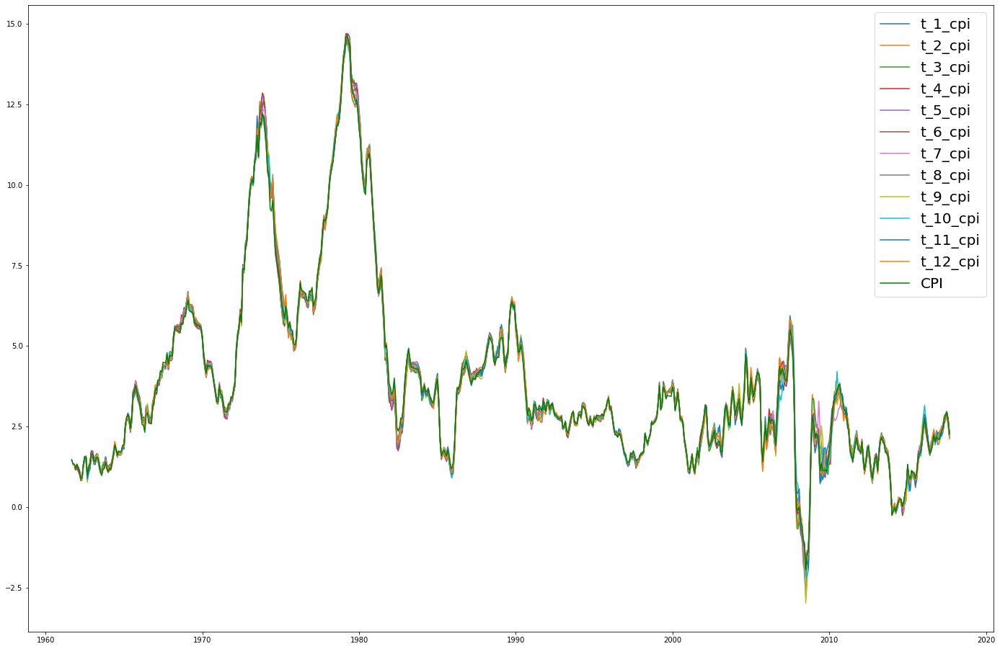

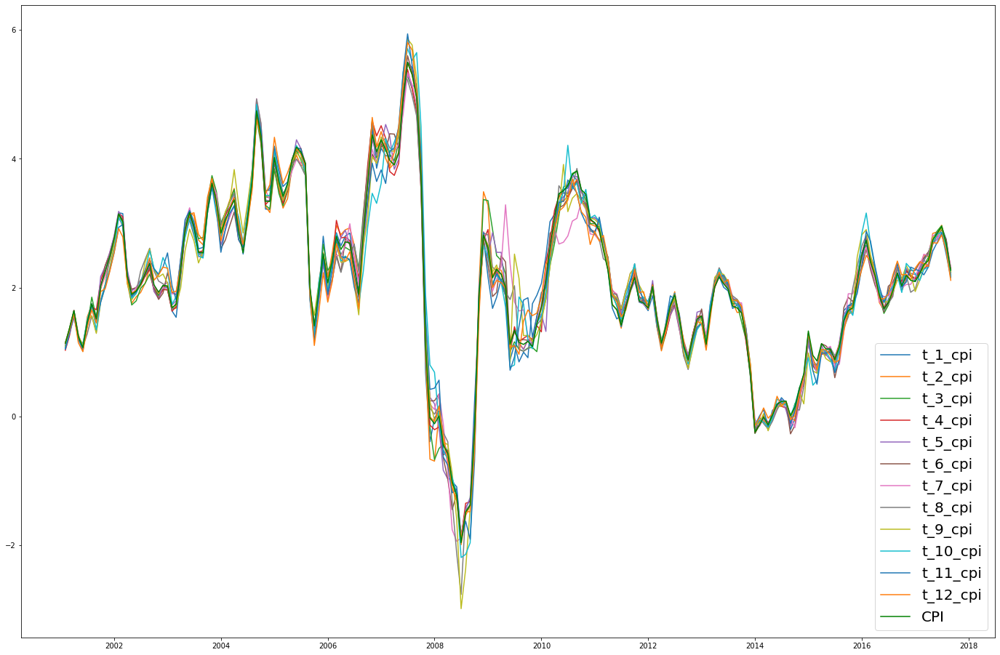

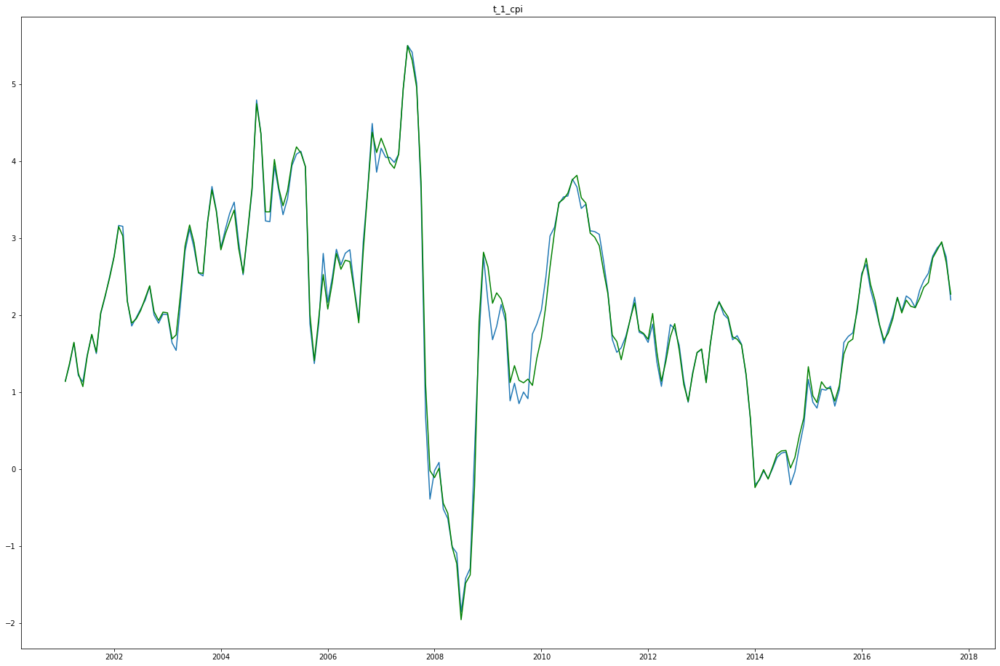

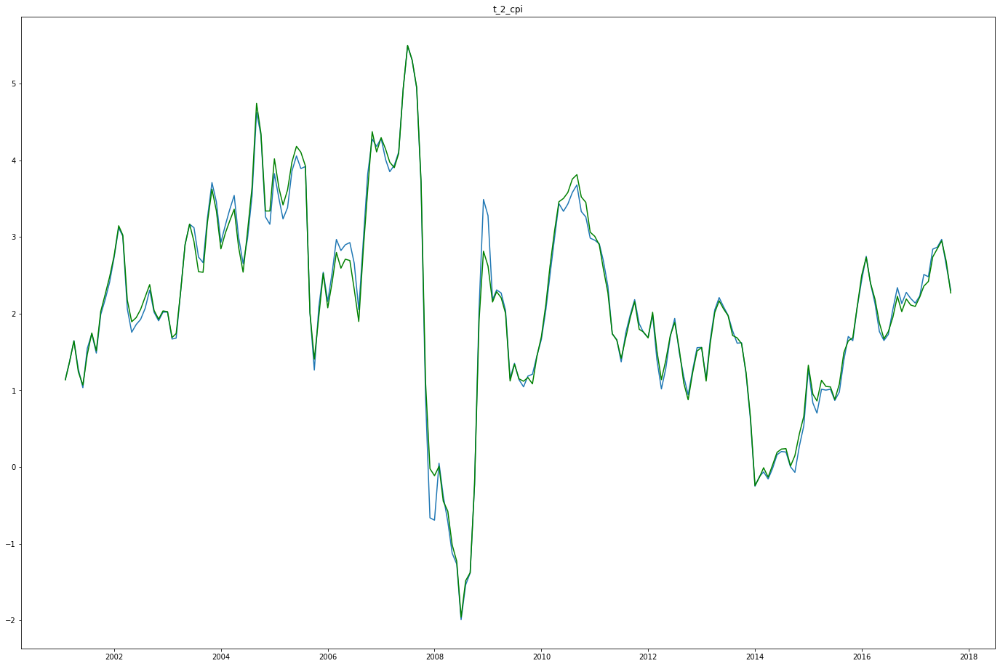

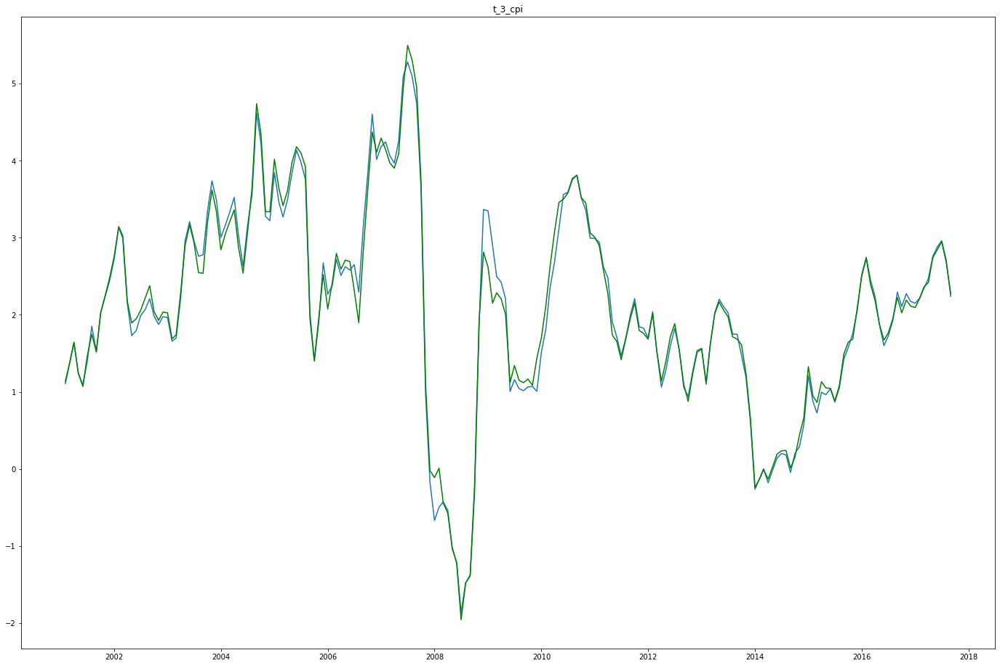

...

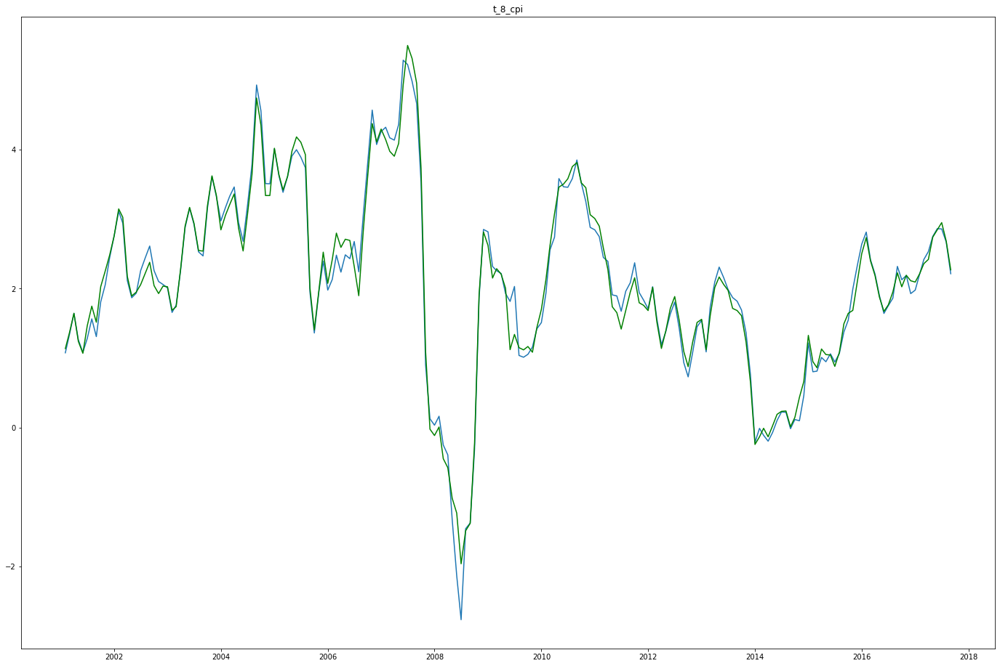

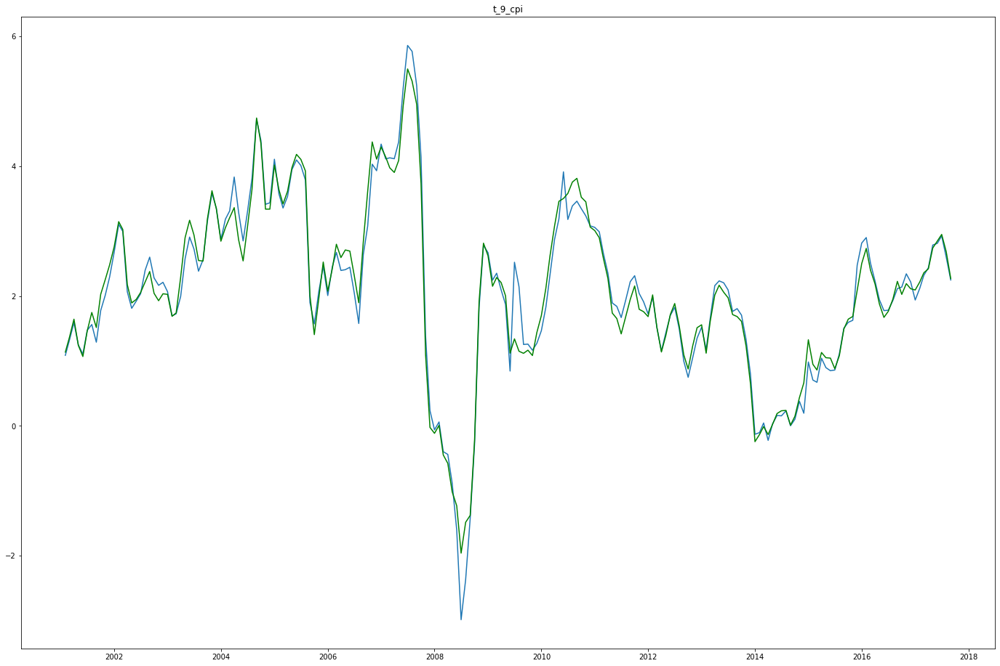

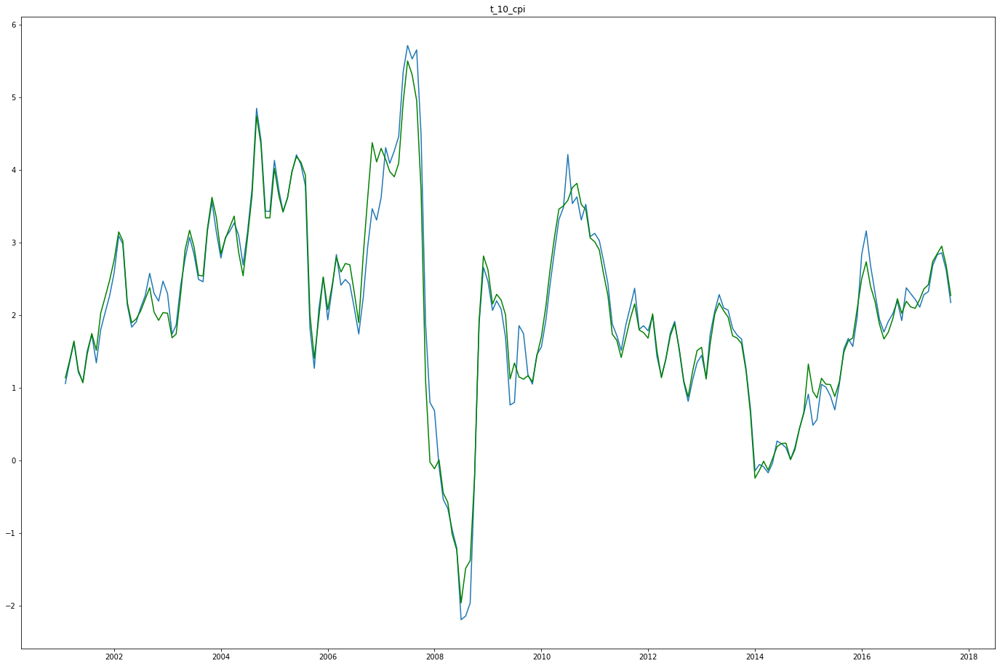

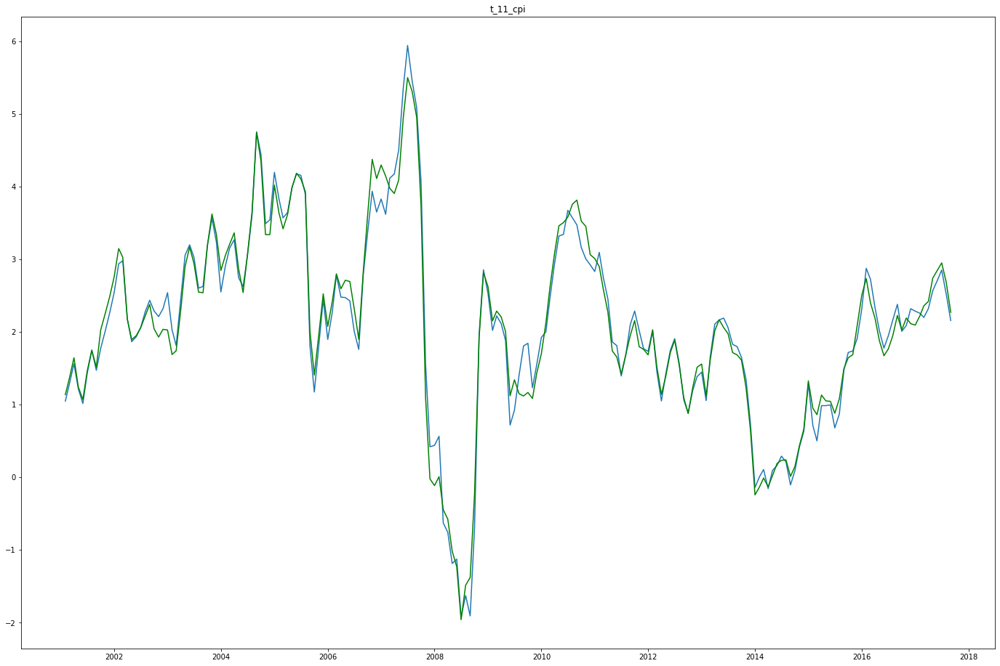

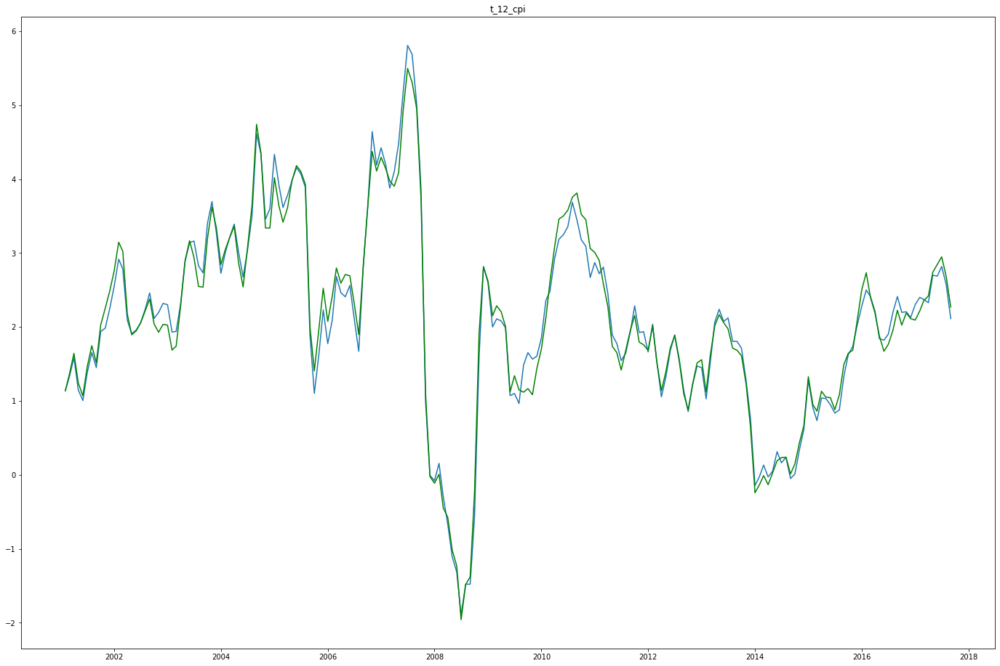

In [146]:
predictions_array = np.array(predictions_rolling_2)
# data_plt = pd.DataFrame(data.CPIAUCSL['2001-08-01':])
pred_df = pd.DataFrame({'t_1': predictions_array[:, 0], 't_2': predictions_array[:, 1],
                         't_3': predictions_array[:, 2], 't_4': predictions_array[:, 3],
                         't_5': predictions_array[:, 4], 't_6': predictions_array[:, 5],
                         't_7': predictions_array[:, 6], 't_8': predictions_array[:, 7],
                         't_9': predictions_array[:, 8], 't_10': predictions_array[:, 9],
                         't_11': predictions_array[:, 10], 't_12': predictions_array[:, 11]})

pred_plt = pd.DataFrame({'t_1' : pred_df['t_1'], 't_2' : pred_df['t_2'].shift(1),
                         't_3' : pred_df['t_3'].shift(2), 't_4' : pred_df['t_4'].shift(3),
                         't_5' : pred_df['t_5'].shift(4), 't_6' : pred_df['t_6'].shift(5),
                         't_7' : pred_df['t_7'].shift(6), 't_8' : pred_df['t_8'].shift(7),
                         't_9' : pred_df['t_9'].shift(8), 't_10' : pred_df['t_10'].shift(9),
                         't_11': pred_df['t_11'].shift(10), 't_12' : pred_df['t_12'].shift(11)})
for col in list(pred_plt):
    pred_plt['{}_cpi'.format(col)] = ((pred_plt[col].shift(-12) / pred_plt[col]) - 1)*100
for col in list(pred_plt)[:-12]:
    pred_plt['{}_cpi_diff'.format(col)] = pred_plt[col].shift(-1) - pred_plt[col]

pred_plt['raw_values'] = raw_values[start_idx:-1]
pred_plt['raw_cpi'] = data.CPI.values[start_idx:-1]
pred_plt['raw_cpi_diff'] = pred_plt['raw_values'].shift(-1) - pred_plt['raw_values']
pred_plt['date'] = data.index[start_idx:-1]
pred_plt.set_index('date', inplace=True)

mpl.rcParams['figure.figsize'] = (24,16)
for col in list(pred_plt)[24:-3]:
    ovr_mse = mean_squared_error(pred_plt['raw_cpi_diff'].values[11:-23], pred_plt[col].values[11:-23])
    ovr_mae = mean_absolute_error(pred_plt['raw_cpi_diff'].values[11:-23], pred_plt[col].values[11:-23])
    test_mse = mean_squared_error(pred_plt['raw_cpi_diff'].iloc[round((len(pred_plt)-20)*.7):-23], 
                                  pred_plt[col].iloc[round((len(pred_plt)-20)*.7):-23])
    test_mae = mean_absolute_error(pred_plt['raw_cpi_diff'].iloc[round((len(pred_plt)-20)*.7):-23], 
                                   pred_plt[col].iloc[round((len(pred_plt)-20)*.7):-23])
    print(col,': Overall RMSE: %.3f' % sqrt(ovr_mse), 'Test RMSE: %.3f' % sqrt(test_mse))
    print(col,': Overall MAE: %.3f' % ovr_mae, 'Test MAE: %.3f' % test_mae)
for col in list(pred_plt)[12:-15]:
    plt.plot(pred_plt[col][:-23], label=col)
# line plot of observed vs predicted
# plt.plot(raw_values[20:], color='blue')
plt.plot(pred_plt['raw_cpi'][:-23], color='green', label='CPI')
# plt.plot(test[:,0], color='green')
plt.legend(prop={'size': 20})
plt.show()

for col in list(pred_plt)[12:-15]:
    plt.plot(pred_plt[col].iloc[round((len(pred_plt)-20)*.7):-23], label=col)
plt.plot(pred_plt['raw_cpi'].iloc[round((len(pred_plt)-20)*.7):-23], color='green', label='CPI')
# plt.plot(test[:,0], color='green')
plt.legend(prop={'size': 20})
plt.show()

i = 0
for col in list(pred_plt)[12:-15]:
    plt.plot(pred_plt[col].iloc[round((len(pred_plt)-20)*.7):-23], label=col)
    plt.plot(pred_plt['raw_cpi'].iloc[round((len(pred_plt)-20)*.7):-23], color='green', label='CPI')
    plt.title(col)
    plt.show()

No handles with labels found to put in legend.


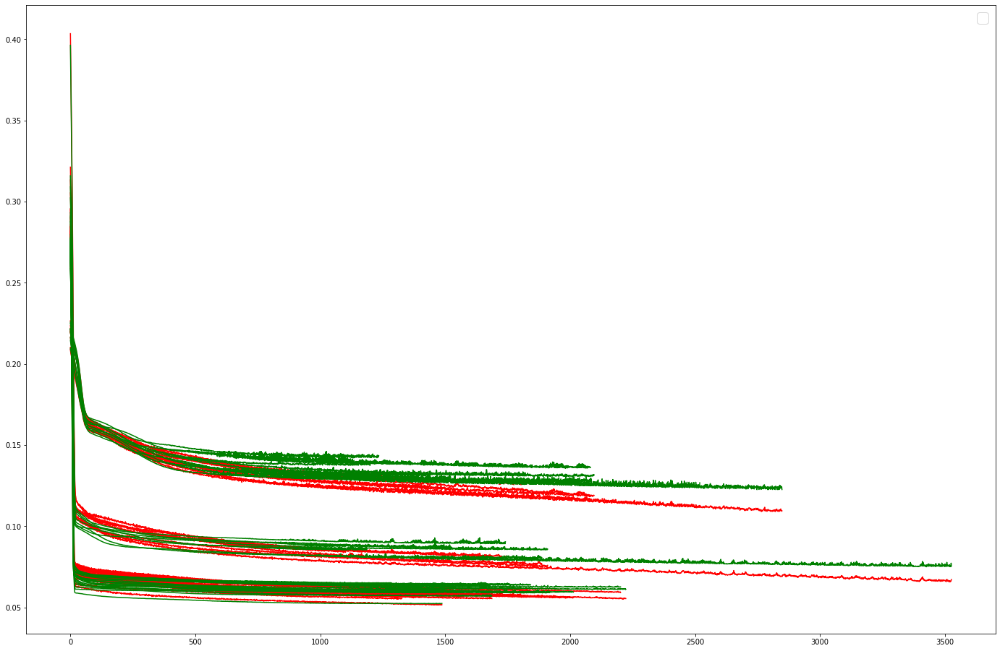

In [143]:
plt.plot(loss_df, color='red')
plt.plot(val_loss_df, color='green')
plt.legend(prop={'size': 20})
plt.show()